In [1]:
from __future__ import division
import os
import time
from glob import glob
import tensorflow as tf
from six.moves import xrange
import numpy as np
from tflib.save_images import *

In [2]:
data_dir = './data/patch_data'
import helper

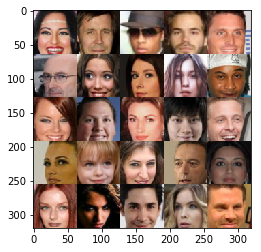

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

raw_images = helper.get_batch(glob(os.path.join(data_dir, 'newraw/*.jpg'))[:show_n_images], 64, 64, 'RGB')
pyplot.imshow(helper.images_square_grid(raw_images, 'RGB'))

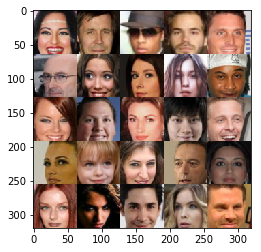

In [4]:
# Preprocess the patches
from skimage.util import view_as_windows
import scipy
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
resized_raw = helper.get_batch(glob(os.path.join(data_dir, 'newraw/*.jpg')), 64, 64, 'RGB')
pyplot.imshow(helper.images_square_grid(resized_raw, 'RGB'))

"""
DON'T RUN ANYTHING IN THIS CELL
"""
resized_dir = './data/patch_data/resized_raw'
for i, img in enumerate(resized_raw):
    filename = "%02d.png" % i
    result = scipy.misc.toimage(img, high=np.max(img), low=np.min(img))
    path = os.path.join(resized_dir, filename)
    scipy.misc.imsave(path, result)
   

In [5]:
"""
DON'T RUN ANYTHING IN THIS CELL
"""
from sklearn.feature_extraction.image import extract_patches_2d, reconstruct_from_patches_2d
PATCH_SIZE = (8, 8)
STEP_SIZE = 1

#patches = view_as_windows(resized_raw[-1], (8,8,3))

"""
for i, img in enumerate(resized_raw[:-1]):
    patch_dir = os.path.join(data_dir, 'training')
    if i == 25:
        patch_dir = os.path.join(data_dir, 'validation')
    elif i == 26:
        patch_dir = os.path.join(data_dir, 'testing')
        
    for j, patch in enumerate(extract_patches_2d(img, patch_size=PATCH_SIZE)):
        filename = "%02d_%04d.png" % (i,j)
        result = scipy.misc.toimage(patch, high=np.max(patch), low=np.min(patch))
        path = os.path.join(patch_dir, filename)
        scipy.misc.imsave(path, result)
"""


"""
for i, img in enumerate(resized_raw, 25):
    patch_dir = os.path.join(data_dir, 'training')
    #if i == 25:
    #    patch_dir = os.path.join(data_dir, 'validation')
    #elif i == 26:
    #    patch_dir = os.path.join(data_dir, 'testing')
        
    for j, patch in enumerate(extract_patches_2d(img, patch_size=PATCH_SIZE)):
        filename = "%02d_%04d.png" % (i,j)
        result = scipy.misc.toimage(patch, high=np.max(patch), low=np.min(patch))
        path = os.path.join(patch_dir, filename)
        scipy.misc.imsave(path, result)
"""
print("You have run this!")

        

    


You have run this!


In [6]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

"""
# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
"""

"\n# Check TensorFlow Version\nassert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)\nprint('TensorFlow Version: {}'.format(tf.__version__))\n\n# Check for a GPU\nif not tf.test.gpu_device_name():\n    warnings.warn('No GPU found. Please use a GPU to train your neural network.')\nelse:\n    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))\n"

In [7]:
def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    real_imgs = tf.placeholder(tf.float32, [None, image_width,image_height,image_channels], name='input_real')
    fake_imgs = tf.placeholder(tf.float32, [None, image_width,image_height,image_channels], name='input_fake')
    inputs_z = tf.placeholder(tf.float32, [None, z_dim], name='input_z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')
    return real_imgs, fake_imgs,inputs_z, learning_rate

In [8]:
HIDDEN_DIM = 320
INPUT_DIM = 8 * 8 * 3
IMAGE_SHAPE = [8, 8, 3]
PENALTY = 0.2

## Encoder

In [9]:
def encoder(images, z_dim, leaky_factor=0.2, name='encoder', reuse=False):
    """
    Create the encoder network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :leaky_factor: leaky_factor for leaky relu layer
    :return: Tensor of output vector (latent z )
    """
    with tf.variable_scope(name, reuse=reuse):

        # Flatten it
        #norm = tf.random_normal_initializer(stddev=0.01)
        x1 = tf.contrib.layers.flatten(images)
        x1 = tf.layers.dense(x1, HIDDEN_DIM)
        #x1 = tf.layers.batch_normalization(x1, training=(not reuse))
        #relu1 = tf.maximum(leaky_factor * x1, x1)
        relu1 = tf.nn.relu(x1, name='en_ac1')
        #relu1 = tf.nn.sigmoid(x1)
        #tf.add_to_collection('activations', relu1)
        
        x2 = tf.layers.dense(relu1, z_dim, name='en_dense_2')
        #x2 = tf.layers.batch_normalization(x2, training=(not reuse))
        #relu2 = tf.maximum(leaky_factor * x2, x2)
        #relu2 = tf.nn.relu(x2)
        #relu2 = tf.nn.sigmoid(x2)

        out = tf.nn.relu(x2, name='en_ac2')
        #tf.add_to_collection('activations', out)
        #out = tf.nn.relu(tf.layers.dense(relu1, z_dim), name='en_ac2')
        #tf.add_to_collection('activations', out)
        #out = tf.maximum(leaky_factor * out, out)
        return out

## Decoder

In [10]:
def decoder(z, out_channel_dim, leaky_factor=0.2, name='decoder',is_train=True):
    """
    Create the decoder network
    :param images: Tensor of input z
    :param out_channel_dim: the output channel format
    :param leaky_factor: leaky_factor for leaky relu layer
    :param is_train: Boolean if it is train mode or test mode
    :return: Tensor of output vector (latent z )
    """    
    with tf.variable_scope(name, reuse= (not is_train)):
        x1 = tf.layers.dense(z, HIDDEN_DIM)
        #x1 = tf.layers.batch_normalization(x1, training=is_train)
        #relu1 = tf.maximum(leaky_factor * x1, x1)
        relu1 = tf.nn.sigmoid(x1, name='de_ac1')
        #relu1 = tf.nn.sigmoid(x1)
        tf.add_to_collection('activations', relu1)
        #x2 = tf.layers.dense(relu1, HIDDEN_DIM)
        #x2 = tf.layers.batch_normalization(x2, training=is_train)
        #relu2 = tf.maximum(leaky_factor * x2, x2)
        #relu2 = tf.nn.relu(x2)
        #relu2 = tf.nn.sigmoid(x2)
       
        out = tf.tanh(tf.layers.dense(relu1, INPUT_DIM), name='de_ac2')
        #out = tf.nn.sigmoid(tf.layers.dense(relu2, INPUT_DIM))
        return tf.reshape(out, [-1] + IMAGE_SHAPE)

## Discriminator

In [11]:
def discriminator(input_z, leaky_factor=0.2, name='discriminator',reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input z
    :param leaky_factor: leaky_factor for leaky relu layer
    :param reuse: Boolean if it is train mode or test mode
    :return: tuple of (classification result, logits)
    """     
    with tf.variable_scope(name, reuse=reuse):
        
        x1 = tf.layers.dense(input_z, HIDDEN_DIM)
        #x1 = tf.layers.batch_normalization(x1, training=(not reuse))
        #relu1 = tf.maximum(leaky_factor * x1, x1)
        relu1 = tf.nn.relu(x1, name)

        x2 = tf.layers.dense(relu1, HIDDEN_DIM)
        #x2 = tf.layers.batch_normalization(x2, training=(not reuse))
        #relu2 = tf.maximum(leaky_factor * x2, x2)
        relu2 = tf.nn.relu(x2)

        logits = tf.layers.dense(x2, 1)
        out = tf.sigmoid(logits)

        return out, logits

## Corruptor

In [12]:
def corrupt(images, mask_type='inpainting',noise=False):
    """
    Create the discriminator network
    :param images: Tensor of input images
    :param noise: Boolean if gaussian noise will be added
    :return: Tensor of corrupted images
    """ 
    image_shape = images.get_shape().as_list()[1:]
    x, y, z = image_shape
    length_input = x * y * z
    mu = 0.0
    sigma = 0.5
    gnoise = np.random.normal(loc=mu, scale=sigma, size=image_shape)
    if noise:
        images = tf.add(images, gnoise)
        
    if mask_type == 'inpainting':
        # inpainting 
        a, b = 2, 2
        pixFrac = np.random.beta(a,b)
        #pixFrac = 0.5
        mask = np.random.binomial(1, pixFrac, image_shape)
        result = tf.multiply(images, mask)
        return result
    elif mask_type == 'compress':
        # compressive sensing
        flat_images = tf.contrib.layers.flatten(images)
        #A = np.random.normal(loc=mu, scale=sigma,size=[length_input//5, length_input])
        #A = np.array(A, dtype=np.float32)
        #mask = np.matmul(A.transpose(), A)
        A = tf.random_normal([length_input // 5, length_input], name='sensing_matrix')
        mask = tf.matmul(tf.transpose(A), A)
        result = tf.matmul(flat_images, mask)
        return tf.reshape(result, [-1] + image_shape)
    else:
        return images
    
    
def corrupt_func(images, mask_type='inpainting',noise=True):
    """
    Create the discriminator network
    :param images: Tensor of input images
    :param noise: Boolean if gaussian noise will be added
    :return: Tensor of corrupted images
    """ 
    image_shape = images.shape[1:]
    x, y, z = image_shape
    length_input = x * y * z
    mu = 0.0
    sigma = 0.5
    gnoise = np.random.normal(loc=mu, scale=sigma, size=image_shape)
    result = np.zeros(images.shape)
    result += images
    if noise:
        result += gnoise
        
    if mask_type == 'inpainting':
        # inpainting 
        #a, b = 2, 2
        #pixFrac = np.random.beta(a,b)
        pixFrac = 0.2
        mask = np.random.binomial(1, pixFrac, image_shape)
        result = np.multiply(result, mask)
        return result
    elif mask_type == 'compress':
        # compressive sensing
        flat_images = np.array(list(map(lambda x: x.flatten(), result)))
        
        A = np.random.normal(loc=mu, scale=sigma,size=[length_input//5, length_input])
        A = np.array(A, dtype=np.float32)
        mask = np.matmul(A.transpose(), A)
        #A = tf.random_normal([length_input // 5, length_input], name='sensing_matrix')
        #mask = tf.matmul(tf.transpose(A), A)
        #result = tf.matmul(flat_images, mask)
        result = np.array(list(map(lambda x : np.matmul(x, mask), flat_images)))
        return result.reshape(images.shape)
    else:
        return result

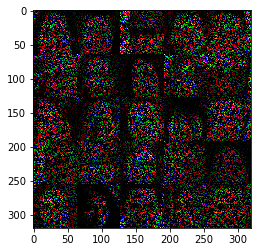

In [13]:
# test corrupt_func
A = corrupt_func(resized_raw[:25], mask_type='inpainting', noise=False)
pyplot.imshow(helper.images_square_grid(A, 'RGB'))

### Loss
Implement `model_loss` to build the DAAE for training and calculate the loss.  The function should return a tuple of (discriminator loss, encoder loss, encoder-decoder loss).  Use the following functions you implemented:
- `discriminator(input_z, leaky_factor, reuse=False)`
- `decoder(z, out_channel_dim, leaky_factor, is_train=True)`
- `encoder(images, z_dim, leaky_factor, reuse=False)`

In [14]:
def kl_divergence(p, p_hat):
    return p * tf.log(p) - p * tf.log(p_hat) + (1 - p) * tf.log(1 - p) - (1 - p) * tf.log(1 - p_hat)

In [15]:
def model_loss(input_real, input_fake, input_z, z_dim, output_channel_dim):
    """
    Get the loss for the discriminator, encoder and decoder
    :param input_real: Images from the real dataset
    :param input_z: Z input from Laplacian distribution
    :param out_channel_dim: The number of channels in the output image
    :param M : how many iterations to sample from p(z|x)
    :return: A tuple of (discriminator loss, encoder loss, recon loss, dis_loss_sum, en_loss_sum, recon_loss_sum)
    """
    
    En = encoder(input_real, z_dim, name='encoder')
    De = decoder(En, output_channel_dim, name='decoder')
    
    recon_loss = tf.reduce_mean(tf.square(tf.subtract(De, input_real)))
    activations = tf.get_collection('activations')
    #l1_regularizer = tf.contrib.layers.l1_regularizer(scale=PENALTY, scope=None)
    #sparse_penalty = tf.contrib.layers.apply_regularization(l1_regularizer, activations)
    sparse_penalty = tf.reduce_mean(kl_divergence( PENALTY, activations[0]))
    #for ac in activations:
    #    sparse_penalty += tf.reduce_mean(kl_divergence(PENALTY, ac))
    
    total_loss = recon_loss + sparse_penalty / len(activations)

    #en_sum = tf.summary.histogram("encoded",En)
    recon_loss_sum = tf.summary.scalar("recon_loss", recon_loss)
    
    return De, recon_loss, total_loss, recon_loss_sum
    
    

In [16]:
def model_opt(total_loss, learning_rate, beta1, beta2):
    """
    Get optimization operations
    :param dis_loss: Discriminator loss Tensor
    :param en_loss: encoder loss Tensor
    :param recon_loss: reconstruction loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param beta2: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, encoder training operation, recontraining operations)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    
    #dis_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    de_vars = [var for var in t_vars if var.name.startswith('decoder')]
    en_real_vars = [var for var in t_vars if var.name.startswith('encoder')]
    #en_fake_vars = [var for var in t_vars if var.name.startswith('en_fake')]
    ed_vars = de_vars + en_real_vars
    
    
    #with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS, scope='decoder')):
    #de_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1,beta2=beta2).minimize(recon_loss, var_list=ed_vars)
    de_train_opt = tf.train.GradientDescentOptimizer(learning_rate).minimize(total_loss, var_list=ed_vars)
    #d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1,beta2=beta2).minimize(dis_loss, var_list=dis_vars)
    
    #with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS, scope='encoder')):
    #en_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1,beta2=beta2).minimize(en_loss, var_list=en_fake_vars)
    
    return de_train_opt





## Training

In [17]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np
import scipy.stats as stats
from skimage.measure import compare_psnr

from scipy.stats import sem
def mean_score(scores):
    return ("##### What? The Mean score: {0:.3f} (+/-{1: .3f})").format(np.mean(scores), sem(scores))


def sample_from_dis(n_images, z_dim,dis = 'laplacian'):
    if dis == 'laplacian':
        mu = 0.0
        lam = 1.0
        return np.random.laplace(loc=mu, scale=lam, size=[n_images, z_dim])
    elif dis == 'gaussian':
        mu = 0
        lower = -1
        upper = 1
        sigma = 1 / np.sqrt(z_dim)
        sigma = 1
        z = stats.truncnorm.rvs((lower-mu)/sigma, (upper-mu)/sigma, loc=mu, scale=sigma, size=[n_images,z_dim])
        return z
    else:
        return np.random.uniform(-1, 1, size=[n_images, z_dim])


def show_decoder_output(sess, n_images, input_z, out_channel_dim, image_mode, distribution='laplacian'):
    """
    Show example output for the decoder
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
        
    example_z = sample_from_dis(n_images, z_dim, dis=None)

    samples = sess.run(
        decoder(input_z, out_channel_dim, leaky_factor=0.2, is_train = False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()
    
    
def show_endecoder_output(sess, samples, corrupt_samples, recon_samples,input_z, out_channel_dim, image_mode, distribution='laplacian'):
    """
    Show example output for the encoder-decoder
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
        
    #example_z = sample_from_dis(n_images, z_dim, dis=distribution)
    #corrupt_images = corrupt_func(sample_images, mask_type='inpainting', noise=False)
    
    #ops = [reconstruction]
    
    #samples = sess.run(
    #    ops,
    #    feed_dict={'input_fake': corrupt_images})
    
    #mse = np.mean((samples - recon_samples) ** 2)
    #print("######### what? the reconstruction mse is: %2.4f"  % mse)

    psnr = compare_psnr(samples, recon_samples)
    print("######### what? the reconstruction psnr is: %2.4f"  % psnr)
    
    images_grid = helper.images_square_grid(recon_samples, image_mode)
    corr_grid = helper.images_square_grid(corrupt_samples, image_mode)
    
    pyplot.subplot(121)
    pyplot.imshow(corr_grid, cmap=cmap)
    
    pyplot.subplot(122)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()
    
    

## run

In [18]:
import time

checkpoint_dir = './checkpoint'
model_name = "spAE_scratch.model"
mask_t = ''
NOISE = False

def save(saver, sess, checkpoint_dir, model_name, steps):
    if not os.path.exists(checkpoint_dir):
        os.makedirs(checkpoint_dir)

    saver.save(sess,os.path.join(checkpoint_dir, model_name),
                        global_step=steps)

    
def load(saver, sess, checkpoint_dir):
    print(" [*] Reading checkpoints...")

    ckpt = tf.train.get_checkpoint_state(checkpoint_dir)
    if ckpt and ckpt.model_checkpoint_path:
        saver.restore(sess, ckpt.model_checkpoint_path)
        return True
    else:
        return False



def train(epoch_count, batch_size, z_dim, learning_rate, beta1, beta2, M, get_batches, samples, training_samples,data_shape, data_image_mode):
    """
    Train the DAAE
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param beta2: The exponential decay rate for the 1st moment in the optimizer
    :param M: iterations to sample fake_z
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model

    num_imgs, image_width, image_height, image_channels = data_shape
    
    input_real, input_fake,input_z, _ = model_inputs(image_width, image_height, image_channels, z_dim)
    #tf.assign(lr, learning_rate)
    output_channel_dim = image_channels
    
    reconstruction, recon_loss, total_loss, recon_loss_sum = model_loss(input_real, input_fake,input_z, z_dim, output_channel_dim)
    #dis_loss, en_loss, temp_en_loss_dis, recon_loss, dis_loss_sum, en_loss_sum, recon_loss_sum,reconstruction = result
    
    de_train_opt = model_opt(total_loss, learning_rate, beta1,beta2)
    ITER = 1 # we can train en-decoder more than 1 time...later~
    steps = 0
    
    recon_sum = tf.summary.merge([recon_loss_sum])
    #en_sum = tf.summary.merge([en_loss_sum])
    #dis_sum = tf.summary.merge([dis_loss_sum])

    saver = tf.train.Saver(max_to_keep=1)
    
    train_psnr_lst = list()
    test_psnr_lst = list()
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        writer = tf.summary.FileWriter("./logs", sess.graph)
        
        # check if already exists a model
        if load(saver, sess, checkpoint_dir):
            print("""
            We found a existing model and continue to train on it! 
            If you need a new model, delete checkpoint directory""")
        else:
            print("""NOT found a model === Initializing a new one""")
            
        
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                batch_imgs = batch_images * 2

                batch_z = sample_from_dis(batch_size, z_dim,dis = '')
 
                # Run optimizers

                # Update real_EnDecoder network
                for i in range(ITER):
                    _, summary_str = sess.run([de_train_opt, recon_sum],
                            feed_dict={ input_real: batch_imgs})
                writer.add_summary(summary_str, steps)

                
                if steps % 10 == 0:
                    ops = [recon_loss, total_loss]
                    recon_val, total_val = sess.run(ops, feed_dict={input_real:batch_imgs})
                    print("EPO: %d, recon_loss: %2.4f, total_loss: %2.4f" % (epoch_i, recon_val, total_val))
                    #train_corrupt_samples = corrupt_func(training_samples, mask_type=mask_t, noise=NOISE)
                    #corrupt_samples = corrupt_func(samples, mask_type=mask_t, noise=NOISE)
                    recon_train_samples = sess.run(reconstruction, feed_dict={input_real:training_samples})
                    recon_test_samples = sess.run(reconstruction, feed_dict={input_real:samples})
                    psnr_train = compare_psnr(training_samples, recon_train_samples)
                    psnr_test = compare_psnr(samples, recon_test_samples)
                    train_psnr_lst.append(psnr_train)
                    test_psnr_lst.append(psnr_test)
                    
                if steps % 100 == 0:
                    #show_decoder_output(sess, show_n_images, input_z, output_channel_dim, data_image_mode)
                    corrupt_samples = corrupt_func(samples, mask_type=mask_t, noise=NOISE)
                    recon_samples = sess.run(reconstruction, feed_dict={input_real:samples})
                    show_endecoder_output(sess, samples,corrupt_samples,recon_samples,input_z, output_channel_dim, data_image_mode)
                    
                if steps % 500 == 1:
                    save(saver, sess, checkpoint_dir, model_name, steps)
    return np.array(train_psnr_lst), np.array(test_psnr_lst)
                    
                    

## Test!

In [19]:
def test(z_dim, get_batches, data_shape, data_image_mode):
    """
    Train the DAAE
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param beta2: The exponential decay rate for the 1st moment in the optimizer
    :param M: iterations to sample fake_z
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model

    num_imgs, image_width, image_height, image_channels = data_shape
    
    input_real, input_fake,input_z, _ = model_inputs(image_width, image_height, image_channels, z_dim)
    #tf.assign(lr, learning_rate)
    output_channel_dim = image_channels
    
    reconstruction, recon_loss, total_loss, recon_loss_sum = model_loss(input_real, input_fake,input_z, z_dim, output_channel_dim)

    saver = tf.train.Saver(max_to_keep=1)
    
    recon_patches = np.zeros(data_shape)
    steps = 0
    test_psnr_lst = list()
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        writer = tf.summary.FileWriter("./logs", sess.graph)
        
        # check if already exists a model
        if load(saver, sess, checkpoint_dir):
            print("""
            We found a existing model and continue to train on it! 
            If you need a new model, delete checkpoint directory""")
        else:
            print("""NOT found a model === Go to train a new one""")
            return
        
        for batch_images in get_batches(batch_size):
            steps += 1
            batch_imgs = batch_images * 2

            batch_z = sample_from_dis(batch_size, z_dim,dis = '')
    
            recon_test_samples = sess.run(reconstruction, feed_dict={input_real:batch_imgs})
            recon_patches[(steps - 1) * batch_size:steps * batch_size] = recon_test_samples
            
            psnr_test = compare_psnr(batch_imgs, recon_test_samples)
            test_psnr_lst.append(psnr_test)
            
    return recon_patches, test_psnr_lst
            
            

In [20]:
def check_var(z_dim, get_batches, data_shape, data_image_mode):
    """
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model

    num_imgs, image_width, image_height, image_channels = data_shape
    
    input_real, input_fake,input_z, _ = model_inputs(image_width, image_height, image_channels, z_dim)
    #tf.assign(lr, learning_rate)
    output_channel_dim = image_channels
    
    reconstruction, recon_loss, total_loss, recon_loss_sum = model_loss(input_real, input_fake,input_z, z_dim, output_channel_dim)

    saver = tf.train.Saver(max_to_keep=1)
    
    recon_patches = np.zeros(data_shape)
    steps = 0
    test_psnr_lst = list()
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        writer = tf.summary.FileWriter("./logs", sess.graph)
        
        # check if already exists a model
        if load(saver, sess, checkpoint_dir):
            print("""
            We found a existing model and continue to train on it! 
            If you need a new model, delete checkpoint directory""")
        else:
            print("""NOT found a model === Go to train a new one""")
            return
        print(sess.graph.get_all_collection_keys())

## Faces

0.984314
 [*] Reading checkpoints...
NOT found a model === Initializing a new one
EPO: 0, recon_loss: 0.0766, total_loss: 0.2632
EPO: 0, recon_loss: 0.0475, total_loss: 0.2290
EPO: 0, recon_loss: 0.0830, total_loss: 0.2564
EPO: 0, recon_loss: 0.0389, total_loss: 0.2016
EPO: 0, recon_loss: 0.0535, total_loss: 0.2045
EPO: 0, recon_loss: 0.1031, total_loss: 0.2281
EPO: 0, recon_loss: 0.1338, total_loss: 0.2468
EPO: 0, recon_loss: 0.0513, total_loss: 0.1305
EPO: 0, recon_loss: 0.0826, total_loss: 0.1461
EPO: 0, recon_loss: 0.1280, total_loss: 0.1760
######### what? the reconstruction psnr is: 12.1739


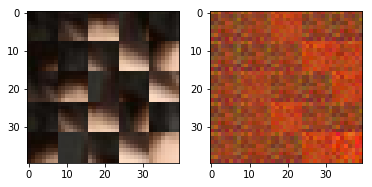

EPO: 0, recon_loss: 0.0758, total_loss: 0.1333
EPO: 0, recon_loss: 0.0792, total_loss: 0.1300
EPO: 0, recon_loss: 0.0613, total_loss: 0.0930
EPO: 0, recon_loss: 0.0429, total_loss: 0.0690
EPO: 0, recon_loss: 0.0877, total_loss: 0.1152
EPO: 0, recon_loss: 0.1675, total_loss: 0.1940
EPO: 0, recon_loss: 0.0999, total_loss: 0.1213
EPO: 0, recon_loss: 0.0939, total_loss: 0.1156
EPO: 0, recon_loss: 0.0809, total_loss: 0.1004
EPO: 0, recon_loss: 0.0633, total_loss: 0.0833
######### what? the reconstruction psnr is: 13.4899


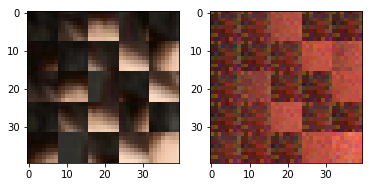

EPO: 0, recon_loss: 0.0808, total_loss: 0.1107
EPO: 0, recon_loss: 0.0612, total_loss: 0.0857
EPO: 0, recon_loss: 0.0732, total_loss: 0.0915
EPO: 0, recon_loss: 0.0435, total_loss: 0.0622
EPO: 0, recon_loss: 0.0299, total_loss: 0.0448
EPO: 0, recon_loss: 0.1349, total_loss: 0.1795
EPO: 0, recon_loss: 0.1176, total_loss: 0.1648
EPO: 0, recon_loss: 0.1004, total_loss: 0.1371
EPO: 0, recon_loss: 0.0951, total_loss: 0.1208
EPO: 0, recon_loss: 0.0582, total_loss: 0.0871
######### what? the reconstruction psnr is: 14.3176


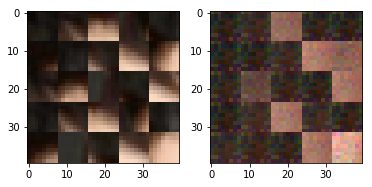

EPO: 0, recon_loss: 0.1353, total_loss: 0.1638
EPO: 0, recon_loss: 0.0595, total_loss: 0.0866
EPO: 0, recon_loss: 0.0610, total_loss: 0.0745
EPO: 0, recon_loss: 0.0247, total_loss: 0.0379
EPO: 0, recon_loss: 0.0519, total_loss: 0.0827
EPO: 0, recon_loss: 0.0206, total_loss: 0.0358
EPO: 0, recon_loss: 0.0290, total_loss: 0.0461
EPO: 0, recon_loss: 0.0427, total_loss: 0.0729
EPO: 0, recon_loss: 0.0470, total_loss: 0.0687
EPO: 0, recon_loss: 0.0458, total_loss: 0.0857
######### what? the reconstruction psnr is: 15.5653


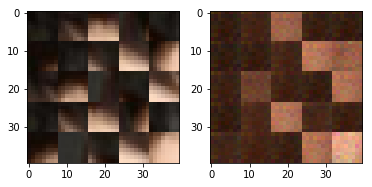

EPO: 0, recon_loss: 0.0892, total_loss: 0.1203
EPO: 0, recon_loss: 0.0737, total_loss: 0.1129
EPO: 0, recon_loss: 0.0654, total_loss: 0.0907
EPO: 0, recon_loss: 0.0433, total_loss: 0.0728
EPO: 0, recon_loss: 0.0607, total_loss: 0.0919
EPO: 0, recon_loss: 0.0628, total_loss: 0.1216
EPO: 0, recon_loss: 0.0548, total_loss: 0.0911
EPO: 0, recon_loss: 0.0723, total_loss: 0.0915
EPO: 0, recon_loss: 0.0481, total_loss: 0.0736
EPO: 0, recon_loss: 0.0396, total_loss: 0.0626
######### what? the reconstruction psnr is: 16.5665


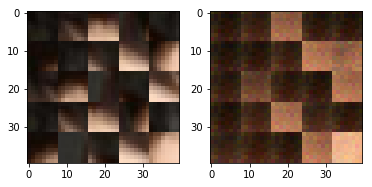

EPO: 0, recon_loss: 0.0822, total_loss: 0.1063
EPO: 0, recon_loss: 0.0412, total_loss: 0.0653
EPO: 0, recon_loss: 0.0689, total_loss: 0.0856
EPO: 0, recon_loss: 0.0620, total_loss: 0.0719
EPO: 0, recon_loss: 0.0652, total_loss: 0.0770
EPO: 0, recon_loss: 0.1896, total_loss: 0.2347
EPO: 0, recon_loss: 0.0809, total_loss: 0.1196
EPO: 0, recon_loss: 0.0862, total_loss: 0.1203
EPO: 0, recon_loss: 0.0672, total_loss: 0.1025
EPO: 0, recon_loss: 0.0447, total_loss: 0.0773
######### what? the reconstruction psnr is: 15.0769


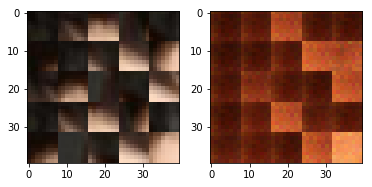

EPO: 0, recon_loss: 0.0626, total_loss: 0.1255
EPO: 0, recon_loss: 0.0436, total_loss: 0.0774
EPO: 0, recon_loss: 0.0965, total_loss: 0.1191
EPO: 0, recon_loss: 0.0692, total_loss: 0.0944
EPO: 0, recon_loss: 0.0835, total_loss: 0.1058
EPO: 0, recon_loss: 0.0801, total_loss: 0.1123
EPO: 0, recon_loss: 0.0544, total_loss: 0.0992
EPO: 0, recon_loss: 0.0586, total_loss: 0.0975
EPO: 0, recon_loss: 0.0816, total_loss: 0.1035
EPO: 0, recon_loss: 0.0426, total_loss: 0.0776
######### what? the reconstruction psnr is: 15.7352


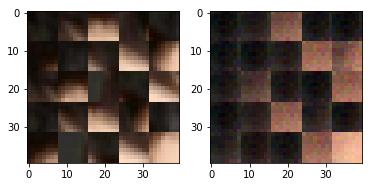

EPO: 0, recon_loss: 0.0714, total_loss: 0.0948
EPO: 0, recon_loss: 0.0742, total_loss: 0.1286
EPO: 0, recon_loss: 0.0875, total_loss: 0.1251
EPO: 0, recon_loss: 0.1320, total_loss: 0.1723
EPO: 0, recon_loss: 0.0712, total_loss: 0.1133
EPO: 0, recon_loss: 0.0828, total_loss: 0.1158
EPO: 0, recon_loss: 0.0762, total_loss: 0.1162
EPO: 0, recon_loss: 0.0795, total_loss: 0.1292
EPO: 0, recon_loss: 0.1020, total_loss: 0.1440
EPO: 0, recon_loss: 0.0950, total_loss: 0.1393
######### what? the reconstruction psnr is: 16.2114


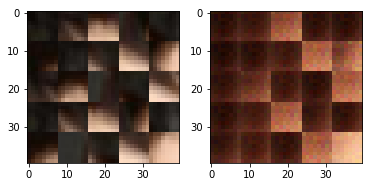

EPO: 0, recon_loss: 0.0679, total_loss: 0.1125
EPO: 0, recon_loss: 0.0545, total_loss: 0.1335
EPO: 0, recon_loss: 0.1221, total_loss: 0.1601
EPO: 0, recon_loss: 0.1092, total_loss: 0.1358
EPO: 0, recon_loss: 0.0531, total_loss: 0.0663
EPO: 0, recon_loss: 0.0317, total_loss: 0.0440
EPO: 0, recon_loss: 0.0419, total_loss: 0.0608
EPO: 0, recon_loss: 0.0379, total_loss: 0.0657
EPO: 0, recon_loss: 0.0540, total_loss: 0.0737
EPO: 0, recon_loss: 0.0389, total_loss: 0.0697
######### what? the reconstruction psnr is: 16.8779


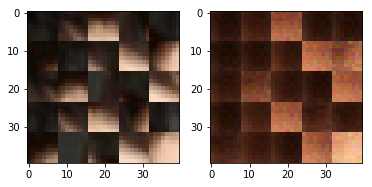

EPO: 0, recon_loss: 0.0481, total_loss: 0.0733
EPO: 0, recon_loss: 0.0162, total_loss: 0.0382
EPO: 0, recon_loss: 0.0092, total_loss: 0.0215
EPO: 0, recon_loss: 0.0209, total_loss: 0.0560
EPO: 0, recon_loss: 0.0078, total_loss: 0.0147
EPO: 0, recon_loss: 0.0165, total_loss: 0.0465
EPO: 0, recon_loss: 0.0753, total_loss: 0.1126
EPO: 0, recon_loss: 0.0448, total_loss: 0.0640
EPO: 0, recon_loss: 0.0509, total_loss: 0.0660
EPO: 0, recon_loss: 0.0328, total_loss: 0.0485
######### what? the reconstruction psnr is: 16.7969


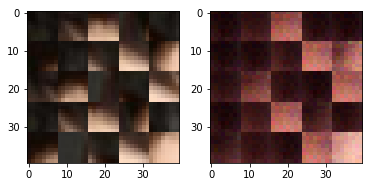

EPO: 0, recon_loss: 0.0355, total_loss: 0.0630
EPO: 0, recon_loss: 0.0665, total_loss: 0.0985
EPO: 0, recon_loss: 0.0714, total_loss: 0.1019
EPO: 0, recon_loss: 0.0625, total_loss: 0.0983
EPO: 0, recon_loss: 0.0955, total_loss: 0.1162
EPO: 0, recon_loss: 0.0289, total_loss: 0.0505
EPO: 0, recon_loss: 0.0515, total_loss: 0.0657
EPO: 0, recon_loss: 0.0264, total_loss: 0.0361
EPO: 0, recon_loss: 0.0375, total_loss: 0.0513
EPO: 0, recon_loss: 0.0280, total_loss: 0.0407
######### what? the reconstruction psnr is: 16.6899


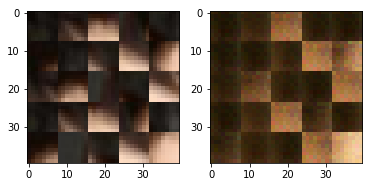

EPO: 0, recon_loss: 0.0250, total_loss: 0.0361
EPO: 0, recon_loss: 0.0583, total_loss: 0.1126
EPO: 0, recon_loss: 0.0193, total_loss: 0.0435
EPO: 0, recon_loss: 0.0496, total_loss: 0.0774
EPO: 0, recon_loss: 0.0271, total_loss: 0.0429
EPO: 0, recon_loss: 0.0308, total_loss: 0.0465
EPO: 0, recon_loss: 0.0261, total_loss: 0.0341
EPO: 0, recon_loss: 0.0173, total_loss: 0.0267
EPO: 0, recon_loss: 0.0256, total_loss: 0.0351
EPO: 0, recon_loss: 0.0244, total_loss: 0.0343
######### what? the reconstruction psnr is: 17.1310


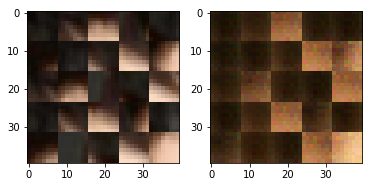

EPO: 0, recon_loss: 0.0165, total_loss: 0.0236
EPO: 0, recon_loss: 0.0701, total_loss: 0.0969
EPO: 0, recon_loss: 0.0348, total_loss: 0.0590
EPO: 0, recon_loss: 0.0435, total_loss: 0.0677
EPO: 0, recon_loss: 0.0344, total_loss: 0.0547
EPO: 0, recon_loss: 0.0186, total_loss: 0.0406
EPO: 0, recon_loss: 0.0772, total_loss: 0.1148
EPO: 0, recon_loss: 0.0393, total_loss: 0.0753
EPO: 0, recon_loss: 0.0575, total_loss: 0.0837
EPO: 0, recon_loss: 0.0665, total_loss: 0.0844
######### what? the reconstruction psnr is: 17.8377


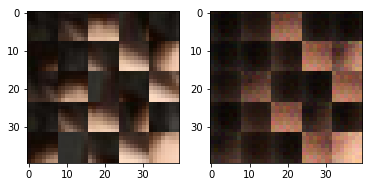

EPO: 0, recon_loss: 0.0411, total_loss: 0.0583
EPO: 0, recon_loss: 0.0836, total_loss: 0.1103
EPO: 0, recon_loss: 0.0125, total_loss: 0.0390
EPO: 0, recon_loss: 0.0438, total_loss: 0.0597
EPO: 0, recon_loss: 0.0571, total_loss: 0.0789
EPO: 0, recon_loss: 0.0328, total_loss: 0.0470
EPO: 0, recon_loss: 0.0243, total_loss: 0.0493
EPO: 0, recon_loss: 0.0544, total_loss: 0.0786
EPO: 0, recon_loss: 0.0453, total_loss: 0.0731
EPO: 0, recon_loss: 0.0569, total_loss: 0.0818
######### what? the reconstruction psnr is: 18.2829


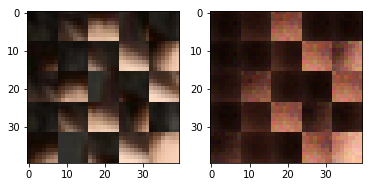

EPO: 0, recon_loss: 0.0222, total_loss: 0.0378
EPO: 0, recon_loss: 0.0328, total_loss: 0.0479
EPO: 0, recon_loss: 0.0251, total_loss: 0.0388
EPO: 0, recon_loss: 0.0381, total_loss: 0.0511
EPO: 0, recon_loss: 0.0505, total_loss: 0.0703
EPO: 0, recon_loss: 0.0298, total_loss: 0.0415
EPO: 0, recon_loss: 0.0259, total_loss: 0.0405
EPO: 0, recon_loss: 0.0455, total_loss: 0.0685
EPO: 0, recon_loss: 0.0225, total_loss: 0.0498
EPO: 0, recon_loss: 0.0472, total_loss: 0.0670
######### what? the reconstruction psnr is: 17.7320


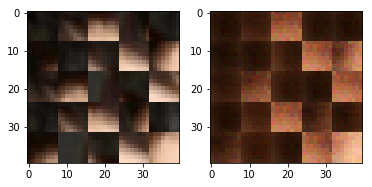

EPO: 0, recon_loss: 0.0356, total_loss: 0.0595
EPO: 0, recon_loss: 0.0412, total_loss: 0.0566
EPO: 0, recon_loss: 0.0448, total_loss: 0.0752
EPO: 0, recon_loss: 0.0093, total_loss: 0.0269
EPO: 0, recon_loss: 0.0274, total_loss: 0.0422
EPO: 0, recon_loss: 0.0240, total_loss: 0.0400
EPO: 0, recon_loss: 0.0247, total_loss: 0.0437
EPO: 0, recon_loss: 0.0433, total_loss: 0.0690
EPO: 0, recon_loss: 0.0279, total_loss: 0.0484
EPO: 0, recon_loss: 0.0538, total_loss: 0.0739
######### what? the reconstruction psnr is: 17.9235


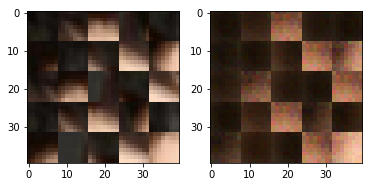

EPO: 0, recon_loss: 0.0297, total_loss: 0.0519
EPO: 0, recon_loss: 0.0441, total_loss: 0.0660
EPO: 0, recon_loss: 0.0536, total_loss: 0.0946
EPO: 0, recon_loss: 0.0207, total_loss: 0.0450
EPO: 0, recon_loss: 0.0524, total_loss: 0.0748
EPO: 0, recon_loss: 0.0282, total_loss: 0.0505
EPO: 0, recon_loss: 0.0440, total_loss: 0.0688
EPO: 0, recon_loss: 0.0149, total_loss: 0.0212
EPO: 0, recon_loss: 0.0181, total_loss: 0.0256
EPO: 0, recon_loss: 0.0226, total_loss: 0.0354
######### what? the reconstruction psnr is: 18.4041


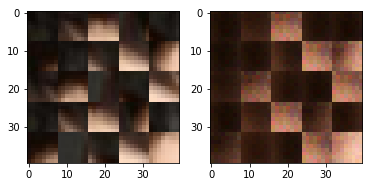

EPO: 0, recon_loss: 0.0196, total_loss: 0.0340
EPO: 0, recon_loss: 0.0259, total_loss: 0.0367
EPO: 0, recon_loss: 0.0504, total_loss: 0.0974
EPO: 0, recon_loss: 0.0576, total_loss: 0.0971
EPO: 0, recon_loss: 0.0603, total_loss: 0.1088
EPO: 0, recon_loss: 0.0558, total_loss: 0.0949
EPO: 0, recon_loss: 0.0545, total_loss: 0.1022
EPO: 0, recon_loss: 0.0582, total_loss: 0.1165
EPO: 0, recon_loss: 0.0363, total_loss: 0.0715
EPO: 0, recon_loss: 0.0622, total_loss: 0.0964
######### what? the reconstruction psnr is: 18.1453


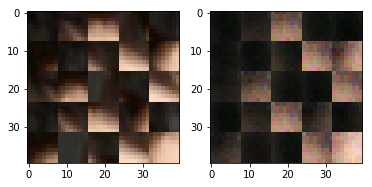

EPO: 0, recon_loss: 0.0571, total_loss: 0.0834
EPO: 0, recon_loss: 0.0345, total_loss: 0.0588
EPO: 0, recon_loss: 0.0236, total_loss: 0.0718
EPO: 0, recon_loss: 0.0330, total_loss: 0.0655
EPO: 0, recon_loss: 0.0428, total_loss: 0.0722
EPO: 0, recon_loss: 0.0271, total_loss: 0.0506
EPO: 0, recon_loss: 0.0245, total_loss: 0.0467
EPO: 0, recon_loss: 0.0336, total_loss: 0.0532
EPO: 0, recon_loss: 0.0173, total_loss: 0.0441
EPO: 0, recon_loss: 0.0429, total_loss: 0.0671
######### what? the reconstruction psnr is: 19.8399


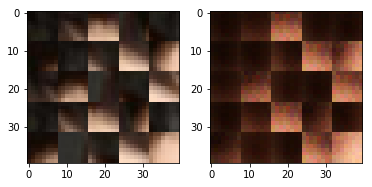

EPO: 0, recon_loss: 0.0227, total_loss: 0.0454
EPO: 0, recon_loss: 0.0165, total_loss: 0.0411
EPO: 0, recon_loss: 0.0401, total_loss: 0.0763
EPO: 0, recon_loss: 0.0149, total_loss: 0.0390
EPO: 0, recon_loss: 0.0504, total_loss: 0.0785
EPO: 0, recon_loss: 0.0502, total_loss: 0.0725
EPO: 0, recon_loss: 0.0372, total_loss: 0.0637
EPO: 0, recon_loss: 0.0384, total_loss: 0.0601
EPO: 0, recon_loss: 0.0156, total_loss: 0.0422
EPO: 0, recon_loss: 0.0514, total_loss: 0.0721
######### what? the reconstruction psnr is: 19.9129


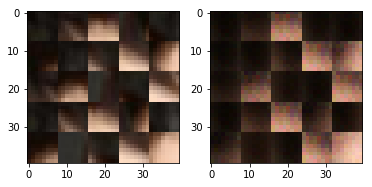

EPO: 0, recon_loss: 0.0340, total_loss: 0.0472
EPO: 0, recon_loss: 0.0352, total_loss: 0.0514
EPO: 0, recon_loss: 0.0287, total_loss: 0.0479
EPO: 0, recon_loss: 0.0201, total_loss: 0.0426
EPO: 0, recon_loss: 0.0338, total_loss: 0.0569
EPO: 0, recon_loss: 0.0216, total_loss: 0.0398
EPO: 0, recon_loss: 0.0165, total_loss: 0.0325
EPO: 0, recon_loss: 0.0148, total_loss: 0.0298
EPO: 0, recon_loss: 0.0689, total_loss: 0.1092
EPO: 0, recon_loss: 0.0393, total_loss: 0.0634
######### what? the reconstruction psnr is: 17.7635


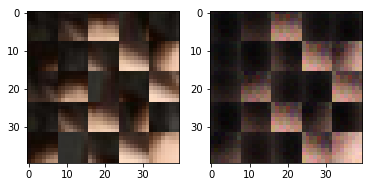

EPO: 0, recon_loss: 0.0337, total_loss: 0.0484
EPO: 0, recon_loss: 0.0443, total_loss: 0.0624
EPO: 0, recon_loss: 0.0339, total_loss: 0.0440
EPO: 0, recon_loss: 0.0224, total_loss: 0.0714
EPO: 0, recon_loss: 0.0133, total_loss: 0.0446
EPO: 0, recon_loss: 0.0435, total_loss: 0.0633
EPO: 0, recon_loss: 0.0272, total_loss: 0.0475
EPO: 0, recon_loss: 0.0379, total_loss: 0.0551
EPO: 0, recon_loss: 0.0168, total_loss: 0.0262
EPO: 0, recon_loss: 0.0095, total_loss: 0.0190
######### what? the reconstruction psnr is: 20.5836


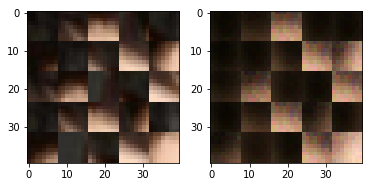

EPO: 0, recon_loss: 0.0247, total_loss: 0.0336
EPO: 0, recon_loss: 0.0118, total_loss: 0.0221
EPO: 0, recon_loss: 0.0146, total_loss: 0.0255
EPO: 0, recon_loss: 0.0316, total_loss: 0.0494
EPO: 0, recon_loss: 0.0283, total_loss: 0.0458
EPO: 0, recon_loss: 0.0272, total_loss: 0.0405
EPO: 0, recon_loss: 0.0146, total_loss: 0.0277
EPO: 0, recon_loss: 0.0225, total_loss: 0.0315
EPO: 0, recon_loss: 0.0558, total_loss: 0.0819
EPO: 0, recon_loss: 0.0436, total_loss: 0.0637
######### what? the reconstruction psnr is: 21.0112


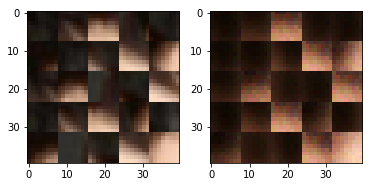

EPO: 0, recon_loss: 0.0371, total_loss: 0.0499
EPO: 0, recon_loss: 0.0355, total_loss: 0.0506
EPO: 0, recon_loss: 0.0305, total_loss: 0.0449
EPO: 0, recon_loss: 0.0447, total_loss: 0.0883
EPO: 0, recon_loss: 0.0841, total_loss: 0.1081
EPO: 0, recon_loss: 0.0327, total_loss: 0.0477
EPO: 0, recon_loss: 0.0345, total_loss: 0.0479
EPO: 0, recon_loss: 0.0240, total_loss: 0.0399
EPO: 0, recon_loss: 0.0296, total_loss: 0.0569
EPO: 0, recon_loss: 0.0158, total_loss: 0.0421
######### what? the reconstruction psnr is: 19.6959


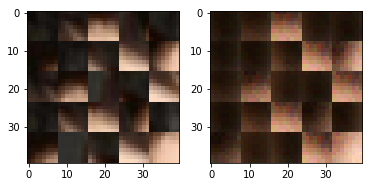

EPO: 0, recon_loss: 0.0245, total_loss: 0.0402
EPO: 0, recon_loss: 0.0206, total_loss: 0.0386
EPO: 0, recon_loss: 0.0199, total_loss: 0.0321
EPO: 0, recon_loss: 0.0221, total_loss: 0.0681
EPO: 0, recon_loss: 0.0108, total_loss: 0.0339
EPO: 0, recon_loss: 0.0204, total_loss: 0.0410
EPO: 0, recon_loss: 0.0080, total_loss: 0.0203
EPO: 0, recon_loss: 0.0054, total_loss: 0.0127
EPO: 0, recon_loss: 0.0569, total_loss: 0.0841
EPO: 0, recon_loss: 0.0402, total_loss: 0.0551
######### what? the reconstruction psnr is: 20.6782


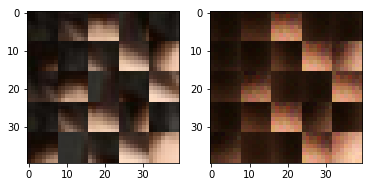

EPO: 0, recon_loss: 0.0368, total_loss: 0.0566
EPO: 0, recon_loss: 0.0281, total_loss: 0.0465
EPO: 0, recon_loss: 0.0300, total_loss: 0.0456
EPO: 1, recon_loss: 0.0180, total_loss: 0.0358
EPO: 1, recon_loss: 0.0085, total_loss: 0.0236
EPO: 1, recon_loss: 0.0186, total_loss: 0.0271
EPO: 1, recon_loss: 0.0227, total_loss: 0.0326
EPO: 1, recon_loss: 0.0111, total_loss: 0.0187
EPO: 1, recon_loss: 0.0212, total_loss: 0.0628
EPO: 1, recon_loss: 0.0097, total_loss: 0.0283
######### what? the reconstruction psnr is: 20.8820


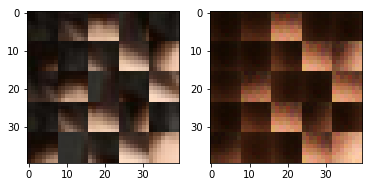

EPO: 1, recon_loss: 0.0166, total_loss: 0.0320
EPO: 1, recon_loss: 0.0211, total_loss: 0.0317
EPO: 1, recon_loss: 0.0206, total_loss: 0.0324
EPO: 1, recon_loss: 0.0220, total_loss: 0.0491
EPO: 1, recon_loss: 0.0188, total_loss: 0.0399
EPO: 1, recon_loss: 0.0209, total_loss: 0.0395
EPO: 1, recon_loss: 0.0148, total_loss: 0.0275
EPO: 1, recon_loss: 0.0176, total_loss: 0.0249
EPO: 1, recon_loss: 0.0539, total_loss: 0.0710
EPO: 1, recon_loss: 0.0176, total_loss: 0.0303
######### what? the reconstruction psnr is: 21.2875


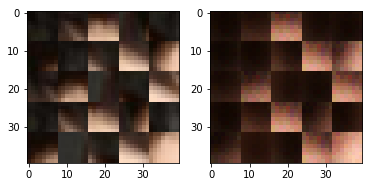

EPO: 1, recon_loss: 0.0187, total_loss: 0.0362
EPO: 1, recon_loss: 0.0231, total_loss: 0.0379
EPO: 1, recon_loss: 0.0153, total_loss: 0.0270
EPO: 1, recon_loss: 0.0215, total_loss: 0.0331
EPO: 1, recon_loss: 0.0192, total_loss: 0.0355
EPO: 1, recon_loss: 0.0174, total_loss: 0.0310
EPO: 1, recon_loss: 0.0311, total_loss: 0.0427
EPO: 1, recon_loss: 0.0131, total_loss: 0.0249
EPO: 1, recon_loss: 0.0189, total_loss: 0.0261
EPO: 1, recon_loss: 0.0580, total_loss: 0.0830
######### what? the reconstruction psnr is: 19.1385


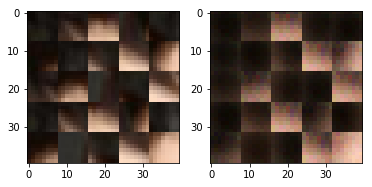

EPO: 1, recon_loss: 0.0266, total_loss: 0.0468
EPO: 1, recon_loss: 0.0373, total_loss: 0.0549
EPO: 1, recon_loss: 0.0344, total_loss: 0.0517
EPO: 1, recon_loss: 0.0430, total_loss: 0.0580
EPO: 1, recon_loss: 0.0474, total_loss: 0.0706
EPO: 1, recon_loss: 0.0198, total_loss: 0.0329
EPO: 1, recon_loss: 0.0265, total_loss: 0.0380
EPO: 1, recon_loss: 0.0156, total_loss: 0.0249
EPO: 1, recon_loss: 0.0225, total_loss: 0.0411
EPO: 1, recon_loss: 0.0075, total_loss: 0.0136
######### what? the reconstruction psnr is: 19.4750


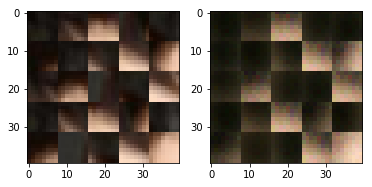

EPO: 1, recon_loss: 0.0104, total_loss: 0.0192
EPO: 1, recon_loss: 0.0234, total_loss: 0.0387
EPO: 1, recon_loss: 0.0154, total_loss: 0.0287
EPO: 1, recon_loss: 0.0183, total_loss: 0.0384
EPO: 1, recon_loss: 0.0182, total_loss: 0.0407
EPO: 1, recon_loss: 0.0161, total_loss: 0.0391
EPO: 1, recon_loss: 0.0255, total_loss: 0.0417
EPO: 1, recon_loss: 0.0102, total_loss: 0.0254
EPO: 1, recon_loss: 0.0228, total_loss: 0.0380
EPO: 1, recon_loss: 0.0509, total_loss: 0.0832
######### what? the reconstruction psnr is: 21.7459


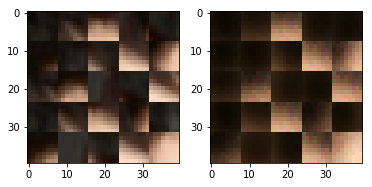

EPO: 1, recon_loss: 0.0136, total_loss: 0.0315
EPO: 1, recon_loss: 0.0442, total_loss: 0.0556
EPO: 1, recon_loss: 0.0145, total_loss: 0.0288
EPO: 1, recon_loss: 0.0203, total_loss: 0.0312
EPO: 1, recon_loss: 0.0297, total_loss: 0.0467
EPO: 1, recon_loss: 0.0182, total_loss: 0.0303
EPO: 1, recon_loss: 0.0243, total_loss: 0.0392
EPO: 1, recon_loss: 0.0167, total_loss: 0.0268
EPO: 1, recon_loss: 0.0277, total_loss: 0.0378
EPO: 1, recon_loss: 0.0832, total_loss: 0.1078
######### what? the reconstruction psnr is: 21.6766


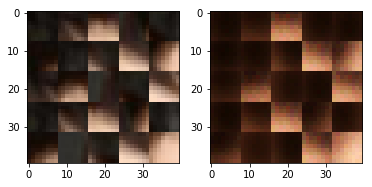

EPO: 1, recon_loss: 0.0313, total_loss: 0.0534
EPO: 1, recon_loss: 0.0511, total_loss: 0.0731
EPO: 1, recon_loss: 0.0313, total_loss: 0.0518
EPO: 1, recon_loss: 0.0268, total_loss: 0.0473
EPO: 1, recon_loss: 0.0304, total_loss: 0.0648
EPO: 1, recon_loss: 0.0226, total_loss: 0.0392
EPO: 1, recon_loss: 0.0447, total_loss: 0.0687
EPO: 1, recon_loss: 0.0360, total_loss: 0.0537
EPO: 1, recon_loss: 0.0342, total_loss: 0.0546
EPO: 1, recon_loss: 0.0427, total_loss: 0.0743
######### what? the reconstruction psnr is: 21.4546


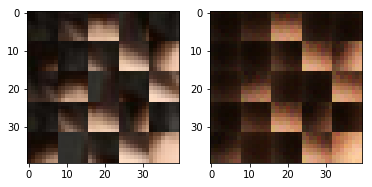

EPO: 1, recon_loss: 0.0131, total_loss: 0.0408
EPO: 1, recon_loss: 0.0442, total_loss: 0.0634
EPO: 1, recon_loss: 0.0193, total_loss: 0.0376
EPO: 1, recon_loss: 0.0198, total_loss: 0.0401
EPO: 1, recon_loss: 0.0381, total_loss: 0.0710
EPO: 1, recon_loss: 0.0308, total_loss: 0.0650
EPO: 1, recon_loss: 0.0539, total_loss: 0.0880
EPO: 1, recon_loss: 0.0517, total_loss: 0.0829
EPO: 1, recon_loss: 0.0298, total_loss: 0.0600
EPO: 1, recon_loss: 0.0777, total_loss: 0.1162
######### what? the reconstruction psnr is: 21.7547


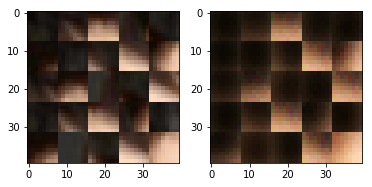

EPO: 1, recon_loss: 0.0285, total_loss: 0.0614
EPO: 1, recon_loss: 0.0464, total_loss: 0.0773
EPO: 1, recon_loss: 0.0479, total_loss: 0.0805
EPO: 1, recon_loss: 0.0415, total_loss: 0.0740
EPO: 1, recon_loss: 0.0331, total_loss: 0.0632
EPO: 1, recon_loss: 0.0243, total_loss: 0.0617
EPO: 1, recon_loss: 0.0758, total_loss: 0.1000
EPO: 1, recon_loss: 0.0526, total_loss: 0.0712
EPO: 1, recon_loss: 0.0203, total_loss: 0.0326
EPO: 1, recon_loss: 0.0187, total_loss: 0.0290
######### what? the reconstruction psnr is: 20.2727


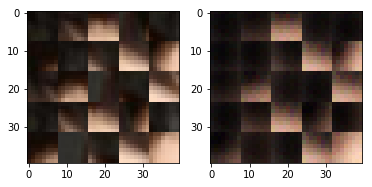

EPO: 1, recon_loss: 0.0158, total_loss: 0.0307
EPO: 1, recon_loss: 0.0222, total_loss: 0.0426
EPO: 1, recon_loss: 0.0270, total_loss: 0.0446
EPO: 1, recon_loss: 0.0207, total_loss: 0.0422
EPO: 1, recon_loss: 0.0327, total_loss: 0.0568
EPO: 1, recon_loss: 0.0071, total_loss: 0.0174
EPO: 1, recon_loss: 0.0092, total_loss: 0.0182
EPO: 1, recon_loss: 0.0125, total_loss: 0.0270
EPO: 1, recon_loss: 0.0055, total_loss: 0.0109
EPO: 1, recon_loss: 0.0137, total_loss: 0.0269
######### what? the reconstruction psnr is: 20.4944


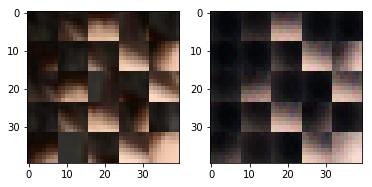

EPO: 1, recon_loss: 0.0322, total_loss: 0.0512
EPO: 1, recon_loss: 0.0228, total_loss: 0.0354
EPO: 1, recon_loss: 0.0379, total_loss: 0.0479
EPO: 1, recon_loss: 0.0208, total_loss: 0.0335
EPO: 1, recon_loss: 0.0229, total_loss: 0.0347
EPO: 1, recon_loss: 0.0340, total_loss: 0.0619
EPO: 1, recon_loss: 0.0545, total_loss: 0.0828
EPO: 1, recon_loss: 0.0459, total_loss: 0.0704
EPO: 1, recon_loss: 0.0336, total_loss: 0.0533
EPO: 1, recon_loss: 0.0231, total_loss: 0.0378
######### what? the reconstruction psnr is: 20.4506


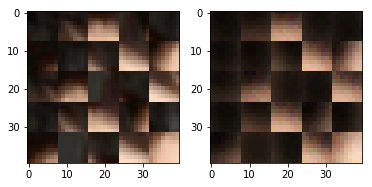

EPO: 1, recon_loss: 0.0237, total_loss: 0.0369
EPO: 1, recon_loss: 0.0165, total_loss: 0.0255
EPO: 1, recon_loss: 0.0224, total_loss: 0.0350
EPO: 1, recon_loss: 0.0130, total_loss: 0.0221
EPO: 1, recon_loss: 0.0166, total_loss: 0.0273
EPO: 1, recon_loss: 0.0268, total_loss: 0.0610
EPO: 1, recon_loss: 0.0063, total_loss: 0.0233
EPO: 1, recon_loss: 0.0437, total_loss: 0.0577
EPO: 1, recon_loss: 0.0195, total_loss: 0.0307
EPO: 1, recon_loss: 0.0254, total_loss: 0.0381
######### what? the reconstruction psnr is: 21.5139


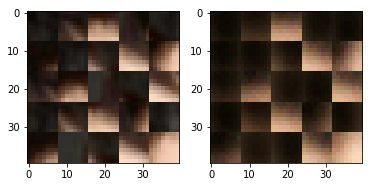

EPO: 1, recon_loss: 0.0115, total_loss: 0.0182
EPO: 1, recon_loss: 0.0102, total_loss: 0.0166
EPO: 1, recon_loss: 0.0163, total_loss: 0.0268
EPO: 1, recon_loss: 0.0085, total_loss: 0.0160
EPO: 1, recon_loss: 0.0088, total_loss: 0.0146
EPO: 1, recon_loss: 0.0355, total_loss: 0.0571
EPO: 1, recon_loss: 0.0189, total_loss: 0.0339
EPO: 1, recon_loss: 0.0339, total_loss: 0.0484
EPO: 1, recon_loss: 0.0190, total_loss: 0.0332
EPO: 1, recon_loss: 0.0118, total_loss: 0.0253
######### what? the reconstruction psnr is: 20.8720


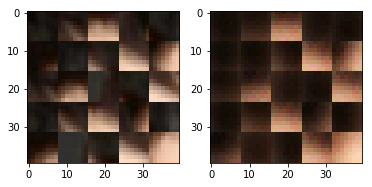

EPO: 1, recon_loss: 0.0269, total_loss: 0.0575
EPO: 1, recon_loss: 0.0172, total_loss: 0.0399
EPO: 1, recon_loss: 0.0491, total_loss: 0.0648
EPO: 1, recon_loss: 0.0212, total_loss: 0.0362
EPO: 1, recon_loss: 0.0327, total_loss: 0.0479
EPO: 1, recon_loss: 0.0403, total_loss: 0.0663
EPO: 1, recon_loss: 0.0064, total_loss: 0.0209
EPO: 1, recon_loss: 0.0263, total_loss: 0.0398
EPO: 1, recon_loss: 0.0233, total_loss: 0.0362
EPO: 1, recon_loss: 0.0223, total_loss: 0.0360
######### what? the reconstruction psnr is: 19.5875


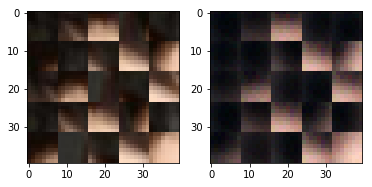

EPO: 1, recon_loss: 0.0459, total_loss: 0.0689
EPO: 1, recon_loss: 0.0316, total_loss: 0.0491
EPO: 1, recon_loss: 0.0244, total_loss: 0.0443
EPO: 1, recon_loss: 0.0265, total_loss: 0.0430
EPO: 1, recon_loss: 0.0119, total_loss: 0.0227
EPO: 1, recon_loss: 0.0330, total_loss: 0.0517
EPO: 1, recon_loss: 0.0155, total_loss: 0.0241
EPO: 1, recon_loss: 0.0269, total_loss: 0.0391
EPO: 1, recon_loss: 0.0312, total_loss: 0.0440
EPO: 1, recon_loss: 0.0174, total_loss: 0.0260
######### what? the reconstruction psnr is: 21.7090


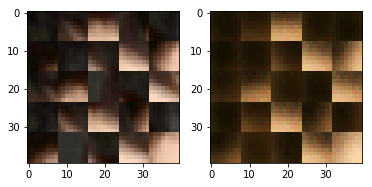

EPO: 1, recon_loss: 0.0159, total_loss: 0.0265
EPO: 1, recon_loss: 0.0206, total_loss: 0.0376
EPO: 1, recon_loss: 0.0182, total_loss: 0.0342
EPO: 1, recon_loss: 0.0312, total_loss: 0.0461
EPO: 1, recon_loss: 0.0239, total_loss: 0.0421
EPO: 1, recon_loss: 0.0311, total_loss: 0.0426
EPO: 1, recon_loss: 0.0163, total_loss: 0.0345
EPO: 1, recon_loss: 0.0083, total_loss: 0.0189
EPO: 1, recon_loss: 0.0162, total_loss: 0.0270
EPO: 1, recon_loss: 0.0154, total_loss: 0.0280
######### what? the reconstruction psnr is: 22.3288


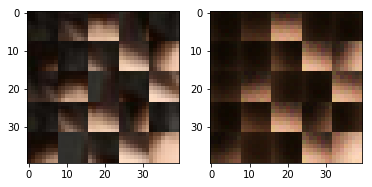

EPO: 1, recon_loss: 0.0213, total_loss: 0.0380
EPO: 1, recon_loss: 0.0189, total_loss: 0.0363
EPO: 1, recon_loss: 0.0227, total_loss: 0.0372
EPO: 1, recon_loss: 0.0446, total_loss: 0.0618
EPO: 1, recon_loss: 0.0197, total_loss: 0.0373
EPO: 1, recon_loss: 0.0449, total_loss: 0.0627
EPO: 1, recon_loss: 0.0245, total_loss: 0.0457
EPO: 1, recon_loss: 0.0131, total_loss: 0.0292
EPO: 1, recon_loss: 0.0455, total_loss: 0.0616
EPO: 1, recon_loss: 0.0226, total_loss: 0.0388
######### what? the reconstruction psnr is: 21.5585


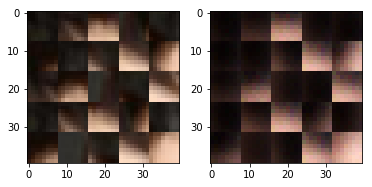

EPO: 1, recon_loss: 0.0390, total_loss: 0.0528
EPO: 1, recon_loss: 0.0093, total_loss: 0.0143
EPO: 1, recon_loss: 0.0105, total_loss: 0.0162
EPO: 1, recon_loss: 0.0206, total_loss: 0.0290
EPO: 1, recon_loss: 0.0107, total_loss: 0.0223
EPO: 1, recon_loss: 0.0290, total_loss: 0.0375
EPO: 1, recon_loss: 0.0369, total_loss: 0.0715
EPO: 1, recon_loss: 0.0319, total_loss: 0.0627
EPO: 1, recon_loss: 0.0453, total_loss: 0.0837
EPO: 1, recon_loss: 0.0342, total_loss: 0.0613
######### what? the reconstruction psnr is: 22.8707


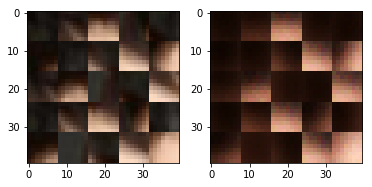

EPO: 1, recon_loss: 0.0432, total_loss: 0.0796
EPO: 1, recon_loss: 0.0334, total_loss: 0.0659
EPO: 1, recon_loss: 0.0274, total_loss: 0.0425
EPO: 1, recon_loss: 0.0362, total_loss: 0.0665
EPO: 1, recon_loss: 0.0275, total_loss: 0.0474
EPO: 1, recon_loss: 0.0208, total_loss: 0.0392
EPO: 1, recon_loss: 0.0193, total_loss: 0.0519
EPO: 1, recon_loss: 0.0211, total_loss: 0.0461
EPO: 1, recon_loss: 0.0407, total_loss: 0.0605
EPO: 1, recon_loss: 0.0149, total_loss: 0.0328
######### what? the reconstruction psnr is: 23.2686


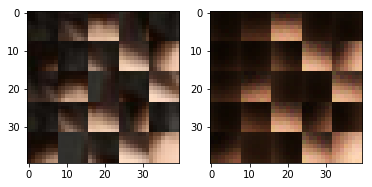

EPO: 1, recon_loss: 0.0140, total_loss: 0.0302
EPO: 1, recon_loss: 0.0248, total_loss: 0.0446
EPO: 1, recon_loss: 0.0096, total_loss: 0.0292
EPO: 1, recon_loss: 0.0355, total_loss: 0.0514
EPO: 1, recon_loss: 0.0111, total_loss: 0.0287
EPO: 1, recon_loss: 0.0122, total_loss: 0.0286
EPO: 1, recon_loss: 0.0217, total_loss: 0.0402
EPO: 1, recon_loss: 0.0091, total_loss: 0.0282
EPO: 1, recon_loss: 0.0366, total_loss: 0.0550
EPO: 1, recon_loss: 0.0281, total_loss: 0.0484
######### what? the reconstruction psnr is: 22.0689


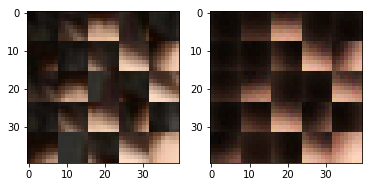

EPO: 1, recon_loss: 0.0200, total_loss: 0.0367
EPO: 1, recon_loss: 0.0300, total_loss: 0.0630
EPO: 1, recon_loss: 0.0099, total_loss: 0.0280
EPO: 1, recon_loss: 0.0477, total_loss: 0.0676
EPO: 1, recon_loss: 0.0207, total_loss: 0.0285
EPO: 1, recon_loss: 0.0213, total_loss: 0.0340
EPO: 1, recon_loss: 0.0215, total_loss: 0.0418
EPO: 1, recon_loss: 0.0120, total_loss: 0.0273
EPO: 1, recon_loss: 0.0257, total_loss: 0.0410
EPO: 1, recon_loss: 0.0117, total_loss: 0.0244
######### what? the reconstruction psnr is: 22.9907


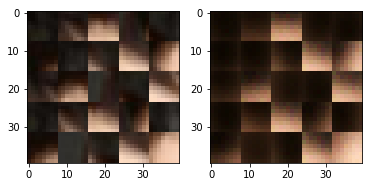

EPO: 1, recon_loss: 0.0156, total_loss: 0.0261
EPO: 1, recon_loss: 0.0412, total_loss: 0.0657
EPO: 1, recon_loss: 0.0465, total_loss: 0.0745
EPO: 1, recon_loss: 0.0305, total_loss: 0.0452
EPO: 1, recon_loss: 0.0303, total_loss: 0.0450
EPO: 1, recon_loss: 0.0393, total_loss: 0.0517
EPO: 1, recon_loss: 0.0154, total_loss: 0.0239
EPO: 1, recon_loss: 0.0127, total_loss: 0.0435
EPO: 1, recon_loss: 0.0185, total_loss: 0.0384
EPO: 1, recon_loss: 0.0287, total_loss: 0.0466
######### what? the reconstruction psnr is: 21.9596


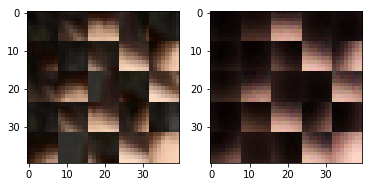

EPO: 1, recon_loss: 0.0248, total_loss: 0.0395
EPO: 1, recon_loss: 0.0369, total_loss: 0.0504
EPO: 1, recon_loss: 0.0086, total_loss: 0.0148
EPO: 1, recon_loss: 0.0127, total_loss: 0.0203
EPO: 1, recon_loss: 0.0129, total_loss: 0.0200
EPO: 1, recon_loss: 0.0074, total_loss: 0.0141
EPO: 1, recon_loss: 0.0163, total_loss: 0.0239
EPO: 1, recon_loss: 0.0273, total_loss: 0.0417
EPO: 1, recon_loss: 0.0222, total_loss: 0.0332
EPO: 1, recon_loss: 0.0198, total_loss: 0.0315
######### what? the reconstruction psnr is: 21.2573


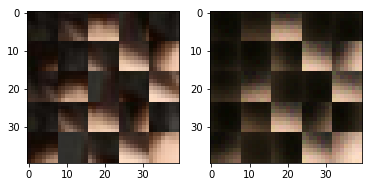

EPO: 1, recon_loss: 0.0146, total_loss: 0.0227
EPO: 1, recon_loss: 0.0233, total_loss: 0.0299
EPO: 1, recon_loss: 0.0363, total_loss: 0.0554
EPO: 1, recon_loss: 0.0273, total_loss: 0.0420
EPO: 1, recon_loss: 0.0326, total_loss: 0.0430
EPO: 1, recon_loss: 0.0230, total_loss: 0.0338
EPO: 1, recon_loss: 0.0245, total_loss: 0.0352
EPO: 1, recon_loss: 0.0361, total_loss: 0.0684
EPO: 1, recon_loss: 0.0391, total_loss: 0.0540
EPO: 1, recon_loss: 0.0267, total_loss: 0.0383
######### what? the reconstruction psnr is: 22.7825


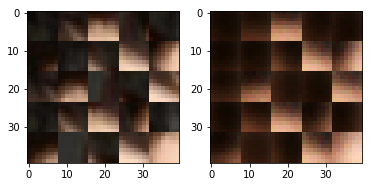

EPO: 1, recon_loss: 0.0184, total_loss: 0.0281
EPO: 1, recon_loss: 0.0177, total_loss: 0.0302
EPO: 1, recon_loss: 0.0120, total_loss: 0.0305
EPO: 1, recon_loss: 0.0153, total_loss: 0.0327
EPO: 1, recon_loss: 0.0208, total_loss: 0.0286
EPO: 1, recon_loss: 0.0180, total_loss: 0.0331
EPO: 1, recon_loss: 0.0230, total_loss: 0.0321
EPO: 1, recon_loss: 0.0139, total_loss: 0.0437
EPO: 1, recon_loss: 0.0073, total_loss: 0.0231
EPO: 1, recon_loss: 0.0163, total_loss: 0.0295
######### what? the reconstruction psnr is: 21.6897


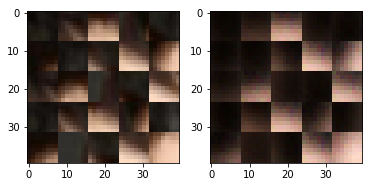

EPO: 1, recon_loss: 0.0045, total_loss: 0.0107
EPO: 1, recon_loss: 0.0045, total_loss: 0.0092
EPO: 1, recon_loss: 0.0363, total_loss: 0.0521
EPO: 1, recon_loss: 0.0259, total_loss: 0.0396
EPO: 1, recon_loss: 0.0272, total_loss: 0.0433
EPO: 1, recon_loss: 0.0203, total_loss: 0.0353
EPO: 1, recon_loss: 0.0214, total_loss: 0.0312
EPO: 2, recon_loss: 0.0110, total_loss: 0.0217
EPO: 2, recon_loss: 0.0067, total_loss: 0.0154
EPO: 2, recon_loss: 0.0199, total_loss: 0.0262
######### what? the reconstruction psnr is: 22.8536


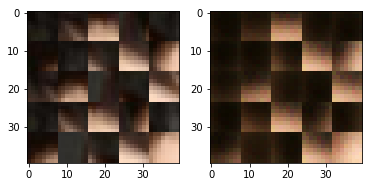

EPO: 2, recon_loss: 0.0091, total_loss: 0.0160
EPO: 2, recon_loss: 0.0078, total_loss: 0.0140
EPO: 2, recon_loss: 0.0110, total_loss: 0.0338
EPO: 2, recon_loss: 0.0071, total_loss: 0.0206
EPO: 2, recon_loss: 0.0112, total_loss: 0.0234
EPO: 2, recon_loss: 0.0107, total_loss: 0.0162
EPO: 2, recon_loss: 0.0168, total_loss: 0.0271
EPO: 2, recon_loss: 0.0112, total_loss: 0.0337
EPO: 2, recon_loss: 0.0123, total_loss: 0.0261
EPO: 2, recon_loss: 0.0163, total_loss: 0.0285
######### what? the reconstruction psnr is: 22.6368


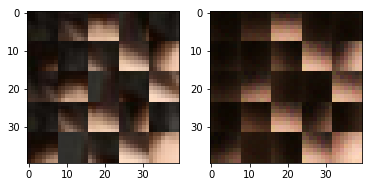

EPO: 2, recon_loss: 0.0102, total_loss: 0.0177
EPO: 2, recon_loss: 0.0150, total_loss: 0.0233
EPO: 2, recon_loss: 0.0199, total_loss: 0.0313
EPO: 2, recon_loss: 0.0144, total_loss: 0.0266
EPO: 2, recon_loss: 0.0133, total_loss: 0.0246
EPO: 2, recon_loss: 0.0148, total_loss: 0.0255
EPO: 2, recon_loss: 0.0108, total_loss: 0.0183
EPO: 2, recon_loss: 0.0237, total_loss: 0.0374
EPO: 2, recon_loss: 0.0134, total_loss: 0.0249
EPO: 2, recon_loss: 0.0166, total_loss: 0.0266
######### what? the reconstruction psnr is: 22.9861


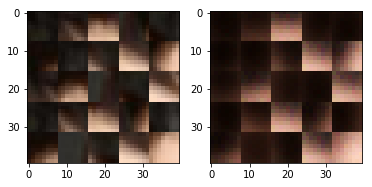

EPO: 2, recon_loss: 0.0212, total_loss: 0.0314
EPO: 2, recon_loss: 0.0098, total_loss: 0.0166
EPO: 2, recon_loss: 0.0188, total_loss: 0.0294
EPO: 2, recon_loss: 0.0217, total_loss: 0.0380
EPO: 2, recon_loss: 0.0220, total_loss: 0.0369
EPO: 2, recon_loss: 0.0300, total_loss: 0.0437
EPO: 2, recon_loss: 0.0354, total_loss: 0.0522
EPO: 2, recon_loss: 0.0283, total_loss: 0.0391
EPO: 2, recon_loss: 0.0253, total_loss: 0.0384
EPO: 2, recon_loss: 0.0199, total_loss: 0.0323
######### what? the reconstruction psnr is: 22.5296


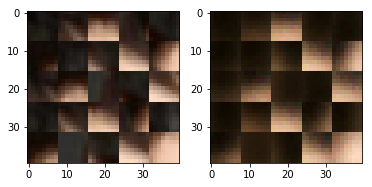

EPO: 2, recon_loss: 0.0181, total_loss: 0.0267
EPO: 2, recon_loss: 0.0148, total_loss: 0.0215
EPO: 2, recon_loss: 0.0263, total_loss: 0.0370
EPO: 2, recon_loss: 0.0058, total_loss: 0.0100
EPO: 2, recon_loss: 0.0110, total_loss: 0.0201
EPO: 2, recon_loss: 0.0165, total_loss: 0.0266
EPO: 2, recon_loss: 0.0116, total_loss: 0.0220
EPO: 2, recon_loss: 0.0169, total_loss: 0.0325
EPO: 2, recon_loss: 0.0102, total_loss: 0.0282
EPO: 2, recon_loss: 0.0096, total_loss: 0.0266
######### what? the reconstruction psnr is: 23.0284


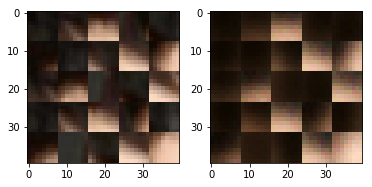

EPO: 2, recon_loss: 0.0223, total_loss: 0.0331
EPO: 2, recon_loss: 0.0073, total_loss: 0.0189
EPO: 2, recon_loss: 0.0234, total_loss: 0.0347
EPO: 2, recon_loss: 0.0370, total_loss: 0.0669
EPO: 2, recon_loss: 0.0124, total_loss: 0.0266
EPO: 2, recon_loss: 0.0329, total_loss: 0.0406
EPO: 2, recon_loss: 0.0103, total_loss: 0.0191
EPO: 2, recon_loss: 0.0195, total_loss: 0.0268
EPO: 2, recon_loss: 0.0222, total_loss: 0.0363
EPO: 2, recon_loss: 0.0109, total_loss: 0.0201
######### what? the reconstruction psnr is: 22.8706


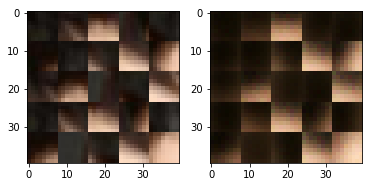

EPO: 2, recon_loss: 0.0217, total_loss: 0.0333
EPO: 2, recon_loss: 0.0133, total_loss: 0.0210
EPO: 2, recon_loss: 0.0262, total_loss: 0.0374
EPO: 2, recon_loss: 0.0345, total_loss: 0.0511
EPO: 2, recon_loss: 0.0283, total_loss: 0.0468
EPO: 2, recon_loss: 0.0495, total_loss: 0.0673
EPO: 2, recon_loss: 0.0296, total_loss: 0.0471
EPO: 2, recon_loss: 0.0205, total_loss: 0.0377
EPO: 2, recon_loss: 0.0177, total_loss: 0.0383
EPO: 2, recon_loss: 0.0189, total_loss: 0.0314
######### what? the reconstruction psnr is: 22.6841


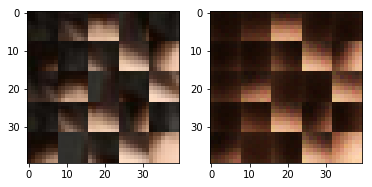

EPO: 2, recon_loss: 0.0316, total_loss: 0.0434
EPO: 2, recon_loss: 0.0283, total_loss: 0.0409
EPO: 2, recon_loss: 0.0214, total_loss: 0.0378
EPO: 2, recon_loss: 0.0201, total_loss: 0.0438
EPO: 2, recon_loss: 0.0093, total_loss: 0.0285
EPO: 2, recon_loss: 0.0332, total_loss: 0.0448
EPO: 2, recon_loss: 0.0133, total_loss: 0.0305
EPO: 2, recon_loss: 0.0156, total_loss: 0.0291
EPO: 2, recon_loss: 0.0265, total_loss: 0.0540
EPO: 2, recon_loss: 0.0234, total_loss: 0.0567
######### what? the reconstruction psnr is: 22.5283


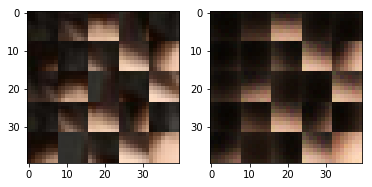

EPO: 2, recon_loss: 0.0474, total_loss: 0.0724
EPO: 2, recon_loss: 0.0259, total_loss: 0.0530
EPO: 2, recon_loss: 0.0219, total_loss: 0.0469
EPO: 2, recon_loss: 0.0480, total_loss: 0.0695
EPO: 2, recon_loss: 0.0211, total_loss: 0.0488
EPO: 2, recon_loss: 0.0555, total_loss: 0.0811
EPO: 2, recon_loss: 0.0301, total_loss: 0.0582
EPO: 2, recon_loss: 0.0322, total_loss: 0.0604
EPO: 2, recon_loss: 0.0250, total_loss: 0.0606
EPO: 2, recon_loss: 0.0221, total_loss: 0.0514
######### what? the reconstruction psnr is: 23.7261


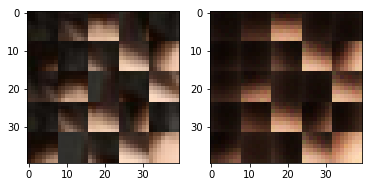

EPO: 2, recon_loss: 0.0504, total_loss: 0.0701
EPO: 2, recon_loss: 0.0461, total_loss: 0.0576
EPO: 2, recon_loss: 0.0110, total_loss: 0.0207
EPO: 2, recon_loss: 0.0266, total_loss: 0.0336
EPO: 2, recon_loss: 0.0112, total_loss: 0.0254
EPO: 2, recon_loss: 0.0196, total_loss: 0.0348
EPO: 2, recon_loss: 0.0178, total_loss: 0.0329
EPO: 2, recon_loss: 0.0194, total_loss: 0.0395
EPO: 2, recon_loss: 0.0320, total_loss: 0.0505
EPO: 2, recon_loss: 0.0042, total_loss: 0.0096
######### what? the reconstruction psnr is: 23.7992


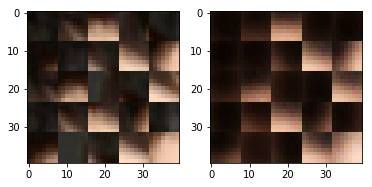

EPO: 2, recon_loss: 0.0064, total_loss: 0.0134
EPO: 2, recon_loss: 0.0064, total_loss: 0.0121
EPO: 2, recon_loss: 0.0047, total_loss: 0.0082
EPO: 2, recon_loss: 0.0129, total_loss: 0.0201
EPO: 2, recon_loss: 0.0182, total_loss: 0.0312
EPO: 2, recon_loss: 0.0186, total_loss: 0.0291
EPO: 2, recon_loss: 0.0267, total_loss: 0.0359
EPO: 2, recon_loss: 0.0135, total_loss: 0.0196
EPO: 2, recon_loss: 0.0245, total_loss: 0.0319
EPO: 2, recon_loss: 0.0268, total_loss: 0.0501
######### what? the reconstruction psnr is: 21.5820


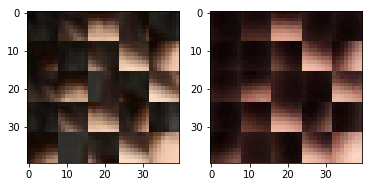

EPO: 2, recon_loss: 0.0413, total_loss: 0.0627
EPO: 2, recon_loss: 0.0348, total_loss: 0.0547
EPO: 2, recon_loss: 0.0210, total_loss: 0.0354
EPO: 2, recon_loss: 0.0228, total_loss: 0.0345
EPO: 2, recon_loss: 0.0182, total_loss: 0.0290
EPO: 2, recon_loss: 0.0139, total_loss: 0.0207
EPO: 2, recon_loss: 0.0175, total_loss: 0.0283
EPO: 2, recon_loss: 0.0141, total_loss: 0.0218
EPO: 2, recon_loss: 0.0186, total_loss: 0.0273
EPO: 2, recon_loss: 0.0168, total_loss: 0.0412
######### what? the reconstruction psnr is: 23.7517


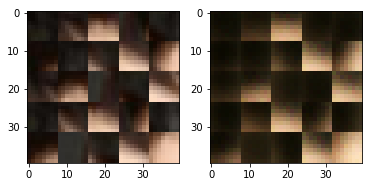

EPO: 2, recon_loss: 0.0073, total_loss: 0.0176
EPO: 2, recon_loss: 0.0265, total_loss: 0.0364
EPO: 2, recon_loss: 0.0172, total_loss: 0.0266
EPO: 2, recon_loss: 0.0262, total_loss: 0.0404
EPO: 2, recon_loss: 0.0085, total_loss: 0.0140
EPO: 2, recon_loss: 0.0075, total_loss: 0.0134
EPO: 2, recon_loss: 0.0130, total_loss: 0.0213
EPO: 2, recon_loss: 0.0053, total_loss: 0.0117
EPO: 2, recon_loss: 0.0067, total_loss: 0.0120
EPO: 2, recon_loss: 0.0201, total_loss: 0.0325
######### what? the reconstruction psnr is: 23.1976


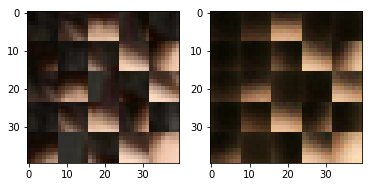

EPO: 2, recon_loss: 0.0129, total_loss: 0.0232
EPO: 2, recon_loss: 0.0318, total_loss: 0.0432
EPO: 2, recon_loss: 0.0159, total_loss: 0.0280
EPO: 2, recon_loss: 0.0094, total_loss: 0.0191
EPO: 2, recon_loss: 0.0137, total_loss: 0.0332
EPO: 2, recon_loss: 0.0119, total_loss: 0.0285
EPO: 2, recon_loss: 0.0458, total_loss: 0.0595
EPO: 2, recon_loss: 0.0138, total_loss: 0.0260
EPO: 2, recon_loss: 0.0332, total_loss: 0.0441
EPO: 2, recon_loss: 0.0105, total_loss: 0.0242
######### what? the reconstruction psnr is: 24.0612


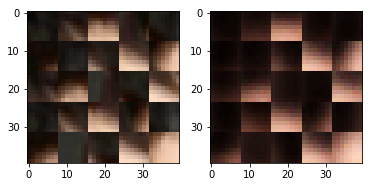

EPO: 2, recon_loss: 0.0035, total_loss: 0.0128
EPO: 2, recon_loss: 0.0293, total_loss: 0.0404
EPO: 2, recon_loss: 0.0155, total_loss: 0.0232
EPO: 2, recon_loss: 0.0157, total_loss: 0.0248
EPO: 2, recon_loss: 0.0251, total_loss: 0.0375
EPO: 2, recon_loss: 0.0222, total_loss: 0.0390
EPO: 2, recon_loss: 0.0237, total_loss: 0.0356
EPO: 2, recon_loss: 0.0127, total_loss: 0.0237
EPO: 2, recon_loss: 0.0090, total_loss: 0.0174
EPO: 2, recon_loss: 0.0188, total_loss: 0.0322
######### what? the reconstruction psnr is: 23.9256


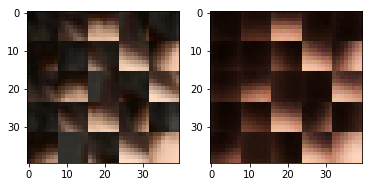

EPO: 2, recon_loss: 0.0097, total_loss: 0.0172
EPO: 2, recon_loss: 0.0265, total_loss: 0.0396
EPO: 2, recon_loss: 0.0114, total_loss: 0.0191
EPO: 2, recon_loss: 0.0105, total_loss: 0.0191
EPO: 2, recon_loss: 0.0212, total_loss: 0.0363
EPO: 2, recon_loss: 0.0157, total_loss: 0.0290
EPO: 2, recon_loss: 0.0162, total_loss: 0.0286
EPO: 2, recon_loss: 0.0212, total_loss: 0.0322
EPO: 2, recon_loss: 0.0213, total_loss: 0.0356
EPO: 2, recon_loss: 0.0179, total_loss: 0.0520
######### what? the reconstruction psnr is: 24.1264


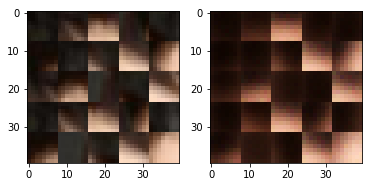

EPO: 2, recon_loss: 0.0098, total_loss: 0.0213
EPO: 2, recon_loss: 0.0105, total_loss: 0.0201
EPO: 2, recon_loss: 0.0095, total_loss: 0.0178
EPO: 2, recon_loss: 0.0140, total_loss: 0.0268
EPO: 2, recon_loss: 0.0160, total_loss: 0.0303
EPO: 2, recon_loss: 0.0098, total_loss: 0.0221
EPO: 2, recon_loss: 0.0232, total_loss: 0.0352
EPO: 2, recon_loss: 0.0336, total_loss: 0.0473
EPO: 2, recon_loss: 0.0221, total_loss: 0.0394
EPO: 2, recon_loss: 0.0376, total_loss: 0.0512
######### what? the reconstruction psnr is: 23.9409


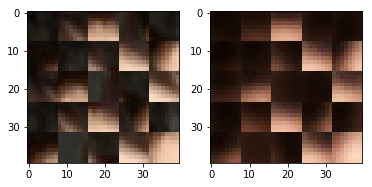

EPO: 2, recon_loss: 0.0131, total_loss: 0.0272
EPO: 2, recon_loss: 0.0133, total_loss: 0.0266
EPO: 2, recon_loss: 0.0243, total_loss: 0.0393
EPO: 2, recon_loss: 0.0179, total_loss: 0.0297
EPO: 2, recon_loss: 0.0296, total_loss: 0.0409
EPO: 2, recon_loss: 0.0068, total_loss: 0.0106
EPO: 2, recon_loss: 0.0061, total_loss: 0.0113
EPO: 2, recon_loss: 0.0189, total_loss: 0.0293
EPO: 2, recon_loss: 0.0089, total_loss: 0.0186
EPO: 2, recon_loss: 0.0206, total_loss: 0.0282
######### what? the reconstruction psnr is: 23.6416


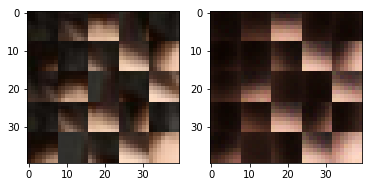

EPO: 2, recon_loss: 0.0358, total_loss: 0.0611
EPO: 2, recon_loss: 0.0208, total_loss: 0.0481
EPO: 2, recon_loss: 0.0386, total_loss: 0.0691
EPO: 2, recon_loss: 0.0285, total_loss: 0.0555
EPO: 2, recon_loss: 0.0333, total_loss: 0.0675
EPO: 2, recon_loss: 0.0174, total_loss: 0.0388
EPO: 2, recon_loss: 0.0208, total_loss: 0.0293
EPO: 2, recon_loss: 0.0256, total_loss: 0.0488
EPO: 2, recon_loss: 0.0171, total_loss: 0.0332
EPO: 2, recon_loss: 0.0195, total_loss: 0.0341
######### what? the reconstruction psnr is: 24.5118


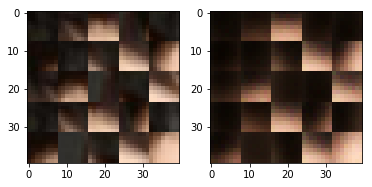

EPO: 2, recon_loss: 0.0174, total_loss: 0.0447
EPO: 2, recon_loss: 0.0167, total_loss: 0.0344
EPO: 2, recon_loss: 0.0355, total_loss: 0.0520
EPO: 2, recon_loss: 0.0115, total_loss: 0.0266
EPO: 2, recon_loss: 0.0112, total_loss: 0.0272
EPO: 2, recon_loss: 0.0194, total_loss: 0.0351
EPO: 2, recon_loss: 0.0069, total_loss: 0.0249
EPO: 2, recon_loss: 0.0359, total_loss: 0.0482
EPO: 2, recon_loss: 0.0082, total_loss: 0.0226
EPO: 2, recon_loss: 0.0147, total_loss: 0.0297
######### what? the reconstruction psnr is: 24.4946


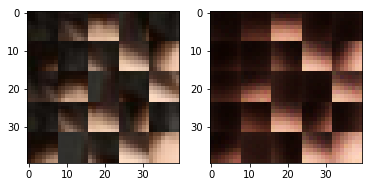

EPO: 2, recon_loss: 0.0121, total_loss: 0.0242
EPO: 2, recon_loss: 0.0096, total_loss: 0.0277
EPO: 2, recon_loss: 0.0364, total_loss: 0.0483
EPO: 2, recon_loss: 0.0141, total_loss: 0.0312
EPO: 2, recon_loss: 0.0145, total_loss: 0.0257
EPO: 2, recon_loss: 0.0184, total_loss: 0.0425
EPO: 2, recon_loss: 0.0074, total_loss: 0.0208
EPO: 2, recon_loss: 0.0390, total_loss: 0.0546
EPO: 2, recon_loss: 0.0097, total_loss: 0.0154
EPO: 2, recon_loss: 0.0186, total_loss: 0.0310
######### what? the reconstruction psnr is: 23.7904


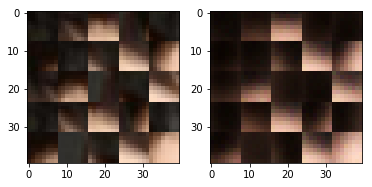

EPO: 2, recon_loss: 0.0133, total_loss: 0.0323
EPO: 2, recon_loss: 0.0071, total_loss: 0.0205
EPO: 2, recon_loss: 0.0242, total_loss: 0.0346
EPO: 2, recon_loss: 0.0064, total_loss: 0.0162
EPO: 2, recon_loss: 0.0147, total_loss: 0.0236
EPO: 2, recon_loss: 0.0409, total_loss: 0.0675
EPO: 2, recon_loss: 0.0310, total_loss: 0.0544
EPO: 2, recon_loss: 0.0214, total_loss: 0.0316
EPO: 2, recon_loss: 0.0229, total_loss: 0.0381
EPO: 2, recon_loss: 0.0182, total_loss: 0.0282
######### what? the reconstruction psnr is: 22.4006


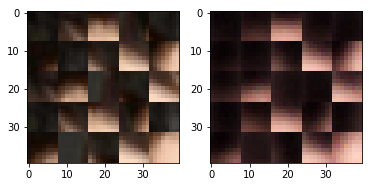

EPO: 2, recon_loss: 0.0138, total_loss: 0.0473
EPO: 2, recon_loss: 0.0082, total_loss: 0.0322
EPO: 2, recon_loss: 0.0140, total_loss: 0.0290
EPO: 2, recon_loss: 0.0190, total_loss: 0.0335
EPO: 2, recon_loss: 0.0246, total_loss: 0.0393
EPO: 2, recon_loss: 0.0128, total_loss: 0.0248
EPO: 2, recon_loss: 0.0053, total_loss: 0.0095
EPO: 2, recon_loss: 0.0126, total_loss: 0.0188
EPO: 2, recon_loss: 0.0078, total_loss: 0.0124
EPO: 2, recon_loss: 0.0058, total_loss: 0.0110
######### what? the reconstruction psnr is: 24.4232


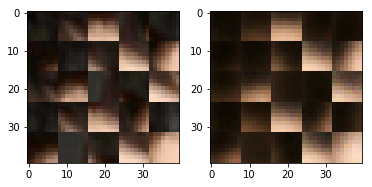

EPO: 2, recon_loss: 0.0141, total_loss: 0.0220
EPO: 2, recon_loss: 0.0149, total_loss: 0.0261
EPO: 2, recon_loss: 0.0202, total_loss: 0.0305
EPO: 2, recon_loss: 0.0147, total_loss: 0.0244
EPO: 2, recon_loss: 0.0125, total_loss: 0.0182
EPO: 2, recon_loss: 0.0237, total_loss: 0.0288
EPO: 2, recon_loss: 0.0219, total_loss: 0.0354
EPO: 2, recon_loss: 0.0249, total_loss: 0.0389
EPO: 2, recon_loss: 0.0227, total_loss: 0.0311
EPO: 2, recon_loss: 0.0185, total_loss: 0.0291
######### what? the reconstruction psnr is: 24.1767


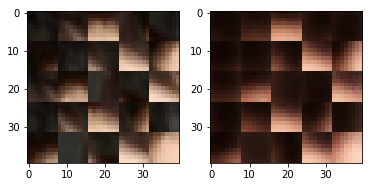

EPO: 2, recon_loss: 0.0229, total_loss: 0.0325
EPO: 2, recon_loss: 0.0268, total_loss: 0.0533
EPO: 2, recon_loss: 0.0239, total_loss: 0.0347
EPO: 2, recon_loss: 0.0199, total_loss: 0.0300
EPO: 2, recon_loss: 0.0125, total_loss: 0.0220
EPO: 2, recon_loss: 0.0152, total_loss: 0.0268
EPO: 2, recon_loss: 0.0077, total_loss: 0.0211
EPO: 2, recon_loss: 0.0093, total_loss: 0.0213
EPO: 2, recon_loss: 0.0185, total_loss: 0.0256
EPO: 2, recon_loss: 0.0187, total_loss: 0.0321
######### what? the reconstruction psnr is: 22.0703


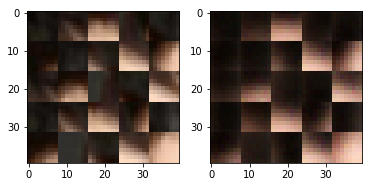

EPO: 2, recon_loss: 0.0349, total_loss: 0.0444
EPO: 2, recon_loss: 0.0095, total_loss: 0.0306
EPO: 2, recon_loss: 0.0078, total_loss: 0.0176
EPO: 2, recon_loss: 0.0118, total_loss: 0.0218
EPO: 2, recon_loss: 0.0030, total_loss: 0.0072
EPO: 2, recon_loss: 0.0061, total_loss: 0.0112
EPO: 2, recon_loss: 0.0232, total_loss: 0.0355
EPO: 2, recon_loss: 0.0165, total_loss: 0.0309
EPO: 2, recon_loss: 0.0229, total_loss: 0.0356
EPO: 2, recon_loss: 0.0172, total_loss: 0.0307
######### what? the reconstruction psnr is: 24.2436


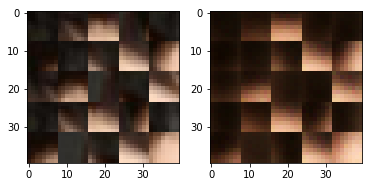

EPO: 2, recon_loss: 0.0155, total_loss: 0.0228
EPO: 3, recon_loss: 0.0066, total_loss: 0.0131
EPO: 3, recon_loss: 0.0056, total_loss: 0.0107
EPO: 3, recon_loss: 0.0192, total_loss: 0.0241
EPO: 3, recon_loss: 0.0068, total_loss: 0.0134
EPO: 3, recon_loss: 0.0122, total_loss: 0.0189
EPO: 3, recon_loss: 0.0078, total_loss: 0.0263
EPO: 3, recon_loss: 0.0066, total_loss: 0.0205
EPO: 3, recon_loss: 0.0123, total_loss: 0.0218
EPO: 3, recon_loss: 0.0099, total_loss: 0.0154
######### what? the reconstruction psnr is: 24.5565


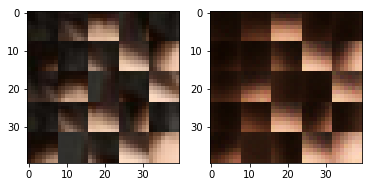

EPO: 3, recon_loss: 0.0155, total_loss: 0.0266
EPO: 3, recon_loss: 0.0078, total_loss: 0.0253
EPO: 3, recon_loss: 0.0068, total_loss: 0.0147
EPO: 3, recon_loss: 0.0111, total_loss: 0.0223
EPO: 3, recon_loss: 0.0069, total_loss: 0.0109
EPO: 3, recon_loss: 0.0147, total_loss: 0.0227
EPO: 3, recon_loss: 0.0133, total_loss: 0.0251
EPO: 3, recon_loss: 0.0111, total_loss: 0.0198
EPO: 3, recon_loss: 0.0127, total_loss: 0.0221
EPO: 3, recon_loss: 0.0106, total_loss: 0.0200
######### what? the reconstruction psnr is: 24.6279


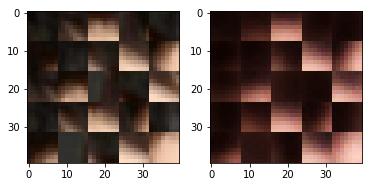

EPO: 3, recon_loss: 0.0077, total_loss: 0.0149
EPO: 3, recon_loss: 0.0157, total_loss: 0.0239
EPO: 3, recon_loss: 0.0082, total_loss: 0.0174
EPO: 3, recon_loss: 0.0174, total_loss: 0.0259
EPO: 3, recon_loss: 0.0110, total_loss: 0.0178
EPO: 3, recon_loss: 0.0111, total_loss: 0.0166
EPO: 3, recon_loss: 0.0366, total_loss: 0.0591
EPO: 3, recon_loss: 0.0141, total_loss: 0.0277
EPO: 3, recon_loss: 0.0218, total_loss: 0.0363
EPO: 3, recon_loss: 0.0292, total_loss: 0.0448
######### what? the reconstruction psnr is: 23.5248


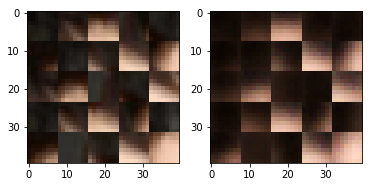

EPO: 3, recon_loss: 0.0176, total_loss: 0.0287
EPO: 3, recon_loss: 0.0143, total_loss: 0.0299
EPO: 3, recon_loss: 0.0131, total_loss: 0.0236
EPO: 3, recon_loss: 0.0175, total_loss: 0.0286
EPO: 3, recon_loss: 0.0090, total_loss: 0.0144
EPO: 3, recon_loss: 0.0128, total_loss: 0.0186
EPO: 3, recon_loss: 0.0069, total_loss: 0.0129
EPO: 3, recon_loss: 0.0062, total_loss: 0.0112
EPO: 3, recon_loss: 0.0067, total_loss: 0.0141
EPO: 3, recon_loss: 0.0122, total_loss: 0.0193
######### what? the reconstruction psnr is: 24.0349


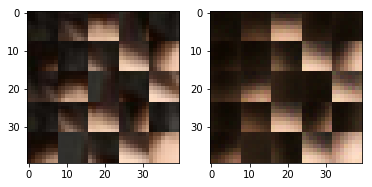

EPO: 3, recon_loss: 0.0112, total_loss: 0.0221
EPO: 3, recon_loss: 0.0154, total_loss: 0.0323
EPO: 3, recon_loss: 0.0076, total_loss: 0.0226
EPO: 3, recon_loss: 0.0094, total_loss: 0.0225
EPO: 3, recon_loss: 0.0116, total_loss: 0.0211
EPO: 3, recon_loss: 0.0057, total_loss: 0.0150
EPO: 3, recon_loss: 0.0224, total_loss: 0.0360
EPO: 3, recon_loss: 0.0325, total_loss: 0.0552
EPO: 3, recon_loss: 0.0152, total_loss: 0.0276
EPO: 3, recon_loss: 0.0212, total_loss: 0.0288
######### what? the reconstruction psnr is: 25.0919


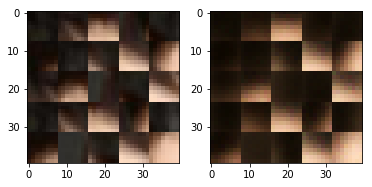

EPO: 3, recon_loss: 0.0094, total_loss: 0.0161
EPO: 3, recon_loss: 0.0191, total_loss: 0.0260
EPO: 3, recon_loss: 0.0146, total_loss: 0.0246
EPO: 3, recon_loss: 0.0150, total_loss: 0.0247
EPO: 3, recon_loss: 0.0175, total_loss: 0.0299
EPO: 3, recon_loss: 0.0156, total_loss: 0.0247
EPO: 3, recon_loss: 0.0256, total_loss: 0.0341
EPO: 3, recon_loss: 0.0214, total_loss: 0.0387
EPO: 3, recon_loss: 0.0271, total_loss: 0.0433
EPO: 3, recon_loss: 0.0416, total_loss: 0.0596
######### what? the reconstruction psnr is: 24.4676


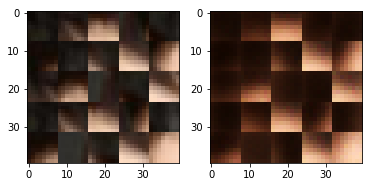

EPO: 3, recon_loss: 0.0224, total_loss: 0.0389
EPO: 3, recon_loss: 0.0211, total_loss: 0.0366
EPO: 3, recon_loss: 0.0123, total_loss: 0.0246
EPO: 3, recon_loss: 0.0142, total_loss: 0.0253
EPO: 3, recon_loss: 0.0202, total_loss: 0.0308
EPO: 3, recon_loss: 0.0172, total_loss: 0.0294
EPO: 3, recon_loss: 0.0223, total_loss: 0.0356
EPO: 3, recon_loss: 0.0087, total_loss: 0.0267
EPO: 3, recon_loss: 0.0097, total_loss: 0.0246
EPO: 3, recon_loss: 0.0279, total_loss: 0.0396
######### what? the reconstruction psnr is: 23.6608


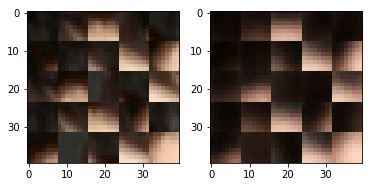

EPO: 3, recon_loss: 0.0080, total_loss: 0.0239
EPO: 3, recon_loss: 0.0121, total_loss: 0.0236
EPO: 3, recon_loss: 0.0202, total_loss: 0.0495
EPO: 3, recon_loss: 0.0167, total_loss: 0.0418
EPO: 3, recon_loss: 0.0544, total_loss: 0.0786
EPO: 3, recon_loss: 0.0144, total_loss: 0.0391
EPO: 3, recon_loss: 0.0173, total_loss: 0.0443
EPO: 3, recon_loss: 0.0293, total_loss: 0.0495
EPO: 3, recon_loss: 0.0179, total_loss: 0.0459
EPO: 3, recon_loss: 0.0531, total_loss: 0.0730
######### what? the reconstruction psnr is: 24.9229


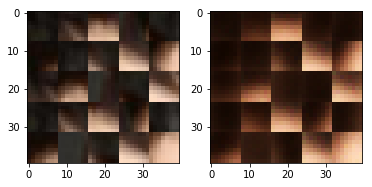

EPO: 3, recon_loss: 0.0228, total_loss: 0.0501
EPO: 3, recon_loss: 0.0264, total_loss: 0.0511
EPO: 3, recon_loss: 0.0189, total_loss: 0.0458
EPO: 3, recon_loss: 0.0134, total_loss: 0.0362
EPO: 3, recon_loss: 0.0491, total_loss: 0.0671
EPO: 3, recon_loss: 0.0435, total_loss: 0.0526
EPO: 3, recon_loss: 0.0099, total_loss: 0.0196
EPO: 3, recon_loss: 0.0113, total_loss: 0.0208
EPO: 3, recon_loss: 0.0076, total_loss: 0.0212
EPO: 3, recon_loss: 0.0242, total_loss: 0.0349
######### what? the reconstruction psnr is: 25.3185


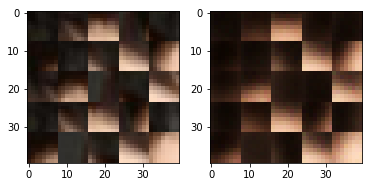

EPO: 3, recon_loss: 0.0112, total_loss: 0.0273
EPO: 3, recon_loss: 0.0164, total_loss: 0.0319
EPO: 3, recon_loss: 0.0074, total_loss: 0.0177
EPO: 3, recon_loss: 0.0024, total_loss: 0.0065
EPO: 3, recon_loss: 0.0052, total_loss: 0.0105
EPO: 3, recon_loss: 0.0029, total_loss: 0.0053
EPO: 3, recon_loss: 0.0042, total_loss: 0.0074
EPO: 3, recon_loss: 0.0226, total_loss: 0.0489
EPO: 3, recon_loss: 0.0106, total_loss: 0.0214
EPO: 3, recon_loss: 0.0170, total_loss: 0.0271
######### what? the reconstruction psnr is: 24.6654


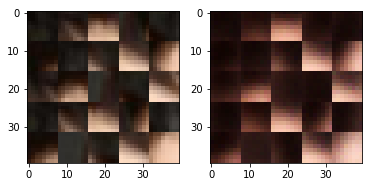

EPO: 3, recon_loss: 0.0151, total_loss: 0.0210
EPO: 3, recon_loss: 0.0109, total_loss: 0.0149
EPO: 3, recon_loss: 0.0246, total_loss: 0.0449
EPO: 3, recon_loss: 0.0234, total_loss: 0.0401
EPO: 3, recon_loss: 0.0313, total_loss: 0.0490
EPO: 3, recon_loss: 0.0270, total_loss: 0.0466
EPO: 3, recon_loss: 0.0123, total_loss: 0.0242
EPO: 3, recon_loss: 0.0172, total_loss: 0.0279
EPO: 3, recon_loss: 0.0116, total_loss: 0.0187
EPO: 3, recon_loss: 0.0123, total_loss: 0.0184
######### what? the reconstruction psnr is: 23.6810


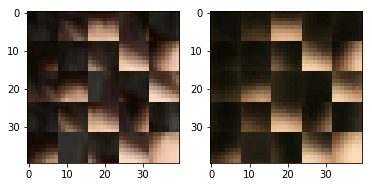

EPO: 3, recon_loss: 0.0112, total_loss: 0.0203
EPO: 3, recon_loss: 0.0109, total_loss: 0.0174
EPO: 3, recon_loss: 0.0158, total_loss: 0.0251
EPO: 3, recon_loss: 0.0113, total_loss: 0.0273
EPO: 3, recon_loss: 0.0094, total_loss: 0.0205
EPO: 3, recon_loss: 0.0221, total_loss: 0.0319
EPO: 3, recon_loss: 0.0207, total_loss: 0.0303
EPO: 3, recon_loss: 0.0134, total_loss: 0.0254
EPO: 3, recon_loss: 0.0055, total_loss: 0.0107
EPO: 3, recon_loss: 0.0066, total_loss: 0.0121
######### what? the reconstruction psnr is: 24.2831


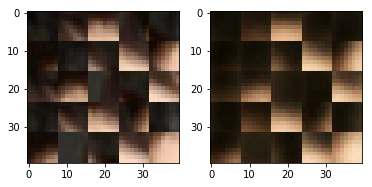

EPO: 3, recon_loss: 0.0106, total_loss: 0.0190
EPO: 3, recon_loss: 0.0047, total_loss: 0.0097
EPO: 3, recon_loss: 0.0086, total_loss: 0.0135
EPO: 3, recon_loss: 0.0119, total_loss: 0.0206
EPO: 3, recon_loss: 0.0122, total_loss: 0.0215
EPO: 3, recon_loss: 0.0208, total_loss: 0.0310
EPO: 3, recon_loss: 0.0110, total_loss: 0.0220
EPO: 3, recon_loss: 0.0075, total_loss: 0.0145
EPO: 3, recon_loss: 0.0082, total_loss: 0.0232
EPO: 3, recon_loss: 0.0084, total_loss: 0.0238
######### what? the reconstruction psnr is: 24.8981


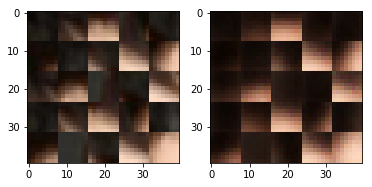

EPO: 3, recon_loss: 0.0351, total_loss: 0.0485
EPO: 3, recon_loss: 0.0103, total_loss: 0.0214
EPO: 3, recon_loss: 0.0456, total_loss: 0.0590
EPO: 3, recon_loss: 0.0057, total_loss: 0.0155
EPO: 3, recon_loss: 0.0024, total_loss: 0.0101
EPO: 3, recon_loss: 0.0273, total_loss: 0.0371
EPO: 3, recon_loss: 0.0095, total_loss: 0.0159
EPO: 3, recon_loss: 0.0114, total_loss: 0.0200
EPO: 3, recon_loss: 0.0143, total_loss: 0.0269
EPO: 3, recon_loss: 0.0154, total_loss: 0.0290
######### what? the reconstruction psnr is: 25.2938


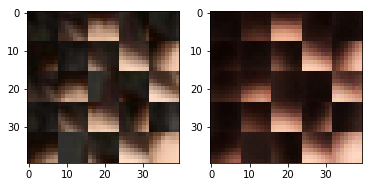

EPO: 3, recon_loss: 0.0261, total_loss: 0.0370
EPO: 3, recon_loss: 0.0074, total_loss: 0.0166
EPO: 3, recon_loss: 0.0093, total_loss: 0.0172
EPO: 3, recon_loss: 0.0122, total_loss: 0.0209
EPO: 3, recon_loss: 0.0079, total_loss: 0.0134
EPO: 3, recon_loss: 0.0198, total_loss: 0.0329
EPO: 3, recon_loss: 0.0071, total_loss: 0.0137
EPO: 3, recon_loss: 0.0083, total_loss: 0.0167
EPO: 3, recon_loss: 0.0210, total_loss: 0.0358
EPO: 3, recon_loss: 0.0113, total_loss: 0.0244
######### what? the reconstruction psnr is: 25.0016


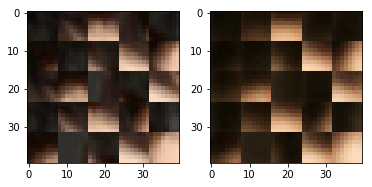

EPO: 3, recon_loss: 0.0188, total_loss: 0.0284
EPO: 3, recon_loss: 0.0143, total_loss: 0.0257
EPO: 3, recon_loss: 0.0154, total_loss: 0.0275
EPO: 3, recon_loss: 0.0188, total_loss: 0.0449
EPO: 3, recon_loss: 0.0047, total_loss: 0.0127
EPO: 3, recon_loss: 0.0116, total_loss: 0.0196
EPO: 3, recon_loss: 0.0083, total_loss: 0.0170
EPO: 3, recon_loss: 0.0094, total_loss: 0.0184
EPO: 3, recon_loss: 0.0131, total_loss: 0.0273
EPO: 3, recon_loss: 0.0074, total_loss: 0.0176
######### what? the reconstruction psnr is: 24.8309


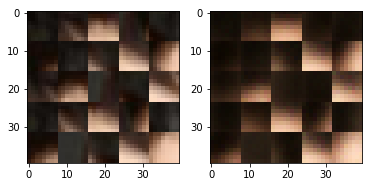

EPO: 3, recon_loss: 0.0201, total_loss: 0.0308
EPO: 3, recon_loss: 0.0204, total_loss: 0.0327
EPO: 3, recon_loss: 0.0217, total_loss: 0.0368
EPO: 3, recon_loss: 0.0212, total_loss: 0.0417
EPO: 3, recon_loss: 0.0098, total_loss: 0.0221
EPO: 3, recon_loss: 0.0110, total_loss: 0.0237
EPO: 3, recon_loss: 0.0173, total_loss: 0.0287
EPO: 3, recon_loss: 0.0163, total_loss: 0.0279
EPO: 3, recon_loss: 0.0110, total_loss: 0.0165
EPO: 3, recon_loss: 0.0057, total_loss: 0.0097
######### what? the reconstruction psnr is: 24.8338


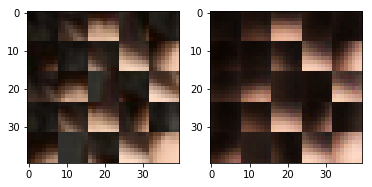

EPO: 3, recon_loss: 0.0049, total_loss: 0.0094
EPO: 3, recon_loss: 0.0106, total_loss: 0.0198
EPO: 3, recon_loss: 0.0095, total_loss: 0.0184
EPO: 3, recon_loss: 0.0159, total_loss: 0.0242
EPO: 3, recon_loss: 0.0252, total_loss: 0.0504
EPO: 3, recon_loss: 0.0143, total_loss: 0.0364
EPO: 3, recon_loss: 0.0299, total_loss: 0.0570
EPO: 3, recon_loss: 0.0245, total_loss: 0.0537
EPO: 3, recon_loss: 0.0258, total_loss: 0.0568
EPO: 3, recon_loss: 0.0096, total_loss: 0.0240
######### what? the reconstruction psnr is: 23.0313


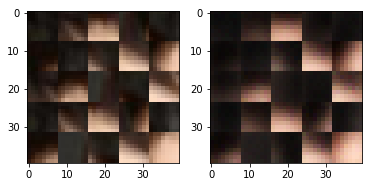

EPO: 3, recon_loss: 0.0263, total_loss: 0.0382
EPO: 3, recon_loss: 0.0164, total_loss: 0.0377
EPO: 3, recon_loss: 0.0141, total_loss: 0.0288
EPO: 3, recon_loss: 0.0178, total_loss: 0.0332
EPO: 3, recon_loss: 0.0149, total_loss: 0.0360
EPO: 3, recon_loss: 0.0166, total_loss: 0.0327
EPO: 3, recon_loss: 0.0241, total_loss: 0.0410
EPO: 3, recon_loss: 0.0093, total_loss: 0.0244
EPO: 3, recon_loss: 0.0125, total_loss: 0.0265
EPO: 3, recon_loss: 0.0109, total_loss: 0.0228
######### what? the reconstruction psnr is: 25.8515


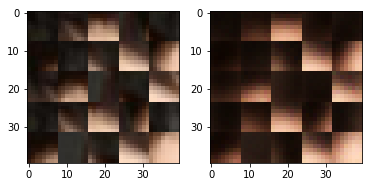

EPO: 3, recon_loss: 0.0079, total_loss: 0.0229
EPO: 3, recon_loss: 0.0239, total_loss: 0.0357
EPO: 3, recon_loss: 0.0072, total_loss: 0.0201
EPO: 3, recon_loss: 0.0138, total_loss: 0.0267
EPO: 3, recon_loss: 0.0074, total_loss: 0.0185
EPO: 3, recon_loss: 0.0098, total_loss: 0.0268
EPO: 3, recon_loss: 0.0291, total_loss: 0.0387
EPO: 3, recon_loss: 0.0114, total_loss: 0.0275
EPO: 3, recon_loss: 0.0161, total_loss: 0.0263
EPO: 3, recon_loss: 0.0090, total_loss: 0.0242
######### what? the reconstruction psnr is: 25.8420


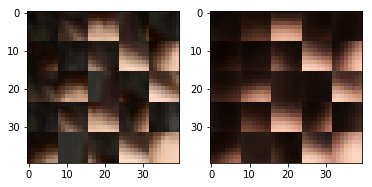

EPO: 3, recon_loss: 0.0074, total_loss: 0.0187
EPO: 3, recon_loss: 0.0247, total_loss: 0.0378
EPO: 3, recon_loss: 0.0077, total_loss: 0.0135
EPO: 3, recon_loss: 0.0164, total_loss: 0.0275
EPO: 3, recon_loss: 0.0092, total_loss: 0.0241
EPO: 3, recon_loss: 0.0050, total_loss: 0.0162
EPO: 3, recon_loss: 0.0155, total_loss: 0.0238
EPO: 3, recon_loss: 0.0056, total_loss: 0.0150
EPO: 3, recon_loss: 0.0099, total_loss: 0.0181
EPO: 3, recon_loss: 0.0292, total_loss: 0.0533
######### what? the reconstruction psnr is: 24.1260


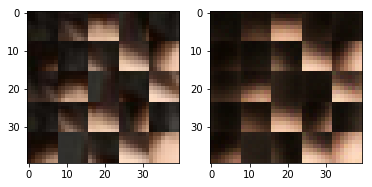

EPO: 3, recon_loss: 0.0255, total_loss: 0.0453
EPO: 3, recon_loss: 0.0158, total_loss: 0.0252
EPO: 3, recon_loss: 0.0180, total_loss: 0.0318
EPO: 3, recon_loss: 0.0119, total_loss: 0.0200
EPO: 3, recon_loss: 0.0123, total_loss: 0.0410
EPO: 3, recon_loss: 0.0060, total_loss: 0.0264
EPO: 3, recon_loss: 0.0183, total_loss: 0.0308
EPO: 3, recon_loss: 0.0147, total_loss: 0.0293
EPO: 3, recon_loss: 0.0166, total_loss: 0.0286
EPO: 3, recon_loss: 0.0103, total_loss: 0.0192
######### what? the reconstruction psnr is: 25.5016


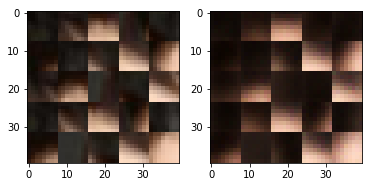

EPO: 3, recon_loss: 0.0030, total_loss: 0.0061
EPO: 3, recon_loss: 0.0152, total_loss: 0.0201
EPO: 3, recon_loss: 0.0047, total_loss: 0.0086
EPO: 3, recon_loss: 0.0044, total_loss: 0.0087
EPO: 3, recon_loss: 0.0097, total_loss: 0.0167
EPO: 3, recon_loss: 0.0113, total_loss: 0.0205
EPO: 3, recon_loss: 0.0202, total_loss: 0.0308
EPO: 3, recon_loss: 0.0096, total_loss: 0.0181
EPO: 3, recon_loss: 0.0104, total_loss: 0.0156
EPO: 3, recon_loss: 0.0219, total_loss: 0.0429
######### what? the reconstruction psnr is: 25.5750


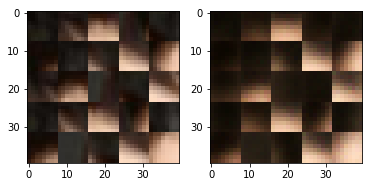

EPO: 3, recon_loss: 0.0215, total_loss: 0.0358
EPO: 3, recon_loss: 0.0155, total_loss: 0.0266
EPO: 3, recon_loss: 0.0173, total_loss: 0.0251
EPO: 3, recon_loss: 0.0154, total_loss: 0.0245
EPO: 3, recon_loss: 0.0288, total_loss: 0.0463
EPO: 3, recon_loss: 0.0381, total_loss: 0.0616
EPO: 3, recon_loss: 0.0167, total_loss: 0.0264
EPO: 3, recon_loss: 0.0144, total_loss: 0.0234
EPO: 3, recon_loss: 0.0107, total_loss: 0.0196
EPO: 3, recon_loss: 0.0257, total_loss: 0.0382
######### what? the reconstruction psnr is: 24.9996


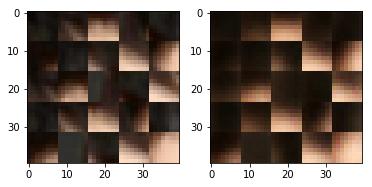

EPO: 3, recon_loss: 0.0044, total_loss: 0.0149
EPO: 3, recon_loss: 0.0091, total_loss: 0.0204
EPO: 3, recon_loss: 0.0152, total_loss: 0.0241
EPO: 3, recon_loss: 0.0175, total_loss: 0.0295
EPO: 3, recon_loss: 0.0356, total_loss: 0.0463
EPO: 3, recon_loss: 0.0054, total_loss: 0.0184
EPO: 3, recon_loss: 0.0080, total_loss: 0.0162
EPO: 3, recon_loss: 0.0107, total_loss: 0.0202
EPO: 3, recon_loss: 0.0036, total_loss: 0.0082
EPO: 3, recon_loss: 0.0066, total_loss: 0.0107
######### what? the reconstruction psnr is: 24.5010


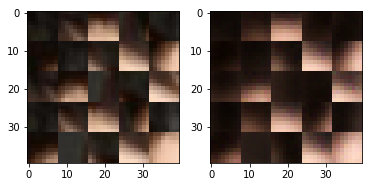

EPO: 3, recon_loss: 0.0143, total_loss: 0.0274
EPO: 3, recon_loss: 0.0128, total_loss: 0.0254
EPO: 3, recon_loss: 0.0187, total_loss: 0.0311
EPO: 3, recon_loss: 0.0140, total_loss: 0.0258
EPO: 3, recon_loss: 0.0193, total_loss: 0.0262
EPO: 4, recon_loss: 0.0059, total_loss: 0.0110
EPO: 4, recon_loss: 0.0049, total_loss: 0.0092
EPO: 4, recon_loss: 0.0199, total_loss: 0.0273
EPO: 4, recon_loss: 0.0068, total_loss: 0.0125
EPO: 4, recon_loss: 0.0140, total_loss: 0.0196
######### what? the reconstruction psnr is: 25.4384


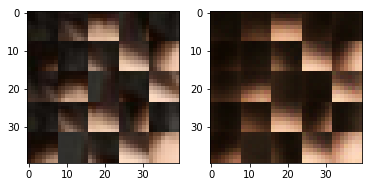

EPO: 4, recon_loss: 0.0065, total_loss: 0.0221
EPO: 4, recon_loss: 0.0076, total_loss: 0.0176
EPO: 4, recon_loss: 0.0106, total_loss: 0.0184
EPO: 4, recon_loss: 0.0094, total_loss: 0.0149
EPO: 4, recon_loss: 0.0155, total_loss: 0.0283
EPO: 4, recon_loss: 0.0060, total_loss: 0.0207
EPO: 4, recon_loss: 0.0043, total_loss: 0.0103
EPO: 4, recon_loss: 0.0086, total_loss: 0.0188
EPO: 4, recon_loss: 0.0063, total_loss: 0.0093
EPO: 4, recon_loss: 0.0156, total_loss: 0.0254
######### what? the reconstruction psnr is: 25.4318


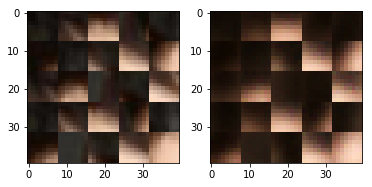

EPO: 4, recon_loss: 0.0104, total_loss: 0.0193
EPO: 4, recon_loss: 0.0094, total_loss: 0.0173
EPO: 4, recon_loss: 0.0103, total_loss: 0.0177
EPO: 4, recon_loss: 0.0086, total_loss: 0.0183
EPO: 4, recon_loss: 0.0085, total_loss: 0.0157
EPO: 4, recon_loss: 0.0098, total_loss: 0.0156
EPO: 4, recon_loss: 0.0062, total_loss: 0.0143
EPO: 4, recon_loss: 0.0162, total_loss: 0.0223
EPO: 4, recon_loss: 0.0065, total_loss: 0.0121
EPO: 4, recon_loss: 0.0094, total_loss: 0.0138
######### what? the reconstruction psnr is: 25.5748


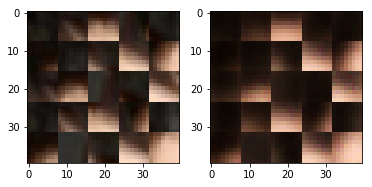

EPO: 4, recon_loss: 0.0221, total_loss: 0.0380
EPO: 4, recon_loss: 0.0097, total_loss: 0.0215
EPO: 4, recon_loss: 0.0192, total_loss: 0.0357
EPO: 4, recon_loss: 0.0220, total_loss: 0.0336
EPO: 4, recon_loss: 0.0172, total_loss: 0.0267
EPO: 4, recon_loss: 0.0179, total_loss: 0.0365
EPO: 4, recon_loss: 0.0088, total_loss: 0.0189
EPO: 4, recon_loss: 0.0161, total_loss: 0.0248
EPO: 4, recon_loss: 0.0061, total_loss: 0.0098
EPO: 4, recon_loss: 0.0065, total_loss: 0.0117
######### what? the reconstruction psnr is: 24.5685


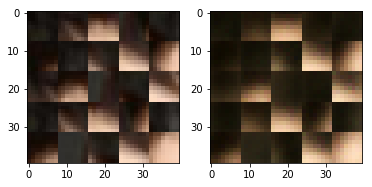

EPO: 4, recon_loss: 0.0049, total_loss: 0.0094
EPO: 4, recon_loss: 0.0043, total_loss: 0.0085
EPO: 4, recon_loss: 0.0068, total_loss: 0.0155
EPO: 4, recon_loss: 0.0065, total_loss: 0.0124
EPO: 4, recon_loss: 0.0103, total_loss: 0.0231
EPO: 4, recon_loss: 0.0070, total_loss: 0.0228
EPO: 4, recon_loss: 0.0053, total_loss: 0.0184
EPO: 4, recon_loss: 0.0087, total_loss: 0.0192
EPO: 4, recon_loss: 0.0075, total_loss: 0.0143
EPO: 4, recon_loss: 0.0072, total_loss: 0.0171
######### what? the reconstruction psnr is: 25.7060


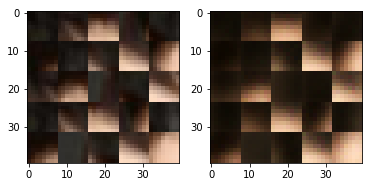

EPO: 4, recon_loss: 0.0109, total_loss: 0.0304
EPO: 4, recon_loss: 0.0106, total_loss: 0.0238
EPO: 4, recon_loss: 0.0197, total_loss: 0.0311
EPO: 4, recon_loss: 0.0128, total_loss: 0.0199
EPO: 4, recon_loss: 0.0098, total_loss: 0.0159
EPO: 4, recon_loss: 0.0202, total_loss: 0.0288
EPO: 4, recon_loss: 0.0094, total_loss: 0.0170
EPO: 4, recon_loss: 0.0141, total_loss: 0.0257
EPO: 4, recon_loss: 0.0134, total_loss: 0.0239
EPO: 4, recon_loss: 0.0139, total_loss: 0.0231
######### what? the reconstruction psnr is: 25.5955


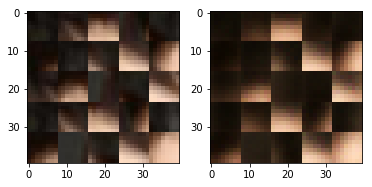

EPO: 4, recon_loss: 0.0277, total_loss: 0.0341
EPO: 4, recon_loss: 0.0182, total_loss: 0.0346
EPO: 4, recon_loss: 0.0250, total_loss: 0.0413
EPO: 4, recon_loss: 0.0352, total_loss: 0.0508
EPO: 4, recon_loss: 0.0199, total_loss: 0.0349
EPO: 4, recon_loss: 0.0205, total_loss: 0.0339
EPO: 4, recon_loss: 0.0090, total_loss: 0.0186
EPO: 4, recon_loss: 0.0125, total_loss: 0.0220
EPO: 4, recon_loss: 0.0150, total_loss: 0.0255
EPO: 4, recon_loss: 0.0186, total_loss: 0.0327
######### what? the reconstruction psnr is: 24.1773


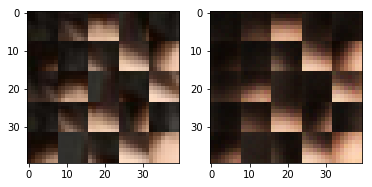

EPO: 4, recon_loss: 0.0182, total_loss: 0.0294
EPO: 4, recon_loss: 0.0071, total_loss: 0.0226
EPO: 4, recon_loss: 0.0151, total_loss: 0.0292
EPO: 4, recon_loss: 0.0215, total_loss: 0.0343
EPO: 4, recon_loss: 0.0066, total_loss: 0.0211
EPO: 4, recon_loss: 0.0138, total_loss: 0.0236
EPO: 4, recon_loss: 0.0138, total_loss: 0.0373
EPO: 4, recon_loss: 0.0142, total_loss: 0.0365
EPO: 4, recon_loss: 0.0441, total_loss: 0.0669
EPO: 4, recon_loss: 0.0135, total_loss: 0.0388
######### what? the reconstruction psnr is: 25.7426


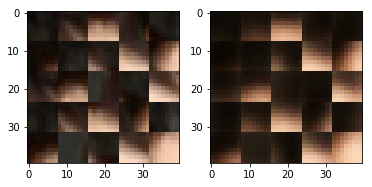

EPO: 4, recon_loss: 0.0155, total_loss: 0.0371
EPO: 4, recon_loss: 0.0192, total_loss: 0.0392
EPO: 4, recon_loss: 0.0134, total_loss: 0.0385
EPO: 4, recon_loss: 0.0544, total_loss: 0.0740
EPO: 4, recon_loss: 0.0230, total_loss: 0.0472
EPO: 4, recon_loss: 0.0221, total_loss: 0.0453
EPO: 4, recon_loss: 0.0092, total_loss: 0.0315
EPO: 4, recon_loss: 0.0211, total_loss: 0.0466
EPO: 4, recon_loss: 0.0501, total_loss: 0.0652
EPO: 4, recon_loss: 0.0304, total_loss: 0.0409
######### what? the reconstruction psnr is: 25.2127


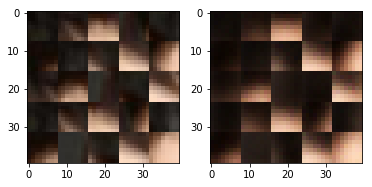

EPO: 4, recon_loss: 0.0091, total_loss: 0.0157
EPO: 4, recon_loss: 0.0065, total_loss: 0.0160
EPO: 4, recon_loss: 0.0072, total_loss: 0.0199
EPO: 4, recon_loss: 0.0210, total_loss: 0.0310
EPO: 4, recon_loss: 0.0092, total_loss: 0.0236
EPO: 4, recon_loss: 0.0167, total_loss: 0.0299
EPO: 4, recon_loss: 0.0039, total_loss: 0.0095
EPO: 4, recon_loss: 0.0019, total_loss: 0.0060
EPO: 4, recon_loss: 0.0052, total_loss: 0.0094
EPO: 4, recon_loss: 0.0023, total_loss: 0.0043
######### what? the reconstruction psnr is: 26.1431


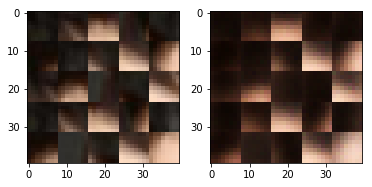

EPO: 4, recon_loss: 0.0035, total_loss: 0.0071
EPO: 4, recon_loss: 0.0179, total_loss: 0.0383
EPO: 4, recon_loss: 0.0074, total_loss: 0.0165
EPO: 4, recon_loss: 0.0149, total_loss: 0.0235
EPO: 4, recon_loss: 0.0084, total_loss: 0.0129
EPO: 4, recon_loss: 0.0081, total_loss: 0.0116
EPO: 4, recon_loss: 0.0201, total_loss: 0.0415
EPO: 4, recon_loss: 0.0198, total_loss: 0.0332
EPO: 4, recon_loss: 0.0217, total_loss: 0.0371
EPO: 4, recon_loss: 0.0244, total_loss: 0.0404
######### what? the reconstruction psnr is: 25.4043


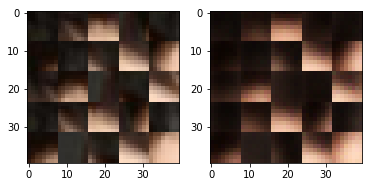

EPO: 4, recon_loss: 0.0103, total_loss: 0.0214
EPO: 4, recon_loss: 0.0169, total_loss: 0.0255
EPO: 4, recon_loss: 0.0094, total_loss: 0.0155
EPO: 4, recon_loss: 0.0103, total_loss: 0.0162
EPO: 4, recon_loss: 0.0084, total_loss: 0.0147
EPO: 4, recon_loss: 0.0107, total_loss: 0.0179
EPO: 4, recon_loss: 0.0059, total_loss: 0.0269
EPO: 4, recon_loss: 0.0052, total_loss: 0.0160
EPO: 4, recon_loss: 0.0158, total_loss: 0.0264
EPO: 4, recon_loss: 0.0163, total_loss: 0.0257
######### what? the reconstruction psnr is: 25.5387


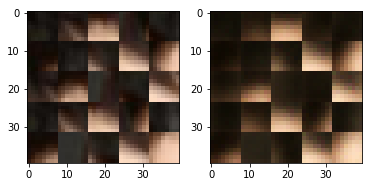

EPO: 4, recon_loss: 0.0110, total_loss: 0.0189
EPO: 4, recon_loss: 0.0095, total_loss: 0.0177
EPO: 4, recon_loss: 0.0041, total_loss: 0.0091
EPO: 4, recon_loss: 0.0064, total_loss: 0.0112
EPO: 4, recon_loss: 0.0080, total_loss: 0.0153
EPO: 4, recon_loss: 0.0050, total_loss: 0.0094
EPO: 4, recon_loss: 0.0101, total_loss: 0.0145
EPO: 4, recon_loss: 0.0076, total_loss: 0.0145
EPO: 4, recon_loss: 0.0108, total_loss: 0.0192
EPO: 4, recon_loss: 0.0139, total_loss: 0.0240
######### what? the reconstruction psnr is: 25.6374


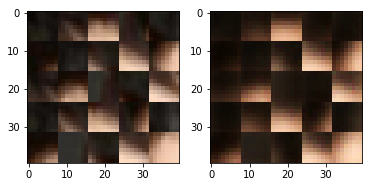

EPO: 4, recon_loss: 0.0105, total_loss: 0.0189
EPO: 4, recon_loss: 0.0062, total_loss: 0.0131
EPO: 4, recon_loss: 0.0091, total_loss: 0.0254
EPO: 4, recon_loss: 0.0154, total_loss: 0.0299
EPO: 4, recon_loss: 0.0272, total_loss: 0.0419
EPO: 4, recon_loss: 0.0105, total_loss: 0.0210
EPO: 4, recon_loss: 0.0371, total_loss: 0.0510
EPO: 4, recon_loss: 0.0029, total_loss: 0.0102
EPO: 4, recon_loss: 0.0052, total_loss: 0.0123
EPO: 4, recon_loss: 0.0235, total_loss: 0.0330
######### what? the reconstruction psnr is: 24.7947


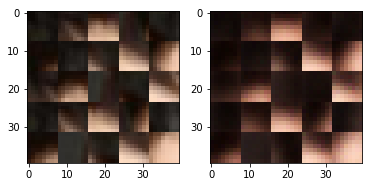

EPO: 4, recon_loss: 0.0067, total_loss: 0.0139
EPO: 4, recon_loss: 0.0099, total_loss: 0.0174
EPO: 4, recon_loss: 0.0109, total_loss: 0.0210
EPO: 4, recon_loss: 0.0112, total_loss: 0.0245
EPO: 4, recon_loss: 0.0201, total_loss: 0.0304
EPO: 4, recon_loss: 0.0059, total_loss: 0.0150
EPO: 4, recon_loss: 0.0125, total_loss: 0.0205
EPO: 4, recon_loss: 0.0107, total_loss: 0.0170
EPO: 4, recon_loss: 0.0119, total_loss: 0.0180
EPO: 4, recon_loss: 0.0186, total_loss: 0.0314
######### what? the reconstruction psnr is: 25.8599


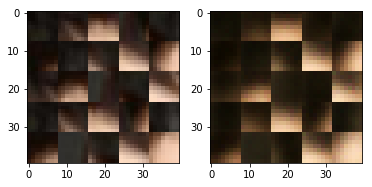

EPO: 4, recon_loss: 0.0067, total_loss: 0.0135
EPO: 4, recon_loss: 0.0085, total_loss: 0.0168
EPO: 4, recon_loss: 0.0169, total_loss: 0.0290
EPO: 4, recon_loss: 0.0088, total_loss: 0.0205
EPO: 4, recon_loss: 0.0211, total_loss: 0.0295
EPO: 4, recon_loss: 0.0118, total_loss: 0.0236
EPO: 4, recon_loss: 0.0152, total_loss: 0.0257
EPO: 4, recon_loss: 0.0169, total_loss: 0.0381
EPO: 4, recon_loss: 0.0029, total_loss: 0.0097
EPO: 4, recon_loss: 0.0126, total_loss: 0.0193
######### what? the reconstruction psnr is: 26.0157


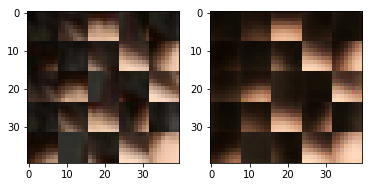

EPO: 4, recon_loss: 0.0063, total_loss: 0.0138
EPO: 4, recon_loss: 0.0076, total_loss: 0.0157
EPO: 4, recon_loss: 0.0100, total_loss: 0.0238
EPO: 4, recon_loss: 0.0063, total_loss: 0.0159
EPO: 4, recon_loss: 0.0220, total_loss: 0.0331
EPO: 4, recon_loss: 0.0098, total_loss: 0.0208
EPO: 4, recon_loss: 0.0205, total_loss: 0.0313
EPO: 4, recon_loss: 0.0138, total_loss: 0.0309
EPO: 4, recon_loss: 0.0058, total_loss: 0.0170
EPO: 4, recon_loss: 0.0170, total_loss: 0.0289
######### what? the reconstruction psnr is: 25.7696


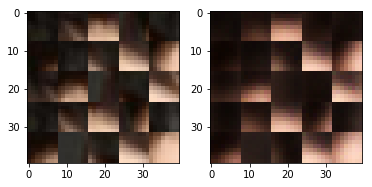

EPO: 4, recon_loss: 0.0071, total_loss: 0.0165
EPO: 4, recon_loss: 0.0129, total_loss: 0.0224
EPO: 4, recon_loss: 0.0070, total_loss: 0.0098
EPO: 4, recon_loss: 0.0041, total_loss: 0.0075
EPO: 4, recon_loss: 0.0055, total_loss: 0.0103
EPO: 4, recon_loss: 0.0077, total_loss: 0.0138
EPO: 4, recon_loss: 0.0098, total_loss: 0.0181
EPO: 4, recon_loss: 0.0201, total_loss: 0.0452
EPO: 4, recon_loss: 0.0203, total_loss: 0.0411
EPO: 4, recon_loss: 0.0177, total_loss: 0.0391
######### what? the reconstruction psnr is: 26.5086


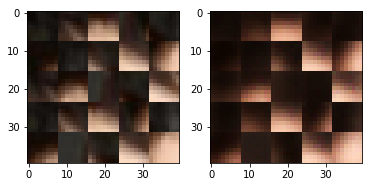

EPO: 4, recon_loss: 0.0213, total_loss: 0.0467
EPO: 4, recon_loss: 0.0198, total_loss: 0.0472
EPO: 4, recon_loss: 0.0103, total_loss: 0.0232
EPO: 4, recon_loss: 0.0102, total_loss: 0.0209
EPO: 4, recon_loss: 0.0283, total_loss: 0.0456
EPO: 4, recon_loss: 0.0124, total_loss: 0.0311
EPO: 4, recon_loss: 0.0122, total_loss: 0.0263
EPO: 4, recon_loss: 0.0123, total_loss: 0.0257
EPO: 4, recon_loss: 0.0119, total_loss: 0.0301
EPO: 4, recon_loss: 0.0166, total_loss: 0.0319
######### what? the reconstruction psnr is: 26.8753


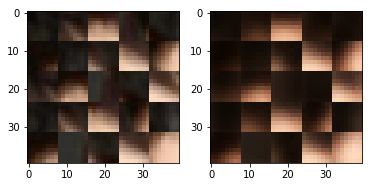

EPO: 4, recon_loss: 0.0163, total_loss: 0.0320
EPO: 4, recon_loss: 0.0091, total_loss: 0.0212
EPO: 4, recon_loss: 0.0118, total_loss: 0.0235
EPO: 4, recon_loss: 0.0079, total_loss: 0.0192
EPO: 4, recon_loss: 0.0140, total_loss: 0.0278
EPO: 4, recon_loss: 0.0179, total_loss: 0.0290
EPO: 4, recon_loss: 0.0059, total_loss: 0.0170
EPO: 4, recon_loss: 0.0126, total_loss: 0.0246
EPO: 4, recon_loss: 0.0051, total_loss: 0.0159
EPO: 4, recon_loss: 0.0102, total_loss: 0.0245
######### what? the reconstruction psnr is: 26.0049


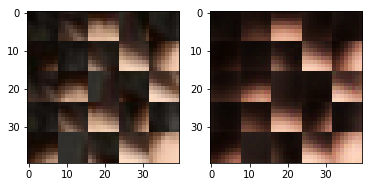

EPO: 4, recon_loss: 0.0231, total_loss: 0.0339
EPO: 4, recon_loss: 0.0105, total_loss: 0.0257
EPO: 4, recon_loss: 0.0184, total_loss: 0.0287
EPO: 4, recon_loss: 0.0050, total_loss: 0.0172
EPO: 4, recon_loss: 0.0087, total_loss: 0.0180
EPO: 4, recon_loss: 0.0168, total_loss: 0.0263
EPO: 4, recon_loss: 0.0082, total_loss: 0.0149
EPO: 4, recon_loss: 0.0124, total_loss: 0.0258
EPO: 4, recon_loss: 0.0056, total_loss: 0.0159
EPO: 4, recon_loss: 0.0046, total_loss: 0.0152
######### what? the reconstruction psnr is: 26.4336


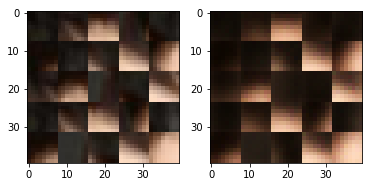

EPO: 4, recon_loss: 0.0115, total_loss: 0.0198
EPO: 4, recon_loss: 0.0055, total_loss: 0.0134
EPO: 4, recon_loss: 0.0081, total_loss: 0.0164
EPO: 4, recon_loss: 0.0235, total_loss: 0.0424
EPO: 4, recon_loss: 0.0190, total_loss: 0.0372
EPO: 4, recon_loss: 0.0133, total_loss: 0.0220
EPO: 4, recon_loss: 0.0185, total_loss: 0.0318
EPO: 4, recon_loss: 0.0097, total_loss: 0.0180
EPO: 4, recon_loss: 0.0111, total_loss: 0.0364
EPO: 4, recon_loss: 0.0053, total_loss: 0.0221
######### what? the reconstruction psnr is: 26.0578


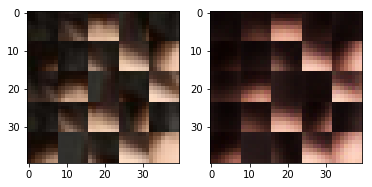

EPO: 4, recon_loss: 0.0189, total_loss: 0.0310
EPO: 4, recon_loss: 0.0086, total_loss: 0.0199
EPO: 4, recon_loss: 0.0162, total_loss: 0.0262
EPO: 4, recon_loss: 0.0056, total_loss: 0.0100
EPO: 4, recon_loss: 0.0024, total_loss: 0.0052
EPO: 4, recon_loss: 0.0123, total_loss: 0.0169
EPO: 4, recon_loss: 0.0040, total_loss: 0.0079
EPO: 4, recon_loss: 0.0051, total_loss: 0.0090
EPO: 4, recon_loss: 0.0106, total_loss: 0.0184
EPO: 4, recon_loss: 0.0082, total_loss: 0.0164
######### what? the reconstruction psnr is: 25.7513


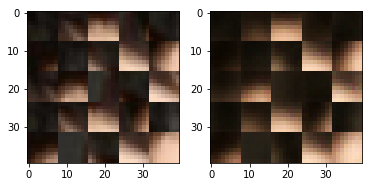

EPO: 4, recon_loss: 0.0154, total_loss: 0.0248
EPO: 4, recon_loss: 0.0056, total_loss: 0.0126
EPO: 4, recon_loss: 0.0067, total_loss: 0.0109
EPO: 4, recon_loss: 0.0207, total_loss: 0.0399
EPO: 4, recon_loss: 0.0138, total_loss: 0.0248
EPO: 4, recon_loss: 0.0169, total_loss: 0.0263
EPO: 4, recon_loss: 0.0117, total_loss: 0.0191
EPO: 4, recon_loss: 0.0157, total_loss: 0.0243
EPO: 4, recon_loss: 0.0223, total_loss: 0.0393
EPO: 4, recon_loss: 0.0421, total_loss: 0.0648
######### what? the reconstruction psnr is: 25.7697


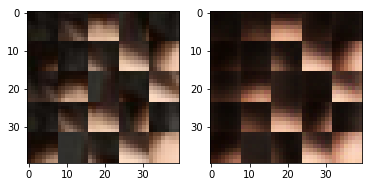

EPO: 4, recon_loss: 0.0126, total_loss: 0.0209
EPO: 4, recon_loss: 0.0080, total_loss: 0.0157
EPO: 4, recon_loss: 0.0117, total_loss: 0.0215
EPO: 4, recon_loss: 0.0063, total_loss: 0.0164
EPO: 4, recon_loss: 0.0038, total_loss: 0.0140
EPO: 4, recon_loss: 0.0098, total_loss: 0.0176
EPO: 4, recon_loss: 0.0090, total_loss: 0.0191
EPO: 4, recon_loss: 0.0119, total_loss: 0.0191
EPO: 4, recon_loss: 0.0055, total_loss: 0.0322
EPO: 4, recon_loss: 0.0037, total_loss: 0.0134
######### what? the reconstruction psnr is: 25.9978


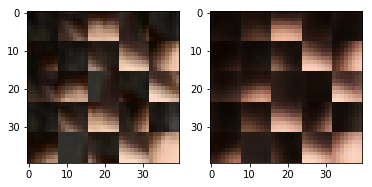

EPO: 4, recon_loss: 0.0092, total_loss: 0.0165
EPO: 4, recon_loss: 0.0070, total_loss: 0.0148
EPO: 4, recon_loss: 0.0025, total_loss: 0.0053
EPO: 4, recon_loss: 0.0096, total_loss: 0.0178
EPO: 4, recon_loss: 0.0117, total_loss: 0.0242
EPO: 4, recon_loss: 0.0135, total_loss: 0.0235
EPO: 4, recon_loss: 0.0176, total_loss: 0.0302
EPO: 4, recon_loss: 0.0142, total_loss: 0.0256
EPO: 4, recon_loss: 0.0167, total_loss: 0.0223
EPO: 5, recon_loss: 0.0045, total_loss: 0.0083
######### what? the reconstruction psnr is: 26.2581


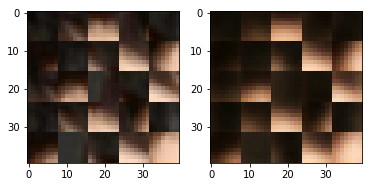

EPO: 5, recon_loss: 0.0058, total_loss: 0.0098
EPO: 5, recon_loss: 0.0128, total_loss: 0.0204
EPO: 5, recon_loss: 0.0067, total_loss: 0.0115
EPO: 5, recon_loss: 0.0155, total_loss: 0.0204
EPO: 5, recon_loss: 0.0043, total_loss: 0.0148
EPO: 5, recon_loss: 0.0069, total_loss: 0.0158
EPO: 5, recon_loss: 0.0111, total_loss: 0.0182
EPO: 5, recon_loss: 0.0139, total_loss: 0.0207
EPO: 5, recon_loss: 0.0136, total_loss: 0.0246
EPO: 5, recon_loss: 0.0057, total_loss: 0.0160
######### what? the reconstruction psnr is: 26.2931


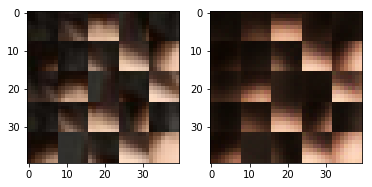

EPO: 5, recon_loss: 0.0047, total_loss: 0.0117
EPO: 5, recon_loss: 0.0071, total_loss: 0.0150
EPO: 5, recon_loss: 0.0064, total_loss: 0.0105
EPO: 5, recon_loss: 0.0164, total_loss: 0.0247
EPO: 5, recon_loss: 0.0091, total_loss: 0.0169
EPO: 5, recon_loss: 0.0076, total_loss: 0.0147
EPO: 5, recon_loss: 0.0095, total_loss: 0.0186
EPO: 5, recon_loss: 0.0081, total_loss: 0.0162
EPO: 5, recon_loss: 0.0096, total_loss: 0.0172
EPO: 5, recon_loss: 0.0073, total_loss: 0.0129
######### what? the reconstruction psnr is: 26.4712


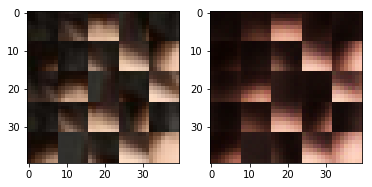

EPO: 5, recon_loss: 0.0062, total_loss: 0.0125
EPO: 5, recon_loss: 0.0183, total_loss: 0.0251
EPO: 5, recon_loss: 0.0050, total_loss: 0.0105
EPO: 5, recon_loss: 0.0099, total_loss: 0.0138
EPO: 5, recon_loss: 0.0170, total_loss: 0.0309
EPO: 5, recon_loss: 0.0132, total_loss: 0.0277
EPO: 5, recon_loss: 0.0175, total_loss: 0.0311
EPO: 5, recon_loss: 0.0250, total_loss: 0.0356
EPO: 5, recon_loss: 0.0146, total_loss: 0.0228
EPO: 5, recon_loss: 0.0160, total_loss: 0.0326
######### what? the reconstruction psnr is: 26.1977


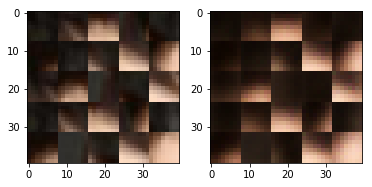

EPO: 5, recon_loss: 0.0061, total_loss: 0.0139
EPO: 5, recon_loss: 0.0146, total_loss: 0.0223
EPO: 5, recon_loss: 0.0067, total_loss: 0.0097
EPO: 5, recon_loss: 0.0075, total_loss: 0.0148
EPO: 5, recon_loss: 0.0036, total_loss: 0.0067
EPO: 5, recon_loss: 0.0037, total_loss: 0.0078
EPO: 5, recon_loss: 0.0088, total_loss: 0.0167
EPO: 5, recon_loss: 0.0061, total_loss: 0.0140
EPO: 5, recon_loss: 0.0078, total_loss: 0.0192
EPO: 5, recon_loss: 0.0051, total_loss: 0.0193
######### what? the reconstruction psnr is: 26.2881


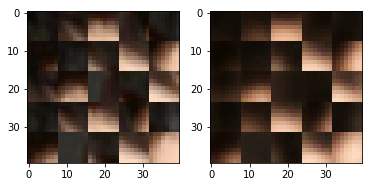

EPO: 5, recon_loss: 0.0044, total_loss: 0.0160
EPO: 5, recon_loss: 0.0124, total_loss: 0.0222
EPO: 5, recon_loss: 0.0035, total_loss: 0.0108
EPO: 5, recon_loss: 0.0084, total_loss: 0.0175
EPO: 5, recon_loss: 0.0131, total_loss: 0.0307
EPO: 5, recon_loss: 0.0050, total_loss: 0.0144
EPO: 5, recon_loss: 0.0232, total_loss: 0.0322
EPO: 5, recon_loss: 0.0088, total_loss: 0.0154
EPO: 5, recon_loss: 0.0081, total_loss: 0.0132
EPO: 5, recon_loss: 0.0172, total_loss: 0.0272
######### what? the reconstruction psnr is: 26.4229


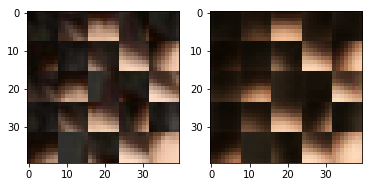

EPO: 5, recon_loss: 0.0073, total_loss: 0.0139
EPO: 5, recon_loss: 0.0128, total_loss: 0.0229
EPO: 5, recon_loss: 0.0095, total_loss: 0.0177
EPO: 5, recon_loss: 0.0130, total_loss: 0.0217
EPO: 5, recon_loss: 0.0258, total_loss: 0.0437
EPO: 5, recon_loss: 0.0211, total_loss: 0.0369
EPO: 5, recon_loss: 0.0217, total_loss: 0.0379
EPO: 5, recon_loss: 0.0214, total_loss: 0.0361
EPO: 5, recon_loss: 0.0134, total_loss: 0.0267
EPO: 5, recon_loss: 0.0133, total_loss: 0.0269
######### what? the reconstruction psnr is: 26.0369


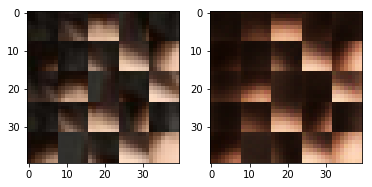

EPO: 5, recon_loss: 0.0082, total_loss: 0.0169
EPO: 5, recon_loss: 0.0136, total_loss: 0.0256
EPO: 5, recon_loss: 0.0160, total_loss: 0.0246
EPO: 5, recon_loss: 0.0165, total_loss: 0.0301
EPO: 5, recon_loss: 0.0229, total_loss: 0.0352
EPO: 5, recon_loss: 0.0045, total_loss: 0.0163
EPO: 5, recon_loss: 0.0164, total_loss: 0.0279
EPO: 5, recon_loss: 0.0174, total_loss: 0.0300
EPO: 5, recon_loss: 0.0070, total_loss: 0.0192
EPO: 5, recon_loss: 0.0172, total_loss: 0.0301
######### what? the reconstruction psnr is: 26.0720


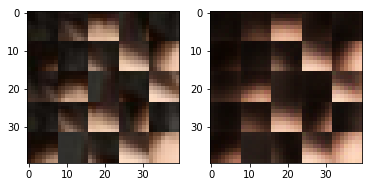

EPO: 5, recon_loss: 0.0124, total_loss: 0.0342
EPO: 5, recon_loss: 0.0166, total_loss: 0.0355
EPO: 5, recon_loss: 0.0325, total_loss: 0.0578
EPO: 5, recon_loss: 0.0110, total_loss: 0.0316
EPO: 5, recon_loss: 0.0182, total_loss: 0.0369
EPO: 5, recon_loss: 0.0143, total_loss: 0.0330
EPO: 5, recon_loss: 0.0178, total_loss: 0.0404
EPO: 5, recon_loss: 0.0327, total_loss: 0.0532
EPO: 5, recon_loss: 0.0291, total_loss: 0.0521
EPO: 5, recon_loss: 0.0217, total_loss: 0.0424
######### what? the reconstruction psnr is: 26.6565


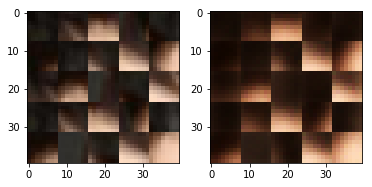

EPO: 5, recon_loss: 0.0073, total_loss: 0.0275
EPO: 5, recon_loss: 0.0246, total_loss: 0.0455
EPO: 5, recon_loss: 0.0395, total_loss: 0.0538
EPO: 5, recon_loss: 0.0221, total_loss: 0.0299
EPO: 5, recon_loss: 0.0099, total_loss: 0.0157
EPO: 5, recon_loss: 0.0055, total_loss: 0.0141
EPO: 5, recon_loss: 0.0069, total_loss: 0.0184
EPO: 5, recon_loss: 0.0193, total_loss: 0.0287
EPO: 5, recon_loss: 0.0080, total_loss: 0.0216
EPO: 5, recon_loss: 0.0181, total_loss: 0.0285
######### what? the reconstruction psnr is: 26.9468


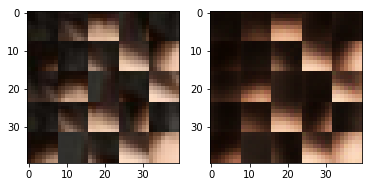

EPO: 5, recon_loss: 0.0021, total_loss: 0.0067
EPO: 5, recon_loss: 0.0015, total_loss: 0.0047
EPO: 5, recon_loss: 0.0058, total_loss: 0.0097
EPO: 5, recon_loss: 0.0023, total_loss: 0.0044
EPO: 5, recon_loss: 0.0046, total_loss: 0.0087
EPO: 5, recon_loss: 0.0101, total_loss: 0.0243
EPO: 5, recon_loss: 0.0061, total_loss: 0.0127
EPO: 5, recon_loss: 0.0155, total_loss: 0.0228
EPO: 5, recon_loss: 0.0068, total_loss: 0.0109
EPO: 5, recon_loss: 0.0072, total_loss: 0.0114
######### what? the reconstruction psnr is: 25.6253


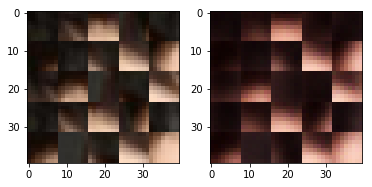

EPO: 5, recon_loss: 0.0145, total_loss: 0.0309
EPO: 5, recon_loss: 0.0190, total_loss: 0.0326
EPO: 5, recon_loss: 0.0188, total_loss: 0.0330
EPO: 5, recon_loss: 0.0212, total_loss: 0.0364
EPO: 5, recon_loss: 0.0081, total_loss: 0.0156
EPO: 5, recon_loss: 0.0144, total_loss: 0.0226
EPO: 5, recon_loss: 0.0077, total_loss: 0.0126
EPO: 5, recon_loss: 0.0119, total_loss: 0.0190
EPO: 5, recon_loss: 0.0068, total_loss: 0.0126
EPO: 5, recon_loss: 0.0072, total_loss: 0.0125
######### what? the reconstruction psnr is: 25.9004


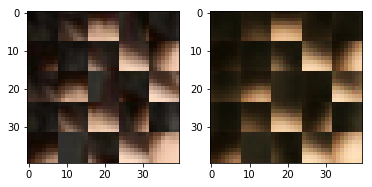

EPO: 5, recon_loss: 0.0088, total_loss: 0.0292
EPO: 5, recon_loss: 0.0033, total_loss: 0.0118
EPO: 5, recon_loss: 0.0171, total_loss: 0.0278
EPO: 5, recon_loss: 0.0098, total_loss: 0.0167
EPO: 5, recon_loss: 0.0107, total_loss: 0.0179
EPO: 5, recon_loss: 0.0048, total_loss: 0.0086
EPO: 5, recon_loss: 0.0034, total_loss: 0.0080
EPO: 5, recon_loss: 0.0060, total_loss: 0.0112
EPO: 5, recon_loss: 0.0052, total_loss: 0.0111
EPO: 5, recon_loss: 0.0050, total_loss: 0.0091
######### what? the reconstruction psnr is: 25.8820


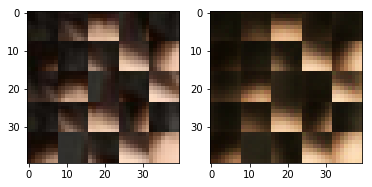

EPO: 5, recon_loss: 0.0096, total_loss: 0.0194
EPO: 5, recon_loss: 0.0061, total_loss: 0.0128
EPO: 5, recon_loss: 0.0143, total_loss: 0.0224
EPO: 5, recon_loss: 0.0090, total_loss: 0.0179
EPO: 5, recon_loss: 0.0069, total_loss: 0.0152
EPO: 5, recon_loss: 0.0093, total_loss: 0.0283
EPO: 5, recon_loss: 0.0089, total_loss: 0.0232
EPO: 5, recon_loss: 0.0245, total_loss: 0.0365
EPO: 5, recon_loss: 0.0168, total_loss: 0.0289
EPO: 5, recon_loss: 0.0097, total_loss: 0.0192
######### what? the reconstruction psnr is: 26.0898


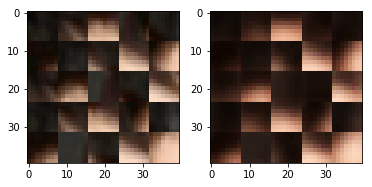

EPO: 5, recon_loss: 0.0309, total_loss: 0.0439
EPO: 5, recon_loss: 0.0022, total_loss: 0.0081
EPO: 5, recon_loss: 0.0074, total_loss: 0.0169
EPO: 5, recon_loss: 0.0169, total_loss: 0.0261
EPO: 5, recon_loss: 0.0091, total_loss: 0.0166
EPO: 5, recon_loss: 0.0074, total_loss: 0.0158
EPO: 5, recon_loss: 0.0114, total_loss: 0.0219
EPO: 5, recon_loss: 0.0119, total_loss: 0.0246
EPO: 5, recon_loss: 0.0140, total_loss: 0.0267
EPO: 5, recon_loss: 0.0041, total_loss: 0.0112
######### what? the reconstruction psnr is: 26.7656


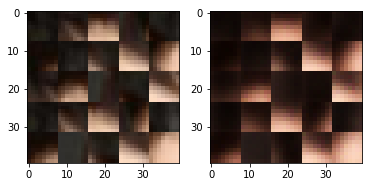

EPO: 5, recon_loss: 0.0171, total_loss: 0.0242
EPO: 5, recon_loss: 0.0081, total_loss: 0.0130
EPO: 5, recon_loss: 0.0156, total_loss: 0.0221
EPO: 5, recon_loss: 0.0151, total_loss: 0.0254
EPO: 5, recon_loss: 0.0076, total_loss: 0.0144
EPO: 5, recon_loss: 0.0082, total_loss: 0.0153
EPO: 5, recon_loss: 0.0143, total_loss: 0.0250
EPO: 5, recon_loss: 0.0084, total_loss: 0.0180
EPO: 5, recon_loss: 0.0210, total_loss: 0.0288
EPO: 5, recon_loss: 0.0102, total_loss: 0.0217
######### what? the reconstruction psnr is: 26.7298


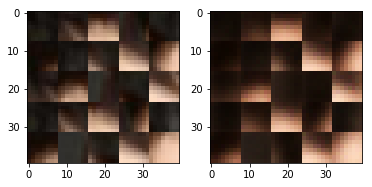

EPO: 5, recon_loss: 0.0134, total_loss: 0.0229
EPO: 5, recon_loss: 0.0117, total_loss: 0.0253
EPO: 5, recon_loss: 0.0027, total_loss: 0.0085
EPO: 5, recon_loss: 0.0119, total_loss: 0.0184
EPO: 5, recon_loss: 0.0074, total_loss: 0.0151
EPO: 5, recon_loss: 0.0091, total_loss: 0.0172
EPO: 5, recon_loss: 0.0091, total_loss: 0.0219
EPO: 5, recon_loss: 0.0098, total_loss: 0.0191
EPO: 5, recon_loss: 0.0220, total_loss: 0.0335
EPO: 5, recon_loss: 0.0080, total_loss: 0.0184
######### what? the reconstruction psnr is: 26.4872


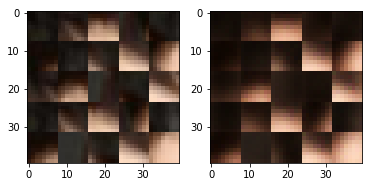

EPO: 5, recon_loss: 0.0181, total_loss: 0.0295
EPO: 5, recon_loss: 0.0110, total_loss: 0.0245
EPO: 5, recon_loss: 0.0041, total_loss: 0.0123
EPO: 5, recon_loss: 0.0169, total_loss: 0.0295
EPO: 5, recon_loss: 0.0060, total_loss: 0.0147
EPO: 5, recon_loss: 0.0135, total_loss: 0.0229
EPO: 5, recon_loss: 0.0054, total_loss: 0.0075
EPO: 5, recon_loss: 0.0039, total_loss: 0.0072
EPO: 5, recon_loss: 0.0089, total_loss: 0.0148
EPO: 5, recon_loss: 0.0067, total_loss: 0.0135
######### what? the reconstruction psnr is: 26.6637


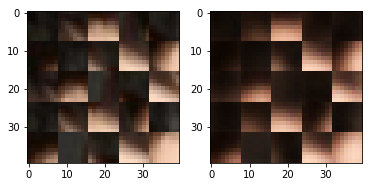

EPO: 5, recon_loss: 0.0088, total_loss: 0.0146
EPO: 5, recon_loss: 0.0202, total_loss: 0.0425
EPO: 5, recon_loss: 0.0152, total_loss: 0.0350
EPO: 5, recon_loss: 0.0192, total_loss: 0.0446
EPO: 5, recon_loss: 0.0143, total_loss: 0.0362
EPO: 5, recon_loss: 0.0190, total_loss: 0.0444
EPO: 5, recon_loss: 0.0067, total_loss: 0.0179
EPO: 5, recon_loss: 0.0076, total_loss: 0.0164
EPO: 5, recon_loss: 0.0183, total_loss: 0.0378
EPO: 5, recon_loss: 0.0096, total_loss: 0.0254
######### what? the reconstruction psnr is: 27.0331


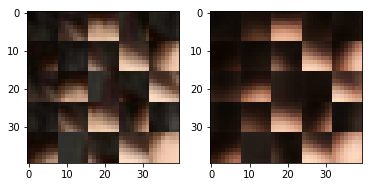

EPO: 5, recon_loss: 0.0085, total_loss: 0.0198
EPO: 5, recon_loss: 0.0083, total_loss: 0.0290
EPO: 5, recon_loss: 0.0094, total_loss: 0.0254
EPO: 5, recon_loss: 0.0163, total_loss: 0.0319
EPO: 5, recon_loss: 0.0082, total_loss: 0.0196
EPO: 5, recon_loss: 0.0071, total_loss: 0.0178
EPO: 5, recon_loss: 0.0105, total_loss: 0.0216
EPO: 5, recon_loss: 0.0059, total_loss: 0.0167
EPO: 5, recon_loss: 0.0206, total_loss: 0.0322
EPO: 5, recon_loss: 0.0083, total_loss: 0.0185
######### what? the reconstruction psnr is: 27.1336


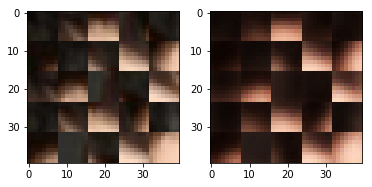

EPO: 5, recon_loss: 0.0057, total_loss: 0.0160
EPO: 5, recon_loss: 0.0089, total_loss: 0.0166
EPO: 5, recon_loss: 0.0046, total_loss: 0.0141
EPO: 5, recon_loss: 0.0149, total_loss: 0.0304
EPO: 5, recon_loss: 0.0153, total_loss: 0.0281
EPO: 5, recon_loss: 0.0106, total_loss: 0.0244
EPO: 5, recon_loss: 0.0185, total_loss: 0.0299
EPO: 5, recon_loss: 0.0038, total_loss: 0.0128
EPO: 5, recon_loss: 0.0141, total_loss: 0.0276
EPO: 5, recon_loss: 0.0141, total_loss: 0.0216
######### what? the reconstruction psnr is: 26.8909


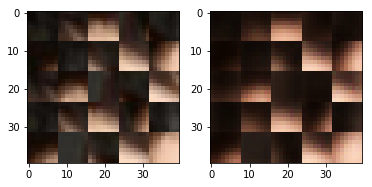

EPO: 5, recon_loss: 0.0122, total_loss: 0.0213
EPO: 5, recon_loss: 0.0113, total_loss: 0.0213
EPO: 5, recon_loss: 0.0044, total_loss: 0.0140
EPO: 5, recon_loss: 0.0079, total_loss: 0.0207
EPO: 5, recon_loss: 0.0060, total_loss: 0.0150
EPO: 5, recon_loss: 0.0063, total_loss: 0.0132
EPO: 5, recon_loss: 0.0065, total_loss: 0.0130
EPO: 5, recon_loss: 0.0227, total_loss: 0.0423
EPO: 5, recon_loss: 0.0169, total_loss: 0.0302
EPO: 5, recon_loss: 0.0145, total_loss: 0.0237
######### what? the reconstruction psnr is: 25.5262


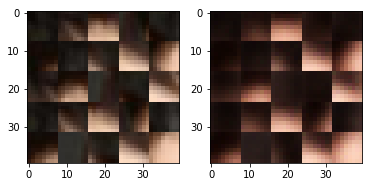

EPO: 5, recon_loss: 0.0174, total_loss: 0.0295
EPO: 5, recon_loss: 0.0126, total_loss: 0.0197
EPO: 5, recon_loss: 0.0093, total_loss: 0.0310
EPO: 5, recon_loss: 0.0052, total_loss: 0.0193
EPO: 5, recon_loss: 0.0167, total_loss: 0.0289
EPO: 5, recon_loss: 0.0081, total_loss: 0.0182
EPO: 5, recon_loss: 0.0173, total_loss: 0.0268
EPO: 5, recon_loss: 0.0039, total_loss: 0.0072
EPO: 5, recon_loss: 0.0025, total_loss: 0.0051
EPO: 5, recon_loss: 0.0107, total_loss: 0.0159
######### what? the reconstruction psnr is: 26.9273


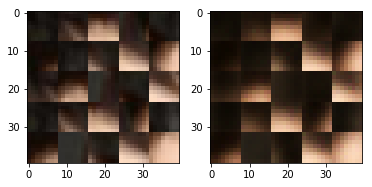

EPO: 5, recon_loss: 0.0032, total_loss: 0.0068
EPO: 5, recon_loss: 0.0064, total_loss: 0.0109
EPO: 5, recon_loss: 0.0104, total_loss: 0.0193
EPO: 5, recon_loss: 0.0091, total_loss: 0.0182
EPO: 5, recon_loss: 0.0105, total_loss: 0.0188
EPO: 5, recon_loss: 0.0056, total_loss: 0.0120
EPO: 5, recon_loss: 0.0073, total_loss: 0.0129
EPO: 5, recon_loss: 0.0135, total_loss: 0.0255
EPO: 5, recon_loss: 0.0127, total_loss: 0.0238
EPO: 5, recon_loss: 0.0182, total_loss: 0.0249
######### what? the reconstruction psnr is: 26.7081


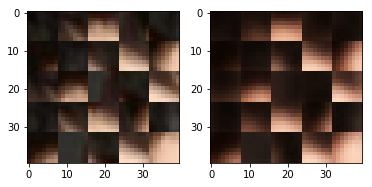

EPO: 5, recon_loss: 0.0132, total_loss: 0.0206
EPO: 5, recon_loss: 0.0126, total_loss: 0.0193
EPO: 5, recon_loss: 0.0167, total_loss: 0.0347
EPO: 5, recon_loss: 0.0331, total_loss: 0.0514
EPO: 5, recon_loss: 0.0153, total_loss: 0.0234
EPO: 5, recon_loss: 0.0097, total_loss: 0.0179
EPO: 5, recon_loss: 0.0095, total_loss: 0.0178
EPO: 5, recon_loss: 0.0062, total_loss: 0.0155
EPO: 5, recon_loss: 0.0035, total_loss: 0.0120
EPO: 5, recon_loss: 0.0110, total_loss: 0.0170
######### what? the reconstruction psnr is: 25.9041


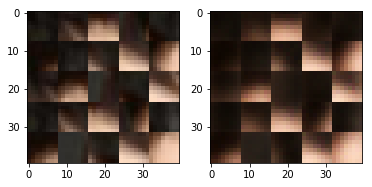

EPO: 5, recon_loss: 0.0061, total_loss: 0.0157
EPO: 5, recon_loss: 0.0084, total_loss: 0.0140
EPO: 5, recon_loss: 0.0072, total_loss: 0.0288
EPO: 5, recon_loss: 0.0032, total_loss: 0.0121
EPO: 5, recon_loss: 0.0075, total_loss: 0.0168
EPO: 5, recon_loss: 0.0032, total_loss: 0.0076
EPO: 5, recon_loss: 0.0023, total_loss: 0.0050
EPO: 5, recon_loss: 0.0105, total_loss: 0.0231
EPO: 5, recon_loss: 0.0110, total_loss: 0.0216
EPO: 5, recon_loss: 0.0108, total_loss: 0.0224
######### what? the reconstruction psnr is: 26.8284


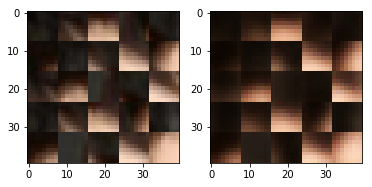

EPO: 5, recon_loss: 0.0130, total_loss: 0.0234
EPO: 5, recon_loss: 0.0114, total_loss: 0.0209
EPO: 6, recon_loss: 0.0069, total_loss: 0.0142
EPO: 6, recon_loss: 0.0038, total_loss: 0.0074
EPO: 6, recon_loss: 0.0110, total_loss: 0.0151
EPO: 6, recon_loss: 0.0089, total_loss: 0.0147
EPO: 6, recon_loss: 0.0056, total_loss: 0.0096
EPO: 6, recon_loss: 0.0080, total_loss: 0.0265
EPO: 6, recon_loss: 0.0033, total_loss: 0.0118
EPO: 6, recon_loss: 0.0077, total_loss: 0.0158
######### what? the reconstruction psnr is: 27.1386


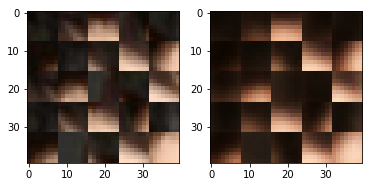

EPO: 6, recon_loss: 0.0100, total_loss: 0.0168
EPO: 6, recon_loss: 0.0096, total_loss: 0.0167
EPO: 6, recon_loss: 0.0102, total_loss: 0.0220
EPO: 6, recon_loss: 0.0046, total_loss: 0.0134
EPO: 6, recon_loss: 0.0067, total_loss: 0.0167
EPO: 6, recon_loss: 0.0054, total_loss: 0.0112
EPO: 6, recon_loss: 0.0079, total_loss: 0.0128
EPO: 6, recon_loss: 0.0186, total_loss: 0.0271
EPO: 6, recon_loss: 0.0079, total_loss: 0.0145
EPO: 6, recon_loss: 0.0079, total_loss: 0.0175
######### what? the reconstruction psnr is: 27.0284


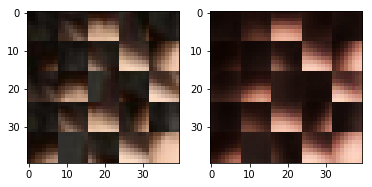

EPO: 6, recon_loss: 0.0093, total_loss: 0.0176
EPO: 6, recon_loss: 0.0072, total_loss: 0.0136
EPO: 6, recon_loss: 0.0076, total_loss: 0.0154
EPO: 6, recon_loss: 0.0071, total_loss: 0.0123
EPO: 6, recon_loss: 0.0080, total_loss: 0.0141
EPO: 6, recon_loss: 0.0151, total_loss: 0.0219
EPO: 6, recon_loss: 0.0046, total_loss: 0.0100
EPO: 6, recon_loss: 0.0104, total_loss: 0.0142
EPO: 6, recon_loss: 0.0192, total_loss: 0.0350
EPO: 6, recon_loss: 0.0084, total_loss: 0.0197
######### what? the reconstruction psnr is: 26.2481


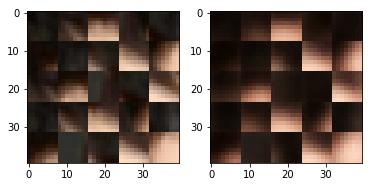

EPO: 6, recon_loss: 0.0165, total_loss: 0.0280
EPO: 6, recon_loss: 0.0154, total_loss: 0.0245
EPO: 6, recon_loss: 0.0229, total_loss: 0.0315
EPO: 6, recon_loss: 0.0144, total_loss: 0.0280
EPO: 6, recon_loss: 0.0065, total_loss: 0.0144
EPO: 6, recon_loss: 0.0127, total_loss: 0.0199
EPO: 6, recon_loss: 0.0086, total_loss: 0.0120
EPO: 6, recon_loss: 0.0081, total_loss: 0.0140
EPO: 6, recon_loss: 0.0032, total_loss: 0.0057
EPO: 6, recon_loss: 0.0037, total_loss: 0.0079
######### what? the reconstruction psnr is: 26.7073


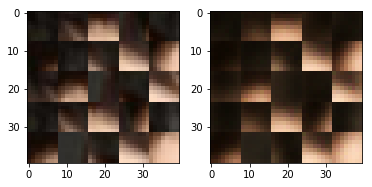

EPO: 6, recon_loss: 0.0104, total_loss: 0.0184
EPO: 6, recon_loss: 0.0052, total_loss: 0.0125
EPO: 6, recon_loss: 0.0076, total_loss: 0.0188
EPO: 6, recon_loss: 0.0045, total_loss: 0.0166
EPO: 6, recon_loss: 0.0047, total_loss: 0.0164
EPO: 6, recon_loss: 0.0121, total_loss: 0.0214
EPO: 6, recon_loss: 0.0028, total_loss: 0.0099
EPO: 6, recon_loss: 0.0094, total_loss: 0.0180
EPO: 6, recon_loss: 0.0186, total_loss: 0.0390
EPO: 6, recon_loss: 0.0046, total_loss: 0.0133
######### what? the reconstruction psnr is: 27.4719


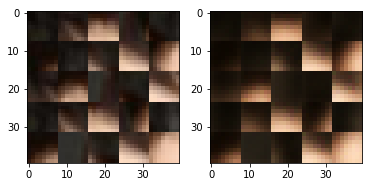

EPO: 6, recon_loss: 0.0247, total_loss: 0.0322
EPO: 6, recon_loss: 0.0057, total_loss: 0.0118
EPO: 6, recon_loss: 0.0071, total_loss: 0.0116
EPO: 6, recon_loss: 0.0126, total_loss: 0.0221
EPO: 6, recon_loss: 0.0061, total_loss: 0.0125
EPO: 6, recon_loss: 0.0127, total_loss: 0.0210
EPO: 6, recon_loss: 0.0072, total_loss: 0.0129
EPO: 6, recon_loss: 0.0129, total_loss: 0.0198
EPO: 6, recon_loss: 0.0266, total_loss: 0.0427
EPO: 6, recon_loss: 0.0142, total_loss: 0.0282
######### what? the reconstruction psnr is: 27.3082


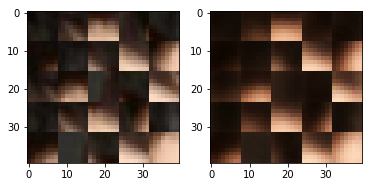

EPO: 6, recon_loss: 0.0277, total_loss: 0.0424
EPO: 6, recon_loss: 0.0163, total_loss: 0.0295
EPO: 6, recon_loss: 0.0139, total_loss: 0.0274
EPO: 6, recon_loss: 0.0062, total_loss: 0.0190
EPO: 6, recon_loss: 0.0071, total_loss: 0.0151
EPO: 6, recon_loss: 0.0113, total_loss: 0.0236
EPO: 6, recon_loss: 0.0100, total_loss: 0.0177
EPO: 6, recon_loss: 0.0123, total_loss: 0.0254
EPO: 6, recon_loss: 0.0090, total_loss: 0.0261
EPO: 6, recon_loss: 0.0038, total_loss: 0.0149
######### what? the reconstruction psnr is: 26.6789


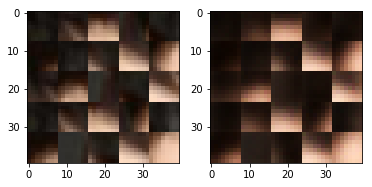

EPO: 6, recon_loss: 0.0200, total_loss: 0.0291
EPO: 6, recon_loss: 0.0084, total_loss: 0.0185
EPO: 6, recon_loss: 0.0079, total_loss: 0.0190
EPO: 6, recon_loss: 0.0151, total_loss: 0.0334
EPO: 6, recon_loss: 0.0109, total_loss: 0.0309
EPO: 6, recon_loss: 0.0240, total_loss: 0.0456
EPO: 6, recon_loss: 0.0228, total_loss: 0.0435
EPO: 6, recon_loss: 0.0104, total_loss: 0.0291
EPO: 6, recon_loss: 0.0315, total_loss: 0.0537
EPO: 6, recon_loss: 0.0116, total_loss: 0.0305
######### what? the reconstruction psnr is: 27.3370


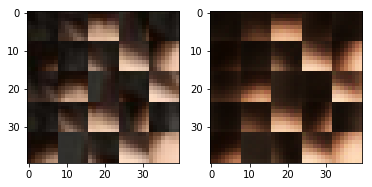

EPO: 6, recon_loss: 0.0205, total_loss: 0.0405
EPO: 6, recon_loss: 0.0257, total_loss: 0.0457
EPO: 6, recon_loss: 0.0194, total_loss: 0.0401
EPO: 6, recon_loss: 0.0200, total_loss: 0.0377
EPO: 6, recon_loss: 0.0062, total_loss: 0.0245
EPO: 6, recon_loss: 0.0312, total_loss: 0.0473
EPO: 6, recon_loss: 0.0278, total_loss: 0.0382
EPO: 6, recon_loss: 0.0093, total_loss: 0.0156
EPO: 6, recon_loss: 0.0083, total_loss: 0.0140
EPO: 6, recon_loss: 0.0040, total_loss: 0.0124
######### what? the reconstruction psnr is: 27.3705


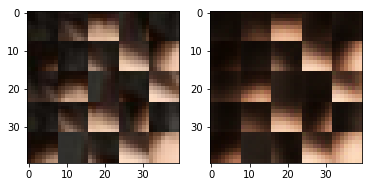

EPO: 6, recon_loss: 0.0072, total_loss: 0.0192
EPO: 6, recon_loss: 0.0124, total_loss: 0.0233
EPO: 6, recon_loss: 0.0086, total_loss: 0.0210
EPO: 6, recon_loss: 0.0157, total_loss: 0.0288
EPO: 6, recon_loss: 0.0013, total_loss: 0.0050
EPO: 6, recon_loss: 0.0018, total_loss: 0.0056
EPO: 6, recon_loss: 0.0047, total_loss: 0.0080
EPO: 6, recon_loss: 0.0023, total_loss: 0.0045
EPO: 6, recon_loss: 0.0059, total_loss: 0.0103
EPO: 6, recon_loss: 0.0069, total_loss: 0.0157
######### what? the reconstruction psnr is: 27.2506


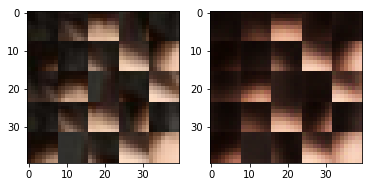

EPO: 6, recon_loss: 0.0082, total_loss: 0.0152
EPO: 6, recon_loss: 0.0159, total_loss: 0.0235
EPO: 6, recon_loss: 0.0060, total_loss: 0.0098
EPO: 6, recon_loss: 0.0090, total_loss: 0.0128
EPO: 6, recon_loss: 0.0138, total_loss: 0.0291
EPO: 6, recon_loss: 0.0240, total_loss: 0.0405
EPO: 6, recon_loss: 0.0182, total_loss: 0.0342
EPO: 6, recon_loss: 0.0120, total_loss: 0.0233
EPO: 6, recon_loss: 0.0124, total_loss: 0.0202
EPO: 6, recon_loss: 0.0103, total_loss: 0.0180
######### what? the reconstruction psnr is: 26.5373


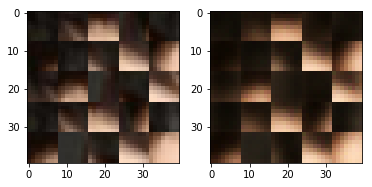

EPO: 6, recon_loss: 0.0079, total_loss: 0.0126
EPO: 6, recon_loss: 0.0105, total_loss: 0.0181
EPO: 6, recon_loss: 0.0053, total_loss: 0.0097
EPO: 6, recon_loss: 0.0070, total_loss: 0.0130
EPO: 6, recon_loss: 0.0082, total_loss: 0.0272
EPO: 6, recon_loss: 0.0026, total_loss: 0.0104
EPO: 6, recon_loss: 0.0193, total_loss: 0.0290
EPO: 6, recon_loss: 0.0103, total_loss: 0.0173
EPO: 6, recon_loss: 0.0110, total_loss: 0.0193
EPO: 6, recon_loss: 0.0043, total_loss: 0.0078
######### what? the reconstruction psnr is: 26.6848


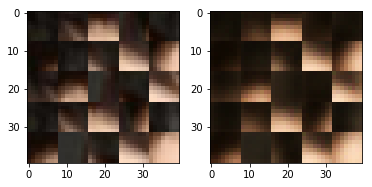

EPO: 6, recon_loss: 0.0034, total_loss: 0.0074
EPO: 6, recon_loss: 0.0071, total_loss: 0.0130
EPO: 6, recon_loss: 0.0028, total_loss: 0.0075
EPO: 6, recon_loss: 0.0037, total_loss: 0.0073
EPO: 6, recon_loss: 0.0082, total_loss: 0.0170
EPO: 6, recon_loss: 0.0053, total_loss: 0.0120
EPO: 6, recon_loss: 0.0175, total_loss: 0.0252
EPO: 6, recon_loss: 0.0072, total_loss: 0.0157
EPO: 6, recon_loss: 0.0055, total_loss: 0.0123
EPO: 6, recon_loss: 0.0076, total_loss: 0.0253
######### what? the reconstruction psnr is: 27.0048


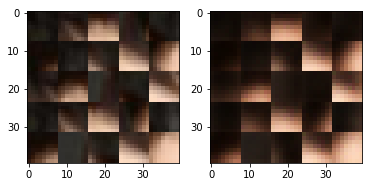

EPO: 6, recon_loss: 0.0074, total_loss: 0.0197
EPO: 6, recon_loss: 0.0279, total_loss: 0.0390
EPO: 6, recon_loss: 0.0098, total_loss: 0.0189
EPO: 6, recon_loss: 0.0140, total_loss: 0.0241
EPO: 6, recon_loss: 0.0059, total_loss: 0.0165
EPO: 6, recon_loss: 0.0013, total_loss: 0.0064
EPO: 6, recon_loss: 0.0098, total_loss: 0.0190
EPO: 6, recon_loss: 0.0111, total_loss: 0.0169
EPO: 6, recon_loss: 0.0096, total_loss: 0.0184
EPO: 6, recon_loss: 0.0093, total_loss: 0.0208
######### what? the reconstruction psnr is: 27.1057


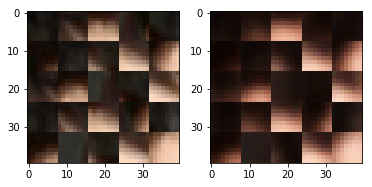

EPO: 6, recon_loss: 0.0137, total_loss: 0.0238
EPO: 6, recon_loss: 0.0116, total_loss: 0.0232
EPO: 6, recon_loss: 0.0111, total_loss: 0.0213
EPO: 6, recon_loss: 0.0038, total_loss: 0.0103
EPO: 6, recon_loss: 0.0157, total_loss: 0.0257
EPO: 6, recon_loss: 0.0071, total_loss: 0.0117
EPO: 6, recon_loss: 0.0147, total_loss: 0.0225
EPO: 6, recon_loss: 0.0147, total_loss: 0.0235
EPO: 6, recon_loss: 0.0072, total_loss: 0.0133
EPO: 6, recon_loss: 0.0069, total_loss: 0.0136
######### what? the reconstruction psnr is: 26.6008


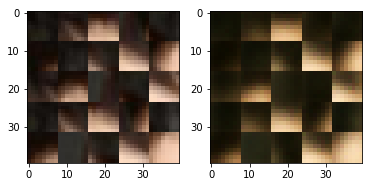

EPO: 6, recon_loss: 0.0104, total_loss: 0.0190
EPO: 6, recon_loss: 0.0088, total_loss: 0.0182
EPO: 6, recon_loss: 0.0157, total_loss: 0.0237
EPO: 6, recon_loss: 0.0100, total_loss: 0.0215
EPO: 6, recon_loss: 0.0153, total_loss: 0.0235
EPO: 6, recon_loss: 0.0081, total_loss: 0.0170
EPO: 6, recon_loss: 0.0039, total_loss: 0.0091
EPO: 6, recon_loss: 0.0080, total_loss: 0.0142
EPO: 6, recon_loss: 0.0072, total_loss: 0.0149
EPO: 6, recon_loss: 0.0112, total_loss: 0.0213
######### what? the reconstruction psnr is: 27.5682


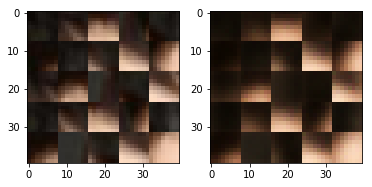

EPO: 6, recon_loss: 0.0081, total_loss: 0.0182
EPO: 6, recon_loss: 0.0105, total_loss: 0.0199
EPO: 6, recon_loss: 0.0242, total_loss: 0.0362
EPO: 6, recon_loss: 0.0074, total_loss: 0.0182
EPO: 6, recon_loss: 0.0220, total_loss: 0.0354
EPO: 6, recon_loss: 0.0059, total_loss: 0.0148
EPO: 6, recon_loss: 0.0039, total_loss: 0.0120
EPO: 6, recon_loss: 0.0173, total_loss: 0.0304
EPO: 6, recon_loss: 0.0073, total_loss: 0.0163
EPO: 6, recon_loss: 0.0179, total_loss: 0.0270
######### what? the reconstruction psnr is: 27.0083


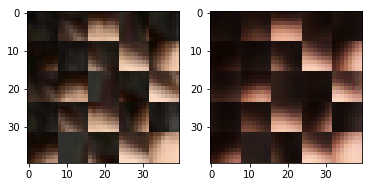

EPO: 6, recon_loss: 0.0049, total_loss: 0.0071
EPO: 6, recon_loss: 0.0033, total_loss: 0.0066
EPO: 6, recon_loss: 0.0098, total_loss: 0.0158
EPO: 6, recon_loss: 0.0044, total_loss: 0.0112
EPO: 6, recon_loss: 0.0105, total_loss: 0.0179
EPO: 6, recon_loss: 0.0184, total_loss: 0.0402
EPO: 6, recon_loss: 0.0142, total_loss: 0.0328
EPO: 6, recon_loss: 0.0227, total_loss: 0.0477
EPO: 6, recon_loss: 0.0123, total_loss: 0.0309
EPO: 6, recon_loss: 0.0228, total_loss: 0.0464
######### what? the reconstruction psnr is: 27.6550


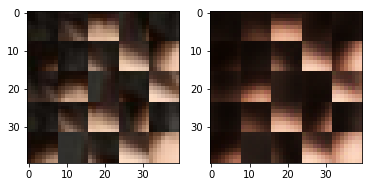

EPO: 6, recon_loss: 0.0055, total_loss: 0.0165
EPO: 6, recon_loss: 0.0108, total_loss: 0.0187
EPO: 6, recon_loss: 0.0146, total_loss: 0.0334
EPO: 6, recon_loss: 0.0087, total_loss: 0.0216
EPO: 6, recon_loss: 0.0081, total_loss: 0.0190
EPO: 6, recon_loss: 0.0080, total_loss: 0.0270
EPO: 6, recon_loss: 0.0090, total_loss: 0.0242
EPO: 6, recon_loss: 0.0218, total_loss: 0.0359
EPO: 6, recon_loss: 0.0052, total_loss: 0.0157
EPO: 6, recon_loss: 0.0049, total_loss: 0.0146
######### what? the reconstruction psnr is: 27.7891


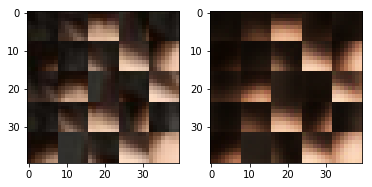

EPO: 6, recon_loss: 0.0104, total_loss: 0.0228
EPO: 6, recon_loss: 0.0042, total_loss: 0.0148
EPO: 6, recon_loss: 0.0216, total_loss: 0.0320
EPO: 6, recon_loss: 0.0048, total_loss: 0.0149
EPO: 6, recon_loss: 0.0062, total_loss: 0.0155
EPO: 6, recon_loss: 0.0080, total_loss: 0.0149
EPO: 6, recon_loss: 0.0042, total_loss: 0.0145
EPO: 6, recon_loss: 0.0188, total_loss: 0.0314
EPO: 6, recon_loss: 0.0117, total_loss: 0.0248
EPO: 6, recon_loss: 0.0089, total_loss: 0.0192
######### what? the reconstruction psnr is: 27.2209


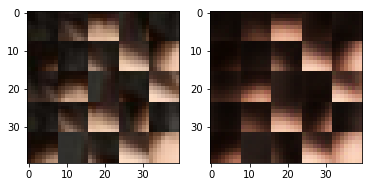

EPO: 6, recon_loss: 0.0108, total_loss: 0.0324
EPO: 6, recon_loss: 0.0033, total_loss: 0.0122
EPO: 6, recon_loss: 0.0183, total_loss: 0.0340
EPO: 6, recon_loss: 0.0093, total_loss: 0.0148
EPO: 6, recon_loss: 0.0099, total_loss: 0.0182
EPO: 6, recon_loss: 0.0073, total_loss: 0.0206
EPO: 6, recon_loss: 0.0039, total_loss: 0.0131
EPO: 6, recon_loss: 0.0114, total_loss: 0.0220
EPO: 6, recon_loss: 0.0046, total_loss: 0.0122
EPO: 6, recon_loss: 0.0077, total_loss: 0.0142
######### what? the reconstruction psnr is: 27.4276


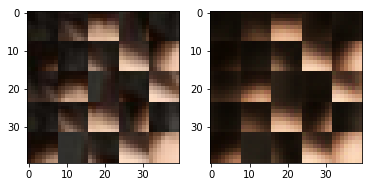

EPO: 6, recon_loss: 0.0165, total_loss: 0.0305
EPO: 6, recon_loss: 0.0224, total_loss: 0.0401
EPO: 6, recon_loss: 0.0146, total_loss: 0.0258
EPO: 6, recon_loss: 0.0136, total_loss: 0.0250
EPO: 6, recon_loss: 0.0173, total_loss: 0.0284
EPO: 6, recon_loss: 0.0076, total_loss: 0.0134
EPO: 6, recon_loss: 0.0069, total_loss: 0.0243
EPO: 6, recon_loss: 0.0082, total_loss: 0.0210
EPO: 6, recon_loss: 0.0128, total_loss: 0.0251
EPO: 6, recon_loss: 0.0103, total_loss: 0.0203
######### what? the reconstruction psnr is: 27.1870


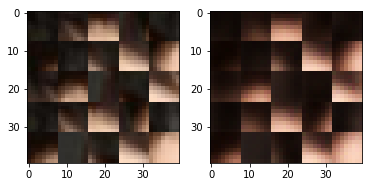

EPO: 6, recon_loss: 0.0171, total_loss: 0.0284
EPO: 6, recon_loss: 0.0029, total_loss: 0.0053
EPO: 6, recon_loss: 0.0047, total_loss: 0.0091
EPO: 6, recon_loss: 0.0063, total_loss: 0.0103
EPO: 6, recon_loss: 0.0028, total_loss: 0.0060
EPO: 6, recon_loss: 0.0068, total_loss: 0.0117
EPO: 6, recon_loss: 0.0109, total_loss: 0.0210
EPO: 6, recon_loss: 0.0088, total_loss: 0.0171
EPO: 6, recon_loss: 0.0094, total_loss: 0.0179
EPO: 6, recon_loss: 0.0064, total_loss: 0.0123
######### what? the reconstruction psnr is: 26.8270


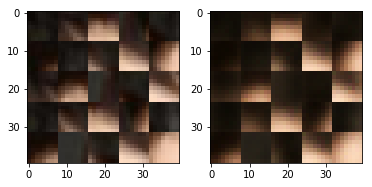

EPO: 6, recon_loss: 0.0106, total_loss: 0.0160
EPO: 6, recon_loss: 0.0112, total_loss: 0.0216
EPO: 6, recon_loss: 0.0108, total_loss: 0.0213
EPO: 6, recon_loss: 0.0183, total_loss: 0.0247
EPO: 6, recon_loss: 0.0103, total_loss: 0.0180
EPO: 6, recon_loss: 0.0140, total_loss: 0.0212
EPO: 6, recon_loss: 0.0203, total_loss: 0.0391
EPO: 6, recon_loss: 0.0204, total_loss: 0.0315
EPO: 6, recon_loss: 0.0141, total_loss: 0.0222
EPO: 6, recon_loss: 0.0074, total_loss: 0.0141
######### what? the reconstruction psnr is: 26.8189


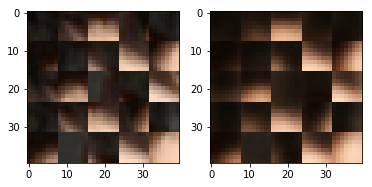

EPO: 6, recon_loss: 0.0099, total_loss: 0.0174
EPO: 6, recon_loss: 0.0034, total_loss: 0.0110
EPO: 6, recon_loss: 0.0045, total_loss: 0.0128
EPO: 6, recon_loss: 0.0121, total_loss: 0.0170
EPO: 6, recon_loss: 0.0076, total_loss: 0.0177
EPO: 6, recon_loss: 0.0128, total_loss: 0.0190
EPO: 6, recon_loss: 0.0064, total_loss: 0.0246
EPO: 6, recon_loss: 0.0028, total_loss: 0.0112
EPO: 6, recon_loss: 0.0096, total_loss: 0.0178
EPO: 6, recon_loss: 0.0019, total_loss: 0.0052
######### what? the reconstruction psnr is: 26.8735


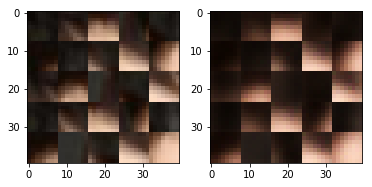

EPO: 6, recon_loss: 0.0027, total_loss: 0.0053
EPO: 6, recon_loss: 0.0111, total_loss: 0.0218
EPO: 6, recon_loss: 0.0099, total_loss: 0.0206
EPO: 6, recon_loss: 0.0097, total_loss: 0.0205
EPO: 6, recon_loss: 0.0108, total_loss: 0.0207
EPO: 6, recon_loss: 0.0108, total_loss: 0.0177
EPO: 7, recon_loss: 0.0052, total_loss: 0.0106
EPO: 7, recon_loss: 0.0036, total_loss: 0.0069
EPO: 7, recon_loss: 0.0131, total_loss: 0.0172
EPO: 7, recon_loss: 0.0045, total_loss: 0.0087
######### what? the reconstruction psnr is: 27.3580


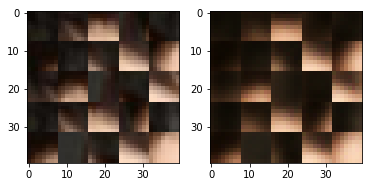

EPO: 7, recon_loss: 0.0044, total_loss: 0.0081
EPO: 7, recon_loss: 0.0054, total_loss: 0.0189
EPO: 7, recon_loss: 0.0031, total_loss: 0.0111
EPO: 7, recon_loss: 0.0056, total_loss: 0.0137
EPO: 7, recon_loss: 0.0051, total_loss: 0.0093
EPO: 7, recon_loss: 0.0099, total_loss: 0.0173
EPO: 7, recon_loss: 0.0047, total_loss: 0.0177
EPO: 7, recon_loss: 0.0038, total_loss: 0.0111
EPO: 7, recon_loss: 0.0064, total_loss: 0.0151
EPO: 7, recon_loss: 0.0047, total_loss: 0.0091
######### what? the reconstruction psnr is: 27.3220


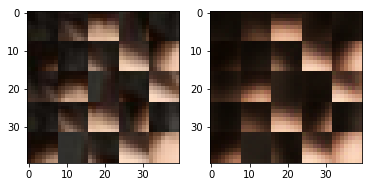

EPO: 7, recon_loss: 0.0076, total_loss: 0.0135
EPO: 7, recon_loss: 0.0086, total_loss: 0.0160
EPO: 7, recon_loss: 0.0081, total_loss: 0.0160
EPO: 7, recon_loss: 0.0068, total_loss: 0.0142
EPO: 7, recon_loss: 0.0072, total_loss: 0.0144
EPO: 7, recon_loss: 0.0056, total_loss: 0.0109
EPO: 7, recon_loss: 0.0087, total_loss: 0.0142
EPO: 7, recon_loss: 0.0055, total_loss: 0.0109
EPO: 7, recon_loss: 0.0083, total_loss: 0.0150
EPO: 7, recon_loss: 0.0122, total_loss: 0.0191
######### what? the reconstruction psnr is: 27.4327


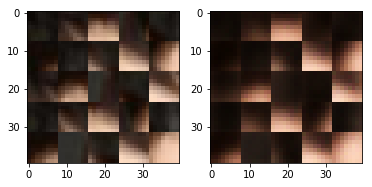

EPO: 7, recon_loss: 0.0045, total_loss: 0.0086
EPO: 7, recon_loss: 0.0106, total_loss: 0.0178
EPO: 7, recon_loss: 0.0086, total_loss: 0.0191
EPO: 7, recon_loss: 0.0088, total_loss: 0.0193
EPO: 7, recon_loss: 0.0155, total_loss: 0.0260
EPO: 7, recon_loss: 0.0167, total_loss: 0.0283
EPO: 7, recon_loss: 0.0152, total_loss: 0.0227
EPO: 7, recon_loss: 0.0106, total_loss: 0.0200
EPO: 7, recon_loss: 0.0079, total_loss: 0.0172
EPO: 7, recon_loss: 0.0105, total_loss: 0.0164
######### what? the reconstruction psnr is: 26.5538


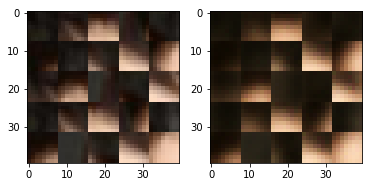

EPO: 7, recon_loss: 0.0076, total_loss: 0.0113
EPO: 7, recon_loss: 0.0100, total_loss: 0.0173
EPO: 7, recon_loss: 0.0028, total_loss: 0.0053
EPO: 7, recon_loss: 0.0052, total_loss: 0.0114
EPO: 7, recon_loss: 0.0082, total_loss: 0.0147
EPO: 7, recon_loss: 0.0058, total_loss: 0.0129
EPO: 7, recon_loss: 0.0095, total_loss: 0.0201
EPO: 7, recon_loss: 0.0039, total_loss: 0.0152
EPO: 7, recon_loss: 0.0037, total_loss: 0.0142
EPO: 7, recon_loss: 0.0109, total_loss: 0.0192
######### what? the reconstruction psnr is: 27.2509


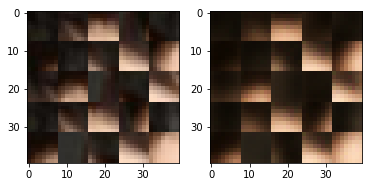

EPO: 7, recon_loss: 0.0028, total_loss: 0.0097
EPO: 7, recon_loss: 0.0117, total_loss: 0.0201
EPO: 7, recon_loss: 0.0164, total_loss: 0.0370
EPO: 7, recon_loss: 0.0056, total_loss: 0.0144
EPO: 7, recon_loss: 0.0172, total_loss: 0.0245
EPO: 7, recon_loss: 0.0045, total_loss: 0.0094
EPO: 7, recon_loss: 0.0096, total_loss: 0.0139
EPO: 7, recon_loss: 0.0108, total_loss: 0.0205
EPO: 7, recon_loss: 0.0048, total_loss: 0.0106
EPO: 7, recon_loss: 0.0109, total_loss: 0.0196
######### what? the reconstruction psnr is: 27.2170


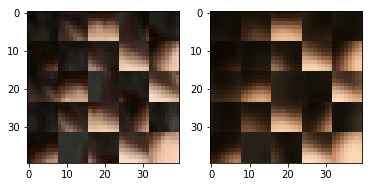

EPO: 7, recon_loss: 0.0071, total_loss: 0.0121
EPO: 7, recon_loss: 0.0136, total_loss: 0.0223
EPO: 7, recon_loss: 0.0156, total_loss: 0.0287
EPO: 7, recon_loss: 0.0160, total_loss: 0.0294
EPO: 7, recon_loss: 0.0320, total_loss: 0.0459
EPO: 7, recon_loss: 0.0180, total_loss: 0.0313
EPO: 7, recon_loss: 0.0130, total_loss: 0.0251
EPO: 7, recon_loss: 0.0056, total_loss: 0.0166
EPO: 7, recon_loss: 0.0069, total_loss: 0.0155
EPO: 7, recon_loss: 0.0120, total_loss: 0.0209
######### what? the reconstruction psnr is: 26.8664


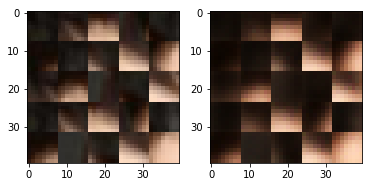

EPO: 7, recon_loss: 0.0076, total_loss: 0.0152
EPO: 7, recon_loss: 0.0112, total_loss: 0.0223
EPO: 7, recon_loss: 0.0069, total_loss: 0.0198
EPO: 7, recon_loss: 0.0035, total_loss: 0.0137
EPO: 7, recon_loss: 0.0171, total_loss: 0.0250
EPO: 7, recon_loss: 0.0060, total_loss: 0.0167
EPO: 7, recon_loss: 0.0076, total_loss: 0.0165
EPO: 7, recon_loss: 0.0138, total_loss: 0.0317
EPO: 7, recon_loss: 0.0110, total_loss: 0.0332
EPO: 7, recon_loss: 0.0266, total_loss: 0.0452
######### what? the reconstruction psnr is: 27.5428


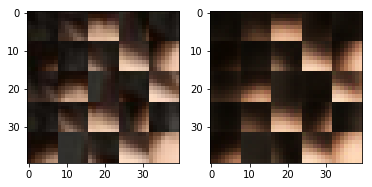

EPO: 7, recon_loss: 0.0126, total_loss: 0.0314
EPO: 7, recon_loss: 0.0105, total_loss: 0.0277
EPO: 7, recon_loss: 0.0193, total_loss: 0.0358
EPO: 7, recon_loss: 0.0110, total_loss: 0.0292
EPO: 7, recon_loss: 0.0306, total_loss: 0.0507
EPO: 7, recon_loss: 0.0182, total_loss: 0.0374
EPO: 7, recon_loss: 0.0181, total_loss: 0.0380
EPO: 7, recon_loss: 0.0079, total_loss: 0.0258
EPO: 7, recon_loss: 0.0079, total_loss: 0.0264
EPO: 7, recon_loss: 0.0286, total_loss: 0.0436
######### what? the reconstruction psnr is: 27.1053


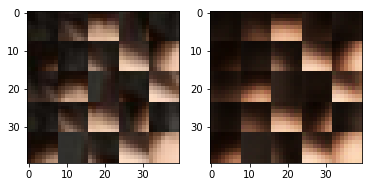

EPO: 7, recon_loss: 0.0290, total_loss: 0.0371
EPO: 7, recon_loss: 0.0060, total_loss: 0.0113
EPO: 7, recon_loss: 0.0076, total_loss: 0.0138
EPO: 7, recon_loss: 0.0041, total_loss: 0.0136
EPO: 7, recon_loss: 0.0100, total_loss: 0.0201
EPO: 7, recon_loss: 0.0094, total_loss: 0.0198
EPO: 7, recon_loss: 0.0089, total_loss: 0.0223
EPO: 7, recon_loss: 0.0183, total_loss: 0.0318
EPO: 7, recon_loss: 0.0013, total_loss: 0.0046
EPO: 7, recon_loss: 0.0019, total_loss: 0.0059
######### what? the reconstruction psnr is: 27.9945


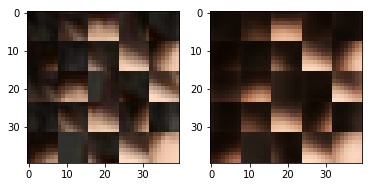

EPO: 7, recon_loss: 0.0032, total_loss: 0.0056
EPO: 7, recon_loss: 0.0024, total_loss: 0.0047
EPO: 7, recon_loss: 0.0072, total_loss: 0.0115
EPO: 7, recon_loss: 0.0059, total_loss: 0.0131
EPO: 7, recon_loss: 0.0090, total_loss: 0.0166
EPO: 7, recon_loss: 0.0140, total_loss: 0.0210
EPO: 7, recon_loss: 0.0056, total_loss: 0.0092
EPO: 7, recon_loss: 0.0136, total_loss: 0.0180
EPO: 7, recon_loss: 0.0131, total_loss: 0.0278
EPO: 7, recon_loss: 0.0194, total_loss: 0.0342
######### what? the reconstruction psnr is: 26.9453


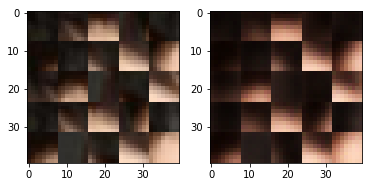

EPO: 7, recon_loss: 0.0161, total_loss: 0.0308
EPO: 7, recon_loss: 0.0101, total_loss: 0.0198
EPO: 7, recon_loss: 0.0140, total_loss: 0.0220
EPO: 7, recon_loss: 0.0101, total_loss: 0.0173
EPO: 7, recon_loss: 0.0076, total_loss: 0.0122
EPO: 7, recon_loss: 0.0097, total_loss: 0.0171
EPO: 7, recon_loss: 0.0070, total_loss: 0.0123
EPO: 7, recon_loss: 0.0095, total_loss: 0.0161
EPO: 7, recon_loss: 0.0071, total_loss: 0.0230
EPO: 7, recon_loss: 0.0037, total_loss: 0.0099
######### what? the reconstruction psnr is: 27.0928


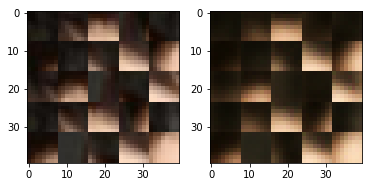

EPO: 7, recon_loss: 0.0137, total_loss: 0.0220
EPO: 7, recon_loss: 0.0102, total_loss: 0.0171
EPO: 7, recon_loss: 0.0130, total_loss: 0.0237
EPO: 7, recon_loss: 0.0039, total_loss: 0.0075
EPO: 7, recon_loss: 0.0034, total_loss: 0.0073
EPO: 7, recon_loss: 0.0065, total_loss: 0.0121
EPO: 7, recon_loss: 0.0022, total_loss: 0.0063
EPO: 7, recon_loss: 0.0036, total_loss: 0.0069
EPO: 7, recon_loss: 0.0070, total_loss: 0.0144
EPO: 7, recon_loss: 0.0048, total_loss: 0.0110
######### what? the reconstruction psnr is: 27.3057


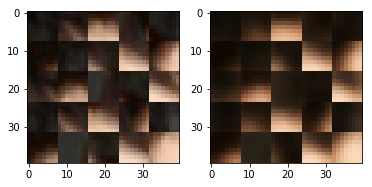

EPO: 7, recon_loss: 0.0173, total_loss: 0.0261
EPO: 7, recon_loss: 0.0080, total_loss: 0.0169
EPO: 7, recon_loss: 0.0053, total_loss: 0.0111
EPO: 7, recon_loss: 0.0060, total_loss: 0.0185
EPO: 7, recon_loss: 0.0063, total_loss: 0.0170
EPO: 7, recon_loss: 0.0263, total_loss: 0.0381
EPO: 7, recon_loss: 0.0074, total_loss: 0.0159
EPO: 7, recon_loss: 0.0194, total_loss: 0.0284
EPO: 7, recon_loss: 0.0027, total_loss: 0.0113
EPO: 7, recon_loss: 0.0011, total_loss: 0.0060
######### what? the reconstruction psnr is: 26.1676


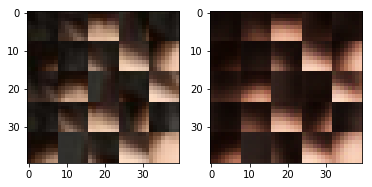

EPO: 7, recon_loss: 0.0160, total_loss: 0.0247
EPO: 7, recon_loss: 0.0087, total_loss: 0.0138
EPO: 7, recon_loss: 0.0090, total_loss: 0.0156
EPO: 7, recon_loss: 0.0093, total_loss: 0.0184
EPO: 7, recon_loss: 0.0120, total_loss: 0.0232
EPO: 7, recon_loss: 0.0148, total_loss: 0.0233
EPO: 7, recon_loss: 0.0064, total_loss: 0.0140
EPO: 7, recon_loss: 0.0041, total_loss: 0.0098
EPO: 7, recon_loss: 0.0111, total_loss: 0.0189
EPO: 7, recon_loss: 0.0056, total_loss: 0.0103
######### what? the reconstruction psnr is: 27.6067


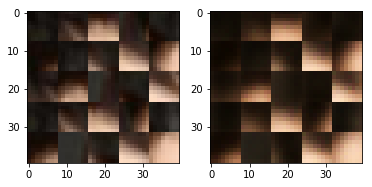

EPO: 7, recon_loss: 0.0162, total_loss: 0.0262
EPO: 7, recon_loss: 0.0057, total_loss: 0.0113
EPO: 7, recon_loss: 0.0059, total_loss: 0.0117
EPO: 7, recon_loss: 0.0123, total_loss: 0.0224
EPO: 7, recon_loss: 0.0089, total_loss: 0.0176
EPO: 7, recon_loss: 0.0086, total_loss: 0.0174
EPO: 7, recon_loss: 0.0124, total_loss: 0.0200
EPO: 7, recon_loss: 0.0106, total_loss: 0.0213
EPO: 7, recon_loss: 0.0096, total_loss: 0.0320
EPO: 7, recon_loss: 0.0060, total_loss: 0.0126
######### what? the reconstruction psnr is: 27.8039


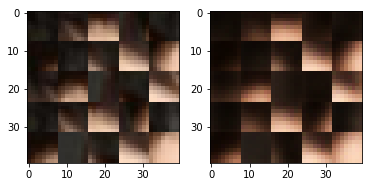

EPO: 7, recon_loss: 0.0053, total_loss: 0.0118
EPO: 7, recon_loss: 0.0052, total_loss: 0.0107
EPO: 7, recon_loss: 0.0087, total_loss: 0.0173
EPO: 7, recon_loss: 0.0080, total_loss: 0.0178
EPO: 7, recon_loss: 0.0051, total_loss: 0.0131
EPO: 7, recon_loss: 0.0141, total_loss: 0.0229
EPO: 7, recon_loss: 0.0192, total_loss: 0.0301
EPO: 7, recon_loss: 0.0097, total_loss: 0.0221
EPO: 7, recon_loss: 0.0218, total_loss: 0.0332
EPO: 7, recon_loss: 0.0048, total_loss: 0.0132
######### what? the reconstruction psnr is: 27.5856


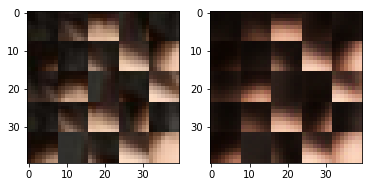

EPO: 7, recon_loss: 0.0059, total_loss: 0.0150
EPO: 7, recon_loss: 0.0121, total_loss: 0.0235
EPO: 7, recon_loss: 0.0091, total_loss: 0.0176
EPO: 7, recon_loss: 0.0167, total_loss: 0.0258
EPO: 7, recon_loss: 0.0043, total_loss: 0.0065
EPO: 7, recon_loss: 0.0033, total_loss: 0.0064
EPO: 7, recon_loss: 0.0102, total_loss: 0.0182
EPO: 7, recon_loss: 0.0045, total_loss: 0.0112
EPO: 7, recon_loss: 0.0091, total_loss: 0.0160
EPO: 7, recon_loss: 0.0202, total_loss: 0.0389
######### what? the reconstruction psnr is: 28.0323


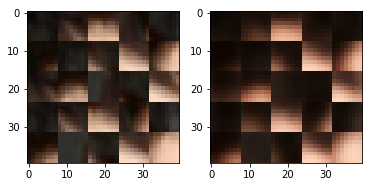

EPO: 7, recon_loss: 0.0109, total_loss: 0.0295
EPO: 7, recon_loss: 0.0247, total_loss: 0.0465
EPO: 7, recon_loss: 0.0130, total_loss: 0.0331
EPO: 7, recon_loss: 0.0205, total_loss: 0.0448
EPO: 7, recon_loss: 0.0056, total_loss: 0.0186
EPO: 7, recon_loss: 0.0103, total_loss: 0.0168
EPO: 7, recon_loss: 0.0122, total_loss: 0.0290
EPO: 7, recon_loss: 0.0076, total_loss: 0.0188
EPO: 7, recon_loss: 0.0099, total_loss: 0.0200
EPO: 7, recon_loss: 0.0083, total_loss: 0.0269
######### what? the reconstruction psnr is: 28.2585


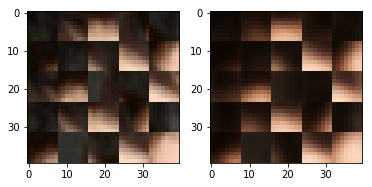

EPO: 7, recon_loss: 0.0087, total_loss: 0.0209
EPO: 7, recon_loss: 0.0234, total_loss: 0.0361
EPO: 7, recon_loss: 0.0052, total_loss: 0.0152
EPO: 7, recon_loss: 0.0049, total_loss: 0.0157
EPO: 7, recon_loss: 0.0091, total_loss: 0.0206
EPO: 7, recon_loss: 0.0035, total_loss: 0.0146
EPO: 7, recon_loss: 0.0217, total_loss: 0.0320
EPO: 7, recon_loss: 0.0043, total_loss: 0.0136
EPO: 7, recon_loss: 0.0079, total_loss: 0.0183
EPO: 7, recon_loss: 0.0061, total_loss: 0.0130
######### what? the reconstruction psnr is: 27.3952


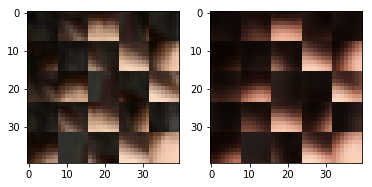

EPO: 7, recon_loss: 0.0049, total_loss: 0.0166
EPO: 7, recon_loss: 0.0245, total_loss: 0.0336
EPO: 7, recon_loss: 0.0070, total_loss: 0.0185
EPO: 7, recon_loss: 0.0076, total_loss: 0.0155
EPO: 7, recon_loss: 0.0078, total_loss: 0.0248
EPO: 7, recon_loss: 0.0033, total_loss: 0.0116
EPO: 7, recon_loss: 0.0213, total_loss: 0.0344
EPO: 7, recon_loss: 0.0048, total_loss: 0.0088
EPO: 7, recon_loss: 0.0102, total_loss: 0.0192
EPO: 7, recon_loss: 0.0059, total_loss: 0.0187
######### what? the reconstruction psnr is: 27.9761


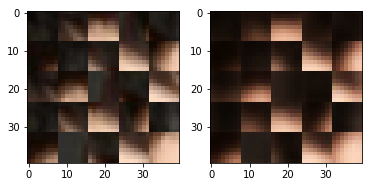

EPO: 7, recon_loss: 0.0034, total_loss: 0.0122
EPO: 7, recon_loss: 0.0125, total_loss: 0.0215
EPO: 7, recon_loss: 0.0030, total_loss: 0.0094
EPO: 7, recon_loss: 0.0078, total_loss: 0.0146
EPO: 7, recon_loss: 0.0214, total_loss: 0.0410
EPO: 7, recon_loss: 0.0180, total_loss: 0.0350
EPO: 7, recon_loss: 0.0110, total_loss: 0.0198
EPO: 7, recon_loss: 0.0117, total_loss: 0.0235
EPO: 7, recon_loss: 0.0098, total_loss: 0.0176
EPO: 7, recon_loss: 0.0115, total_loss: 0.0314
######### what? the reconstruction psnr is: 27.4191


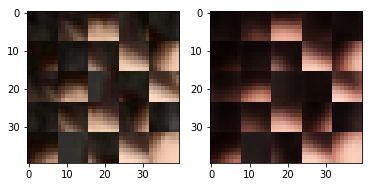

EPO: 7, recon_loss: 0.0051, total_loss: 0.0205
EPO: 7, recon_loss: 0.0077, total_loss: 0.0182
EPO: 7, recon_loss: 0.0097, total_loss: 0.0197
EPO: 7, recon_loss: 0.0125, total_loss: 0.0238
EPO: 7, recon_loss: 0.0070, total_loss: 0.0146
EPO: 7, recon_loss: 0.0022, total_loss: 0.0044
EPO: 7, recon_loss: 0.0067, total_loss: 0.0113
EPO: 7, recon_loss: 0.0042, total_loss: 0.0073
EPO: 7, recon_loss: 0.0031, total_loss: 0.0061
EPO: 7, recon_loss: 0.0078, total_loss: 0.0125
######### what? the reconstruction psnr is: 27.4035


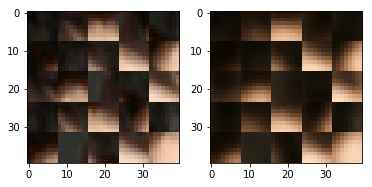

EPO: 7, recon_loss: 0.0078, total_loss: 0.0158
EPO: 7, recon_loss: 0.0108, total_loss: 0.0192
EPO: 7, recon_loss: 0.0078, total_loss: 0.0153
EPO: 7, recon_loss: 0.0065, total_loss: 0.0112
EPO: 7, recon_loss: 0.0126, total_loss: 0.0179
EPO: 7, recon_loss: 0.0099, total_loss: 0.0193
EPO: 7, recon_loss: 0.0132, total_loss: 0.0239
EPO: 7, recon_loss: 0.0139, total_loss: 0.0200
EPO: 7, recon_loss: 0.0104, total_loss: 0.0182
EPO: 7, recon_loss: 0.0159, total_loss: 0.0230
######### what? the reconstruction psnr is: 27.1293


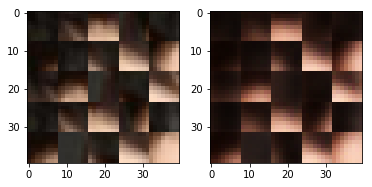

EPO: 7, recon_loss: 0.0173, total_loss: 0.0351
EPO: 7, recon_loss: 0.0151, total_loss: 0.0229
EPO: 7, recon_loss: 0.0128, total_loss: 0.0202
EPO: 7, recon_loss: 0.0069, total_loss: 0.0133
EPO: 7, recon_loss: 0.0097, total_loss: 0.0177
EPO: 7, recon_loss: 0.0029, total_loss: 0.0099
EPO: 7, recon_loss: 0.0047, total_loss: 0.0125
EPO: 7, recon_loss: 0.0120, total_loss: 0.0176
EPO: 7, recon_loss: 0.0105, total_loss: 0.0203
EPO: 7, recon_loss: 0.0224, total_loss: 0.0308
######### what? the reconstruction psnr is: 26.6182


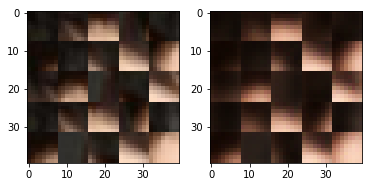

EPO: 7, recon_loss: 0.0053, total_loss: 0.0195
EPO: 7, recon_loss: 0.0043, total_loss: 0.0108
EPO: 7, recon_loss: 0.0080, total_loss: 0.0150
EPO: 7, recon_loss: 0.0017, total_loss: 0.0045
EPO: 7, recon_loss: 0.0040, total_loss: 0.0075
EPO: 7, recon_loss: 0.0099, total_loss: 0.0197
EPO: 7, recon_loss: 0.0095, total_loss: 0.0195
EPO: 7, recon_loss: 0.0119, total_loss: 0.0218
EPO: 7, recon_loss: 0.0110, total_loss: 0.0204
EPO: 7, recon_loss: 0.0097, total_loss: 0.0149
######### what? the reconstruction psnr is: 27.7032


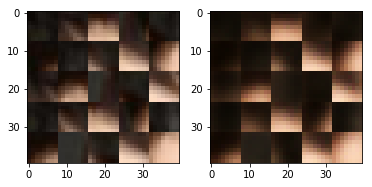

EPO: 8, recon_loss: 0.0040, total_loss: 0.0079
EPO: 8, recon_loss: 0.0034, total_loss: 0.0064
EPO: 8, recon_loss: 0.0141, total_loss: 0.0180
EPO: 8, recon_loss: 0.0038, total_loss: 0.0083
EPO: 8, recon_loss: 0.0075, total_loss: 0.0124
EPO: 8, recon_loss: 0.0048, total_loss: 0.0170
EPO: 8, recon_loss: 0.0039, total_loss: 0.0131
EPO: 8, recon_loss: 0.0076, total_loss: 0.0147
EPO: 8, recon_loss: 0.0051, total_loss: 0.0097
EPO: 8, recon_loss: 0.0101, total_loss: 0.0184
######### what? the reconstruction psnr is: 27.7896


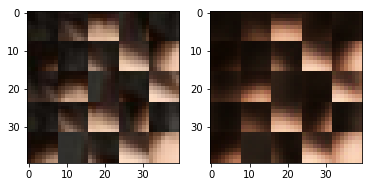

EPO: 8, recon_loss: 0.0042, total_loss: 0.0159
EPO: 8, recon_loss: 0.0024, total_loss: 0.0072
EPO: 8, recon_loss: 0.0065, total_loss: 0.0146
EPO: 8, recon_loss: 0.0039, total_loss: 0.0067
EPO: 8, recon_loss: 0.0082, total_loss: 0.0146
EPO: 8, recon_loss: 0.0076, total_loss: 0.0161
EPO: 8, recon_loss: 0.0069, total_loss: 0.0132
EPO: 8, recon_loss: 0.0071, total_loss: 0.0144
EPO: 8, recon_loss: 0.0061, total_loss: 0.0130
EPO: 8, recon_loss: 0.0048, total_loss: 0.0100
######### what? the reconstruction psnr is: 27.5584


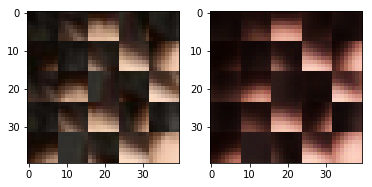

EPO: 8, recon_loss: 0.0087, total_loss: 0.0132
EPO: 8, recon_loss: 0.0043, total_loss: 0.0099
EPO: 8, recon_loss: 0.0109, total_loss: 0.0173
EPO: 8, recon_loss: 0.0065, total_loss: 0.0114
EPO: 8, recon_loss: 0.0065, total_loss: 0.0106
EPO: 8, recon_loss: 0.0195, total_loss: 0.0367
EPO: 8, recon_loss: 0.0071, total_loss: 0.0166
EPO: 8, recon_loss: 0.0105, total_loss: 0.0217
EPO: 8, recon_loss: 0.0169, total_loss: 0.0289
EPO: 8, recon_loss: 0.0097, total_loss: 0.0177
######### what? the reconstruction psnr is: 27.3139


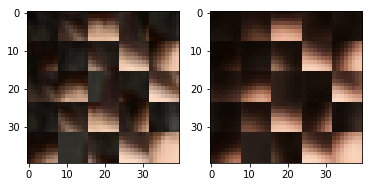

EPO: 8, recon_loss: 0.0077, total_loss: 0.0186
EPO: 8, recon_loss: 0.0071, total_loss: 0.0146
EPO: 8, recon_loss: 0.0091, total_loss: 0.0180
EPO: 8, recon_loss: 0.0059, total_loss: 0.0097
EPO: 8, recon_loss: 0.0076, total_loss: 0.0119
EPO: 8, recon_loss: 0.0034, total_loss: 0.0074
EPO: 8, recon_loss: 0.0037, total_loss: 0.0073
EPO: 8, recon_loss: 0.0038, total_loss: 0.0091
EPO: 8, recon_loss: 0.0077, total_loss: 0.0129
EPO: 8, recon_loss: 0.0068, total_loss: 0.0148
######### what? the reconstruction psnr is: 27.9611


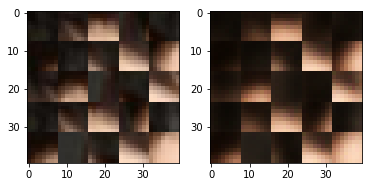

EPO: 8, recon_loss: 0.0098, total_loss: 0.0221
EPO: 8, recon_loss: 0.0038, total_loss: 0.0141
EPO: 8, recon_loss: 0.0046, total_loss: 0.0139
EPO: 8, recon_loss: 0.0070, total_loss: 0.0137
EPO: 8, recon_loss: 0.0031, total_loss: 0.0092
EPO: 8, recon_loss: 0.0122, total_loss: 0.0229
EPO: 8, recon_loss: 0.0161, total_loss: 0.0337
EPO: 8, recon_loss: 0.0075, total_loss: 0.0170
EPO: 8, recon_loss: 0.0139, total_loss: 0.0200
EPO: 8, recon_loss: 0.0053, total_loss: 0.0098
######### what? the reconstruction psnr is: 28.0190


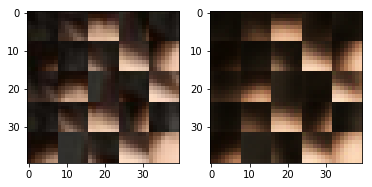

EPO: 8, recon_loss: 0.0105, total_loss: 0.0156
EPO: 8, recon_loss: 0.0079, total_loss: 0.0153
EPO: 8, recon_loss: 0.0074, total_loss: 0.0149
EPO: 8, recon_loss: 0.0103, total_loss: 0.0196
EPO: 8, recon_loss: 0.0095, total_loss: 0.0160
EPO: 8, recon_loss: 0.0164, total_loss: 0.0238
EPO: 8, recon_loss: 0.0142, total_loss: 0.0265
EPO: 8, recon_loss: 0.0171, total_loss: 0.0299
EPO: 8, recon_loss: 0.0316, total_loss: 0.0452
EPO: 8, recon_loss: 0.0150, total_loss: 0.0276
######### what? the reconstruction psnr is: 27.9173


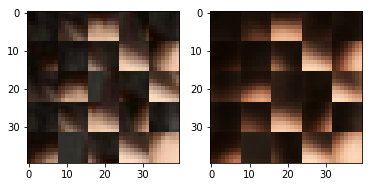

EPO: 8, recon_loss: 0.0146, total_loss: 0.0264
EPO: 8, recon_loss: 0.0069, total_loss: 0.0146
EPO: 8, recon_loss: 0.0070, total_loss: 0.0156
EPO: 8, recon_loss: 0.0094, total_loss: 0.0173
EPO: 8, recon_loss: 0.0094, total_loss: 0.0186
EPO: 8, recon_loss: 0.0140, total_loss: 0.0242
EPO: 8, recon_loss: 0.0044, total_loss: 0.0156
EPO: 8, recon_loss: 0.0053, total_loss: 0.0148
EPO: 8, recon_loss: 0.0168, total_loss: 0.0264
EPO: 8, recon_loss: 0.0045, total_loss: 0.0150
######### what? the reconstruction psnr is: 27.2678


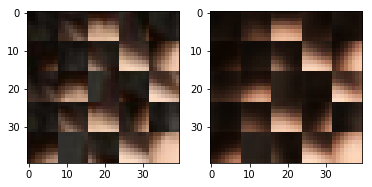

EPO: 8, recon_loss: 0.0067, total_loss: 0.0151
EPO: 8, recon_loss: 0.0122, total_loss: 0.0326
EPO: 8, recon_loss: 0.0098, total_loss: 0.0276
EPO: 8, recon_loss: 0.0346, total_loss: 0.0544
EPO: 8, recon_loss: 0.0085, total_loss: 0.0257
EPO: 8, recon_loss: 0.0105, total_loss: 0.0296
EPO: 8, recon_loss: 0.0175, total_loss: 0.0334
EPO: 8, recon_loss: 0.0100, total_loss: 0.0301
EPO: 8, recon_loss: 0.0335, total_loss: 0.0510
EPO: 8, recon_loss: 0.0151, total_loss: 0.0345
######### what? the reconstruction psnr is: 28.1508


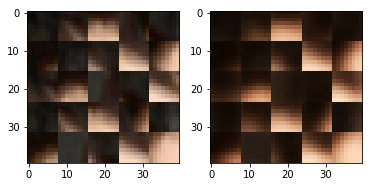

EPO: 8, recon_loss: 0.0168, total_loss: 0.0351
EPO: 8, recon_loss: 0.0081, total_loss: 0.0264
EPO: 8, recon_loss: 0.0071, total_loss: 0.0224
EPO: 8, recon_loss: 0.0334, total_loss: 0.0479
EPO: 8, recon_loss: 0.0322, total_loss: 0.0395
EPO: 8, recon_loss: 0.0061, total_loss: 0.0128
EPO: 8, recon_loss: 0.0055, total_loss: 0.0123
EPO: 8, recon_loss: 0.0041, total_loss: 0.0136
EPO: 8, recon_loss: 0.0161, total_loss: 0.0244
EPO: 8, recon_loss: 0.0065, total_loss: 0.0179
######### what? the reconstruction psnr is: 28.2073


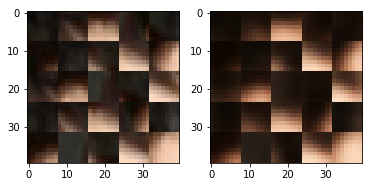

EPO: 8, recon_loss: 0.0096, total_loss: 0.0207
EPO: 8, recon_loss: 0.0038, total_loss: 0.0108
EPO: 8, recon_loss: 0.0012, total_loss: 0.0042
EPO: 8, recon_loss: 0.0019, total_loss: 0.0058
EPO: 8, recon_loss: 0.0020, total_loss: 0.0037
EPO: 8, recon_loss: 0.0024, total_loss: 0.0049
EPO: 8, recon_loss: 0.0119, total_loss: 0.0300
EPO: 8, recon_loss: 0.0055, total_loss: 0.0127
EPO: 8, recon_loss: 0.0091, total_loss: 0.0175
EPO: 8, recon_loss: 0.0094, total_loss: 0.0143
######### what? the reconstruction psnr is: 27.3642


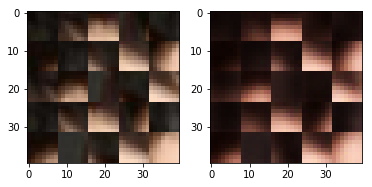

EPO: 8, recon_loss: 0.0070, total_loss: 0.0103
EPO: 8, recon_loss: 0.0139, total_loss: 0.0289
EPO: 8, recon_loss: 0.0130, total_loss: 0.0251
EPO: 8, recon_loss: 0.0180, total_loss: 0.0311
EPO: 8, recon_loss: 0.0147, total_loss: 0.0292
EPO: 8, recon_loss: 0.0071, total_loss: 0.0155
EPO: 8, recon_loss: 0.0103, total_loss: 0.0185
EPO: 8, recon_loss: 0.0077, total_loss: 0.0129
EPO: 8, recon_loss: 0.0076, total_loss: 0.0125
EPO: 8, recon_loss: 0.0071, total_loss: 0.0135
######### what? the reconstruction psnr is: 27.1959


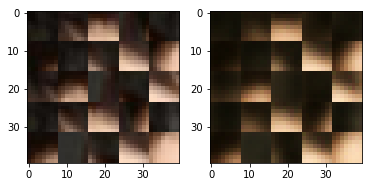

EPO: 8, recon_loss: 0.0064, total_loss: 0.0113
EPO: 8, recon_loss: 0.0092, total_loss: 0.0167
EPO: 8, recon_loss: 0.0062, total_loss: 0.0172
EPO: 8, recon_loss: 0.0052, total_loss: 0.0133
EPO: 8, recon_loss: 0.0135, total_loss: 0.0215
EPO: 8, recon_loss: 0.0142, total_loss: 0.0217
EPO: 8, recon_loss: 0.0081, total_loss: 0.0169
EPO: 8, recon_loss: 0.0030, total_loss: 0.0067
EPO: 8, recon_loss: 0.0039, total_loss: 0.0078
EPO: 8, recon_loss: 0.0062, total_loss: 0.0123
######### what? the reconstruction psnr is: 27.2435


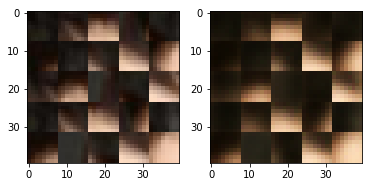

EPO: 8, recon_loss: 0.0027, total_loss: 0.0061
EPO: 8, recon_loss: 0.0049, total_loss: 0.0087
EPO: 8, recon_loss: 0.0059, total_loss: 0.0122
EPO: 8, recon_loss: 0.0068, total_loss: 0.0135
EPO: 8, recon_loss: 0.0131, total_loss: 0.0212
EPO: 8, recon_loss: 0.0074, total_loss: 0.0153
EPO: 8, recon_loss: 0.0052, total_loss: 0.0100
EPO: 8, recon_loss: 0.0046, total_loss: 0.0148
EPO: 8, recon_loss: 0.0053, total_loss: 0.0158
EPO: 8, recon_loss: 0.0220, total_loss: 0.0333
######### what? the reconstruction psnr is: 27.7820


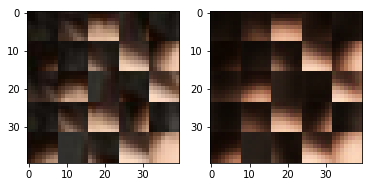

EPO: 8, recon_loss: 0.0062, total_loss: 0.0143
EPO: 8, recon_loss: 0.0263, total_loss: 0.0390
EPO: 8, recon_loss: 0.0021, total_loss: 0.0085
EPO: 8, recon_loss: 0.0013, total_loss: 0.0063
EPO: 8, recon_loss: 0.0188, total_loss: 0.0269
EPO: 8, recon_loss: 0.0060, total_loss: 0.0110
EPO: 8, recon_loss: 0.0073, total_loss: 0.0135
EPO: 8, recon_loss: 0.0079, total_loss: 0.0169
EPO: 8, recon_loss: 0.0099, total_loss: 0.0197
EPO: 8, recon_loss: 0.0180, total_loss: 0.0266
######### what? the reconstruction psnr is: 28.0812


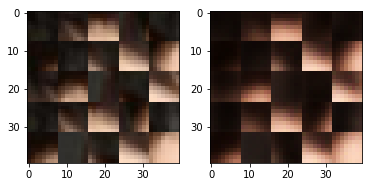

EPO: 8, recon_loss: 0.0043, total_loss: 0.0108
EPO: 8, recon_loss: 0.0061, total_loss: 0.0117
EPO: 8, recon_loss: 0.0084, total_loss: 0.0142
EPO: 8, recon_loss: 0.0054, total_loss: 0.0094
EPO: 8, recon_loss: 0.0129, total_loss: 0.0230
EPO: 8, recon_loss: 0.0043, total_loss: 0.0093
EPO: 8, recon_loss: 0.0053, total_loss: 0.0115
EPO: 8, recon_loss: 0.0128, total_loss: 0.0239
EPO: 8, recon_loss: 0.0071, total_loss: 0.0163
EPO: 8, recon_loss: 0.0115, total_loss: 0.0194
######### what? the reconstruction psnr is: 28.0123


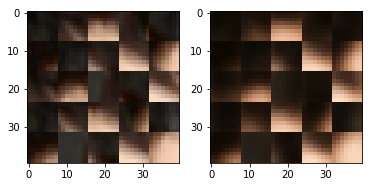

EPO: 8, recon_loss: 0.0081, total_loss: 0.0168
EPO: 8, recon_loss: 0.0097, total_loss: 0.0189
EPO: 8, recon_loss: 0.0112, total_loss: 0.0305
EPO: 8, recon_loss: 0.0032, total_loss: 0.0083
EPO: 8, recon_loss: 0.0077, total_loss: 0.0135
EPO: 8, recon_loss: 0.0052, total_loss: 0.0115
EPO: 8, recon_loss: 0.0062, total_loss: 0.0128
EPO: 8, recon_loss: 0.0074, total_loss: 0.0175
EPO: 8, recon_loss: 0.0046, total_loss: 0.0118
EPO: 8, recon_loss: 0.0134, total_loss: 0.0217
######### what? the reconstruction psnr is: 27.6590


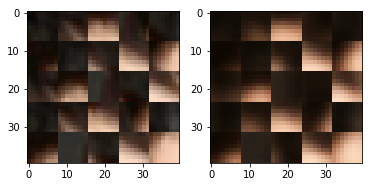

EPO: 8, recon_loss: 0.0131, total_loss: 0.0227
EPO: 8, recon_loss: 0.0108, total_loss: 0.0231
EPO: 8, recon_loss: 0.0110, total_loss: 0.0261
EPO: 8, recon_loss: 0.0054, total_loss: 0.0139
EPO: 8, recon_loss: 0.0061, total_loss: 0.0155
EPO: 8, recon_loss: 0.0106, total_loss: 0.0195
EPO: 8, recon_loss: 0.0092, total_loss: 0.0183
EPO: 8, recon_loss: 0.0073, total_loss: 0.0111
EPO: 8, recon_loss: 0.0038, total_loss: 0.0066
EPO: 8, recon_loss: 0.0030, total_loss: 0.0061
######### what? the reconstruction psnr is: 27.9601


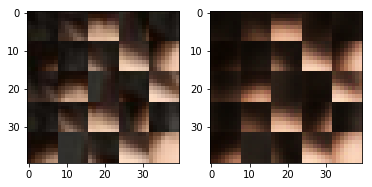

EPO: 8, recon_loss: 0.0065, total_loss: 0.0133
EPO: 8, recon_loss: 0.0055, total_loss: 0.0121
EPO: 8, recon_loss: 0.0096, total_loss: 0.0166
EPO: 8, recon_loss: 0.0156, total_loss: 0.0346
EPO: 8, recon_loss: 0.0089, total_loss: 0.0248
EPO: 8, recon_loss: 0.0189, total_loss: 0.0395
EPO: 8, recon_loss: 0.0143, total_loss: 0.0365
EPO: 8, recon_loss: 0.0174, total_loss: 0.0406
EPO: 8, recon_loss: 0.0048, total_loss: 0.0148
EPO: 8, recon_loss: 0.0165, total_loss: 0.0259
######### what? the reconstruction psnr is: 27.5522


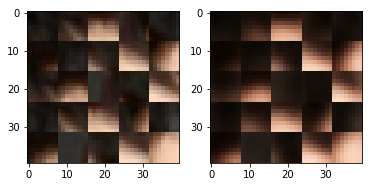

EPO: 8, recon_loss: 0.0089, total_loss: 0.0245
EPO: 8, recon_loss: 0.0082, total_loss: 0.0187
EPO: 8, recon_loss: 0.0107, total_loss: 0.0222
EPO: 8, recon_loss: 0.0083, total_loss: 0.0238
EPO: 8, recon_loss: 0.0102, total_loss: 0.0223
EPO: 8, recon_loss: 0.0167, total_loss: 0.0295
EPO: 8, recon_loss: 0.0057, total_loss: 0.0163
EPO: 8, recon_loss: 0.0075, total_loss: 0.0177
EPO: 8, recon_loss: 0.0066, total_loss: 0.0152
EPO: 8, recon_loss: 0.0045, total_loss: 0.0149
######### what? the reconstruction psnr is: 28.3513


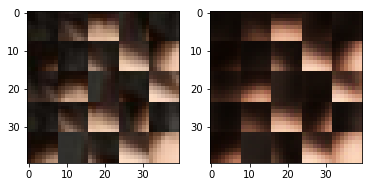

EPO: 8, recon_loss: 0.0164, total_loss: 0.0257
EPO: 8, recon_loss: 0.0045, total_loss: 0.0134
EPO: 8, recon_loss: 0.0081, total_loss: 0.0180
EPO: 8, recon_loss: 0.0048, total_loss: 0.0121
EPO: 8, recon_loss: 0.0059, total_loss: 0.0179
EPO: 8, recon_loss: 0.0201, total_loss: 0.0281
EPO: 8, recon_loss: 0.0068, total_loss: 0.0184
EPO: 8, recon_loss: 0.0104, total_loss: 0.0183
EPO: 8, recon_loss: 0.0050, total_loss: 0.0157
EPO: 8, recon_loss: 0.0043, total_loss: 0.0123
######### what? the reconstruction psnr is: 28.2477


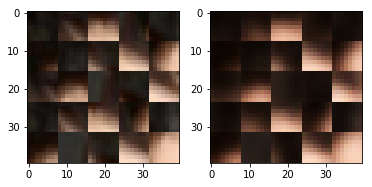

EPO: 8, recon_loss: 0.0162, total_loss: 0.0264
EPO: 8, recon_loss: 0.0049, total_loss: 0.0091
EPO: 8, recon_loss: 0.0109, total_loss: 0.0192
EPO: 8, recon_loss: 0.0050, total_loss: 0.0158
EPO: 8, recon_loss: 0.0030, total_loss: 0.0108
EPO: 8, recon_loss: 0.0096, total_loss: 0.0164
EPO: 8, recon_loss: 0.0032, total_loss: 0.0098
EPO: 8, recon_loss: 0.0067, total_loss: 0.0126
EPO: 8, recon_loss: 0.0183, total_loss: 0.0367
EPO: 8, recon_loss: 0.0170, total_loss: 0.0319
######### what? the reconstruction psnr is: 27.1032


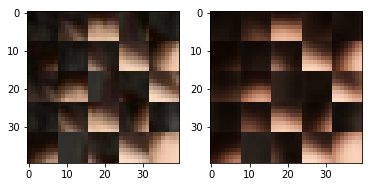

EPO: 8, recon_loss: 0.0097, total_loss: 0.0173
EPO: 8, recon_loss: 0.0107, total_loss: 0.0215
EPO: 8, recon_loss: 0.0074, total_loss: 0.0137
EPO: 8, recon_loss: 0.0101, total_loss: 0.0293
EPO: 8, recon_loss: 0.0044, total_loss: 0.0182
EPO: 8, recon_loss: 0.0114, total_loss: 0.0213
EPO: 8, recon_loss: 0.0079, total_loss: 0.0187
EPO: 8, recon_loss: 0.0098, total_loss: 0.0191
EPO: 8, recon_loss: 0.0062, total_loss: 0.0128
EPO: 8, recon_loss: 0.0017, total_loss: 0.0037
######### what? the reconstruction psnr is: 28.1794


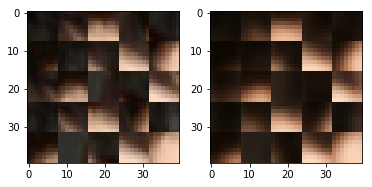

EPO: 8, recon_loss: 0.0092, total_loss: 0.0138
EPO: 8, recon_loss: 0.0028, total_loss: 0.0056
EPO: 8, recon_loss: 0.0030, total_loss: 0.0059
EPO: 8, recon_loss: 0.0062, total_loss: 0.0114
EPO: 8, recon_loss: 0.0069, total_loss: 0.0139
EPO: 8, recon_loss: 0.0121, total_loss: 0.0207
EPO: 8, recon_loss: 0.0061, total_loss: 0.0125
EPO: 8, recon_loss: 0.0065, total_loss: 0.0108
EPO: 8, recon_loss: 0.0125, total_loss: 0.0285
EPO: 8, recon_loss: 0.0129, total_loss: 0.0236
######### what? the reconstruction psnr is: 27.8696


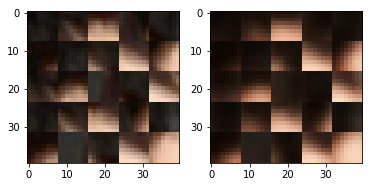

EPO: 8, recon_loss: 0.0099, total_loss: 0.0181
EPO: 8, recon_loss: 0.0123, total_loss: 0.0181
EPO: 8, recon_loss: 0.0105, total_loss: 0.0174
EPO: 8, recon_loss: 0.0204, total_loss: 0.0331
EPO: 8, recon_loss: 0.0259, total_loss: 0.0444
EPO: 8, recon_loss: 0.0111, total_loss: 0.0185
EPO: 8, recon_loss: 0.0098, total_loss: 0.0165
EPO: 8, recon_loss: 0.0070, total_loss: 0.0134
EPO: 8, recon_loss: 0.0176, total_loss: 0.0275
EPO: 8, recon_loss: 0.0024, total_loss: 0.0093
######### what? the reconstruction psnr is: 27.4312


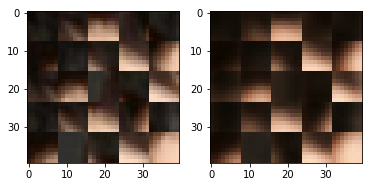

EPO: 8, recon_loss: 0.0056, total_loss: 0.0137
EPO: 8, recon_loss: 0.0107, total_loss: 0.0174
EPO: 8, recon_loss: 0.0102, total_loss: 0.0197
EPO: 8, recon_loss: 0.0231, total_loss: 0.0323
EPO: 8, recon_loss: 0.0033, total_loss: 0.0125
EPO: 8, recon_loss: 0.0051, total_loss: 0.0113
EPO: 8, recon_loss: 0.0082, total_loss: 0.0152
EPO: 8, recon_loss: 0.0025, total_loss: 0.0059
EPO: 8, recon_loss: 0.0049, total_loss: 0.0080
EPO: 8, recon_loss: 0.0084, total_loss: 0.0183
######### what? the reconstruction psnr is: 27.8946


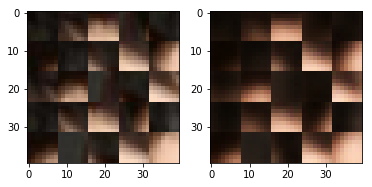

EPO: 8, recon_loss: 0.0087, total_loss: 0.0177
EPO: 8, recon_loss: 0.0125, total_loss: 0.0219
EPO: 8, recon_loss: 0.0095, total_loss: 0.0183
EPO: 8, recon_loss: 0.0127, total_loss: 0.0189
EPO: 9, recon_loss: 0.0040, total_loss: 0.0075
EPO: 9, recon_loss: 0.0033, total_loss: 0.0064
EPO: 9, recon_loss: 0.0147, total_loss: 0.0207
EPO: 9, recon_loss: 0.0043, total_loss: 0.0086
EPO: 9, recon_loss: 0.0092, total_loss: 0.0140
EPO: 9, recon_loss: 0.0045, total_loss: 0.0156
######### what? the reconstruction psnr is: 28.3032


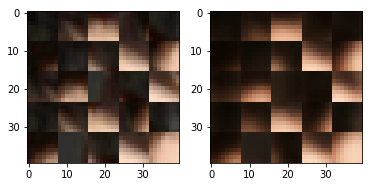

EPO: 9, recon_loss: 0.0052, total_loss: 0.0126
EPO: 9, recon_loss: 0.0075, total_loss: 0.0136
EPO: 9, recon_loss: 0.0063, total_loss: 0.0107
EPO: 9, recon_loss: 0.0111, total_loss: 0.0208
EPO: 9, recon_loss: 0.0036, total_loss: 0.0141
EPO: 9, recon_loss: 0.0021, total_loss: 0.0063
EPO: 9, recon_loss: 0.0058, total_loss: 0.0133
EPO: 9, recon_loss: 0.0042, total_loss: 0.0066
EPO: 9, recon_loss: 0.0094, total_loss: 0.0174
EPO: 9, recon_loss: 0.0070, total_loss: 0.0138
######### what? the reconstruction psnr is: 28.4278


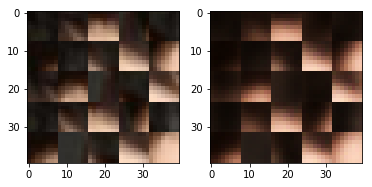

EPO: 9, recon_loss: 0.0063, total_loss: 0.0125
EPO: 9, recon_loss: 0.0070, total_loss: 0.0129
EPO: 9, recon_loss: 0.0057, total_loss: 0.0132
EPO: 9, recon_loss: 0.0056, total_loss: 0.0113
EPO: 9, recon_loss: 0.0065, total_loss: 0.0105
EPO: 9, recon_loss: 0.0043, total_loss: 0.0097
EPO: 9, recon_loss: 0.0120, total_loss: 0.0168
EPO: 9, recon_loss: 0.0044, total_loss: 0.0084
EPO: 9, recon_loss: 0.0064, total_loss: 0.0099
EPO: 9, recon_loss: 0.0138, total_loss: 0.0261
######### what? the reconstruction psnr is: 27.4928


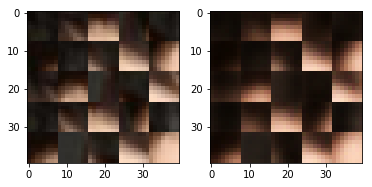

EPO: 9, recon_loss: 0.0056, total_loss: 0.0143
EPO: 9, recon_loss: 0.0119, total_loss: 0.0247
EPO: 9, recon_loss: 0.0144, total_loss: 0.0236
EPO: 9, recon_loss: 0.0112, total_loss: 0.0188
EPO: 9, recon_loss: 0.0101, total_loss: 0.0242
EPO: 9, recon_loss: 0.0053, total_loss: 0.0127
EPO: 9, recon_loss: 0.0103, total_loss: 0.0175
EPO: 9, recon_loss: 0.0046, total_loss: 0.0074
EPO: 9, recon_loss: 0.0042, total_loss: 0.0081
EPO: 9, recon_loss: 0.0033, total_loss: 0.0066
######### what? the reconstruction psnr is: 26.8306


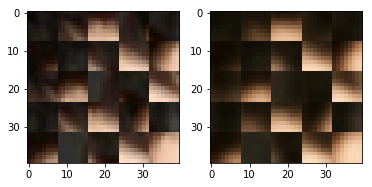

EPO: 9, recon_loss: 0.0029, total_loss: 0.0060
EPO: 9, recon_loss: 0.0047, total_loss: 0.0111
EPO: 9, recon_loss: 0.0046, total_loss: 0.0090
EPO: 9, recon_loss: 0.0072, total_loss: 0.0168
EPO: 9, recon_loss: 0.0038, total_loss: 0.0153
EPO: 9, recon_loss: 0.0032, total_loss: 0.0124
EPO: 9, recon_loss: 0.0052, total_loss: 0.0131
EPO: 9, recon_loss: 0.0050, total_loss: 0.0101
EPO: 9, recon_loss: 0.0049, total_loss: 0.0120
EPO: 9, recon_loss: 0.0079, total_loss: 0.0223
######### what? the reconstruction psnr is: 28.2440


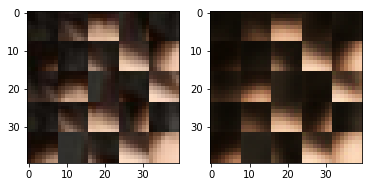

EPO: 9, recon_loss: 0.0067, total_loss: 0.0163
EPO: 9, recon_loss: 0.0118, total_loss: 0.0213
EPO: 9, recon_loss: 0.0091, total_loss: 0.0145
EPO: 9, recon_loss: 0.0063, total_loss: 0.0109
EPO: 9, recon_loss: 0.0144, total_loss: 0.0214
EPO: 9, recon_loss: 0.0060, total_loss: 0.0117
EPO: 9, recon_loss: 0.0080, total_loss: 0.0171
EPO: 9, recon_loss: 0.0088, total_loss: 0.0167
EPO: 9, recon_loss: 0.0088, total_loss: 0.0160
EPO: 9, recon_loss: 0.0212, total_loss: 0.0270
######### what? the reconstruction psnr is: 28.1611


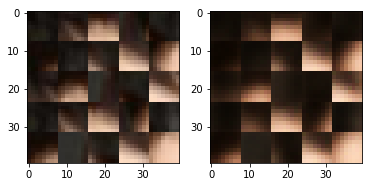

EPO: 9, recon_loss: 0.0138, total_loss: 0.0258
EPO: 9, recon_loss: 0.0175, total_loss: 0.0307
EPO: 9, recon_loss: 0.0276, total_loss: 0.0401
EPO: 9, recon_loss: 0.0149, total_loss: 0.0266
EPO: 9, recon_loss: 0.0154, total_loss: 0.0260
EPO: 9, recon_loss: 0.0062, total_loss: 0.0131
EPO: 9, recon_loss: 0.0078, total_loss: 0.0152
EPO: 9, recon_loss: 0.0104, total_loss: 0.0183
EPO: 9, recon_loss: 0.0121, total_loss: 0.0233
EPO: 9, recon_loss: 0.0137, total_loss: 0.0223
######### what? the reconstruction psnr is: 28.4480


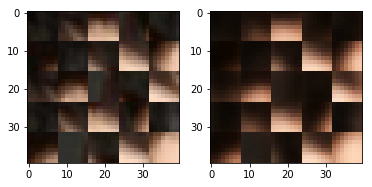

EPO: 9, recon_loss: 0.0046, total_loss: 0.0151
EPO: 9, recon_loss: 0.0093, total_loss: 0.0197
EPO: 9, recon_loss: 0.0139, total_loss: 0.0239
EPO: 9, recon_loss: 0.0044, total_loss: 0.0145
EPO: 9, recon_loss: 0.0085, total_loss: 0.0164
EPO: 9, recon_loss: 0.0095, total_loss: 0.0265
EPO: 9, recon_loss: 0.0095, total_loss: 0.0261
EPO: 9, recon_loss: 0.0311, total_loss: 0.0496
EPO: 9, recon_loss: 0.0089, total_loss: 0.0277
EPO: 9, recon_loss: 0.0109, total_loss: 0.0271
######### what? the reconstruction psnr is: 28.2016


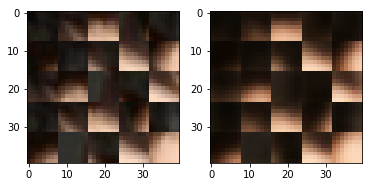

EPO: 9, recon_loss: 0.0129, total_loss: 0.0284
EPO: 9, recon_loss: 0.0088, total_loss: 0.0274
EPO: 9, recon_loss: 0.0358, total_loss: 0.0536
EPO: 9, recon_loss: 0.0162, total_loss: 0.0345
EPO: 9, recon_loss: 0.0153, total_loss: 0.0332
EPO: 9, recon_loss: 0.0048, total_loss: 0.0205
EPO: 9, recon_loss: 0.0122, total_loss: 0.0315
EPO: 9, recon_loss: 0.0368, total_loss: 0.0497
EPO: 9, recon_loss: 0.0231, total_loss: 0.0317
EPO: 9, recon_loss: 0.0064, total_loss: 0.0113
######### what? the reconstruction psnr is: 27.9579


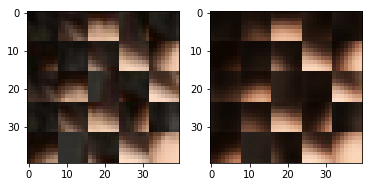

EPO: 9, recon_loss: 0.0038, total_loss: 0.0108
EPO: 9, recon_loss: 0.0047, total_loss: 0.0139
EPO: 9, recon_loss: 0.0150, total_loss: 0.0233
EPO: 9, recon_loss: 0.0060, total_loss: 0.0168
EPO: 9, recon_loss: 0.0105, total_loss: 0.0211
EPO: 9, recon_loss: 0.0024, total_loss: 0.0066
EPO: 9, recon_loss: 0.0012, total_loss: 0.0042
EPO: 9, recon_loss: 0.0028, total_loss: 0.0062
EPO: 9, recon_loss: 0.0016, total_loss: 0.0032
EPO: 9, recon_loss: 0.0021, total_loss: 0.0050
######### what? the reconstruction psnr is: 28.3880


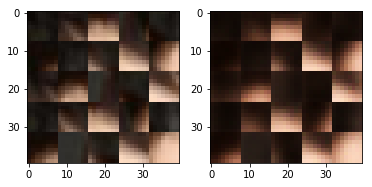

EPO: 9, recon_loss: 0.0108, total_loss: 0.0261
EPO: 9, recon_loss: 0.0046, total_loss: 0.0113
EPO: 9, recon_loss: 0.0090, total_loss: 0.0163
EPO: 9, recon_loss: 0.0056, total_loss: 0.0093
EPO: 9, recon_loss: 0.0059, total_loss: 0.0088
EPO: 9, recon_loss: 0.0133, total_loss: 0.0298
EPO: 9, recon_loss: 0.0123, total_loss: 0.0230
EPO: 9, recon_loss: 0.0143, total_loss: 0.0261
EPO: 9, recon_loss: 0.0142, total_loss: 0.0273
EPO: 9, recon_loss: 0.0071, total_loss: 0.0153
######### what? the reconstruction psnr is: 27.8417


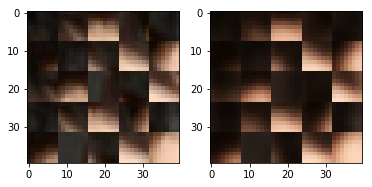

EPO: 9, recon_loss: 0.0119, total_loss: 0.0189
EPO: 9, recon_loss: 0.0067, total_loss: 0.0115
EPO: 9, recon_loss: 0.0068, total_loss: 0.0118
EPO: 9, recon_loss: 0.0056, total_loss: 0.0105
EPO: 9, recon_loss: 0.0069, total_loss: 0.0129
EPO: 9, recon_loss: 0.0041, total_loss: 0.0189
EPO: 9, recon_loss: 0.0034, total_loss: 0.0110
EPO: 9, recon_loss: 0.0086, total_loss: 0.0176
EPO: 9, recon_loss: 0.0113, total_loss: 0.0188
EPO: 9, recon_loss: 0.0076, total_loss: 0.0137
######### what? the reconstruction psnr is: 27.9246


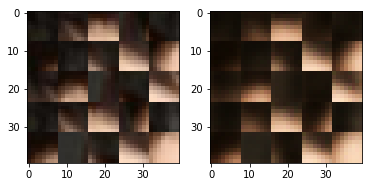

EPO: 9, recon_loss: 0.0064, total_loss: 0.0126
EPO: 9, recon_loss: 0.0026, total_loss: 0.0063
EPO: 9, recon_loss: 0.0042, total_loss: 0.0079
EPO: 9, recon_loss: 0.0053, total_loss: 0.0108
EPO: 9, recon_loss: 0.0033, total_loss: 0.0065
EPO: 9, recon_loss: 0.0063, total_loss: 0.0103
EPO: 9, recon_loss: 0.0047, total_loss: 0.0099
EPO: 9, recon_loss: 0.0065, total_loss: 0.0132
EPO: 9, recon_loss: 0.0096, total_loss: 0.0176
EPO: 9, recon_loss: 0.0076, total_loss: 0.0142
######### what? the reconstruction psnr is: 27.5993


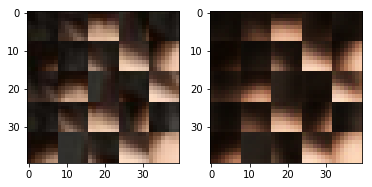

EPO: 9, recon_loss: 0.0044, total_loss: 0.0096
EPO: 9, recon_loss: 0.0057, total_loss: 0.0177
EPO: 9, recon_loss: 0.0107, total_loss: 0.0219
EPO: 9, recon_loss: 0.0186, total_loss: 0.0306
EPO: 9, recon_loss: 0.0067, total_loss: 0.0148
EPO: 9, recon_loss: 0.0245, total_loss: 0.0360
EPO: 9, recon_loss: 0.0015, total_loss: 0.0065
EPO: 9, recon_loss: 0.0032, total_loss: 0.0085
EPO: 9, recon_loss: 0.0164, total_loss: 0.0245
EPO: 9, recon_loss: 0.0045, total_loss: 0.0100
######### what? the reconstruction psnr is: 27.3491


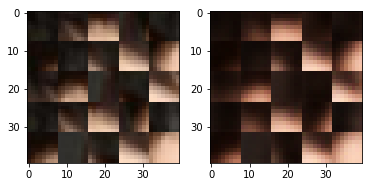

EPO: 9, recon_loss: 0.0069, total_loss: 0.0127
EPO: 9, recon_loss: 0.0070, total_loss: 0.0147
EPO: 9, recon_loss: 0.0078, total_loss: 0.0177
EPO: 9, recon_loss: 0.0143, total_loss: 0.0226
EPO: 9, recon_loss: 0.0038, total_loss: 0.0105
EPO: 9, recon_loss: 0.0087, total_loss: 0.0151
EPO: 9, recon_loss: 0.0076, total_loss: 0.0125
EPO: 9, recon_loss: 0.0081, total_loss: 0.0134
EPO: 9, recon_loss: 0.0132, total_loss: 0.0235
EPO: 9, recon_loss: 0.0046, total_loss: 0.0100
######### what? the reconstruction psnr is: 27.7512


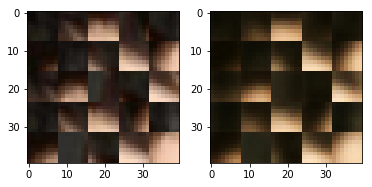

EPO: 9, recon_loss: 0.0059, total_loss: 0.0124
EPO: 9, recon_loss: 0.0110, total_loss: 0.0204
EPO: 9, recon_loss: 0.0060, total_loss: 0.0147
EPO: 9, recon_loss: 0.0148, total_loss: 0.0220
EPO: 9, recon_loss: 0.0075, total_loss: 0.0167
EPO: 9, recon_loss: 0.0102, total_loss: 0.0187
EPO: 9, recon_loss: 0.0112, total_loss: 0.0275
EPO: 9, recon_loss: 0.0020, total_loss: 0.0067
EPO: 9, recon_loss: 0.0097, total_loss: 0.0149
EPO: 9, recon_loss: 0.0043, total_loss: 0.0100
######### what? the reconstruction psnr is: 28.5722


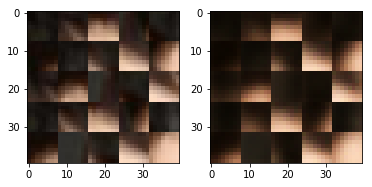

EPO: 9, recon_loss: 0.0056, total_loss: 0.0116
EPO: 9, recon_loss: 0.0064, total_loss: 0.0167
EPO: 9, recon_loss: 0.0043, total_loss: 0.0114
EPO: 9, recon_loss: 0.0156, total_loss: 0.0247
EPO: 9, recon_loss: 0.0062, total_loss: 0.0146
EPO: 9, recon_loss: 0.0123, total_loss: 0.0220
EPO: 9, recon_loss: 0.0089, total_loss: 0.0217
EPO: 9, recon_loss: 0.0037, total_loss: 0.0118
EPO: 9, recon_loss: 0.0104, total_loss: 0.0203
EPO: 9, recon_loss: 0.0048, total_loss: 0.0118
######### what? the reconstruction psnr is: 28.1005


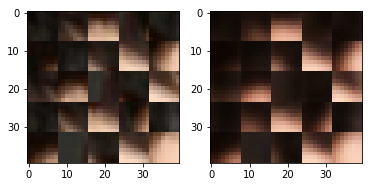

EPO: 9, recon_loss: 0.0086, total_loss: 0.0161
EPO: 9, recon_loss: 0.0053, total_loss: 0.0074
EPO: 9, recon_loss: 0.0029, total_loss: 0.0054
EPO: 9, recon_loss: 0.0038, total_loss: 0.0074
EPO: 9, recon_loss: 0.0050, total_loss: 0.0099
EPO: 9, recon_loss: 0.0056, total_loss: 0.0123
EPO: 9, recon_loss: 0.0149, total_loss: 0.0336
EPO: 9, recon_loss: 0.0145, total_loss: 0.0304
EPO: 9, recon_loss: 0.0119, total_loss: 0.0286
EPO: 9, recon_loss: 0.0139, total_loss: 0.0338
######### what? the reconstruction psnr is: 28.9032


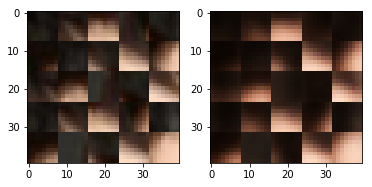

EPO: 9, recon_loss: 0.0128, total_loss: 0.0342
EPO: 9, recon_loss: 0.0052, total_loss: 0.0149
EPO: 9, recon_loss: 0.0061, total_loss: 0.0143
EPO: 9, recon_loss: 0.0191, total_loss: 0.0330
EPO: 9, recon_loss: 0.0074, total_loss: 0.0214
EPO: 9, recon_loss: 0.0077, total_loss: 0.0184
EPO: 9, recon_loss: 0.0079, total_loss: 0.0182
EPO: 9, recon_loss: 0.0075, total_loss: 0.0213
EPO: 9, recon_loss: 0.0104, total_loss: 0.0229
EPO: 9, recon_loss: 0.0121, total_loss: 0.0242
######### what? the reconstruction psnr is: 28.9110


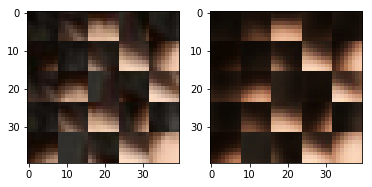

EPO: 9, recon_loss: 0.0060, total_loss: 0.0151
EPO: 9, recon_loss: 0.0070, total_loss: 0.0163
EPO: 9, recon_loss: 0.0050, total_loss: 0.0135
EPO: 9, recon_loss: 0.0095, total_loss: 0.0202
EPO: 9, recon_loss: 0.0132, total_loss: 0.0220
EPO: 9, recon_loss: 0.0040, total_loss: 0.0121
EPO: 9, recon_loss: 0.0079, total_loss: 0.0175
EPO: 9, recon_loss: 0.0036, total_loss: 0.0113
EPO: 9, recon_loss: 0.0071, total_loss: 0.0178
EPO: 9, recon_loss: 0.0164, total_loss: 0.0252
######### what? the reconstruction psnr is: 28.2473


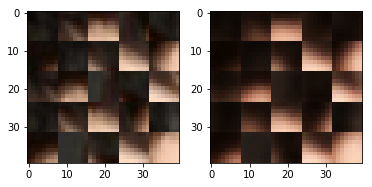

EPO: 9, recon_loss: 0.0069, total_loss: 0.0184
EPO: 9, recon_loss: 0.0127, total_loss: 0.0214
EPO: 9, recon_loss: 0.0032, total_loss: 0.0121
EPO: 9, recon_loss: 0.0056, total_loss: 0.0128
EPO: 9, recon_loss: 0.0115, total_loss: 0.0191
EPO: 9, recon_loss: 0.0055, total_loss: 0.0107
EPO: 9, recon_loss: 0.0087, total_loss: 0.0190
EPO: 9, recon_loss: 0.0036, total_loss: 0.0112
EPO: 9, recon_loss: 0.0031, total_loss: 0.0108
EPO: 9, recon_loss: 0.0070, total_loss: 0.0140
######### what? the reconstruction psnr is: 28.5557


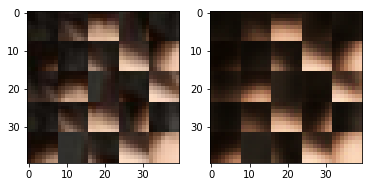

EPO: 9, recon_loss: 0.0037, total_loss: 0.0095
EPO: 9, recon_loss: 0.0054, total_loss: 0.0118
EPO: 9, recon_loss: 0.0162, total_loss: 0.0311
EPO: 9, recon_loss: 0.0130, total_loss: 0.0271
EPO: 9, recon_loss: 0.0091, total_loss: 0.0162
EPO: 9, recon_loss: 0.0115, total_loss: 0.0224
EPO: 9, recon_loss: 0.0065, total_loss: 0.0130
EPO: 9, recon_loss: 0.0094, total_loss: 0.0274
EPO: 9, recon_loss: 0.0044, total_loss: 0.0162
EPO: 9, recon_loss: 0.0124, total_loss: 0.0225
######### what? the reconstruction psnr is: 28.0751


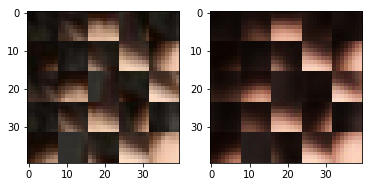

EPO: 9, recon_loss: 0.0052, total_loss: 0.0138
EPO: 9, recon_loss: 0.0105, total_loss: 0.0189
EPO: 9, recon_loss: 0.0036, total_loss: 0.0071
EPO: 9, recon_loss: 0.0016, total_loss: 0.0036
EPO: 9, recon_loss: 0.0082, total_loss: 0.0125
EPO: 9, recon_loss: 0.0026, total_loss: 0.0055
EPO: 9, recon_loss: 0.0036, total_loss: 0.0066
EPO: 9, recon_loss: 0.0074, total_loss: 0.0136
EPO: 9, recon_loss: 0.0052, total_loss: 0.0118
EPO: 9, recon_loss: 0.0106, total_loss: 0.0183
######### what? the reconstruction psnr is: 27.9380


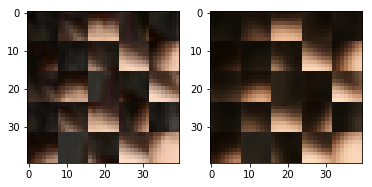

EPO: 9, recon_loss: 0.0039, total_loss: 0.0092
EPO: 9, recon_loss: 0.0044, total_loss: 0.0079
EPO: 9, recon_loss: 0.0128, total_loss: 0.0278
EPO: 9, recon_loss: 0.0090, total_loss: 0.0174
EPO: 9, recon_loss: 0.0119, total_loss: 0.0195
EPO: 9, recon_loss: 0.0083, total_loss: 0.0141
EPO: 9, recon_loss: 0.0114, total_loss: 0.0182
EPO: 9, recon_loss: 0.0166, total_loss: 0.0296
EPO: 9, recon_loss: 0.0288, total_loss: 0.0484
EPO: 9, recon_loss: 0.0086, total_loss: 0.0151
######### what? the reconstruction psnr is: 27.7135


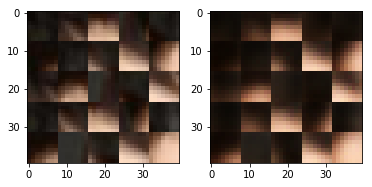

EPO: 9, recon_loss: 0.0056, total_loss: 0.0113
EPO: 9, recon_loss: 0.0085, total_loss: 0.0160
EPO: 9, recon_loss: 0.0042, total_loss: 0.0114
EPO: 9, recon_loss: 0.0024, total_loss: 0.0097
EPO: 9, recon_loss: 0.0061, total_loss: 0.0125
EPO: 9, recon_loss: 0.0062, total_loss: 0.0139
EPO: 9, recon_loss: 0.0078, total_loss: 0.0138
EPO: 9, recon_loss: 0.0041, total_loss: 0.0233
EPO: 9, recon_loss: 0.0024, total_loss: 0.0096
EPO: 9, recon_loss: 0.0060, total_loss: 0.0121
######### what? the reconstruction psnr is: 28.0131


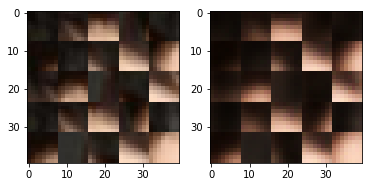

EPO: 9, recon_loss: 0.0053, total_loss: 0.0113
EPO: 9, recon_loss: 0.0018, total_loss: 0.0040
EPO: 9, recon_loss: 0.0065, total_loss: 0.0129
EPO: 9, recon_loss: 0.0081, total_loss: 0.0175
EPO: 9, recon_loss: 0.0097, total_loss: 0.0175
EPO: 9, recon_loss: 0.0122, total_loss: 0.0224
EPO: 9, recon_loss: 0.0096, total_loss: 0.0188
EPO: 9, recon_loss: 0.0106, total_loss: 0.0163
EPO: 10, recon_loss: 0.0033, total_loss: 0.0062
EPO: 10, recon_loss: 0.0042, total_loss: 0.0074
######### what? the reconstruction psnr is: 28.3826


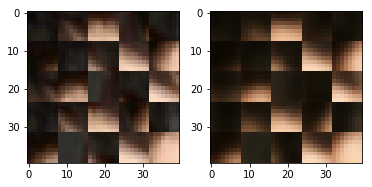

EPO: 10, recon_loss: 0.0092, total_loss: 0.0153
EPO: 10, recon_loss: 0.0046, total_loss: 0.0085
EPO: 10, recon_loss: 0.0106, total_loss: 0.0152
EPO: 10, recon_loss: 0.0031, total_loss: 0.0110
EPO: 10, recon_loss: 0.0047, total_loss: 0.0117
EPO: 10, recon_loss: 0.0085, total_loss: 0.0143
EPO: 10, recon_loss: 0.0100, total_loss: 0.0159
EPO: 10, recon_loss: 0.0101, total_loss: 0.0189
EPO: 10, recon_loss: 0.0037, total_loss: 0.0114
EPO: 10, recon_loss: 0.0031, total_loss: 0.0083
######### what? the reconstruction psnr is: 28.4914


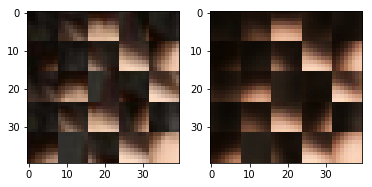

EPO: 10, recon_loss: 0.0050, total_loss: 0.0111
EPO: 10, recon_loss: 0.0045, total_loss: 0.0078
EPO: 10, recon_loss: 0.0118, total_loss: 0.0187
EPO: 10, recon_loss: 0.0064, total_loss: 0.0128
EPO: 10, recon_loss: 0.0053, total_loss: 0.0112
EPO: 10, recon_loss: 0.0064, total_loss: 0.0138
EPO: 10, recon_loss: 0.0057, total_loss: 0.0123
EPO: 10, recon_loss: 0.0061, total_loss: 0.0126
EPO: 10, recon_loss: 0.0051, total_loss: 0.0092
EPO: 10, recon_loss: 0.0046, total_loss: 0.0091
######### what? the reconstruction psnr is: 28.5821


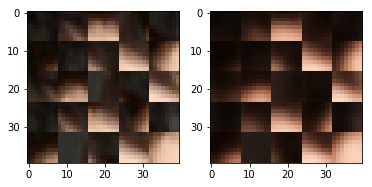

EPO: 10, recon_loss: 0.0136, total_loss: 0.0194
EPO: 10, recon_loss: 0.0035, total_loss: 0.0076
EPO: 10, recon_loss: 0.0073, total_loss: 0.0106
EPO: 10, recon_loss: 0.0109, total_loss: 0.0220
EPO: 10, recon_loss: 0.0081, total_loss: 0.0196
EPO: 10, recon_loss: 0.0116, total_loss: 0.0227
EPO: 10, recon_loss: 0.0164, total_loss: 0.0259
EPO: 10, recon_loss: 0.0104, total_loss: 0.0170
EPO: 10, recon_loss: 0.0099, total_loss: 0.0231
EPO: 10, recon_loss: 0.0040, total_loss: 0.0100
######### what? the reconstruction psnr is: 28.0131


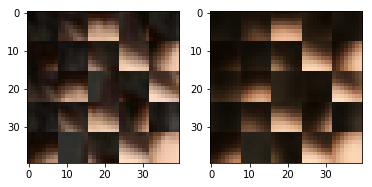

EPO: 10, recon_loss: 0.0100, total_loss: 0.0166
EPO: 10, recon_loss: 0.0052, total_loss: 0.0077
EPO: 10, recon_loss: 0.0048, total_loss: 0.0106
EPO: 10, recon_loss: 0.0026, total_loss: 0.0050
EPO: 10, recon_loss: 0.0027, total_loss: 0.0058
EPO: 10, recon_loss: 0.0067, total_loss: 0.0129
EPO: 10, recon_loss: 0.0045, total_loss: 0.0106
EPO: 10, recon_loss: 0.0059, total_loss: 0.0147
EPO: 10, recon_loss: 0.0030, total_loss: 0.0136
EPO: 10, recon_loss: 0.0029, total_loss: 0.0115
######### what? the reconstruction psnr is: 28.3440


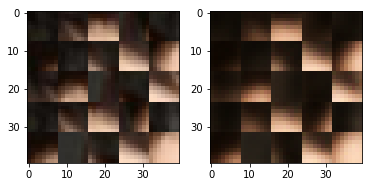

EPO: 10, recon_loss: 0.0080, total_loss: 0.0162
EPO: 10, recon_loss: 0.0022, total_loss: 0.0077
EPO: 10, recon_loss: 0.0057, total_loss: 0.0127
EPO: 10, recon_loss: 0.0095, total_loss: 0.0235
EPO: 10, recon_loss: 0.0034, total_loss: 0.0103
EPO: 10, recon_loss: 0.0147, total_loss: 0.0232
EPO: 10, recon_loss: 0.0066, total_loss: 0.0116
EPO: 10, recon_loss: 0.0055, total_loss: 0.0097
EPO: 10, recon_loss: 0.0128, total_loss: 0.0210
EPO: 10, recon_loss: 0.0051, total_loss: 0.0102
######### what? the reconstruction psnr is: 28.2652


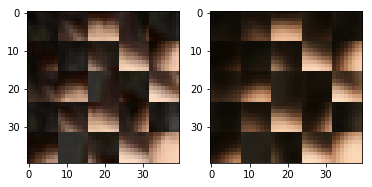

EPO: 10, recon_loss: 0.0085, total_loss: 0.0167
EPO: 10, recon_loss: 0.0067, total_loss: 0.0129
EPO: 10, recon_loss: 0.0087, total_loss: 0.0158
EPO: 10, recon_loss: 0.0201, total_loss: 0.0342
EPO: 10, recon_loss: 0.0169, total_loss: 0.0293
EPO: 10, recon_loss: 0.0153, total_loss: 0.0287
EPO: 10, recon_loss: 0.0166, total_loss: 0.0284
EPO: 10, recon_loss: 0.0104, total_loss: 0.0209
EPO: 10, recon_loss: 0.0101, total_loss: 0.0204
EPO: 10, recon_loss: 0.0059, total_loss: 0.0126
######### what? the reconstruction psnr is: 28.0083


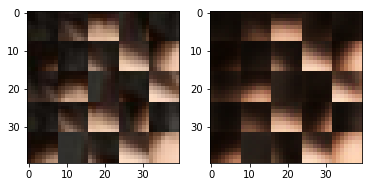

EPO: 10, recon_loss: 0.0089, total_loss: 0.0186
EPO: 10, recon_loss: 0.0121, total_loss: 0.0191
EPO: 10, recon_loss: 0.0114, total_loss: 0.0225
EPO: 10, recon_loss: 0.0155, total_loss: 0.0263
EPO: 10, recon_loss: 0.0030, total_loss: 0.0114
EPO: 10, recon_loss: 0.0103, total_loss: 0.0198
EPO: 10, recon_loss: 0.0128, total_loss: 0.0227
EPO: 10, recon_loss: 0.0050, total_loss: 0.0141
EPO: 10, recon_loss: 0.0109, total_loss: 0.0215
EPO: 10, recon_loss: 0.0091, total_loss: 0.0256
######### what? the reconstruction psnr is: 28.1930


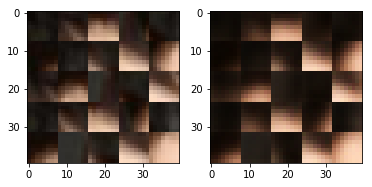

EPO: 10, recon_loss: 0.0125, total_loss: 0.0272
EPO: 10, recon_loss: 0.0233, total_loss: 0.0439
EPO: 10, recon_loss: 0.0077, total_loss: 0.0237
EPO: 10, recon_loss: 0.0142, total_loss: 0.0288
EPO: 10, recon_loss: 0.0102, total_loss: 0.0249
EPO: 10, recon_loss: 0.0125, total_loss: 0.0304
EPO: 10, recon_loss: 0.0237, total_loss: 0.0410
EPO: 10, recon_loss: 0.0205, total_loss: 0.0392
EPO: 10, recon_loss: 0.0163, total_loss: 0.0328
EPO: 10, recon_loss: 0.0044, total_loss: 0.0192
######### what? the reconstruction psnr is: 28.1608


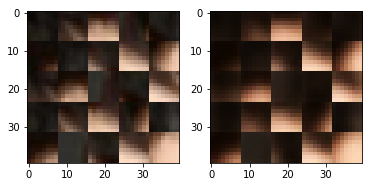

EPO: 10, recon_loss: 0.0158, total_loss: 0.0327
EPO: 10, recon_loss: 0.0303, total_loss: 0.0422
EPO: 10, recon_loss: 0.0167, total_loss: 0.0235
EPO: 10, recon_loss: 0.0070, total_loss: 0.0119
EPO: 10, recon_loss: 0.0037, total_loss: 0.0103
EPO: 10, recon_loss: 0.0047, total_loss: 0.0135
EPO: 10, recon_loss: 0.0143, total_loss: 0.0223
EPO: 10, recon_loss: 0.0058, total_loss: 0.0162
EPO: 10, recon_loss: 0.0128, total_loss: 0.0217
EPO: 10, recon_loss: 0.0014, total_loss: 0.0049
######### what? the reconstruction psnr is: 28.7609


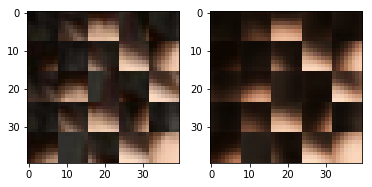

EPO: 10, recon_loss: 0.0010, total_loss: 0.0035
EPO: 10, recon_loss: 0.0037, total_loss: 0.0070
EPO: 10, recon_loss: 0.0017, total_loss: 0.0034
EPO: 10, recon_loss: 0.0032, total_loss: 0.0064
EPO: 10, recon_loss: 0.0068, total_loss: 0.0177
EPO: 10, recon_loss: 0.0042, total_loss: 0.0094
EPO: 10, recon_loss: 0.0099, total_loss: 0.0168
EPO: 10, recon_loss: 0.0048, total_loss: 0.0083
EPO: 10, recon_loss: 0.0054, total_loss: 0.0090
EPO: 10, recon_loss: 0.0102, total_loss: 0.0230
######### what? the reconstruction psnr is: 27.9266


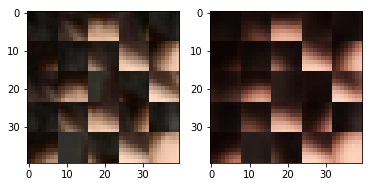

EPO: 10, recon_loss: 0.0128, total_loss: 0.0240
EPO: 10, recon_loss: 0.0128, total_loss: 0.0242
EPO: 10, recon_loss: 0.0140, total_loss: 0.0267
EPO: 10, recon_loss: 0.0060, total_loss: 0.0119
EPO: 10, recon_loss: 0.0099, total_loss: 0.0170
EPO: 10, recon_loss: 0.0055, total_loss: 0.0098
EPO: 10, recon_loss: 0.0085, total_loss: 0.0146
EPO: 10, recon_loss: 0.0048, total_loss: 0.0095
EPO: 10, recon_loss: 0.0051, total_loss: 0.0095
EPO: 10, recon_loss: 0.0055, total_loss: 0.0212
######### what? the reconstruction psnr is: 28.4905


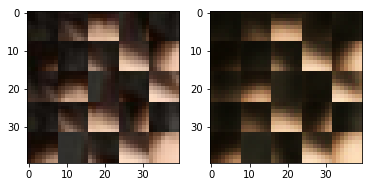

EPO: 10, recon_loss: 0.0023, total_loss: 0.0086
EPO: 10, recon_loss: 0.0099, total_loss: 0.0195
EPO: 10, recon_loss: 0.0067, total_loss: 0.0124
EPO: 10, recon_loss: 0.0076, total_loss: 0.0136
EPO: 10, recon_loss: 0.0035, total_loss: 0.0065
EPO: 10, recon_loss: 0.0023, total_loss: 0.0058
EPO: 10, recon_loss: 0.0043, total_loss: 0.0083
EPO: 10, recon_loss: 0.0036, total_loss: 0.0082
EPO: 10, recon_loss: 0.0036, total_loss: 0.0068
EPO: 10, recon_loss: 0.0060, total_loss: 0.0138
######### what? the reconstruction psnr is: 28.0853


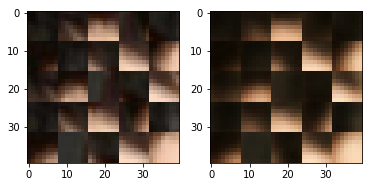

EPO: 10, recon_loss: 0.0041, total_loss: 0.0093
EPO: 10, recon_loss: 0.0093, total_loss: 0.0165
EPO: 10, recon_loss: 0.0063, total_loss: 0.0135
EPO: 10, recon_loss: 0.0052, total_loss: 0.0117
EPO: 10, recon_loss: 0.0061, total_loss: 0.0206
EPO: 10, recon_loss: 0.0061, total_loss: 0.0171
EPO: 10, recon_loss: 0.0169, total_loss: 0.0275
EPO: 10, recon_loss: 0.0124, total_loss: 0.0222
EPO: 10, recon_loss: 0.0066, total_loss: 0.0144
EPO: 10, recon_loss: 0.0219, total_loss: 0.0336
######### what? the reconstruction psnr is: 28.5125


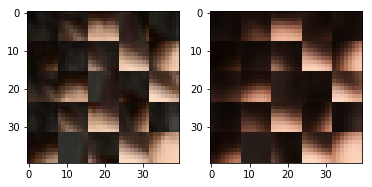

EPO: 10, recon_loss: 0.0015, total_loss: 0.0059
EPO: 10, recon_loss: 0.0044, total_loss: 0.0121
EPO: 10, recon_loss: 0.0125, total_loss: 0.0201
EPO: 10, recon_loss: 0.0069, total_loss: 0.0128
EPO: 10, recon_loss: 0.0057, total_loss: 0.0123
EPO: 10, recon_loss: 0.0080, total_loss: 0.0165
EPO: 10, recon_loss: 0.0088, total_loss: 0.0187
EPO: 10, recon_loss: 0.0105, total_loss: 0.0203
EPO: 10, recon_loss: 0.0027, total_loss: 0.0082
EPO: 10, recon_loss: 0.0120, total_loss: 0.0187
######### what? the reconstruction psnr is: 28.5505


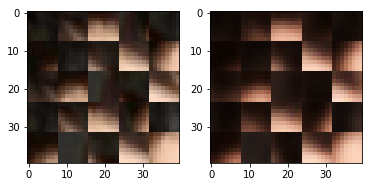

EPO: 10, recon_loss: 0.0055, total_loss: 0.0096
EPO: 10, recon_loss: 0.0116, total_loss: 0.0175
EPO: 10, recon_loss: 0.0111, total_loss: 0.0197
EPO: 10, recon_loss: 0.0055, total_loss: 0.0112
EPO: 10, recon_loss: 0.0060, total_loss: 0.0118
EPO: 10, recon_loss: 0.0097, total_loss: 0.0185
EPO: 10, recon_loss: 0.0059, total_loss: 0.0134
EPO: 10, recon_loss: 0.0153, total_loss: 0.0224
EPO: 10, recon_loss: 0.0069, total_loss: 0.0162
EPO: 10, recon_loss: 0.0096, total_loss: 0.0175
######### what? the reconstruction psnr is: 28.6515


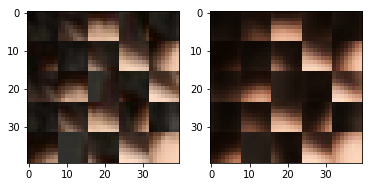

EPO: 10, recon_loss: 0.0081, total_loss: 0.0189
EPO: 10, recon_loss: 0.0018, total_loss: 0.0062
EPO: 10, recon_loss: 0.0090, total_loss: 0.0144
EPO: 10, recon_loss: 0.0052, total_loss: 0.0113
EPO: 10, recon_loss: 0.0066, total_loss: 0.0132
EPO: 10, recon_loss: 0.0059, total_loss: 0.0160
EPO: 10, recon_loss: 0.0065, total_loss: 0.0141
EPO: 10, recon_loss: 0.0157, total_loss: 0.0253
EPO: 10, recon_loss: 0.0054, total_loss: 0.0137
EPO: 10, recon_loss: 0.0124, total_loss: 0.0222
######### what? the reconstruction psnr is: 28.5056


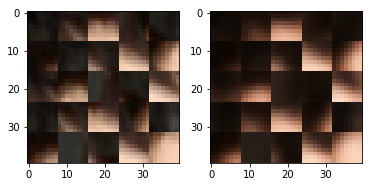

EPO: 10, recon_loss: 0.0077, total_loss: 0.0183
EPO: 10, recon_loss: 0.0028, total_loss: 0.0090
EPO: 10, recon_loss: 0.0112, total_loss: 0.0217
EPO: 10, recon_loss: 0.0045, total_loss: 0.0111
EPO: 10, recon_loss: 0.0097, total_loss: 0.0174
EPO: 10, recon_loss: 0.0041, total_loss: 0.0059
EPO: 10, recon_loss: 0.0029, total_loss: 0.0054
EPO: 10, recon_loss: 0.0065, total_loss: 0.0114
EPO: 10, recon_loss: 0.0046, total_loss: 0.0100
EPO: 10, recon_loss: 0.0052, total_loss: 0.0104
######### what? the reconstruction psnr is: 28.4558


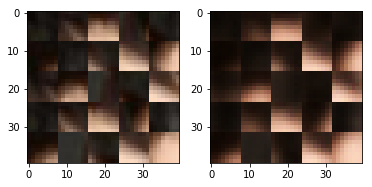

EPO: 10, recon_loss: 0.0157, total_loss: 0.0332
EPO: 10, recon_loss: 0.0115, total_loss: 0.0270
EPO: 10, recon_loss: 0.0140, total_loss: 0.0344
EPO: 10, recon_loss: 0.0097, total_loss: 0.0271
EPO: 10, recon_loss: 0.0134, total_loss: 0.0339
EPO: 10, recon_loss: 0.0041, total_loss: 0.0130
EPO: 10, recon_loss: 0.0047, total_loss: 0.0119
EPO: 10, recon_loss: 0.0129, total_loss: 0.0289
EPO: 10, recon_loss: 0.0062, total_loss: 0.0183
EPO: 10, recon_loss: 0.0061, total_loss: 0.0148
######### what? the reconstruction psnr is: 28.7985


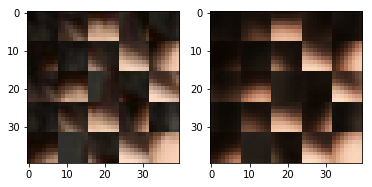

EPO: 10, recon_loss: 0.0062, total_loss: 0.0220
EPO: 10, recon_loss: 0.0064, total_loss: 0.0189
EPO: 10, recon_loss: 0.0112, total_loss: 0.0242
EPO: 10, recon_loss: 0.0059, total_loss: 0.0148
EPO: 10, recon_loss: 0.0051, total_loss: 0.0134
EPO: 10, recon_loss: 0.0074, total_loss: 0.0162
EPO: 10, recon_loss: 0.0040, total_loss: 0.0123
EPO: 10, recon_loss: 0.0142, total_loss: 0.0244
EPO: 10, recon_loss: 0.0060, total_loss: 0.0140
EPO: 10, recon_loss: 0.0040, total_loss: 0.0120
######### what? the reconstruction psnr is: 28.7636


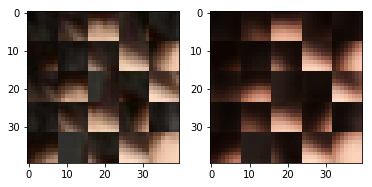

EPO: 10, recon_loss: 0.0067, total_loss: 0.0126
EPO: 10, recon_loss: 0.0033, total_loss: 0.0105
EPO: 10, recon_loss: 0.0101, total_loss: 0.0226
EPO: 10, recon_loss: 0.0105, total_loss: 0.0209
EPO: 10, recon_loss: 0.0073, total_loss: 0.0182
EPO: 10, recon_loss: 0.0134, total_loss: 0.0232
EPO: 10, recon_loss: 0.0026, total_loss: 0.0094
EPO: 10, recon_loss: 0.0088, total_loss: 0.0200
EPO: 10, recon_loss: 0.0098, total_loss: 0.0163
EPO: 10, recon_loss: 0.0083, total_loss: 0.0158
######### what? the reconstruction psnr is: 28.6397


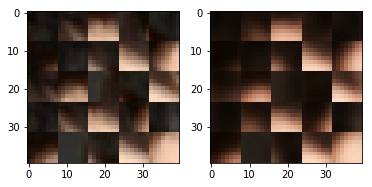

EPO: 10, recon_loss: 0.0082, total_loss: 0.0164
EPO: 10, recon_loss: 0.0030, total_loss: 0.0104
EPO: 10, recon_loss: 0.0049, total_loss: 0.0151
EPO: 10, recon_loss: 0.0041, total_loss: 0.0112
EPO: 10, recon_loss: 0.0042, total_loss: 0.0098
EPO: 10, recon_loss: 0.0043, total_loss: 0.0096
EPO: 10, recon_loss: 0.0163, total_loss: 0.0319
EPO: 10, recon_loss: 0.0117, total_loss: 0.0227
EPO: 10, recon_loss: 0.0106, total_loss: 0.0184
EPO: 10, recon_loss: 0.0113, total_loss: 0.0216
######### what? the reconstruction psnr is: 27.6753


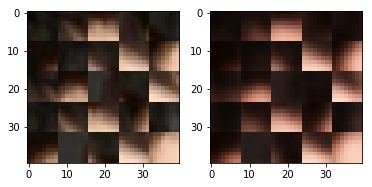

EPO: 10, recon_loss: 0.0071, total_loss: 0.0140
EPO: 10, recon_loss: 0.0080, total_loss: 0.0242
EPO: 10, recon_loss: 0.0046, total_loss: 0.0150
EPO: 10, recon_loss: 0.0119, total_loss: 0.0220
EPO: 10, recon_loss: 0.0053, total_loss: 0.0133
EPO: 10, recon_loss: 0.0115, total_loss: 0.0201
EPO: 10, recon_loss: 0.0027, total_loss: 0.0054
EPO: 10, recon_loss: 0.0018, total_loss: 0.0038
EPO: 10, recon_loss: 0.0078, total_loss: 0.0123
EPO: 10, recon_loss: 0.0023, total_loss: 0.0051
######### what? the reconstruction psnr is: 28.4960


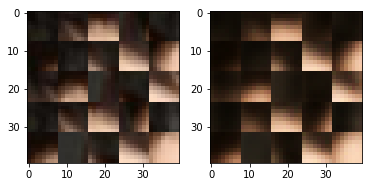

EPO: 10, recon_loss: 0.0047, total_loss: 0.0084
EPO: 10, recon_loss: 0.0073, total_loss: 0.0147
EPO: 10, recon_loss: 0.0058, total_loss: 0.0134
EPO: 10, recon_loss: 0.0075, total_loss: 0.0143
EPO: 10, recon_loss: 0.0038, total_loss: 0.0091
EPO: 10, recon_loss: 0.0050, total_loss: 0.0097
EPO: 10, recon_loss: 0.0090, total_loss: 0.0187
EPO: 10, recon_loss: 0.0086, total_loss: 0.0175
EPO: 10, recon_loss: 0.0138, total_loss: 0.0196
EPO: 10, recon_loss: 0.0099, total_loss: 0.0160
######### what? the reconstruction psnr is: 28.0997


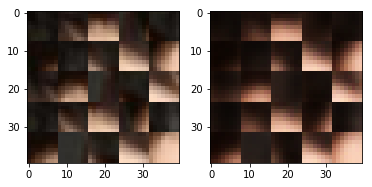

EPO: 10, recon_loss: 0.0094, total_loss: 0.0150
EPO: 10, recon_loss: 0.0126, total_loss: 0.0268
EPO: 10, recon_loss: 0.0247, total_loss: 0.0403
EPO: 10, recon_loss: 0.0120, total_loss: 0.0186
EPO: 10, recon_loss: 0.0067, total_loss: 0.0133
EPO: 10, recon_loss: 0.0072, total_loss: 0.0137
EPO: 10, recon_loss: 0.0037, total_loss: 0.0111
EPO: 10, recon_loss: 0.0024, total_loss: 0.0089
EPO: 10, recon_loss: 0.0075, total_loss: 0.0128
EPO: 10, recon_loss: 0.0042, total_loss: 0.0117
######### what? the reconstruction psnr is: 27.6963


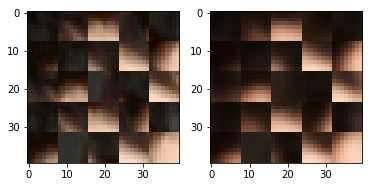

EPO: 10, recon_loss: 0.0059, total_loss: 0.0107
EPO: 10, recon_loss: 0.0052, total_loss: 0.0221
EPO: 10, recon_loss: 0.0022, total_loss: 0.0091
EPO: 10, recon_loss: 0.0051, total_loss: 0.0126
EPO: 10, recon_loss: 0.0022, total_loss: 0.0058
EPO: 10, recon_loss: 0.0018, total_loss: 0.0039
EPO: 10, recon_loss: 0.0074, total_loss: 0.0172
EPO: 10, recon_loss: 0.0082, total_loss: 0.0165
EPO: 10, recon_loss: 0.0080, total_loss: 0.0171
EPO: 10, recon_loss: 0.0100, total_loss: 0.0183
######### what? the reconstruction psnr is: 28.6443


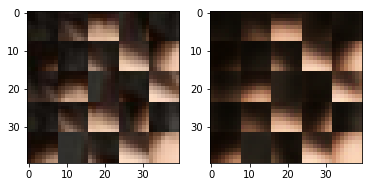

EPO: 10, recon_loss: 0.0082, total_loss: 0.0160
EPO: 11, recon_loss: 0.0052, total_loss: 0.0110
EPO: 11, recon_loss: 0.0029, total_loss: 0.0057
EPO: 11, recon_loss: 0.0088, total_loss: 0.0124
EPO: 11, recon_loss: 0.0056, total_loss: 0.0108
EPO: 11, recon_loss: 0.0039, total_loss: 0.0074
EPO: 11, recon_loss: 0.0061, total_loss: 0.0204
EPO: 11, recon_loss: 0.0024, total_loss: 0.0090
EPO: 11, recon_loss: 0.0055, total_loss: 0.0122
EPO: 11, recon_loss: 0.0075, total_loss: 0.0132
######### what? the reconstruction psnr is: 28.8321


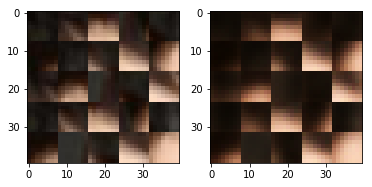

EPO: 11, recon_loss: 0.0072, total_loss: 0.0131
EPO: 11, recon_loss: 0.0081, total_loss: 0.0173
EPO: 11, recon_loss: 0.0033, total_loss: 0.0101
EPO: 11, recon_loss: 0.0047, total_loss: 0.0126
EPO: 11, recon_loss: 0.0039, total_loss: 0.0086
EPO: 11, recon_loss: 0.0054, total_loss: 0.0097
EPO: 11, recon_loss: 0.0139, total_loss: 0.0214
EPO: 11, recon_loss: 0.0056, total_loss: 0.0113
EPO: 11, recon_loss: 0.0058, total_loss: 0.0137
EPO: 11, recon_loss: 0.0064, total_loss: 0.0135
######### what? the reconstruction psnr is: 28.6906


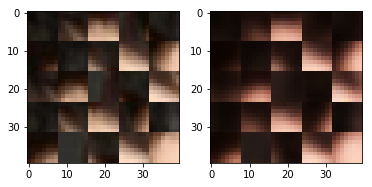

EPO: 11, recon_loss: 0.0052, total_loss: 0.0108
EPO: 11, recon_loss: 0.0053, total_loss: 0.0118
EPO: 11, recon_loss: 0.0051, total_loss: 0.0092
EPO: 11, recon_loss: 0.0056, total_loss: 0.0106
EPO: 11, recon_loss: 0.0118, total_loss: 0.0175
EPO: 11, recon_loss: 0.0033, total_loss: 0.0076
EPO: 11, recon_loss: 0.0078, total_loss: 0.0112
EPO: 11, recon_loss: 0.0130, total_loss: 0.0261
EPO: 11, recon_loss: 0.0057, total_loss: 0.0147
EPO: 11, recon_loss: 0.0123, total_loss: 0.0218
######### what? the reconstruction psnr is: 28.2463


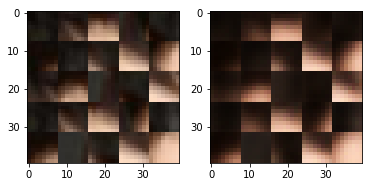

EPO: 11, recon_loss: 0.0107, total_loss: 0.0186
EPO: 11, recon_loss: 0.0170, total_loss: 0.0245
EPO: 11, recon_loss: 0.0090, total_loss: 0.0204
EPO: 11, recon_loss: 0.0042, total_loss: 0.0106
EPO: 11, recon_loss: 0.0088, total_loss: 0.0152
EPO: 11, recon_loss: 0.0066, total_loss: 0.0097
EPO: 11, recon_loss: 0.0061, total_loss: 0.0111
EPO: 11, recon_loss: 0.0022, total_loss: 0.0043
EPO: 11, recon_loss: 0.0027, total_loss: 0.0061
EPO: 11, recon_loss: 0.0081, total_loss: 0.0147
######### what? the reconstruction psnr is: 28.3516


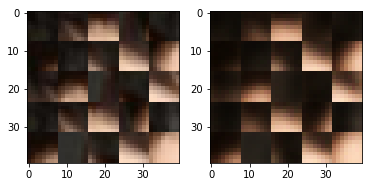

EPO: 11, recon_loss: 0.0040, total_loss: 0.0097
EPO: 11, recon_loss: 0.0059, total_loss: 0.0148
EPO: 11, recon_loss: 0.0027, total_loss: 0.0122
EPO: 11, recon_loss: 0.0032, total_loss: 0.0123
EPO: 11, recon_loss: 0.0083, total_loss: 0.0162
EPO: 11, recon_loss: 0.0019, total_loss: 0.0073
EPO: 11, recon_loss: 0.0067, total_loss: 0.0137
EPO: 11, recon_loss: 0.0128, total_loss: 0.0299
EPO: 11, recon_loss: 0.0033, total_loss: 0.0100
EPO: 11, recon_loss: 0.0186, total_loss: 0.0257
######### what? the reconstruction psnr is: 28.9030


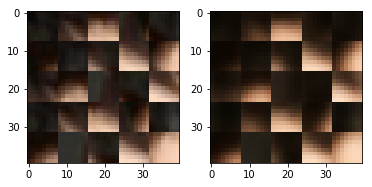

EPO: 11, recon_loss: 0.0044, total_loss: 0.0091
EPO: 11, recon_loss: 0.0049, total_loss: 0.0087
EPO: 11, recon_loss: 0.0097, total_loss: 0.0174
EPO: 11, recon_loss: 0.0044, total_loss: 0.0095
EPO: 11, recon_loss: 0.0095, total_loss: 0.0165
EPO: 11, recon_loss: 0.0054, total_loss: 0.0098
EPO: 11, recon_loss: 0.0087, total_loss: 0.0150
EPO: 11, recon_loss: 0.0220, total_loss: 0.0349
EPO: 11, recon_loss: 0.0111, total_loss: 0.0225
EPO: 11, recon_loss: 0.0213, total_loss: 0.0341
######### what? the reconstruction psnr is: 28.6420


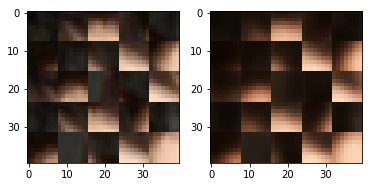

EPO: 11, recon_loss: 0.0125, total_loss: 0.0236
EPO: 11, recon_loss: 0.0108, total_loss: 0.0220
EPO: 11, recon_loss: 0.0048, total_loss: 0.0145
EPO: 11, recon_loss: 0.0054, total_loss: 0.0118
EPO: 11, recon_loss: 0.0079, total_loss: 0.0179
EPO: 11, recon_loss: 0.0081, total_loss: 0.0143
EPO: 11, recon_loss: 0.0089, total_loss: 0.0198
EPO: 11, recon_loss: 0.0060, total_loss: 0.0194
EPO: 11, recon_loss: 0.0026, total_loss: 0.0109
EPO: 11, recon_loss: 0.0125, total_loss: 0.0212
######### what? the reconstruction psnr is: 28.3086


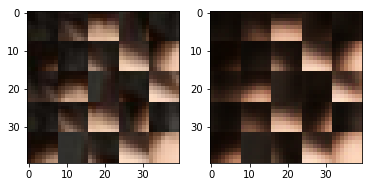

EPO: 11, recon_loss: 0.0064, total_loss: 0.0143
EPO: 11, recon_loss: 0.0056, total_loss: 0.0144
EPO: 11, recon_loss: 0.0109, total_loss: 0.0256
EPO: 11, recon_loss: 0.0081, total_loss: 0.0240
EPO: 11, recon_loss: 0.0186, total_loss: 0.0361
EPO: 11, recon_loss: 0.0168, total_loss: 0.0340
EPO: 11, recon_loss: 0.0078, total_loss: 0.0228
EPO: 11, recon_loss: 0.0256, total_loss: 0.0437
EPO: 11, recon_loss: 0.0087, total_loss: 0.0238
EPO: 11, recon_loss: 0.0151, total_loss: 0.0318
######### what? the reconstruction psnr is: 28.8008


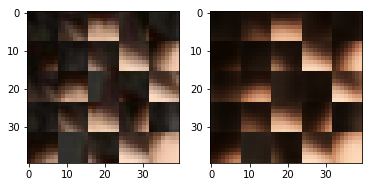

EPO: 11, recon_loss: 0.0201, total_loss: 0.0368
EPO: 11, recon_loss: 0.0141, total_loss: 0.0312
EPO: 11, recon_loss: 0.0155, total_loss: 0.0302
EPO: 11, recon_loss: 0.0040, total_loss: 0.0179
EPO: 11, recon_loss: 0.0203, total_loss: 0.0347
EPO: 11, recon_loss: 0.0210, total_loss: 0.0301
EPO: 11, recon_loss: 0.0067, total_loss: 0.0120
EPO: 11, recon_loss: 0.0058, total_loss: 0.0107
EPO: 11, recon_loss: 0.0030, total_loss: 0.0095
EPO: 11, recon_loss: 0.0051, total_loss: 0.0146
######### what? the reconstruction psnr is: 28.9721


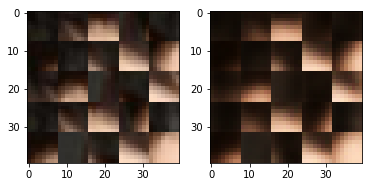

EPO: 11, recon_loss: 0.0092, total_loss: 0.0182
EPO: 11, recon_loss: 0.0063, total_loss: 0.0163
EPO: 11, recon_loss: 0.0116, total_loss: 0.0224
EPO: 11, recon_loss: 0.0009, total_loss: 0.0038
EPO: 11, recon_loss: 0.0012, total_loss: 0.0042
EPO: 11, recon_loss: 0.0033, total_loss: 0.0061
EPO: 11, recon_loss: 0.0016, total_loss: 0.0035
EPO: 11, recon_loss: 0.0044, total_loss: 0.0080
EPO: 11, recon_loss: 0.0048, total_loss: 0.0119
EPO: 11, recon_loss: 0.0059, total_loss: 0.0118
######### what? the reconstruction psnr is: 28.6237


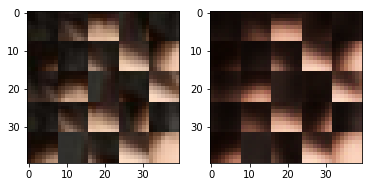

EPO: 11, recon_loss: 0.0106, total_loss: 0.0179
EPO: 11, recon_loss: 0.0045, total_loss: 0.0079
EPO: 11, recon_loss: 0.0068, total_loss: 0.0104
EPO: 11, recon_loss: 0.0099, total_loss: 0.0224
EPO: 11, recon_loss: 0.0167, total_loss: 0.0310
EPO: 11, recon_loss: 0.0122, total_loss: 0.0256
EPO: 11, recon_loss: 0.0084, total_loss: 0.0177
EPO: 11, recon_loss: 0.0089, total_loss: 0.0158
EPO: 11, recon_loss: 0.0071, total_loss: 0.0139
EPO: 11, recon_loss: 0.0057, total_loss: 0.0100
######### what? the reconstruction psnr is: 28.1120


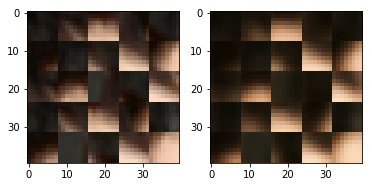

EPO: 11, recon_loss: 0.0078, total_loss: 0.0144
EPO: 11, recon_loss: 0.0038, total_loss: 0.0075
EPO: 11, recon_loss: 0.0051, total_loss: 0.0101
EPO: 11, recon_loss: 0.0054, total_loss: 0.0205
EPO: 11, recon_loss: 0.0018, total_loss: 0.0078
EPO: 11, recon_loss: 0.0126, total_loss: 0.0215
EPO: 11, recon_loss: 0.0073, total_loss: 0.0132
EPO: 11, recon_loss: 0.0073, total_loss: 0.0145
EPO: 11, recon_loss: 0.0030, total_loss: 0.0059
EPO: 11, recon_loss: 0.0023, total_loss: 0.0056
######### what? the reconstruction psnr is: 28.2436


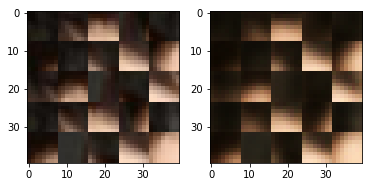

EPO: 11, recon_loss: 0.0051, total_loss: 0.0099
EPO: 11, recon_loss: 0.0019, total_loss: 0.0056
EPO: 11, recon_loss: 0.0026, total_loss: 0.0056
EPO: 11, recon_loss: 0.0054, total_loss: 0.0127
EPO: 11, recon_loss: 0.0037, total_loss: 0.0091
EPO: 11, recon_loss: 0.0123, total_loss: 0.0195
EPO: 11, recon_loss: 0.0053, total_loss: 0.0123
EPO: 11, recon_loss: 0.0041, total_loss: 0.0097
EPO: 11, recon_loss: 0.0052, total_loss: 0.0191
EPO: 11, recon_loss: 0.0053, total_loss: 0.0151
######### what? the reconstruction psnr is: 28.5913


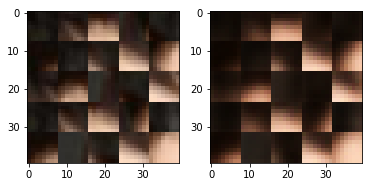

EPO: 11, recon_loss: 0.0191, total_loss: 0.0296
EPO: 11, recon_loss: 0.0070, total_loss: 0.0147
EPO: 11, recon_loss: 0.0097, total_loss: 0.0186
EPO: 11, recon_loss: 0.0034, total_loss: 0.0120
EPO: 11, recon_loss: 0.0009, total_loss: 0.0048
EPO: 11, recon_loss: 0.0069, total_loss: 0.0144
EPO: 11, recon_loss: 0.0082, total_loss: 0.0133
EPO: 11, recon_loss: 0.0072, total_loss: 0.0144
EPO: 11, recon_loss: 0.0070, total_loss: 0.0161
EPO: 11, recon_loss: 0.0108, total_loss: 0.0191
######### what? the reconstruction psnr is: 28.7460


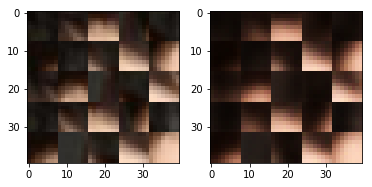

EPO: 11, recon_loss: 0.0086, total_loss: 0.0182
EPO: 11, recon_loss: 0.0081, total_loss: 0.0164
EPO: 11, recon_loss: 0.0027, total_loss: 0.0078
EPO: 11, recon_loss: 0.0112, total_loss: 0.0198
EPO: 11, recon_loss: 0.0046, total_loss: 0.0087
EPO: 11, recon_loss: 0.0107, total_loss: 0.0179
EPO: 11, recon_loss: 0.0108, total_loss: 0.0187
EPO: 11, recon_loss: 0.0053, total_loss: 0.0107
EPO: 11, recon_loss: 0.0052, total_loss: 0.0110
EPO: 11, recon_loss: 0.0072, total_loss: 0.0144
######### what? the reconstruction psnr is: 28.7426


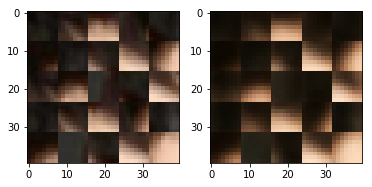

EPO: 11, recon_loss: 0.0062, total_loss: 0.0139
EPO: 11, recon_loss: 0.0118, total_loss: 0.0188
EPO: 11, recon_loss: 0.0072, total_loss: 0.0167
EPO: 11, recon_loss: 0.0112, total_loss: 0.0186
EPO: 11, recon_loss: 0.0060, total_loss: 0.0132
EPO: 11, recon_loss: 0.0026, total_loss: 0.0069
EPO: 11, recon_loss: 0.0059, total_loss: 0.0111
EPO: 11, recon_loss: 0.0053, total_loss: 0.0116
EPO: 11, recon_loss: 0.0084, total_loss: 0.0168
EPO: 11, recon_loss: 0.0058, total_loss: 0.0140
######### what? the reconstruction psnr is: 28.5089


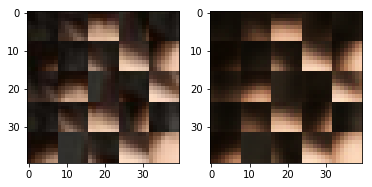

EPO: 11, recon_loss: 0.0070, total_loss: 0.0150
EPO: 11, recon_loss: 0.0178, total_loss: 0.0283
EPO: 11, recon_loss: 0.0053, total_loss: 0.0140
EPO: 11, recon_loss: 0.0147, total_loss: 0.0268
EPO: 11, recon_loss: 0.0042, total_loss: 0.0113
EPO: 11, recon_loss: 0.0028, total_loss: 0.0092
EPO: 11, recon_loss: 0.0114, total_loss: 0.0227
EPO: 11, recon_loss: 0.0054, total_loss: 0.0127
EPO: 11, recon_loss: 0.0129, total_loss: 0.0211
EPO: 11, recon_loss: 0.0038, total_loss: 0.0056
######### what? the reconstruction psnr is: 28.7379


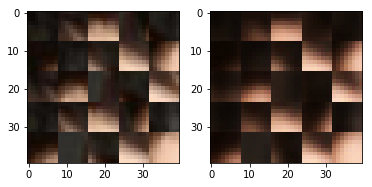

EPO: 11, recon_loss: 0.0026, total_loss: 0.0051
EPO: 11, recon_loss: 0.0073, total_loss: 0.0124
EPO: 11, recon_loss: 0.0030, total_loss: 0.0085
EPO: 11, recon_loss: 0.0065, total_loss: 0.0132
EPO: 11, recon_loss: 0.0147, total_loss: 0.0323
EPO: 11, recon_loss: 0.0112, total_loss: 0.0262
EPO: 11, recon_loss: 0.0174, total_loss: 0.0381
EPO: 11, recon_loss: 0.0088, total_loss: 0.0241
EPO: 11, recon_loss: 0.0162, total_loss: 0.0364
EPO: 11, recon_loss: 0.0037, total_loss: 0.0126
######### what? the reconstruction psnr is: 28.8982


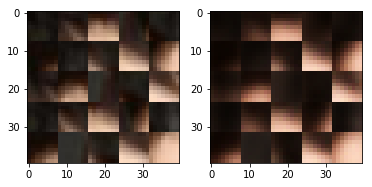

EPO: 11, recon_loss: 0.0075, total_loss: 0.0142
EPO: 11, recon_loss: 0.0105, total_loss: 0.0260
EPO: 11, recon_loss: 0.0060, total_loss: 0.0164
EPO: 11, recon_loss: 0.0060, total_loss: 0.0147
EPO: 11, recon_loss: 0.0061, total_loss: 0.0210
EPO: 11, recon_loss: 0.0065, total_loss: 0.0189
EPO: 11, recon_loss: 0.0160, total_loss: 0.0283
EPO: 11, recon_loss: 0.0037, total_loss: 0.0121
EPO: 11, recon_loss: 0.0036, total_loss: 0.0112
EPO: 11, recon_loss: 0.0075, total_loss: 0.0176
######### what? the reconstruction psnr is: 28.8562


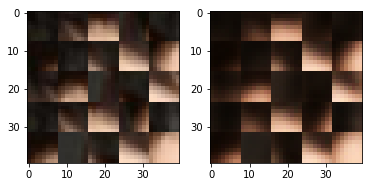

EPO: 11, recon_loss: 0.0029, total_loss: 0.0112
EPO: 11, recon_loss: 0.0153, total_loss: 0.0250
EPO: 11, recon_loss: 0.0035, total_loss: 0.0114
EPO: 11, recon_loss: 0.0046, total_loss: 0.0121
EPO: 11, recon_loss: 0.0062, total_loss: 0.0118
EPO: 11, recon_loss: 0.0032, total_loss: 0.0112
EPO: 11, recon_loss: 0.0146, total_loss: 0.0251
EPO: 11, recon_loss: 0.0081, total_loss: 0.0189
EPO: 11, recon_loss: 0.0064, total_loss: 0.0149
EPO: 11, recon_loss: 0.0076, total_loss: 0.0249
######### what? the reconstruction psnr is: 29.2311


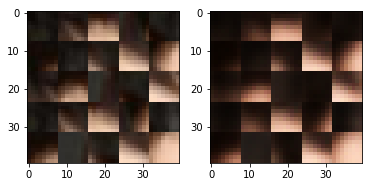

EPO: 11, recon_loss: 0.0023, total_loss: 0.0093
EPO: 11, recon_loss: 0.0121, total_loss: 0.0256
EPO: 11, recon_loss: 0.0067, total_loss: 0.0114
EPO: 11, recon_loss: 0.0070, total_loss: 0.0140
EPO: 11, recon_loss: 0.0052, total_loss: 0.0158
EPO: 11, recon_loss: 0.0027, total_loss: 0.0100
EPO: 11, recon_loss: 0.0068, total_loss: 0.0162
EPO: 11, recon_loss: 0.0031, total_loss: 0.0092
EPO: 11, recon_loss: 0.0053, total_loss: 0.0109
EPO: 11, recon_loss: 0.0118, total_loss: 0.0235
######### what? the reconstruction psnr is: 28.6152


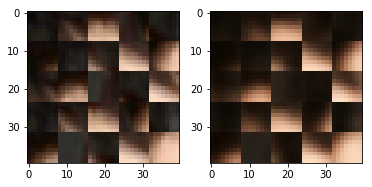

EPO: 11, recon_loss: 0.0169, total_loss: 0.0316
EPO: 11, recon_loss: 0.0101, total_loss: 0.0198
EPO: 11, recon_loss: 0.0098, total_loss: 0.0195
EPO: 11, recon_loss: 0.0111, total_loss: 0.0211
EPO: 11, recon_loss: 0.0056, total_loss: 0.0107
EPO: 11, recon_loss: 0.0060, total_loss: 0.0194
EPO: 11, recon_loss: 0.0066, total_loss: 0.0166
EPO: 11, recon_loss: 0.0092, total_loss: 0.0195
EPO: 11, recon_loss: 0.0069, total_loss: 0.0154
EPO: 11, recon_loss: 0.0125, total_loss: 0.0223
######### what? the reconstruction psnr is: 28.2716


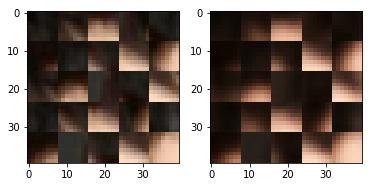

EPO: 11, recon_loss: 0.0020, total_loss: 0.0040
EPO: 11, recon_loss: 0.0033, total_loss: 0.0070
EPO: 11, recon_loss: 0.0049, total_loss: 0.0083
EPO: 11, recon_loss: 0.0021, total_loss: 0.0047
EPO: 11, recon_loss: 0.0050, total_loss: 0.0093
EPO: 11, recon_loss: 0.0078, total_loss: 0.0164
EPO: 11, recon_loss: 0.0057, total_loss: 0.0129
EPO: 11, recon_loss: 0.0067, total_loss: 0.0140
EPO: 11, recon_loss: 0.0046, total_loss: 0.0095
EPO: 11, recon_loss: 0.0069, total_loss: 0.0120
######### what? the reconstruction psnr is: 28.4426


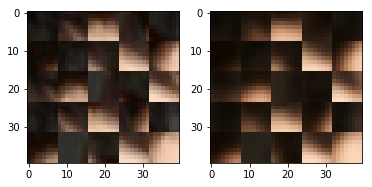

EPO: 11, recon_loss: 0.0079, total_loss: 0.0164
EPO: 11, recon_loss: 0.0075, total_loss: 0.0162
EPO: 11, recon_loss: 0.0143, total_loss: 0.0201
EPO: 11, recon_loss: 0.0078, total_loss: 0.0141
EPO: 11, recon_loss: 0.0110, total_loss: 0.0172
EPO: 11, recon_loss: 0.0165, total_loss: 0.0317
EPO: 11, recon_loss: 0.0162, total_loss: 0.0256
EPO: 11, recon_loss: 0.0110, total_loss: 0.0179
EPO: 11, recon_loss: 0.0063, total_loss: 0.0117
EPO: 11, recon_loss: 0.0086, total_loss: 0.0146
######### what? the reconstruction psnr is: 27.6320


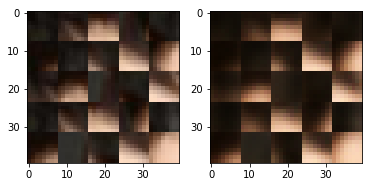

EPO: 11, recon_loss: 0.0024, total_loss: 0.0084
EPO: 11, recon_loss: 0.0033, total_loss: 0.0099
EPO: 11, recon_loss: 0.0088, total_loss: 0.0134
EPO: 11, recon_loss: 0.0055, total_loss: 0.0137
EPO: 11, recon_loss: 0.0091, total_loss: 0.0148
EPO: 11, recon_loss: 0.0047, total_loss: 0.0195
EPO: 11, recon_loss: 0.0021, total_loss: 0.0088
EPO: 11, recon_loss: 0.0074, total_loss: 0.0144
EPO: 11, recon_loss: 0.0014, total_loss: 0.0041
EPO: 11, recon_loss: 0.0022, total_loss: 0.0043
######### what? the reconstruction psnr is: 28.3622


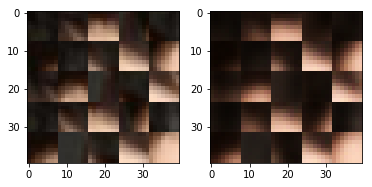

EPO: 11, recon_loss: 0.0082, total_loss: 0.0169
EPO: 11, recon_loss: 0.0076, total_loss: 0.0163
EPO: 11, recon_loss: 0.0072, total_loss: 0.0159
EPO: 11, recon_loss: 0.0083, total_loss: 0.0165
EPO: 11, recon_loss: 0.0085, total_loss: 0.0145
EPO: 12, recon_loss: 0.0041, total_loss: 0.0085
EPO: 12, recon_loss: 0.0027, total_loss: 0.0055
EPO: 12, recon_loss: 0.0108, total_loss: 0.0146
EPO: 12, recon_loss: 0.0032, total_loss: 0.0068
EPO: 12, recon_loss: 0.0033, total_loss: 0.0064
######### what? the reconstruction psnr is: 28.8663


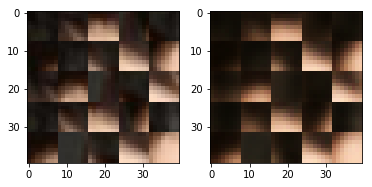

EPO: 12, recon_loss: 0.0043, total_loss: 0.0150
EPO: 12, recon_loss: 0.0024, total_loss: 0.0088
EPO: 12, recon_loss: 0.0044, total_loss: 0.0109
EPO: 12, recon_loss: 0.0037, total_loss: 0.0074
EPO: 12, recon_loss: 0.0078, total_loss: 0.0141
EPO: 12, recon_loss: 0.0036, total_loss: 0.0139
EPO: 12, recon_loss: 0.0028, total_loss: 0.0086
EPO: 12, recon_loss: 0.0045, total_loss: 0.0117
EPO: 12, recon_loss: 0.0035, total_loss: 0.0072
EPO: 12, recon_loss: 0.0053, total_loss: 0.0105
######### what? the reconstruction psnr is: 28.9697


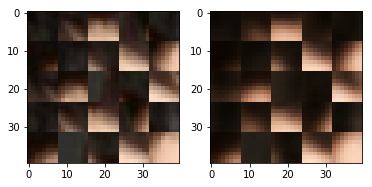

EPO: 12, recon_loss: 0.0060, total_loss: 0.0124
EPO: 12, recon_loss: 0.0060, total_loss: 0.0129
EPO: 12, recon_loss: 0.0051, total_loss: 0.0115
EPO: 12, recon_loss: 0.0052, total_loss: 0.0115
EPO: 12, recon_loss: 0.0042, total_loss: 0.0088
EPO: 12, recon_loss: 0.0061, total_loss: 0.0104
EPO: 12, recon_loss: 0.0038, total_loss: 0.0081
EPO: 12, recon_loss: 0.0061, total_loss: 0.0117
EPO: 12, recon_loss: 0.0096, total_loss: 0.0154
EPO: 12, recon_loss: 0.0033, total_loss: 0.0068
######### what? the reconstruction psnr is: 28.9054


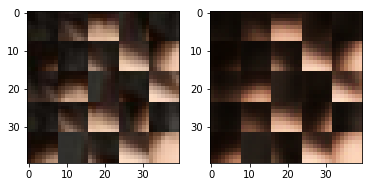

EPO: 12, recon_loss: 0.0077, total_loss: 0.0139
EPO: 12, recon_loss: 0.0062, total_loss: 0.0148
EPO: 12, recon_loss: 0.0062, total_loss: 0.0148
EPO: 12, recon_loss: 0.0116, total_loss: 0.0207
EPO: 12, recon_loss: 0.0117, total_loss: 0.0218
EPO: 12, recon_loss: 0.0114, total_loss: 0.0179
EPO: 12, recon_loss: 0.0068, total_loss: 0.0151
EPO: 12, recon_loss: 0.0051, total_loss: 0.0130
EPO: 12, recon_loss: 0.0077, total_loss: 0.0130
EPO: 12, recon_loss: 0.0059, total_loss: 0.0092
######### what? the reconstruction psnr is: 28.1563


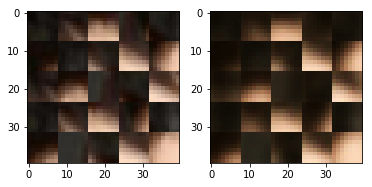

EPO: 12, recon_loss: 0.0070, total_loss: 0.0134
EPO: 12, recon_loss: 0.0020, total_loss: 0.0040
EPO: 12, recon_loss: 0.0039, total_loss: 0.0091
EPO: 12, recon_loss: 0.0066, total_loss: 0.0120
EPO: 12, recon_loss: 0.0047, total_loss: 0.0104
EPO: 12, recon_loss: 0.0077, total_loss: 0.0164
EPO: 12, recon_loss: 0.0026, total_loss: 0.0117
EPO: 12, recon_loss: 0.0026, total_loss: 0.0110
EPO: 12, recon_loss: 0.0082, total_loss: 0.0152
EPO: 12, recon_loss: 0.0020, total_loss: 0.0074
######### what? the reconstruction psnr is: 28.7948


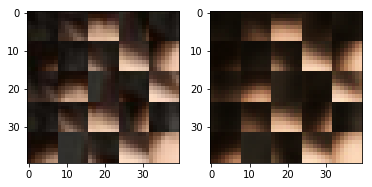

EPO: 12, recon_loss: 0.0083, total_loss: 0.0157
EPO: 12, recon_loss: 0.0117, total_loss: 0.0289
EPO: 12, recon_loss: 0.0042, total_loss: 0.0112
EPO: 12, recon_loss: 0.0123, total_loss: 0.0192
EPO: 12, recon_loss: 0.0036, total_loss: 0.0075
EPO: 12, recon_loss: 0.0067, total_loss: 0.0108
EPO: 12, recon_loss: 0.0085, total_loss: 0.0165
EPO: 12, recon_loss: 0.0035, total_loss: 0.0083
EPO: 12, recon_loss: 0.0083, total_loss: 0.0156
EPO: 12, recon_loss: 0.0053, total_loss: 0.0095
######### what? the reconstruction psnr is: 28.8170


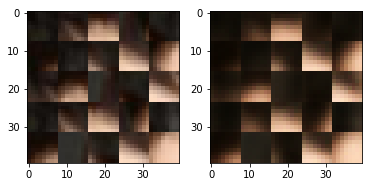

EPO: 12, recon_loss: 0.0096, total_loss: 0.0175
EPO: 12, recon_loss: 0.0129, total_loss: 0.0236
EPO: 12, recon_loss: 0.0124, total_loss: 0.0239
EPO: 12, recon_loss: 0.0258, total_loss: 0.0383
EPO: 12, recon_loss: 0.0144, total_loss: 0.0259
EPO: 12, recon_loss: 0.0105, total_loss: 0.0207
EPO: 12, recon_loss: 0.0043, total_loss: 0.0130
EPO: 12, recon_loss: 0.0054, total_loss: 0.0125
EPO: 12, recon_loss: 0.0089, total_loss: 0.0166
EPO: 12, recon_loss: 0.0060, total_loss: 0.0123
######### what? the reconstruction psnr is: 28.4907


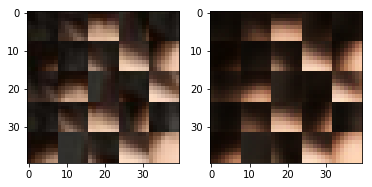

EPO: 12, recon_loss: 0.0086, total_loss: 0.0180
EPO: 12, recon_loss: 0.0048, total_loss: 0.0152
EPO: 12, recon_loss: 0.0025, total_loss: 0.0104
EPO: 12, recon_loss: 0.0123, total_loss: 0.0195
EPO: 12, recon_loss: 0.0045, total_loss: 0.0130
EPO: 12, recon_loss: 0.0054, total_loss: 0.0128
EPO: 12, recon_loss: 0.0108, total_loss: 0.0253
EPO: 12, recon_loss: 0.0084, total_loss: 0.0264
EPO: 12, recon_loss: 0.0200, total_loss: 0.0361
EPO: 12, recon_loss: 0.0099, total_loss: 0.0253
######### what? the reconstruction psnr is: 28.9733


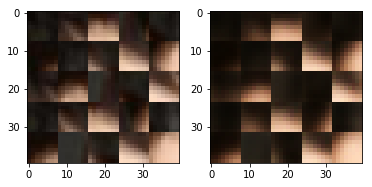

EPO: 12, recon_loss: 0.0082, total_loss: 0.0223
EPO: 12, recon_loss: 0.0150, total_loss: 0.0291
EPO: 12, recon_loss: 0.0085, total_loss: 0.0234
EPO: 12, recon_loss: 0.0224, total_loss: 0.0403
EPO: 12, recon_loss: 0.0145, total_loss: 0.0305
EPO: 12, recon_loss: 0.0136, total_loss: 0.0304
EPO: 12, recon_loss: 0.0055, total_loss: 0.0196
EPO: 12, recon_loss: 0.0054, total_loss: 0.0201
EPO: 12, recon_loss: 0.0225, total_loss: 0.0354
EPO: 12, recon_loss: 0.0231, total_loss: 0.0307
######### what? the reconstruction psnr is: 28.4527


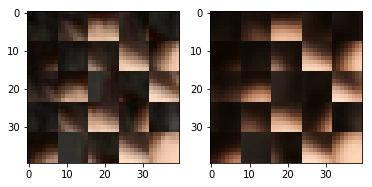

EPO: 12, recon_loss: 0.0045, total_loss: 0.0089
EPO: 12, recon_loss: 0.0056, total_loss: 0.0108
EPO: 12, recon_loss: 0.0032, total_loss: 0.0108
EPO: 12, recon_loss: 0.0074, total_loss: 0.0159
EPO: 12, recon_loss: 0.0073, total_loss: 0.0160
EPO: 12, recon_loss: 0.0065, total_loss: 0.0176
EPO: 12, recon_loss: 0.0144, total_loss: 0.0258
EPO: 12, recon_loss: 0.0009, total_loss: 0.0036
EPO: 12, recon_loss: 0.0014, total_loss: 0.0045
EPO: 12, recon_loss: 0.0025, total_loss: 0.0045
######### what? the reconstruction psnr is: 29.0883


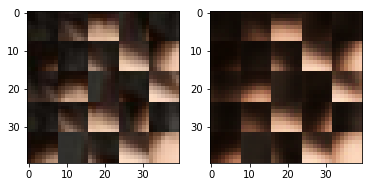

EPO: 12, recon_loss: 0.0017, total_loss: 0.0036
EPO: 12, recon_loss: 0.0053, total_loss: 0.0091
EPO: 12, recon_loss: 0.0043, total_loss: 0.0102
EPO: 12, recon_loss: 0.0063, total_loss: 0.0130
EPO: 12, recon_loss: 0.0102, total_loss: 0.0168
EPO: 12, recon_loss: 0.0043, total_loss: 0.0076
EPO: 12, recon_loss: 0.0106, total_loss: 0.0150
EPO: 12, recon_loss: 0.0095, total_loss: 0.0219
EPO: 12, recon_loss: 0.0141, total_loss: 0.0267
EPO: 12, recon_loss: 0.0112, total_loss: 0.0238
######### what? the reconstruction psnr is: 28.3137


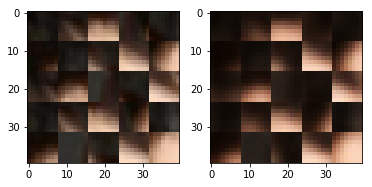

EPO: 12, recon_loss: 0.0075, total_loss: 0.0157
EPO: 12, recon_loss: 0.0104, total_loss: 0.0176
EPO: 12, recon_loss: 0.0072, total_loss: 0.0138
EPO: 12, recon_loss: 0.0056, total_loss: 0.0099
EPO: 12, recon_loss: 0.0076, total_loss: 0.0140
EPO: 12, recon_loss: 0.0053, total_loss: 0.0099
EPO: 12, recon_loss: 0.0068, total_loss: 0.0128
EPO: 12, recon_loss: 0.0050, total_loss: 0.0178
EPO: 12, recon_loss: 0.0028, total_loss: 0.0078
EPO: 12, recon_loss: 0.0096, total_loss: 0.0171
######### what? the reconstruction psnr is: 28.6112


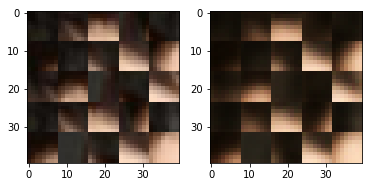

EPO: 12, recon_loss: 0.0074, total_loss: 0.0134
EPO: 12, recon_loss: 0.0092, total_loss: 0.0185
EPO: 12, recon_loss: 0.0028, total_loss: 0.0059
EPO: 12, recon_loss: 0.0025, total_loss: 0.0057
EPO: 12, recon_loss: 0.0048, total_loss: 0.0095
EPO: 12, recon_loss: 0.0016, total_loss: 0.0049
EPO: 12, recon_loss: 0.0026, total_loss: 0.0053
EPO: 12, recon_loss: 0.0051, total_loss: 0.0112
EPO: 12, recon_loss: 0.0035, total_loss: 0.0086
EPO: 12, recon_loss: 0.0131, total_loss: 0.0212
######### what? the reconstruction psnr is: 28.7893


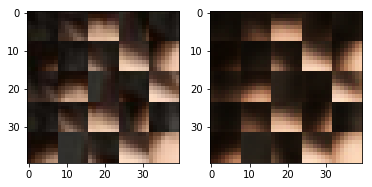

EPO: 12, recon_loss: 0.0060, total_loss: 0.0135
EPO: 12, recon_loss: 0.0040, total_loss: 0.0089
EPO: 12, recon_loss: 0.0043, total_loss: 0.0144
EPO: 12, recon_loss: 0.0047, total_loss: 0.0134
EPO: 12, recon_loss: 0.0190, total_loss: 0.0300
EPO: 12, recon_loss: 0.0056, total_loss: 0.0127
EPO: 12, recon_loss: 0.0144, total_loss: 0.0230
EPO: 12, recon_loss: 0.0019, total_loss: 0.0089
EPO: 12, recon_loss: 0.0008, total_loss: 0.0047
EPO: 12, recon_loss: 0.0115, total_loss: 0.0195
######### what? the reconstruction psnr is: 28.1471


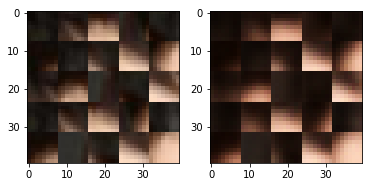

EPO: 12, recon_loss: 0.0067, total_loss: 0.0113
EPO: 12, recon_loss: 0.0069, total_loss: 0.0126
EPO: 12, recon_loss: 0.0071, total_loss: 0.0147
EPO: 12, recon_loss: 0.0094, total_loss: 0.0188
EPO: 12, recon_loss: 0.0110, total_loss: 0.0187
EPO: 12, recon_loss: 0.0048, total_loss: 0.0111
EPO: 12, recon_loss: 0.0030, total_loss: 0.0077
EPO: 12, recon_loss: 0.0076, total_loss: 0.0142
EPO: 12, recon_loss: 0.0035, total_loss: 0.0079
EPO: 12, recon_loss: 0.0118, total_loss: 0.0212
######### what? the reconstruction psnr is: 28.7104


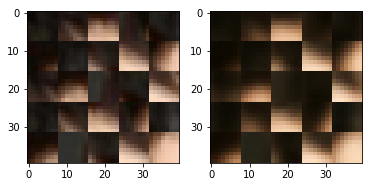

EPO: 12, recon_loss: 0.0040, total_loss: 0.0091
EPO: 12, recon_loss: 0.0045, total_loss: 0.0097
EPO: 12, recon_loss: 0.0090, total_loss: 0.0170
EPO: 12, recon_loss: 0.0062, total_loss: 0.0136
EPO: 12, recon_loss: 0.0063, total_loss: 0.0138
EPO: 12, recon_loss: 0.0093, total_loss: 0.0161
EPO: 12, recon_loss: 0.0077, total_loss: 0.0170
EPO: 12, recon_loss: 0.0076, total_loss: 0.0256
EPO: 12, recon_loss: 0.0047, total_loss: 0.0101
EPO: 12, recon_loss: 0.0039, total_loss: 0.0092
######### what? the reconstruction psnr is: 29.0163


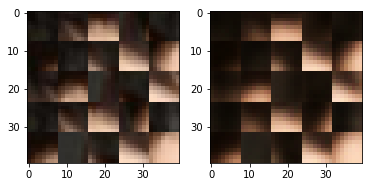

EPO: 12, recon_loss: 0.0039, total_loss: 0.0085
EPO: 12, recon_loss: 0.0069, total_loss: 0.0141
EPO: 12, recon_loss: 0.0063, total_loss: 0.0143
EPO: 12, recon_loss: 0.0037, total_loss: 0.0103
EPO: 12, recon_loss: 0.0102, total_loss: 0.0181
EPO: 12, recon_loss: 0.0138, total_loss: 0.0237
EPO: 12, recon_loss: 0.0068, total_loss: 0.0172
EPO: 12, recon_loss: 0.0145, total_loss: 0.0256
EPO: 12, recon_loss: 0.0035, total_loss: 0.0103
EPO: 12, recon_loss: 0.0044, total_loss: 0.0118
######### what? the reconstruction psnr is: 29.0435


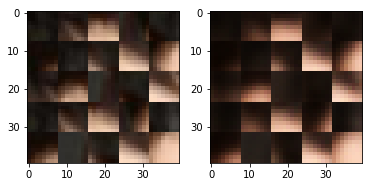

EPO: 12, recon_loss: 0.0089, total_loss: 0.0185
EPO: 12, recon_loss: 0.0067, total_loss: 0.0139
EPO: 12, recon_loss: 0.0123, total_loss: 0.0206
EPO: 12, recon_loss: 0.0033, total_loss: 0.0052
EPO: 12, recon_loss: 0.0026, total_loss: 0.0051
EPO: 12, recon_loss: 0.0078, total_loss: 0.0146
EPO: 12, recon_loss: 0.0031, total_loss: 0.0087
EPO: 12, recon_loss: 0.0064, total_loss: 0.0125
EPO: 12, recon_loss: 0.0161, total_loss: 0.0319
EPO: 12, recon_loss: 0.0086, total_loss: 0.0239
######### what? the reconstruction psnr is: 29.2766


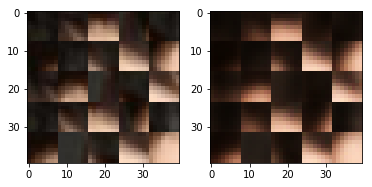

EPO: 12, recon_loss: 0.0202, total_loss: 0.0387
EPO: 12, recon_loss: 0.0097, total_loss: 0.0265
EPO: 12, recon_loss: 0.0155, total_loss: 0.0363
EPO: 12, recon_loss: 0.0040, total_loss: 0.0147
EPO: 12, recon_loss: 0.0075, total_loss: 0.0131
EPO: 12, recon_loss: 0.0087, total_loss: 0.0228
EPO: 12, recon_loss: 0.0055, total_loss: 0.0147
EPO: 12, recon_loss: 0.0070, total_loss: 0.0156
EPO: 12, recon_loss: 0.0063, total_loss: 0.0214
EPO: 12, recon_loss: 0.0065, total_loss: 0.0166
######### what? the reconstruction psnr is: 29.5216


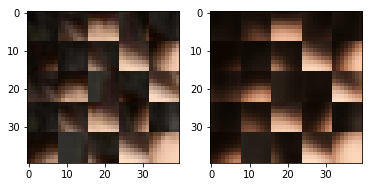

EPO: 12, recon_loss: 0.0184, total_loss: 0.0297
EPO: 12, recon_loss: 0.0038, total_loss: 0.0120
EPO: 12, recon_loss: 0.0037, total_loss: 0.0124
EPO: 12, recon_loss: 0.0064, total_loss: 0.0161
EPO: 12, recon_loss: 0.0025, total_loss: 0.0114
EPO: 12, recon_loss: 0.0162, total_loss: 0.0258
EPO: 12, recon_loss: 0.0032, total_loss: 0.0107
EPO: 12, recon_loss: 0.0058, total_loss: 0.0146
EPO: 12, recon_loss: 0.0047, total_loss: 0.0104
EPO: 12, recon_loss: 0.0038, total_loss: 0.0132
######### what? the reconstruction psnr is: 28.8594


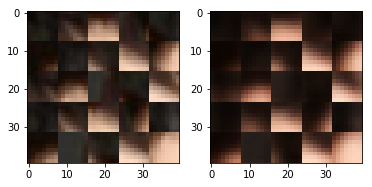

EPO: 12, recon_loss: 0.0188, total_loss: 0.0273
EPO: 12, recon_loss: 0.0052, total_loss: 0.0146
EPO: 12, recon_loss: 0.0056, total_loss: 0.0123
EPO: 12, recon_loss: 0.0057, total_loss: 0.0195
EPO: 12, recon_loss: 0.0024, total_loss: 0.0091
EPO: 12, recon_loss: 0.0150, total_loss: 0.0269
EPO: 12, recon_loss: 0.0034, total_loss: 0.0069
EPO: 12, recon_loss: 0.0076, total_loss: 0.0153
EPO: 12, recon_loss: 0.0043, total_loss: 0.0147
EPO: 12, recon_loss: 0.0025, total_loss: 0.0096
######### what? the reconstruction psnr is: 29.1774


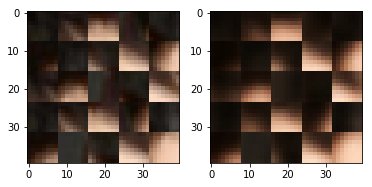

EPO: 12, recon_loss: 0.0079, total_loss: 0.0163
EPO: 12, recon_loss: 0.0022, total_loss: 0.0073
EPO: 12, recon_loss: 0.0055, total_loss: 0.0114
EPO: 12, recon_loss: 0.0164, total_loss: 0.0328
EPO: 12, recon_loss: 0.0135, total_loss: 0.0279
EPO: 12, recon_loss: 0.0074, total_loss: 0.0153
EPO: 12, recon_loss: 0.0083, total_loss: 0.0184
EPO: 12, recon_loss: 0.0070, total_loss: 0.0139
EPO: 12, recon_loss: 0.0096, total_loss: 0.0258
EPO: 12, recon_loss: 0.0045, total_loss: 0.0166
######### what? the reconstruction psnr is: 28.4663


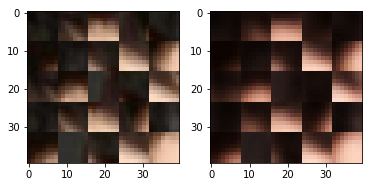

EPO: 12, recon_loss: 0.0062, total_loss: 0.0147
EPO: 12, recon_loss: 0.0070, total_loss: 0.0156
EPO: 12, recon_loss: 0.0089, total_loss: 0.0187
EPO: 12, recon_loss: 0.0050, total_loss: 0.0115
EPO: 12, recon_loss: 0.0015, total_loss: 0.0034
EPO: 12, recon_loss: 0.0046, total_loss: 0.0088
EPO: 12, recon_loss: 0.0033, total_loss: 0.0059
EPO: 12, recon_loss: 0.0024, total_loss: 0.0049
EPO: 12, recon_loss: 0.0058, total_loss: 0.0101
EPO: 12, recon_loss: 0.0057, total_loss: 0.0126
######### what? the reconstruction psnr is: 28.7583


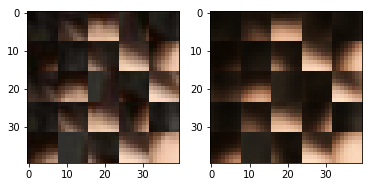

EPO: 12, recon_loss: 0.0078, total_loss: 0.0151
EPO: 12, recon_loss: 0.0056, total_loss: 0.0121
EPO: 12, recon_loss: 0.0046, total_loss: 0.0089
EPO: 12, recon_loss: 0.0081, total_loss: 0.0136
EPO: 12, recon_loss: 0.0071, total_loss: 0.0150
EPO: 12, recon_loss: 0.0094, total_loss: 0.0188
EPO: 12, recon_loss: 0.0108, total_loss: 0.0162
EPO: 12, recon_loss: 0.0082, total_loss: 0.0148
EPO: 12, recon_loss: 0.0131, total_loss: 0.0193
EPO: 12, recon_loss: 0.0143, total_loss: 0.0290
######### what? the reconstruction psnr is: 28.5528


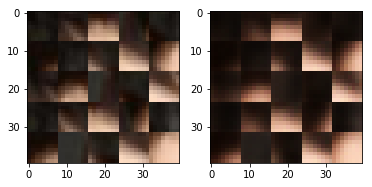

EPO: 12, recon_loss: 0.0121, total_loss: 0.0189
EPO: 12, recon_loss: 0.0114, total_loss: 0.0175
EPO: 12, recon_loss: 0.0135, total_loss: 0.0188
EPO: 12, recon_loss: 0.0132, total_loss: 0.0192
EPO: 12, recon_loss: 0.0021, total_loss: 0.0078
EPO: 12, recon_loss: 0.0034, total_loss: 0.0098
EPO: 12, recon_loss: 0.0095, total_loss: 0.0145
EPO: 12, recon_loss: 0.0075, total_loss: 0.0160
EPO: 12, recon_loss: 0.0164, total_loss: 0.0246
EPO: 12, recon_loss: 0.0040, total_loss: 0.0158
######### what? the reconstruction psnr is: 29.2024


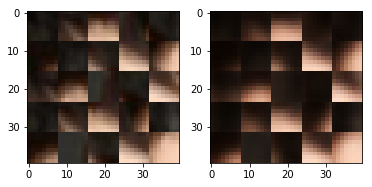

EPO: 12, recon_loss: 0.0033, total_loss: 0.0087
EPO: 12, recon_loss: 0.0067, total_loss: 0.0126
EPO: 12, recon_loss: 0.0013, total_loss: 0.0036
EPO: 12, recon_loss: 0.0033, total_loss: 0.0063
EPO: 12, recon_loss: 0.0078, total_loss: 0.0159
EPO: 12, recon_loss: 0.0075, total_loss: 0.0158
EPO: 12, recon_loss: 0.0091, total_loss: 0.0175
EPO: 12, recon_loss: 0.0085, total_loss: 0.0166
EPO: 12, recon_loss: 0.0084, total_loss: 0.0132
EPO: 13, recon_loss: 0.0035, total_loss: 0.0067
######### what? the reconstruction psnr is: 28.9076


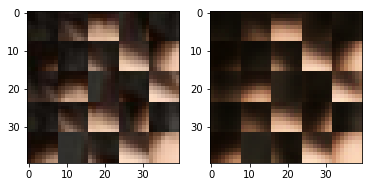

EPO: 13, recon_loss: 0.0026, total_loss: 0.0052
EPO: 13, recon_loss: 0.0119, total_loss: 0.0156
EPO: 13, recon_loss: 0.0027, total_loss: 0.0065
EPO: 13, recon_loss: 0.0058, total_loss: 0.0100
EPO: 13, recon_loss: 0.0040, total_loss: 0.0138
EPO: 13, recon_loss: 0.0031, total_loss: 0.0106
EPO: 13, recon_loss: 0.0062, total_loss: 0.0122
EPO: 13, recon_loss: 0.0038, total_loss: 0.0077
EPO: 13, recon_loss: 0.0080, total_loss: 0.0151
EPO: 13, recon_loss: 0.0033, total_loss: 0.0127
######### what? the reconstruction psnr is: 29.1149


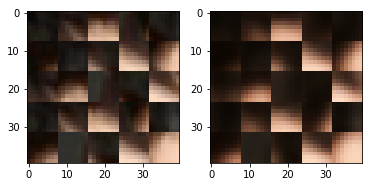

EPO: 13, recon_loss: 0.0018, total_loss: 0.0057
EPO: 13, recon_loss: 0.0048, total_loss: 0.0118
EPO: 13, recon_loss: 0.0030, total_loss: 0.0054
EPO: 13, recon_loss: 0.0059, total_loss: 0.0116
EPO: 13, recon_loss: 0.0055, total_loss: 0.0129
EPO: 13, recon_loss: 0.0049, total_loss: 0.0107
EPO: 13, recon_loss: 0.0054, total_loss: 0.0117
EPO: 13, recon_loss: 0.0045, total_loss: 0.0106
EPO: 13, recon_loss: 0.0037, total_loss: 0.0083
EPO: 13, recon_loss: 0.0064, total_loss: 0.0101
######### what? the reconstruction psnr is: 29.1317


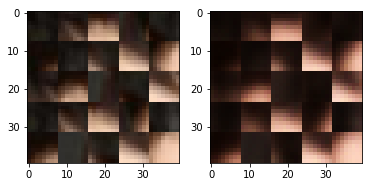

EPO: 13, recon_loss: 0.0032, total_loss: 0.0077
EPO: 13, recon_loss: 0.0084, total_loss: 0.0140
EPO: 13, recon_loss: 0.0049, total_loss: 0.0091
EPO: 13, recon_loss: 0.0050, total_loss: 0.0086
EPO: 13, recon_loss: 0.0144, total_loss: 0.0291
EPO: 13, recon_loss: 0.0052, total_loss: 0.0131
EPO: 13, recon_loss: 0.0077, total_loss: 0.0172
EPO: 13, recon_loss: 0.0124, total_loss: 0.0231
EPO: 13, recon_loss: 0.0072, total_loss: 0.0141
EPO: 13, recon_loss: 0.0059, total_loss: 0.0149
######### what? the reconstruction psnr is: 28.3203


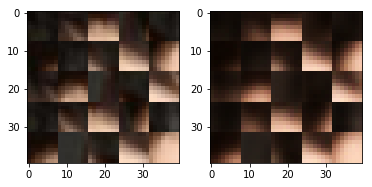

EPO: 13, recon_loss: 0.0047, total_loss: 0.0113
EPO: 13, recon_loss: 0.0063, total_loss: 0.0142
EPO: 13, recon_loss: 0.0046, total_loss: 0.0081
EPO: 13, recon_loss: 0.0058, total_loss: 0.0098
EPO: 13, recon_loss: 0.0024, total_loss: 0.0058
EPO: 13, recon_loss: 0.0027, total_loss: 0.0058
EPO: 13, recon_loss: 0.0030, total_loss: 0.0074
EPO: 13, recon_loss: 0.0064, total_loss: 0.0109
EPO: 13, recon_loss: 0.0054, total_loss: 0.0122
EPO: 13, recon_loss: 0.0078, total_loss: 0.0182
######### what? the reconstruction psnr is: 29.0537


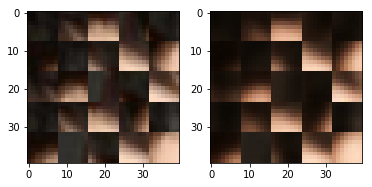

EPO: 13, recon_loss: 0.0027, total_loss: 0.0111
EPO: 13, recon_loss: 0.0033, total_loss: 0.0109
EPO: 13, recon_loss: 0.0054, total_loss: 0.0112
EPO: 13, recon_loss: 0.0023, total_loss: 0.0073
EPO: 13, recon_loss: 0.0091, total_loss: 0.0183
EPO: 13, recon_loss: 0.0116, total_loss: 0.0268
EPO: 13, recon_loss: 0.0054, total_loss: 0.0134
EPO: 13, recon_loss: 0.0108, total_loss: 0.0164
EPO: 13, recon_loss: 0.0039, total_loss: 0.0078
EPO: 13, recon_loss: 0.0082, total_loss: 0.0128
######### what? the reconstruction psnr is: 29.2188


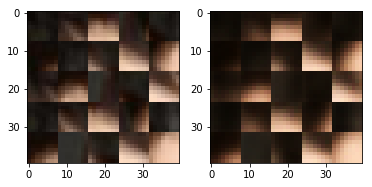

EPO: 13, recon_loss: 0.0060, total_loss: 0.0123
EPO: 13, recon_loss: 0.0054, total_loss: 0.0118
EPO: 13, recon_loss: 0.0081, total_loss: 0.0160
EPO: 13, recon_loss: 0.0072, total_loss: 0.0129
EPO: 13, recon_loss: 0.0128, total_loss: 0.0196
EPO: 13, recon_loss: 0.0119, total_loss: 0.0223
EPO: 13, recon_loss: 0.0136, total_loss: 0.0249
EPO: 13, recon_loss: 0.0270, total_loss: 0.0391
EPO: 13, recon_loss: 0.0126, total_loss: 0.0234
EPO: 13, recon_loss: 0.0117, total_loss: 0.0220
######### what? the reconstruction psnr is: 28.7466


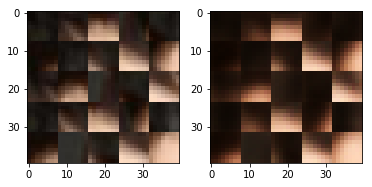

EPO: 13, recon_loss: 0.0057, total_loss: 0.0120
EPO: 13, recon_loss: 0.0055, total_loss: 0.0128
EPO: 13, recon_loss: 0.0075, total_loss: 0.0142
EPO: 13, recon_loss: 0.0075, total_loss: 0.0152
EPO: 13, recon_loss: 0.0109, total_loss: 0.0199
EPO: 13, recon_loss: 0.0034, total_loss: 0.0124
EPO: 13, recon_loss: 0.0039, total_loss: 0.0116
EPO: 13, recon_loss: 0.0130, total_loss: 0.0214
EPO: 13, recon_loss: 0.0035, total_loss: 0.0120
EPO: 13, recon_loss: 0.0050, total_loss: 0.0120
######### what? the reconstruction psnr is: 28.6789


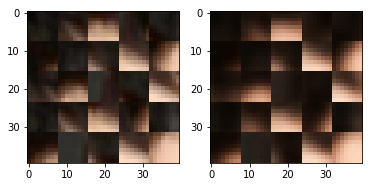

EPO: 13, recon_loss: 0.0098, total_loss: 0.0267
EPO: 13, recon_loss: 0.0077, total_loss: 0.0225
EPO: 13, recon_loss: 0.0263, total_loss: 0.0440
EPO: 13, recon_loss: 0.0067, total_loss: 0.0211
EPO: 13, recon_loss: 0.0083, total_loss: 0.0243
EPO: 13, recon_loss: 0.0144, total_loss: 0.0278
EPO: 13, recon_loss: 0.0077, total_loss: 0.0245
EPO: 13, recon_loss: 0.0250, total_loss: 0.0414
EPO: 13, recon_loss: 0.0119, total_loss: 0.0284
EPO: 13, recon_loss: 0.0128, total_loss: 0.0286
######### what? the reconstruction psnr is: 29.2907


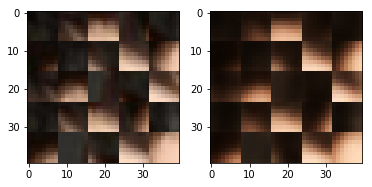

EPO: 13, recon_loss: 0.0058, total_loss: 0.0205
EPO: 13, recon_loss: 0.0052, total_loss: 0.0177
EPO: 13, recon_loss: 0.0270, total_loss: 0.0399
EPO: 13, recon_loss: 0.0264, total_loss: 0.0336
EPO: 13, recon_loss: 0.0047, total_loss: 0.0103
EPO: 13, recon_loss: 0.0042, total_loss: 0.0099
EPO: 13, recon_loss: 0.0033, total_loss: 0.0110
EPO: 13, recon_loss: 0.0122, total_loss: 0.0199
EPO: 13, recon_loss: 0.0052, total_loss: 0.0146
EPO: 13, recon_loss: 0.0071, total_loss: 0.0167
######### what? the reconstruction psnr is: 29.3356


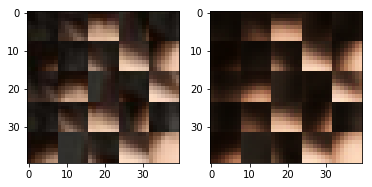

EPO: 13, recon_loss: 0.0029, total_loss: 0.0086
EPO: 13, recon_loss: 0.0009, total_loss: 0.0033
EPO: 13, recon_loss: 0.0013, total_loss: 0.0045
EPO: 13, recon_loss: 0.0016, total_loss: 0.0030
EPO: 13, recon_loss: 0.0018, total_loss: 0.0039
EPO: 13, recon_loss: 0.0089, total_loss: 0.0241
EPO: 13, recon_loss: 0.0041, total_loss: 0.0102
EPO: 13, recon_loss: 0.0065, total_loss: 0.0139
EPO: 13, recon_loss: 0.0070, total_loss: 0.0117
EPO: 13, recon_loss: 0.0056, total_loss: 0.0087
######### what? the reconstruction psnr is: 28.6905


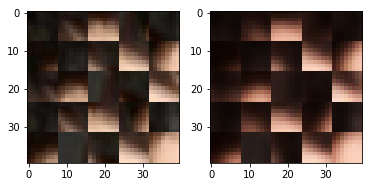

EPO: 13, recon_loss: 0.0109, total_loss: 0.0236
EPO: 13, recon_loss: 0.0094, total_loss: 0.0200
EPO: 13, recon_loss: 0.0133, total_loss: 0.0248
EPO: 13, recon_loss: 0.0105, total_loss: 0.0231
EPO: 13, recon_loss: 0.0054, total_loss: 0.0126
EPO: 13, recon_loss: 0.0079, total_loss: 0.0150
EPO: 13, recon_loss: 0.0057, total_loss: 0.0106
EPO: 13, recon_loss: 0.0057, total_loss: 0.0103
EPO: 13, recon_loss: 0.0055, total_loss: 0.0111
EPO: 13, recon_loss: 0.0048, total_loss: 0.0092
######### what? the reconstruction psnr is: 28.3826


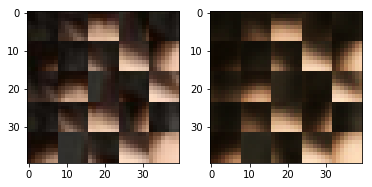

EPO: 13, recon_loss: 0.0066, total_loss: 0.0135
EPO: 13, recon_loss: 0.0045, total_loss: 0.0137
EPO: 13, recon_loss: 0.0040, total_loss: 0.0107
EPO: 13, recon_loss: 0.0101, total_loss: 0.0174
EPO: 13, recon_loss: 0.0108, total_loss: 0.0176
EPO: 13, recon_loss: 0.0062, total_loss: 0.0137
EPO: 13, recon_loss: 0.0021, total_loss: 0.0053
EPO: 13, recon_loss: 0.0029, total_loss: 0.0062
EPO: 13, recon_loss: 0.0046, total_loss: 0.0098
EPO: 13, recon_loss: 0.0020, total_loss: 0.0049
######### what? the reconstruction psnr is: 28.5777


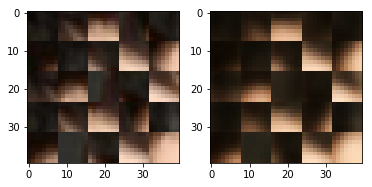

EPO: 13, recon_loss: 0.0036, total_loss: 0.0069
EPO: 13, recon_loss: 0.0044, total_loss: 0.0097
EPO: 13, recon_loss: 0.0052, total_loss: 0.0110
EPO: 13, recon_loss: 0.0101, total_loss: 0.0174
EPO: 13, recon_loss: 0.0058, total_loss: 0.0126
EPO: 13, recon_loss: 0.0041, total_loss: 0.0083
EPO: 13, recon_loss: 0.0034, total_loss: 0.0119
EPO: 13, recon_loss: 0.0041, total_loss: 0.0128
EPO: 13, recon_loss: 0.0168, total_loss: 0.0270
EPO: 13, recon_loss: 0.0047, total_loss: 0.0116
######### what? the reconstruction psnr is: 28.4258


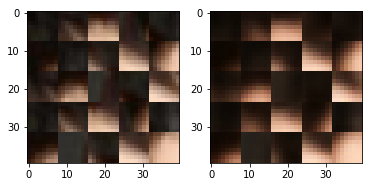

EPO: 13, recon_loss: 0.0195, total_loss: 0.0315
EPO: 13, recon_loss: 0.0015, total_loss: 0.0067
EPO: 13, recon_loss: 0.0010, total_loss: 0.0051
EPO: 13, recon_loss: 0.0148, total_loss: 0.0223
EPO: 13, recon_loss: 0.0048, total_loss: 0.0091
EPO: 13, recon_loss: 0.0059, total_loss: 0.0111
EPO: 13, recon_loss: 0.0063, total_loss: 0.0138
EPO: 13, recon_loss: 0.0081, total_loss: 0.0163
EPO: 13, recon_loss: 0.0139, total_loss: 0.0218
EPO: 13, recon_loss: 0.0033, total_loss: 0.0087
######### what? the reconstruction psnr is: 29.3286


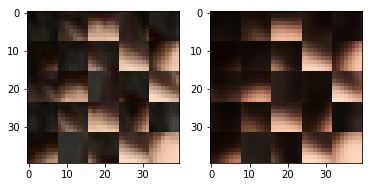

EPO: 13, recon_loss: 0.0048, total_loss: 0.0096
EPO: 13, recon_loss: 0.0055, total_loss: 0.0107
EPO: 13, recon_loss: 0.0035, total_loss: 0.0074
EPO: 13, recon_loss: 0.0098, total_loss: 0.0190
EPO: 13, recon_loss: 0.0030, total_loss: 0.0076
EPO: 13, recon_loss: 0.0040, total_loss: 0.0096
EPO: 13, recon_loss: 0.0092, total_loss: 0.0184
EPO: 13, recon_loss: 0.0050, total_loss: 0.0129
EPO: 13, recon_loss: 0.0085, total_loss: 0.0156
EPO: 13, recon_loss: 0.0059, total_loss: 0.0135
######### what? the reconstruction psnr is: 29.3854


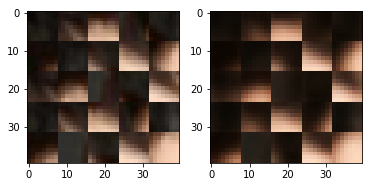

EPO: 13, recon_loss: 0.0074, total_loss: 0.0155
EPO: 13, recon_loss: 0.0089, total_loss: 0.0252
EPO: 13, recon_loss: 0.0024, total_loss: 0.0067
EPO: 13, recon_loss: 0.0060, total_loss: 0.0110
EPO: 13, recon_loss: 0.0041, total_loss: 0.0094
EPO: 13, recon_loss: 0.0049, total_loss: 0.0105
EPO: 13, recon_loss: 0.0056, total_loss: 0.0141
EPO: 13, recon_loss: 0.0035, total_loss: 0.0095
EPO: 13, recon_loss: 0.0100, total_loss: 0.0176
EPO: 13, recon_loss: 0.0100, total_loss: 0.0184
######### what? the reconstruction psnr is: 28.8729


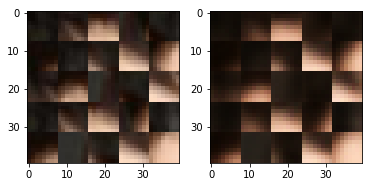

EPO: 13, recon_loss: 0.0078, total_loss: 0.0184
EPO: 13, recon_loss: 0.0089, total_loss: 0.0212
EPO: 13, recon_loss: 0.0041, total_loss: 0.0112
EPO: 13, recon_loss: 0.0044, total_loss: 0.0123
EPO: 13, recon_loss: 0.0080, total_loss: 0.0157
EPO: 13, recon_loss: 0.0068, total_loss: 0.0147
EPO: 13, recon_loss: 0.0056, total_loss: 0.0090
EPO: 13, recon_loss: 0.0030, total_loss: 0.0053
EPO: 13, recon_loss: 0.0022, total_loss: 0.0049
EPO: 13, recon_loss: 0.0050, total_loss: 0.0107
######### what? the reconstruction psnr is: 28.9249


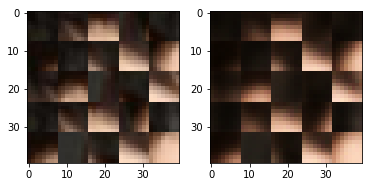

EPO: 13, recon_loss: 0.0038, total_loss: 0.0096
EPO: 13, recon_loss: 0.0071, total_loss: 0.0134
EPO: 13, recon_loss: 0.0126, total_loss: 0.0287
EPO: 13, recon_loss: 0.0072, total_loss: 0.0205
EPO: 13, recon_loss: 0.0155, total_loss: 0.0331
EPO: 13, recon_loss: 0.0111, total_loss: 0.0300
EPO: 13, recon_loss: 0.0139, total_loss: 0.0338
EPO: 13, recon_loss: 0.0036, total_loss: 0.0120
EPO: 13, recon_loss: 0.0127, total_loss: 0.0211
EPO: 13, recon_loss: 0.0066, total_loss: 0.0196
######### what? the reconstruction psnr is: 29.5379


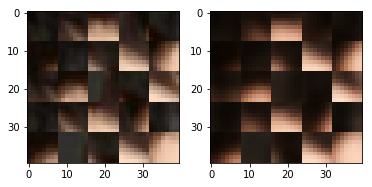

EPO: 13, recon_loss: 0.0058, total_loss: 0.0148
EPO: 13, recon_loss: 0.0076, total_loss: 0.0176
EPO: 13, recon_loss: 0.0063, total_loss: 0.0193
EPO: 13, recon_loss: 0.0078, total_loss: 0.0182
EPO: 13, recon_loss: 0.0131, total_loss: 0.0245
EPO: 13, recon_loss: 0.0045, total_loss: 0.0133
EPO: 13, recon_loss: 0.0056, total_loss: 0.0144
EPO: 13, recon_loss: 0.0049, total_loss: 0.0122
EPO: 13, recon_loss: 0.0033, total_loss: 0.0119
EPO: 13, recon_loss: 0.0130, total_loss: 0.0214
######### what? the reconstruction psnr is: 29.5264


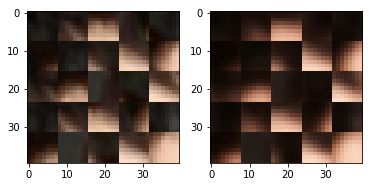

EPO: 13, recon_loss: 0.0034, total_loss: 0.0108
EPO: 13, recon_loss: 0.0059, total_loss: 0.0145
EPO: 13, recon_loss: 0.0037, total_loss: 0.0098
EPO: 13, recon_loss: 0.0046, total_loss: 0.0145
EPO: 13, recon_loss: 0.0159, total_loss: 0.0234
EPO: 13, recon_loss: 0.0053, total_loss: 0.0149
EPO: 13, recon_loss: 0.0080, total_loss: 0.0151
EPO: 13, recon_loss: 0.0037, total_loss: 0.0126
EPO: 13, recon_loss: 0.0031, total_loss: 0.0099
EPO: 13, recon_loss: 0.0122, total_loss: 0.0215
######### what? the reconstruction psnr is: 29.4266


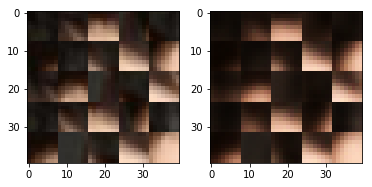

EPO: 13, recon_loss: 0.0038, total_loss: 0.0074
EPO: 13, recon_loss: 0.0084, total_loss: 0.0158
EPO: 13, recon_loss: 0.0036, total_loss: 0.0126
EPO: 13, recon_loss: 0.0023, total_loss: 0.0087
EPO: 13, recon_loss: 0.0069, total_loss: 0.0132
EPO: 13, recon_loss: 0.0024, total_loss: 0.0079
EPO: 13, recon_loss: 0.0051, total_loss: 0.0103
EPO: 13, recon_loss: 0.0141, total_loss: 0.0298
EPO: 13, recon_loss: 0.0130, total_loss: 0.0259
EPO: 13, recon_loss: 0.0070, total_loss: 0.0139
######### what? the reconstruction psnr is: 28.3571


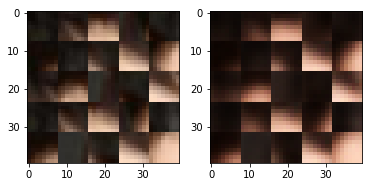

EPO: 13, recon_loss: 0.0077, total_loss: 0.0172
EPO: 13, recon_loss: 0.0057, total_loss: 0.0113
EPO: 13, recon_loss: 0.0086, total_loss: 0.0245
EPO: 13, recon_loss: 0.0039, total_loss: 0.0151
EPO: 13, recon_loss: 0.0088, total_loss: 0.0174
EPO: 13, recon_loss: 0.0056, total_loss: 0.0149
EPO: 13, recon_loss: 0.0072, total_loss: 0.0154
EPO: 13, recon_loss: 0.0043, total_loss: 0.0101
EPO: 13, recon_loss: 0.0012, total_loss: 0.0029
EPO: 13, recon_loss: 0.0064, total_loss: 0.0110
######### what? the reconstruction psnr is: 29.2120


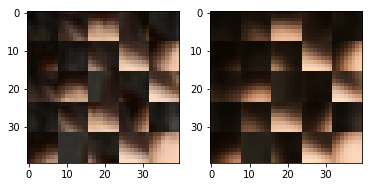

EPO: 13, recon_loss: 0.0022, total_loss: 0.0045
EPO: 13, recon_loss: 0.0024, total_loss: 0.0049
EPO: 13, recon_loss: 0.0049, total_loss: 0.0094
EPO: 13, recon_loss: 0.0051, total_loss: 0.0113
EPO: 13, recon_loss: 0.0089, total_loss: 0.0165
EPO: 13, recon_loss: 0.0047, total_loss: 0.0102
EPO: 13, recon_loss: 0.0050, total_loss: 0.0089
EPO: 13, recon_loss: 0.0095, total_loss: 0.0231
EPO: 13, recon_loss: 0.0092, total_loss: 0.0187
EPO: 13, recon_loss: 0.0077, total_loss: 0.0148
######### what? the reconstruction psnr is: 28.8325


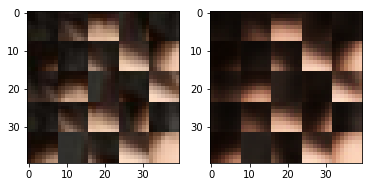

EPO: 13, recon_loss: 0.0097, total_loss: 0.0150
EPO: 13, recon_loss: 0.0082, total_loss: 0.0143
EPO: 13, recon_loss: 0.0169, total_loss: 0.0278
EPO: 13, recon_loss: 0.0204, total_loss: 0.0368
EPO: 13, recon_loss: 0.0084, total_loss: 0.0150
EPO: 13, recon_loss: 0.0118, total_loss: 0.0173
EPO: 13, recon_loss: 0.0156, total_loss: 0.0209
EPO: 13, recon_loss: 0.0164, total_loss: 0.0245
EPO: 13, recon_loss: 0.0018, total_loss: 0.0075
EPO: 13, recon_loss: 0.0041, total_loss: 0.0110
######### what? the reconstruction psnr is: 28.4114


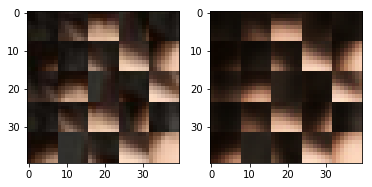

EPO: 13, recon_loss: 0.0086, total_loss: 0.0146
EPO: 13, recon_loss: 0.0076, total_loss: 0.0159
EPO: 13, recon_loss: 0.0180, total_loss: 0.0266
EPO: 13, recon_loss: 0.0026, total_loss: 0.0102
EPO: 13, recon_loss: 0.0040, total_loss: 0.0093
EPO: 13, recon_loss: 0.0070, total_loss: 0.0130
EPO: 13, recon_loss: 0.0020, total_loss: 0.0049
EPO: 13, recon_loss: 0.0040, total_loss: 0.0068
EPO: 13, recon_loss: 0.0068, total_loss: 0.0150
EPO: 13, recon_loss: 0.0070, total_loss: 0.0146
######### what? the reconstruction psnr is: 28.9639


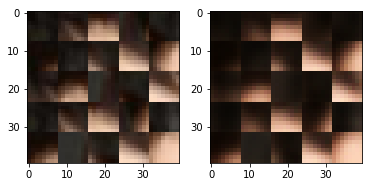

EPO: 13, recon_loss: 0.0099, total_loss: 0.0181
EPO: 13, recon_loss: 0.0077, total_loss: 0.0153
EPO: 13, recon_loss: 0.0096, total_loss: 0.0154
EPO: 14, recon_loss: 0.0031, total_loss: 0.0062
EPO: 14, recon_loss: 0.0026, total_loss: 0.0053
EPO: 14, recon_loss: 0.0123, total_loss: 0.0177
EPO: 14, recon_loss: 0.0032, total_loss: 0.0070
EPO: 14, recon_loss: 0.0069, total_loss: 0.0113
EPO: 14, recon_loss: 0.0037, total_loss: 0.0129
EPO: 14, recon_loss: 0.0041, total_loss: 0.0104
######### what? the reconstruction psnr is: 29.3240


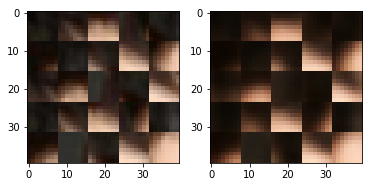

EPO: 14, recon_loss: 0.0062, total_loss: 0.0114
EPO: 14, recon_loss: 0.0050, total_loss: 0.0089
EPO: 14, recon_loss: 0.0091, total_loss: 0.0175
EPO: 14, recon_loss: 0.0028, total_loss: 0.0115
EPO: 14, recon_loss: 0.0016, total_loss: 0.0051
EPO: 14, recon_loss: 0.0046, total_loss: 0.0111
EPO: 14, recon_loss: 0.0033, total_loss: 0.0054
EPO: 14, recon_loss: 0.0071, total_loss: 0.0141
EPO: 14, recon_loss: 0.0050, total_loss: 0.0111
EPO: 14, recon_loss: 0.0046, total_loss: 0.0104
######### what? the reconstruction psnr is: 29.4387


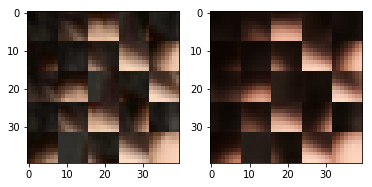

EPO: 14, recon_loss: 0.0056, total_loss: 0.0108
EPO: 14, recon_loss: 0.0044, total_loss: 0.0110
EPO: 14, recon_loss: 0.0044, total_loss: 0.0094
EPO: 14, recon_loss: 0.0049, total_loss: 0.0083
EPO: 14, recon_loss: 0.0033, total_loss: 0.0078
EPO: 14, recon_loss: 0.0097, total_loss: 0.0141
EPO: 14, recon_loss: 0.0034, total_loss: 0.0069
EPO: 14, recon_loss: 0.0049, total_loss: 0.0082
EPO: 14, recon_loss: 0.0105, total_loss: 0.0212
EPO: 14, recon_loss: 0.0041, total_loss: 0.0115
######### what? the reconstruction psnr is: 28.6263


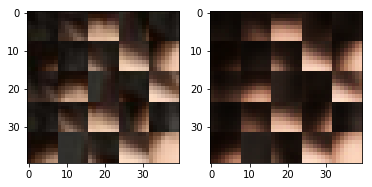

EPO: 14, recon_loss: 0.0092, total_loss: 0.0201
EPO: 14, recon_loss: 0.0109, total_loss: 0.0192
EPO: 14, recon_loss: 0.0086, total_loss: 0.0154
EPO: 14, recon_loss: 0.0075, total_loss: 0.0195
EPO: 14, recon_loss: 0.0036, total_loss: 0.0101
EPO: 14, recon_loss: 0.0078, total_loss: 0.0144
EPO: 14, recon_loss: 0.0037, total_loss: 0.0063
EPO: 14, recon_loss: 0.0032, total_loss: 0.0067
EPO: 14, recon_loss: 0.0024, total_loss: 0.0052
EPO: 14, recon_loss: 0.0022, total_loss: 0.0049
######### what? the reconstruction psnr is: 28.5468


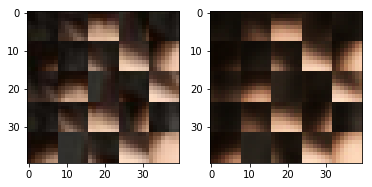

EPO: 14, recon_loss: 0.0038, total_loss: 0.0092
EPO: 14, recon_loss: 0.0038, total_loss: 0.0076
EPO: 14, recon_loss: 0.0059, total_loss: 0.0141
EPO: 14, recon_loss: 0.0027, total_loss: 0.0124
EPO: 14, recon_loss: 0.0023, total_loss: 0.0100
EPO: 14, recon_loss: 0.0039, total_loss: 0.0107
EPO: 14, recon_loss: 0.0040, total_loss: 0.0084
EPO: 14, recon_loss: 0.0039, total_loss: 0.0099
EPO: 14, recon_loss: 0.0067, total_loss: 0.0188
EPO: 14, recon_loss: 0.0051, total_loss: 0.0132
######### what? the reconstruction psnr is: 29.7324


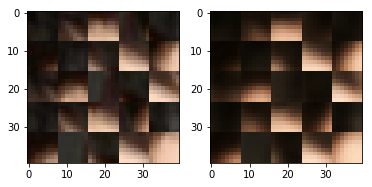

EPO: 14, recon_loss: 0.0087, total_loss: 0.0172
EPO: 14, recon_loss: 0.0073, total_loss: 0.0121
EPO: 14, recon_loss: 0.0050, total_loss: 0.0089
EPO: 14, recon_loss: 0.0116, total_loss: 0.0179
EPO: 14, recon_loss: 0.0046, total_loss: 0.0096
EPO: 14, recon_loss: 0.0060, total_loss: 0.0139
EPO: 14, recon_loss: 0.0070, total_loss: 0.0138
EPO: 14, recon_loss: 0.0065, total_loss: 0.0129
EPO: 14, recon_loss: 0.0177, total_loss: 0.0233
EPO: 14, recon_loss: 0.0117, total_loss: 0.0220
######### what? the reconstruction psnr is: 29.3833


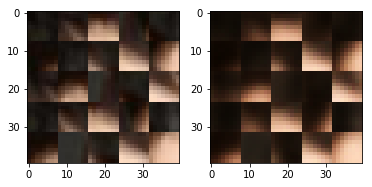

EPO: 14, recon_loss: 0.0144, total_loss: 0.0261
EPO: 14, recon_loss: 0.0237, total_loss: 0.0349
EPO: 14, recon_loss: 0.0127, total_loss: 0.0229
EPO: 14, recon_loss: 0.0126, total_loss: 0.0222
EPO: 14, recon_loss: 0.0051, total_loss: 0.0110
EPO: 14, recon_loss: 0.0063, total_loss: 0.0127
EPO: 14, recon_loss: 0.0088, total_loss: 0.0155
EPO: 14, recon_loss: 0.0098, total_loss: 0.0195
EPO: 14, recon_loss: 0.0113, total_loss: 0.0189
EPO: 14, recon_loss: 0.0037, total_loss: 0.0123
######### what? the reconstruction psnr is: 29.2201


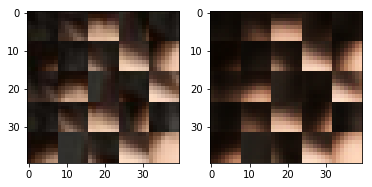

EPO: 14, recon_loss: 0.0070, total_loss: 0.0157
EPO: 14, recon_loss: 0.0109, total_loss: 0.0196
EPO: 14, recon_loss: 0.0036, total_loss: 0.0119
EPO: 14, recon_loss: 0.0062, total_loss: 0.0132
EPO: 14, recon_loss: 0.0078, total_loss: 0.0220
EPO: 14, recon_loss: 0.0078, total_loss: 0.0218
EPO: 14, recon_loss: 0.0248, total_loss: 0.0415
EPO: 14, recon_loss: 0.0071, total_loss: 0.0231
EPO: 14, recon_loss: 0.0092, total_loss: 0.0229
EPO: 14, recon_loss: 0.0105, total_loss: 0.0238
######### what? the reconstruction psnr is: 29.5327


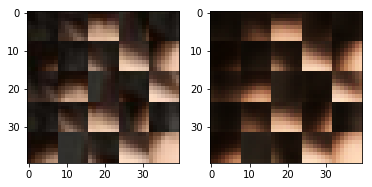

EPO: 14, recon_loss: 0.0070, total_loss: 0.0227
EPO: 14, recon_loss: 0.0276, total_loss: 0.0442
EPO: 14, recon_loss: 0.0127, total_loss: 0.0286
EPO: 14, recon_loss: 0.0121, total_loss: 0.0276
EPO: 14, recon_loss: 0.0035, total_loss: 0.0163
EPO: 14, recon_loss: 0.0093, total_loss: 0.0255
EPO: 14, recon_loss: 0.0303, total_loss: 0.0424
EPO: 14, recon_loss: 0.0196, total_loss: 0.0274
EPO: 14, recon_loss: 0.0050, total_loss: 0.0093
EPO: 14, recon_loss: 0.0030, total_loss: 0.0088
######### what? the reconstruction psnr is: 29.2544


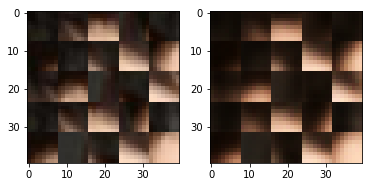

EPO: 14, recon_loss: 0.0038, total_loss: 0.0115
EPO: 14, recon_loss: 0.0119, total_loss: 0.0195
EPO: 14, recon_loss: 0.0048, total_loss: 0.0139
EPO: 14, recon_loss: 0.0081, total_loss: 0.0174
EPO: 14, recon_loss: 0.0018, total_loss: 0.0054
EPO: 14, recon_loss: 0.0009, total_loss: 0.0034
EPO: 14, recon_loss: 0.0020, total_loss: 0.0049
EPO: 14, recon_loss: 0.0012, total_loss: 0.0026
EPO: 14, recon_loss: 0.0015, total_loss: 0.0040
EPO: 14, recon_loss: 0.0082, total_loss: 0.0213
######### what? the reconstruction psnr is: 29.6211


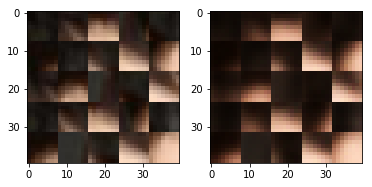

EPO: 14, recon_loss: 0.0034, total_loss: 0.0091
EPO: 14, recon_loss: 0.0066, total_loss: 0.0133
EPO: 14, recon_loss: 0.0041, total_loss: 0.0077
EPO: 14, recon_loss: 0.0047, total_loss: 0.0075
EPO: 14, recon_loss: 0.0101, total_loss: 0.0243
EPO: 14, recon_loss: 0.0091, total_loss: 0.0186
EPO: 14, recon_loss: 0.0110, total_loss: 0.0213
EPO: 14, recon_loss: 0.0106, total_loss: 0.0221
EPO: 14, recon_loss: 0.0056, total_loss: 0.0127
EPO: 14, recon_loss: 0.0085, total_loss: 0.0153
######### what? the reconstruction psnr is: 28.7197


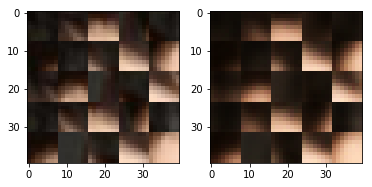

EPO: 14, recon_loss: 0.0051, total_loss: 0.0097
EPO: 14, recon_loss: 0.0051, total_loss: 0.0098
EPO: 14, recon_loss: 0.0043, total_loss: 0.0087
EPO: 14, recon_loss: 0.0053, total_loss: 0.0108
EPO: 14, recon_loss: 0.0034, total_loss: 0.0155
EPO: 14, recon_loss: 0.0026, total_loss: 0.0090
EPO: 14, recon_loss: 0.0059, total_loss: 0.0140
EPO: 14, recon_loss: 0.0087, total_loss: 0.0154
EPO: 14, recon_loss: 0.0059, total_loss: 0.0113
EPO: 14, recon_loss: 0.0049, total_loss: 0.0103
######### what? the reconstruction psnr is: 29.0565


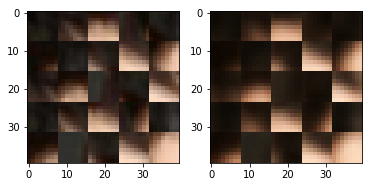

EPO: 14, recon_loss: 0.0018, total_loss: 0.0051
EPO: 14, recon_loss: 0.0032, total_loss: 0.0065
EPO: 14, recon_loss: 0.0040, total_loss: 0.0088
EPO: 14, recon_loss: 0.0025, total_loss: 0.0053
EPO: 14, recon_loss: 0.0046, total_loss: 0.0083
EPO: 14, recon_loss: 0.0035, total_loss: 0.0080
EPO: 14, recon_loss: 0.0050, total_loss: 0.0108
EPO: 14, recon_loss: 0.0075, total_loss: 0.0146
EPO: 14, recon_loss: 0.0061, total_loss: 0.0120
EPO: 14, recon_loss: 0.0035, total_loss: 0.0080
######### what? the reconstruction psnr is: 28.4311


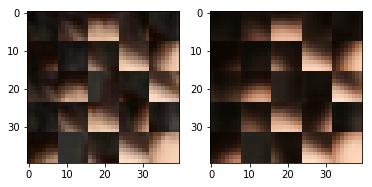

EPO: 14, recon_loss: 0.0044, total_loss: 0.0145
EPO: 14, recon_loss: 0.0088, total_loss: 0.0184
EPO: 14, recon_loss: 0.0153, total_loss: 0.0258
EPO: 14, recon_loss: 0.0051, total_loss: 0.0122
EPO: 14, recon_loss: 0.0194, total_loss: 0.0300
EPO: 14, recon_loss: 0.0012, total_loss: 0.0053
EPO: 14, recon_loss: 0.0024, total_loss: 0.0069
EPO: 14, recon_loss: 0.0132, total_loss: 0.0206
EPO: 14, recon_loss: 0.0036, total_loss: 0.0084
EPO: 14, recon_loss: 0.0056, total_loss: 0.0107
######### what? the reconstruction psnr is: 28.7832


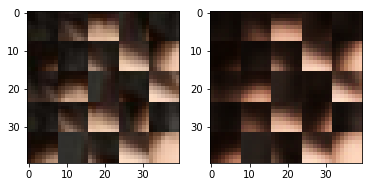

EPO: 14, recon_loss: 0.0057, total_loss: 0.0122
EPO: 14, recon_loss: 0.0065, total_loss: 0.0149
EPO: 14, recon_loss: 0.0118, total_loss: 0.0191
EPO: 14, recon_loss: 0.0030, total_loss: 0.0087
EPO: 14, recon_loss: 0.0070, total_loss: 0.0127
EPO: 14, recon_loss: 0.0048, total_loss: 0.0095
EPO: 14, recon_loss: 0.0060, total_loss: 0.0111
EPO: 14, recon_loss: 0.0106, total_loss: 0.0199
EPO: 14, recon_loss: 0.0033, total_loss: 0.0083
EPO: 14, recon_loss: 0.0045, total_loss: 0.0103
######### what? the reconstruction psnr is: 28.8080


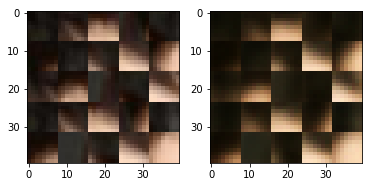

EPO: 14, recon_loss: 0.0077, total_loss: 0.0159
EPO: 14, recon_loss: 0.0044, total_loss: 0.0119
EPO: 14, recon_loss: 0.0117, total_loss: 0.0184
EPO: 14, recon_loss: 0.0056, total_loss: 0.0137
EPO: 14, recon_loss: 0.0080, total_loss: 0.0156
EPO: 14, recon_loss: 0.0093, total_loss: 0.0231
EPO: 14, recon_loss: 0.0015, total_loss: 0.0055
EPO: 14, recon_loss: 0.0080, total_loss: 0.0126
EPO: 14, recon_loss: 0.0034, total_loss: 0.0083
EPO: 14, recon_loss: 0.0047, total_loss: 0.0099
######### what? the reconstruction psnr is: 29.6082


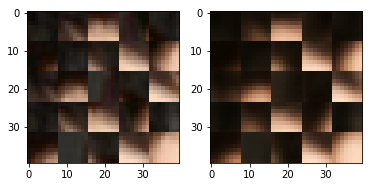

EPO: 14, recon_loss: 0.0050, total_loss: 0.0137
EPO: 14, recon_loss: 0.0034, total_loss: 0.0093
EPO: 14, recon_loss: 0.0123, total_loss: 0.0205
EPO: 14, recon_loss: 0.0046, total_loss: 0.0119
EPO: 14, recon_loss: 0.0091, total_loss: 0.0179
EPO: 14, recon_loss: 0.0071, total_loss: 0.0179
EPO: 14, recon_loss: 0.0028, total_loss: 0.0097
EPO: 14, recon_loss: 0.0076, total_loss: 0.0164
EPO: 14, recon_loss: 0.0037, total_loss: 0.0097
EPO: 14, recon_loss: 0.0066, total_loss: 0.0132
######### what? the reconstruction psnr is: 29.2366


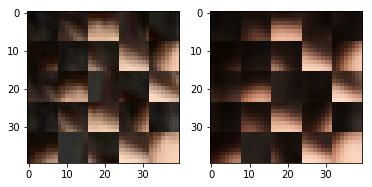

EPO: 14, recon_loss: 0.0041, total_loss: 0.0060
EPO: 14, recon_loss: 0.0023, total_loss: 0.0044
EPO: 14, recon_loss: 0.0030, total_loss: 0.0061
EPO: 14, recon_loss: 0.0038, total_loss: 0.0081
EPO: 14, recon_loss: 0.0042, total_loss: 0.0100
EPO: 14, recon_loss: 0.0125, total_loss: 0.0284
EPO: 14, recon_loss: 0.0118, total_loss: 0.0255
EPO: 14, recon_loss: 0.0098, total_loss: 0.0241
EPO: 14, recon_loss: 0.0113, total_loss: 0.0284
EPO: 14, recon_loss: 0.0102, total_loss: 0.0285
######### what? the reconstruction psnr is: 29.3730


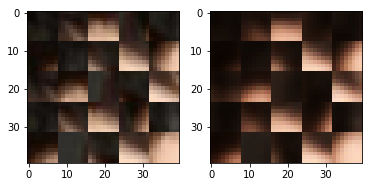

EPO: 14, recon_loss: 0.0039, total_loss: 0.0121
EPO: 14, recon_loss: 0.0046, total_loss: 0.0116
EPO: 14, recon_loss: 0.0149, total_loss: 0.0273
EPO: 14, recon_loss: 0.0057, total_loss: 0.0175
EPO: 14, recon_loss: 0.0057, total_loss: 0.0150
EPO: 14, recon_loss: 0.0060, total_loss: 0.0149
EPO: 14, recon_loss: 0.0057, total_loss: 0.0176
EPO: 14, recon_loss: 0.0079, total_loss: 0.0188
EPO: 14, recon_loss: 0.0100, total_loss: 0.0205
EPO: 14, recon_loss: 0.0049, total_loss: 0.0126
######### what? the reconstruction psnr is: 29.7675


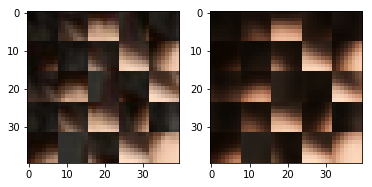

EPO: 14, recon_loss: 0.0053, total_loss: 0.0133
EPO: 14, recon_loss: 0.0037, total_loss: 0.0110
EPO: 14, recon_loss: 0.0073, total_loss: 0.0166
EPO: 14, recon_loss: 0.0109, total_loss: 0.0187
EPO: 14, recon_loss: 0.0031, total_loss: 0.0100
EPO: 14, recon_loss: 0.0059, total_loss: 0.0143
EPO: 14, recon_loss: 0.0029, total_loss: 0.0094
EPO: 14, recon_loss: 0.0057, total_loss: 0.0148
EPO: 14, recon_loss: 0.0133, total_loss: 0.0212
EPO: 14, recon_loss: 0.0055, total_loss: 0.0152
######### what? the reconstruction psnr is: 29.2787


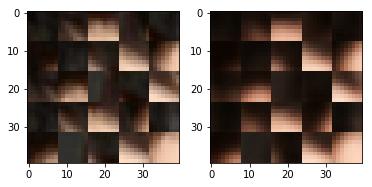

EPO: 14, recon_loss: 0.0100, total_loss: 0.0179
EPO: 14, recon_loss: 0.0024, total_loss: 0.0099
EPO: 14, recon_loss: 0.0043, total_loss: 0.0105
EPO: 14, recon_loss: 0.0091, total_loss: 0.0159
EPO: 14, recon_loss: 0.0042, total_loss: 0.0087
EPO: 14, recon_loss: 0.0070, total_loss: 0.0159
EPO: 14, recon_loss: 0.0027, total_loss: 0.0092
EPO: 14, recon_loss: 0.0024, total_loss: 0.0089
EPO: 14, recon_loss: 0.0052, total_loss: 0.0114
EPO: 14, recon_loss: 0.0029, total_loss: 0.0078
######### what? the reconstruction psnr is: 29.4240


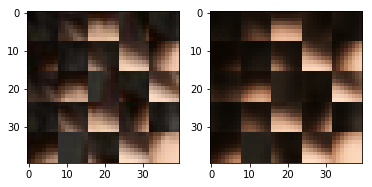

EPO: 14, recon_loss: 0.0041, total_loss: 0.0097
EPO: 14, recon_loss: 0.0126, total_loss: 0.0256
EPO: 14, recon_loss: 0.0101, total_loss: 0.0224
EPO: 14, recon_loss: 0.0069, total_loss: 0.0134
EPO: 14, recon_loss: 0.0085, total_loss: 0.0182
EPO: 14, recon_loss: 0.0051, total_loss: 0.0109
EPO: 14, recon_loss: 0.0080, total_loss: 0.0233
EPO: 14, recon_loss: 0.0038, total_loss: 0.0136
EPO: 14, recon_loss: 0.0093, total_loss: 0.0185
EPO: 14, recon_loss: 0.0039, total_loss: 0.0112
######### what? the reconstruction psnr is: 29.2537


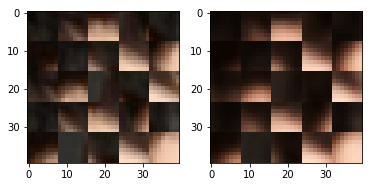

EPO: 14, recon_loss: 0.0081, total_loss: 0.0157
EPO: 14, recon_loss: 0.0025, total_loss: 0.0056
EPO: 14, recon_loss: 0.0011, total_loss: 0.0029
EPO: 14, recon_loss: 0.0063, total_loss: 0.0104
EPO: 14, recon_loss: 0.0020, total_loss: 0.0046
EPO: 14, recon_loss: 0.0029, total_loss: 0.0056
EPO: 14, recon_loss: 0.0058, total_loss: 0.0113
EPO: 14, recon_loss: 0.0040, total_loss: 0.0097
EPO: 14, recon_loss: 0.0081, total_loss: 0.0151
EPO: 14, recon_loss: 0.0031, total_loss: 0.0077
######### what? the reconstruction psnr is: 28.8160


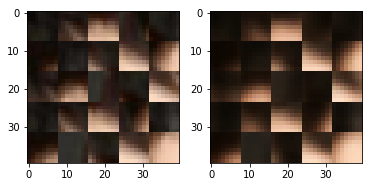

EPO: 14, recon_loss: 0.0033, total_loss: 0.0065
EPO: 14, recon_loss: 0.0095, total_loss: 0.0226
EPO: 14, recon_loss: 0.0066, total_loss: 0.0141
EPO: 14, recon_loss: 0.0095, total_loss: 0.0162
EPO: 14, recon_loss: 0.0066, total_loss: 0.0117
EPO: 14, recon_loss: 0.0090, total_loss: 0.0152
EPO: 14, recon_loss: 0.0136, total_loss: 0.0249
EPO: 14, recon_loss: 0.0235, total_loss: 0.0409
EPO: 14, recon_loss: 0.0068, total_loss: 0.0126
EPO: 14, recon_loss: 0.0180, total_loss: 0.0226
######### what? the reconstruction psnr is: 24.5772


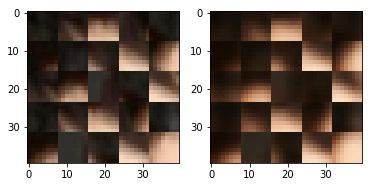

EPO: 14, recon_loss: 0.0115, total_loss: 0.0176
EPO: 14, recon_loss: 0.0035, total_loss: 0.0094
EPO: 14, recon_loss: 0.0018, total_loss: 0.0080
EPO: 14, recon_loss: 0.0046, total_loss: 0.0102
EPO: 14, recon_loss: 0.0049, total_loss: 0.0116
EPO: 14, recon_loss: 0.0059, total_loss: 0.0113
EPO: 14, recon_loss: 0.0034, total_loss: 0.0195
EPO: 14, recon_loss: 0.0019, total_loss: 0.0080
EPO: 14, recon_loss: 0.0047, total_loss: 0.0101
EPO: 14, recon_loss: 0.0045, total_loss: 0.0097
######### what? the reconstruction psnr is: 28.9328


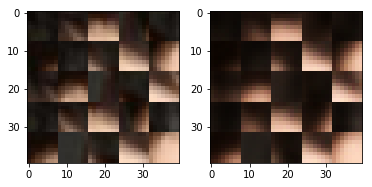

EPO: 14, recon_loss: 0.0014, total_loss: 0.0033
EPO: 14, recon_loss: 0.0054, total_loss: 0.0109
EPO: 14, recon_loss: 0.0066, total_loss: 0.0146
EPO: 14, recon_loss: 0.0081, total_loss: 0.0148
EPO: 14, recon_loss: 0.0106, total_loss: 0.0194
EPO: 14, recon_loss: 0.0110, total_loss: 0.0188
EPO: 14, recon_loss: 0.0144, total_loss: 0.0200
EPO: 15, recon_loss: 0.0026, total_loss: 0.0052
EPO: 15, recon_loss: 0.0034, total_loss: 0.0063
EPO: 15, recon_loss: 0.0076, total_loss: 0.0129
######### what? the reconstruction psnr is: 29.1431


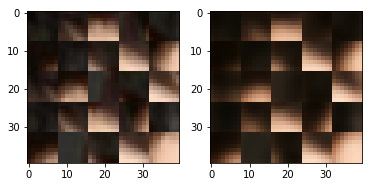

EPO: 15, recon_loss: 0.0036, total_loss: 0.0070
EPO: 15, recon_loss: 0.0079, total_loss: 0.0123
EPO: 15, recon_loss: 0.0025, total_loss: 0.0092
EPO: 15, recon_loss: 0.0038, total_loss: 0.0098
EPO: 15, recon_loss: 0.0073, total_loss: 0.0124
EPO: 15, recon_loss: 0.0083, total_loss: 0.0135
EPO: 15, recon_loss: 0.0084, total_loss: 0.0161
EPO: 15, recon_loss: 0.0030, total_loss: 0.0096
EPO: 15, recon_loss: 0.0025, total_loss: 0.0069
EPO: 15, recon_loss: 0.0041, total_loss: 0.0094
######### what? the reconstruction psnr is: 29.4868


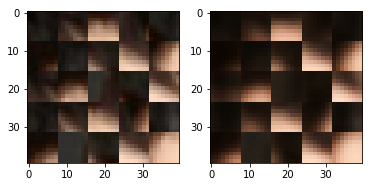

EPO: 15, recon_loss: 0.0036, total_loss: 0.0066
EPO: 15, recon_loss: 0.0096, total_loss: 0.0157
EPO: 15, recon_loss: 0.0046, total_loss: 0.0105
EPO: 15, recon_loss: 0.0041, total_loss: 0.0094
EPO: 15, recon_loss: 0.0051, total_loss: 0.0116
EPO: 15, recon_loss: 0.0045, total_loss: 0.0104
EPO: 15, recon_loss: 0.0047, total_loss: 0.0106
EPO: 15, recon_loss: 0.0039, total_loss: 0.0073
EPO: 15, recon_loss: 0.0036, total_loss: 0.0075
EPO: 15, recon_loss: 0.0110, total_loss: 0.0164
######### what? the reconstruction psnr is: 29.5402


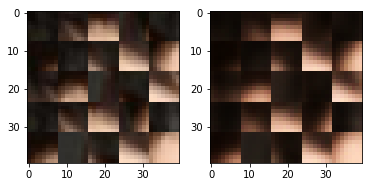

EPO: 15, recon_loss: 0.0027, total_loss: 0.0062
EPO: 15, recon_loss: 0.0059, total_loss: 0.0090
EPO: 15, recon_loss: 0.0084, total_loss: 0.0182
EPO: 15, recon_loss: 0.0062, total_loss: 0.0161
EPO: 15, recon_loss: 0.0093, total_loss: 0.0190
EPO: 15, recon_loss: 0.0127, total_loss: 0.0213
EPO: 15, recon_loss: 0.0085, total_loss: 0.0144
EPO: 15, recon_loss: 0.0072, total_loss: 0.0187
EPO: 15, recon_loss: 0.0028, total_loss: 0.0081
EPO: 15, recon_loss: 0.0078, total_loss: 0.0139
######### what? the reconstruction psnr is: 28.8077


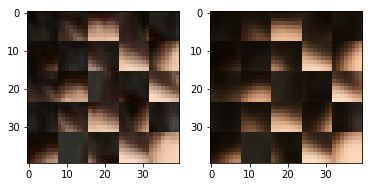

EPO: 15, recon_loss: 0.0043, total_loss: 0.0067
EPO: 15, recon_loss: 0.0037, total_loss: 0.0088
EPO: 15, recon_loss: 0.0019, total_loss: 0.0039
EPO: 15, recon_loss: 0.0022, total_loss: 0.0049
EPO: 15, recon_loss: 0.0058, total_loss: 0.0111
EPO: 15, recon_loss: 0.0038, total_loss: 0.0090
EPO: 15, recon_loss: 0.0050, total_loss: 0.0125
EPO: 15, recon_loss: 0.0022, total_loss: 0.0111
EPO: 15, recon_loss: 0.0022, total_loss: 0.0094
EPO: 15, recon_loss: 0.0062, total_loss: 0.0134
######### what? the reconstruction psnr is: 29.3029


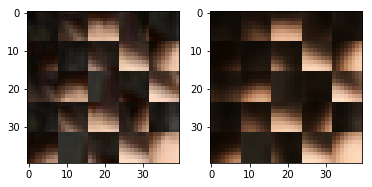

EPO: 15, recon_loss: 0.0017, total_loss: 0.0063
EPO: 15, recon_loss: 0.0045, total_loss: 0.0106
EPO: 15, recon_loss: 0.0079, total_loss: 0.0199
EPO: 15, recon_loss: 0.0027, total_loss: 0.0085
EPO: 15, recon_loss: 0.0110, total_loss: 0.0190
EPO: 15, recon_loss: 0.0053, total_loss: 0.0097
EPO: 15, recon_loss: 0.0045, total_loss: 0.0081
EPO: 15, recon_loss: 0.0107, total_loss: 0.0179
EPO: 15, recon_loss: 0.0041, total_loss: 0.0086
EPO: 15, recon_loss: 0.0067, total_loss: 0.0139
######### what? the reconstruction psnr is: 29.1236


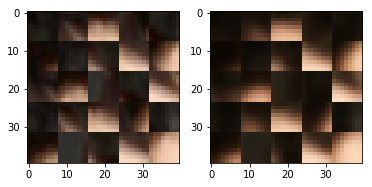

EPO: 15, recon_loss: 0.0054, total_loss: 0.0107
EPO: 15, recon_loss: 0.0067, total_loss: 0.0130
EPO: 15, recon_loss: 0.0171, total_loss: 0.0294
EPO: 15, recon_loss: 0.0145, total_loss: 0.0254
EPO: 15, recon_loss: 0.0126, total_loss: 0.0244
EPO: 15, recon_loss: 0.0141, total_loss: 0.0246
EPO: 15, recon_loss: 0.0089, total_loss: 0.0180
EPO: 15, recon_loss: 0.0086, total_loss: 0.0175
EPO: 15, recon_loss: 0.0047, total_loss: 0.0106
EPO: 15, recon_loss: 0.0073, total_loss: 0.0157
######### what? the reconstruction psnr is: 29.0050


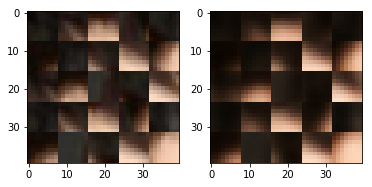

EPO: 15, recon_loss: 0.0103, total_loss: 0.0165
EPO: 15, recon_loss: 0.0094, total_loss: 0.0191
EPO: 15, recon_loss: 0.0122, total_loss: 0.0221
EPO: 15, recon_loss: 0.0025, total_loss: 0.0094
EPO: 15, recon_loss: 0.0077, total_loss: 0.0161
EPO: 15, recon_loss: 0.0107, total_loss: 0.0192
EPO: 15, recon_loss: 0.0041, total_loss: 0.0117
EPO: 15, recon_loss: 0.0085, total_loss: 0.0178
EPO: 15, recon_loss: 0.0076, total_loss: 0.0217
EPO: 15, recon_loss: 0.0105, total_loss: 0.0232
######### what? the reconstruction psnr is: 29.3275


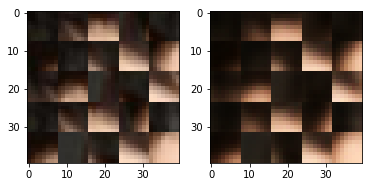

EPO: 15, recon_loss: 0.0194, total_loss: 0.0373
EPO: 15, recon_loss: 0.0064, total_loss: 0.0201
EPO: 15, recon_loss: 0.0122, total_loss: 0.0249
EPO: 15, recon_loss: 0.0084, total_loss: 0.0211
EPO: 15, recon_loss: 0.0101, total_loss: 0.0257
EPO: 15, recon_loss: 0.0196, total_loss: 0.0351
EPO: 15, recon_loss: 0.0159, total_loss: 0.0326
EPO: 15, recon_loss: 0.0134, total_loss: 0.0280
EPO: 15, recon_loss: 0.0033, total_loss: 0.0156
EPO: 15, recon_loss: 0.0122, total_loss: 0.0269
######### what? the reconstruction psnr is: 28.9874


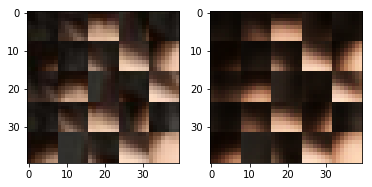

EPO: 15, recon_loss: 0.0256, total_loss: 0.0364
EPO: 15, recon_loss: 0.0140, total_loss: 0.0203
EPO: 15, recon_loss: 0.0056, total_loss: 0.0099
EPO: 15, recon_loss: 0.0029, total_loss: 0.0086
EPO: 15, recon_loss: 0.0038, total_loss: 0.0113
EPO: 15, recon_loss: 0.0118, total_loss: 0.0191
EPO: 15, recon_loss: 0.0047, total_loss: 0.0137
EPO: 15, recon_loss: 0.0103, total_loss: 0.0183
EPO: 15, recon_loss: 0.0011, total_loss: 0.0041
EPO: 15, recon_loss: 0.0008, total_loss: 0.0029
######### what? the reconstruction psnr is: 29.6239


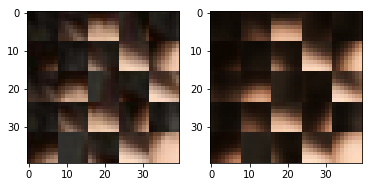

EPO: 15, recon_loss: 0.0028, total_loss: 0.0057
EPO: 15, recon_loss: 0.0013, total_loss: 0.0028
EPO: 15, recon_loss: 0.0024, total_loss: 0.0053
EPO: 15, recon_loss: 0.0053, total_loss: 0.0147
EPO: 15, recon_loss: 0.0033, total_loss: 0.0078
EPO: 15, recon_loss: 0.0075, total_loss: 0.0139
EPO: 15, recon_loss: 0.0037, total_loss: 0.0070
EPO: 15, recon_loss: 0.0044, total_loss: 0.0077
EPO: 15, recon_loss: 0.0078, total_loss: 0.0190
EPO: 15, recon_loss: 0.0097, total_loss: 0.0198
######### what? the reconstruction psnr is: 28.9247


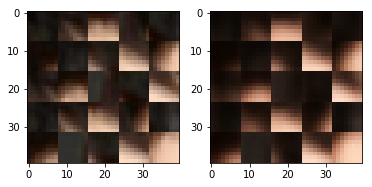

EPO: 15, recon_loss: 0.0099, total_loss: 0.0200
EPO: 15, recon_loss: 0.0109, total_loss: 0.0221
EPO: 15, recon_loss: 0.0049, total_loss: 0.0101
EPO: 15, recon_loss: 0.0072, total_loss: 0.0139
EPO: 15, recon_loss: 0.0042, total_loss: 0.0083
EPO: 15, recon_loss: 0.0067, total_loss: 0.0124
EPO: 15, recon_loss: 0.0038, total_loss: 0.0081
EPO: 15, recon_loss: 0.0041, total_loss: 0.0081
EPO: 15, recon_loss: 0.0044, total_loss: 0.0176
EPO: 15, recon_loss: 0.0018, total_loss: 0.0070
######### what? the reconstruction psnr is: 29.1724


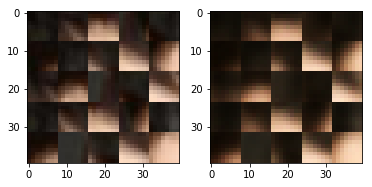

EPO: 15, recon_loss: 0.0072, total_loss: 0.0157
EPO: 15, recon_loss: 0.0052, total_loss: 0.0102
EPO: 15, recon_loss: 0.0062, total_loss: 0.0115
EPO: 15, recon_loss: 0.0027, total_loss: 0.0053
EPO: 15, recon_loss: 0.0016, total_loss: 0.0047
EPO: 15, recon_loss: 0.0033, total_loss: 0.0069
EPO: 15, recon_loss: 0.0029, total_loss: 0.0068
EPO: 15, recon_loss: 0.0029, total_loss: 0.0057
EPO: 15, recon_loss: 0.0048, total_loss: 0.0115
EPO: 15, recon_loss: 0.0032, total_loss: 0.0077
######### what? the reconstruction psnr is: 29.2371


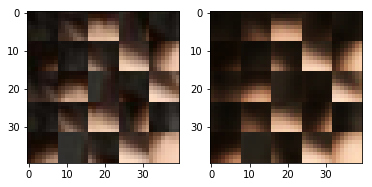

EPO: 15, recon_loss: 0.0073, total_loss: 0.0137
EPO: 15, recon_loss: 0.0050, total_loss: 0.0113
EPO: 15, recon_loss: 0.0043, total_loss: 0.0100
EPO: 15, recon_loss: 0.0048, total_loss: 0.0171
EPO: 15, recon_loss: 0.0048, total_loss: 0.0143
EPO: 15, recon_loss: 0.0133, total_loss: 0.0230
EPO: 15, recon_loss: 0.0105, total_loss: 0.0190
EPO: 15, recon_loss: 0.0051, total_loss: 0.0120
EPO: 15, recon_loss: 0.0177, total_loss: 0.0285
EPO: 15, recon_loss: 0.0012, total_loss: 0.0049
######### what? the reconstruction psnr is: 28.3603


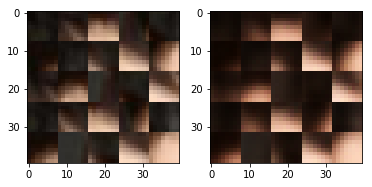

EPO: 15, recon_loss: 0.0033, total_loss: 0.0098
EPO: 15, recon_loss: 0.0103, total_loss: 0.0172
EPO: 15, recon_loss: 0.0057, total_loss: 0.0109
EPO: 15, recon_loss: 0.0048, total_loss: 0.0105
EPO: 15, recon_loss: 0.0065, total_loss: 0.0139
EPO: 15, recon_loss: 0.0075, total_loss: 0.0159
EPO: 15, recon_loss: 0.0089, total_loss: 0.0174
EPO: 15, recon_loss: 0.0022, total_loss: 0.0069
EPO: 15, recon_loss: 0.0098, total_loss: 0.0159
EPO: 15, recon_loss: 0.0033, total_loss: 0.0073
######### what? the reconstruction psnr is: 29.5096


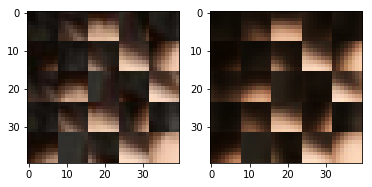

EPO: 15, recon_loss: 0.0092, total_loss: 0.0149
EPO: 15, recon_loss: 0.0089, total_loss: 0.0167
EPO: 15, recon_loss: 0.0042, total_loss: 0.0095
EPO: 15, recon_loss: 0.0049, total_loss: 0.0101
EPO: 15, recon_loss: 0.0072, total_loss: 0.0149
EPO: 15, recon_loss: 0.0045, total_loss: 0.0111
EPO: 15, recon_loss: 0.0126, total_loss: 0.0191
EPO: 15, recon_loss: 0.0054, total_loss: 0.0136
EPO: 15, recon_loss: 0.0079, total_loss: 0.0149
EPO: 15, recon_loss: 0.0066, total_loss: 0.0160
######### what? the reconstruction psnr is: 29.8892


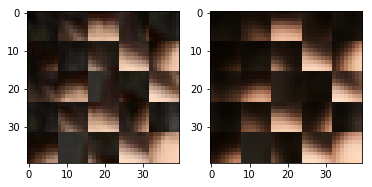

EPO: 15, recon_loss: 0.0014, total_loss: 0.0051
EPO: 15, recon_loss: 0.0075, total_loss: 0.0124
EPO: 15, recon_loss: 0.0042, total_loss: 0.0095
EPO: 15, recon_loss: 0.0054, total_loss: 0.0112
EPO: 15, recon_loss: 0.0047, total_loss: 0.0133
EPO: 15, recon_loss: 0.0051, total_loss: 0.0117
EPO: 15, recon_loss: 0.0124, total_loss: 0.0211
EPO: 15, recon_loss: 0.0041, total_loss: 0.0114
EPO: 15, recon_loss: 0.0099, total_loss: 0.0188
EPO: 15, recon_loss: 0.0062, total_loss: 0.0154
######### what? the reconstruction psnr is: 29.4162


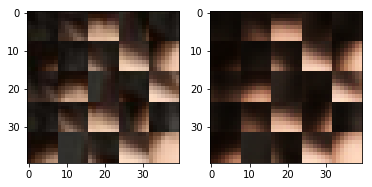

EPO: 15, recon_loss: 0.0022, total_loss: 0.0075
EPO: 15, recon_loss: 0.0087, total_loss: 0.0179
EPO: 15, recon_loss: 0.0035, total_loss: 0.0093
EPO: 15, recon_loss: 0.0077, total_loss: 0.0146
EPO: 15, recon_loss: 0.0032, total_loss: 0.0048
EPO: 15, recon_loss: 0.0024, total_loss: 0.0045
EPO: 15, recon_loss: 0.0055, total_loss: 0.0097
EPO: 15, recon_loss: 0.0036, total_loss: 0.0084
EPO: 15, recon_loss: 0.0039, total_loss: 0.0086
EPO: 15, recon_loss: 0.0135, total_loss: 0.0287
######### what? the reconstruction psnr is: 29.6709


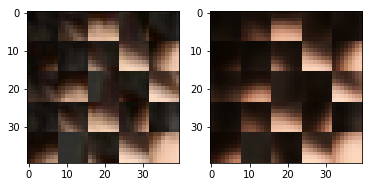

EPO: 15, recon_loss: 0.0097, total_loss: 0.0231
EPO: 15, recon_loss: 0.0116, total_loss: 0.0294
EPO: 15, recon_loss: 0.0079, total_loss: 0.0229
EPO: 15, recon_loss: 0.0108, total_loss: 0.0287
EPO: 15, recon_loss: 0.0031, total_loss: 0.0108
EPO: 15, recon_loss: 0.0036, total_loss: 0.0098
EPO: 15, recon_loss: 0.0104, total_loss: 0.0245
EPO: 15, recon_loss: 0.0047, total_loss: 0.0151
EPO: 15, recon_loss: 0.0049, total_loss: 0.0124
EPO: 15, recon_loss: 0.0051, total_loss: 0.0186
######### what? the reconstruction psnr is: 29.9056


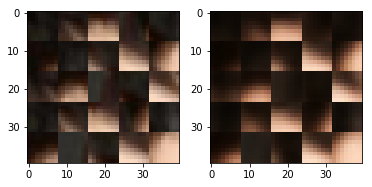

EPO: 15, recon_loss: 0.0052, total_loss: 0.0159
EPO: 15, recon_loss: 0.0091, total_loss: 0.0205
EPO: 15, recon_loss: 0.0048, total_loss: 0.0125
EPO: 15, recon_loss: 0.0043, total_loss: 0.0113
EPO: 15, recon_loss: 0.0062, total_loss: 0.0137
EPO: 15, recon_loss: 0.0031, total_loss: 0.0102
EPO: 15, recon_loss: 0.0113, total_loss: 0.0204
EPO: 15, recon_loss: 0.0049, total_loss: 0.0118
EPO: 15, recon_loss: 0.0032, total_loss: 0.0101
EPO: 15, recon_loss: 0.0056, total_loss: 0.0107
######### what? the reconstruction psnr is: 29.3740


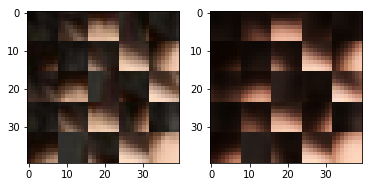

EPO: 15, recon_loss: 0.0027, total_loss: 0.0088
EPO: 15, recon_loss: 0.0082, total_loss: 0.0189
EPO: 15, recon_loss: 0.0084, total_loss: 0.0175
EPO: 15, recon_loss: 0.0059, total_loss: 0.0153
EPO: 15, recon_loss: 0.0111, total_loss: 0.0199
EPO: 15, recon_loss: 0.0021, total_loss: 0.0079
EPO: 15, recon_loss: 0.0068, total_loss: 0.0166
EPO: 15, recon_loss: 0.0079, total_loss: 0.0138
EPO: 15, recon_loss: 0.0065, total_loss: 0.0131
EPO: 15, recon_loss: 0.0068, total_loss: 0.0139
######### what? the reconstruction psnr is: 29.5806


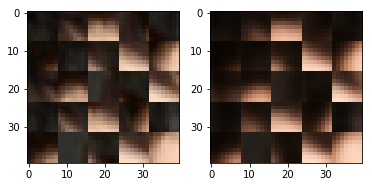

EPO: 15, recon_loss: 0.0024, total_loss: 0.0087
EPO: 15, recon_loss: 0.0038, total_loss: 0.0125
EPO: 15, recon_loss: 0.0033, total_loss: 0.0093
EPO: 15, recon_loss: 0.0033, total_loss: 0.0082
EPO: 15, recon_loss: 0.0033, total_loss: 0.0080
EPO: 15, recon_loss: 0.0129, total_loss: 0.0266
EPO: 15, recon_loss: 0.0092, total_loss: 0.0190
EPO: 15, recon_loss: 0.0086, total_loss: 0.0156
EPO: 15, recon_loss: 0.0087, total_loss: 0.0180
EPO: 15, recon_loss: 0.0054, total_loss: 0.0115
######### what? the reconstruction psnr is: 28.9346


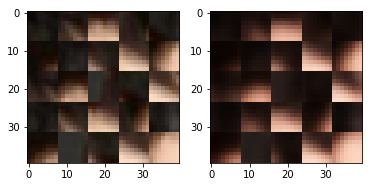

EPO: 15, recon_loss: 0.0068, total_loss: 0.0207
EPO: 15, recon_loss: 0.0038, total_loss: 0.0126
EPO: 15, recon_loss: 0.0097, total_loss: 0.0186
EPO: 15, recon_loss: 0.0040, total_loss: 0.0110
EPO: 15, recon_loss: 0.0091, total_loss: 0.0169
EPO: 15, recon_loss: 0.0019, total_loss: 0.0043
EPO: 15, recon_loss: 0.0013, total_loss: 0.0031
EPO: 15, recon_loss: 0.0064, total_loss: 0.0105
EPO: 15, recon_loss: 0.0019, total_loss: 0.0043
EPO: 15, recon_loss: 0.0039, total_loss: 0.0072
######### what? the reconstruction psnr is: 29.3483


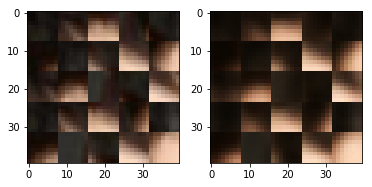

EPO: 15, recon_loss: 0.0057, total_loss: 0.0123
EPO: 15, recon_loss: 0.0045, total_loss: 0.0111
EPO: 15, recon_loss: 0.0059, total_loss: 0.0121
EPO: 15, recon_loss: 0.0030, total_loss: 0.0076
EPO: 15, recon_loss: 0.0039, total_loss: 0.0081
EPO: 15, recon_loss: 0.0070, total_loss: 0.0155
EPO: 15, recon_loss: 0.0065, total_loss: 0.0144
EPO: 15, recon_loss: 0.0112, total_loss: 0.0166
EPO: 15, recon_loss: 0.0080, total_loss: 0.0135
EPO: 15, recon_loss: 0.0076, total_loss: 0.0127
######### what? the reconstruction psnr is: 28.9256


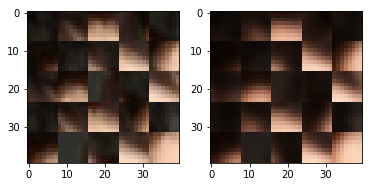

EPO: 15, recon_loss: 0.0105, total_loss: 0.0229
EPO: 15, recon_loss: 0.0208, total_loss: 0.0348
EPO: 15, recon_loss: 0.0103, total_loss: 0.0162
EPO: 15, recon_loss: 0.0167, total_loss: 0.0223
EPO: 15, recon_loss: 0.0115, total_loss: 0.0168
EPO: 15, recon_loss: 0.0029, total_loss: 0.0091
EPO: 15, recon_loss: 0.0018, total_loss: 0.0074
EPO: 15, recon_loss: 0.0058, total_loss: 0.0107
EPO: 15, recon_loss: 0.0033, total_loss: 0.0098
EPO: 15, recon_loss: 0.0048, total_loss: 0.0091
######### what? the reconstruction psnr is: 28.5008


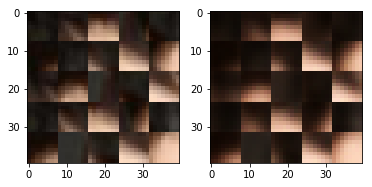

EPO: 15, recon_loss: 0.0044, total_loss: 0.0188
EPO: 15, recon_loss: 0.0018, total_loss: 0.0077
EPO: 15, recon_loss: 0.0041, total_loss: 0.0107
EPO: 15, recon_loss: 0.0018, total_loss: 0.0049
EPO: 15, recon_loss: 0.0015, total_loss: 0.0034
EPO: 15, recon_loss: 0.0059, total_loss: 0.0143
EPO: 15, recon_loss: 0.0066, total_loss: 0.0138
EPO: 15, recon_loss: 0.0074, total_loss: 0.0150
EPO: 15, recon_loss: 0.0108, total_loss: 0.0179
EPO: 15, recon_loss: 0.0145, total_loss: 0.0216
######### what? the reconstruction psnr is: 28.2765


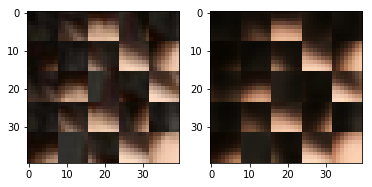

EPO: 16, recon_loss: 0.0051, total_loss: 0.0105
EPO: 16, recon_loss: 0.0024, total_loss: 0.0049
EPO: 16, recon_loss: 0.0077, total_loss: 0.0109
EPO: 16, recon_loss: 0.0043, total_loss: 0.0089
EPO: 16, recon_loss: 0.0031, total_loss: 0.0062
EPO: 16, recon_loss: 0.0049, total_loss: 0.0174
EPO: 16, recon_loss: 0.0020, total_loss: 0.0076
EPO: 16, recon_loss: 0.0045, total_loss: 0.0104
EPO: 16, recon_loss: 0.0063, total_loss: 0.0113
EPO: 16, recon_loss: 0.0060, total_loss: 0.0112
######### what? the reconstruction psnr is: 29.4776


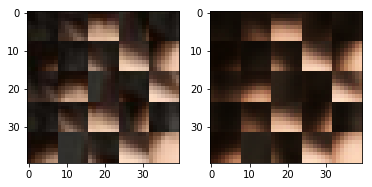

EPO: 16, recon_loss: 0.0067, total_loss: 0.0148
EPO: 16, recon_loss: 0.0028, total_loss: 0.0086
EPO: 16, recon_loss: 0.0039, total_loss: 0.0107
EPO: 16, recon_loss: 0.0033, total_loss: 0.0073
EPO: 16, recon_loss: 0.0042, total_loss: 0.0081
EPO: 16, recon_loss: 0.0117, total_loss: 0.0183
EPO: 16, recon_loss: 0.0042, total_loss: 0.0095
EPO: 16, recon_loss: 0.0048, total_loss: 0.0118
EPO: 16, recon_loss: 0.0052, total_loss: 0.0115
EPO: 16, recon_loss: 0.0042, total_loss: 0.0093
######### what? the reconstruction psnr is: 29.5415


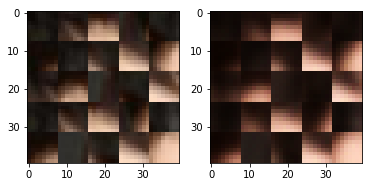

EPO: 16, recon_loss: 0.0043, total_loss: 0.0100
EPO: 16, recon_loss: 0.0040, total_loss: 0.0075
EPO: 16, recon_loss: 0.0044, total_loss: 0.0087
EPO: 16, recon_loss: 0.0100, total_loss: 0.0151
EPO: 16, recon_loss: 0.0027, total_loss: 0.0064
EPO: 16, recon_loss: 0.0064, total_loss: 0.0096
EPO: 16, recon_loss: 0.0102, total_loss: 0.0218
EPO: 16, recon_loss: 0.0045, total_loss: 0.0123
EPO: 16, recon_loss: 0.0104, total_loss: 0.0188
EPO: 16, recon_loss: 0.0086, total_loss: 0.0157
######### what? the reconstruction psnr is: 29.1402


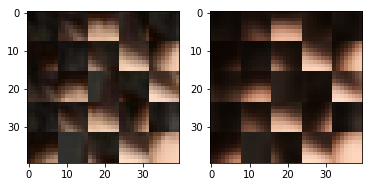

EPO: 16, recon_loss: 0.0138, total_loss: 0.0208
EPO: 16, recon_loss: 0.0064, total_loss: 0.0166
EPO: 16, recon_loss: 0.0030, total_loss: 0.0088
EPO: 16, recon_loss: 0.0070, total_loss: 0.0128
EPO: 16, recon_loss: 0.0054, total_loss: 0.0084
EPO: 16, recon_loss: 0.0050, total_loss: 0.0096
EPO: 16, recon_loss: 0.0016, total_loss: 0.0034
EPO: 16, recon_loss: 0.0022, total_loss: 0.0052
EPO: 16, recon_loss: 0.0069, total_loss: 0.0127
EPO: 16, recon_loss: 0.0034, total_loss: 0.0084
######### what? the reconstruction psnr is: 29.5428


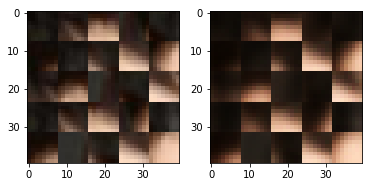

EPO: 16, recon_loss: 0.0051, total_loss: 0.0128
EPO: 16, recon_loss: 0.0020, total_loss: 0.0101
EPO: 16, recon_loss: 0.0026, total_loss: 0.0103
EPO: 16, recon_loss: 0.0066, total_loss: 0.0136
EPO: 16, recon_loss: 0.0015, total_loss: 0.0061
EPO: 16, recon_loss: 0.0054, total_loss: 0.0116
EPO: 16, recon_loss: 0.0105, total_loss: 0.0255
EPO: 16, recon_loss: 0.0027, total_loss: 0.0084
EPO: 16, recon_loss: 0.0151, total_loss: 0.0220
EPO: 16, recon_loss: 0.0036, total_loss: 0.0077
######### what? the reconstruction psnr is: 29.7261


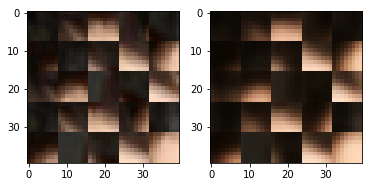

EPO: 16, recon_loss: 0.0039, total_loss: 0.0073
EPO: 16, recon_loss: 0.0081, total_loss: 0.0149
EPO: 16, recon_loss: 0.0036, total_loss: 0.0080
EPO: 16, recon_loss: 0.0077, total_loss: 0.0141
EPO: 16, recon_loss: 0.0044, total_loss: 0.0083
EPO: 16, recon_loss: 0.0069, total_loss: 0.0125
EPO: 16, recon_loss: 0.0187, total_loss: 0.0301
EPO: 16, recon_loss: 0.0096, total_loss: 0.0196
EPO: 16, recon_loss: 0.0179, total_loss: 0.0295
EPO: 16, recon_loss: 0.0108, total_loss: 0.0205
######### what? the reconstruction psnr is: 29.6280


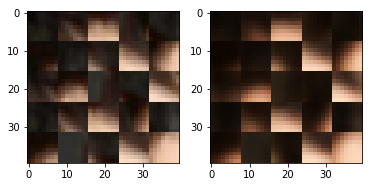

EPO: 16, recon_loss: 0.0092, total_loss: 0.0191
EPO: 16, recon_loss: 0.0040, total_loss: 0.0123
EPO: 16, recon_loss: 0.0045, total_loss: 0.0101
EPO: 16, recon_loss: 0.0065, total_loss: 0.0152
EPO: 16, recon_loss: 0.0071, total_loss: 0.0126
EPO: 16, recon_loss: 0.0074, total_loss: 0.0169
EPO: 16, recon_loss: 0.0048, total_loss: 0.0163
EPO: 16, recon_loss: 0.0020, total_loss: 0.0090
EPO: 16, recon_loss: 0.0096, total_loss: 0.0174
EPO: 16, recon_loss: 0.0054, total_loss: 0.0122
######### what? the reconstruction psnr is: 29.0827


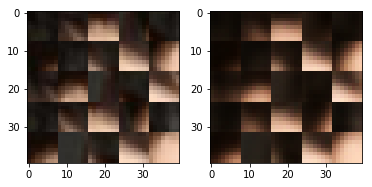

EPO: 16, recon_loss: 0.0047, total_loss: 0.0122
EPO: 16, recon_loss: 0.0090, total_loss: 0.0217
EPO: 16, recon_loss: 0.0069, total_loss: 0.0205
EPO: 16, recon_loss: 0.0158, total_loss: 0.0312
EPO: 16, recon_loss: 0.0141, total_loss: 0.0292
EPO: 16, recon_loss: 0.0067, total_loss: 0.0196
EPO: 16, recon_loss: 0.0223, total_loss: 0.0382
EPO: 16, recon_loss: 0.0072, total_loss: 0.0204
EPO: 16, recon_loss: 0.0125, total_loss: 0.0273
EPO: 16, recon_loss: 0.0172, total_loss: 0.0320
######### what? the reconstruction psnr is: 29.9565


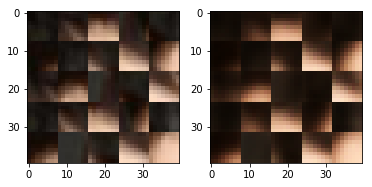

EPO: 16, recon_loss: 0.0113, total_loss: 0.0265
EPO: 16, recon_loss: 0.0129, total_loss: 0.0260
EPO: 16, recon_loss: 0.0030, total_loss: 0.0148
EPO: 16, recon_loss: 0.0159, total_loss: 0.0289
EPO: 16, recon_loss: 0.0177, total_loss: 0.0260
EPO: 16, recon_loss: 0.0054, total_loss: 0.0102
EPO: 16, recon_loss: 0.0046, total_loss: 0.0090
EPO: 16, recon_loss: 0.0025, total_loss: 0.0080
EPO: 16, recon_loss: 0.0042, total_loss: 0.0124
EPO: 16, recon_loss: 0.0077, total_loss: 0.0156
######### what? the reconstruction psnr is: 29.7891


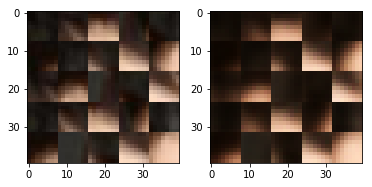

EPO: 16, recon_loss: 0.0052, total_loss: 0.0139
EPO: 16, recon_loss: 0.0096, total_loss: 0.0192
EPO: 16, recon_loss: 0.0007, total_loss: 0.0031
EPO: 16, recon_loss: 0.0010, total_loss: 0.0035
EPO: 16, recon_loss: 0.0026, total_loss: 0.0051
EPO: 16, recon_loss: 0.0012, total_loss: 0.0029
EPO: 16, recon_loss: 0.0035, total_loss: 0.0067
EPO: 16, recon_loss: 0.0037, total_loss: 0.0099
EPO: 16, recon_loss: 0.0047, total_loss: 0.0100
EPO: 16, recon_loss: 0.0083, total_loss: 0.0150
######### what? the reconstruction psnr is: 29.4260


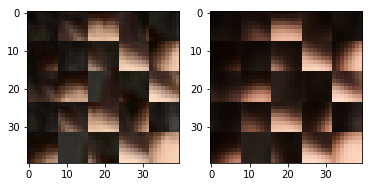

EPO: 16, recon_loss: 0.0036, total_loss: 0.0068
EPO: 16, recon_loss: 0.0056, total_loss: 0.0090
EPO: 16, recon_loss: 0.0078, total_loss: 0.0188
EPO: 16, recon_loss: 0.0133, total_loss: 0.0261
EPO: 16, recon_loss: 0.0095, total_loss: 0.0214
EPO: 16, recon_loss: 0.0067, total_loss: 0.0149
EPO: 16, recon_loss: 0.0075, total_loss: 0.0135
EPO: 16, recon_loss: 0.0053, total_loss: 0.0116
EPO: 16, recon_loss: 0.0044, total_loss: 0.0086
EPO: 16, recon_loss: 0.0064, total_loss: 0.0124
######### what? the reconstruction psnr is: 29.1107


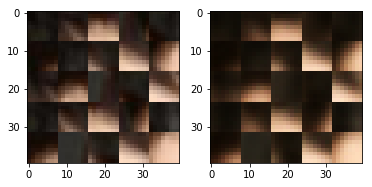

EPO: 16, recon_loss: 0.0030, total_loss: 0.0064
EPO: 16, recon_loss: 0.0041, total_loss: 0.0087
EPO: 16, recon_loss: 0.0044, total_loss: 0.0172
EPO: 16, recon_loss: 0.0014, total_loss: 0.0065
EPO: 16, recon_loss: 0.0097, total_loss: 0.0179
EPO: 16, recon_loss: 0.0058, total_loss: 0.0111
EPO: 16, recon_loss: 0.0058, total_loss: 0.0122
EPO: 16, recon_loss: 0.0023, total_loss: 0.0049
EPO: 16, recon_loss: 0.0017, total_loss: 0.0046
EPO: 16, recon_loss: 0.0040, total_loss: 0.0083
######### what? the reconstruction psnr is: 29.2111


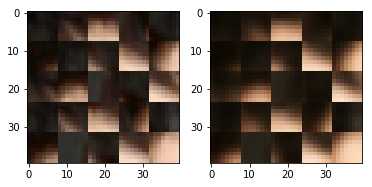

EPO: 16, recon_loss: 0.0015, total_loss: 0.0047
EPO: 16, recon_loss: 0.0021, total_loss: 0.0046
EPO: 16, recon_loss: 0.0043, total_loss: 0.0106
EPO: 16, recon_loss: 0.0029, total_loss: 0.0076
EPO: 16, recon_loss: 0.0099, total_loss: 0.0165
EPO: 16, recon_loss: 0.0043, total_loss: 0.0105
EPO: 16, recon_loss: 0.0035, total_loss: 0.0084
EPO: 16, recon_loss: 0.0042, total_loss: 0.0160
EPO: 16, recon_loss: 0.0044, total_loss: 0.0129
EPO: 16, recon_loss: 0.0153, total_loss: 0.0249
######### what? the reconstruction psnr is: 29.3959


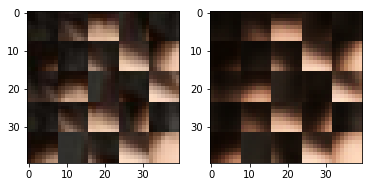

EPO: 16, recon_loss: 0.0058, total_loss: 0.0125
EPO: 16, recon_loss: 0.0077, total_loss: 0.0158
EPO: 16, recon_loss: 0.0026, total_loss: 0.0101
EPO: 16, recon_loss: 0.0008, total_loss: 0.0041
EPO: 16, recon_loss: 0.0055, total_loss: 0.0121
EPO: 16, recon_loss: 0.0068, total_loss: 0.0114
EPO: 16, recon_loss: 0.0060, total_loss: 0.0123
EPO: 16, recon_loss: 0.0061, total_loss: 0.0138
EPO: 16, recon_loss: 0.0092, total_loss: 0.0165
EPO: 16, recon_loss: 0.0072, total_loss: 0.0155
######### what? the reconstruction psnr is: 29.7109


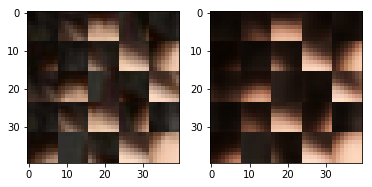

EPO: 16, recon_loss: 0.0068, total_loss: 0.0140
EPO: 16, recon_loss: 0.0022, total_loss: 0.0067
EPO: 16, recon_loss: 0.0088, total_loss: 0.0165
EPO: 16, recon_loss: 0.0028, total_loss: 0.0068
EPO: 16, recon_loss: 0.0086, total_loss: 0.0153
EPO: 16, recon_loss: 0.0087, total_loss: 0.0160
EPO: 16, recon_loss: 0.0042, total_loss: 0.0092
EPO: 16, recon_loss: 0.0043, total_loss: 0.0095
EPO: 16, recon_loss: 0.0054, total_loss: 0.0119
EPO: 16, recon_loss: 0.0049, total_loss: 0.0117
######### what? the reconstruction psnr is: 29.6362


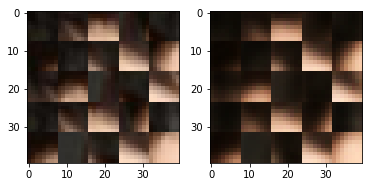

EPO: 16, recon_loss: 0.0099, total_loss: 0.0162
EPO: 16, recon_loss: 0.0059, total_loss: 0.0143
EPO: 16, recon_loss: 0.0093, total_loss: 0.0160
EPO: 16, recon_loss: 0.0050, total_loss: 0.0113
EPO: 16, recon_loss: 0.0021, total_loss: 0.0058
EPO: 16, recon_loss: 0.0049, total_loss: 0.0096
EPO: 16, recon_loss: 0.0044, total_loss: 0.0099
EPO: 16, recon_loss: 0.0071, total_loss: 0.0146
EPO: 16, recon_loss: 0.0047, total_loss: 0.0119
EPO: 16, recon_loss: 0.0055, total_loss: 0.0126
######### what? the reconstruction psnr is: 29.4199


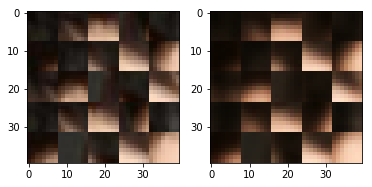

EPO: 16, recon_loss: 0.0146, total_loss: 0.0241
EPO: 16, recon_loss: 0.0043, total_loss: 0.0118
EPO: 16, recon_loss: 0.0117, total_loss: 0.0226
EPO: 16, recon_loss: 0.0034, total_loss: 0.0095
EPO: 16, recon_loss: 0.0022, total_loss: 0.0077
EPO: 16, recon_loss: 0.0089, total_loss: 0.0189
EPO: 16, recon_loss: 0.0044, total_loss: 0.0108
EPO: 16, recon_loss: 0.0105, total_loss: 0.0180
EPO: 16, recon_loss: 0.0030, total_loss: 0.0047
EPO: 16, recon_loss: 0.0021, total_loss: 0.0043
######### what? the reconstruction psnr is: 29.6001


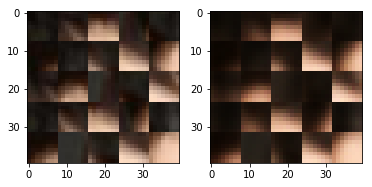

EPO: 16, recon_loss: 0.0060, total_loss: 0.0106
EPO: 16, recon_loss: 0.0024, total_loss: 0.0072
EPO: 16, recon_loss: 0.0048, total_loss: 0.0109
EPO: 16, recon_loss: 0.0128, total_loss: 0.0282
EPO: 16, recon_loss: 0.0097, total_loss: 0.0228
EPO: 16, recon_loss: 0.0150, total_loss: 0.0332
EPO: 16, recon_loss: 0.0074, total_loss: 0.0206
EPO: 16, recon_loss: 0.0133, total_loss: 0.0313
EPO: 16, recon_loss: 0.0029, total_loss: 0.0107
EPO: 16, recon_loss: 0.0060, total_loss: 0.0119
######### what? the reconstruction psnr is: 29.3364


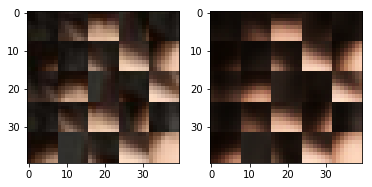

EPO: 16, recon_loss: 0.0085, total_loss: 0.0222
EPO: 16, recon_loss: 0.0047, total_loss: 0.0138
EPO: 16, recon_loss: 0.0048, total_loss: 0.0124
EPO: 16, recon_loss: 0.0049, total_loss: 0.0179
EPO: 16, recon_loss: 0.0054, total_loss: 0.0162
EPO: 16, recon_loss: 0.0131, total_loss: 0.0241
EPO: 16, recon_loss: 0.0030, total_loss: 0.0103
EPO: 16, recon_loss: 0.0031, total_loss: 0.0096
EPO: 16, recon_loss: 0.0062, total_loss: 0.0149
EPO: 16, recon_loss: 0.0023, total_loss: 0.0094
######### what? the reconstruction psnr is: 29.9725


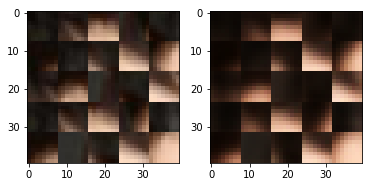

EPO: 16, recon_loss: 0.0124, total_loss: 0.0213
EPO: 16, recon_loss: 0.0029, total_loss: 0.0097
EPO: 16, recon_loss: 0.0038, total_loss: 0.0104
EPO: 16, recon_loss: 0.0053, total_loss: 0.0102
EPO: 16, recon_loss: 0.0027, total_loss: 0.0095
EPO: 16, recon_loss: 0.0124, total_loss: 0.0217
EPO: 16, recon_loss: 0.0065, total_loss: 0.0160
EPO: 16, recon_loss: 0.0053, total_loss: 0.0127
EPO: 16, recon_loss: 0.0062, total_loss: 0.0211
EPO: 16, recon_loss: 0.0019, total_loss: 0.0078
######### what? the reconstruction psnr is: 29.9264


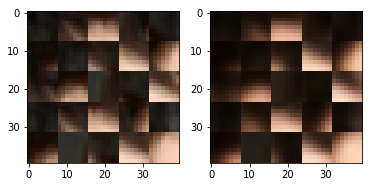

EPO: 16, recon_loss: 0.0096, total_loss: 0.0215
EPO: 16, recon_loss: 0.0054, total_loss: 0.0097
EPO: 16, recon_loss: 0.0055, total_loss: 0.0118
EPO: 16, recon_loss: 0.0042, total_loss: 0.0133
EPO: 16, recon_loss: 0.0022, total_loss: 0.0085
EPO: 16, recon_loss: 0.0050, total_loss: 0.0134
EPO: 16, recon_loss: 0.0025, total_loss: 0.0078
EPO: 16, recon_loss: 0.0042, total_loss: 0.0092
EPO: 16, recon_loss: 0.0094, total_loss: 0.0197
EPO: 16, recon_loss: 0.0139, total_loss: 0.0269
######### what? the reconstruction psnr is: 29.0089


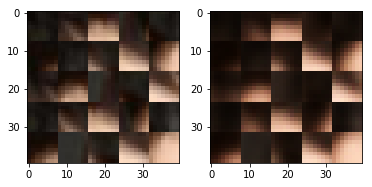

EPO: 16, recon_loss: 0.0078, total_loss: 0.0166
EPO: 16, recon_loss: 0.0079, total_loss: 0.0166
EPO: 16, recon_loss: 0.0086, total_loss: 0.0177
EPO: 16, recon_loss: 0.0046, total_loss: 0.0093
EPO: 16, recon_loss: 0.0050, total_loss: 0.0167
EPO: 16, recon_loss: 0.0048, total_loss: 0.0137
EPO: 16, recon_loss: 0.0075, total_loss: 0.0166
EPO: 16, recon_loss: 0.0055, total_loss: 0.0130
EPO: 16, recon_loss: 0.0103, total_loss: 0.0191
EPO: 16, recon_loss: 0.0014, total_loss: 0.0032
######### what? the reconstruction psnr is: 29.7106


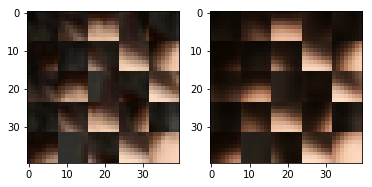

EPO: 16, recon_loss: 0.0026, total_loss: 0.0059
EPO: 16, recon_loss: 0.0042, total_loss: 0.0072
EPO: 16, recon_loss: 0.0017, total_loss: 0.0040
EPO: 16, recon_loss: 0.0042, total_loss: 0.0079
EPO: 16, recon_loss: 0.0062, total_loss: 0.0139
EPO: 16, recon_loss: 0.0044, total_loss: 0.0108
EPO: 16, recon_loss: 0.0054, total_loss: 0.0119
EPO: 16, recon_loss: 0.0037, total_loss: 0.0081
EPO: 16, recon_loss: 0.0053, total_loss: 0.0101
EPO: 16, recon_loss: 0.0061, total_loss: 0.0137
######### what? the reconstruction psnr is: 29.4767


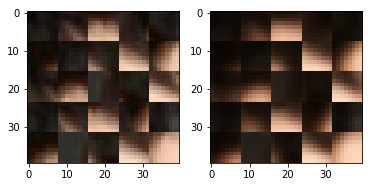

EPO: 16, recon_loss: 0.0058, total_loss: 0.0136
EPO: 16, recon_loss: 0.0119, total_loss: 0.0174
EPO: 16, recon_loss: 0.0063, total_loss: 0.0120
EPO: 16, recon_loss: 0.0092, total_loss: 0.0149
EPO: 16, recon_loss: 0.0142, total_loss: 0.0277
EPO: 16, recon_loss: 0.0139, total_loss: 0.0223
EPO: 16, recon_loss: 0.0094, total_loss: 0.0156
EPO: 16, recon_loss: 0.0133, total_loss: 0.0180
EPO: 16, recon_loss: 0.0125, total_loss: 0.0175
EPO: 16, recon_loss: 0.0020, total_loss: 0.0070
######### what? the reconstruction psnr is: 28.6688


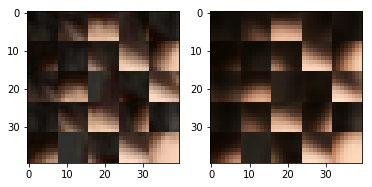

EPO: 16, recon_loss: 0.0027, total_loss: 0.0084
EPO: 16, recon_loss: 0.0073, total_loss: 0.0115
EPO: 16, recon_loss: 0.0045, total_loss: 0.0117
EPO: 16, recon_loss: 0.0073, total_loss: 0.0126
EPO: 16, recon_loss: 0.0041, total_loss: 0.0167
EPO: 16, recon_loss: 0.0017, total_loss: 0.0075
EPO: 16, recon_loss: 0.0063, total_loss: 0.0126
EPO: 16, recon_loss: 0.0011, total_loss: 0.0035
EPO: 16, recon_loss: 0.0019, total_loss: 0.0038
EPO: 16, recon_loss: 0.0067, total_loss: 0.0143
######### what? the reconstruction psnr is: 29.5573


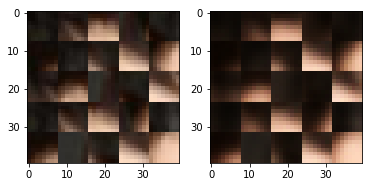

EPO: 16, recon_loss: 0.0064, total_loss: 0.0140
EPO: 16, recon_loss: 0.0086, total_loss: 0.0163
EPO: 16, recon_loss: 0.0131, total_loss: 0.0199
EPO: 16, recon_loss: 0.0129, total_loss: 0.0188
EPO: 17, recon_loss: 0.0036, total_loss: 0.0077
EPO: 17, recon_loss: 0.0023, total_loss: 0.0048
EPO: 17, recon_loss: 0.0094, total_loss: 0.0129
EPO: 17, recon_loss: 0.0026, total_loss: 0.0057
EPO: 17, recon_loss: 0.0028, total_loss: 0.0055
EPO: 17, recon_loss: 0.0035, total_loss: 0.0129
######### what? the reconstruction psnr is: 29.8284


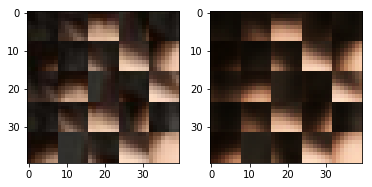

EPO: 17, recon_loss: 0.0020, total_loss: 0.0075
EPO: 17, recon_loss: 0.0037, total_loss: 0.0094
EPO: 17, recon_loss: 0.0031, total_loss: 0.0063
EPO: 17, recon_loss: 0.0067, total_loss: 0.0123
EPO: 17, recon_loss: 0.0030, total_loss: 0.0119
EPO: 17, recon_loss: 0.0023, total_loss: 0.0074
EPO: 17, recon_loss: 0.0036, total_loss: 0.0099
EPO: 17, recon_loss: 0.0030, total_loss: 0.0061
EPO: 17, recon_loss: 0.0043, total_loss: 0.0090
EPO: 17, recon_loss: 0.0044, total_loss: 0.0104
######### what? the reconstruction psnr is: 29.9909


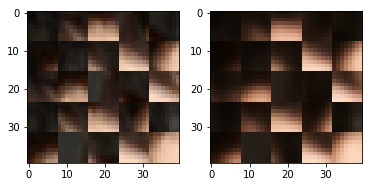

EPO: 17, recon_loss: 0.0048, total_loss: 0.0111
EPO: 17, recon_loss: 0.0044, total_loss: 0.0100
EPO: 17, recon_loss: 0.0043, total_loss: 0.0100
EPO: 17, recon_loss: 0.0035, total_loss: 0.0077
EPO: 17, recon_loss: 0.0046, total_loss: 0.0083
EPO: 17, recon_loss: 0.0029, total_loss: 0.0066
EPO: 17, recon_loss: 0.0049, total_loss: 0.0099
EPO: 17, recon_loss: 0.0083, total_loss: 0.0134
EPO: 17, recon_loss: 0.0028, total_loss: 0.0058
EPO: 17, recon_loss: 0.0063, total_loss: 0.0118
######### what? the reconstruction psnr is: 29.7629


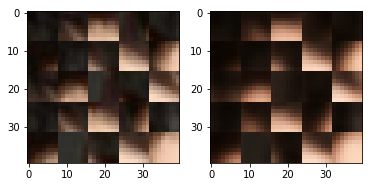

EPO: 17, recon_loss: 0.0050, total_loss: 0.0125
EPO: 17, recon_loss: 0.0050, total_loss: 0.0125
EPO: 17, recon_loss: 0.0098, total_loss: 0.0179
EPO: 17, recon_loss: 0.0095, total_loss: 0.0186
EPO: 17, recon_loss: 0.0095, total_loss: 0.0154
EPO: 17, recon_loss: 0.0049, total_loss: 0.0124
EPO: 17, recon_loss: 0.0039, total_loss: 0.0109
EPO: 17, recon_loss: 0.0064, total_loss: 0.0112
EPO: 17, recon_loss: 0.0048, total_loss: 0.0080
EPO: 17, recon_loss: 0.0057, total_loss: 0.0114
######### what? the reconstruction psnr is: 28.9353


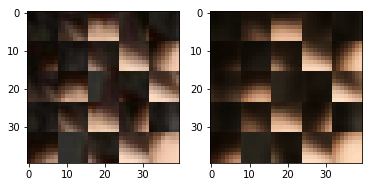

EPO: 17, recon_loss: 0.0015, total_loss: 0.0033
EPO: 17, recon_loss: 0.0033, total_loss: 0.0079
EPO: 17, recon_loss: 0.0058, total_loss: 0.0106
EPO: 17, recon_loss: 0.0040, total_loss: 0.0091
EPO: 17, recon_loss: 0.0066, total_loss: 0.0144
EPO: 17, recon_loss: 0.0020, total_loss: 0.0098
EPO: 17, recon_loss: 0.0021, total_loss: 0.0093
EPO: 17, recon_loss: 0.0069, total_loss: 0.0131
EPO: 17, recon_loss: 0.0016, total_loss: 0.0062
EPO: 17, recon_loss: 0.0067, total_loss: 0.0134
######### what? the reconstruction psnr is: 29.5783


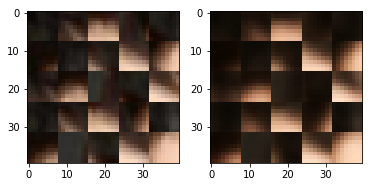

EPO: 17, recon_loss: 0.0097, total_loss: 0.0248
EPO: 17, recon_loss: 0.0035, total_loss: 0.0096
EPO: 17, recon_loss: 0.0101, total_loss: 0.0164
EPO: 17, recon_loss: 0.0030, total_loss: 0.0064
EPO: 17, recon_loss: 0.0053, total_loss: 0.0091
EPO: 17, recon_loss: 0.0072, total_loss: 0.0143
EPO: 17, recon_loss: 0.0029, total_loss: 0.0070
EPO: 17, recon_loss: 0.0069, total_loss: 0.0135
EPO: 17, recon_loss: 0.0043, total_loss: 0.0081
EPO: 17, recon_loss: 0.0078, total_loss: 0.0150
######### what? the reconstruction psnr is: 29.7071


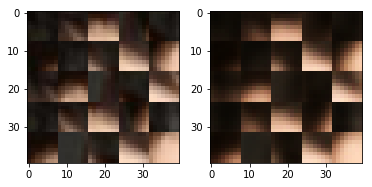

EPO: 17, recon_loss: 0.0109, total_loss: 0.0203
EPO: 17, recon_loss: 0.0107, total_loss: 0.0209
EPO: 17, recon_loss: 0.0222, total_loss: 0.0338
EPO: 17, recon_loss: 0.0125, total_loss: 0.0228
EPO: 17, recon_loss: 0.0091, total_loss: 0.0182
EPO: 17, recon_loss: 0.0037, total_loss: 0.0111
EPO: 17, recon_loss: 0.0045, total_loss: 0.0108
EPO: 17, recon_loss: 0.0072, total_loss: 0.0141
EPO: 17, recon_loss: 0.0051, total_loss: 0.0106
EPO: 17, recon_loss: 0.0074, total_loss: 0.0157
######### what? the reconstruction psnr is: 29.8702


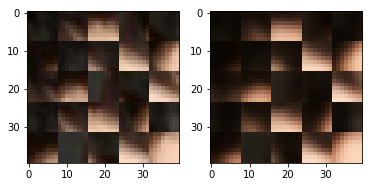

EPO: 17, recon_loss: 0.0040, total_loss: 0.0129
EPO: 17, recon_loss: 0.0020, total_loss: 0.0088
EPO: 17, recon_loss: 0.0100, total_loss: 0.0166
EPO: 17, recon_loss: 0.0038, total_loss: 0.0111
EPO: 17, recon_loss: 0.0045, total_loss: 0.0110
EPO: 17, recon_loss: 0.0092, total_loss: 0.0219
EPO: 17, recon_loss: 0.0072, total_loss: 0.0228
EPO: 17, recon_loss: 0.0167, total_loss: 0.0311
EPO: 17, recon_loss: 0.0086, total_loss: 0.0221
EPO: 17, recon_loss: 0.0071, total_loss: 0.0194
######### what? the reconstruction psnr is: 29.5927


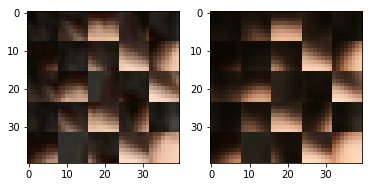

EPO: 17, recon_loss: 0.0128, total_loss: 0.0253
EPO: 17, recon_loss: 0.0072, total_loss: 0.0203
EPO: 17, recon_loss: 0.0188, total_loss: 0.0349
EPO: 17, recon_loss: 0.0125, total_loss: 0.0267
EPO: 17, recon_loss: 0.0112, total_loss: 0.0262
EPO: 17, recon_loss: 0.0044, total_loss: 0.0165
EPO: 17, recon_loss: 0.0042, total_loss: 0.0168
EPO: 17, recon_loss: 0.0192, total_loss: 0.0307
EPO: 17, recon_loss: 0.0199, total_loss: 0.0270
EPO: 17, recon_loss: 0.0036, total_loss: 0.0076
######### what? the reconstruction psnr is: 29.2647


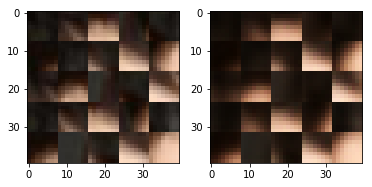

EPO: 17, recon_loss: 0.0045, total_loss: 0.0092
EPO: 17, recon_loss: 0.0027, total_loss: 0.0093
EPO: 17, recon_loss: 0.0061, total_loss: 0.0136
EPO: 17, recon_loss: 0.0063, total_loss: 0.0139
EPO: 17, recon_loss: 0.0054, total_loss: 0.0152
EPO: 17, recon_loss: 0.0122, total_loss: 0.0224
EPO: 17, recon_loss: 0.0007, total_loss: 0.0030
EPO: 17, recon_loss: 0.0011, total_loss: 0.0038
EPO: 17, recon_loss: 0.0020, total_loss: 0.0039
EPO: 17, recon_loss: 0.0013, total_loss: 0.0030
######### what? the reconstruction psnr is: 29.8263


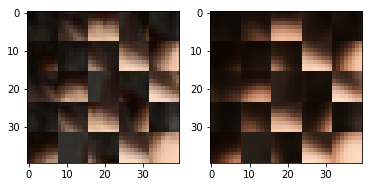

EPO: 17, recon_loss: 0.0043, total_loss: 0.0078
EPO: 17, recon_loss: 0.0034, total_loss: 0.0087
EPO: 17, recon_loss: 0.0051, total_loss: 0.0111
EPO: 17, recon_loss: 0.0083, total_loss: 0.0145
EPO: 17, recon_loss: 0.0035, total_loss: 0.0066
EPO: 17, recon_loss: 0.0088, total_loss: 0.0131
EPO: 17, recon_loss: 0.0077, total_loss: 0.0187
EPO: 17, recon_loss: 0.0114, total_loss: 0.0228
EPO: 17, recon_loss: 0.0089, total_loss: 0.0201
EPO: 17, recon_loss: 0.0062, total_loss: 0.0134
######### what? the reconstruction psnr is: 29.3566


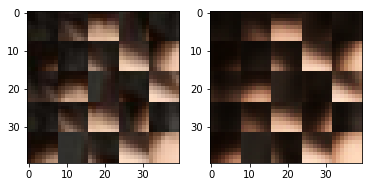

EPO: 17, recon_loss: 0.0086, total_loss: 0.0152
EPO: 17, recon_loss: 0.0055, total_loss: 0.0117
EPO: 17, recon_loss: 0.0044, total_loss: 0.0085
EPO: 17, recon_loss: 0.0064, total_loss: 0.0123
EPO: 17, recon_loss: 0.0043, total_loss: 0.0085
EPO: 17, recon_loss: 0.0056, total_loss: 0.0110
EPO: 17, recon_loss: 0.0041, total_loss: 0.0151
EPO: 17, recon_loss: 0.0024, total_loss: 0.0067
EPO: 17, recon_loss: 0.0078, total_loss: 0.0146
EPO: 17, recon_loss: 0.0061, total_loss: 0.0114
######### what? the reconstruction psnr is: 29.5341


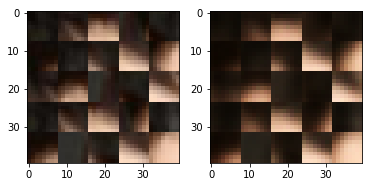

EPO: 17, recon_loss: 0.0073, total_loss: 0.0157
EPO: 17, recon_loss: 0.0021, total_loss: 0.0049
EPO: 17, recon_loss: 0.0019, total_loss: 0.0049
EPO: 17, recon_loss: 0.0038, total_loss: 0.0081
EPO: 17, recon_loss: 0.0012, total_loss: 0.0041
EPO: 17, recon_loss: 0.0020, total_loss: 0.0045
EPO: 17, recon_loss: 0.0041, total_loss: 0.0095
EPO: 17, recon_loss: 0.0028, total_loss: 0.0073
EPO: 17, recon_loss: 0.0110, total_loss: 0.0184
EPO: 17, recon_loss: 0.0050, total_loss: 0.0117
######### what? the reconstruction psnr is: 29.5392


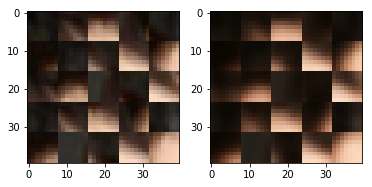

EPO: 17, recon_loss: 0.0034, total_loss: 0.0077
EPO: 17, recon_loss: 0.0034, total_loss: 0.0123
EPO: 17, recon_loss: 0.0039, total_loss: 0.0115
EPO: 17, recon_loss: 0.0156, total_loss: 0.0257
EPO: 17, recon_loss: 0.0047, total_loss: 0.0109
EPO: 17, recon_loss: 0.0117, total_loss: 0.0198
EPO: 17, recon_loss: 0.0016, total_loss: 0.0076
EPO: 17, recon_loss: 0.0007, total_loss: 0.0040
EPO: 17, recon_loss: 0.0096, total_loss: 0.0168
EPO: 17, recon_loss: 0.0058, total_loss: 0.0098
######### what? the reconstruction psnr is: 28.8360


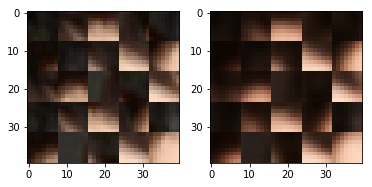

EPO: 17, recon_loss: 0.0059, total_loss: 0.0109
EPO: 17, recon_loss: 0.0062, total_loss: 0.0128
EPO: 17, recon_loss: 0.0080, total_loss: 0.0163
EPO: 17, recon_loss: 0.0092, total_loss: 0.0161
EPO: 17, recon_loss: 0.0040, total_loss: 0.0096
EPO: 17, recon_loss: 0.0025, total_loss: 0.0066
EPO: 17, recon_loss: 0.0051, total_loss: 0.0113
EPO: 17, recon_loss: 0.0022, total_loss: 0.0064
EPO: 17, recon_loss: 0.0097, total_loss: 0.0183
EPO: 17, recon_loss: 0.0030, total_loss: 0.0078
######### what? the reconstruction psnr is: 29.4615


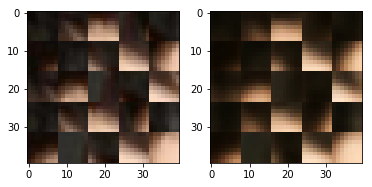

EPO: 17, recon_loss: 0.0036, total_loss: 0.0084
EPO: 17, recon_loss: 0.0068, total_loss: 0.0138
EPO: 17, recon_loss: 0.0047, total_loss: 0.0114
EPO: 17, recon_loss: 0.0051, total_loss: 0.0118
EPO: 17, recon_loss: 0.0078, total_loss: 0.0139
EPO: 17, recon_loss: 0.0064, total_loss: 0.0146
EPO: 17, recon_loss: 0.0066, total_loss: 0.0223
EPO: 17, recon_loss: 0.0039, total_loss: 0.0087
EPO: 17, recon_loss: 0.0032, total_loss: 0.0078
EPO: 17, recon_loss: 0.0033, total_loss: 0.0074
######### what? the reconstruction psnr is: 29.9465


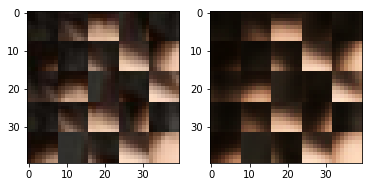

EPO: 17, recon_loss: 0.0059, total_loss: 0.0123
EPO: 17, recon_loss: 0.0054, total_loss: 0.0124
EPO: 17, recon_loss: 0.0031, total_loss: 0.0089
EPO: 17, recon_loss: 0.0084, total_loss: 0.0155
EPO: 17, recon_loss: 0.0113, total_loss: 0.0203
EPO: 17, recon_loss: 0.0055, total_loss: 0.0147
EPO: 17, recon_loss: 0.0118, total_loss: 0.0219
EPO: 17, recon_loss: 0.0028, total_loss: 0.0088
EPO: 17, recon_loss: 0.0035, total_loss: 0.0100
EPO: 17, recon_loss: 0.0073, total_loss: 0.0158
######### what? the reconstruction psnr is: 29.6875


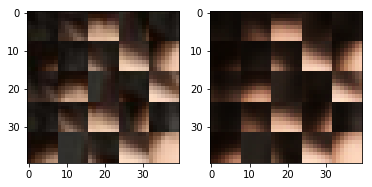

EPO: 17, recon_loss: 0.0053, total_loss: 0.0118
EPO: 17, recon_loss: 0.0101, total_loss: 0.0177
EPO: 17, recon_loss: 0.0027, total_loss: 0.0045
EPO: 17, recon_loss: 0.0021, total_loss: 0.0044
EPO: 17, recon_loss: 0.0066, total_loss: 0.0125
EPO: 17, recon_loss: 0.0025, total_loss: 0.0074
EPO: 17, recon_loss: 0.0050, total_loss: 0.0106
EPO: 17, recon_loss: 0.0141, total_loss: 0.0280
EPO: 17, recon_loss: 0.0074, total_loss: 0.0209
EPO: 17, recon_loss: 0.0180, total_loss: 0.0344
######### what? the reconstruction psnr is: 30.1003


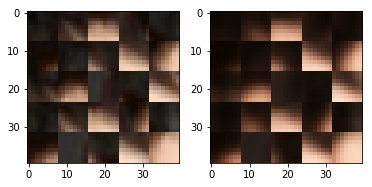

EPO: 17, recon_loss: 0.0082, total_loss: 0.0230
EPO: 17, recon_loss: 0.0131, total_loss: 0.0317
EPO: 17, recon_loss: 0.0033, total_loss: 0.0126
EPO: 17, recon_loss: 0.0060, total_loss: 0.0112
EPO: 17, recon_loss: 0.0070, total_loss: 0.0195
EPO: 17, recon_loss: 0.0044, total_loss: 0.0125
EPO: 17, recon_loss: 0.0054, total_loss: 0.0131
EPO: 17, recon_loss: 0.0051, total_loss: 0.0184
EPO: 17, recon_loss: 0.0054, total_loss: 0.0143
EPO: 17, recon_loss: 0.0155, total_loss: 0.0258
######### what? the reconstruction psnr is: 30.2650


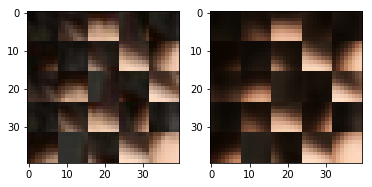

EPO: 17, recon_loss: 0.0031, total_loss: 0.0103
EPO: 17, recon_loss: 0.0031, total_loss: 0.0107
EPO: 17, recon_loss: 0.0052, total_loss: 0.0137
EPO: 17, recon_loss: 0.0020, total_loss: 0.0097
EPO: 17, recon_loss: 0.0135, total_loss: 0.0224
EPO: 17, recon_loss: 0.0026, total_loss: 0.0092
EPO: 17, recon_loss: 0.0048, total_loss: 0.0125
EPO: 17, recon_loss: 0.0040, total_loss: 0.0090
EPO: 17, recon_loss: 0.0032, total_loss: 0.0114
EPO: 17, recon_loss: 0.0159, total_loss: 0.0237
######### what? the reconstruction psnr is: 29.8333


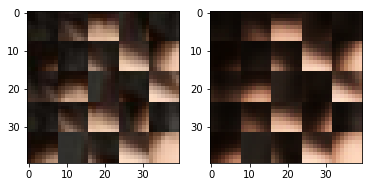

EPO: 17, recon_loss: 0.0044, total_loss: 0.0126
EPO: 17, recon_loss: 0.0047, total_loss: 0.0106
EPO: 17, recon_loss: 0.0047, total_loss: 0.0167
EPO: 17, recon_loss: 0.0020, total_loss: 0.0078
EPO: 17, recon_loss: 0.0123, total_loss: 0.0230
EPO: 17, recon_loss: 0.0028, total_loss: 0.0059
EPO: 17, recon_loss: 0.0063, total_loss: 0.0131
EPO: 17, recon_loss: 0.0035, total_loss: 0.0126
EPO: 17, recon_loss: 0.0021, total_loss: 0.0082
EPO: 17, recon_loss: 0.0061, total_loss: 0.0137
######### what? the reconstruction psnr is: 29.9883


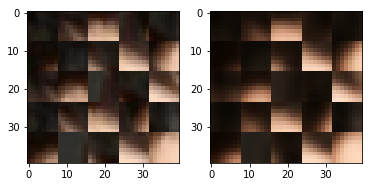

EPO: 17, recon_loss: 0.0018, total_loss: 0.0063
EPO: 17, recon_loss: 0.0044, total_loss: 0.0097
EPO: 17, recon_loss: 0.0136, total_loss: 0.0282
EPO: 17, recon_loss: 0.0112, total_loss: 0.0240
EPO: 17, recon_loss: 0.0058, total_loss: 0.0130
EPO: 17, recon_loss: 0.0066, total_loss: 0.0157
EPO: 17, recon_loss: 0.0057, total_loss: 0.0120
EPO: 17, recon_loss: 0.0082, total_loss: 0.0226
EPO: 17, recon_loss: 0.0036, total_loss: 0.0143
EPO: 17, recon_loss: 0.0046, total_loss: 0.0123
######### what? the reconstruction psnr is: 29.3494


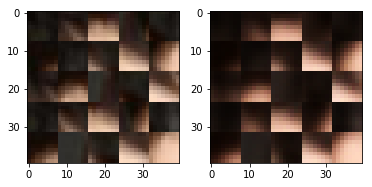

EPO: 17, recon_loss: 0.0058, total_loss: 0.0134
EPO: 17, recon_loss: 0.0072, total_loss: 0.0160
EPO: 17, recon_loss: 0.0038, total_loss: 0.0096
EPO: 17, recon_loss: 0.0011, total_loss: 0.0029
EPO: 17, recon_loss: 0.0036, total_loss: 0.0074
EPO: 17, recon_loss: 0.0028, total_loss: 0.0052
EPO: 17, recon_loss: 0.0020, total_loss: 0.0043
EPO: 17, recon_loss: 0.0050, total_loss: 0.0088
EPO: 17, recon_loss: 0.0047, total_loss: 0.0109
EPO: 17, recon_loss: 0.0063, total_loss: 0.0129
######### what? the reconstruction psnr is: 29.5936


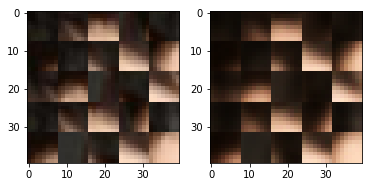

EPO: 17, recon_loss: 0.0046, total_loss: 0.0104
EPO: 17, recon_loss: 0.0038, total_loss: 0.0076
EPO: 17, recon_loss: 0.0063, total_loss: 0.0114
EPO: 17, recon_loss: 0.0055, total_loss: 0.0126
EPO: 17, recon_loss: 0.0076, total_loss: 0.0160
EPO: 17, recon_loss: 0.0091, total_loss: 0.0141
EPO: 17, recon_loss: 0.0068, total_loss: 0.0128
EPO: 17, recon_loss: 0.0113, total_loss: 0.0170
EPO: 17, recon_loss: 0.0126, total_loss: 0.0256
EPO: 17, recon_loss: 0.0104, total_loss: 0.0165
######### what? the reconstruction psnr is: 29.0555


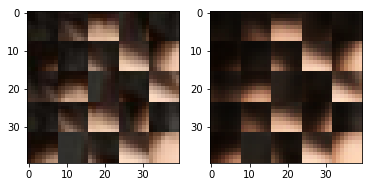

EPO: 17, recon_loss: 0.0095, total_loss: 0.0151
EPO: 17, recon_loss: 0.0111, total_loss: 0.0158
EPO: 17, recon_loss: 0.0132, total_loss: 0.0184
EPO: 17, recon_loss: 0.0017, total_loss: 0.0066
EPO: 17, recon_loss: 0.0028, total_loss: 0.0084
EPO: 17, recon_loss: 0.0081, total_loss: 0.0127
EPO: 17, recon_loss: 0.0060, total_loss: 0.0137
EPO: 17, recon_loss: 0.0134, total_loss: 0.0210
EPO: 17, recon_loss: 0.0035, total_loss: 0.0136
EPO: 17, recon_loss: 0.0028, total_loss: 0.0076
######### what? the reconstruction psnr is: 29.5614


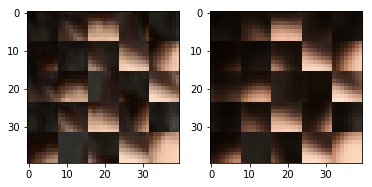

EPO: 17, recon_loss: 0.0058, total_loss: 0.0111
EPO: 17, recon_loss: 0.0011, total_loss: 0.0032
EPO: 17, recon_loss: 0.0029, total_loss: 0.0055
EPO: 17, recon_loss: 0.0066, total_loss: 0.0138
EPO: 17, recon_loss: 0.0068, total_loss: 0.0141
EPO: 17, recon_loss: 0.0147, total_loss: 0.0227
EPO: 17, recon_loss: 0.0142, total_loss: 0.0210
EPO: 17, recon_loss: 0.0108, total_loss: 0.0155
EPO: 18, recon_loss: 0.0027, total_loss: 0.0056
EPO: 18, recon_loss: 0.0023, total_loss: 0.0046
######### what? the reconstruction psnr is: 29.6288


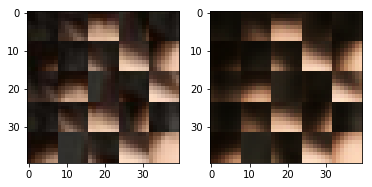

EPO: 18, recon_loss: 0.0105, total_loss: 0.0140
EPO: 18, recon_loss: 0.0022, total_loss: 0.0055
EPO: 18, recon_loss: 0.0048, total_loss: 0.0087
EPO: 18, recon_loss: 0.0033, total_loss: 0.0120
EPO: 18, recon_loss: 0.0026, total_loss: 0.0092
EPO: 18, recon_loss: 0.0054, total_loss: 0.0107
EPO: 18, recon_loss: 0.0031, total_loss: 0.0066
EPO: 18, recon_loss: 0.0067, total_loss: 0.0131
EPO: 18, recon_loss: 0.0028, total_loss: 0.0110
EPO: 18, recon_loss: 0.0015, total_loss: 0.0049
######### what? the reconstruction psnr is: 29.8733


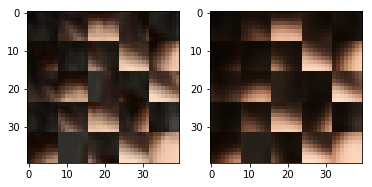

EPO: 18, recon_loss: 0.0041, total_loss: 0.0102
EPO: 18, recon_loss: 0.0025, total_loss: 0.0047
EPO: 18, recon_loss: 0.0048, total_loss: 0.0100
EPO: 18, recon_loss: 0.0042, total_loss: 0.0110
EPO: 18, recon_loss: 0.0039, total_loss: 0.0093
EPO: 18, recon_loss: 0.0046, total_loss: 0.0102
EPO: 18, recon_loss: 0.0037, total_loss: 0.0092
EPO: 18, recon_loss: 0.0031, total_loss: 0.0072
EPO: 18, recon_loss: 0.0050, total_loss: 0.0084
EPO: 18, recon_loss: 0.0026, total_loss: 0.0065
######### what? the reconstruction psnr is: 30.0065


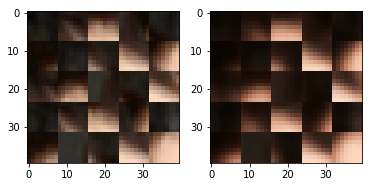

EPO: 18, recon_loss: 0.0071, total_loss: 0.0121
EPO: 18, recon_loss: 0.0041, total_loss: 0.0078
EPO: 18, recon_loss: 0.0042, total_loss: 0.0074
EPO: 18, recon_loss: 0.0119, total_loss: 0.0249
EPO: 18, recon_loss: 0.0042, total_loss: 0.0112
EPO: 18, recon_loss: 0.0064, total_loss: 0.0148
EPO: 18, recon_loss: 0.0103, total_loss: 0.0199
EPO: 18, recon_loss: 0.0060, total_loss: 0.0122
EPO: 18, recon_loss: 0.0047, total_loss: 0.0128
EPO: 18, recon_loss: 0.0035, total_loss: 0.0095
######### what? the reconstruction psnr is: 29.4562


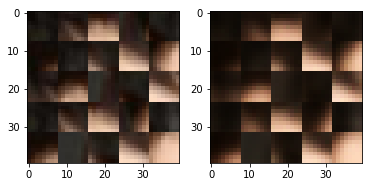

EPO: 18, recon_loss: 0.0050, total_loss: 0.0121
EPO: 18, recon_loss: 0.0039, total_loss: 0.0071
EPO: 18, recon_loss: 0.0048, total_loss: 0.0085
EPO: 18, recon_loss: 0.0019, total_loss: 0.0048
EPO: 18, recon_loss: 0.0022, total_loss: 0.0050
EPO: 18, recon_loss: 0.0025, total_loss: 0.0064
EPO: 18, recon_loss: 0.0057, total_loss: 0.0097
EPO: 18, recon_loss: 0.0046, total_loss: 0.0107
EPO: 18, recon_loss: 0.0066, total_loss: 0.0160
EPO: 18, recon_loss: 0.0022, total_loss: 0.0095
######### what? the reconstruction psnr is: 29.6092


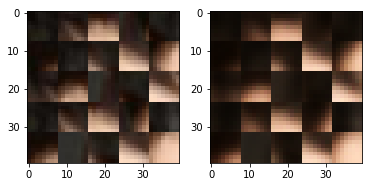

EPO: 18, recon_loss: 0.0026, total_loss: 0.0093
EPO: 18, recon_loss: 0.0047, total_loss: 0.0097
EPO: 18, recon_loss: 0.0019, total_loss: 0.0063
EPO: 18, recon_loss: 0.0075, total_loss: 0.0158
EPO: 18, recon_loss: 0.0096, total_loss: 0.0231
EPO: 18, recon_loss: 0.0045, total_loss: 0.0115
EPO: 18, recon_loss: 0.0091, total_loss: 0.0143
EPO: 18, recon_loss: 0.0032, total_loss: 0.0067
EPO: 18, recon_loss: 0.0068, total_loss: 0.0111
EPO: 18, recon_loss: 0.0050, total_loss: 0.0107
######### what? the reconstruction psnr is: 29.7525


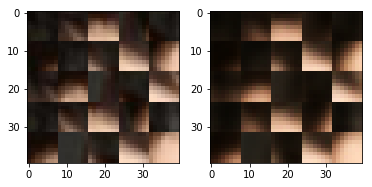

EPO: 18, recon_loss: 0.0044, total_loss: 0.0101
EPO: 18, recon_loss: 0.0069, total_loss: 0.0140
EPO: 18, recon_loss: 0.0059, total_loss: 0.0111
EPO: 18, recon_loss: 0.0107, total_loss: 0.0170
EPO: 18, recon_loss: 0.0102, total_loss: 0.0194
EPO: 18, recon_loss: 0.0119, total_loss: 0.0220
EPO: 18, recon_loss: 0.0241, total_loss: 0.0352
EPO: 18, recon_loss: 0.0112, total_loss: 0.0209
EPO: 18, recon_loss: 0.0101, total_loss: 0.0195
EPO: 18, recon_loss: 0.0050, total_loss: 0.0106
######### what? the reconstruction psnr is: 29.7714


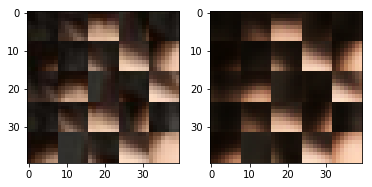

EPO: 18, recon_loss: 0.0046, total_loss: 0.0111
EPO: 18, recon_loss: 0.0064, total_loss: 0.0124
EPO: 18, recon_loss: 0.0065, total_loss: 0.0133
EPO: 18, recon_loss: 0.0093, total_loss: 0.0174
EPO: 18, recon_loss: 0.0029, total_loss: 0.0107
EPO: 18, recon_loss: 0.0033, total_loss: 0.0100
EPO: 18, recon_loss: 0.0111, total_loss: 0.0186
EPO: 18, recon_loss: 0.0031, total_loss: 0.0103
EPO: 18, recon_loss: 0.0042, total_loss: 0.0104
EPO: 18, recon_loss: 0.0086, total_loss: 0.0234
######### what? the reconstruction psnr is: 29.0655


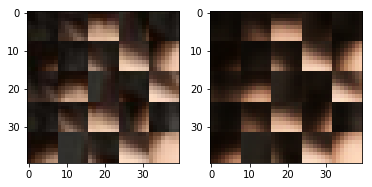

EPO: 18, recon_loss: 0.0066, total_loss: 0.0196
EPO: 18, recon_loss: 0.0220, total_loss: 0.0381
EPO: 18, recon_loss: 0.0059, total_loss: 0.0185
EPO: 18, recon_loss: 0.0073, total_loss: 0.0214
EPO: 18, recon_loss: 0.0124, total_loss: 0.0244
EPO: 18, recon_loss: 0.0066, total_loss: 0.0213
EPO: 18, recon_loss: 0.0208, total_loss: 0.0359
EPO: 18, recon_loss: 0.0100, total_loss: 0.0247
EPO: 18, recon_loss: 0.0106, total_loss: 0.0249
EPO: 18, recon_loss: 0.0046, total_loss: 0.0174
######### what? the reconstruction psnr is: 29.2255


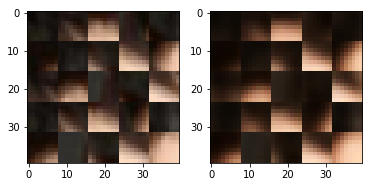

EPO: 18, recon_loss: 0.0042, total_loss: 0.0152
EPO: 18, recon_loss: 0.0234, total_loss: 0.0352
EPO: 18, recon_loss: 0.0230, total_loss: 0.0300
EPO: 18, recon_loss: 0.0038, total_loss: 0.0088
EPO: 18, recon_loss: 0.0035, total_loss: 0.0085
EPO: 18, recon_loss: 0.0028, total_loss: 0.0096
EPO: 18, recon_loss: 0.0100, total_loss: 0.0171
EPO: 18, recon_loss: 0.0045, total_loss: 0.0128
EPO: 18, recon_loss: 0.0060, total_loss: 0.0145
EPO: 18, recon_loss: 0.0024, total_loss: 0.0074
######### what? the reconstruction psnr is: 30.0391


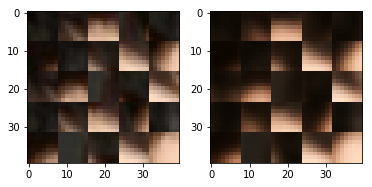

EPO: 18, recon_loss: 0.0007, total_loss: 0.0028
EPO: 18, recon_loss: 0.0010, total_loss: 0.0038
EPO: 18, recon_loss: 0.0013, total_loss: 0.0026
EPO: 18, recon_loss: 0.0014, total_loss: 0.0033
EPO: 18, recon_loss: 0.0073, total_loss: 0.0207
EPO: 18, recon_loss: 0.0033, total_loss: 0.0088
EPO: 18, recon_loss: 0.0053, total_loss: 0.0120
EPO: 18, recon_loss: 0.0057, total_loss: 0.0102
EPO: 18, recon_loss: 0.0047, total_loss: 0.0077
EPO: 18, recon_loss: 0.0092, total_loss: 0.0206
######### what? the reconstruction psnr is: 29.3539


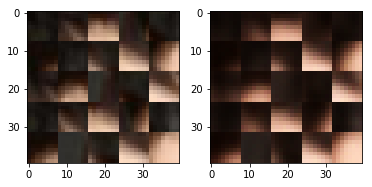

EPO: 18, recon_loss: 0.0076, total_loss: 0.0172
EPO: 18, recon_loss: 0.0110, total_loss: 0.0213
EPO: 18, recon_loss: 0.0085, total_loss: 0.0197
EPO: 18, recon_loss: 0.0046, total_loss: 0.0109
EPO: 18, recon_loss: 0.0065, total_loss: 0.0130
EPO: 18, recon_loss: 0.0046, total_loss: 0.0092
EPO: 18, recon_loss: 0.0047, total_loss: 0.0090
EPO: 18, recon_loss: 0.0047, total_loss: 0.0097
EPO: 18, recon_loss: 0.0040, total_loss: 0.0080
EPO: 18, recon_loss: 0.0054, total_loss: 0.0117
######### what? the reconstruction psnr is: 29.2333


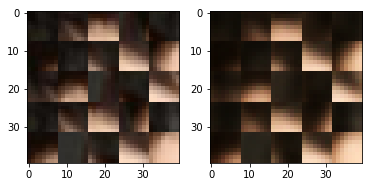

EPO: 18, recon_loss: 0.0037, total_loss: 0.0117
EPO: 18, recon_loss: 0.0034, total_loss: 0.0093
EPO: 18, recon_loss: 0.0085, total_loss: 0.0151
EPO: 18, recon_loss: 0.0090, total_loss: 0.0152
EPO: 18, recon_loss: 0.0052, total_loss: 0.0119
EPO: 18, recon_loss: 0.0016, total_loss: 0.0045
EPO: 18, recon_loss: 0.0024, total_loss: 0.0054
EPO: 18, recon_loss: 0.0037, total_loss: 0.0084
EPO: 18, recon_loss: 0.0017, total_loss: 0.0042
EPO: 18, recon_loss: 0.0030, total_loss: 0.0059
######### what? the reconstruction psnr is: 29.4339


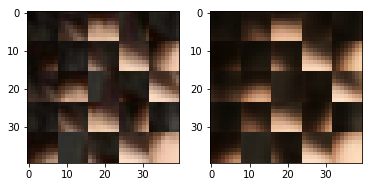

EPO: 18, recon_loss: 0.0035, total_loss: 0.0083
EPO: 18, recon_loss: 0.0043, total_loss: 0.0095
EPO: 18, recon_loss: 0.0086, total_loss: 0.0153
EPO: 18, recon_loss: 0.0048, total_loss: 0.0110
EPO: 18, recon_loss: 0.0034, total_loss: 0.0072
EPO: 18, recon_loss: 0.0028, total_loss: 0.0103
EPO: 18, recon_loss: 0.0035, total_loss: 0.0111
EPO: 18, recon_loss: 0.0142, total_loss: 0.0236
EPO: 18, recon_loss: 0.0039, total_loss: 0.0101
EPO: 18, recon_loss: 0.0163, total_loss: 0.0273
######### what? the reconstruction psnr is: 29.5885


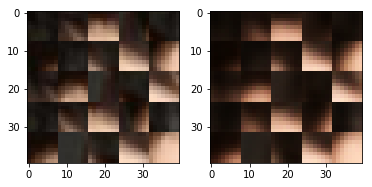

EPO: 18, recon_loss: 0.0012, total_loss: 0.0058
EPO: 18, recon_loss: 0.0008, total_loss: 0.0044
EPO: 18, recon_loss: 0.0127, total_loss: 0.0196
EPO: 18, recon_loss: 0.0041, total_loss: 0.0079
EPO: 18, recon_loss: 0.0051, total_loss: 0.0098
EPO: 18, recon_loss: 0.0056, total_loss: 0.0121
EPO: 18, recon_loss: 0.0070, total_loss: 0.0143
EPO: 18, recon_loss: 0.0115, total_loss: 0.0189
EPO: 18, recon_loss: 0.0027, total_loss: 0.0076
EPO: 18, recon_loss: 0.0041, total_loss: 0.0084
######### what? the reconstruction psnr is: 29.9243


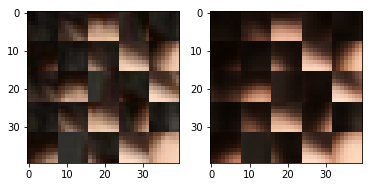

EPO: 18, recon_loss: 0.0036, total_loss: 0.0086
EPO: 18, recon_loss: 0.0024, total_loss: 0.0061
EPO: 18, recon_loss: 0.0082, total_loss: 0.0165
EPO: 18, recon_loss: 0.0022, total_loss: 0.0065
EPO: 18, recon_loss: 0.0032, total_loss: 0.0083
EPO: 18, recon_loss: 0.0071, total_loss: 0.0153
EPO: 18, recon_loss: 0.0040, total_loss: 0.0111
EPO: 18, recon_loss: 0.0071, total_loss: 0.0135
EPO: 18, recon_loss: 0.0048, total_loss: 0.0116
EPO: 18, recon_loss: 0.0063, total_loss: 0.0135
######### what? the reconstruction psnr is: 30.0626


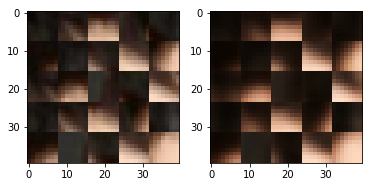

EPO: 18, recon_loss: 0.0079, total_loss: 0.0220
EPO: 18, recon_loss: 0.0021, total_loss: 0.0058
EPO: 18, recon_loss: 0.0050, total_loss: 0.0096
EPO: 18, recon_loss: 0.0035, total_loss: 0.0082
EPO: 18, recon_loss: 0.0043, total_loss: 0.0093
EPO: 18, recon_loss: 0.0047, total_loss: 0.0121
EPO: 18, recon_loss: 0.0029, total_loss: 0.0082
EPO: 18, recon_loss: 0.0083, total_loss: 0.0153
EPO: 18, recon_loss: 0.0085, total_loss: 0.0161
EPO: 18, recon_loss: 0.0065, total_loss: 0.0159
######### what? the reconstruction psnr is: 29.8112


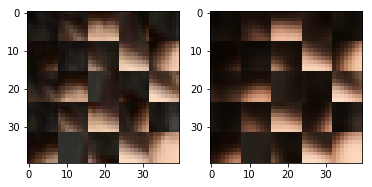

EPO: 18, recon_loss: 0.0074, total_loss: 0.0184
EPO: 18, recon_loss: 0.0033, total_loss: 0.0096
EPO: 18, recon_loss: 0.0036, total_loss: 0.0106
EPO: 18, recon_loss: 0.0067, total_loss: 0.0136
EPO: 18, recon_loss: 0.0056, total_loss: 0.0126
EPO: 18, recon_loss: 0.0044, total_loss: 0.0076
EPO: 18, recon_loss: 0.0026, total_loss: 0.0046
EPO: 18, recon_loss: 0.0019, total_loss: 0.0042
EPO: 18, recon_loss: 0.0042, total_loss: 0.0092
EPO: 18, recon_loss: 0.0031, total_loss: 0.0083
######### what? the reconstruction psnr is: 29.7832


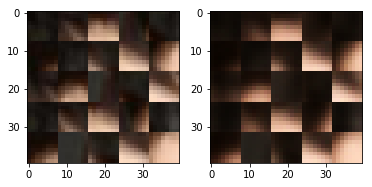

EPO: 18, recon_loss: 0.0058, total_loss: 0.0115
EPO: 18, recon_loss: 0.0110, total_loss: 0.0253
EPO: 18, recon_loss: 0.0064, total_loss: 0.0181
EPO: 18, recon_loss: 0.0137, total_loss: 0.0294
EPO: 18, recon_loss: 0.0096, total_loss: 0.0264
EPO: 18, recon_loss: 0.0120, total_loss: 0.0298
EPO: 18, recon_loss: 0.0030, total_loss: 0.0104
EPO: 18, recon_loss: 0.0107, total_loss: 0.0183
EPO: 18, recon_loss: 0.0055, total_loss: 0.0169
EPO: 18, recon_loss: 0.0047, total_loss: 0.0127
######### what? the reconstruction psnr is: 30.1467


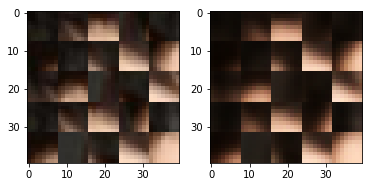

EPO: 18, recon_loss: 0.0060, total_loss: 0.0149
EPO: 18, recon_loss: 0.0053, total_loss: 0.0167
EPO: 18, recon_loss: 0.0066, total_loss: 0.0158
EPO: 18, recon_loss: 0.0112, total_loss: 0.0215
EPO: 18, recon_loss: 0.0039, total_loss: 0.0116
EPO: 18, recon_loss: 0.0047, total_loss: 0.0125
EPO: 18, recon_loss: 0.0040, total_loss: 0.0105
EPO: 18, recon_loss: 0.0027, total_loss: 0.0102
EPO: 18, recon_loss: 0.0111, total_loss: 0.0188
EPO: 18, recon_loss: 0.0028, total_loss: 0.0094
######### what? the reconstruction psnr is: 30.2083


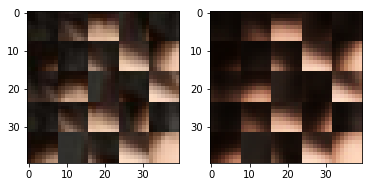

EPO: 18, recon_loss: 0.0048, total_loss: 0.0125
EPO: 18, recon_loss: 0.0032, total_loss: 0.0085
EPO: 18, recon_loss: 0.0040, total_loss: 0.0126
EPO: 18, recon_loss: 0.0136, total_loss: 0.0206
EPO: 18, recon_loss: 0.0046, total_loss: 0.0130
EPO: 18, recon_loss: 0.0068, total_loss: 0.0132
EPO: 18, recon_loss: 0.0030, total_loss: 0.0108
EPO: 18, recon_loss: 0.0026, total_loss: 0.0086
EPO: 18, recon_loss: 0.0103, total_loss: 0.0187
EPO: 18, recon_loss: 0.0032, total_loss: 0.0065
######### what? the reconstruction psnr is: 30.0423


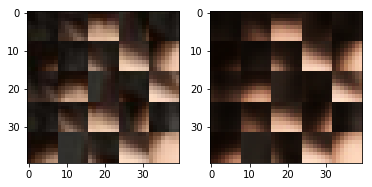

EPO: 18, recon_loss: 0.0071, total_loss: 0.0138
EPO: 18, recon_loss: 0.0029, total_loss: 0.0108
EPO: 18, recon_loss: 0.0019, total_loss: 0.0075
EPO: 18, recon_loss: 0.0055, total_loss: 0.0112
EPO: 18, recon_loss: 0.0020, total_loss: 0.0068
EPO: 18, recon_loss: 0.0042, total_loss: 0.0089
EPO: 18, recon_loss: 0.0117, total_loss: 0.0258
EPO: 18, recon_loss: 0.0108, total_loss: 0.0224
EPO: 18, recon_loss: 0.0057, total_loss: 0.0120
EPO: 18, recon_loss: 0.0063, total_loss: 0.0148
######### what? the reconstruction psnr is: 29.1351


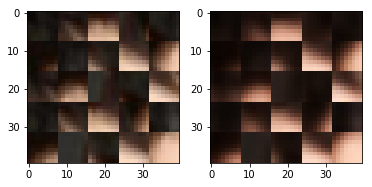

EPO: 18, recon_loss: 0.0047, total_loss: 0.0099
EPO: 18, recon_loss: 0.0074, total_loss: 0.0216
EPO: 18, recon_loss: 0.0031, total_loss: 0.0131
EPO: 18, recon_loss: 0.0072, total_loss: 0.0150
EPO: 18, recon_loss: 0.0046, total_loss: 0.0128
EPO: 18, recon_loss: 0.0060, total_loss: 0.0133
EPO: 18, recon_loss: 0.0033, total_loss: 0.0086
EPO: 18, recon_loss: 0.0009, total_loss: 0.0024
EPO: 18, recon_loss: 0.0051, total_loss: 0.0093
EPO: 18, recon_loss: 0.0018, total_loss: 0.0039
######### what? the reconstruction psnr is: 29.7915


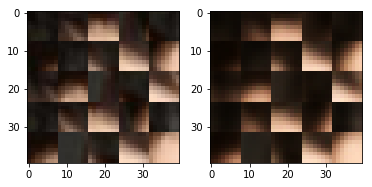

EPO: 18, recon_loss: 0.0020, total_loss: 0.0043
EPO: 18, recon_loss: 0.0042, total_loss: 0.0082
EPO: 18, recon_loss: 0.0042, total_loss: 0.0098
EPO: 18, recon_loss: 0.0072, total_loss: 0.0142
EPO: 18, recon_loss: 0.0039, total_loss: 0.0089
EPO: 18, recon_loss: 0.0042, total_loss: 0.0078
EPO: 18, recon_loss: 0.0079, total_loss: 0.0200
EPO: 18, recon_loss: 0.0073, total_loss: 0.0159
EPO: 18, recon_loss: 0.0065, total_loss: 0.0128
EPO: 18, recon_loss: 0.0081, total_loss: 0.0131
######### what? the reconstruction psnr is: 29.4749


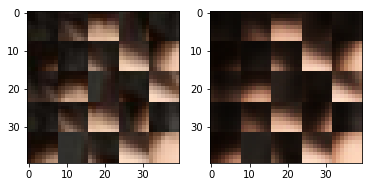

EPO: 18, recon_loss: 0.0068, total_loss: 0.0124
EPO: 18, recon_loss: 0.0147, total_loss: 0.0246
EPO: 18, recon_loss: 0.0177, total_loss: 0.0325
EPO: 18, recon_loss: 0.0070, total_loss: 0.0130
EPO: 18, recon_loss: 0.0077, total_loss: 0.0129
EPO: 18, recon_loss: 0.0111, total_loss: 0.0158
EPO: 18, recon_loss: 0.0157, total_loss: 0.0230
EPO: 18, recon_loss: 0.0015, total_loss: 0.0064
EPO: 18, recon_loss: 0.0034, total_loss: 0.0095
EPO: 18, recon_loss: 0.0075, total_loss: 0.0129
######### what? the reconstruction psnr is: 28.9058


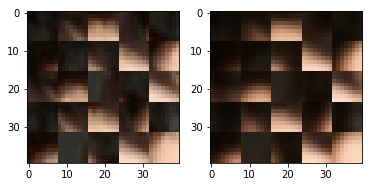

EPO: 18, recon_loss: 0.0062, total_loss: 0.0137
EPO: 18, recon_loss: 0.0149, total_loss: 0.0230
EPO: 18, recon_loss: 0.0022, total_loss: 0.0089
EPO: 18, recon_loss: 0.0033, total_loss: 0.0081
EPO: 18, recon_loss: 0.0063, total_loss: 0.0117
EPO: 18, recon_loss: 0.0017, total_loss: 0.0043
EPO: 18, recon_loss: 0.0035, total_loss: 0.0060
EPO: 18, recon_loss: 0.0059, total_loss: 0.0132
EPO: 18, recon_loss: 0.0073, total_loss: 0.0140
EPO: 18, recon_loss: 0.0160, total_loss: 0.0239
######### what? the reconstruction psnr is: 27.8385


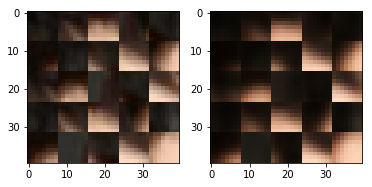

EPO: 18, recon_loss: 0.0132, total_loss: 0.0197
EPO: 18, recon_loss: 0.0123, total_loss: 0.0178
EPO: 19, recon_loss: 0.0027, total_loss: 0.0055
EPO: 19, recon_loss: 0.0022, total_loss: 0.0046
EPO: 19, recon_loss: 0.0107, total_loss: 0.0158
EPO: 19, recon_loss: 0.0027, total_loss: 0.0061
EPO: 19, recon_loss: 0.0056, total_loss: 0.0097
EPO: 19, recon_loss: 0.0032, total_loss: 0.0113
EPO: 19, recon_loss: 0.0035, total_loss: 0.0091
EPO: 19, recon_loss: 0.0054, total_loss: 0.0101
######### what? the reconstruction psnr is: 30.0027


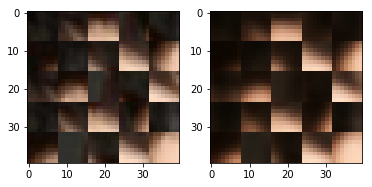

EPO: 19, recon_loss: 0.0042, total_loss: 0.0077
EPO: 19, recon_loss: 0.0076, total_loss: 0.0153
EPO: 19, recon_loss: 0.0024, total_loss: 0.0101
EPO: 19, recon_loss: 0.0013, total_loss: 0.0044
EPO: 19, recon_loss: 0.0040, total_loss: 0.0097
EPO: 19, recon_loss: 0.0028, total_loss: 0.0048
EPO: 19, recon_loss: 0.0060, total_loss: 0.0123
EPO: 19, recon_loss: 0.0039, total_loss: 0.0096
EPO: 19, recon_loss: 0.0037, total_loss: 0.0090
EPO: 19, recon_loss: 0.0048, total_loss: 0.0095
######### what? the reconstruction psnr is: 30.1321


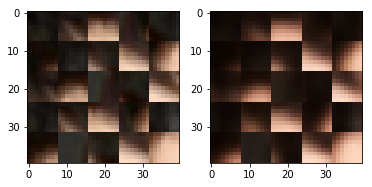

EPO: 19, recon_loss: 0.0036, total_loss: 0.0096
EPO: 19, recon_loss: 0.0037, total_loss: 0.0083
EPO: 19, recon_loss: 0.0040, total_loss: 0.0070
EPO: 19, recon_loss: 0.0028, total_loss: 0.0067
EPO: 19, recon_loss: 0.0082, total_loss: 0.0124
EPO: 19, recon_loss: 0.0029, total_loss: 0.0060
EPO: 19, recon_loss: 0.0041, total_loss: 0.0071
EPO: 19, recon_loss: 0.0088, total_loss: 0.0184
EPO: 19, recon_loss: 0.0034, total_loss: 0.0099
EPO: 19, recon_loss: 0.0078, total_loss: 0.0175
######### what? the reconstruction psnr is: 29.6053


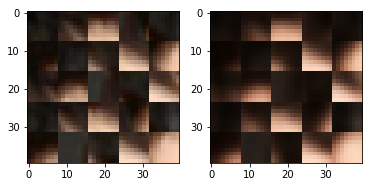

EPO: 19, recon_loss: 0.0091, total_loss: 0.0166
EPO: 19, recon_loss: 0.0072, total_loss: 0.0134
EPO: 19, recon_loss: 0.0060, total_loss: 0.0167
EPO: 19, recon_loss: 0.0027, total_loss: 0.0086
EPO: 19, recon_loss: 0.0065, total_loss: 0.0125
EPO: 19, recon_loss: 0.0031, total_loss: 0.0055
EPO: 19, recon_loss: 0.0027, total_loss: 0.0059
EPO: 19, recon_loss: 0.0020, total_loss: 0.0045
EPO: 19, recon_loss: 0.0018, total_loss: 0.0043
EPO: 19, recon_loss: 0.0033, total_loss: 0.0081
######### what? the reconstruction psnr is: 29.8483


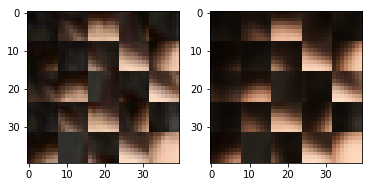

EPO: 19, recon_loss: 0.0034, total_loss: 0.0068
EPO: 19, recon_loss: 0.0052, total_loss: 0.0125
EPO: 19, recon_loss: 0.0022, total_loss: 0.0107
EPO: 19, recon_loss: 0.0019, total_loss: 0.0086
EPO: 19, recon_loss: 0.0032, total_loss: 0.0092
EPO: 19, recon_loss: 0.0035, total_loss: 0.0073
EPO: 19, recon_loss: 0.0033, total_loss: 0.0086
EPO: 19, recon_loss: 0.0059, total_loss: 0.0167
EPO: 19, recon_loss: 0.0043, total_loss: 0.0115
EPO: 19, recon_loss: 0.0070, total_loss: 0.0147
######### what? the reconstruction psnr is: 30.1739


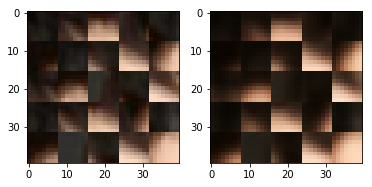

EPO: 19, recon_loss: 0.0062, total_loss: 0.0106
EPO: 19, recon_loss: 0.0041, total_loss: 0.0078
EPO: 19, recon_loss: 0.0098, total_loss: 0.0158
EPO: 19, recon_loss: 0.0039, total_loss: 0.0084
EPO: 19, recon_loss: 0.0050, total_loss: 0.0120
EPO: 19, recon_loss: 0.0060, total_loss: 0.0122
EPO: 19, recon_loss: 0.0053, total_loss: 0.0111
EPO: 19, recon_loss: 0.0153, total_loss: 0.0208
EPO: 19, recon_loss: 0.0102, total_loss: 0.0195
EPO: 19, recon_loss: 0.0126, total_loss: 0.0232
######### what? the reconstruction psnr is: 29.5858


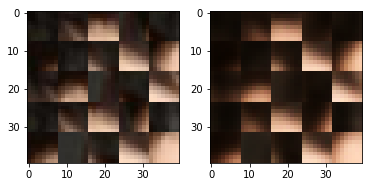

EPO: 19, recon_loss: 0.0213, total_loss: 0.0316
EPO: 19, recon_loss: 0.0113, total_loss: 0.0206
EPO: 19, recon_loss: 0.0110, total_loss: 0.0199
EPO: 19, recon_loss: 0.0044, total_loss: 0.0097
EPO: 19, recon_loss: 0.0054, total_loss: 0.0112
EPO: 19, recon_loss: 0.0077, total_loss: 0.0138
EPO: 19, recon_loss: 0.0085, total_loss: 0.0172
EPO: 19, recon_loss: 0.0094, total_loss: 0.0166
EPO: 19, recon_loss: 0.0031, total_loss: 0.0107
EPO: 19, recon_loss: 0.0058, total_loss: 0.0135
######### what? the reconstruction psnr is: 29.7676


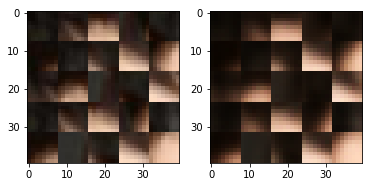

EPO: 19, recon_loss: 0.0094, total_loss: 0.0172
EPO: 19, recon_loss: 0.0032, total_loss: 0.0104
EPO: 19, recon_loss: 0.0050, total_loss: 0.0114
EPO: 19, recon_loss: 0.0069, total_loss: 0.0195
EPO: 19, recon_loss: 0.0068, total_loss: 0.0193
EPO: 19, recon_loss: 0.0211, total_loss: 0.0365
EPO: 19, recon_loss: 0.0063, total_loss: 0.0204
EPO: 19, recon_loss: 0.0082, total_loss: 0.0204
EPO: 19, recon_loss: 0.0091, total_loss: 0.0211
EPO: 19, recon_loss: 0.0061, total_loss: 0.0200
######### what? the reconstruction psnr is: 30.1260


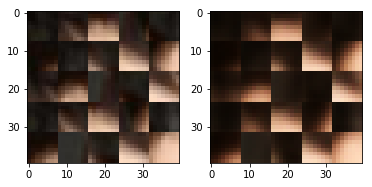

EPO: 19, recon_loss: 0.0234, total_loss: 0.0387
EPO: 19, recon_loss: 0.0106, total_loss: 0.0251
EPO: 19, recon_loss: 0.0104, total_loss: 0.0244
EPO: 19, recon_loss: 0.0027, total_loss: 0.0139
EPO: 19, recon_loss: 0.0077, total_loss: 0.0220
EPO: 19, recon_loss: 0.0262, total_loss: 0.0377
EPO: 19, recon_loss: 0.0172, total_loss: 0.0245
EPO: 19, recon_loss: 0.0041, total_loss: 0.0080
EPO: 19, recon_loss: 0.0025, total_loss: 0.0076
EPO: 19, recon_loss: 0.0033, total_loss: 0.0101
######### what? the reconstruction psnr is: 30.1237


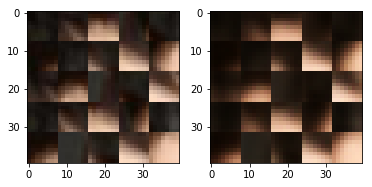

EPO: 19, recon_loss: 0.0099, total_loss: 0.0170
EPO: 19, recon_loss: 0.0042, total_loss: 0.0123
EPO: 19, recon_loss: 0.0070, total_loss: 0.0153
EPO: 19, recon_loss: 0.0015, total_loss: 0.0047
EPO: 19, recon_loss: 0.0007, total_loss: 0.0029
EPO: 19, recon_loss: 0.0015, total_loss: 0.0042
EPO: 19, recon_loss: 0.0010, total_loss: 0.0022
EPO: 19, recon_loss: 0.0012, total_loss: 0.0034
EPO: 19, recon_loss: 0.0067, total_loss: 0.0185
EPO: 19, recon_loss: 0.0027, total_loss: 0.0079
######### what? the reconstruction psnr is: 30.0504


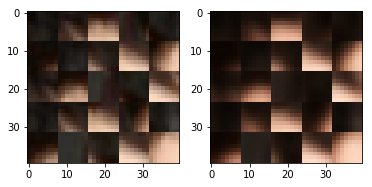

EPO: 19, recon_loss: 0.0054, total_loss: 0.0115
EPO: 19, recon_loss: 0.0033, total_loss: 0.0067
EPO: 19, recon_loss: 0.0039, total_loss: 0.0066
EPO: 19, recon_loss: 0.0084, total_loss: 0.0211
EPO: 19, recon_loss: 0.0074, total_loss: 0.0161
EPO: 19, recon_loss: 0.0092, total_loss: 0.0185
EPO: 19, recon_loss: 0.0087, total_loss: 0.0191
EPO: 19, recon_loss: 0.0049, total_loss: 0.0111
EPO: 19, recon_loss: 0.0066, total_loss: 0.0131
EPO: 19, recon_loss: 0.0043, total_loss: 0.0085
######### what? the reconstruction psnr is: 29.4931


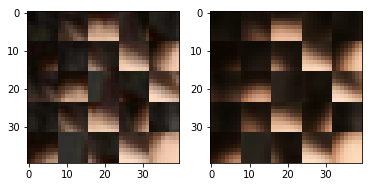

EPO: 19, recon_loss: 0.0042, total_loss: 0.0085
EPO: 19, recon_loss: 0.0036, total_loss: 0.0076
EPO: 19, recon_loss: 0.0045, total_loss: 0.0095
EPO: 19, recon_loss: 0.0031, total_loss: 0.0135
EPO: 19, recon_loss: 0.0022, total_loss: 0.0078
EPO: 19, recon_loss: 0.0048, total_loss: 0.0120
EPO: 19, recon_loss: 0.0073, total_loss: 0.0134
EPO: 19, recon_loss: 0.0049, total_loss: 0.0098
EPO: 19, recon_loss: 0.0040, total_loss: 0.0089
EPO: 19, recon_loss: 0.0014, total_loss: 0.0044
######### what? the reconstruction psnr is: 29.5919


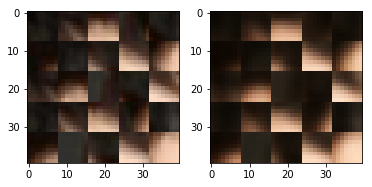

EPO: 19, recon_loss: 0.0026, total_loss: 0.0056
EPO: 19, recon_loss: 0.0033, total_loss: 0.0076
EPO: 19, recon_loss: 0.0021, total_loss: 0.0046
EPO: 19, recon_loss: 0.0037, total_loss: 0.0071
EPO: 19, recon_loss: 0.0028, total_loss: 0.0069
EPO: 19, recon_loss: 0.0042, total_loss: 0.0094
EPO: 19, recon_loss: 0.0064, total_loss: 0.0129
EPO: 19, recon_loss: 0.0052, total_loss: 0.0106
EPO: 19, recon_loss: 0.0030, total_loss: 0.0070
EPO: 19, recon_loss: 0.0036, total_loss: 0.0126
######### what? the reconstruction psnr is: 29.8833


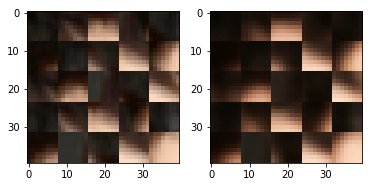

EPO: 19, recon_loss: 0.0077, total_loss: 0.0162
EPO: 19, recon_loss: 0.0134, total_loss: 0.0229
EPO: 19, recon_loss: 0.0043, total_loss: 0.0106
EPO: 19, recon_loss: 0.0165, total_loss: 0.0263
EPO: 19, recon_loss: 0.0010, total_loss: 0.0046
EPO: 19, recon_loss: 0.0019, total_loss: 0.0060
EPO: 19, recon_loss: 0.0115, total_loss: 0.0183
EPO: 19, recon_loss: 0.0031, total_loss: 0.0074
EPO: 19, recon_loss: 0.0049, total_loss: 0.0095
EPO: 19, recon_loss: 0.0050, total_loss: 0.0108
######### what? the reconstruction psnr is: 29.9050


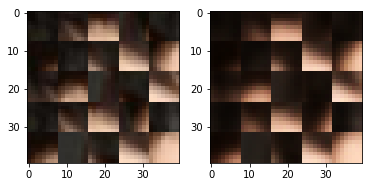

EPO: 19, recon_loss: 0.0057, total_loss: 0.0132
EPO: 19, recon_loss: 0.0103, total_loss: 0.0171
EPO: 19, recon_loss: 0.0026, total_loss: 0.0076
EPO: 19, recon_loss: 0.0061, total_loss: 0.0112
EPO: 19, recon_loss: 0.0032, total_loss: 0.0077
EPO: 19, recon_loss: 0.0048, total_loss: 0.0096
EPO: 19, recon_loss: 0.0092, total_loss: 0.0176
EPO: 19, recon_loss: 0.0026, total_loss: 0.0072
EPO: 19, recon_loss: 0.0037, total_loss: 0.0090
EPO: 19, recon_loss: 0.0059, total_loss: 0.0134
######### what? the reconstruction psnr is: 30.0385


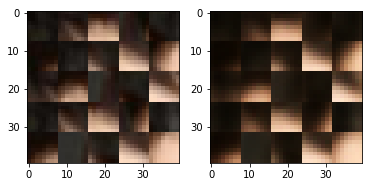

EPO: 19, recon_loss: 0.0036, total_loss: 0.0103
EPO: 19, recon_loss: 0.0100, total_loss: 0.0161
EPO: 19, recon_loss: 0.0047, total_loss: 0.0120
EPO: 19, recon_loss: 0.0069, total_loss: 0.0137
EPO: 19, recon_loss: 0.0082, total_loss: 0.0203
EPO: 19, recon_loss: 0.0013, total_loss: 0.0048
EPO: 19, recon_loss: 0.0067, total_loss: 0.0111
EPO: 19, recon_loss: 0.0029, total_loss: 0.0073
EPO: 19, recon_loss: 0.0042, total_loss: 0.0088
EPO: 19, recon_loss: 0.0043, total_loss: 0.0120
######### what? the reconstruction psnr is: 29.8063


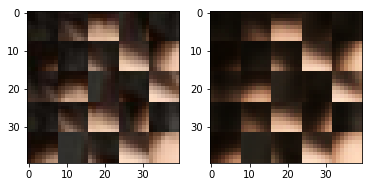

EPO: 19, recon_loss: 0.0029, total_loss: 0.0082
EPO: 19, recon_loss: 0.0104, total_loss: 0.0180
EPO: 19, recon_loss: 0.0039, total_loss: 0.0104
EPO: 19, recon_loss: 0.0076, total_loss: 0.0156
EPO: 19, recon_loss: 0.0060, total_loss: 0.0156
EPO: 19, recon_loss: 0.0024, total_loss: 0.0084
EPO: 19, recon_loss: 0.0061, total_loss: 0.0140
EPO: 19, recon_loss: 0.0031, total_loss: 0.0084
EPO: 19, recon_loss: 0.0054, total_loss: 0.0115
EPO: 19, recon_loss: 0.0033, total_loss: 0.0051
######### what? the reconstruction psnr is: 30.0923


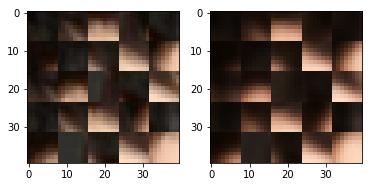

EPO: 19, recon_loss: 0.0020, total_loss: 0.0038
EPO: 19, recon_loss: 0.0026, total_loss: 0.0053
EPO: 19, recon_loss: 0.0031, total_loss: 0.0070
EPO: 19, recon_loss: 0.0035, total_loss: 0.0086
EPO: 19, recon_loss: 0.0112, total_loss: 0.0253
EPO: 19, recon_loss: 0.0103, total_loss: 0.0226
EPO: 19, recon_loss: 0.0086, total_loss: 0.0214
EPO: 19, recon_loss: 0.0100, total_loss: 0.0252
EPO: 19, recon_loss: 0.0088, total_loss: 0.0252
EPO: 19, recon_loss: 0.0031, total_loss: 0.0105
######### what? the reconstruction psnr is: 30.3724


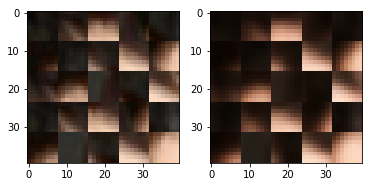

EPO: 19, recon_loss: 0.0038, total_loss: 0.0101
EPO: 19, recon_loss: 0.0125, total_loss: 0.0239
EPO: 19, recon_loss: 0.0048, total_loss: 0.0151
EPO: 19, recon_loss: 0.0047, total_loss: 0.0130
EPO: 19, recon_loss: 0.0050, total_loss: 0.0130
EPO: 19, recon_loss: 0.0048, total_loss: 0.0153
EPO: 19, recon_loss: 0.0065, total_loss: 0.0164
EPO: 19, recon_loss: 0.0087, total_loss: 0.0181
EPO: 19, recon_loss: 0.0043, total_loss: 0.0111
EPO: 19, recon_loss: 0.0044, total_loss: 0.0116
######### what? the reconstruction psnr is: 30.2780


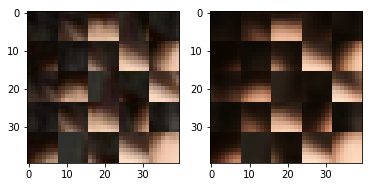

EPO: 19, recon_loss: 0.0031, total_loss: 0.0095
EPO: 19, recon_loss: 0.0060, total_loss: 0.0144
EPO: 19, recon_loss: 0.0096, total_loss: 0.0167
EPO: 19, recon_loss: 0.0026, total_loss: 0.0087
EPO: 19, recon_loss: 0.0048, total_loss: 0.0125
EPO: 19, recon_loss: 0.0025, total_loss: 0.0082
EPO: 19, recon_loss: 0.0049, total_loss: 0.0130
EPO: 19, recon_loss: 0.0115, total_loss: 0.0188
EPO: 19, recon_loss: 0.0047, total_loss: 0.0133
EPO: 19, recon_loss: 0.0087, total_loss: 0.0158
######### what? the reconstruction psnr is: 30.2049


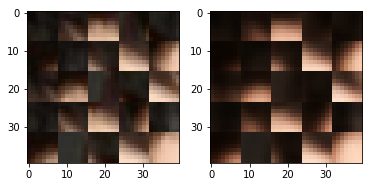

EPO: 19, recon_loss: 0.0020, total_loss: 0.0086
EPO: 19, recon_loss: 0.0036, total_loss: 0.0092
EPO: 19, recon_loss: 0.0078, total_loss: 0.0140
EPO: 19, recon_loss: 0.0036, total_loss: 0.0076
EPO: 19, recon_loss: 0.0060, total_loss: 0.0140
EPO: 19, recon_loss: 0.0023, total_loss: 0.0080
EPO: 19, recon_loss: 0.0020, total_loss: 0.0078
EPO: 19, recon_loss: 0.0042, total_loss: 0.0098
EPO: 19, recon_loss: 0.0024, total_loss: 0.0068
EPO: 19, recon_loss: 0.0034, total_loss: 0.0084
######### what? the reconstruction psnr is: 30.2121


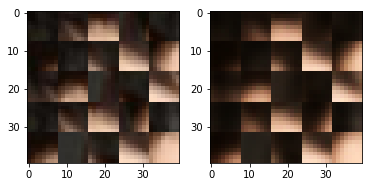

EPO: 19, recon_loss: 0.0106, total_loss: 0.0223
EPO: 19, recon_loss: 0.0084, total_loss: 0.0195
EPO: 19, recon_loss: 0.0058, total_loss: 0.0117
EPO: 19, recon_loss: 0.0070, total_loss: 0.0158
EPO: 19, recon_loss: 0.0044, total_loss: 0.0096
EPO: 19, recon_loss: 0.0070, total_loss: 0.0207
EPO: 19, recon_loss: 0.0030, total_loss: 0.0119
EPO: 19, recon_loss: 0.0078, total_loss: 0.0161
EPO: 19, recon_loss: 0.0032, total_loss: 0.0097
EPO: 19, recon_loss: 0.0069, total_loss: 0.0137
######### what? the reconstruction psnr is: 29.8437


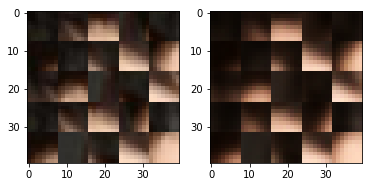

EPO: 19, recon_loss: 0.0020, total_loss: 0.0048
EPO: 19, recon_loss: 0.0009, total_loss: 0.0025
EPO: 19, recon_loss: 0.0052, total_loss: 0.0091
EPO: 19, recon_loss: 0.0017, total_loss: 0.0040
EPO: 19, recon_loss: 0.0024, total_loss: 0.0049
EPO: 19, recon_loss: 0.0049, total_loss: 0.0099
EPO: 19, recon_loss: 0.0033, total_loss: 0.0085
EPO: 19, recon_loss: 0.0067, total_loss: 0.0132
EPO: 19, recon_loss: 0.0026, total_loss: 0.0067
EPO: 19, recon_loss: 0.0027, total_loss: 0.0057
######### what? the reconstruction psnr is: 29.6216


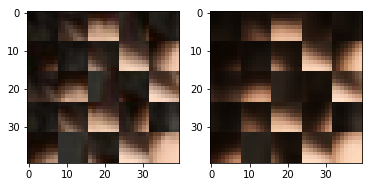

EPO: 19, recon_loss: 0.0079, total_loss: 0.0196
EPO: 19, recon_loss: 0.0053, total_loss: 0.0121
EPO: 19, recon_loss: 0.0081, total_loss: 0.0142
EPO: 19, recon_loss: 0.0055, total_loss: 0.0101
EPO: 19, recon_loss: 0.0075, total_loss: 0.0132
EPO: 19, recon_loss: 0.0119, total_loss: 0.0221
EPO: 19, recon_loss: 0.0204, total_loss: 0.0362
EPO: 19, recon_loss: 0.0056, total_loss: 0.0109
EPO: 19, recon_loss: 0.0057, total_loss: 0.0099
EPO: 19, recon_loss: 0.0102, total_loss: 0.0157
######### what? the reconstruction psnr is: 26.9784


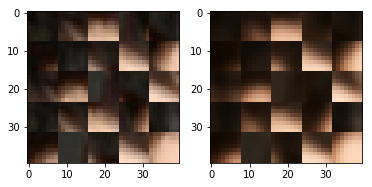

EPO: 19, recon_loss: 0.0030, total_loss: 0.0083
EPO: 19, recon_loss: 0.0015, total_loss: 0.0069
EPO: 19, recon_loss: 0.0037, total_loss: 0.0088
EPO: 19, recon_loss: 0.0042, total_loss: 0.0101
EPO: 19, recon_loss: 0.0048, total_loss: 0.0098
EPO: 19, recon_loss: 0.0030, total_loss: 0.0172
EPO: 19, recon_loss: 0.0017, total_loss: 0.0071
EPO: 19, recon_loss: 0.0040, total_loss: 0.0089
EPO: 19, recon_loss: 0.0039, total_loss: 0.0087
EPO: 19, recon_loss: 0.0012, total_loss: 0.0030
######### what? the reconstruction psnr is: 29.6635


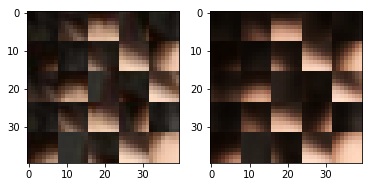

EPO: 19, recon_loss: 0.0047, total_loss: 0.0095
EPO: 19, recon_loss: 0.0058, total_loss: 0.0129
EPO: 19, recon_loss: 0.0091, total_loss: 0.0150
EPO: 19, recon_loss: 0.0141, total_loss: 0.0222
EPO: 19, recon_loss: 0.0116, total_loss: 0.0187
EPO: 19, recon_loss: 0.0095, total_loss: 0.0146
EPO: 20, recon_loss: 0.0022, total_loss: 0.0045
EPO: 20, recon_loss: 0.0030, total_loss: 0.0055
EPO: 20, recon_loss: 0.0066, total_loss: 0.0114
EPO: 20, recon_loss: 0.0031, total_loss: 0.0062
######### what? the reconstruction psnr is: 29.9601


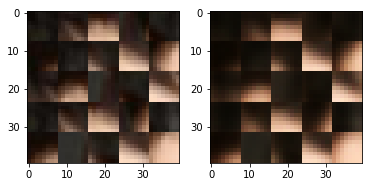

EPO: 20, recon_loss: 0.0064, total_loss: 0.0106
EPO: 20, recon_loss: 0.0022, total_loss: 0.0081
EPO: 20, recon_loss: 0.0033, total_loss: 0.0086
EPO: 20, recon_loss: 0.0065, total_loss: 0.0111
EPO: 20, recon_loss: 0.0071, total_loss: 0.0120
EPO: 20, recon_loss: 0.0073, total_loss: 0.0143
EPO: 20, recon_loss: 0.0026, total_loss: 0.0084
EPO: 20, recon_loss: 0.0021, total_loss: 0.0060
EPO: 20, recon_loss: 0.0035, total_loss: 0.0083
EPO: 20, recon_loss: 0.0031, total_loss: 0.0058
######### what? the reconstruction psnr is: 30.1787


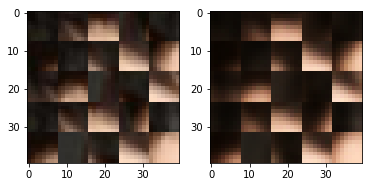

EPO: 20, recon_loss: 0.0082, total_loss: 0.0138
EPO: 20, recon_loss: 0.0037, total_loss: 0.0092
EPO: 20, recon_loss: 0.0034, total_loss: 0.0083
EPO: 20, recon_loss: 0.0044, total_loss: 0.0103
EPO: 20, recon_loss: 0.0038, total_loss: 0.0092
EPO: 20, recon_loss: 0.0040, total_loss: 0.0093
EPO: 20, recon_loss: 0.0032, total_loss: 0.0063
EPO: 20, recon_loss: 0.0030, total_loss: 0.0065
EPO: 20, recon_loss: 0.0095, total_loss: 0.0146
EPO: 20, recon_loss: 0.0023, total_loss: 0.0054
######### what? the reconstruction psnr is: 30.0493


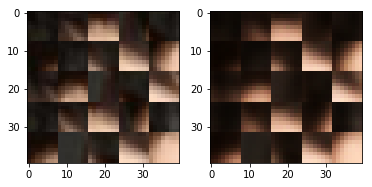

EPO: 20, recon_loss: 0.0050, total_loss: 0.0079
EPO: 20, recon_loss: 0.0071, total_loss: 0.0158
EPO: 20, recon_loss: 0.0051, total_loss: 0.0140
EPO: 20, recon_loss: 0.0080, total_loss: 0.0167
EPO: 20, recon_loss: 0.0105, total_loss: 0.0185
EPO: 20, recon_loss: 0.0074, total_loss: 0.0127
EPO: 20, recon_loss: 0.0057, total_loss: 0.0160
EPO: 20, recon_loss: 0.0022, total_loss: 0.0070
EPO: 20, recon_loss: 0.0065, total_loss: 0.0121
EPO: 20, recon_loss: 0.0037, total_loss: 0.0059
######### what? the reconstruction psnr is: 29.4685


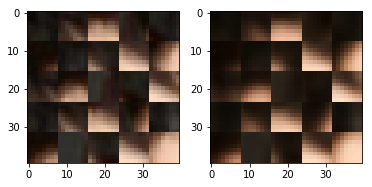

EPO: 20, recon_loss: 0.0030, total_loss: 0.0077
EPO: 20, recon_loss: 0.0016, total_loss: 0.0034
EPO: 20, recon_loss: 0.0019, total_loss: 0.0043
EPO: 20, recon_loss: 0.0051, total_loss: 0.0099
EPO: 20, recon_loss: 0.0034, total_loss: 0.0081
EPO: 20, recon_loss: 0.0044, total_loss: 0.0112
EPO: 20, recon_loss: 0.0018, total_loss: 0.0096
EPO: 20, recon_loss: 0.0018, total_loss: 0.0082
EPO: 20, recon_loss: 0.0050, total_loss: 0.0115
EPO: 20, recon_loss: 0.0015, total_loss: 0.0055
######### what? the reconstruction psnr is: 29.8440


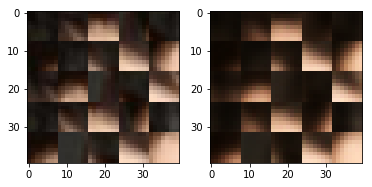

EPO: 20, recon_loss: 0.0038, total_loss: 0.0093
EPO: 20, recon_loss: 0.0069, total_loss: 0.0177
EPO: 20, recon_loss: 0.0023, total_loss: 0.0074
EPO: 20, recon_loss: 0.0089, total_loss: 0.0163
EPO: 20, recon_loss: 0.0045, total_loss: 0.0085
EPO: 20, recon_loss: 0.0038, total_loss: 0.0071
EPO: 20, recon_loss: 0.0093, total_loss: 0.0159
EPO: 20, recon_loss: 0.0035, total_loss: 0.0075
EPO: 20, recon_loss: 0.0055, total_loss: 0.0121
EPO: 20, recon_loss: 0.0046, total_loss: 0.0094
######### what? the reconstruction psnr is: 29.9912


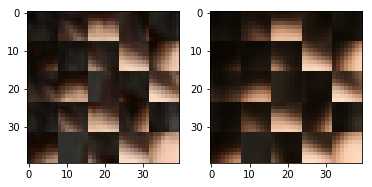

EPO: 20, recon_loss: 0.0055, total_loss: 0.0113
EPO: 20, recon_loss: 0.0148, total_loss: 0.0262
EPO: 20, recon_loss: 0.0129, total_loss: 0.0228
EPO: 20, recon_loss: 0.0109, total_loss: 0.0217
EPO: 20, recon_loss: 0.0125, total_loss: 0.0221
EPO: 20, recon_loss: 0.0080, total_loss: 0.0162
EPO: 20, recon_loss: 0.0074, total_loss: 0.0155
EPO: 20, recon_loss: 0.0040, total_loss: 0.0094
EPO: 20, recon_loss: 0.0063, total_loss: 0.0138
EPO: 20, recon_loss: 0.0090, total_loss: 0.0147
######### what? the reconstruction psnr is: 29.9908


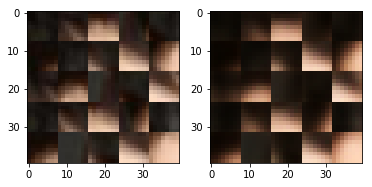

EPO: 20, recon_loss: 0.0082, total_loss: 0.0170
EPO: 20, recon_loss: 0.0103, total_loss: 0.0195
EPO: 20, recon_loss: 0.0021, total_loss: 0.0082
EPO: 20, recon_loss: 0.0063, total_loss: 0.0139
EPO: 20, recon_loss: 0.0094, total_loss: 0.0171
EPO: 20, recon_loss: 0.0036, total_loss: 0.0103
EPO: 20, recon_loss: 0.0071, total_loss: 0.0156
EPO: 20, recon_loss: 0.0067, total_loss: 0.0193
EPO: 20, recon_loss: 0.0093, total_loss: 0.0207
EPO: 20, recon_loss: 0.0171, total_loss: 0.0333
######### what? the reconstruction psnr is: 30.0679


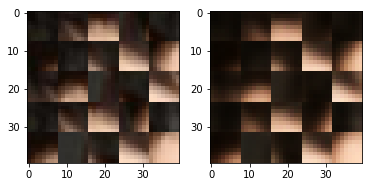

EPO: 20, recon_loss: 0.0057, total_loss: 0.0179
EPO: 20, recon_loss: 0.0109, total_loss: 0.0224
EPO: 20, recon_loss: 0.0073, total_loss: 0.0188
EPO: 20, recon_loss: 0.0087, total_loss: 0.0228
EPO: 20, recon_loss: 0.0172, total_loss: 0.0314
EPO: 20, recon_loss: 0.0133, total_loss: 0.0287
EPO: 20, recon_loss: 0.0117, total_loss: 0.0250
EPO: 20, recon_loss: 0.0026, total_loss: 0.0135
EPO: 20, recon_loss: 0.0101, total_loss: 0.0235
EPO: 20, recon_loss: 0.0225, total_loss: 0.0326
######### what? the reconstruction psnr is: 29.8268


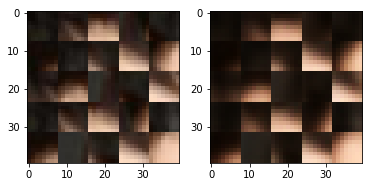

EPO: 20, recon_loss: 0.0122, total_loss: 0.0181
EPO: 20, recon_loss: 0.0046, total_loss: 0.0086
EPO: 20, recon_loss: 0.0025, total_loss: 0.0075
EPO: 20, recon_loss: 0.0033, total_loss: 0.0100
EPO: 20, recon_loss: 0.0101, total_loss: 0.0169
EPO: 20, recon_loss: 0.0041, total_loss: 0.0121
EPO: 20, recon_loss: 0.0088, total_loss: 0.0162
EPO: 20, recon_loss: 0.0010, total_loss: 0.0036
EPO: 20, recon_loss: 0.0006, total_loss: 0.0025
EPO: 20, recon_loss: 0.0022, total_loss: 0.0049
######### what? the reconstruction psnr is: 30.2244


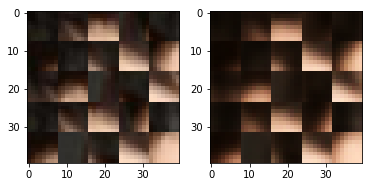

EPO: 20, recon_loss: 0.0010, total_loss: 0.0024
EPO: 20, recon_loss: 0.0020, total_loss: 0.0046
EPO: 20, recon_loss: 0.0044, total_loss: 0.0129
EPO: 20, recon_loss: 0.0027, total_loss: 0.0068
EPO: 20, recon_loss: 0.0062, total_loss: 0.0122
EPO: 20, recon_loss: 0.0030, total_loss: 0.0062
EPO: 20, recon_loss: 0.0037, total_loss: 0.0068
EPO: 20, recon_loss: 0.0065, total_loss: 0.0166
EPO: 20, recon_loss: 0.0081, total_loss: 0.0173
EPO: 20, recon_loss: 0.0082, total_loss: 0.0175
######### what? the reconstruction psnr is: 29.7012


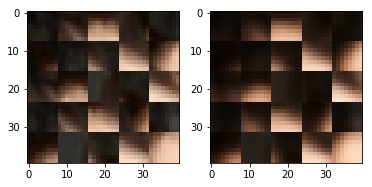

EPO: 20, recon_loss: 0.0091, total_loss: 0.0194
EPO: 20, recon_loss: 0.0043, total_loss: 0.0089
EPO: 20, recon_loss: 0.0057, total_loss: 0.0120
EPO: 20, recon_loss: 0.0035, total_loss: 0.0073
EPO: 20, recon_loss: 0.0055, total_loss: 0.0109
EPO: 20, recon_loss: 0.0032, total_loss: 0.0072
EPO: 20, recon_loss: 0.0035, total_loss: 0.0072
EPO: 20, recon_loss: 0.0038, total_loss: 0.0154
EPO: 20, recon_loss: 0.0015, total_loss: 0.0061
EPO: 20, recon_loss: 0.0058, total_loss: 0.0135
######### what? the reconstruction psnr is: 29.5857


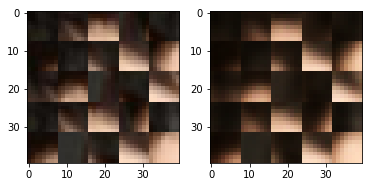

EPO: 20, recon_loss: 0.0043, total_loss: 0.0089
EPO: 20, recon_loss: 0.0053, total_loss: 0.0101
EPO: 20, recon_loss: 0.0022, total_loss: 0.0046
EPO: 20, recon_loss: 0.0012, total_loss: 0.0041
EPO: 20, recon_loss: 0.0028, total_loss: 0.0060
EPO: 20, recon_loss: 0.0025, total_loss: 0.0060
EPO: 20, recon_loss: 0.0024, total_loss: 0.0050
EPO: 20, recon_loss: 0.0041, total_loss: 0.0100
EPO: 20, recon_loss: 0.0026, total_loss: 0.0067
EPO: 20, recon_loss: 0.0061, total_loss: 0.0120
######### what? the reconstruction psnr is: 30.0003


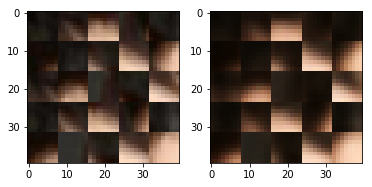

EPO: 20, recon_loss: 0.0043, total_loss: 0.0100
EPO: 20, recon_loss: 0.0038, total_loss: 0.0090
EPO: 20, recon_loss: 0.0040, total_loss: 0.0149
EPO: 20, recon_loss: 0.0040, total_loss: 0.0125
EPO: 20, recon_loss: 0.0110, total_loss: 0.0200
EPO: 20, recon_loss: 0.0093, total_loss: 0.0169
EPO: 20, recon_loss: 0.0043, total_loss: 0.0105
EPO: 20, recon_loss: 0.0149, total_loss: 0.0251
EPO: 20, recon_loss: 0.0010, total_loss: 0.0043
EPO: 20, recon_loss: 0.0027, total_loss: 0.0085
######### what? the reconstruction psnr is: 29.0255


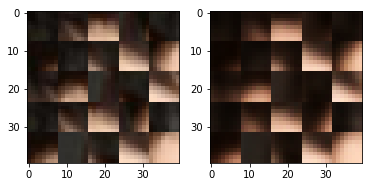

EPO: 20, recon_loss: 0.0089, total_loss: 0.0152
EPO: 20, recon_loss: 0.0050, total_loss: 0.0097
EPO: 20, recon_loss: 0.0042, total_loss: 0.0094
EPO: 20, recon_loss: 0.0057, total_loss: 0.0123
EPO: 20, recon_loss: 0.0066, total_loss: 0.0142
EPO: 20, recon_loss: 0.0080, total_loss: 0.0156
EPO: 20, recon_loss: 0.0019, total_loss: 0.0061
EPO: 20, recon_loss: 0.0085, total_loss: 0.0142
EPO: 20, recon_loss: 0.0021, total_loss: 0.0060
EPO: 20, recon_loss: 0.0076, total_loss: 0.0130
######### what? the reconstruction psnr is: 30.0442


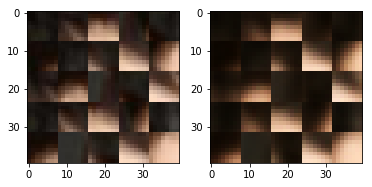

EPO: 20, recon_loss: 0.0075, total_loss: 0.0148
EPO: 20, recon_loss: 0.0034, total_loss: 0.0083
EPO: 20, recon_loss: 0.0042, total_loss: 0.0089
EPO: 20, recon_loss: 0.0058, total_loss: 0.0129
EPO: 20, recon_loss: 0.0038, total_loss: 0.0097
EPO: 20, recon_loss: 0.0109, total_loss: 0.0170
EPO: 20, recon_loss: 0.0046, total_loss: 0.0120
EPO: 20, recon_loss: 0.0068, total_loss: 0.0132
EPO: 20, recon_loss: 0.0058, total_loss: 0.0141
EPO: 20, recon_loss: 0.0012, total_loss: 0.0045
######### what? the reconstruction psnr is: 30.1753


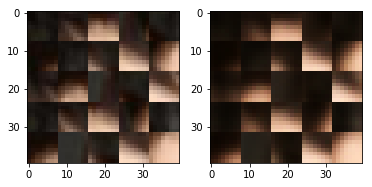

EPO: 20, recon_loss: 0.0065, total_loss: 0.0111
EPO: 20, recon_loss: 0.0036, total_loss: 0.0084
EPO: 20, recon_loss: 0.0048, total_loss: 0.0100
EPO: 20, recon_loss: 0.0041, total_loss: 0.0117
EPO: 20, recon_loss: 0.0043, total_loss: 0.0103
EPO: 20, recon_loss: 0.0105, total_loss: 0.0185
EPO: 20, recon_loss: 0.0035, total_loss: 0.0100
EPO: 20, recon_loss: 0.0084, total_loss: 0.0166
EPO: 20, recon_loss: 0.0053, total_loss: 0.0135
EPO: 20, recon_loss: 0.0018, total_loss: 0.0065
######### what? the reconstruction psnr is: 30.2214


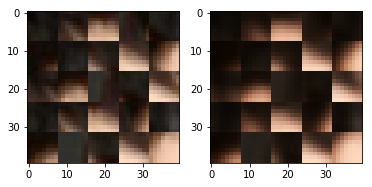

EPO: 20, recon_loss: 0.0072, total_loss: 0.0157
EPO: 20, recon_loss: 0.0029, total_loss: 0.0081
EPO: 20, recon_loss: 0.0064, total_loss: 0.0128
EPO: 20, recon_loss: 0.0027, total_loss: 0.0042
EPO: 20, recon_loss: 0.0020, total_loss: 0.0040
EPO: 20, recon_loss: 0.0047, total_loss: 0.0086
EPO: 20, recon_loss: 0.0030, total_loss: 0.0073
EPO: 20, recon_loss: 0.0032, total_loss: 0.0074
EPO: 20, recon_loss: 0.0122, total_loss: 0.0258
EPO: 20, recon_loss: 0.0086, total_loss: 0.0207
######### what? the reconstruction psnr is: 30.3071


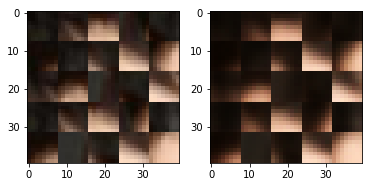

EPO: 20, recon_loss: 0.0102, total_loss: 0.0263
EPO: 20, recon_loss: 0.0069, total_loss: 0.0204
EPO: 20, recon_loss: 0.0094, total_loss: 0.0255
EPO: 20, recon_loss: 0.0025, total_loss: 0.0095
EPO: 20, recon_loss: 0.0030, total_loss: 0.0086
EPO: 20, recon_loss: 0.0089, total_loss: 0.0217
EPO: 20, recon_loss: 0.0039, total_loss: 0.0132
EPO: 20, recon_loss: 0.0042, total_loss: 0.0109
EPO: 20, recon_loss: 0.0044, total_loss: 0.0164
EPO: 20, recon_loss: 0.0044, total_loss: 0.0141
######### what? the reconstruction psnr is: 30.5690


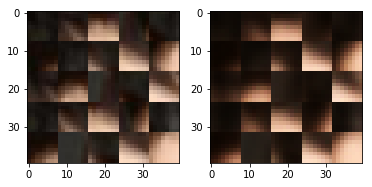

EPO: 20, recon_loss: 0.0079, total_loss: 0.0182
EPO: 20, recon_loss: 0.0042, total_loss: 0.0111
EPO: 20, recon_loss: 0.0038, total_loss: 0.0101
EPO: 20, recon_loss: 0.0054, total_loss: 0.0121
EPO: 20, recon_loss: 0.0026, total_loss: 0.0089
EPO: 20, recon_loss: 0.0093, total_loss: 0.0178
EPO: 20, recon_loss: 0.0043, total_loss: 0.0105
EPO: 20, recon_loss: 0.0027, total_loss: 0.0089
EPO: 20, recon_loss: 0.0049, total_loss: 0.0095
EPO: 20, recon_loss: 0.0024, total_loss: 0.0078
######### what? the reconstruction psnr is: 30.0372


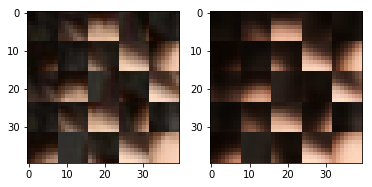

EPO: 20, recon_loss: 0.0070, total_loss: 0.0166
EPO: 20, recon_loss: 0.0072, total_loss: 0.0154
EPO: 20, recon_loss: 0.0051, total_loss: 0.0136
EPO: 20, recon_loss: 0.0098, total_loss: 0.0178
EPO: 20, recon_loss: 0.0017, total_loss: 0.0069
EPO: 20, recon_loss: 0.0057, total_loss: 0.0145
EPO: 20, recon_loss: 0.0068, total_loss: 0.0122
EPO: 20, recon_loss: 0.0055, total_loss: 0.0115
EPO: 20, recon_loss: 0.0058, total_loss: 0.0123
EPO: 20, recon_loss: 0.0020, total_loss: 0.0076
######### what? the reconstruction psnr is: 30.3778


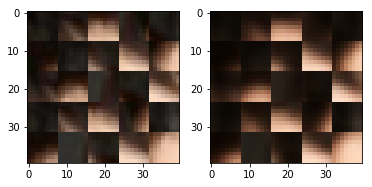

EPO: 20, recon_loss: 0.0032, total_loss: 0.0109
EPO: 20, recon_loss: 0.0028, total_loss: 0.0082
EPO: 20, recon_loss: 0.0028, total_loss: 0.0072
EPO: 20, recon_loss: 0.0027, total_loss: 0.0070
EPO: 20, recon_loss: 0.0109, total_loss: 0.0234
EPO: 20, recon_loss: 0.0077, total_loss: 0.0167
EPO: 20, recon_loss: 0.0073, total_loss: 0.0138
EPO: 20, recon_loss: 0.0073, total_loss: 0.0157
EPO: 20, recon_loss: 0.0044, total_loss: 0.0101
EPO: 20, recon_loss: 0.0060, total_loss: 0.0185
######### what? the reconstruction psnr is: 30.1761


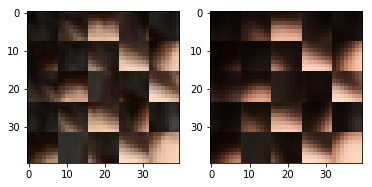

EPO: 20, recon_loss: 0.0031, total_loss: 0.0111
EPO: 20, recon_loss: 0.0083, total_loss: 0.0164
EPO: 20, recon_loss: 0.0033, total_loss: 0.0096
EPO: 20, recon_loss: 0.0077, total_loss: 0.0148
EPO: 20, recon_loss: 0.0015, total_loss: 0.0037
EPO: 20, recon_loss: 0.0010, total_loss: 0.0027
EPO: 20, recon_loss: 0.0055, total_loss: 0.0094
EPO: 20, recon_loss: 0.0016, total_loss: 0.0037
EPO: 20, recon_loss: 0.0033, total_loss: 0.0064
EPO: 20, recon_loss: 0.0048, total_loss: 0.0108
######### what? the reconstruction psnr is: 29.5242


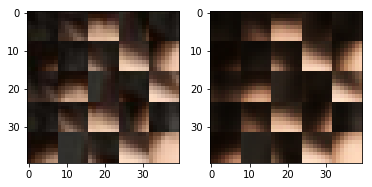

EPO: 20, recon_loss: 0.0037, total_loss: 0.0098
EPO: 20, recon_loss: 0.0049, total_loss: 0.0106
EPO: 20, recon_loss: 0.0026, total_loss: 0.0067
EPO: 20, recon_loss: 0.0033, total_loss: 0.0071
EPO: 20, recon_loss: 0.0059, total_loss: 0.0136
EPO: 20, recon_loss: 0.0054, total_loss: 0.0126
EPO: 20, recon_loss: 0.0095, total_loss: 0.0146
EPO: 20, recon_loss: 0.0067, total_loss: 0.0117
EPO: 20, recon_loss: 0.0065, total_loss: 0.0112
EPO: 20, recon_loss: 0.0092, total_loss: 0.0204
######### what? the reconstruction psnr is: 29.6025


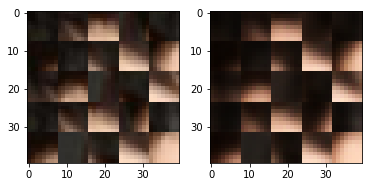

EPO: 20, recon_loss: 0.0180, total_loss: 0.0310
EPO: 20, recon_loss: 0.0088, total_loss: 0.0144
EPO: 20, recon_loss: 0.0067, total_loss: 0.0118
EPO: 20, recon_loss: 0.0101, total_loss: 0.0149
EPO: 20, recon_loss: 0.0023, total_loss: 0.0079
EPO: 20, recon_loss: 0.0015, total_loss: 0.0064
EPO: 20, recon_loss: 0.0048, total_loss: 0.0093
EPO: 20, recon_loss: 0.0028, total_loss: 0.0086
EPO: 20, recon_loss: 0.0041, total_loss: 0.0080
EPO: 20, recon_loss: 0.0039, total_loss: 0.0167
######### what? the reconstruction psnr is: 30.1622


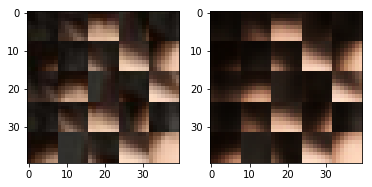

EPO: 20, recon_loss: 0.0016, total_loss: 0.0068
EPO: 20, recon_loss: 0.0035, total_loss: 0.0094
EPO: 20, recon_loss: 0.0016, total_loss: 0.0043
EPO: 20, recon_loss: 0.0013, total_loss: 0.0030
EPO: 20, recon_loss: 0.0051, total_loss: 0.0126
EPO: 20, recon_loss: 0.0057, total_loss: 0.0123
EPO: 20, recon_loss: 0.0111, total_loss: 0.0178
EPO: 20, recon_loss: 0.0118, total_loss: 0.0183
EPO: 20, recon_loss: 0.0097, total_loss: 0.0160
EPO: 21, recon_loss: 0.0043, total_loss: 0.0090
######### what? the reconstruction psnr is: 29.9761


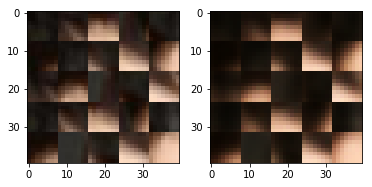

EPO: 21, recon_loss: 0.0021, total_loss: 0.0044
EPO: 21, recon_loss: 0.0067, total_loss: 0.0098
EPO: 21, recon_loss: 0.0035, total_loss: 0.0077
EPO: 21, recon_loss: 0.0027, total_loss: 0.0055
EPO: 21, recon_loss: 0.0042, total_loss: 0.0155
EPO: 21, recon_loss: 0.0018, total_loss: 0.0067
EPO: 21, recon_loss: 0.0039, total_loss: 0.0092
EPO: 21, recon_loss: 0.0055, total_loss: 0.0101
EPO: 21, recon_loss: 0.0051, total_loss: 0.0100
EPO: 21, recon_loss: 0.0057, total_loss: 0.0131
######### what? the reconstruction psnr is: 29.9900


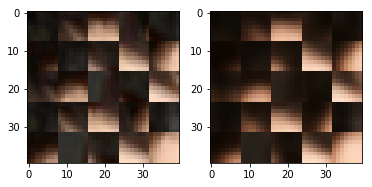

EPO: 21, recon_loss: 0.0024, total_loss: 0.0076
EPO: 21, recon_loss: 0.0034, total_loss: 0.0094
EPO: 21, recon_loss: 0.0029, total_loss: 0.0065
EPO: 21, recon_loss: 0.0035, total_loss: 0.0071
EPO: 21, recon_loss: 0.0101, total_loss: 0.0163
EPO: 21, recon_loss: 0.0035, total_loss: 0.0084
EPO: 21, recon_loss: 0.0042, total_loss: 0.0105
EPO: 21, recon_loss: 0.0045, total_loss: 0.0102
EPO: 21, recon_loss: 0.0036, total_loss: 0.0082
EPO: 21, recon_loss: 0.0037, total_loss: 0.0089
######### what? the reconstruction psnr is: 30.3425


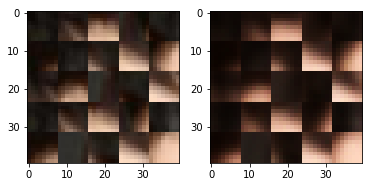

EPO: 21, recon_loss: 0.0034, total_loss: 0.0066
EPO: 21, recon_loss: 0.0036, total_loss: 0.0076
EPO: 21, recon_loss: 0.0088, total_loss: 0.0135
EPO: 21, recon_loss: 0.0024, total_loss: 0.0057
EPO: 21, recon_loss: 0.0055, total_loss: 0.0085
EPO: 21, recon_loss: 0.0086, total_loss: 0.0191
EPO: 21, recon_loss: 0.0039, total_loss: 0.0108
EPO: 21, recon_loss: 0.0091, total_loss: 0.0168
EPO: 21, recon_loss: 0.0073, total_loss: 0.0138
EPO: 21, recon_loss: 0.0118, total_loss: 0.0183
######### what? the reconstruction psnr is: 29.8861


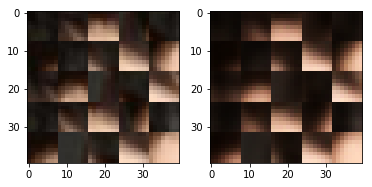

EPO: 21, recon_loss: 0.0051, total_loss: 0.0144
EPO: 21, recon_loss: 0.0024, total_loss: 0.0076
EPO: 21, recon_loss: 0.0060, total_loss: 0.0113
EPO: 21, recon_loss: 0.0045, total_loss: 0.0074
EPO: 21, recon_loss: 0.0042, total_loss: 0.0085
EPO: 21, recon_loss: 0.0013, total_loss: 0.0030
EPO: 21, recon_loss: 0.0019, total_loss: 0.0046
EPO: 21, recon_loss: 0.0061, total_loss: 0.0115
EPO: 21, recon_loss: 0.0030, total_loss: 0.0075
EPO: 21, recon_loss: 0.0046, total_loss: 0.0115
######### what? the reconstruction psnr is: 30.2046


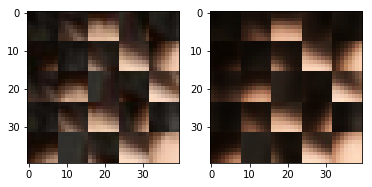

EPO: 21, recon_loss: 0.0016, total_loss: 0.0088
EPO: 21, recon_loss: 0.0022, total_loss: 0.0091
EPO: 21, recon_loss: 0.0055, total_loss: 0.0120
EPO: 21, recon_loss: 0.0013, total_loss: 0.0053
EPO: 21, recon_loss: 0.0047, total_loss: 0.0103
EPO: 21, recon_loss: 0.0090, total_loss: 0.0226
EPO: 21, recon_loss: 0.0023, total_loss: 0.0074
EPO: 21, recon_loss: 0.0126, total_loss: 0.0192
EPO: 21, recon_loss: 0.0031, total_loss: 0.0068
EPO: 21, recon_loss: 0.0032, total_loss: 0.0063
######### what? the reconstruction psnr is: 30.3030


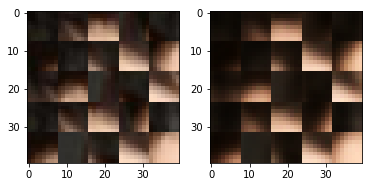

EPO: 21, recon_loss: 0.0070, total_loss: 0.0133
EPO: 21, recon_loss: 0.0031, total_loss: 0.0071
EPO: 21, recon_loss: 0.0066, total_loss: 0.0126
EPO: 21, recon_loss: 0.0038, total_loss: 0.0073
EPO: 21, recon_loss: 0.0058, total_loss: 0.0110
EPO: 21, recon_loss: 0.0161, total_loss: 0.0268
EPO: 21, recon_loss: 0.0086, total_loss: 0.0177
EPO: 21, recon_loss: 0.0156, total_loss: 0.0264
EPO: 21, recon_loss: 0.0096, total_loss: 0.0185
EPO: 21, recon_loss: 0.0082, total_loss: 0.0173
######### what? the reconstruction psnr is: 29.5822


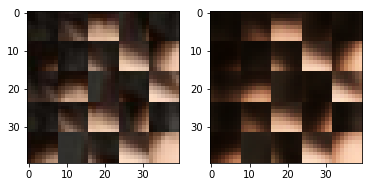

EPO: 21, recon_loss: 0.0034, total_loss: 0.0108
EPO: 21, recon_loss: 0.0039, total_loss: 0.0090
EPO: 21, recon_loss: 0.0055, total_loss: 0.0134
EPO: 21, recon_loss: 0.0064, total_loss: 0.0114
EPO: 21, recon_loss: 0.0064, total_loss: 0.0151
EPO: 21, recon_loss: 0.0042, total_loss: 0.0143
EPO: 21, recon_loss: 0.0017, total_loss: 0.0079
EPO: 21, recon_loss: 0.0079, total_loss: 0.0151
EPO: 21, recon_loss: 0.0047, total_loss: 0.0108
EPO: 21, recon_loss: 0.0041, total_loss: 0.0108
######### what? the reconstruction psnr is: 29.6714


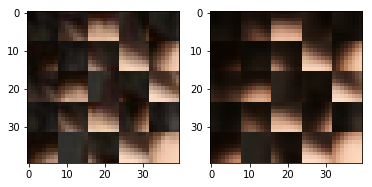

EPO: 21, recon_loss: 0.0079, total_loss: 0.0192
EPO: 21, recon_loss: 0.0061, total_loss: 0.0184
EPO: 21, recon_loss: 0.0138, total_loss: 0.0279
EPO: 21, recon_loss: 0.0124, total_loss: 0.0261
EPO: 21, recon_loss: 0.0060, total_loss: 0.0177
EPO: 21, recon_loss: 0.0198, total_loss: 0.0345
EPO: 21, recon_loss: 0.0064, total_loss: 0.0182
EPO: 21, recon_loss: 0.0108, total_loss: 0.0244
EPO: 21, recon_loss: 0.0153, total_loss: 0.0289
EPO: 21, recon_loss: 0.0096, total_loss: 0.0236
######### what? the reconstruction psnr is: 30.4567


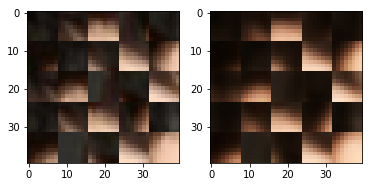

EPO: 21, recon_loss: 0.0112, total_loss: 0.0232
EPO: 21, recon_loss: 0.0025, total_loss: 0.0129
EPO: 21, recon_loss: 0.0133, total_loss: 0.0252
EPO: 21, recon_loss: 0.0157, total_loss: 0.0234
EPO: 21, recon_loss: 0.0045, total_loss: 0.0089
EPO: 21, recon_loss: 0.0039, total_loss: 0.0079
EPO: 21, recon_loss: 0.0022, total_loss: 0.0071
EPO: 21, recon_loss: 0.0037, total_loss: 0.0110
EPO: 21, recon_loss: 0.0067, total_loss: 0.0139
EPO: 21, recon_loss: 0.0045, total_loss: 0.0124
######### what? the reconstruction psnr is: 30.2977


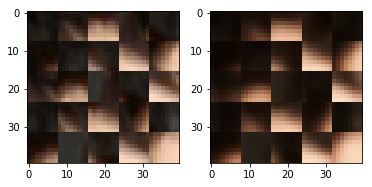

EPO: 21, recon_loss: 0.0084, total_loss: 0.0171
EPO: 21, recon_loss: 0.0006, total_loss: 0.0028
EPO: 21, recon_loss: 0.0008, total_loss: 0.0031
EPO: 21, recon_loss: 0.0021, total_loss: 0.0044
EPO: 21, recon_loss: 0.0010, total_loss: 0.0025
EPO: 21, recon_loss: 0.0029, total_loss: 0.0058
EPO: 21, recon_loss: 0.0031, total_loss: 0.0087
EPO: 21, recon_loss: 0.0040, total_loss: 0.0088
EPO: 21, recon_loss: 0.0068, total_loss: 0.0131
EPO: 21, recon_loss: 0.0030, total_loss: 0.0060
######### what? the reconstruction psnr is: 30.0081


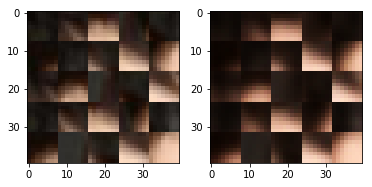

EPO: 21, recon_loss: 0.0049, total_loss: 0.0081
EPO: 21, recon_loss: 0.0067, total_loss: 0.0166
EPO: 21, recon_loss: 0.0112, total_loss: 0.0230
EPO: 21, recon_loss: 0.0079, total_loss: 0.0187
EPO: 21, recon_loss: 0.0057, total_loss: 0.0132
EPO: 21, recon_loss: 0.0065, total_loss: 0.0121
EPO: 21, recon_loss: 0.0043, total_loss: 0.0101
EPO: 21, recon_loss: 0.0037, total_loss: 0.0075
EPO: 21, recon_loss: 0.0055, total_loss: 0.0111
EPO: 21, recon_loss: 0.0025, total_loss: 0.0057
######### what? the reconstruction psnr is: 29.7070


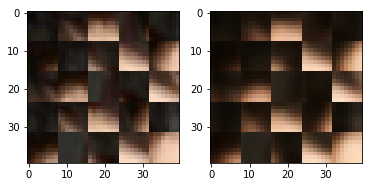

EPO: 21, recon_loss: 0.0035, total_loss: 0.0077
EPO: 21, recon_loss: 0.0038, total_loss: 0.0152
EPO: 21, recon_loss: 0.0012, total_loss: 0.0057
EPO: 21, recon_loss: 0.0080, total_loss: 0.0156
EPO: 21, recon_loss: 0.0049, total_loss: 0.0097
EPO: 21, recon_loss: 0.0049, total_loss: 0.0107
EPO: 21, recon_loss: 0.0019, total_loss: 0.0043
EPO: 21, recon_loss: 0.0014, total_loss: 0.0040
EPO: 21, recon_loss: 0.0033, total_loss: 0.0072
EPO: 21, recon_loss: 0.0012, total_loss: 0.0042
######### what? the reconstruction psnr is: 29.8028


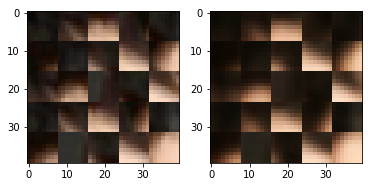

EPO: 21, recon_loss: 0.0017, total_loss: 0.0041
EPO: 21, recon_loss: 0.0037, total_loss: 0.0093
EPO: 21, recon_loss: 0.0025, total_loss: 0.0067
EPO: 21, recon_loss: 0.0084, total_loss: 0.0145
EPO: 21, recon_loss: 0.0037, total_loss: 0.0093
EPO: 21, recon_loss: 0.0031, total_loss: 0.0075
EPO: 21, recon_loss: 0.0036, total_loss: 0.0141
EPO: 21, recon_loss: 0.0039, total_loss: 0.0114
EPO: 21, recon_loss: 0.0128, total_loss: 0.0219
EPO: 21, recon_loss: 0.0049, total_loss: 0.0110
######### what? the reconstruction psnr is: 29.6895


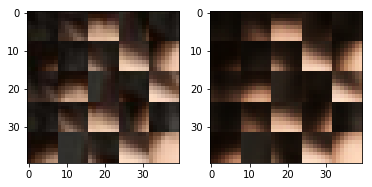

EPO: 21, recon_loss: 0.0065, total_loss: 0.0140
EPO: 21, recon_loss: 0.0022, total_loss: 0.0088
EPO: 21, recon_loss: 0.0006, total_loss: 0.0036
EPO: 21, recon_loss: 0.0046, total_loss: 0.0106
EPO: 21, recon_loss: 0.0058, total_loss: 0.0101
EPO: 21, recon_loss: 0.0052, total_loss: 0.0110
EPO: 21, recon_loss: 0.0054, total_loss: 0.0124
EPO: 21, recon_loss: 0.0080, total_loss: 0.0148
EPO: 21, recon_loss: 0.0063, total_loss: 0.0138
EPO: 21, recon_loss: 0.0059, total_loss: 0.0125
######### what? the reconstruction psnr is: 30.3991


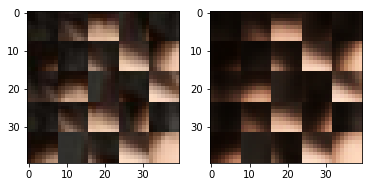

EPO: 21, recon_loss: 0.0020, total_loss: 0.0059
EPO: 21, recon_loss: 0.0074, total_loss: 0.0145
EPO: 21, recon_loss: 0.0019, total_loss: 0.0057
EPO: 21, recon_loss: 0.0072, total_loss: 0.0135
EPO: 21, recon_loss: 0.0074, total_loss: 0.0142
EPO: 21, recon_loss: 0.0036, total_loss: 0.0082
EPO: 21, recon_loss: 0.0037, total_loss: 0.0085
EPO: 21, recon_loss: 0.0045, total_loss: 0.0104
EPO: 21, recon_loss: 0.0041, total_loss: 0.0103
EPO: 21, recon_loss: 0.0087, total_loss: 0.0145
######### what? the reconstruction psnr is: 30.3365


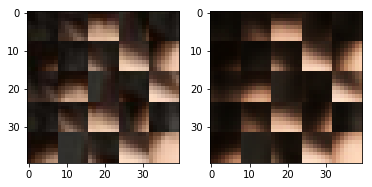

EPO: 21, recon_loss: 0.0051, total_loss: 0.0127
EPO: 21, recon_loss: 0.0080, total_loss: 0.0142
EPO: 21, recon_loss: 0.0043, total_loss: 0.0100
EPO: 21, recon_loss: 0.0018, total_loss: 0.0051
EPO: 21, recon_loss: 0.0043, total_loss: 0.0085
EPO: 21, recon_loss: 0.0038, total_loss: 0.0089
EPO: 21, recon_loss: 0.0063, total_loss: 0.0131
EPO: 21, recon_loss: 0.0040, total_loss: 0.0105
EPO: 21, recon_loss: 0.0046, total_loss: 0.0110
EPO: 21, recon_loss: 0.0125, total_loss: 0.0213
######### what? the reconstruction psnr is: 29.9869


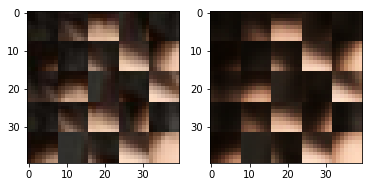

EPO: 21, recon_loss: 0.0037, total_loss: 0.0105
EPO: 21, recon_loss: 0.0100, total_loss: 0.0200
EPO: 21, recon_loss: 0.0029, total_loss: 0.0084
EPO: 21, recon_loss: 0.0018, total_loss: 0.0068
EPO: 21, recon_loss: 0.0075, total_loss: 0.0166
EPO: 21, recon_loss: 0.0037, total_loss: 0.0095
EPO: 21, recon_loss: 0.0089, total_loss: 0.0158
EPO: 21, recon_loss: 0.0026, total_loss: 0.0042
EPO: 21, recon_loss: 0.0019, total_loss: 0.0038
EPO: 21, recon_loss: 0.0052, total_loss: 0.0094
######### what? the reconstruction psnr is: 30.1777


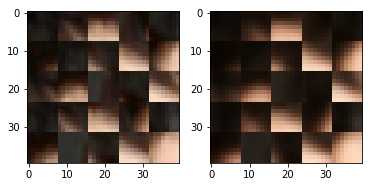

EPO: 21, recon_loss: 0.0020, total_loss: 0.0063
EPO: 21, recon_loss: 0.0039, total_loss: 0.0095
EPO: 21, recon_loss: 0.0115, total_loss: 0.0254
EPO: 21, recon_loss: 0.0086, total_loss: 0.0205
EPO: 21, recon_loss: 0.0134, total_loss: 0.0299
EPO: 21, recon_loss: 0.0065, total_loss: 0.0185
EPO: 21, recon_loss: 0.0116, total_loss: 0.0280
EPO: 21, recon_loss: 0.0025, total_loss: 0.0094
EPO: 21, recon_loss: 0.0049, total_loss: 0.0104
EPO: 21, recon_loss: 0.0072, total_loss: 0.0197
######### what? the reconstruction psnr is: 30.5586


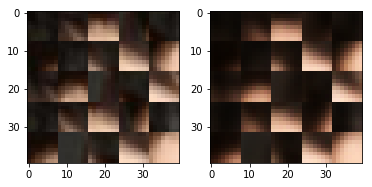

EPO: 21, recon_loss: 0.0040, total_loss: 0.0121
EPO: 21, recon_loss: 0.0041, total_loss: 0.0110
EPO: 21, recon_loss: 0.0043, total_loss: 0.0159
EPO: 21, recon_loss: 0.0047, total_loss: 0.0144
EPO: 21, recon_loss: 0.0111, total_loss: 0.0214
EPO: 21, recon_loss: 0.0027, total_loss: 0.0091
EPO: 21, recon_loss: 0.0027, total_loss: 0.0085
EPO: 21, recon_loss: 0.0053, total_loss: 0.0132
EPO: 21, recon_loss: 0.0020, total_loss: 0.0083
EPO: 21, recon_loss: 0.0104, total_loss: 0.0188
######### what? the reconstruction psnr is: 30.5165


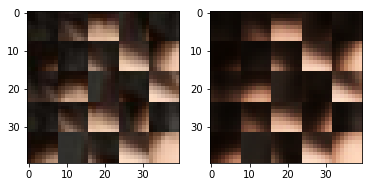

EPO: 21, recon_loss: 0.0025, total_loss: 0.0086
EPO: 21, recon_loss: 0.0033, total_loss: 0.0092
EPO: 21, recon_loss: 0.0047, total_loss: 0.0091
EPO: 21, recon_loss: 0.0024, total_loss: 0.0085
EPO: 21, recon_loss: 0.0108, total_loss: 0.0193
EPO: 21, recon_loss: 0.0056, total_loss: 0.0141
EPO: 21, recon_loss: 0.0046, total_loss: 0.0113
EPO: 21, recon_loss: 0.0052, total_loss: 0.0187
EPO: 21, recon_loss: 0.0016, total_loss: 0.0069
EPO: 21, recon_loss: 0.0080, total_loss: 0.0189
######### what? the reconstruction psnr is: 30.6277


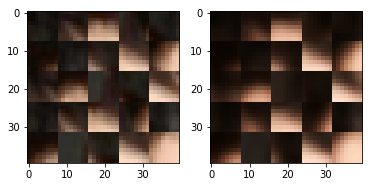

EPO: 21, recon_loss: 0.0047, total_loss: 0.0087
EPO: 21, recon_loss: 0.0047, total_loss: 0.0104
EPO: 21, recon_loss: 0.0036, total_loss: 0.0118
EPO: 21, recon_loss: 0.0019, total_loss: 0.0075
EPO: 21, recon_loss: 0.0040, total_loss: 0.0116
EPO: 21, recon_loss: 0.0021, total_loss: 0.0068
EPO: 21, recon_loss: 0.0035, total_loss: 0.0081
EPO: 21, recon_loss: 0.0079, total_loss: 0.0173
EPO: 21, recon_loss: 0.0120, total_loss: 0.0239
EPO: 21, recon_loss: 0.0065, total_loss: 0.0146
######### what? the reconstruction psnr is: 29.6730


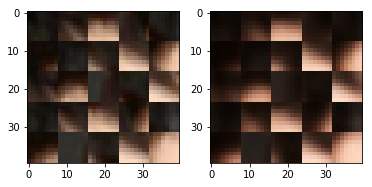

EPO: 21, recon_loss: 0.0068, total_loss: 0.0147
EPO: 21, recon_loss: 0.0072, total_loss: 0.0155
EPO: 21, recon_loss: 0.0039, total_loss: 0.0082
EPO: 21, recon_loss: 0.0045, total_loss: 0.0150
EPO: 21, recon_loss: 0.0040, total_loss: 0.0121
EPO: 21, recon_loss: 0.0065, total_loss: 0.0147
EPO: 21, recon_loss: 0.0046, total_loss: 0.0114
EPO: 21, recon_loss: 0.0089, total_loss: 0.0170
EPO: 21, recon_loss: 0.0011, total_loss: 0.0028
EPO: 21, recon_loss: 0.0021, total_loss: 0.0051
######### what? the reconstruction psnr is: 30.2015


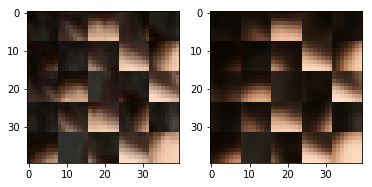

EPO: 21, recon_loss: 0.0037, total_loss: 0.0065
EPO: 21, recon_loss: 0.0015, total_loss: 0.0035
EPO: 21, recon_loss: 0.0036, total_loss: 0.0071
EPO: 21, recon_loss: 0.0053, total_loss: 0.0123
EPO: 21, recon_loss: 0.0037, total_loss: 0.0094
EPO: 21, recon_loss: 0.0046, total_loss: 0.0105
EPO: 21, recon_loss: 0.0031, total_loss: 0.0071
EPO: 21, recon_loss: 0.0044, total_loss: 0.0089
EPO: 21, recon_loss: 0.0051, total_loss: 0.0120
EPO: 21, recon_loss: 0.0048, total_loss: 0.0119
######### what? the reconstruction psnr is: 29.8343


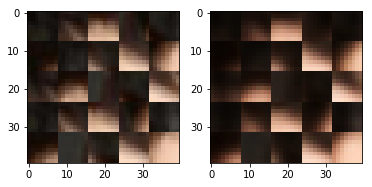

EPO: 21, recon_loss: 0.0102, total_loss: 0.0154
EPO: 21, recon_loss: 0.0054, total_loss: 0.0105
EPO: 21, recon_loss: 0.0080, total_loss: 0.0133
EPO: 21, recon_loss: 0.0128, total_loss: 0.0250
EPO: 21, recon_loss: 0.0121, total_loss: 0.0200
EPO: 21, recon_loss: 0.0080, total_loss: 0.0138
EPO: 21, recon_loss: 0.0067, total_loss: 0.0110
EPO: 21, recon_loss: 0.0113, total_loss: 0.0159
EPO: 21, recon_loss: 0.0017, total_loss: 0.0062
EPO: 21, recon_loss: 0.0023, total_loss: 0.0074
######### what? the reconstruction psnr is: 29.4507


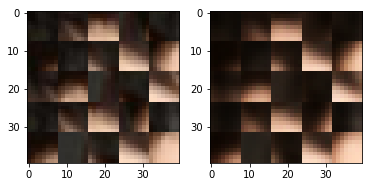

EPO: 21, recon_loss: 0.0061, total_loss: 0.0101
EPO: 21, recon_loss: 0.0038, total_loss: 0.0104
EPO: 21, recon_loss: 0.0062, total_loss: 0.0112
EPO: 21, recon_loss: 0.0037, total_loss: 0.0150
EPO: 21, recon_loss: 0.0015, total_loss: 0.0067
EPO: 21, recon_loss: 0.0056, total_loss: 0.0113
EPO: 21, recon_loss: 0.0010, total_loss: 0.0031
EPO: 21, recon_loss: 0.0017, total_loss: 0.0034
EPO: 21, recon_loss: 0.0058, total_loss: 0.0127
EPO: 21, recon_loss: 0.0060, total_loss: 0.0128
######### what? the reconstruction psnr is: 29.9512


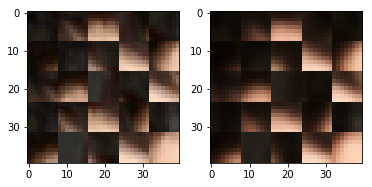

EPO: 21, recon_loss: 0.0155, total_loss: 0.0227
EPO: 21, recon_loss: 0.0115, total_loss: 0.0178
EPO: 21, recon_loss: 0.0085, total_loss: 0.0138
EPO: 22, recon_loss: 0.0032, total_loss: 0.0069
EPO: 22, recon_loss: 0.0020, total_loss: 0.0043
EPO: 22, recon_loss: 0.0082, total_loss: 0.0117
EPO: 22, recon_loss: 0.0022, total_loss: 0.0051
EPO: 22, recon_loss: 0.0025, total_loss: 0.0050
EPO: 22, recon_loss: 0.0030, total_loss: 0.0115
EPO: 22, recon_loss: 0.0018, total_loss: 0.0067
######### what? the reconstruction psnr is: 30.3501


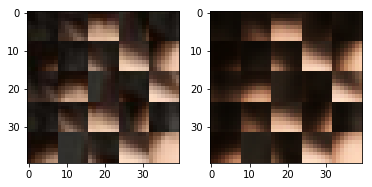

EPO: 22, recon_loss: 0.0033, total_loss: 0.0084
EPO: 22, recon_loss: 0.0027, total_loss: 0.0056
EPO: 22, recon_loss: 0.0060, total_loss: 0.0111
EPO: 22, recon_loss: 0.0027, total_loss: 0.0106
EPO: 22, recon_loss: 0.0020, total_loss: 0.0065
EPO: 22, recon_loss: 0.0031, total_loss: 0.0088
EPO: 22, recon_loss: 0.0026, total_loss: 0.0055
EPO: 22, recon_loss: 0.0037, total_loss: 0.0079
EPO: 22, recon_loss: 0.0037, total_loss: 0.0091
EPO: 22, recon_loss: 0.0041, total_loss: 0.0099
######### what? the reconstruction psnr is: 30.4740


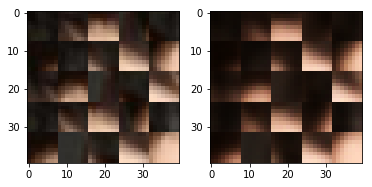

EPO: 22, recon_loss: 0.0039, total_loss: 0.0090
EPO: 22, recon_loss: 0.0037, total_loss: 0.0089
EPO: 22, recon_loss: 0.0030, total_loss: 0.0069
EPO: 22, recon_loss: 0.0038, total_loss: 0.0072
EPO: 22, recon_loss: 0.0024, total_loss: 0.0058
EPO: 22, recon_loss: 0.0041, total_loss: 0.0087
EPO: 22, recon_loss: 0.0073, total_loss: 0.0120
EPO: 22, recon_loss: 0.0024, total_loss: 0.0051
EPO: 22, recon_loss: 0.0054, total_loss: 0.0105
EPO: 22, recon_loss: 0.0042, total_loss: 0.0111
######### what? the reconstruction psnr is: 29.7317


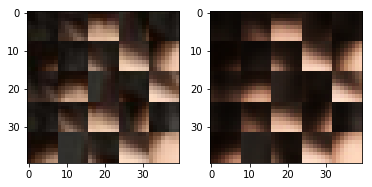

EPO: 22, recon_loss: 0.0043, total_loss: 0.0110
EPO: 22, recon_loss: 0.0086, total_loss: 0.0160
EPO: 22, recon_loss: 0.0081, total_loss: 0.0164
EPO: 22, recon_loss: 0.0082, total_loss: 0.0137
EPO: 22, recon_loss: 0.0039, total_loss: 0.0107
EPO: 22, recon_loss: 0.0031, total_loss: 0.0096
EPO: 22, recon_loss: 0.0055, total_loss: 0.0100
EPO: 22, recon_loss: 0.0041, total_loss: 0.0071
EPO: 22, recon_loss: 0.0048, total_loss: 0.0101
EPO: 22, recon_loss: 0.0013, total_loss: 0.0030
######### what? the reconstruction psnr is: 29.3876


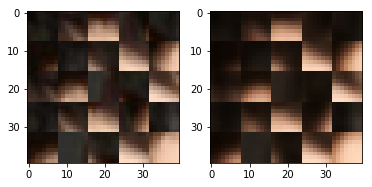

EPO: 22, recon_loss: 0.0029, total_loss: 0.0071
EPO: 22, recon_loss: 0.0053, total_loss: 0.0096
EPO: 22, recon_loss: 0.0035, total_loss: 0.0082
EPO: 22, recon_loss: 0.0059, total_loss: 0.0130
EPO: 22, recon_loss: 0.0017, total_loss: 0.0087
EPO: 22, recon_loss: 0.0018, total_loss: 0.0082
EPO: 22, recon_loss: 0.0060, total_loss: 0.0117
EPO: 22, recon_loss: 0.0014, total_loss: 0.0055
EPO: 22, recon_loss: 0.0058, total_loss: 0.0119
EPO: 22, recon_loss: 0.0083, total_loss: 0.0220
######### what? the reconstruction psnr is: 30.7904


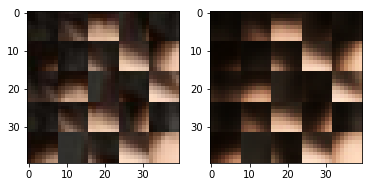

EPO: 22, recon_loss: 0.0030, total_loss: 0.0085
EPO: 22, recon_loss: 0.0085, total_loss: 0.0145
EPO: 22, recon_loss: 0.0026, total_loss: 0.0057
EPO: 22, recon_loss: 0.0044, total_loss: 0.0080
EPO: 22, recon_loss: 0.0064, total_loss: 0.0128
EPO: 22, recon_loss: 0.0025, total_loss: 0.0062
EPO: 22, recon_loss: 0.0061, total_loss: 0.0121
EPO: 22, recon_loss: 0.0037, total_loss: 0.0071
EPO: 22, recon_loss: 0.0066, total_loss: 0.0133
EPO: 22, recon_loss: 0.0096, total_loss: 0.0182
######### what? the reconstruction psnr is: 30.3974


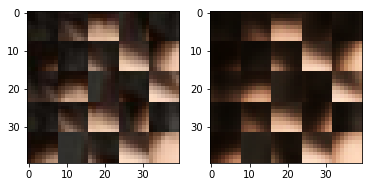

EPO: 22, recon_loss: 0.0096, total_loss: 0.0189
EPO: 22, recon_loss: 0.0196, total_loss: 0.0305
EPO: 22, recon_loss: 0.0112, total_loss: 0.0207
EPO: 22, recon_loss: 0.0083, total_loss: 0.0166
EPO: 22, recon_loss: 0.0033, total_loss: 0.0099
EPO: 22, recon_loss: 0.0039, total_loss: 0.0097
EPO: 22, recon_loss: 0.0059, total_loss: 0.0124
EPO: 22, recon_loss: 0.0045, total_loss: 0.0096
EPO: 22, recon_loss: 0.0065, total_loss: 0.0141
EPO: 22, recon_loss: 0.0035, total_loss: 0.0115
######### what? the reconstruction psnr is: 30.2463


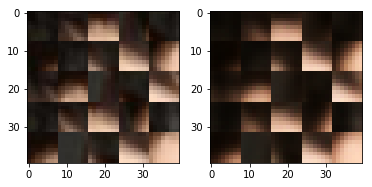

EPO: 22, recon_loss: 0.0017, total_loss: 0.0077
EPO: 22, recon_loss: 0.0084, total_loss: 0.0146
EPO: 22, recon_loss: 0.0034, total_loss: 0.0099
EPO: 22, recon_loss: 0.0039, total_loss: 0.0098
EPO: 22, recon_loss: 0.0082, total_loss: 0.0196
EPO: 22, recon_loss: 0.0064, total_loss: 0.0206
EPO: 22, recon_loss: 0.0144, total_loss: 0.0277
EPO: 22, recon_loss: 0.0078, total_loss: 0.0200
EPO: 22, recon_loss: 0.0063, total_loss: 0.0175
EPO: 22, recon_loss: 0.0112, total_loss: 0.0227
######### what? the reconstruction psnr is: 30.6591


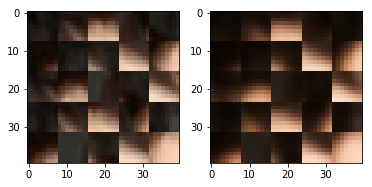

EPO: 22, recon_loss: 0.0064, total_loss: 0.0183
EPO: 22, recon_loss: 0.0163, total_loss: 0.0312
EPO: 22, recon_loss: 0.0111, total_loss: 0.0241
EPO: 22, recon_loss: 0.0097, total_loss: 0.0234
EPO: 22, recon_loss: 0.0037, total_loss: 0.0145
EPO: 22, recon_loss: 0.0035, total_loss: 0.0148
EPO: 22, recon_loss: 0.0166, total_loss: 0.0274
EPO: 22, recon_loss: 0.0176, total_loss: 0.0245
EPO: 22, recon_loss: 0.0030, total_loss: 0.0067
EPO: 22, recon_loss: 0.0039, total_loss: 0.0081
######### what? the reconstruction psnr is: 30.2589


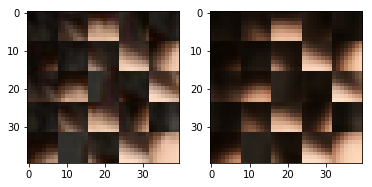

EPO: 22, recon_loss: 0.0024, total_loss: 0.0083
EPO: 22, recon_loss: 0.0052, total_loss: 0.0120
EPO: 22, recon_loss: 0.0055, total_loss: 0.0125
EPO: 22, recon_loss: 0.0048, total_loss: 0.0136
EPO: 22, recon_loss: 0.0106, total_loss: 0.0200
EPO: 22, recon_loss: 0.0006, total_loss: 0.0026
EPO: 22, recon_loss: 0.0009, total_loss: 0.0033
EPO: 22, recon_loss: 0.0017, total_loss: 0.0034
EPO: 22, recon_loss: 0.0011, total_loss: 0.0027
EPO: 22, recon_loss: 0.0036, total_loss: 0.0068
######### what? the reconstruction psnr is: 30.4023


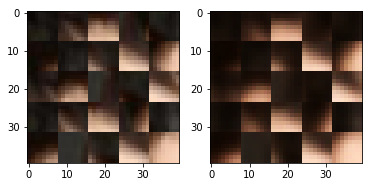

EPO: 22, recon_loss: 0.0028, total_loss: 0.0077
EPO: 22, recon_loss: 0.0043, total_loss: 0.0099
EPO: 22, recon_loss: 0.0070, total_loss: 0.0129
EPO: 22, recon_loss: 0.0030, total_loss: 0.0059
EPO: 22, recon_loss: 0.0076, total_loss: 0.0117
EPO: 22, recon_loss: 0.0067, total_loss: 0.0167
EPO: 22, recon_loss: 0.0097, total_loss: 0.0202
EPO: 22, recon_loss: 0.0075, total_loss: 0.0178
EPO: 22, recon_loss: 0.0054, total_loss: 0.0119
EPO: 22, recon_loss: 0.0074, total_loss: 0.0135
######### what? the reconstruction psnr is: 29.8216


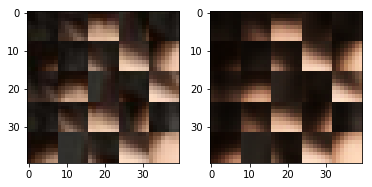

EPO: 22, recon_loss: 0.0046, total_loss: 0.0103
EPO: 22, recon_loss: 0.0037, total_loss: 0.0076
EPO: 22, recon_loss: 0.0056, total_loss: 0.0110
EPO: 22, recon_loss: 0.0037, total_loss: 0.0076
EPO: 22, recon_loss: 0.0049, total_loss: 0.0099
EPO: 22, recon_loss: 0.0035, total_loss: 0.0134
EPO: 22, recon_loss: 0.0021, total_loss: 0.0060
EPO: 22, recon_loss: 0.0066, total_loss: 0.0129
EPO: 22, recon_loss: 0.0052, total_loss: 0.0101
EPO: 22, recon_loss: 0.0062, total_loss: 0.0138
######### what? the reconstruction psnr is: 30.1308


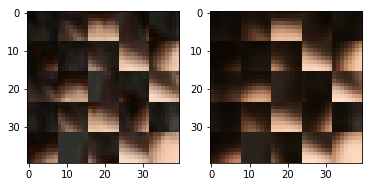

EPO: 22, recon_loss: 0.0017, total_loss: 0.0043
EPO: 22, recon_loss: 0.0016, total_loss: 0.0043
EPO: 22, recon_loss: 0.0032, total_loss: 0.0071
EPO: 22, recon_loss: 0.0011, total_loss: 0.0037
EPO: 22, recon_loss: 0.0017, total_loss: 0.0039
EPO: 22, recon_loss: 0.0035, total_loss: 0.0084
EPO: 22, recon_loss: 0.0023, total_loss: 0.0065
EPO: 22, recon_loss: 0.0095, total_loss: 0.0165
EPO: 22, recon_loss: 0.0043, total_loss: 0.0104
EPO: 22, recon_loss: 0.0030, total_loss: 0.0069
######### what? the reconstruction psnr is: 29.7781


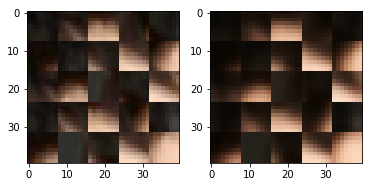

EPO: 22, recon_loss: 0.0029, total_loss: 0.0109
EPO: 22, recon_loss: 0.0033, total_loss: 0.0103
EPO: 22, recon_loss: 0.0134, total_loss: 0.0228
EPO: 22, recon_loss: 0.0040, total_loss: 0.0097
EPO: 22, recon_loss: 0.0099, total_loss: 0.0175
EPO: 22, recon_loss: 0.0014, total_loss: 0.0068
EPO: 22, recon_loss: 0.0006, total_loss: 0.0036
EPO: 22, recon_loss: 0.0082, total_loss: 0.0150
EPO: 22, recon_loss: 0.0050, total_loss: 0.0088
EPO: 22, recon_loss: 0.0051, total_loss: 0.0098
######### what? the reconstruction psnr is: 29.7449


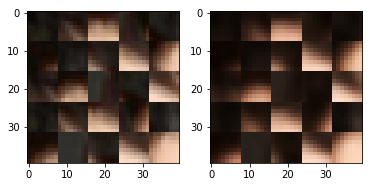

EPO: 22, recon_loss: 0.0055, total_loss: 0.0115
EPO: 22, recon_loss: 0.0070, total_loss: 0.0146
EPO: 22, recon_loss: 0.0078, total_loss: 0.0143
EPO: 22, recon_loss: 0.0034, total_loss: 0.0085
EPO: 22, recon_loss: 0.0022, total_loss: 0.0059
EPO: 22, recon_loss: 0.0039, total_loss: 0.0096
EPO: 22, recon_loss: 0.0016, total_loss: 0.0054
EPO: 22, recon_loss: 0.0083, total_loss: 0.0163
EPO: 22, recon_loss: 0.0024, total_loss: 0.0068
EPO: 22, recon_loss: 0.0031, total_loss: 0.0075
######### what? the reconstruction psnr is: 30.0108


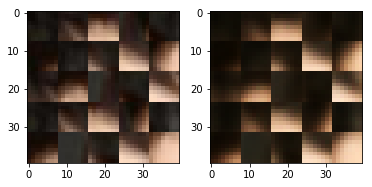

EPO: 22, recon_loss: 0.0057, total_loss: 0.0121
EPO: 22, recon_loss: 0.0040, total_loss: 0.0100
EPO: 22, recon_loss: 0.0043, total_loss: 0.0104
EPO: 22, recon_loss: 0.0068, total_loss: 0.0124
EPO: 22, recon_loss: 0.0055, total_loss: 0.0130
EPO: 22, recon_loss: 0.0060, total_loss: 0.0200
EPO: 22, recon_loss: 0.0034, total_loss: 0.0078
EPO: 22, recon_loss: 0.0027, total_loss: 0.0069
EPO: 22, recon_loss: 0.0029, total_loss: 0.0066
EPO: 22, recon_loss: 0.0052, total_loss: 0.0111
######### what? the reconstruction psnr is: 30.5241


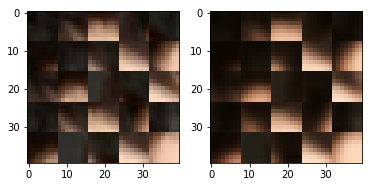

EPO: 22, recon_loss: 0.0048, total_loss: 0.0111
EPO: 22, recon_loss: 0.0027, total_loss: 0.0079
EPO: 22, recon_loss: 0.0070, total_loss: 0.0137
EPO: 22, recon_loss: 0.0097, total_loss: 0.0180
EPO: 22, recon_loss: 0.0047, total_loss: 0.0130
EPO: 22, recon_loss: 0.0101, total_loss: 0.0194
EPO: 22, recon_loss: 0.0024, total_loss: 0.0078
EPO: 22, recon_loss: 0.0029, total_loss: 0.0088
EPO: 22, recon_loss: 0.0063, total_loss: 0.0140
EPO: 22, recon_loss: 0.0044, total_loss: 0.0104
######### what? the reconstruction psnr is: 30.3747


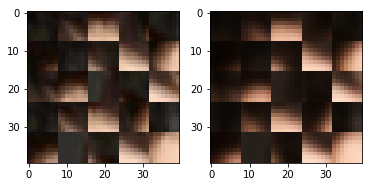

EPO: 22, recon_loss: 0.0085, total_loss: 0.0157
EPO: 22, recon_loss: 0.0024, total_loss: 0.0040
EPO: 22, recon_loss: 0.0019, total_loss: 0.0039
EPO: 22, recon_loss: 0.0056, total_loss: 0.0112
EPO: 22, recon_loss: 0.0021, total_loss: 0.0065
EPO: 22, recon_loss: 0.0041, total_loss: 0.0093
EPO: 22, recon_loss: 0.0126, total_loss: 0.0254
EPO: 22, recon_loss: 0.0066, total_loss: 0.0189
EPO: 22, recon_loss: 0.0162, total_loss: 0.0313
EPO: 22, recon_loss: 0.0073, total_loss: 0.0207
######### what? the reconstruction psnr is: 30.3784


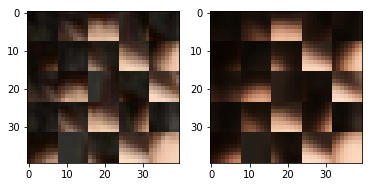

EPO: 22, recon_loss: 0.0115, total_loss: 0.0286
EPO: 22, recon_loss: 0.0028, total_loss: 0.0112
EPO: 22, recon_loss: 0.0051, total_loss: 0.0099
EPO: 22, recon_loss: 0.0059, total_loss: 0.0173
EPO: 22, recon_loss: 0.0038, total_loss: 0.0111
EPO: 22, recon_loss: 0.0045, total_loss: 0.0115
EPO: 22, recon_loss: 0.0044, total_loss: 0.0165
EPO: 22, recon_loss: 0.0047, total_loss: 0.0128
EPO: 22, recon_loss: 0.0133, total_loss: 0.0231
EPO: 22, recon_loss: 0.0027, total_loss: 0.0092
######### what? the reconstruction psnr is: 30.7552


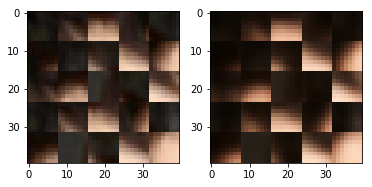

EPO: 22, recon_loss: 0.0027, total_loss: 0.0095
EPO: 22, recon_loss: 0.0044, total_loss: 0.0121
EPO: 22, recon_loss: 0.0017, total_loss: 0.0085
EPO: 22, recon_loss: 0.0117, total_loss: 0.0201
EPO: 22, recon_loss: 0.0023, total_loss: 0.0082
EPO: 22, recon_loss: 0.0041, total_loss: 0.0112
EPO: 22, recon_loss: 0.0034, total_loss: 0.0080
EPO: 22, recon_loss: 0.0029, total_loss: 0.0102
EPO: 22, recon_loss: 0.0137, total_loss: 0.0211
EPO: 22, recon_loss: 0.0039, total_loss: 0.0113
######### what? the reconstruction psnr is: 30.3541


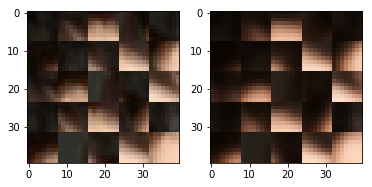

EPO: 22, recon_loss: 0.0041, total_loss: 0.0095
EPO: 22, recon_loss: 0.0041, total_loss: 0.0149
EPO: 22, recon_loss: 0.0017, total_loss: 0.0069
EPO: 22, recon_loss: 0.0104, total_loss: 0.0204
EPO: 22, recon_loss: 0.0024, total_loss: 0.0053
EPO: 22, recon_loss: 0.0054, total_loss: 0.0117
EPO: 22, recon_loss: 0.0031, total_loss: 0.0112
EPO: 22, recon_loss: 0.0018, total_loss: 0.0073
EPO: 22, recon_loss: 0.0049, total_loss: 0.0119
EPO: 22, recon_loss: 0.0016, total_loss: 0.0056
######### what? the reconstruction psnr is: 30.5185


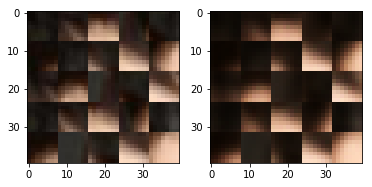

EPO: 22, recon_loss: 0.0037, total_loss: 0.0086
EPO: 22, recon_loss: 0.0119, total_loss: 0.0252
EPO: 22, recon_loss: 0.0097, total_loss: 0.0214
EPO: 22, recon_loss: 0.0049, total_loss: 0.0115
EPO: 22, recon_loss: 0.0056, total_loss: 0.0139
EPO: 22, recon_loss: 0.0049, total_loss: 0.0107
EPO: 22, recon_loss: 0.0075, total_loss: 0.0205
EPO: 22, recon_loss: 0.0032, total_loss: 0.0129
EPO: 22, recon_loss: 0.0039, total_loss: 0.0109
EPO: 22, recon_loss: 0.0049, total_loss: 0.0119
######### what? the reconstruction psnr is: 30.2068


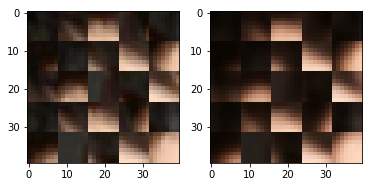

EPO: 22, recon_loss: 0.0062, total_loss: 0.0142
EPO: 22, recon_loss: 0.0031, total_loss: 0.0085
EPO: 22, recon_loss: 0.0009, total_loss: 0.0025
EPO: 22, recon_loss: 0.0029, total_loss: 0.0065
EPO: 22, recon_loss: 0.0024, total_loss: 0.0046
EPO: 22, recon_loss: 0.0017, total_loss: 0.0038
EPO: 22, recon_loss: 0.0043, total_loss: 0.0079
EPO: 22, recon_loss: 0.0040, total_loss: 0.0097
EPO: 22, recon_loss: 0.0052, total_loss: 0.0114
EPO: 22, recon_loss: 0.0039, total_loss: 0.0092
######### what? the reconstruction psnr is: 29.7672


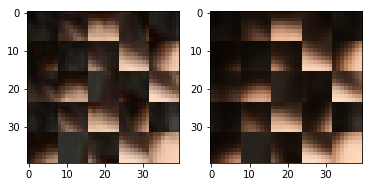

EPO: 22, recon_loss: 0.0032, total_loss: 0.0068
EPO: 22, recon_loss: 0.0053, total_loss: 0.0100
EPO: 22, recon_loss: 0.0046, total_loss: 0.0112
EPO: 22, recon_loss: 0.0065, total_loss: 0.0142
EPO: 22, recon_loss: 0.0079, total_loss: 0.0126
EPO: 22, recon_loss: 0.0059, total_loss: 0.0114
EPO: 22, recon_loss: 0.0101, total_loss: 0.0155
EPO: 22, recon_loss: 0.0115, total_loss: 0.0234
EPO: 22, recon_loss: 0.0090, total_loss: 0.0148
EPO: 22, recon_loss: 0.0081, total_loss: 0.0135
######### what? the reconstruction psnr is: 29.4742


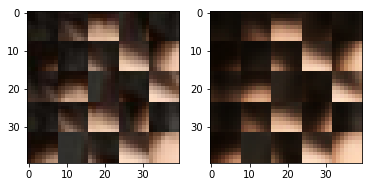

EPO: 22, recon_loss: 0.0068, total_loss: 0.0111
EPO: 22, recon_loss: 0.0123, total_loss: 0.0172
EPO: 22, recon_loss: 0.0015, total_loss: 0.0058
EPO: 22, recon_loss: 0.0024, total_loss: 0.0074
EPO: 22, recon_loss: 0.0070, total_loss: 0.0114
EPO: 22, recon_loss: 0.0051, total_loss: 0.0121
EPO: 22, recon_loss: 0.0112, total_loss: 0.0185
EPO: 22, recon_loss: 0.0031, total_loss: 0.0122
EPO: 22, recon_loss: 0.0025, total_loss: 0.0068
EPO: 22, recon_loss: 0.0052, total_loss: 0.0101
######### what? the reconstruction psnr is: 29.8892


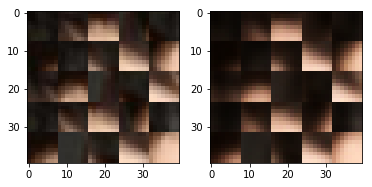

EPO: 22, recon_loss: 0.0010, total_loss: 0.0028
EPO: 22, recon_loss: 0.0026, total_loss: 0.0050
EPO: 22, recon_loss: 0.0059, total_loss: 0.0124
EPO: 22, recon_loss: 0.0070, total_loss: 0.0136
EPO: 22, recon_loss: 0.0218, total_loss: 0.0296
EPO: 22, recon_loss: 0.0113, total_loss: 0.0177
EPO: 22, recon_loss: 0.0076, total_loss: 0.0120
EPO: 23, recon_loss: 0.0024, total_loss: 0.0051
EPO: 23, recon_loss: 0.0020, total_loss: 0.0041
EPO: 23, recon_loss: 0.0093, total_loss: 0.0127
######### what? the reconstruction psnr is: 30.3364


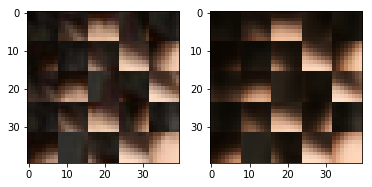

EPO: 23, recon_loss: 0.0019, total_loss: 0.0049
EPO: 23, recon_loss: 0.0042, total_loss: 0.0078
EPO: 23, recon_loss: 0.0029, total_loss: 0.0108
EPO: 23, recon_loss: 0.0023, total_loss: 0.0083
EPO: 23, recon_loss: 0.0049, total_loss: 0.0098
EPO: 23, recon_loss: 0.0027, total_loss: 0.0059
EPO: 23, recon_loss: 0.0058, total_loss: 0.0118
EPO: 23, recon_loss: 0.0025, total_loss: 0.0099
EPO: 23, recon_loss: 0.0013, total_loss: 0.0044
EPO: 23, recon_loss: 0.0035, total_loss: 0.0091
######### what? the reconstruction psnr is: 30.5231


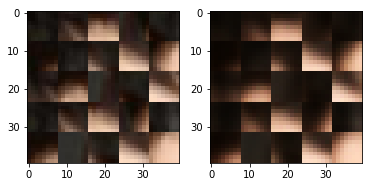

EPO: 23, recon_loss: 0.0022, total_loss: 0.0042
EPO: 23, recon_loss: 0.0041, total_loss: 0.0089
EPO: 23, recon_loss: 0.0036, total_loss: 0.0098
EPO: 23, recon_loss: 0.0033, total_loss: 0.0083
EPO: 23, recon_loss: 0.0041, total_loss: 0.0092
EPO: 23, recon_loss: 0.0031, total_loss: 0.0083
EPO: 23, recon_loss: 0.0027, total_loss: 0.0065
EPO: 23, recon_loss: 0.0043, total_loss: 0.0073
EPO: 23, recon_loss: 0.0022, total_loss: 0.0058
EPO: 23, recon_loss: 0.0061, total_loss: 0.0108
######### what? the reconstruction psnr is: 30.5665


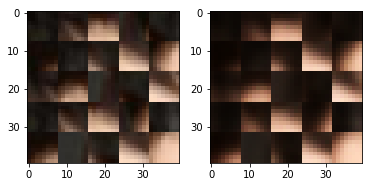

EPO: 23, recon_loss: 0.0035, total_loss: 0.0069
EPO: 23, recon_loss: 0.0036, total_loss: 0.0066
EPO: 23, recon_loss: 0.0101, total_loss: 0.0221
EPO: 23, recon_loss: 0.0036, total_loss: 0.0100
EPO: 23, recon_loss: 0.0054, total_loss: 0.0131
EPO: 23, recon_loss: 0.0088, total_loss: 0.0177
EPO: 23, recon_loss: 0.0051, total_loss: 0.0108
EPO: 23, recon_loss: 0.0040, total_loss: 0.0113
EPO: 23, recon_loss: 0.0028, total_loss: 0.0083
EPO: 23, recon_loss: 0.0042, total_loss: 0.0107
######### what? the reconstruction psnr is: 30.0515


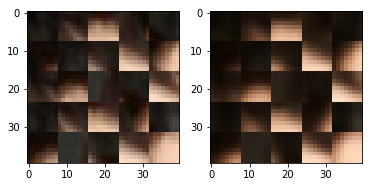

EPO: 23, recon_loss: 0.0034, total_loss: 0.0063
EPO: 23, recon_loss: 0.0041, total_loss: 0.0076
EPO: 23, recon_loss: 0.0016, total_loss: 0.0042
EPO: 23, recon_loss: 0.0019, total_loss: 0.0045
EPO: 23, recon_loss: 0.0022, total_loss: 0.0057
EPO: 23, recon_loss: 0.0052, total_loss: 0.0089
EPO: 23, recon_loss: 0.0041, total_loss: 0.0096
EPO: 23, recon_loss: 0.0059, total_loss: 0.0145
EPO: 23, recon_loss: 0.0019, total_loss: 0.0085
EPO: 23, recon_loss: 0.0022, total_loss: 0.0083
######### what? the reconstruction psnr is: 30.2884


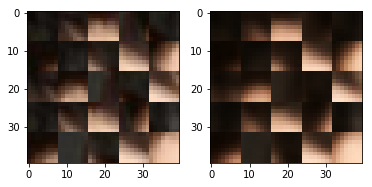

EPO: 23, recon_loss: 0.0042, total_loss: 0.0088
EPO: 23, recon_loss: 0.0017, total_loss: 0.0056
EPO: 23, recon_loss: 0.0065, total_loss: 0.0141
EPO: 23, recon_loss: 0.0083, total_loss: 0.0206
EPO: 23, recon_loss: 0.0038, total_loss: 0.0102
EPO: 23, recon_loss: 0.0077, total_loss: 0.0127
EPO: 23, recon_loss: 0.0027, total_loss: 0.0059
EPO: 23, recon_loss: 0.0057, total_loss: 0.0098
EPO: 23, recon_loss: 0.0044, total_loss: 0.0096
EPO: 23, recon_loss: 0.0037, total_loss: 0.0089
######### what? the reconstruction psnr is: 30.2924


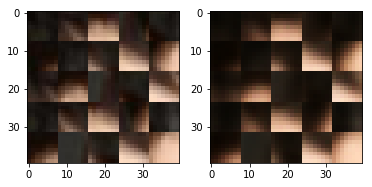

EPO: 23, recon_loss: 0.0062, total_loss: 0.0126
EPO: 23, recon_loss: 0.0051, total_loss: 0.0099
EPO: 23, recon_loss: 0.0091, total_loss: 0.0151
EPO: 23, recon_loss: 0.0091, total_loss: 0.0176
EPO: 23, recon_loss: 0.0106, total_loss: 0.0199
EPO: 23, recon_loss: 0.0217, total_loss: 0.0323
EPO: 23, recon_loss: 0.0102, total_loss: 0.0191
EPO: 23, recon_loss: 0.0092, total_loss: 0.0178
EPO: 23, recon_loss: 0.0044, total_loss: 0.0096
EPO: 23, recon_loss: 0.0040, total_loss: 0.0100
######### what? the reconstruction psnr is: 30.1576


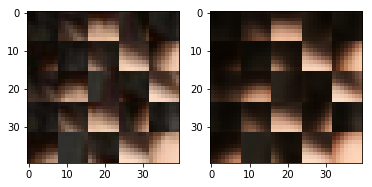

EPO: 23, recon_loss: 0.0056, total_loss: 0.0111
EPO: 23, recon_loss: 0.0057, total_loss: 0.0121
EPO: 23, recon_loss: 0.0081, total_loss: 0.0157
EPO: 23, recon_loss: 0.0026, total_loss: 0.0096
EPO: 23, recon_loss: 0.0028, total_loss: 0.0088
EPO: 23, recon_loss: 0.0097, total_loss: 0.0166
EPO: 23, recon_loss: 0.0028, total_loss: 0.0093
EPO: 23, recon_loss: 0.0037, total_loss: 0.0093
EPO: 23, recon_loss: 0.0078, total_loss: 0.0212
EPO: 23, recon_loss: 0.0059, total_loss: 0.0177
######### what? the reconstruction psnr is: 30.0321


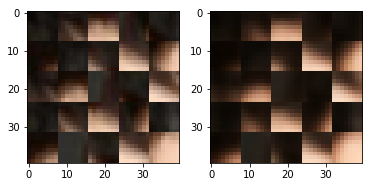

EPO: 23, recon_loss: 0.0189, total_loss: 0.0341
EPO: 23, recon_loss: 0.0053, total_loss: 0.0168
EPO: 23, recon_loss: 0.0065, total_loss: 0.0194
EPO: 23, recon_loss: 0.0109, total_loss: 0.0220
EPO: 23, recon_loss: 0.0058, total_loss: 0.0192
EPO: 23, recon_loss: 0.0179, total_loss: 0.0321
EPO: 23, recon_loss: 0.0087, total_loss: 0.0223
EPO: 23, recon_loss: 0.0092, total_loss: 0.0223
EPO: 23, recon_loss: 0.0038, total_loss: 0.0153
EPO: 23, recon_loss: 0.0036, total_loss: 0.0134
######### what? the reconstruction psnr is: 29.9558


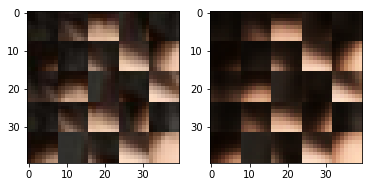

EPO: 23, recon_loss: 0.0206, total_loss: 0.0318
EPO: 23, recon_loss: 0.0204, total_loss: 0.0273
EPO: 23, recon_loss: 0.0032, total_loss: 0.0078
EPO: 23, recon_loss: 0.0030, total_loss: 0.0076
EPO: 23, recon_loss: 0.0025, total_loss: 0.0087
EPO: 23, recon_loss: 0.0083, total_loss: 0.0151
EPO: 23, recon_loss: 0.0040, total_loss: 0.0115
EPO: 23, recon_loss: 0.0052, total_loss: 0.0130
EPO: 23, recon_loss: 0.0021, total_loss: 0.0067
EPO: 23, recon_loss: 0.0006, total_loss: 0.0025
######### what? the reconstruction psnr is: 30.5551


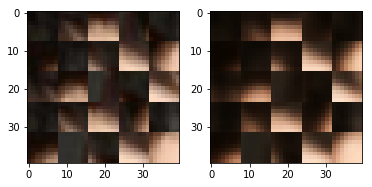

EPO: 23, recon_loss: 0.0009, total_loss: 0.0034
EPO: 23, recon_loss: 0.0011, total_loss: 0.0023
EPO: 23, recon_loss: 0.0011, total_loss: 0.0029
EPO: 23, recon_loss: 0.0062, total_loss: 0.0185
EPO: 23, recon_loss: 0.0028, total_loss: 0.0079
EPO: 23, recon_loss: 0.0045, total_loss: 0.0107
EPO: 23, recon_loss: 0.0049, total_loss: 0.0091
EPO: 23, recon_loss: 0.0040, total_loss: 0.0069
EPO: 23, recon_loss: 0.0081, total_loss: 0.0185
EPO: 23, recon_loss: 0.0065, total_loss: 0.0153
######### what? the reconstruction psnr is: 30.0108


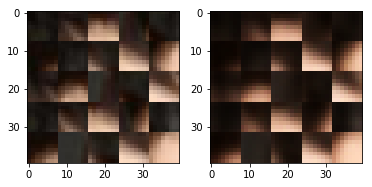

EPO: 23, recon_loss: 0.0094, total_loss: 0.0189
EPO: 23, recon_loss: 0.0072, total_loss: 0.0175
EPO: 23, recon_loss: 0.0040, total_loss: 0.0098
EPO: 23, recon_loss: 0.0056, total_loss: 0.0116
EPO: 23, recon_loss: 0.0039, total_loss: 0.0082
EPO: 23, recon_loss: 0.0040, total_loss: 0.0080
EPO: 23, recon_loss: 0.0041, total_loss: 0.0088
EPO: 23, recon_loss: 0.0034, total_loss: 0.0072
EPO: 23, recon_loss: 0.0047, total_loss: 0.0105
EPO: 23, recon_loss: 0.0031, total_loss: 0.0104
######### what? the reconstruction psnr is: 30.3454


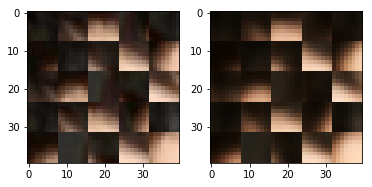

EPO: 23, recon_loss: 0.0030, total_loss: 0.0083
EPO: 23, recon_loss: 0.0074, total_loss: 0.0135
EPO: 23, recon_loss: 0.0076, total_loss: 0.0135
EPO: 23, recon_loss: 0.0045, total_loss: 0.0106
EPO: 23, recon_loss: 0.0013, total_loss: 0.0040
EPO: 23, recon_loss: 0.0020, total_loss: 0.0048
EPO: 23, recon_loss: 0.0031, total_loss: 0.0074
EPO: 23, recon_loss: 0.0014, total_loss: 0.0037
EPO: 23, recon_loss: 0.0025, total_loss: 0.0053
EPO: 23, recon_loss: 0.0030, total_loss: 0.0073
######### what? the reconstruction psnr is: 30.3006


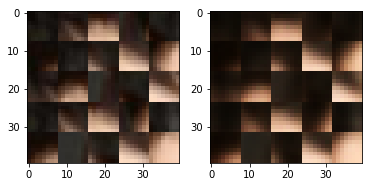

EPO: 23, recon_loss: 0.0037, total_loss: 0.0085
EPO: 23, recon_loss: 0.0075, total_loss: 0.0137
EPO: 23, recon_loss: 0.0042, total_loss: 0.0098
EPO: 23, recon_loss: 0.0030, total_loss: 0.0065
EPO: 23, recon_loss: 0.0024, total_loss: 0.0091
EPO: 23, recon_loss: 0.0030, total_loss: 0.0099
EPO: 23, recon_loss: 0.0125, total_loss: 0.0212
EPO: 23, recon_loss: 0.0034, total_loss: 0.0090
EPO: 23, recon_loss: 0.0139, total_loss: 0.0243
EPO: 23, recon_loss: 0.0010, total_loss: 0.0052
######### what? the reconstruction psnr is: 30.5087


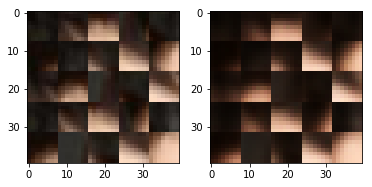

EPO: 23, recon_loss: 0.0007, total_loss: 0.0039
EPO: 23, recon_loss: 0.0111, total_loss: 0.0177
EPO: 23, recon_loss: 0.0036, total_loss: 0.0072
EPO: 23, recon_loss: 0.0045, total_loss: 0.0088
EPO: 23, recon_loss: 0.0050, total_loss: 0.0110
EPO: 23, recon_loss: 0.0062, total_loss: 0.0129
EPO: 23, recon_loss: 0.0097, total_loss: 0.0168
EPO: 23, recon_loss: 0.0024, total_loss: 0.0068
EPO: 23, recon_loss: 0.0036, total_loss: 0.0076
EPO: 23, recon_loss: 0.0027, total_loss: 0.0073
######### what? the reconstruction psnr is: 30.5135


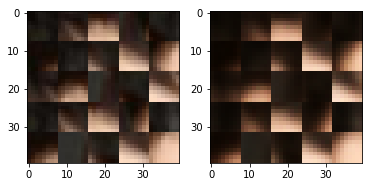

EPO: 23, recon_loss: 0.0018, total_loss: 0.0053
EPO: 23, recon_loss: 0.0071, total_loss: 0.0148
EPO: 23, recon_loss: 0.0017, total_loss: 0.0057
EPO: 23, recon_loss: 0.0028, total_loss: 0.0074
EPO: 23, recon_loss: 0.0060, total_loss: 0.0135
EPO: 23, recon_loss: 0.0034, total_loss: 0.0099
EPO: 23, recon_loss: 0.0061, total_loss: 0.0120
EPO: 23, recon_loss: 0.0042, total_loss: 0.0104
EPO: 23, recon_loss: 0.0055, total_loss: 0.0121
EPO: 23, recon_loss: 0.0071, total_loss: 0.0199
######### what? the reconstruction psnr is: 30.8650


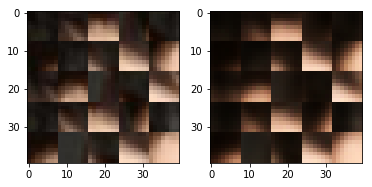

EPO: 23, recon_loss: 0.0018, total_loss: 0.0052
EPO: 23, recon_loss: 0.0042, total_loss: 0.0085
EPO: 23, recon_loss: 0.0031, total_loss: 0.0074
EPO: 23, recon_loss: 0.0038, total_loss: 0.0084
EPO: 23, recon_loss: 0.0040, total_loss: 0.0108
EPO: 23, recon_loss: 0.0025, total_loss: 0.0073
EPO: 23, recon_loss: 0.0072, total_loss: 0.0137
EPO: 23, recon_loss: 0.0075, total_loss: 0.0145
EPO: 23, recon_loss: 0.0056, total_loss: 0.0141
EPO: 23, recon_loss: 0.0064, total_loss: 0.0165
######### what? the reconstruction psnr is: 30.0822


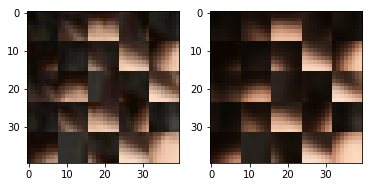

EPO: 23, recon_loss: 0.0028, total_loss: 0.0085
EPO: 23, recon_loss: 0.0030, total_loss: 0.0094
EPO: 23, recon_loss: 0.0057, total_loss: 0.0121
EPO: 23, recon_loss: 0.0048, total_loss: 0.0112
EPO: 23, recon_loss: 0.0037, total_loss: 0.0067
EPO: 23, recon_loss: 0.0022, total_loss: 0.0041
EPO: 23, recon_loss: 0.0016, total_loss: 0.0037
EPO: 23, recon_loss: 0.0036, total_loss: 0.0082
EPO: 23, recon_loss: 0.0026, total_loss: 0.0073
EPO: 23, recon_loss: 0.0048, total_loss: 0.0102
######### what? the reconstruction psnr is: 30.4603


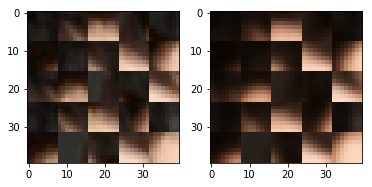

EPO: 23, recon_loss: 0.0099, total_loss: 0.0230
EPO: 23, recon_loss: 0.0058, total_loss: 0.0164
EPO: 23, recon_loss: 0.0125, total_loss: 0.0268
EPO: 23, recon_loss: 0.0086, total_loss: 0.0239
EPO: 23, recon_loss: 0.0106, total_loss: 0.0270
EPO: 23, recon_loss: 0.0026, total_loss: 0.0093
EPO: 23, recon_loss: 0.0092, total_loss: 0.0163
EPO: 23, recon_loss: 0.0048, total_loss: 0.0152
EPO: 23, recon_loss: 0.0040, total_loss: 0.0113
EPO: 23, recon_loss: 0.0050, total_loss: 0.0132
######### what? the reconstruction psnr is: 30.7575


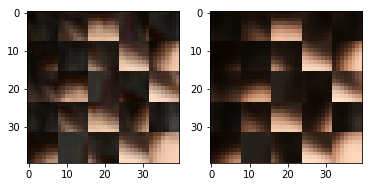

EPO: 23, recon_loss: 0.0046, total_loss: 0.0150
EPO: 23, recon_loss: 0.0058, total_loss: 0.0142
EPO: 23, recon_loss: 0.0097, total_loss: 0.0193
EPO: 23, recon_loss: 0.0035, total_loss: 0.0105
EPO: 23, recon_loss: 0.0041, total_loss: 0.0112
EPO: 23, recon_loss: 0.0034, total_loss: 0.0093
EPO: 23, recon_loss: 0.0023, total_loss: 0.0091
EPO: 23, recon_loss: 0.0097, total_loss: 0.0170
EPO: 23, recon_loss: 0.0025, total_loss: 0.0084
EPO: 23, recon_loss: 0.0040, total_loss: 0.0112
######### what? the reconstruction psnr is: 30.5821


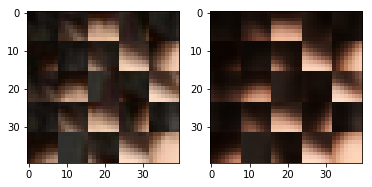

EPO: 23, recon_loss: 0.0028, total_loss: 0.0076
EPO: 23, recon_loss: 0.0035, total_loss: 0.0113
EPO: 23, recon_loss: 0.0120, total_loss: 0.0185
EPO: 23, recon_loss: 0.0040, total_loss: 0.0117
EPO: 23, recon_loss: 0.0060, total_loss: 0.0119
EPO: 23, recon_loss: 0.0026, total_loss: 0.0097
EPO: 23, recon_loss: 0.0022, total_loss: 0.0077
EPO: 23, recon_loss: 0.0090, total_loss: 0.0168
EPO: 23, recon_loss: 0.0027, total_loss: 0.0058
EPO: 23, recon_loss: 0.0062, total_loss: 0.0124
######### what? the reconstruction psnr is: 30.6198


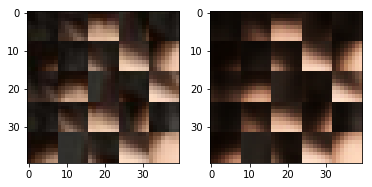

EPO: 23, recon_loss: 0.0025, total_loss: 0.0097
EPO: 23, recon_loss: 0.0016, total_loss: 0.0067
EPO: 23, recon_loss: 0.0044, total_loss: 0.0098
EPO: 23, recon_loss: 0.0018, total_loss: 0.0061
EPO: 23, recon_loss: 0.0035, total_loss: 0.0079
EPO: 23, recon_loss: 0.0102, total_loss: 0.0231
EPO: 23, recon_loss: 0.0093, total_loss: 0.0201
EPO: 23, recon_loss: 0.0049, total_loss: 0.0107
EPO: 23, recon_loss: 0.0053, total_loss: 0.0132
EPO: 23, recon_loss: 0.0041, total_loss: 0.0089
######### what? the reconstruction psnr is: 30.0029


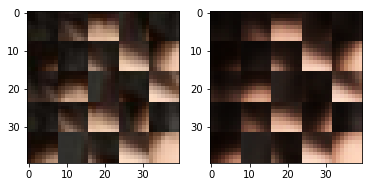

EPO: 23, recon_loss: 0.0068, total_loss: 0.0197
EPO: 23, recon_loss: 0.0028, total_loss: 0.0118
EPO: 23, recon_loss: 0.0062, total_loss: 0.0135
EPO: 23, recon_loss: 0.0039, total_loss: 0.0114
EPO: 23, recon_loss: 0.0051, total_loss: 0.0119
EPO: 23, recon_loss: 0.0028, total_loss: 0.0076
EPO: 23, recon_loss: 0.0007, total_loss: 0.0021
EPO: 23, recon_loss: 0.0042, total_loss: 0.0082
EPO: 23, recon_loss: 0.0016, total_loss: 0.0035
EPO: 23, recon_loss: 0.0018, total_loss: 0.0039
######### what? the reconstruction psnr is: 30.3099


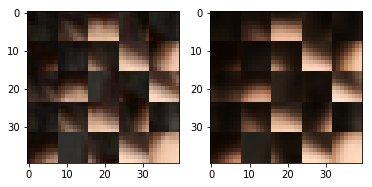

EPO: 23, recon_loss: 0.0037, total_loss: 0.0074
EPO: 23, recon_loss: 0.0036, total_loss: 0.0087
EPO: 23, recon_loss: 0.0060, total_loss: 0.0126
EPO: 23, recon_loss: 0.0034, total_loss: 0.0079
EPO: 23, recon_loss: 0.0036, total_loss: 0.0070
EPO: 23, recon_loss: 0.0069, total_loss: 0.0180
EPO: 23, recon_loss: 0.0061, total_loss: 0.0141
EPO: 23, recon_loss: 0.0057, total_loss: 0.0115
EPO: 23, recon_loss: 0.0070, total_loss: 0.0117
EPO: 23, recon_loss: 0.0059, total_loss: 0.0110
######### what? the reconstruction psnr is: 29.9271


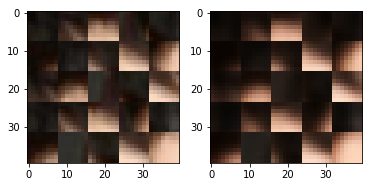

EPO: 23, recon_loss: 0.0132, total_loss: 0.0224
EPO: 23, recon_loss: 0.0157, total_loss: 0.0295
EPO: 23, recon_loss: 0.0060, total_loss: 0.0116
EPO: 23, recon_loss: 0.0063, total_loss: 0.0112
EPO: 23, recon_loss: 0.0076, total_loss: 0.0119
EPO: 23, recon_loss: 0.0145, total_loss: 0.0214
EPO: 23, recon_loss: 0.0013, total_loss: 0.0057
EPO: 23, recon_loss: 0.0029, total_loss: 0.0084
EPO: 23, recon_loss: 0.0065, total_loss: 0.0116
EPO: 23, recon_loss: 0.0053, total_loss: 0.0122
######### what? the reconstruction psnr is: 29.4320


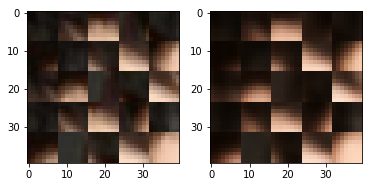

EPO: 23, recon_loss: 0.0126, total_loss: 0.0204
EPO: 23, recon_loss: 0.0020, total_loss: 0.0080
EPO: 23, recon_loss: 0.0029, total_loss: 0.0073
EPO: 23, recon_loss: 0.0057, total_loss: 0.0107
EPO: 23, recon_loss: 0.0015, total_loss: 0.0038
EPO: 23, recon_loss: 0.0031, total_loss: 0.0054
EPO: 23, recon_loss: 0.0053, total_loss: 0.0119
EPO: 23, recon_loss: 0.0086, total_loss: 0.0147
EPO: 23, recon_loss: 0.0174, total_loss: 0.0248
EPO: 23, recon_loss: 0.0105, total_loss: 0.0166
######### what? the reconstruction psnr is: 29.7982


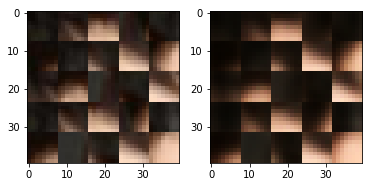

EPO: 23, recon_loss: 0.0096, total_loss: 0.0148
EPO: 24, recon_loss: 0.0024, total_loss: 0.0049
EPO: 24, recon_loss: 0.0019, total_loss: 0.0041
EPO: 24, recon_loss: 0.0094, total_loss: 0.0143
EPO: 24, recon_loss: 0.0024, total_loss: 0.0054
EPO: 24, recon_loss: 0.0048, total_loss: 0.0087
EPO: 24, recon_loss: 0.0029, total_loss: 0.0102
EPO: 24, recon_loss: 0.0030, total_loss: 0.0082
EPO: 24, recon_loss: 0.0049, total_loss: 0.0092
EPO: 24, recon_loss: 0.0037, total_loss: 0.0070
######### what? the reconstruction psnr is: 30.5535


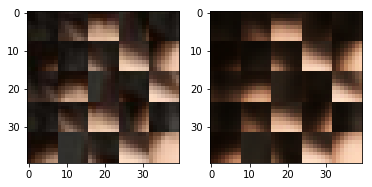

EPO: 24, recon_loss: 0.0065, total_loss: 0.0138
EPO: 24, recon_loss: 0.0021, total_loss: 0.0091
EPO: 24, recon_loss: 0.0012, total_loss: 0.0040
EPO: 24, recon_loss: 0.0035, total_loss: 0.0088
EPO: 24, recon_loss: 0.0024, total_loss: 0.0043
EPO: 24, recon_loss: 0.0053, total_loss: 0.0111
EPO: 24, recon_loss: 0.0033, total_loss: 0.0086
EPO: 24, recon_loss: 0.0032, total_loss: 0.0081
EPO: 24, recon_loss: 0.0042, total_loss: 0.0086
EPO: 24, recon_loss: 0.0031, total_loss: 0.0086
######### what? the reconstruction psnr is: 30.6550


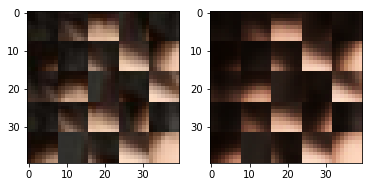

EPO: 24, recon_loss: 0.0032, total_loss: 0.0075
EPO: 24, recon_loss: 0.0034, total_loss: 0.0063
EPO: 24, recon_loss: 0.0024, total_loss: 0.0060
EPO: 24, recon_loss: 0.0071, total_loss: 0.0112
EPO: 24, recon_loss: 0.0025, total_loss: 0.0054
EPO: 24, recon_loss: 0.0035, total_loss: 0.0063
EPO: 24, recon_loss: 0.0076, total_loss: 0.0165
EPO: 24, recon_loss: 0.0029, total_loss: 0.0089
EPO: 24, recon_loss: 0.0067, total_loss: 0.0157
EPO: 24, recon_loss: 0.0078, total_loss: 0.0148
######### what? the reconstruction psnr is: 30.0537


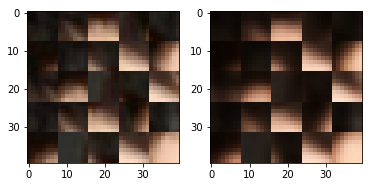

EPO: 24, recon_loss: 0.0062, total_loss: 0.0120
EPO: 24, recon_loss: 0.0050, total_loss: 0.0148
EPO: 24, recon_loss: 0.0022, total_loss: 0.0076
EPO: 24, recon_loss: 0.0056, total_loss: 0.0112
EPO: 24, recon_loss: 0.0027, total_loss: 0.0049
EPO: 24, recon_loss: 0.0023, total_loss: 0.0053
EPO: 24, recon_loss: 0.0017, total_loss: 0.0040
EPO: 24, recon_loss: 0.0016, total_loss: 0.0039
EPO: 24, recon_loss: 0.0029, total_loss: 0.0073
EPO: 24, recon_loss: 0.0031, total_loss: 0.0062
######### what? the reconstruction psnr is: 30.1136


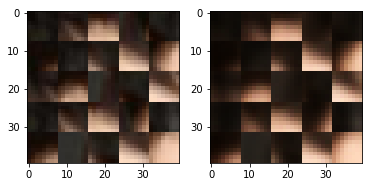

EPO: 24, recon_loss: 0.0047, total_loss: 0.0114
EPO: 24, recon_loss: 0.0018, total_loss: 0.0095
EPO: 24, recon_loss: 0.0016, total_loss: 0.0077
EPO: 24, recon_loss: 0.0027, total_loss: 0.0082
EPO: 24, recon_loss: 0.0031, total_loss: 0.0066
EPO: 24, recon_loss: 0.0029, total_loss: 0.0077
EPO: 24, recon_loss: 0.0053, total_loss: 0.0152
EPO: 24, recon_loss: 0.0037, total_loss: 0.0103
EPO: 24, recon_loss: 0.0058, total_loss: 0.0131
EPO: 24, recon_loss: 0.0053, total_loss: 0.0094
######### what? the reconstruction psnr is: 30.6281


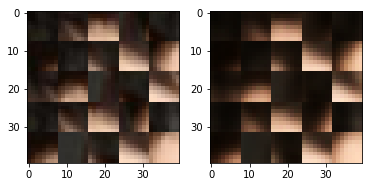

EPO: 24, recon_loss: 0.0035, total_loss: 0.0069
EPO: 24, recon_loss: 0.0085, total_loss: 0.0141
EPO: 24, recon_loss: 0.0035, total_loss: 0.0076
EPO: 24, recon_loss: 0.0043, total_loss: 0.0107
EPO: 24, recon_loss: 0.0054, total_loss: 0.0110
EPO: 24, recon_loss: 0.0045, total_loss: 0.0099
EPO: 24, recon_loss: 0.0136, total_loss: 0.0190
EPO: 24, recon_loss: 0.0092, total_loss: 0.0177
EPO: 24, recon_loss: 0.0113, total_loss: 0.0212
EPO: 24, recon_loss: 0.0192, total_loss: 0.0290
######### what? the reconstruction psnr is: 30.4830


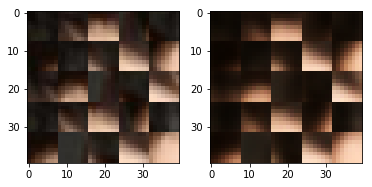

EPO: 24, recon_loss: 0.0103, total_loss: 0.0189
EPO: 24, recon_loss: 0.0100, total_loss: 0.0183
EPO: 24, recon_loss: 0.0040, total_loss: 0.0089
EPO: 24, recon_loss: 0.0048, total_loss: 0.0102
EPO: 24, recon_loss: 0.0068, total_loss: 0.0125
EPO: 24, recon_loss: 0.0076, total_loss: 0.0156
EPO: 24, recon_loss: 0.0080, total_loss: 0.0149
EPO: 24, recon_loss: 0.0028, total_loss: 0.0096
EPO: 24, recon_loss: 0.0049, total_loss: 0.0120
EPO: 24, recon_loss: 0.0083, total_loss: 0.0154
######### what? the reconstruction psnr is: 30.0755


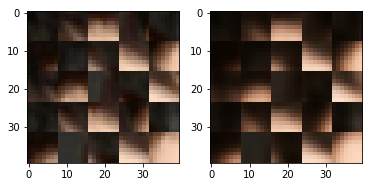

EPO: 24, recon_loss: 0.0028, total_loss: 0.0094
EPO: 24, recon_loss: 0.0043, total_loss: 0.0102
EPO: 24, recon_loss: 0.0063, total_loss: 0.0177
EPO: 24, recon_loss: 0.0063, total_loss: 0.0175
EPO: 24, recon_loss: 0.0184, total_loss: 0.0329
EPO: 24, recon_loss: 0.0057, total_loss: 0.0186
EPO: 24, recon_loss: 0.0075, total_loss: 0.0187
EPO: 24, recon_loss: 0.0082, total_loss: 0.0192
EPO: 24, recon_loss: 0.0054, total_loss: 0.0181
EPO: 24, recon_loss: 0.0205, total_loss: 0.0349
######### what? the reconstruction psnr is: 30.6873


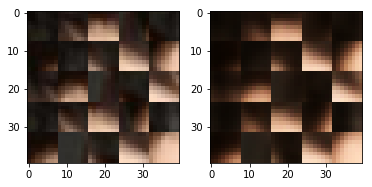

EPO: 24, recon_loss: 0.0092, total_loss: 0.0226
EPO: 24, recon_loss: 0.0092, total_loss: 0.0221
EPO: 24, recon_loss: 0.0023, total_loss: 0.0123
EPO: 24, recon_loss: 0.0066, total_loss: 0.0197
EPO: 24, recon_loss: 0.0230, total_loss: 0.0341
EPO: 24, recon_loss: 0.0153, total_loss: 0.0224
EPO: 24, recon_loss: 0.0035, total_loss: 0.0072
EPO: 24, recon_loss: 0.0022, total_loss: 0.0068
EPO: 24, recon_loss: 0.0030, total_loss: 0.0092
EPO: 24, recon_loss: 0.0083, total_loss: 0.0152
######### what? the reconstruction psnr is: 30.6938


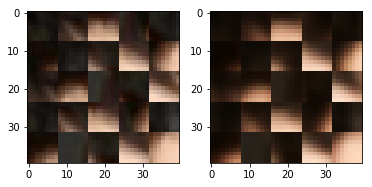

EPO: 24, recon_loss: 0.0038, total_loss: 0.0111
EPO: 24, recon_loss: 0.0061, total_loss: 0.0139
EPO: 24, recon_loss: 0.0013, total_loss: 0.0042
EPO: 24, recon_loss: 0.0006, total_loss: 0.0026
EPO: 24, recon_loss: 0.0013, total_loss: 0.0037
EPO: 24, recon_loss: 0.0008, total_loss: 0.0020
EPO: 24, recon_loss: 0.0010, total_loss: 0.0030
EPO: 24, recon_loss: 0.0057, total_loss: 0.0166
EPO: 24, recon_loss: 0.0023, total_loss: 0.0071
EPO: 24, recon_loss: 0.0046, total_loss: 0.0103
######### what? the reconstruction psnr is: 30.4819


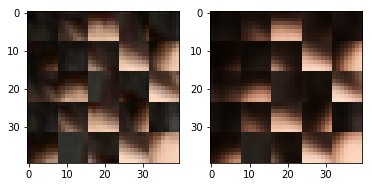

EPO: 24, recon_loss: 0.0028, total_loss: 0.0060
EPO: 24, recon_loss: 0.0034, total_loss: 0.0060
EPO: 24, recon_loss: 0.0073, total_loss: 0.0190
EPO: 24, recon_loss: 0.0063, total_loss: 0.0144
EPO: 24, recon_loss: 0.0079, total_loss: 0.0165
EPO: 24, recon_loss: 0.0074, total_loss: 0.0171
EPO: 24, recon_loss: 0.0043, total_loss: 0.0101
EPO: 24, recon_loss: 0.0055, total_loss: 0.0116
EPO: 24, recon_loss: 0.0037, total_loss: 0.0077
EPO: 24, recon_loss: 0.0036, total_loss: 0.0077
######### what? the reconstruction psnr is: 30.0988


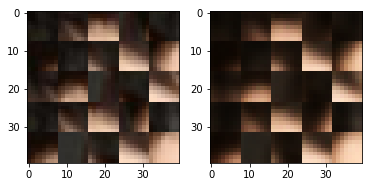

EPO: 24, recon_loss: 0.0031, total_loss: 0.0069
EPO: 24, recon_loss: 0.0039, total_loss: 0.0085
EPO: 24, recon_loss: 0.0028, total_loss: 0.0121
EPO: 24, recon_loss: 0.0019, total_loss: 0.0069
EPO: 24, recon_loss: 0.0041, total_loss: 0.0107
EPO: 24, recon_loss: 0.0063, total_loss: 0.0120
EPO: 24, recon_loss: 0.0043, total_loss: 0.0088
EPO: 24, recon_loss: 0.0034, total_loss: 0.0079
EPO: 24, recon_loss: 0.0012, total_loss: 0.0039
EPO: 24, recon_loss: 0.0022, total_loss: 0.0050
######### what? the reconstruction psnr is: 30.2118


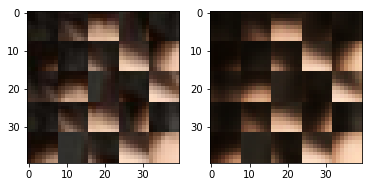

EPO: 24, recon_loss: 0.0028, total_loss: 0.0068
EPO: 24, recon_loss: 0.0019, total_loss: 0.0041
EPO: 24, recon_loss: 0.0032, total_loss: 0.0063
EPO: 24, recon_loss: 0.0024, total_loss: 0.0062
EPO: 24, recon_loss: 0.0036, total_loss: 0.0084
EPO: 24, recon_loss: 0.0057, total_loss: 0.0116
EPO: 24, recon_loss: 0.0046, total_loss: 0.0096
EPO: 24, recon_loss: 0.0026, total_loss: 0.0063
EPO: 24, recon_loss: 0.0031, total_loss: 0.0113
EPO: 24, recon_loss: 0.0067, total_loss: 0.0145
######### what? the reconstruction psnr is: 30.2750


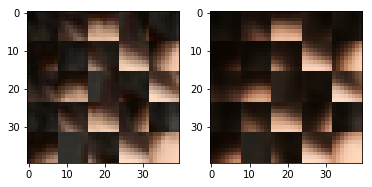

EPO: 24, recon_loss: 0.0121, total_loss: 0.0209
EPO: 24, recon_loss: 0.0037, total_loss: 0.0095
EPO: 24, recon_loss: 0.0142, total_loss: 0.0236
EPO: 24, recon_loss: 0.0008, total_loss: 0.0041
EPO: 24, recon_loss: 0.0016, total_loss: 0.0054
EPO: 24, recon_loss: 0.0103, total_loss: 0.0167
EPO: 24, recon_loss: 0.0028, total_loss: 0.0067
EPO: 24, recon_loss: 0.0043, total_loss: 0.0086
EPO: 24, recon_loss: 0.0045, total_loss: 0.0098
EPO: 24, recon_loss: 0.0051, total_loss: 0.0120
######### what? the reconstruction psnr is: 30.5982


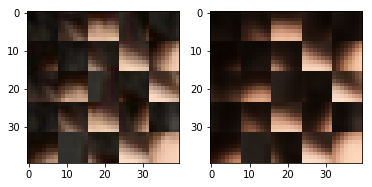

EPO: 24, recon_loss: 0.0093, total_loss: 0.0156
EPO: 24, recon_loss: 0.0023, total_loss: 0.0069
EPO: 24, recon_loss: 0.0054, total_loss: 0.0102
EPO: 24, recon_loss: 0.0025, total_loss: 0.0067
EPO: 24, recon_loss: 0.0041, total_loss: 0.0086
EPO: 24, recon_loss: 0.0081, total_loss: 0.0159
EPO: 24, recon_loss: 0.0021, total_loss: 0.0064
EPO: 24, recon_loss: 0.0032, total_loss: 0.0081
EPO: 24, recon_loss: 0.0050, total_loss: 0.0118
EPO: 24, recon_loss: 0.0031, total_loss: 0.0092
######### what? the reconstruction psnr is: 30.5672


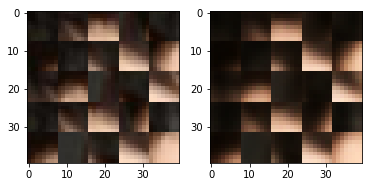

EPO: 24, recon_loss: 0.0087, total_loss: 0.0145
EPO: 24, recon_loss: 0.0042, total_loss: 0.0107
EPO: 24, recon_loss: 0.0061, total_loss: 0.0124
EPO: 24, recon_loss: 0.0074, total_loss: 0.0184
EPO: 24, recon_loss: 0.0011, total_loss: 0.0043
EPO: 24, recon_loss: 0.0058, total_loss: 0.0100
EPO: 24, recon_loss: 0.0026, total_loss: 0.0066
EPO: 24, recon_loss: 0.0038, total_loss: 0.0081
EPO: 24, recon_loss: 0.0038, total_loss: 0.0108
EPO: 24, recon_loss: 0.0025, total_loss: 0.0073
######### what? the reconstruction psnr is: 30.3726


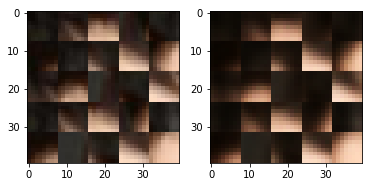

EPO: 24, recon_loss: 0.0091, total_loss: 0.0162
EPO: 24, recon_loss: 0.0034, total_loss: 0.0093
EPO: 24, recon_loss: 0.0067, total_loss: 0.0140
EPO: 24, recon_loss: 0.0051, total_loss: 0.0139
EPO: 24, recon_loss: 0.0020, total_loss: 0.0075
EPO: 24, recon_loss: 0.0051, total_loss: 0.0124
EPO: 24, recon_loss: 0.0026, total_loss: 0.0075
EPO: 24, recon_loss: 0.0046, total_loss: 0.0102
EPO: 24, recon_loss: 0.0028, total_loss: 0.0046
EPO: 24, recon_loss: 0.0017, total_loss: 0.0034
######### what? the reconstruction psnr is: 30.6114


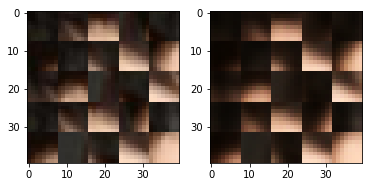

EPO: 24, recon_loss: 0.0022, total_loss: 0.0047
EPO: 24, recon_loss: 0.0026, total_loss: 0.0062
EPO: 24, recon_loss: 0.0030, total_loss: 0.0077
EPO: 24, recon_loss: 0.0102, total_loss: 0.0232
EPO: 24, recon_loss: 0.0092, total_loss: 0.0206
EPO: 24, recon_loss: 0.0077, total_loss: 0.0195
EPO: 24, recon_loss: 0.0090, total_loss: 0.0230
EPO: 24, recon_loss: 0.0079, total_loss: 0.0229
EPO: 24, recon_loss: 0.0026, total_loss: 0.0094
EPO: 24, recon_loss: 0.0033, total_loss: 0.0090
######### what? the reconstruction psnr is: 30.5748


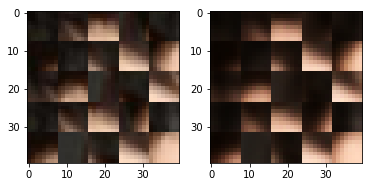

EPO: 24, recon_loss: 0.0108, total_loss: 0.0215
EPO: 24, recon_loss: 0.0041, total_loss: 0.0136
EPO: 24, recon_loss: 0.0041, total_loss: 0.0116
EPO: 24, recon_loss: 0.0043, total_loss: 0.0116
EPO: 24, recon_loss: 0.0042, total_loss: 0.0138
EPO: 24, recon_loss: 0.0057, total_loss: 0.0148
EPO: 24, recon_loss: 0.0076, total_loss: 0.0164
EPO: 24, recon_loss: 0.0039, total_loss: 0.0101
EPO: 24, recon_loss: 0.0039, total_loss: 0.0104
EPO: 24, recon_loss: 0.0026, total_loss: 0.0085
######### what? the reconstruction psnr is: 30.9174


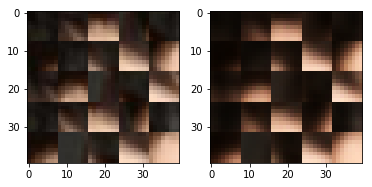

EPO: 24, recon_loss: 0.0051, total_loss: 0.0129
EPO: 24, recon_loss: 0.0085, total_loss: 0.0152
EPO: 24, recon_loss: 0.0023, total_loss: 0.0079
EPO: 24, recon_loss: 0.0041, total_loss: 0.0112
EPO: 24, recon_loss: 0.0022, total_loss: 0.0074
EPO: 24, recon_loss: 0.0044, total_loss: 0.0117
EPO: 24, recon_loss: 0.0103, total_loss: 0.0171
EPO: 24, recon_loss: 0.0042, total_loss: 0.0121
EPO: 24, recon_loss: 0.0077, total_loss: 0.0144
EPO: 24, recon_loss: 0.0017, total_loss: 0.0078
######### what? the reconstruction psnr is: 30.8512


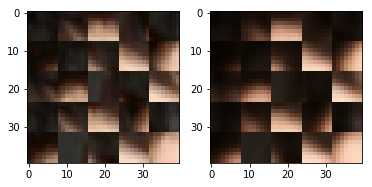

EPO: 24, recon_loss: 0.0031, total_loss: 0.0082
EPO: 24, recon_loss: 0.0069, total_loss: 0.0127
EPO: 24, recon_loss: 0.0031, total_loss: 0.0068
EPO: 24, recon_loss: 0.0053, total_loss: 0.0126
EPO: 24, recon_loss: 0.0020, total_loss: 0.0072
EPO: 24, recon_loss: 0.0018, total_loss: 0.0070
EPO: 24, recon_loss: 0.0036, total_loss: 0.0087
EPO: 24, recon_loss: 0.0021, total_loss: 0.0061
EPO: 24, recon_loss: 0.0029, total_loss: 0.0075
EPO: 24, recon_loss: 0.0093, total_loss: 0.0200
######### what? the reconstruction psnr is: 29.9940


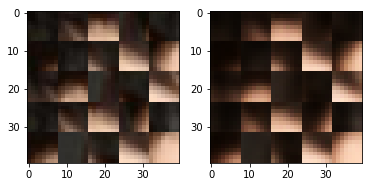

EPO: 24, recon_loss: 0.0073, total_loss: 0.0176
EPO: 24, recon_loss: 0.0050, total_loss: 0.0105
EPO: 24, recon_loss: 0.0060, total_loss: 0.0141
EPO: 24, recon_loss: 0.0038, total_loss: 0.0086
EPO: 24, recon_loss: 0.0064, total_loss: 0.0189
EPO: 24, recon_loss: 0.0027, total_loss: 0.0107
EPO: 24, recon_loss: 0.0068, total_loss: 0.0145
EPO: 24, recon_loss: 0.0027, total_loss: 0.0087
EPO: 24, recon_loss: 0.0060, total_loss: 0.0124
EPO: 24, recon_loss: 0.0016, total_loss: 0.0042
######### what? the reconstruction psnr is: 30.5623


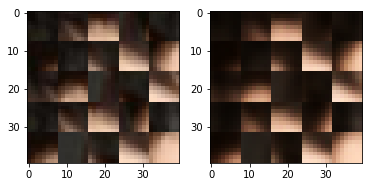

EPO: 24, recon_loss: 0.0008, total_loss: 0.0022
EPO: 24, recon_loss: 0.0044, total_loss: 0.0081
EPO: 24, recon_loss: 0.0015, total_loss: 0.0036
EPO: 24, recon_loss: 0.0021, total_loss: 0.0044
EPO: 24, recon_loss: 0.0042, total_loss: 0.0089
EPO: 24, recon_loss: 0.0029, total_loss: 0.0076
EPO: 24, recon_loss: 0.0057, total_loss: 0.0118
EPO: 24, recon_loss: 0.0022, total_loss: 0.0060
EPO: 24, recon_loss: 0.0023, total_loss: 0.0051
EPO: 24, recon_loss: 0.0068, total_loss: 0.0176
######### what? the reconstruction psnr is: 30.5779


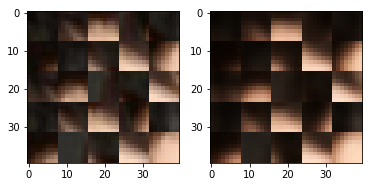

EPO: 24, recon_loss: 0.0046, total_loss: 0.0108
EPO: 24, recon_loss: 0.0070, total_loss: 0.0128
EPO: 24, recon_loss: 0.0047, total_loss: 0.0090
EPO: 24, recon_loss: 0.0065, total_loss: 0.0118
EPO: 24, recon_loss: 0.0107, total_loss: 0.0202
EPO: 24, recon_loss: 0.0180, total_loss: 0.0329
EPO: 24, recon_loss: 0.0048, total_loss: 0.0097
EPO: 24, recon_loss: 0.0043, total_loss: 0.0082
EPO: 24, recon_loss: 0.0079, total_loss: 0.0131
EPO: 24, recon_loss: 0.0027, total_loss: 0.0075
######### what? the reconstruction psnr is: 28.9472


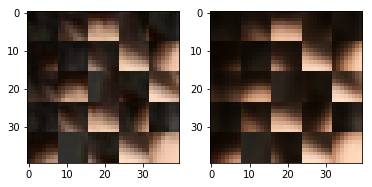

EPO: 24, recon_loss: 0.0013, total_loss: 0.0062
EPO: 24, recon_loss: 0.0032, total_loss: 0.0079
EPO: 24, recon_loss: 0.0037, total_loss: 0.0091
EPO: 24, recon_loss: 0.0041, total_loss: 0.0088
EPO: 24, recon_loss: 0.0027, total_loss: 0.0156
EPO: 24, recon_loss: 0.0015, total_loss: 0.0064
EPO: 24, recon_loss: 0.0034, total_loss: 0.0080
EPO: 24, recon_loss: 0.0035, total_loss: 0.0079
EPO: 24, recon_loss: 0.0011, total_loss: 0.0027
EPO: 24, recon_loss: 0.0042, total_loss: 0.0086
######### what? the reconstruction psnr is: 30.3947


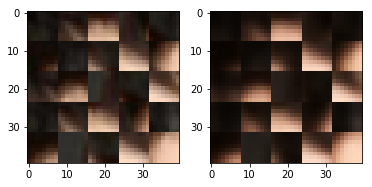

EPO: 24, recon_loss: 0.0051, total_loss: 0.0117
EPO: 24, recon_loss: 0.0104, total_loss: 0.0157
EPO: 24, recon_loss: 0.0125, total_loss: 0.0201
EPO: 24, recon_loss: 0.0097, total_loss: 0.0162
EPO: 24, recon_loss: 0.0081, total_loss: 0.0128
EPO: 25, recon_loss: 0.0019, total_loss: 0.0041
EPO: 25, recon_loss: 0.0026, total_loss: 0.0050
EPO: 25, recon_loss: 0.0059, total_loss: 0.0104
EPO: 25, recon_loss: 0.0027, total_loss: 0.0056
EPO: 25, recon_loss: 0.0055, total_loss: 0.0095
######### what? the reconstruction psnr is: 30.3996


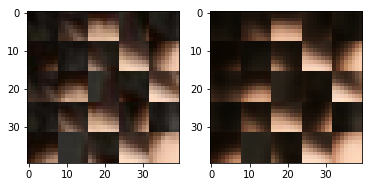

EPO: 25, recon_loss: 0.0020, total_loss: 0.0073
EPO: 25, recon_loss: 0.0029, total_loss: 0.0078
EPO: 25, recon_loss: 0.0059, total_loss: 0.0102
EPO: 25, recon_loss: 0.0063, total_loss: 0.0109
EPO: 25, recon_loss: 0.0064, total_loss: 0.0130
EPO: 25, recon_loss: 0.0023, total_loss: 0.0076
EPO: 25, recon_loss: 0.0018, total_loss: 0.0054
EPO: 25, recon_loss: 0.0032, total_loss: 0.0075
EPO: 25, recon_loss: 0.0027, total_loss: 0.0052
EPO: 25, recon_loss: 0.0072, total_loss: 0.0125
######### what? the reconstruction psnr is: 30.8746


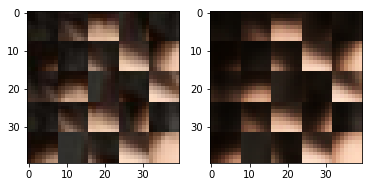

EPO: 25, recon_loss: 0.0032, total_loss: 0.0083
EPO: 25, recon_loss: 0.0030, total_loss: 0.0075
EPO: 25, recon_loss: 0.0039, total_loss: 0.0093
EPO: 25, recon_loss: 0.0033, total_loss: 0.0083
EPO: 25, recon_loss: 0.0035, total_loss: 0.0084
EPO: 25, recon_loss: 0.0028, total_loss: 0.0057
EPO: 25, recon_loss: 0.0026, total_loss: 0.0058
EPO: 25, recon_loss: 0.0084, total_loss: 0.0132
EPO: 25, recon_loss: 0.0021, total_loss: 0.0049
EPO: 25, recon_loss: 0.0043, total_loss: 0.0071
######### what? the reconstruction psnr is: 30.6485


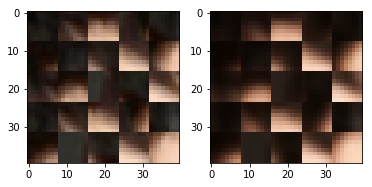

EPO: 25, recon_loss: 0.0061, total_loss: 0.0142
EPO: 25, recon_loss: 0.0044, total_loss: 0.0126
EPO: 25, recon_loss: 0.0071, total_loss: 0.0152
EPO: 25, recon_loss: 0.0089, total_loss: 0.0165
EPO: 25, recon_loss: 0.0065, total_loss: 0.0115
EPO: 25, recon_loss: 0.0047, total_loss: 0.0142
EPO: 25, recon_loss: 0.0018, total_loss: 0.0062
EPO: 25, recon_loss: 0.0056, total_loss: 0.0109
EPO: 25, recon_loss: 0.0032, total_loss: 0.0053
EPO: 25, recon_loss: 0.0026, total_loss: 0.0069
######### what? the reconstruction psnr is: 29.9552


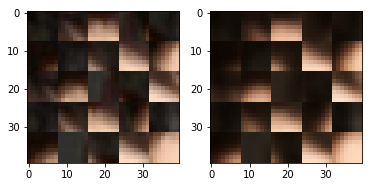

EPO: 25, recon_loss: 0.0014, total_loss: 0.0030
EPO: 25, recon_loss: 0.0017, total_loss: 0.0039
EPO: 25, recon_loss: 0.0046, total_loss: 0.0091
EPO: 25, recon_loss: 0.0031, total_loss: 0.0074
EPO: 25, recon_loss: 0.0040, total_loss: 0.0102
EPO: 25, recon_loss: 0.0015, total_loss: 0.0086
EPO: 25, recon_loss: 0.0016, total_loss: 0.0074
EPO: 25, recon_loss: 0.0041, total_loss: 0.0102
EPO: 25, recon_loss: 0.0013, total_loss: 0.0050
EPO: 25, recon_loss: 0.0034, total_loss: 0.0083
######### what? the reconstruction psnr is: 30.4052


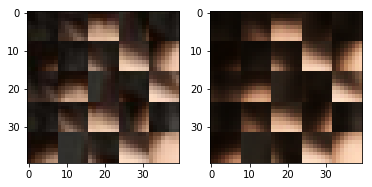

EPO: 25, recon_loss: 0.0061, total_loss: 0.0161
EPO: 25, recon_loss: 0.0020, total_loss: 0.0067
EPO: 25, recon_loss: 0.0073, total_loss: 0.0144
EPO: 25, recon_loss: 0.0038, total_loss: 0.0076
EPO: 25, recon_loss: 0.0033, total_loss: 0.0064
EPO: 25, recon_loss: 0.0083, total_loss: 0.0145
EPO: 25, recon_loss: 0.0031, total_loss: 0.0068
EPO: 25, recon_loss: 0.0048, total_loss: 0.0109
EPO: 25, recon_loss: 0.0041, total_loss: 0.0085
EPO: 25, recon_loss: 0.0048, total_loss: 0.0101
######### what? the reconstruction psnr is: 30.4936


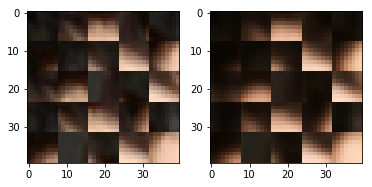

EPO: 25, recon_loss: 0.0133, total_loss: 0.0239
EPO: 25, recon_loss: 0.0117, total_loss: 0.0210
EPO: 25, recon_loss: 0.0098, total_loss: 0.0198
EPO: 25, recon_loss: 0.0113, total_loss: 0.0202
EPO: 25, recon_loss: 0.0073, total_loss: 0.0150
EPO: 25, recon_loss: 0.0066, total_loss: 0.0141
EPO: 25, recon_loss: 0.0035, total_loss: 0.0085
EPO: 25, recon_loss: 0.0055, total_loss: 0.0124
EPO: 25, recon_loss: 0.0080, total_loss: 0.0134
EPO: 25, recon_loss: 0.0073, total_loss: 0.0155
######### what? the reconstruction psnr is: 30.1574


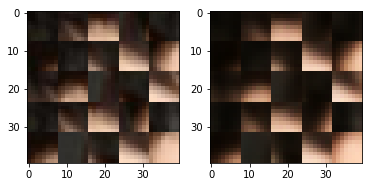

EPO: 25, recon_loss: 0.0089, total_loss: 0.0176
EPO: 25, recon_loss: 0.0019, total_loss: 0.0073
EPO: 25, recon_loss: 0.0053, total_loss: 0.0123
EPO: 25, recon_loss: 0.0084, total_loss: 0.0155
EPO: 25, recon_loss: 0.0032, total_loss: 0.0093
EPO: 25, recon_loss: 0.0061, total_loss: 0.0140
EPO: 25, recon_loss: 0.0061, total_loss: 0.0176
EPO: 25, recon_loss: 0.0084, total_loss: 0.0190
EPO: 25, recon_loss: 0.0153, total_loss: 0.0304
EPO: 25, recon_loss: 0.0051, total_loss: 0.0164
######### what? the reconstruction psnr is: 30.5411


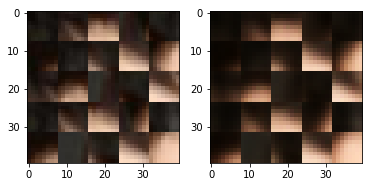

EPO: 25, recon_loss: 0.0099, total_loss: 0.0206
EPO: 25, recon_loss: 0.0066, total_loss: 0.0171
EPO: 25, recon_loss: 0.0078, total_loss: 0.0207
EPO: 25, recon_loss: 0.0154, total_loss: 0.0287
EPO: 25, recon_loss: 0.0115, total_loss: 0.0259
EPO: 25, recon_loss: 0.0106, total_loss: 0.0229
EPO: 25, recon_loss: 0.0022, total_loss: 0.0120
EPO: 25, recon_loss: 0.0087, total_loss: 0.0211
EPO: 25, recon_loss: 0.0202, total_loss: 0.0299
EPO: 25, recon_loss: 0.0108, total_loss: 0.0165
######### what? the reconstruction psnr is: 30.0729


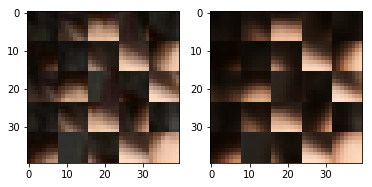

EPO: 25, recon_loss: 0.0040, total_loss: 0.0077
EPO: 25, recon_loss: 0.0022, total_loss: 0.0068
EPO: 25, recon_loss: 0.0030, total_loss: 0.0091
EPO: 25, recon_loss: 0.0087, total_loss: 0.0152
EPO: 25, recon_loss: 0.0037, total_loss: 0.0111
EPO: 25, recon_loss: 0.0077, total_loss: 0.0147
EPO: 25, recon_loss: 0.0008, total_loss: 0.0032
EPO: 25, recon_loss: 0.0006, total_loss: 0.0022
EPO: 25, recon_loss: 0.0018, total_loss: 0.0043
EPO: 25, recon_loss: 0.0008, total_loss: 0.0021
######### what? the reconstruction psnr is: 30.6539


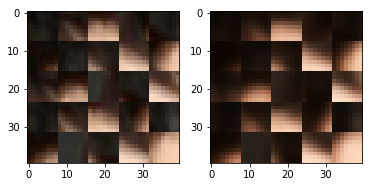

EPO: 25, recon_loss: 0.0017, total_loss: 0.0041
EPO: 25, recon_loss: 0.0038, total_loss: 0.0116
EPO: 25, recon_loss: 0.0023, total_loss: 0.0061
EPO: 25, recon_loss: 0.0053, total_loss: 0.0110
EPO: 25, recon_loss: 0.0026, total_loss: 0.0055
EPO: 25, recon_loss: 0.0033, total_loss: 0.0062
EPO: 25, recon_loss: 0.0057, total_loss: 0.0150
EPO: 25, recon_loss: 0.0070, total_loss: 0.0156
EPO: 25, recon_loss: 0.0071, total_loss: 0.0157
EPO: 25, recon_loss: 0.0079, total_loss: 0.0174
######### what? the reconstruction psnr is: 30.3200


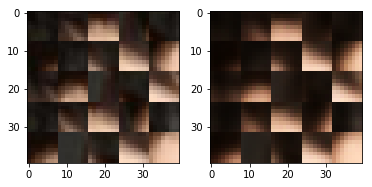

EPO: 25, recon_loss: 0.0038, total_loss: 0.0081
EPO: 25, recon_loss: 0.0048, total_loss: 0.0108
EPO: 25, recon_loss: 0.0030, total_loss: 0.0066
EPO: 25, recon_loss: 0.0048, total_loss: 0.0098
EPO: 25, recon_loss: 0.0029, total_loss: 0.0065
EPO: 25, recon_loss: 0.0031, total_loss: 0.0065
EPO: 25, recon_loss: 0.0033, total_loss: 0.0139
EPO: 25, recon_loss: 0.0013, total_loss: 0.0055
EPO: 25, recon_loss: 0.0048, total_loss: 0.0120
EPO: 25, recon_loss: 0.0036, total_loss: 0.0080
######### what? the reconstruction psnr is: 30.3731


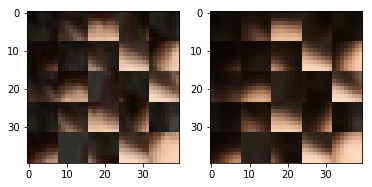

EPO: 25, recon_loss: 0.0047, total_loss: 0.0091
EPO: 25, recon_loss: 0.0018, total_loss: 0.0041
EPO: 25, recon_loss: 0.0011, total_loss: 0.0037
EPO: 25, recon_loss: 0.0024, total_loss: 0.0054
EPO: 25, recon_loss: 0.0022, total_loss: 0.0054
EPO: 25, recon_loss: 0.0021, total_loss: 0.0045
EPO: 25, recon_loss: 0.0036, total_loss: 0.0090
EPO: 25, recon_loss: 0.0023, total_loss: 0.0060
EPO: 25, recon_loss: 0.0052, total_loss: 0.0108
EPO: 25, recon_loss: 0.0038, total_loss: 0.0090
######### what? the reconstruction psnr is: 30.5711


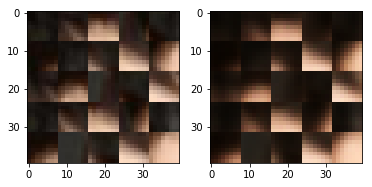

EPO: 25, recon_loss: 0.0035, total_loss: 0.0082
EPO: 25, recon_loss: 0.0035, total_loss: 0.0134
EPO: 25, recon_loss: 0.0035, total_loss: 0.0113
EPO: 25, recon_loss: 0.0093, total_loss: 0.0178
EPO: 25, recon_loss: 0.0083, total_loss: 0.0155
EPO: 25, recon_loss: 0.0037, total_loss: 0.0094
EPO: 25, recon_loss: 0.0130, total_loss: 0.0227
EPO: 25, recon_loss: 0.0009, total_loss: 0.0039
EPO: 25, recon_loss: 0.0022, total_loss: 0.0076
EPO: 25, recon_loss: 0.0079, total_loss: 0.0138
######### what? the reconstruction psnr is: 29.7142


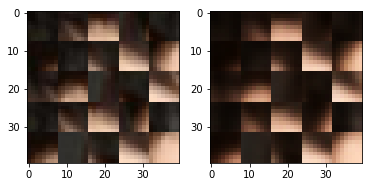

EPO: 25, recon_loss: 0.0044, total_loss: 0.0088
EPO: 25, recon_loss: 0.0037, total_loss: 0.0085
EPO: 25, recon_loss: 0.0051, total_loss: 0.0112
EPO: 25, recon_loss: 0.0060, total_loss: 0.0130
EPO: 25, recon_loss: 0.0073, total_loss: 0.0143
EPO: 25, recon_loss: 0.0017, total_loss: 0.0055
EPO: 25, recon_loss: 0.0076, total_loss: 0.0129
EPO: 25, recon_loss: 0.0016, total_loss: 0.0052
EPO: 25, recon_loss: 0.0064, total_loss: 0.0116
EPO: 25, recon_loss: 0.0065, total_loss: 0.0134
######### what? the reconstruction psnr is: 30.4067


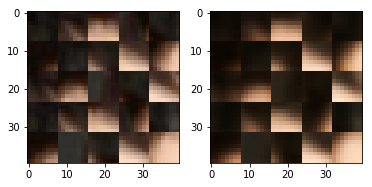

EPO: 25, recon_loss: 0.0029, total_loss: 0.0075
EPO: 25, recon_loss: 0.0037, total_loss: 0.0081
EPO: 25, recon_loss: 0.0050, total_loss: 0.0115
EPO: 25, recon_loss: 0.0033, total_loss: 0.0088
EPO: 25, recon_loss: 0.0096, total_loss: 0.0154
EPO: 25, recon_loss: 0.0041, total_loss: 0.0108
EPO: 25, recon_loss: 0.0060, total_loss: 0.0120
EPO: 25, recon_loss: 0.0052, total_loss: 0.0128
EPO: 25, recon_loss: 0.0010, total_loss: 0.0040
EPO: 25, recon_loss: 0.0058, total_loss: 0.0101
######### what? the reconstruction psnr is: 30.6860


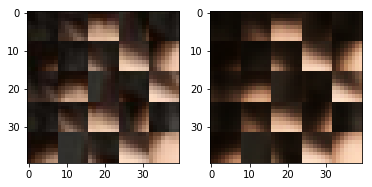

EPO: 25, recon_loss: 0.0032, total_loss: 0.0076
EPO: 25, recon_loss: 0.0043, total_loss: 0.0091
EPO: 25, recon_loss: 0.0036, total_loss: 0.0106
EPO: 25, recon_loss: 0.0038, total_loss: 0.0093
EPO: 25, recon_loss: 0.0092, total_loss: 0.0167
EPO: 25, recon_loss: 0.0031, total_loss: 0.0090
EPO: 25, recon_loss: 0.0074, total_loss: 0.0150
EPO: 25, recon_loss: 0.0047, total_loss: 0.0122
EPO: 25, recon_loss: 0.0016, total_loss: 0.0059
EPO: 25, recon_loss: 0.0062, total_loss: 0.0141
######### what? the reconstruction psnr is: 30.7548


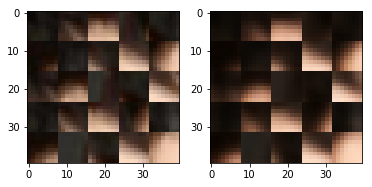

EPO: 25, recon_loss: 0.0025, total_loss: 0.0072
EPO: 25, recon_loss: 0.0055, total_loss: 0.0114
EPO: 25, recon_loss: 0.0023, total_loss: 0.0038
EPO: 25, recon_loss: 0.0018, total_loss: 0.0036
EPO: 25, recon_loss: 0.0042, total_loss: 0.0078
EPO: 25, recon_loss: 0.0025, total_loss: 0.0065
EPO: 25, recon_loss: 0.0027, total_loss: 0.0066
EPO: 25, recon_loss: 0.0112, total_loss: 0.0238
EPO: 25, recon_loss: 0.0078, total_loss: 0.0189
EPO: 25, recon_loss: 0.0092, total_loss: 0.0241
######### what? the reconstruction psnr is: 30.2990


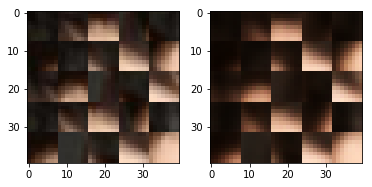

EPO: 25, recon_loss: 0.0062, total_loss: 0.0186
EPO: 25, recon_loss: 0.0084, total_loss: 0.0233
EPO: 25, recon_loss: 0.0022, total_loss: 0.0085
EPO: 25, recon_loss: 0.0026, total_loss: 0.0077
EPO: 25, recon_loss: 0.0078, total_loss: 0.0197
EPO: 25, recon_loss: 0.0034, total_loss: 0.0118
EPO: 25, recon_loss: 0.0037, total_loss: 0.0098
EPO: 25, recon_loss: 0.0039, total_loss: 0.0150
EPO: 25, recon_loss: 0.0039, total_loss: 0.0127
EPO: 25, recon_loss: 0.0070, total_loss: 0.0166
######### what? the reconstruction psnr is: 31.1177


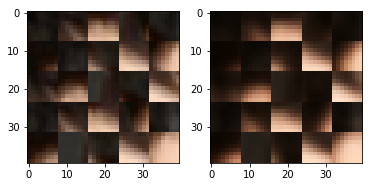

EPO: 25, recon_loss: 0.0038, total_loss: 0.0101
EPO: 25, recon_loss: 0.0035, total_loss: 0.0092
EPO: 25, recon_loss: 0.0049, total_loss: 0.0110
EPO: 25, recon_loss: 0.0023, total_loss: 0.0081
EPO: 25, recon_loss: 0.0078, total_loss: 0.0159
EPO: 25, recon_loss: 0.0038, total_loss: 0.0095
EPO: 25, recon_loss: 0.0024, total_loss: 0.0080
EPO: 25, recon_loss: 0.0044, total_loss: 0.0087
EPO: 25, recon_loss: 0.0021, total_loss: 0.0071
EPO: 25, recon_loss: 0.0061, total_loss: 0.0150
######### what? the reconstruction psnr is: 30.6991


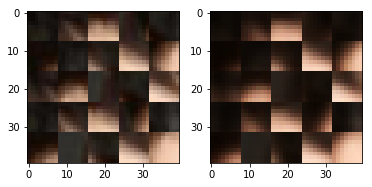

EPO: 25, recon_loss: 0.0063, total_loss: 0.0139
EPO: 25, recon_loss: 0.0046, total_loss: 0.0123
EPO: 25, recon_loss: 0.0087, total_loss: 0.0163
EPO: 25, recon_loss: 0.0015, total_loss: 0.0062
EPO: 25, recon_loss: 0.0049, total_loss: 0.0130
EPO: 25, recon_loss: 0.0061, total_loss: 0.0111
EPO: 25, recon_loss: 0.0047, total_loss: 0.0103
EPO: 25, recon_loss: 0.0051, total_loss: 0.0112
EPO: 25, recon_loss: 0.0018, total_loss: 0.0069
EPO: 25, recon_loss: 0.0028, total_loss: 0.0098
######### what? the reconstruction psnr is: 30.9257


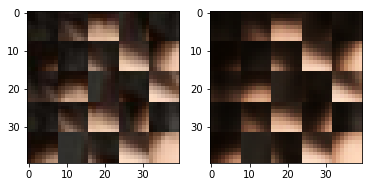

EPO: 25, recon_loss: 0.0025, total_loss: 0.0074
EPO: 25, recon_loss: 0.0025, total_loss: 0.0065
EPO: 25, recon_loss: 0.0023, total_loss: 0.0062
EPO: 25, recon_loss: 0.0095, total_loss: 0.0211
EPO: 25, recon_loss: 0.0066, total_loss: 0.0150
EPO: 25, recon_loss: 0.0064, total_loss: 0.0125
EPO: 25, recon_loss: 0.0063, total_loss: 0.0141
EPO: 25, recon_loss: 0.0038, total_loss: 0.0090
EPO: 25, recon_loss: 0.0055, total_loss: 0.0170
EPO: 25, recon_loss: 0.0028, total_loss: 0.0101
######### what? the reconstruction psnr is: 30.0800


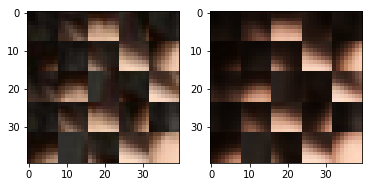

EPO: 25, recon_loss: 0.0073, total_loss: 0.0149
EPO: 25, recon_loss: 0.0028, total_loss: 0.0086
EPO: 25, recon_loss: 0.0067, total_loss: 0.0134
EPO: 25, recon_loss: 0.0013, total_loss: 0.0033
EPO: 25, recon_loss: 0.0009, total_loss: 0.0024
EPO: 25, recon_loss: 0.0049, total_loss: 0.0085
EPO: 25, recon_loss: 0.0014, total_loss: 0.0034
EPO: 25, recon_loss: 0.0029, total_loss: 0.0058
EPO: 25, recon_loss: 0.0042, total_loss: 0.0097
EPO: 25, recon_loss: 0.0033, total_loss: 0.0088
######### what? the reconstruction psnr is: 30.4882


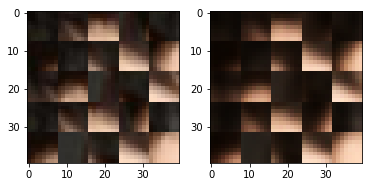

EPO: 25, recon_loss: 0.0041, total_loss: 0.0095
EPO: 25, recon_loss: 0.0022, total_loss: 0.0060
EPO: 25, recon_loss: 0.0028, total_loss: 0.0064
EPO: 25, recon_loss: 0.0052, total_loss: 0.0123
EPO: 25, recon_loss: 0.0047, total_loss: 0.0113
EPO: 25, recon_loss: 0.0083, total_loss: 0.0132
EPO: 25, recon_loss: 0.0057, total_loss: 0.0105
EPO: 25, recon_loss: 0.0057, total_loss: 0.0101
EPO: 25, recon_loss: 0.0084, total_loss: 0.0186
EPO: 25, recon_loss: 0.0158, total_loss: 0.0282
######### what? the reconstruction psnr is: 29.4888


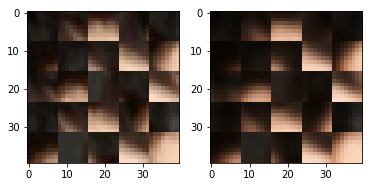

EPO: 25, recon_loss: 0.0078, total_loss: 0.0131
EPO: 25, recon_loss: 0.0051, total_loss: 0.0099
EPO: 25, recon_loss: 0.0081, total_loss: 0.0126
EPO: 25, recon_loss: 0.0020, total_loss: 0.0071
EPO: 25, recon_loss: 0.0013, total_loss: 0.0058
EPO: 25, recon_loss: 0.0041, total_loss: 0.0084
EPO: 25, recon_loss: 0.0025, total_loss: 0.0078
EPO: 25, recon_loss: 0.0036, total_loss: 0.0073
EPO: 25, recon_loss: 0.0035, total_loss: 0.0152
EPO: 25, recon_loss: 0.0014, total_loss: 0.0062
######### what? the reconstruction psnr is: 30.5647


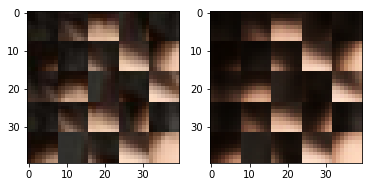

EPO: 25, recon_loss: 0.0031, total_loss: 0.0085
EPO: 25, recon_loss: 0.0014, total_loss: 0.0039
EPO: 25, recon_loss: 0.0012, total_loss: 0.0028
EPO: 25, recon_loss: 0.0046, total_loss: 0.0114
EPO: 25, recon_loss: 0.0051, total_loss: 0.0112
EPO: 25, recon_loss: 0.0121, total_loss: 0.0183
EPO: 25, recon_loss: 0.0101, total_loss: 0.0162
EPO: 25, recon_loss: 0.0087, total_loss: 0.0145
EPO: 26, recon_loss: 0.0040, total_loss: 0.0084
EPO: 26, recon_loss: 0.0019, total_loss: 0.0040
######### what? the reconstruction psnr is: 30.6335


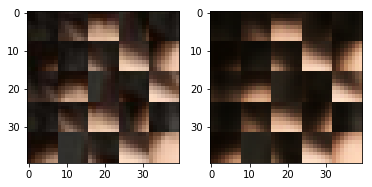

EPO: 26, recon_loss: 0.0059, total_loss: 0.0090
EPO: 26, recon_loss: 0.0030, total_loss: 0.0069
EPO: 26, recon_loss: 0.0023, total_loss: 0.0049
EPO: 26, recon_loss: 0.0037, total_loss: 0.0141
EPO: 26, recon_loss: 0.0016, total_loss: 0.0061
EPO: 26, recon_loss: 0.0035, total_loss: 0.0084
EPO: 26, recon_loss: 0.0050, total_loss: 0.0093
EPO: 26, recon_loss: 0.0045, total_loss: 0.0091
EPO: 26, recon_loss: 0.0050, total_loss: 0.0119
EPO: 26, recon_loss: 0.0022, total_loss: 0.0069
######### what? the reconstruction psnr is: 30.8368


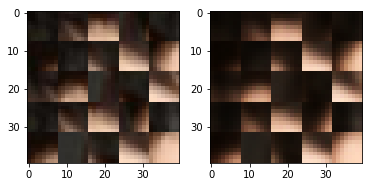

EPO: 26, recon_loss: 0.0030, total_loss: 0.0085
EPO: 26, recon_loss: 0.0026, total_loss: 0.0059
EPO: 26, recon_loss: 0.0030, total_loss: 0.0064
EPO: 26, recon_loss: 0.0088, total_loss: 0.0147
EPO: 26, recon_loss: 0.0030, total_loss: 0.0076
EPO: 26, recon_loss: 0.0037, total_loss: 0.0096
EPO: 26, recon_loss: 0.0039, total_loss: 0.0093
EPO: 26, recon_loss: 0.0031, total_loss: 0.0074
EPO: 26, recon_loss: 0.0033, total_loss: 0.0081
EPO: 26, recon_loss: 0.0030, total_loss: 0.0059
######### what? the reconstruction psnr is: 30.8644


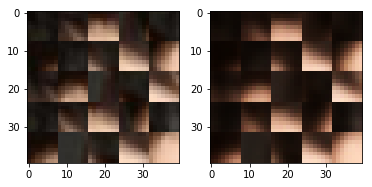

EPO: 26, recon_loss: 0.0031, total_loss: 0.0068
EPO: 26, recon_loss: 0.0078, total_loss: 0.0123
EPO: 26, recon_loss: 0.0022, total_loss: 0.0051
EPO: 26, recon_loss: 0.0048, total_loss: 0.0077
EPO: 26, recon_loss: 0.0074, total_loss: 0.0172
EPO: 26, recon_loss: 0.0034, total_loss: 0.0098
EPO: 26, recon_loss: 0.0082, total_loss: 0.0154
EPO: 26, recon_loss: 0.0063, total_loss: 0.0124
EPO: 26, recon_loss: 0.0104, total_loss: 0.0166
EPO: 26, recon_loss: 0.0042, total_loss: 0.0128
######### what? the reconstruction psnr is: 30.4260


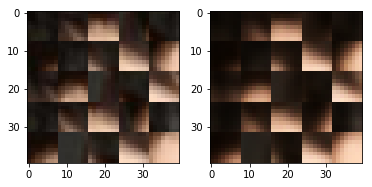

EPO: 26, recon_loss: 0.0020, total_loss: 0.0068
EPO: 26, recon_loss: 0.0053, total_loss: 0.0102
EPO: 26, recon_loss: 0.0039, total_loss: 0.0067
EPO: 26, recon_loss: 0.0037, total_loss: 0.0076
EPO: 26, recon_loss: 0.0011, total_loss: 0.0027
EPO: 26, recon_loss: 0.0017, total_loss: 0.0042
EPO: 26, recon_loss: 0.0056, total_loss: 0.0106
EPO: 26, recon_loss: 0.0027, total_loss: 0.0068
EPO: 26, recon_loss: 0.0042, total_loss: 0.0105
EPO: 26, recon_loss: 0.0014, total_loss: 0.0079
######### what? the reconstruction psnr is: 30.4840


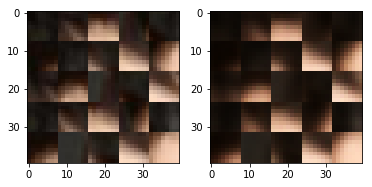

EPO: 26, recon_loss: 0.0019, total_loss: 0.0082
EPO: 26, recon_loss: 0.0048, total_loss: 0.0108
EPO: 26, recon_loss: 0.0011, total_loss: 0.0048
EPO: 26, recon_loss: 0.0042, total_loss: 0.0093
EPO: 26, recon_loss: 0.0079, total_loss: 0.0205
EPO: 26, recon_loss: 0.0020, total_loss: 0.0067
EPO: 26, recon_loss: 0.0106, total_loss: 0.0172
EPO: 26, recon_loss: 0.0027, total_loss: 0.0061
EPO: 26, recon_loss: 0.0027, total_loss: 0.0057
EPO: 26, recon_loss: 0.0063, total_loss: 0.0121
######### what? the reconstruction psnr is: 30.7541


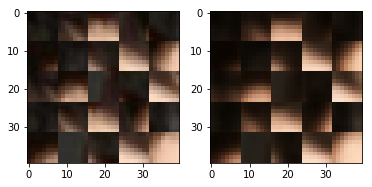

EPO: 26, recon_loss: 0.0027, total_loss: 0.0064
EPO: 26, recon_loss: 0.0058, total_loss: 0.0114
EPO: 26, recon_loss: 0.0034, total_loss: 0.0066
EPO: 26, recon_loss: 0.0050, total_loss: 0.0099
EPO: 26, recon_loss: 0.0144, total_loss: 0.0244
EPO: 26, recon_loss: 0.0080, total_loss: 0.0163
EPO: 26, recon_loss: 0.0139, total_loss: 0.0241
EPO: 26, recon_loss: 0.0087, total_loss: 0.0170
EPO: 26, recon_loss: 0.0075, total_loss: 0.0159
EPO: 26, recon_loss: 0.0030, total_loss: 0.0098
######### what? the reconstruction psnr is: 30.6567


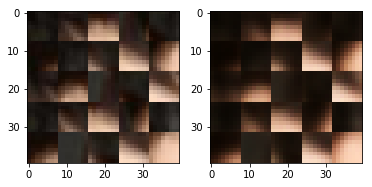

EPO: 26, recon_loss: 0.0035, total_loss: 0.0082
EPO: 26, recon_loss: 0.0049, total_loss: 0.0121
EPO: 26, recon_loss: 0.0058, total_loss: 0.0105
EPO: 26, recon_loss: 0.0058, total_loss: 0.0138
EPO: 26, recon_loss: 0.0037, total_loss: 0.0130
EPO: 26, recon_loss: 0.0015, total_loss: 0.0071
EPO: 26, recon_loss: 0.0066, total_loss: 0.0134
EPO: 26, recon_loss: 0.0041, total_loss: 0.0097
EPO: 26, recon_loss: 0.0036, total_loss: 0.0098
EPO: 26, recon_loss: 0.0071, total_loss: 0.0175
######### what? the reconstruction psnr is: 29.6924


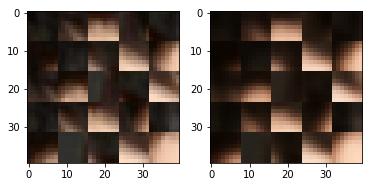

EPO: 26, recon_loss: 0.0056, total_loss: 0.0169
EPO: 26, recon_loss: 0.0123, total_loss: 0.0255
EPO: 26, recon_loss: 0.0111, total_loss: 0.0239
EPO: 26, recon_loss: 0.0055, total_loss: 0.0162
EPO: 26, recon_loss: 0.0180, total_loss: 0.0317
EPO: 26, recon_loss: 0.0058, total_loss: 0.0167
EPO: 26, recon_loss: 0.0096, total_loss: 0.0223
EPO: 26, recon_loss: 0.0139, total_loss: 0.0266
EPO: 26, recon_loss: 0.0085, total_loss: 0.0215
EPO: 26, recon_loss: 0.0100, total_loss: 0.0212
######### what? the reconstruction psnr is: 30.4576


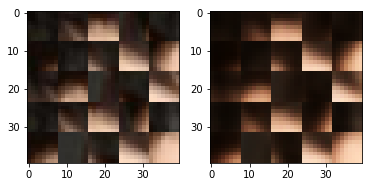

EPO: 26, recon_loss: 0.0021, total_loss: 0.0116
EPO: 26, recon_loss: 0.0114, total_loss: 0.0227
EPO: 26, recon_loss: 0.0142, total_loss: 0.0215
EPO: 26, recon_loss: 0.0039, total_loss: 0.0080
EPO: 26, recon_loss: 0.0034, total_loss: 0.0071
EPO: 26, recon_loss: 0.0020, total_loss: 0.0065
EPO: 26, recon_loss: 0.0033, total_loss: 0.0100
EPO: 26, recon_loss: 0.0059, total_loss: 0.0127
EPO: 26, recon_loss: 0.0041, total_loss: 0.0113
EPO: 26, recon_loss: 0.0074, total_loss: 0.0155
######### what? the reconstruction psnr is: 30.8910


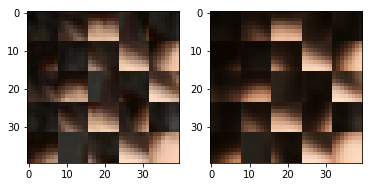

EPO: 26, recon_loss: 0.0005, total_loss: 0.0025
EPO: 26, recon_loss: 0.0007, total_loss: 0.0028
EPO: 26, recon_loss: 0.0018, total_loss: 0.0039
EPO: 26, recon_loss: 0.0008, total_loss: 0.0023
EPO: 26, recon_loss: 0.0025, total_loss: 0.0052
EPO: 26, recon_loss: 0.0027, total_loss: 0.0079
EPO: 26, recon_loss: 0.0034, total_loss: 0.0079
EPO: 26, recon_loss: 0.0058, total_loss: 0.0118
EPO: 26, recon_loss: 0.0026, total_loss: 0.0055
EPO: 26, recon_loss: 0.0043, total_loss: 0.0074
######### what? the reconstruction psnr is: 30.6671


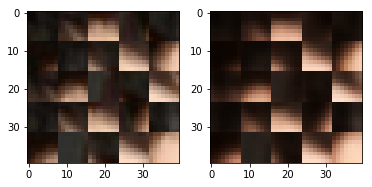

EPO: 26, recon_loss: 0.0059, total_loss: 0.0151
EPO: 26, recon_loss: 0.0098, total_loss: 0.0208
EPO: 26, recon_loss: 0.0068, total_loss: 0.0168
EPO: 26, recon_loss: 0.0050, total_loss: 0.0120
EPO: 26, recon_loss: 0.0058, total_loss: 0.0110
EPO: 26, recon_loss: 0.0037, total_loss: 0.0091
EPO: 26, recon_loss: 0.0032, total_loss: 0.0068
EPO: 26, recon_loss: 0.0049, total_loss: 0.0101
EPO: 26, recon_loss: 0.0022, total_loss: 0.0051
EPO: 26, recon_loss: 0.0031, total_loss: 0.0070
######### what? the reconstruction psnr is: 30.1824


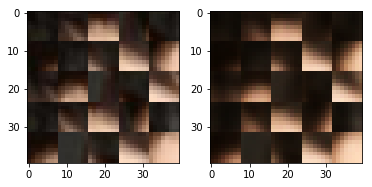

EPO: 26, recon_loss: 0.0033, total_loss: 0.0137
EPO: 26, recon_loss: 0.0011, total_loss: 0.0052
EPO: 26, recon_loss: 0.0068, total_loss: 0.0139
EPO: 26, recon_loss: 0.0042, total_loss: 0.0087
EPO: 26, recon_loss: 0.0043, total_loss: 0.0097
EPO: 26, recon_loss: 0.0016, total_loss: 0.0039
EPO: 26, recon_loss: 0.0012, total_loss: 0.0036
EPO: 26, recon_loss: 0.0028, total_loss: 0.0065
EPO: 26, recon_loss: 0.0011, total_loss: 0.0038
EPO: 26, recon_loss: 0.0015, total_loss: 0.0036
######### what? the reconstruction psnr is: 30.3202


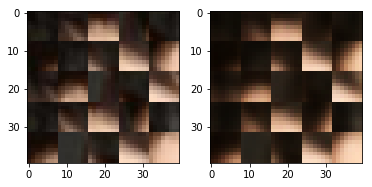

EPO: 26, recon_loss: 0.0032, total_loss: 0.0084
EPO: 26, recon_loss: 0.0022, total_loss: 0.0060
EPO: 26, recon_loss: 0.0072, total_loss: 0.0131
EPO: 26, recon_loss: 0.0034, total_loss: 0.0085
EPO: 26, recon_loss: 0.0028, total_loss: 0.0069
EPO: 26, recon_loss: 0.0031, total_loss: 0.0128
EPO: 26, recon_loss: 0.0035, total_loss: 0.0104
EPO: 26, recon_loss: 0.0110, total_loss: 0.0197
EPO: 26, recon_loss: 0.0044, total_loss: 0.0100
EPO: 26, recon_loss: 0.0058, total_loss: 0.0127
######### what? the reconstruction psnr is: 30.1764


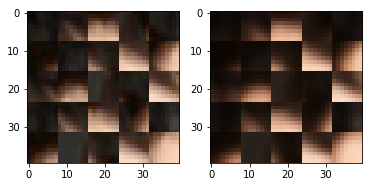

EPO: 26, recon_loss: 0.0019, total_loss: 0.0080
EPO: 26, recon_loss: 0.0006, total_loss: 0.0033
EPO: 26, recon_loss: 0.0039, total_loss: 0.0095
EPO: 26, recon_loss: 0.0051, total_loss: 0.0092
EPO: 26, recon_loss: 0.0046, total_loss: 0.0100
EPO: 26, recon_loss: 0.0050, total_loss: 0.0113
EPO: 26, recon_loss: 0.0070, total_loss: 0.0134
EPO: 26, recon_loss: 0.0056, total_loss: 0.0126
EPO: 26, recon_loss: 0.0052, total_loss: 0.0113
EPO: 26, recon_loss: 0.0018, total_loss: 0.0054
######### what? the reconstruction psnr is: 30.7839


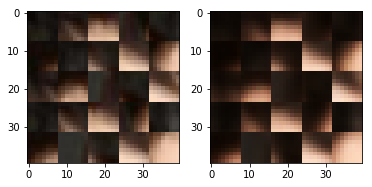

EPO: 26, recon_loss: 0.0065, total_loss: 0.0131
EPO: 26, recon_loss: 0.0015, total_loss: 0.0050
EPO: 26, recon_loss: 0.0063, total_loss: 0.0123
EPO: 26, recon_loss: 0.0064, total_loss: 0.0128
EPO: 26, recon_loss: 0.0031, total_loss: 0.0074
EPO: 26, recon_loss: 0.0033, total_loss: 0.0077
EPO: 26, recon_loss: 0.0039, total_loss: 0.0094
EPO: 26, recon_loss: 0.0036, total_loss: 0.0093
EPO: 26, recon_loss: 0.0078, total_loss: 0.0132
EPO: 26, recon_loss: 0.0046, total_loss: 0.0115
######### what? the reconstruction psnr is: 30.9048


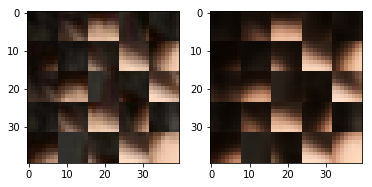

EPO: 26, recon_loss: 0.0070, total_loss: 0.0129
EPO: 26, recon_loss: 0.0039, total_loss: 0.0091
EPO: 26, recon_loss: 0.0015, total_loss: 0.0046
EPO: 26, recon_loss: 0.0038, total_loss: 0.0078
EPO: 26, recon_loss: 0.0034, total_loss: 0.0081
EPO: 26, recon_loss: 0.0057, total_loss: 0.0120
EPO: 26, recon_loss: 0.0035, total_loss: 0.0096
EPO: 26, recon_loss: 0.0039, total_loss: 0.0099
EPO: 26, recon_loss: 0.0109, total_loss: 0.0193
EPO: 26, recon_loss: 0.0033, total_loss: 0.0095
######### what? the reconstruction psnr is: 30.6652


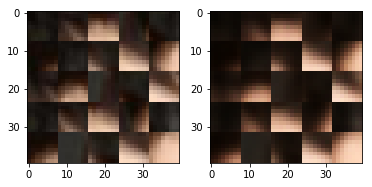

EPO: 26, recon_loss: 0.0087, total_loss: 0.0181
EPO: 26, recon_loss: 0.0025, total_loss: 0.0076
EPO: 26, recon_loss: 0.0016, total_loss: 0.0061
EPO: 26, recon_loss: 0.0065, total_loss: 0.0150
EPO: 26, recon_loss: 0.0031, total_loss: 0.0085
EPO: 26, recon_loss: 0.0077, total_loss: 0.0143
EPO: 26, recon_loss: 0.0023, total_loss: 0.0038
EPO: 26, recon_loss: 0.0017, total_loss: 0.0035
EPO: 26, recon_loss: 0.0045, total_loss: 0.0085
EPO: 26, recon_loss: 0.0017, total_loss: 0.0057
######### what? the reconstruction psnr is: 30.7279


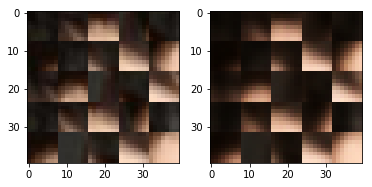

EPO: 26, recon_loss: 0.0034, total_loss: 0.0085
EPO: 26, recon_loss: 0.0105, total_loss: 0.0235
EPO: 26, recon_loss: 0.0079, total_loss: 0.0189
EPO: 26, recon_loss: 0.0122, total_loss: 0.0275
EPO: 26, recon_loss: 0.0059, total_loss: 0.0169
EPO: 26, recon_loss: 0.0103, total_loss: 0.0256
EPO: 26, recon_loss: 0.0021, total_loss: 0.0085
EPO: 26, recon_loss: 0.0042, total_loss: 0.0093
EPO: 26, recon_loss: 0.0064, total_loss: 0.0180
EPO: 26, recon_loss: 0.0035, total_loss: 0.0110
######### what? the reconstruction psnr is: 30.9426


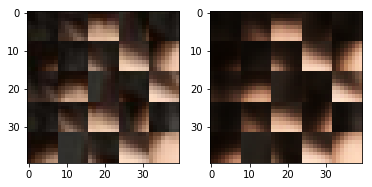

EPO: 26, recon_loss: 0.0037, total_loss: 0.0100
EPO: 26, recon_loss: 0.0038, total_loss: 0.0145
EPO: 26, recon_loss: 0.0042, total_loss: 0.0131
EPO: 26, recon_loss: 0.0097, total_loss: 0.0193
EPO: 26, recon_loss: 0.0024, total_loss: 0.0083
EPO: 26, recon_loss: 0.0025, total_loss: 0.0078
EPO: 26, recon_loss: 0.0047, total_loss: 0.0120
EPO: 26, recon_loss: 0.0017, total_loss: 0.0075
EPO: 26, recon_loss: 0.0090, total_loss: 0.0170
EPO: 26, recon_loss: 0.0022, total_loss: 0.0078
######### what? the reconstruction psnr is: 31.1152


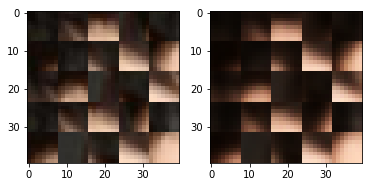

EPO: 26, recon_loss: 0.0029, total_loss: 0.0084
EPO: 26, recon_loss: 0.0042, total_loss: 0.0083
EPO: 26, recon_loss: 0.0022, total_loss: 0.0077
EPO: 26, recon_loss: 0.0095, total_loss: 0.0176
EPO: 26, recon_loss: 0.0049, total_loss: 0.0128
EPO: 26, recon_loss: 0.0041, total_loss: 0.0103
EPO: 26, recon_loss: 0.0046, total_loss: 0.0170
EPO: 26, recon_loss: 0.0014, total_loss: 0.0063
EPO: 26, recon_loss: 0.0069, total_loss: 0.0170
EPO: 26, recon_loss: 0.0042, total_loss: 0.0079
######### what? the reconstruction psnr is: 30.8117


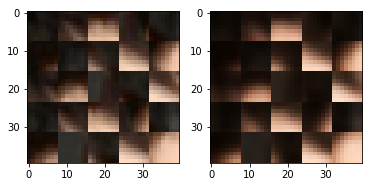

EPO: 26, recon_loss: 0.0040, total_loss: 0.0093
EPO: 26, recon_loss: 0.0032, total_loss: 0.0107
EPO: 26, recon_loss: 0.0017, total_loss: 0.0068
EPO: 26, recon_loss: 0.0034, total_loss: 0.0104
EPO: 26, recon_loss: 0.0018, total_loss: 0.0061
EPO: 26, recon_loss: 0.0031, total_loss: 0.0073
EPO: 26, recon_loss: 0.0068, total_loss: 0.0156
EPO: 26, recon_loss: 0.0106, total_loss: 0.0218
EPO: 26, recon_loss: 0.0055, total_loss: 0.0131
EPO: 26, recon_loss: 0.0060, total_loss: 0.0133
######### what? the reconstruction psnr is: 30.1012


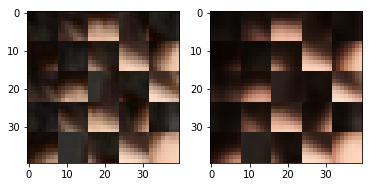

EPO: 26, recon_loss: 0.0063, total_loss: 0.0140
EPO: 26, recon_loss: 0.0034, total_loss: 0.0074
EPO: 26, recon_loss: 0.0041, total_loss: 0.0137
EPO: 26, recon_loss: 0.0035, total_loss: 0.0110
EPO: 26, recon_loss: 0.0057, total_loss: 0.0134
EPO: 26, recon_loss: 0.0039, total_loss: 0.0102
EPO: 26, recon_loss: 0.0078, total_loss: 0.0154
EPO: 26, recon_loss: 0.0009, total_loss: 0.0025
EPO: 26, recon_loss: 0.0018, total_loss: 0.0046
EPO: 26, recon_loss: 0.0034, total_loss: 0.0060
######### what? the reconstruction psnr is: 30.5126


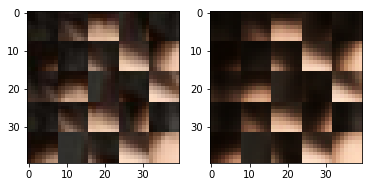

EPO: 26, recon_loss: 0.0013, total_loss: 0.0032
EPO: 26, recon_loss: 0.0032, total_loss: 0.0064
EPO: 26, recon_loss: 0.0046, total_loss: 0.0111
EPO: 26, recon_loss: 0.0032, total_loss: 0.0085
EPO: 26, recon_loss: 0.0040, total_loss: 0.0095
EPO: 26, recon_loss: 0.0027, total_loss: 0.0065
EPO: 26, recon_loss: 0.0038, total_loss: 0.0080
EPO: 26, recon_loss: 0.0045, total_loss: 0.0109
EPO: 26, recon_loss: 0.0042, total_loss: 0.0108
EPO: 26, recon_loss: 0.0090, total_loss: 0.0140
######### what? the reconstruction psnr is: 30.3479


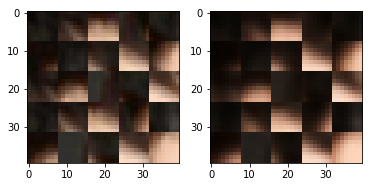

EPO: 26, recon_loss: 0.0047, total_loss: 0.0095
EPO: 26, recon_loss: 0.0071, total_loss: 0.0121
EPO: 26, recon_loss: 0.0117, total_loss: 0.0230
EPO: 26, recon_loss: 0.0107, total_loss: 0.0182
EPO: 26, recon_loss: 0.0071, total_loss: 0.0126
EPO: 26, recon_loss: 0.0052, total_loss: 0.0092
EPO: 26, recon_loss: 0.0097, total_loss: 0.0140
EPO: 26, recon_loss: 0.0014, total_loss: 0.0056
EPO: 26, recon_loss: 0.0020, total_loss: 0.0067
EPO: 26, recon_loss: 0.0052, total_loss: 0.0091
######### what? the reconstruction psnr is: 30.0577


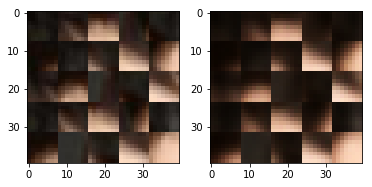

EPO: 26, recon_loss: 0.0034, total_loss: 0.0094
EPO: 26, recon_loss: 0.0054, total_loss: 0.0101
EPO: 26, recon_loss: 0.0033, total_loss: 0.0137
EPO: 26, recon_loss: 0.0014, total_loss: 0.0061
EPO: 26, recon_loss: 0.0050, total_loss: 0.0103
EPO: 26, recon_loss: 0.0009, total_loss: 0.0028
EPO: 26, recon_loss: 0.0015, total_loss: 0.0031
EPO: 26, recon_loss: 0.0052, total_loss: 0.0116
EPO: 26, recon_loss: 0.0054, total_loss: 0.0118
EPO: 26, recon_loss: 0.0153, total_loss: 0.0219
######### what? the reconstruction psnr is: 28.1984


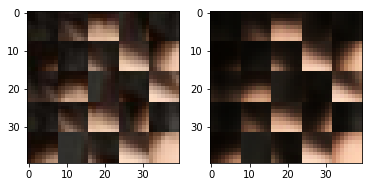

EPO: 26, recon_loss: 0.0101, total_loss: 0.0160
EPO: 26, recon_loss: 0.0081, total_loss: 0.0130
EPO: 27, recon_loss: 0.0030, total_loss: 0.0064
EPO: 27, recon_loss: 0.0019, total_loss: 0.0039
EPO: 27, recon_loss: 0.0073, total_loss: 0.0108
EPO: 27, recon_loss: 0.0020, total_loss: 0.0046
EPO: 27, recon_loss: 0.0023, total_loss: 0.0046
EPO: 27, recon_loss: 0.0027, total_loss: 0.0105
EPO: 27, recon_loss: 0.0016, total_loss: 0.0061
EPO: 27, recon_loss: 0.0030, total_loss: 0.0077
######### what? the reconstruction psnr is: 30.8154


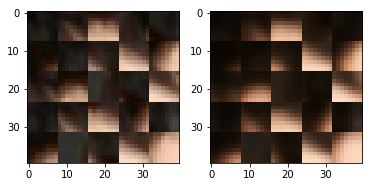

EPO: 27, recon_loss: 0.0025, total_loss: 0.0051
EPO: 27, recon_loss: 0.0054, total_loss: 0.0103
EPO: 27, recon_loss: 0.0024, total_loss: 0.0097
EPO: 27, recon_loss: 0.0018, total_loss: 0.0059
EPO: 27, recon_loss: 0.0027, total_loss: 0.0080
EPO: 27, recon_loss: 0.0023, total_loss: 0.0049
EPO: 27, recon_loss: 0.0032, total_loss: 0.0072
EPO: 27, recon_loss: 0.0032, total_loss: 0.0083
EPO: 27, recon_loss: 0.0036, total_loss: 0.0090
EPO: 27, recon_loss: 0.0035, total_loss: 0.0082
######### what? the reconstruction psnr is: 30.9948


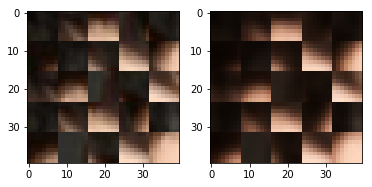

EPO: 27, recon_loss: 0.0033, total_loss: 0.0081
EPO: 27, recon_loss: 0.0027, total_loss: 0.0062
EPO: 27, recon_loss: 0.0033, total_loss: 0.0064
EPO: 27, recon_loss: 0.0021, total_loss: 0.0052
EPO: 27, recon_loss: 0.0036, total_loss: 0.0078
EPO: 27, recon_loss: 0.0066, total_loss: 0.0110
EPO: 27, recon_loss: 0.0022, total_loss: 0.0047
EPO: 27, recon_loss: 0.0047, total_loss: 0.0095
EPO: 27, recon_loss: 0.0037, total_loss: 0.0100
EPO: 27, recon_loss: 0.0037, total_loss: 0.0099
######### what? the reconstruction psnr is: 30.4276


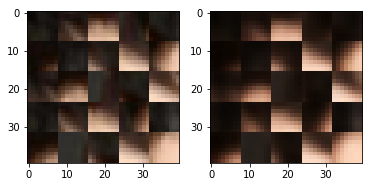

EPO: 27, recon_loss: 0.0076, total_loss: 0.0146
EPO: 27, recon_loss: 0.0071, total_loss: 0.0149
EPO: 27, recon_loss: 0.0073, total_loss: 0.0125
EPO: 27, recon_loss: 0.0032, total_loss: 0.0096
EPO: 27, recon_loss: 0.0027, total_loss: 0.0086
EPO: 27, recon_loss: 0.0048, total_loss: 0.0090
EPO: 27, recon_loss: 0.0035, total_loss: 0.0064
EPO: 27, recon_loss: 0.0042, total_loss: 0.0091
EPO: 27, recon_loss: 0.0011, total_loss: 0.0027
EPO: 27, recon_loss: 0.0026, total_loss: 0.0065
######### what? the reconstruction psnr is: 30.5443


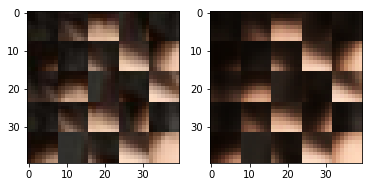

EPO: 27, recon_loss: 0.0049, total_loss: 0.0089
EPO: 27, recon_loss: 0.0032, total_loss: 0.0075
EPO: 27, recon_loss: 0.0054, total_loss: 0.0120
EPO: 27, recon_loss: 0.0015, total_loss: 0.0079
EPO: 27, recon_loss: 0.0016, total_loss: 0.0075
EPO: 27, recon_loss: 0.0054, total_loss: 0.0107
EPO: 27, recon_loss: 0.0012, total_loss: 0.0049
EPO: 27, recon_loss: 0.0051, total_loss: 0.0108
EPO: 27, recon_loss: 0.0073, total_loss: 0.0200
EPO: 27, recon_loss: 0.0026, total_loss: 0.0077
######### what? the reconstruction psnr is: 30.9628


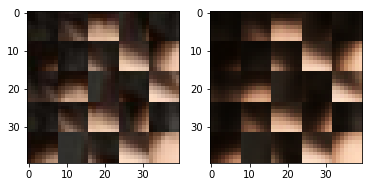

EPO: 27, recon_loss: 0.0074, total_loss: 0.0130
EPO: 27, recon_loss: 0.0023, total_loss: 0.0052
EPO: 27, recon_loss: 0.0037, total_loss: 0.0072
EPO: 27, recon_loss: 0.0057, total_loss: 0.0117
EPO: 27, recon_loss: 0.0022, total_loss: 0.0057
EPO: 27, recon_loss: 0.0055, total_loss: 0.0111
EPO: 27, recon_loss: 0.0033, total_loss: 0.0065
EPO: 27, recon_loss: 0.0058, total_loss: 0.0120
EPO: 27, recon_loss: 0.0087, total_loss: 0.0167
EPO: 27, recon_loss: 0.0088, total_loss: 0.0175
######### what? the reconstruction psnr is: 30.3501


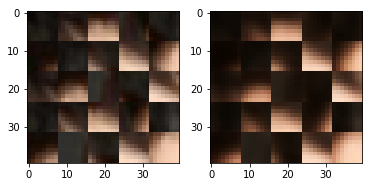

EPO: 27, recon_loss: 0.0176, total_loss: 0.0281
EPO: 27, recon_loss: 0.0102, total_loss: 0.0192
EPO: 27, recon_loss: 0.0077, total_loss: 0.0154
EPO: 27, recon_loss: 0.0029, total_loss: 0.0090
EPO: 27, recon_loss: 0.0035, total_loss: 0.0088
EPO: 27, recon_loss: 0.0050, total_loss: 0.0112
EPO: 27, recon_loss: 0.0041, total_loss: 0.0088
EPO: 27, recon_loss: 0.0058, total_loss: 0.0129
EPO: 27, recon_loss: 0.0031, total_loss: 0.0105
EPO: 27, recon_loss: 0.0015, total_loss: 0.0070
######### what? the reconstruction psnr is: 30.7005


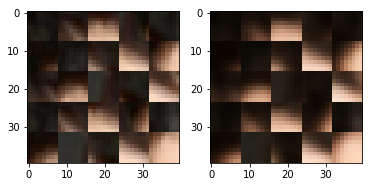

EPO: 27, recon_loss: 0.0073, total_loss: 0.0131
EPO: 27, recon_loss: 0.0031, total_loss: 0.0090
EPO: 27, recon_loss: 0.0035, total_loss: 0.0089
EPO: 27, recon_loss: 0.0074, total_loss: 0.0180
EPO: 27, recon_loss: 0.0059, total_loss: 0.0189
EPO: 27, recon_loss: 0.0128, total_loss: 0.0253
EPO: 27, recon_loss: 0.0071, total_loss: 0.0184
EPO: 27, recon_loss: 0.0058, total_loss: 0.0161
EPO: 27, recon_loss: 0.0100, total_loss: 0.0208
EPO: 27, recon_loss: 0.0059, total_loss: 0.0168
######### what? the reconstruction psnr is: 30.9985


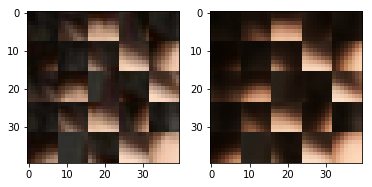

EPO: 27, recon_loss: 0.0145, total_loss: 0.0285
EPO: 27, recon_loss: 0.0101, total_loss: 0.0222
EPO: 27, recon_loss: 0.0086, total_loss: 0.0215
EPO: 27, recon_loss: 0.0032, total_loss: 0.0131
EPO: 27, recon_loss: 0.0030, total_loss: 0.0133
EPO: 27, recon_loss: 0.0147, total_loss: 0.0249
EPO: 27, recon_loss: 0.0159, total_loss: 0.0225
EPO: 27, recon_loss: 0.0026, total_loss: 0.0060
EPO: 27, recon_loss: 0.0035, total_loss: 0.0074
EPO: 27, recon_loss: 0.0022, total_loss: 0.0076
######### what? the reconstruction psnr is: 30.8006


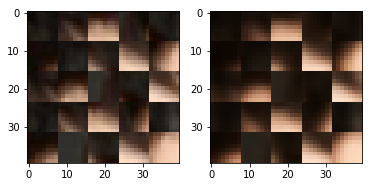

EPO: 27, recon_loss: 0.0045, total_loss: 0.0109
EPO: 27, recon_loss: 0.0050, total_loss: 0.0115
EPO: 27, recon_loss: 0.0043, total_loss: 0.0124
EPO: 27, recon_loss: 0.0094, total_loss: 0.0183
EPO: 27, recon_loss: 0.0005, total_loss: 0.0024
EPO: 27, recon_loss: 0.0008, total_loss: 0.0030
EPO: 27, recon_loss: 0.0015, total_loss: 0.0031
EPO: 27, recon_loss: 0.0009, total_loss: 0.0024
EPO: 27, recon_loss: 0.0030, total_loss: 0.0061
EPO: 27, recon_loss: 0.0025, total_loss: 0.0070
######### what? the reconstruction psnr is: 31.0954


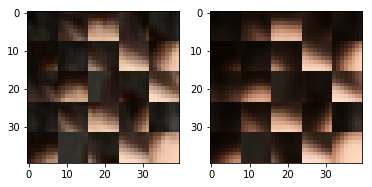

EPO: 27, recon_loss: 0.0038, total_loss: 0.0090
EPO: 27, recon_loss: 0.0061, total_loss: 0.0116
EPO: 27, recon_loss: 0.0026, total_loss: 0.0054
EPO: 27, recon_loss: 0.0066, total_loss: 0.0107
EPO: 27, recon_loss: 0.0060, total_loss: 0.0152
EPO: 27, recon_loss: 0.0085, total_loss: 0.0183
EPO: 27, recon_loss: 0.0065, total_loss: 0.0161
EPO: 27, recon_loss: 0.0047, total_loss: 0.0109
EPO: 27, recon_loss: 0.0065, total_loss: 0.0123
EPO: 27, recon_loss: 0.0040, total_loss: 0.0094
######### what? the reconstruction psnr is: 30.3844


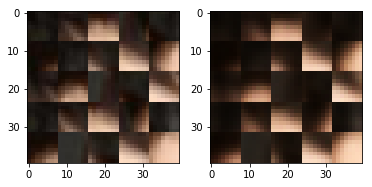

EPO: 27, recon_loss: 0.0032, total_loss: 0.0068
EPO: 27, recon_loss: 0.0051, total_loss: 0.0101
EPO: 27, recon_loss: 0.0032, total_loss: 0.0069
EPO: 27, recon_loss: 0.0043, total_loss: 0.0090
EPO: 27, recon_loss: 0.0031, total_loss: 0.0121
EPO: 27, recon_loss: 0.0018, total_loss: 0.0054
EPO: 27, recon_loss: 0.0058, total_loss: 0.0117
EPO: 27, recon_loss: 0.0045, total_loss: 0.0091
EPO: 27, recon_loss: 0.0054, total_loss: 0.0125
EPO: 27, recon_loss: 0.0015, total_loss: 0.0039
######### what? the reconstruction psnr is: 30.4610


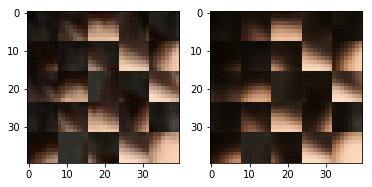

EPO: 27, recon_loss: 0.0014, total_loss: 0.0039
EPO: 27, recon_loss: 0.0027, total_loss: 0.0064
EPO: 27, recon_loss: 0.0009, total_loss: 0.0033
EPO: 27, recon_loss: 0.0015, total_loss: 0.0036
EPO: 27, recon_loss: 0.0031, total_loss: 0.0076
EPO: 27, recon_loss: 0.0021, total_loss: 0.0059
EPO: 27, recon_loss: 0.0084, total_loss: 0.0150
EPO: 27, recon_loss: 0.0039, total_loss: 0.0096
EPO: 27, recon_loss: 0.0027, total_loss: 0.0063
EPO: 27, recon_loss: 0.0026, total_loss: 0.0099
######### what? the reconstruction psnr is: 30.6214


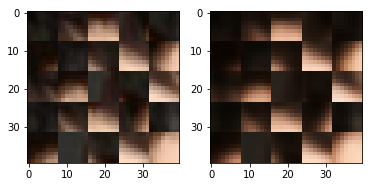

EPO: 27, recon_loss: 0.0029, total_loss: 0.0093
EPO: 27, recon_loss: 0.0117, total_loss: 0.0208
EPO: 27, recon_loss: 0.0036, total_loss: 0.0088
EPO: 27, recon_loss: 0.0085, total_loss: 0.0158
EPO: 27, recon_loss: 0.0012, total_loss: 0.0061
EPO: 27, recon_loss: 0.0005, total_loss: 0.0033
EPO: 27, recon_loss: 0.0072, total_loss: 0.0136
EPO: 27, recon_loss: 0.0044, total_loss: 0.0080
EPO: 27, recon_loss: 0.0045, total_loss: 0.0089
EPO: 27, recon_loss: 0.0050, total_loss: 0.0105
######### what? the reconstruction psnr is: 30.7855


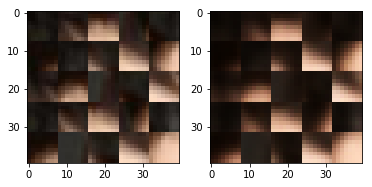

EPO: 27, recon_loss: 0.0063, total_loss: 0.0134
EPO: 27, recon_loss: 0.0067, total_loss: 0.0129
EPO: 27, recon_loss: 0.0030, total_loss: 0.0077
EPO: 27, recon_loss: 0.0020, total_loss: 0.0054
EPO: 27, recon_loss: 0.0032, total_loss: 0.0085
EPO: 27, recon_loss: 0.0013, total_loss: 0.0048
EPO: 27, recon_loss: 0.0073, total_loss: 0.0148
EPO: 27, recon_loss: 0.0021, total_loss: 0.0061
EPO: 27, recon_loss: 0.0027, total_loss: 0.0068
EPO: 27, recon_loss: 0.0051, total_loss: 0.0109
######### what? the reconstruction psnr is: 30.7177


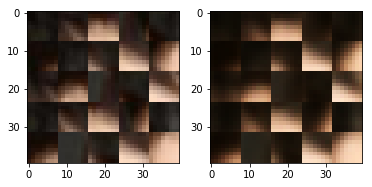

EPO: 27, recon_loss: 0.0035, total_loss: 0.0091
EPO: 27, recon_loss: 0.0038, total_loss: 0.0095
EPO: 27, recon_loss: 0.0060, total_loss: 0.0113
EPO: 27, recon_loss: 0.0049, total_loss: 0.0119
EPO: 27, recon_loss: 0.0055, total_loss: 0.0184
EPO: 27, recon_loss: 0.0031, total_loss: 0.0071
EPO: 27, recon_loss: 0.0023, total_loss: 0.0062
EPO: 27, recon_loss: 0.0026, total_loss: 0.0060
EPO: 27, recon_loss: 0.0047, total_loss: 0.0102
EPO: 27, recon_loss: 0.0043, total_loss: 0.0102
######### what? the reconstruction psnr is: 31.0347


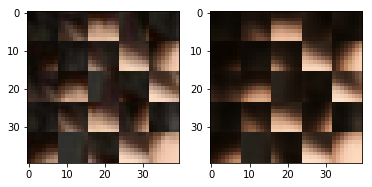

EPO: 27, recon_loss: 0.0024, total_loss: 0.0072
EPO: 27, recon_loss: 0.0060, total_loss: 0.0124
EPO: 27, recon_loss: 0.0086, total_loss: 0.0164
EPO: 27, recon_loss: 0.0041, total_loss: 0.0118
EPO: 27, recon_loss: 0.0089, total_loss: 0.0177
EPO: 27, recon_loss: 0.0021, total_loss: 0.0070
EPO: 27, recon_loss: 0.0025, total_loss: 0.0080
EPO: 27, recon_loss: 0.0056, total_loss: 0.0128
EPO: 27, recon_loss: 0.0037, total_loss: 0.0093
EPO: 27, recon_loss: 0.0074, total_loss: 0.0142
######### what? the reconstruction psnr is: 30.8620


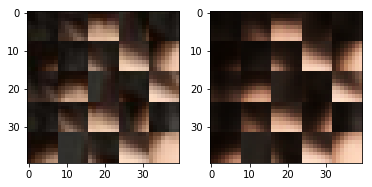

EPO: 27, recon_loss: 0.0021, total_loss: 0.0036
EPO: 27, recon_loss: 0.0017, total_loss: 0.0035
EPO: 27, recon_loss: 0.0050, total_loss: 0.0101
EPO: 27, recon_loss: 0.0018, total_loss: 0.0059
EPO: 27, recon_loss: 0.0035, total_loss: 0.0083
EPO: 27, recon_loss: 0.0116, total_loss: 0.0235
EPO: 27, recon_loss: 0.0061, total_loss: 0.0174
EPO: 27, recon_loss: 0.0149, total_loss: 0.0290
EPO: 27, recon_loss: 0.0067, total_loss: 0.0191
EPO: 27, recon_loss: 0.0103, total_loss: 0.0263
######### what? the reconstruction psnr is: 30.5758


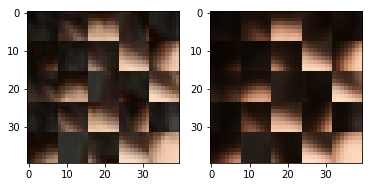

EPO: 27, recon_loss: 0.0024, total_loss: 0.0102
EPO: 27, recon_loss: 0.0044, total_loss: 0.0089
EPO: 27, recon_loss: 0.0052, total_loss: 0.0158
EPO: 27, recon_loss: 0.0034, total_loss: 0.0101
EPO: 27, recon_loss: 0.0039, total_loss: 0.0104
EPO: 27, recon_loss: 0.0040, total_loss: 0.0150
EPO: 27, recon_loss: 0.0042, total_loss: 0.0117
EPO: 27, recon_loss: 0.0117, total_loss: 0.0210
EPO: 27, recon_loss: 0.0024, total_loss: 0.0083
EPO: 27, recon_loss: 0.0024, total_loss: 0.0087
######### what? the reconstruction psnr is: 31.1177


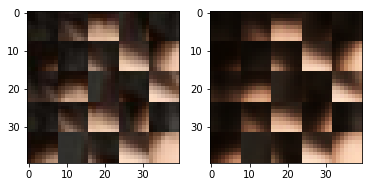

EPO: 27, recon_loss: 0.0038, total_loss: 0.0109
EPO: 27, recon_loss: 0.0015, total_loss: 0.0078
EPO: 27, recon_loss: 0.0103, total_loss: 0.0183
EPO: 27, recon_loss: 0.0021, total_loss: 0.0075
EPO: 27, recon_loss: 0.0036, total_loss: 0.0102
EPO: 27, recon_loss: 0.0031, total_loss: 0.0073
EPO: 27, recon_loss: 0.0027, total_loss: 0.0093
EPO: 27, recon_loss: 0.0121, total_loss: 0.0192
EPO: 27, recon_loss: 0.0035, total_loss: 0.0103
EPO: 27, recon_loss: 0.0037, total_loss: 0.0087
######### what? the reconstruction psnr is: 31.0103


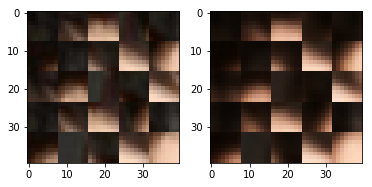

EPO: 27, recon_loss: 0.0037, total_loss: 0.0136
EPO: 27, recon_loss: 0.0015, total_loss: 0.0063
EPO: 27, recon_loss: 0.0091, total_loss: 0.0184
EPO: 27, recon_loss: 0.0021, total_loss: 0.0048
EPO: 27, recon_loss: 0.0048, total_loss: 0.0106
EPO: 27, recon_loss: 0.0028, total_loss: 0.0102
EPO: 27, recon_loss: 0.0017, total_loss: 0.0067
EPO: 27, recon_loss: 0.0040, total_loss: 0.0106
EPO: 27, recon_loss: 0.0014, total_loss: 0.0050
EPO: 27, recon_loss: 0.0032, total_loss: 0.0078
######### what? the reconstruction psnr is: 30.9996


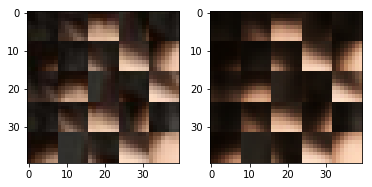

EPO: 27, recon_loss: 0.0107, total_loss: 0.0231
EPO: 27, recon_loss: 0.0086, total_loss: 0.0195
EPO: 27, recon_loss: 0.0043, total_loss: 0.0104
EPO: 27, recon_loss: 0.0048, total_loss: 0.0125
EPO: 27, recon_loss: 0.0044, total_loss: 0.0097
EPO: 27, recon_loss: 0.0069, total_loss: 0.0189
EPO: 27, recon_loss: 0.0030, total_loss: 0.0118
EPO: 27, recon_loss: 0.0035, total_loss: 0.0099
EPO: 27, recon_loss: 0.0044, total_loss: 0.0108
EPO: 27, recon_loss: 0.0054, total_loss: 0.0129
######### what? the reconstruction psnr is: 30.8461


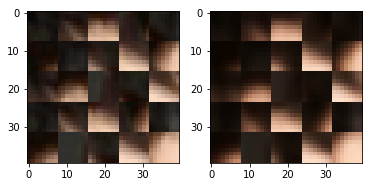

EPO: 27, recon_loss: 0.0027, total_loss: 0.0077
EPO: 27, recon_loss: 0.0008, total_loss: 0.0022
EPO: 27, recon_loss: 0.0024, total_loss: 0.0058
EPO: 27, recon_loss: 0.0022, total_loss: 0.0042
EPO: 27, recon_loss: 0.0016, total_loss: 0.0035
EPO: 27, recon_loss: 0.0039, total_loss: 0.0073
EPO: 27, recon_loss: 0.0035, total_loss: 0.0088
EPO: 27, recon_loss: 0.0044, total_loss: 0.0102
EPO: 27, recon_loss: 0.0035, total_loss: 0.0084
EPO: 27, recon_loss: 0.0028, total_loss: 0.0062
######### what? the reconstruction psnr is: 30.5015


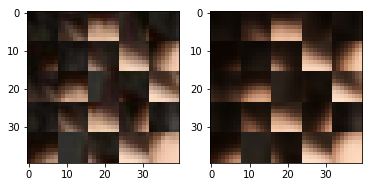

EPO: 27, recon_loss: 0.0045, total_loss: 0.0090
EPO: 27, recon_loss: 0.0041, total_loss: 0.0101
EPO: 27, recon_loss: 0.0057, total_loss: 0.0129
EPO: 27, recon_loss: 0.0070, total_loss: 0.0115
EPO: 27, recon_loss: 0.0052, total_loss: 0.0103
EPO: 27, recon_loss: 0.0091, total_loss: 0.0143
EPO: 27, recon_loss: 0.0106, total_loss: 0.0217
EPO: 27, recon_loss: 0.0080, total_loss: 0.0135
EPO: 27, recon_loss: 0.0073, total_loss: 0.0124
EPO: 27, recon_loss: 0.0055, total_loss: 0.0095
######### what? the reconstruction psnr is: 28.4666


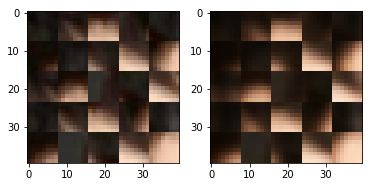

EPO: 27, recon_loss: 0.0114, total_loss: 0.0160
EPO: 27, recon_loss: 0.0013, total_loss: 0.0053
EPO: 27, recon_loss: 0.0021, total_loss: 0.0068
EPO: 27, recon_loss: 0.0061, total_loss: 0.0103
EPO: 27, recon_loss: 0.0044, total_loss: 0.0110
EPO: 27, recon_loss: 0.0095, total_loss: 0.0166
EPO: 27, recon_loss: 0.0028, total_loss: 0.0112
EPO: 27, recon_loss: 0.0022, total_loss: 0.0062
EPO: 27, recon_loss: 0.0046, total_loss: 0.0093
EPO: 27, recon_loss: 0.0009, total_loss: 0.0026
######### what? the reconstruction psnr is: 30.5879


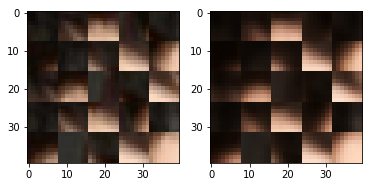

EPO: 27, recon_loss: 0.0023, total_loss: 0.0046
EPO: 27, recon_loss: 0.0053, total_loss: 0.0114
EPO: 27, recon_loss: 0.0064, total_loss: 0.0126
EPO: 27, recon_loss: 0.0191, total_loss: 0.0262
EPO: 27, recon_loss: 0.0107, total_loss: 0.0167
EPO: 27, recon_loss: 0.0076, total_loss: 0.0117
EPO: 28, recon_loss: 0.0022, total_loss: 0.0047
EPO: 28, recon_loss: 0.0018, total_loss: 0.0038
EPO: 28, recon_loss: 0.0084, total_loss: 0.0118
EPO: 28, recon_loss: 0.0016, total_loss: 0.0045
######### what? the reconstruction psnr is: 30.7861


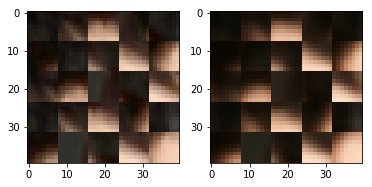

EPO: 28, recon_loss: 0.0038, total_loss: 0.0072
EPO: 28, recon_loss: 0.0027, total_loss: 0.0100
EPO: 28, recon_loss: 0.0020, total_loss: 0.0076
EPO: 28, recon_loss: 0.0045, total_loss: 0.0090
EPO: 28, recon_loss: 0.0024, total_loss: 0.0054
EPO: 28, recon_loss: 0.0052, total_loss: 0.0108
EPO: 28, recon_loss: 0.0022, total_loss: 0.0090
EPO: 28, recon_loss: 0.0011, total_loss: 0.0040
EPO: 28, recon_loss: 0.0031, total_loss: 0.0083
EPO: 28, recon_loss: 0.0019, total_loss: 0.0038
######### what? the reconstruction psnr is: 31.0161


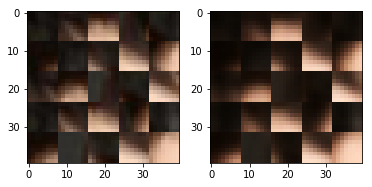

EPO: 28, recon_loss: 0.0036, total_loss: 0.0081
EPO: 28, recon_loss: 0.0032, total_loss: 0.0090
EPO: 28, recon_loss: 0.0029, total_loss: 0.0075
EPO: 28, recon_loss: 0.0037, total_loss: 0.0084
EPO: 28, recon_loss: 0.0028, total_loss: 0.0076
EPO: 28, recon_loss: 0.0024, total_loss: 0.0059
EPO: 28, recon_loss: 0.0038, total_loss: 0.0067
EPO: 28, recon_loss: 0.0020, total_loss: 0.0052
EPO: 28, recon_loss: 0.0053, total_loss: 0.0098
EPO: 28, recon_loss: 0.0031, total_loss: 0.0063
######### what? the reconstruction psnr is: 30.8828


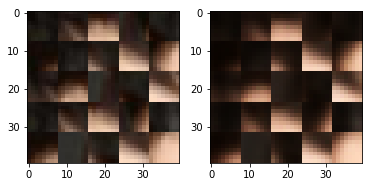

EPO: 28, recon_loss: 0.0033, total_loss: 0.0061
EPO: 28, recon_loss: 0.0088, total_loss: 0.0200
EPO: 28, recon_loss: 0.0032, total_loss: 0.0091
EPO: 28, recon_loss: 0.0046, total_loss: 0.0118
EPO: 28, recon_loss: 0.0077, total_loss: 0.0161
EPO: 28, recon_loss: 0.0045, total_loss: 0.0098
EPO: 28, recon_loss: 0.0035, total_loss: 0.0103
EPO: 28, recon_loss: 0.0023, total_loss: 0.0075
EPO: 28, recon_loss: 0.0036, total_loss: 0.0097
EPO: 28, recon_loss: 0.0030, total_loss: 0.0057
######### what? the reconstruction psnr is: 30.2991


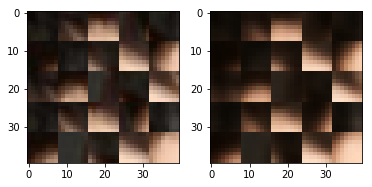

EPO: 28, recon_loss: 0.0036, total_loss: 0.0069
EPO: 28, recon_loss: 0.0014, total_loss: 0.0038
EPO: 28, recon_loss: 0.0017, total_loss: 0.0041
EPO: 28, recon_loss: 0.0020, total_loss: 0.0052
EPO: 28, recon_loss: 0.0048, total_loss: 0.0083
EPO: 28, recon_loss: 0.0037, total_loss: 0.0088
EPO: 28, recon_loss: 0.0053, total_loss: 0.0133
EPO: 28, recon_loss: 0.0016, total_loss: 0.0077
EPO: 28, recon_loss: 0.0019, total_loss: 0.0075
EPO: 28, recon_loss: 0.0038, total_loss: 0.0081
######### what? the reconstruction psnr is: 30.5621


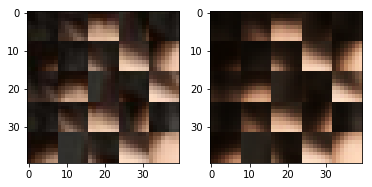

EPO: 28, recon_loss: 0.0015, total_loss: 0.0051
EPO: 28, recon_loss: 0.0057, total_loss: 0.0129
EPO: 28, recon_loss: 0.0073, total_loss: 0.0188
EPO: 28, recon_loss: 0.0034, total_loss: 0.0093
EPO: 28, recon_loss: 0.0067, total_loss: 0.0115
EPO: 28, recon_loss: 0.0024, total_loss: 0.0054
EPO: 28, recon_loss: 0.0050, total_loss: 0.0089
EPO: 28, recon_loss: 0.0039, total_loss: 0.0087
EPO: 28, recon_loss: 0.0033, total_loss: 0.0081
EPO: 28, recon_loss: 0.0056, total_loss: 0.0117
######### what? the reconstruction psnr is: 30.7124


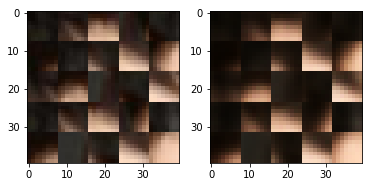

EPO: 28, recon_loss: 0.0045, total_loss: 0.0090
EPO: 28, recon_loss: 0.0080, total_loss: 0.0138
EPO: 28, recon_loss: 0.0083, total_loss: 0.0162
EPO: 28, recon_loss: 0.0097, total_loss: 0.0185
EPO: 28, recon_loss: 0.0199, total_loss: 0.0300
EPO: 28, recon_loss: 0.0094, total_loss: 0.0178
EPO: 28, recon_loss: 0.0085, total_loss: 0.0166
EPO: 28, recon_loss: 0.0040, total_loss: 0.0088
EPO: 28, recon_loss: 0.0036, total_loss: 0.0092
EPO: 28, recon_loss: 0.0051, total_loss: 0.0102
######### what? the reconstruction psnr is: 30.9360


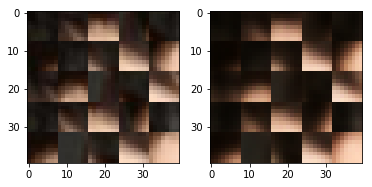

EPO: 28, recon_loss: 0.0052, total_loss: 0.0111
EPO: 28, recon_loss: 0.0073, total_loss: 0.0144
EPO: 28, recon_loss: 0.0024, total_loss: 0.0087
EPO: 28, recon_loss: 0.0024, total_loss: 0.0080
EPO: 28, recon_loss: 0.0086, total_loss: 0.0152
EPO: 28, recon_loss: 0.0025, total_loss: 0.0085
EPO: 28, recon_loss: 0.0034, total_loss: 0.0085
EPO: 28, recon_loss: 0.0072, total_loss: 0.0195
EPO: 28, recon_loss: 0.0054, total_loss: 0.0163
EPO: 28, recon_loss: 0.0167, total_loss: 0.0311
######### what? the reconstruction psnr is: 30.7913


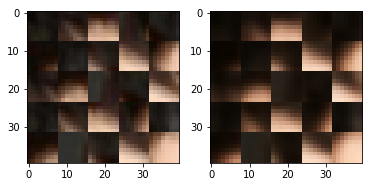

EPO: 28, recon_loss: 0.0049, total_loss: 0.0155
EPO: 28, recon_loss: 0.0060, total_loss: 0.0179
EPO: 28, recon_loss: 0.0098, total_loss: 0.0202
EPO: 28, recon_loss: 0.0053, total_loss: 0.0177
EPO: 28, recon_loss: 0.0158, total_loss: 0.0294
EPO: 28, recon_loss: 0.0078, total_loss: 0.0205
EPO: 28, recon_loss: 0.0083, total_loss: 0.0205
EPO: 28, recon_loss: 0.0033, total_loss: 0.0139
EPO: 28, recon_loss: 0.0031, total_loss: 0.0122
EPO: 28, recon_loss: 0.0186, total_loss: 0.0294
######### what? the reconstruction psnr is: 30.3677


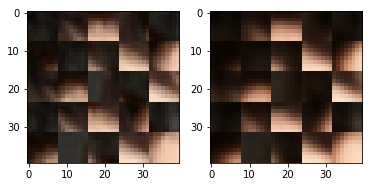

EPO: 28, recon_loss: 0.0184, total_loss: 0.0252
EPO: 28, recon_loss: 0.0028, total_loss: 0.0070
EPO: 28, recon_loss: 0.0027, total_loss: 0.0069
EPO: 28, recon_loss: 0.0023, total_loss: 0.0080
EPO: 28, recon_loss: 0.0071, total_loss: 0.0137
EPO: 28, recon_loss: 0.0037, total_loss: 0.0106
EPO: 28, recon_loss: 0.0047, total_loss: 0.0119
EPO: 28, recon_loss: 0.0019, total_loss: 0.0061
EPO: 28, recon_loss: 0.0005, total_loss: 0.0023
EPO: 28, recon_loss: 0.0008, total_loss: 0.0030
######### what? the reconstruction psnr is: 31.0214


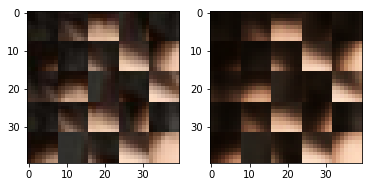

EPO: 28, recon_loss: 0.0009, total_loss: 0.0021
EPO: 28, recon_loss: 0.0010, total_loss: 0.0026
EPO: 28, recon_loss: 0.0054, total_loss: 0.0168
EPO: 28, recon_loss: 0.0025, total_loss: 0.0072
EPO: 28, recon_loss: 0.0040, total_loss: 0.0097
EPO: 28, recon_loss: 0.0043, total_loss: 0.0083
EPO: 28, recon_loss: 0.0035, total_loss: 0.0063
EPO: 28, recon_loss: 0.0074, total_loss: 0.0170
EPO: 28, recon_loss: 0.0058, total_loss: 0.0140
EPO: 28, recon_loss: 0.0082, total_loss: 0.0172
######### what? the reconstruction psnr is: 30.6469


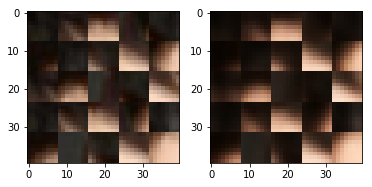

EPO: 28, recon_loss: 0.0063, total_loss: 0.0159
EPO: 28, recon_loss: 0.0036, total_loss: 0.0089
EPO: 28, recon_loss: 0.0049, total_loss: 0.0105
EPO: 28, recon_loss: 0.0034, total_loss: 0.0074
EPO: 28, recon_loss: 0.0035, total_loss: 0.0073
EPO: 28, recon_loss: 0.0037, total_loss: 0.0081
EPO: 28, recon_loss: 0.0030, total_loss: 0.0066
EPO: 28, recon_loss: 0.0042, total_loss: 0.0096
EPO: 28, recon_loss: 0.0028, total_loss: 0.0095
EPO: 28, recon_loss: 0.0027, total_loss: 0.0076
######### what? the reconstruction psnr is: 30.3784


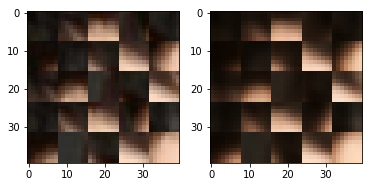

EPO: 28, recon_loss: 0.0066, total_loss: 0.0123
EPO: 28, recon_loss: 0.0066, total_loss: 0.0122
EPO: 28, recon_loss: 0.0040, total_loss: 0.0097
EPO: 28, recon_loss: 0.0012, total_loss: 0.0036
EPO: 28, recon_loss: 0.0018, total_loss: 0.0043
EPO: 28, recon_loss: 0.0026, total_loss: 0.0067
EPO: 28, recon_loss: 0.0013, total_loss: 0.0034
EPO: 28, recon_loss: 0.0022, total_loss: 0.0048
EPO: 28, recon_loss: 0.0026, total_loss: 0.0067
EPO: 28, recon_loss: 0.0033, total_loss: 0.0077
######### what? the reconstruction psnr is: 30.8600


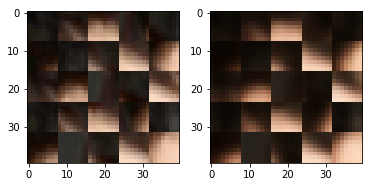

EPO: 28, recon_loss: 0.0067, total_loss: 0.0126
EPO: 28, recon_loss: 0.0037, total_loss: 0.0090
EPO: 28, recon_loss: 0.0027, total_loss: 0.0060
EPO: 28, recon_loss: 0.0021, total_loss: 0.0083
EPO: 28, recon_loss: 0.0027, total_loss: 0.0091
EPO: 28, recon_loss: 0.0112, total_loss: 0.0195
EPO: 28, recon_loss: 0.0030, total_loss: 0.0082
EPO: 28, recon_loss: 0.0121, total_loss: 0.0221
EPO: 28, recon_loss: 0.0009, total_loss: 0.0047
EPO: 28, recon_loss: 0.0006, total_loss: 0.0036
######### what? the reconstruction psnr is: 29.7419


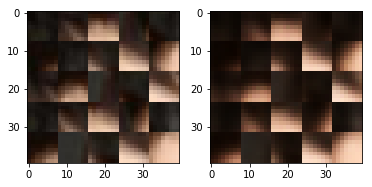

EPO: 28, recon_loss: 0.0098, total_loss: 0.0162
EPO: 28, recon_loss: 0.0032, total_loss: 0.0066
EPO: 28, recon_loss: 0.0040, total_loss: 0.0081
EPO: 28, recon_loss: 0.0046, total_loss: 0.0101
EPO: 28, recon_loss: 0.0056, total_loss: 0.0119
EPO: 28, recon_loss: 0.0083, total_loss: 0.0152
EPO: 28, recon_loss: 0.0021, total_loss: 0.0062
EPO: 28, recon_loss: 0.0033, total_loss: 0.0070
EPO: 28, recon_loss: 0.0022, total_loss: 0.0065
EPO: 28, recon_loss: 0.0015, total_loss: 0.0047
######### what? the reconstruction psnr is: 30.8827


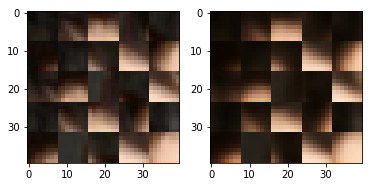

EPO: 28, recon_loss: 0.0063, total_loss: 0.0135
EPO: 28, recon_loss: 0.0015, total_loss: 0.0052
EPO: 28, recon_loss: 0.0024, total_loss: 0.0067
EPO: 28, recon_loss: 0.0053, total_loss: 0.0122
EPO: 28, recon_loss: 0.0031, total_loss: 0.0090
EPO: 28, recon_loss: 0.0054, total_loss: 0.0110
EPO: 28, recon_loss: 0.0038, total_loss: 0.0095
EPO: 28, recon_loss: 0.0049, total_loss: 0.0111
EPO: 28, recon_loss: 0.0066, total_loss: 0.0183
EPO: 28, recon_loss: 0.0017, total_loss: 0.0048
######### what? the reconstruction psnr is: 31.0747


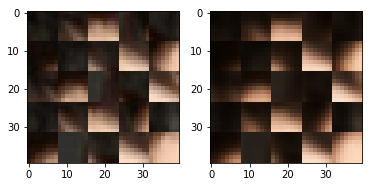

EPO: 28, recon_loss: 0.0037, total_loss: 0.0077
EPO: 28, recon_loss: 0.0028, total_loss: 0.0068
EPO: 28, recon_loss: 0.0034, total_loss: 0.0077
EPO: 28, recon_loss: 0.0036, total_loss: 0.0098
EPO: 28, recon_loss: 0.0023, total_loss: 0.0067
EPO: 28, recon_loss: 0.0063, total_loss: 0.0125
EPO: 28, recon_loss: 0.0067, total_loss: 0.0133
EPO: 28, recon_loss: 0.0050, total_loss: 0.0129
EPO: 28, recon_loss: 0.0057, total_loss: 0.0150
EPO: 28, recon_loss: 0.0024, total_loss: 0.0077
######### what? the reconstruction psnr is: 30.9733


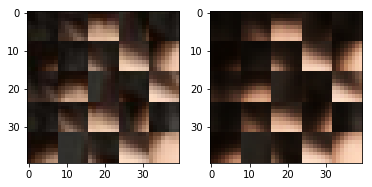

EPO: 28, recon_loss: 0.0027, total_loss: 0.0086
EPO: 28, recon_loss: 0.0050, total_loss: 0.0110
EPO: 28, recon_loss: 0.0042, total_loss: 0.0102
EPO: 28, recon_loss: 0.0032, total_loss: 0.0060
EPO: 28, recon_loss: 0.0020, total_loss: 0.0037
EPO: 28, recon_loss: 0.0015, total_loss: 0.0034
EPO: 28, recon_loss: 0.0032, total_loss: 0.0075
EPO: 28, recon_loss: 0.0023, total_loss: 0.0067
EPO: 28, recon_loss: 0.0042, total_loss: 0.0092
EPO: 28, recon_loss: 0.0091, total_loss: 0.0213
######### what? the reconstruction psnr is: 31.0677


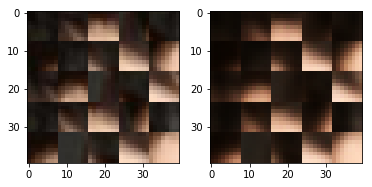

EPO: 28, recon_loss: 0.0053, total_loss: 0.0152
EPO: 28, recon_loss: 0.0115, total_loss: 0.0249
EPO: 28, recon_loss: 0.0078, total_loss: 0.0220
EPO: 28, recon_loss: 0.0096, total_loss: 0.0249
EPO: 28, recon_loss: 0.0023, total_loss: 0.0085
EPO: 28, recon_loss: 0.0081, total_loss: 0.0149
EPO: 28, recon_loss: 0.0043, total_loss: 0.0139
EPO: 28, recon_loss: 0.0035, total_loss: 0.0102
EPO: 28, recon_loss: 0.0043, total_loss: 0.0120
EPO: 28, recon_loss: 0.0042, total_loss: 0.0137
######### what? the reconstruction psnr is: 31.3545


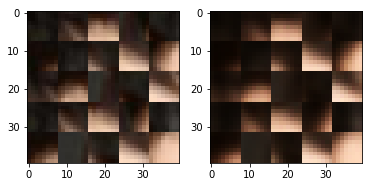

EPO: 28, recon_loss: 0.0052, total_loss: 0.0130
EPO: 28, recon_loss: 0.0086, total_loss: 0.0176
EPO: 28, recon_loss: 0.0032, total_loss: 0.0097
EPO: 28, recon_loss: 0.0037, total_loss: 0.0102
EPO: 28, recon_loss: 0.0030, total_loss: 0.0085
EPO: 28, recon_loss: 0.0020, total_loss: 0.0083
EPO: 28, recon_loss: 0.0087, total_loss: 0.0156
EPO: 28, recon_loss: 0.0022, total_loss: 0.0077
EPO: 28, recon_loss: 0.0036, total_loss: 0.0103
EPO: 28, recon_loss: 0.0025, total_loss: 0.0070
######### what? the reconstruction psnr is: 30.8401


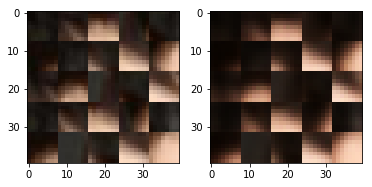

EPO: 28, recon_loss: 0.0032, total_loss: 0.0104
EPO: 28, recon_loss: 0.0107, total_loss: 0.0170
EPO: 28, recon_loss: 0.0037, total_loss: 0.0107
EPO: 28, recon_loss: 0.0055, total_loss: 0.0110
EPO: 28, recon_loss: 0.0023, total_loss: 0.0088
EPO: 28, recon_loss: 0.0019, total_loss: 0.0070
EPO: 28, recon_loss: 0.0080, total_loss: 0.0154
EPO: 28, recon_loss: 0.0024, total_loss: 0.0053
EPO: 28, recon_loss: 0.0055, total_loss: 0.0113
EPO: 28, recon_loss: 0.0023, total_loss: 0.0088
######### what? the reconstruction psnr is: 31.1762


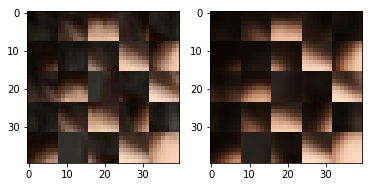

EPO: 28, recon_loss: 0.0015, total_loss: 0.0061
EPO: 28, recon_loss: 0.0037, total_loss: 0.0088
EPO: 28, recon_loss: 0.0016, total_loss: 0.0055
EPO: 28, recon_loss: 0.0030, total_loss: 0.0071
EPO: 28, recon_loss: 0.0091, total_loss: 0.0212
EPO: 28, recon_loss: 0.0083, total_loss: 0.0183
EPO: 28, recon_loss: 0.0044, total_loss: 0.0098
EPO: 28, recon_loss: 0.0046, total_loss: 0.0120
EPO: 28, recon_loss: 0.0036, total_loss: 0.0081
EPO: 28, recon_loss: 0.0063, total_loss: 0.0183
######### what? the reconstruction psnr is: 31.0223


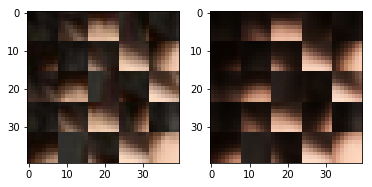

EPO: 28, recon_loss: 0.0026, total_loss: 0.0108
EPO: 28, recon_loss: 0.0055, total_loss: 0.0124
EPO: 28, recon_loss: 0.0034, total_loss: 0.0104
EPO: 28, recon_loss: 0.0045, total_loss: 0.0108
EPO: 28, recon_loss: 0.0024, total_loss: 0.0069
EPO: 28, recon_loss: 0.0007, total_loss: 0.0019
EPO: 28, recon_loss: 0.0035, total_loss: 0.0073
EPO: 28, recon_loss: 0.0014, total_loss: 0.0032
EPO: 28, recon_loss: 0.0016, total_loss: 0.0035
EPO: 28, recon_loss: 0.0033, total_loss: 0.0068
######### what? the reconstruction psnr is: 30.4702


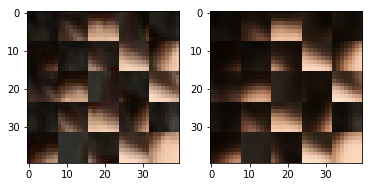

EPO: 28, recon_loss: 0.0031, total_loss: 0.0079
EPO: 28, recon_loss: 0.0052, total_loss: 0.0114
EPO: 28, recon_loss: 0.0030, total_loss: 0.0072
EPO: 28, recon_loss: 0.0032, total_loss: 0.0064
EPO: 28, recon_loss: 0.0061, total_loss: 0.0165
EPO: 28, recon_loss: 0.0053, total_loss: 0.0128
EPO: 28, recon_loss: 0.0051, total_loss: 0.0105
EPO: 28, recon_loss: 0.0062, total_loss: 0.0106
EPO: 28, recon_loss: 0.0051, total_loss: 0.0100
EPO: 28, recon_loss: 0.0120, total_loss: 0.0207
######### what? the reconstruction psnr is: 30.5287


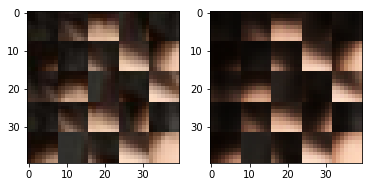

EPO: 28, recon_loss: 0.0143, total_loss: 0.0272
EPO: 28, recon_loss: 0.0053, total_loss: 0.0106
EPO: 28, recon_loss: 0.0055, total_loss: 0.0102
EPO: 28, recon_loss: 0.0062, total_loss: 0.0103
EPO: 28, recon_loss: 0.0135, total_loss: 0.0201
EPO: 28, recon_loss: 0.0011, total_loss: 0.0052
EPO: 28, recon_loss: 0.0025, total_loss: 0.0077
EPO: 28, recon_loss: 0.0059, total_loss: 0.0107
EPO: 28, recon_loss: 0.0046, total_loss: 0.0111
EPO: 28, recon_loss: 0.0109, total_loss: 0.0184
######### what? the reconstruction psnr is: 29.8975


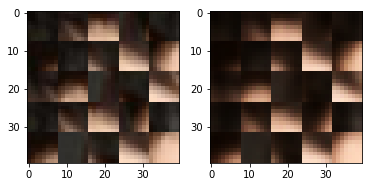

EPO: 28, recon_loss: 0.0018, total_loss: 0.0074
EPO: 28, recon_loss: 0.0025, total_loss: 0.0067
EPO: 28, recon_loss: 0.0052, total_loss: 0.0099
EPO: 28, recon_loss: 0.0013, total_loss: 0.0035
EPO: 28, recon_loss: 0.0028, total_loss: 0.0050
EPO: 28, recon_loss: 0.0048, total_loss: 0.0110
EPO: 28, recon_loss: 0.0081, total_loss: 0.0138
EPO: 28, recon_loss: 0.0152, total_loss: 0.0220
EPO: 28, recon_loss: 0.0103, total_loss: 0.0159
EPO: 28, recon_loss: 0.0094, total_loss: 0.0144
######### what? the reconstruction psnr is: 29.8141


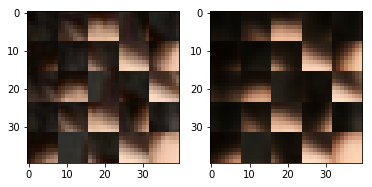

EPO: 29, recon_loss: 0.0022, total_loss: 0.0046
EPO: 29, recon_loss: 0.0017, total_loss: 0.0038
EPO: 29, recon_loss: 0.0085, total_loss: 0.0133
EPO: 29, recon_loss: 0.0022, total_loss: 0.0050
EPO: 29, recon_loss: 0.0043, total_loss: 0.0080
EPO: 29, recon_loss: 0.0026, total_loss: 0.0094
EPO: 29, recon_loss: 0.0027, total_loss: 0.0075
EPO: 29, recon_loss: 0.0045, total_loss: 0.0086
EPO: 29, recon_loss: 0.0033, total_loss: 0.0064
EPO: 29, recon_loss: 0.0058, total_loss: 0.0126
######### what? the reconstruction psnr is: 30.9812


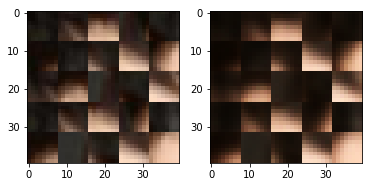

EPO: 29, recon_loss: 0.0019, total_loss: 0.0083
EPO: 29, recon_loss: 0.0010, total_loss: 0.0036
EPO: 29, recon_loss: 0.0032, total_loss: 0.0081
EPO: 29, recon_loss: 0.0021, total_loss: 0.0039
EPO: 29, recon_loss: 0.0047, total_loss: 0.0101
EPO: 29, recon_loss: 0.0029, total_loss: 0.0078
EPO: 29, recon_loss: 0.0029, total_loss: 0.0074
EPO: 29, recon_loss: 0.0038, total_loss: 0.0079
EPO: 29, recon_loss: 0.0028, total_loss: 0.0079
EPO: 29, recon_loss: 0.0029, total_loss: 0.0069
######### what? the reconstruction psnr is: 31.1050


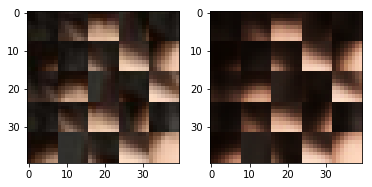

EPO: 29, recon_loss: 0.0031, total_loss: 0.0057
EPO: 29, recon_loss: 0.0021, total_loss: 0.0054
EPO: 29, recon_loss: 0.0063, total_loss: 0.0102
EPO: 29, recon_loss: 0.0023, total_loss: 0.0049
EPO: 29, recon_loss: 0.0031, total_loss: 0.0058
EPO: 29, recon_loss: 0.0067, total_loss: 0.0150
EPO: 29, recon_loss: 0.0026, total_loss: 0.0081
EPO: 29, recon_loss: 0.0060, total_loss: 0.0143
EPO: 29, recon_loss: 0.0068, total_loss: 0.0135
EPO: 29, recon_loss: 0.0055, total_loss: 0.0110
######### what? the reconstruction psnr is: 30.7053


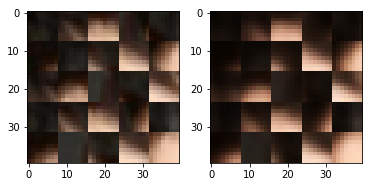

EPO: 29, recon_loss: 0.0044, total_loss: 0.0135
EPO: 29, recon_loss: 0.0019, total_loss: 0.0069
EPO: 29, recon_loss: 0.0049, total_loss: 0.0102
EPO: 29, recon_loss: 0.0024, total_loss: 0.0045
EPO: 29, recon_loss: 0.0020, total_loss: 0.0048
EPO: 29, recon_loss: 0.0015, total_loss: 0.0036
EPO: 29, recon_loss: 0.0015, total_loss: 0.0036
EPO: 29, recon_loss: 0.0026, total_loss: 0.0067
EPO: 29, recon_loss: 0.0029, total_loss: 0.0058
EPO: 29, recon_loss: 0.0043, total_loss: 0.0105
######### what? the reconstruction psnr is: 30.9589


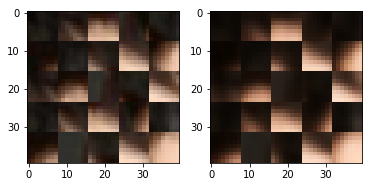

EPO: 29, recon_loss: 0.0016, total_loss: 0.0087
EPO: 29, recon_loss: 0.0015, total_loss: 0.0070
EPO: 29, recon_loss: 0.0023, total_loss: 0.0074
EPO: 29, recon_loss: 0.0028, total_loss: 0.0061
EPO: 29, recon_loss: 0.0026, total_loss: 0.0071
EPO: 29, recon_loss: 0.0049, total_loss: 0.0141
EPO: 29, recon_loss: 0.0033, total_loss: 0.0094
EPO: 29, recon_loss: 0.0051, total_loss: 0.0119
EPO: 29, recon_loss: 0.0047, total_loss: 0.0086
EPO: 29, recon_loss: 0.0030, total_loss: 0.0063
######### what? the reconstruction psnr is: 31.0355


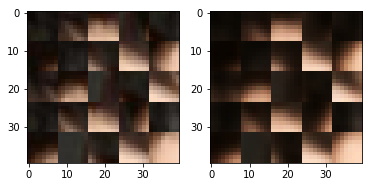

EPO: 29, recon_loss: 0.0075, total_loss: 0.0130
EPO: 29, recon_loss: 0.0031, total_loss: 0.0070
EPO: 29, recon_loss: 0.0038, total_loss: 0.0098
EPO: 29, recon_loss: 0.0049, total_loss: 0.0102
EPO: 29, recon_loss: 0.0040, total_loss: 0.0090
EPO: 29, recon_loss: 0.0123, total_loss: 0.0176
EPO: 29, recon_loss: 0.0085, total_loss: 0.0164
EPO: 29, recon_loss: 0.0103, total_loss: 0.0197
EPO: 29, recon_loss: 0.0176, total_loss: 0.0270
EPO: 29, recon_loss: 0.0095, total_loss: 0.0176
######### what? the reconstruction psnr is: 30.3843


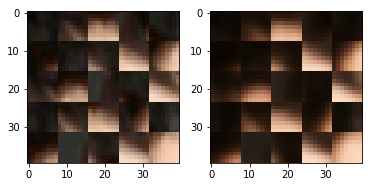

EPO: 29, recon_loss: 0.0093, total_loss: 0.0171
EPO: 29, recon_loss: 0.0036, total_loss: 0.0082
EPO: 29, recon_loss: 0.0043, total_loss: 0.0094
EPO: 29, recon_loss: 0.0061, total_loss: 0.0115
EPO: 29, recon_loss: 0.0069, total_loss: 0.0144
EPO: 29, recon_loss: 0.0070, total_loss: 0.0137
EPO: 29, recon_loss: 0.0025, total_loss: 0.0088
EPO: 29, recon_loss: 0.0042, total_loss: 0.0108
EPO: 29, recon_loss: 0.0074, total_loss: 0.0141
EPO: 29, recon_loss: 0.0026, total_loss: 0.0086
######### what? the reconstruction psnr is: 30.3023


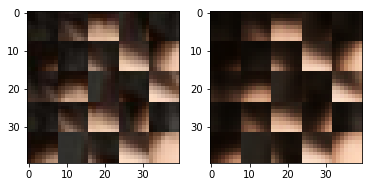

EPO: 29, recon_loss: 0.0038, total_loss: 0.0093
EPO: 29, recon_loss: 0.0058, total_loss: 0.0164
EPO: 29, recon_loss: 0.0058, total_loss: 0.0162
EPO: 29, recon_loss: 0.0164, total_loss: 0.0302
EPO: 29, recon_loss: 0.0052, total_loss: 0.0172
EPO: 29, recon_loss: 0.0069, total_loss: 0.0173
EPO: 29, recon_loss: 0.0075, total_loss: 0.0177
EPO: 29, recon_loss: 0.0050, total_loss: 0.0167
EPO: 29, recon_loss: 0.0183, total_loss: 0.0321
EPO: 29, recon_loss: 0.0082, total_loss: 0.0208
######### what? the reconstruction psnr is: 31.2795


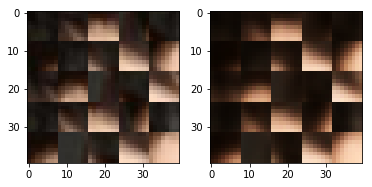

EPO: 29, recon_loss: 0.0084, total_loss: 0.0204
EPO: 29, recon_loss: 0.0019, total_loss: 0.0112
EPO: 29, recon_loss: 0.0058, total_loss: 0.0179
EPO: 29, recon_loss: 0.0207, total_loss: 0.0315
EPO: 29, recon_loss: 0.0140, total_loss: 0.0208
EPO: 29, recon_loss: 0.0031, total_loss: 0.0065
EPO: 29, recon_loss: 0.0019, total_loss: 0.0063
EPO: 29, recon_loss: 0.0027, total_loss: 0.0084
EPO: 29, recon_loss: 0.0072, total_loss: 0.0138
EPO: 29, recon_loss: 0.0034, total_loss: 0.0103
######### what? the reconstruction psnr is: 31.0326


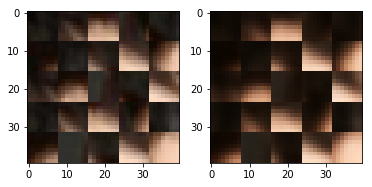

EPO: 29, recon_loss: 0.0056, total_loss: 0.0128
EPO: 29, recon_loss: 0.0011, total_loss: 0.0038
EPO: 29, recon_loss: 0.0005, total_loss: 0.0024
EPO: 29, recon_loss: 0.0011, total_loss: 0.0033
EPO: 29, recon_loss: 0.0007, total_loss: 0.0018
EPO: 29, recon_loss: 0.0009, total_loss: 0.0027
EPO: 29, recon_loss: 0.0051, total_loss: 0.0151
EPO: 29, recon_loss: 0.0020, total_loss: 0.0064
EPO: 29, recon_loss: 0.0040, total_loss: 0.0094
EPO: 29, recon_loss: 0.0024, total_loss: 0.0054
######### what? the reconstruction psnr is: 30.8600


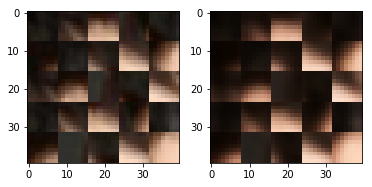

EPO: 29, recon_loss: 0.0030, total_loss: 0.0055
EPO: 29, recon_loss: 0.0066, total_loss: 0.0174
EPO: 29, recon_loss: 0.0056, total_loss: 0.0132
EPO: 29, recon_loss: 0.0069, total_loss: 0.0150
EPO: 29, recon_loss: 0.0065, total_loss: 0.0156
EPO: 29, recon_loss: 0.0039, total_loss: 0.0093
EPO: 29, recon_loss: 0.0048, total_loss: 0.0105
EPO: 29, recon_loss: 0.0033, total_loss: 0.0070
EPO: 29, recon_loss: 0.0032, total_loss: 0.0070
EPO: 29, recon_loss: 0.0028, total_loss: 0.0063
######### what? the reconstruction psnr is: 30.4770


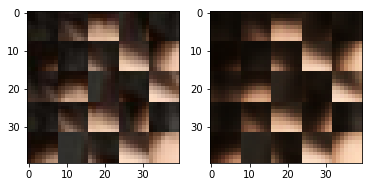

EPO: 29, recon_loss: 0.0035, total_loss: 0.0078
EPO: 29, recon_loss: 0.0025, total_loss: 0.0111
EPO: 29, recon_loss: 0.0017, total_loss: 0.0064
EPO: 29, recon_loss: 0.0036, total_loss: 0.0098
EPO: 29, recon_loss: 0.0055, total_loss: 0.0109
EPO: 29, recon_loss: 0.0038, total_loss: 0.0080
EPO: 29, recon_loss: 0.0030, total_loss: 0.0072
EPO: 29, recon_loss: 0.0010, total_loss: 0.0035
EPO: 29, recon_loss: 0.0019, total_loss: 0.0045
EPO: 29, recon_loss: 0.0025, total_loss: 0.0062
######### what? the reconstruction psnr is: 30.5533


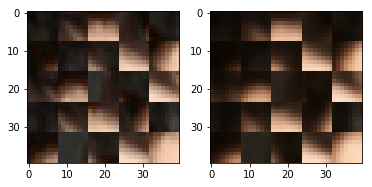

EPO: 29, recon_loss: 0.0016, total_loss: 0.0038
EPO: 29, recon_loss: 0.0028, total_loss: 0.0058
EPO: 29, recon_loss: 0.0021, total_loss: 0.0056
EPO: 29, recon_loss: 0.0032, total_loss: 0.0077
EPO: 29, recon_loss: 0.0052, total_loss: 0.0107
EPO: 29, recon_loss: 0.0041, total_loss: 0.0088
EPO: 29, recon_loss: 0.0024, total_loss: 0.0058
EPO: 29, recon_loss: 0.0027, total_loss: 0.0103
EPO: 29, recon_loss: 0.0059, total_loss: 0.0133
EPO: 29, recon_loss: 0.0112, total_loss: 0.0195
######### what? the reconstruction psnr is: 30.4696


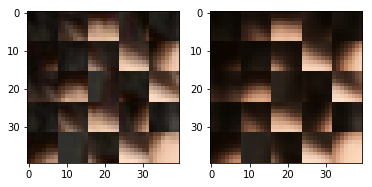

EPO: 29, recon_loss: 0.0033, total_loss: 0.0087
EPO: 29, recon_loss: 0.0126, total_loss: 0.0216
EPO: 29, recon_loss: 0.0008, total_loss: 0.0038
EPO: 29, recon_loss: 0.0014, total_loss: 0.0049
EPO: 29, recon_loss: 0.0094, total_loss: 0.0154
EPO: 29, recon_loss: 0.0025, total_loss: 0.0062
EPO: 29, recon_loss: 0.0039, total_loss: 0.0079
EPO: 29, recon_loss: 0.0041, total_loss: 0.0091
EPO: 29, recon_loss: 0.0047, total_loss: 0.0111
EPO: 29, recon_loss: 0.0085, total_loss: 0.0145
######### what? the reconstruction psnr is: 31.0772


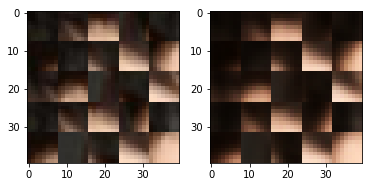

EPO: 29, recon_loss: 0.0021, total_loss: 0.0063
EPO: 29, recon_loss: 0.0049, total_loss: 0.0094
EPO: 29, recon_loss: 0.0021, total_loss: 0.0059
EPO: 29, recon_loss: 0.0036, total_loss: 0.0078
EPO: 29, recon_loss: 0.0073, total_loss: 0.0147
EPO: 29, recon_loss: 0.0018, total_loss: 0.0058
EPO: 29, recon_loss: 0.0028, total_loss: 0.0074
EPO: 29, recon_loss: 0.0044, total_loss: 0.0107
EPO: 29, recon_loss: 0.0028, total_loss: 0.0085
EPO: 29, recon_loss: 0.0078, total_loss: 0.0133
######### what? the reconstruction psnr is: 31.1387


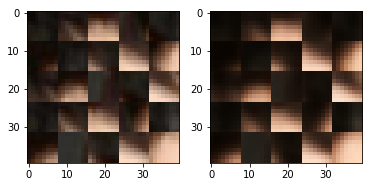

EPO: 29, recon_loss: 0.0038, total_loss: 0.0099
EPO: 29, recon_loss: 0.0056, total_loss: 0.0115
EPO: 29, recon_loss: 0.0068, total_loss: 0.0170
EPO: 29, recon_loss: 0.0010, total_loss: 0.0039
EPO: 29, recon_loss: 0.0051, total_loss: 0.0092
EPO: 29, recon_loss: 0.0023, total_loss: 0.0060
EPO: 29, recon_loss: 0.0035, total_loss: 0.0075
EPO: 29, recon_loss: 0.0035, total_loss: 0.0099
EPO: 29, recon_loss: 0.0023, total_loss: 0.0067
EPO: 29, recon_loss: 0.0081, total_loss: 0.0149
######### what? the reconstruction psnr is: 30.7420


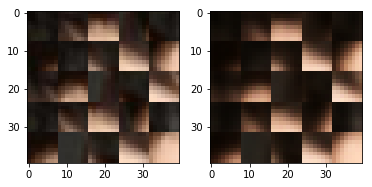

EPO: 29, recon_loss: 0.0031, total_loss: 0.0086
EPO: 29, recon_loss: 0.0060, total_loss: 0.0128
EPO: 29, recon_loss: 0.0045, total_loss: 0.0127
EPO: 29, recon_loss: 0.0018, total_loss: 0.0069
EPO: 29, recon_loss: 0.0044, total_loss: 0.0113
EPO: 29, recon_loss: 0.0023, total_loss: 0.0068
EPO: 29, recon_loss: 0.0041, total_loss: 0.0093
EPO: 29, recon_loss: 0.0025, total_loss: 0.0042
EPO: 29, recon_loss: 0.0016, total_loss: 0.0031
EPO: 29, recon_loss: 0.0019, total_loss: 0.0043
######### what? the reconstruction psnr is: 31.0493


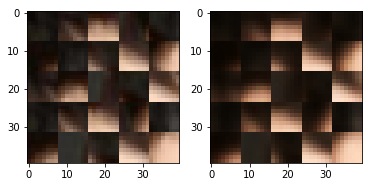

EPO: 29, recon_loss: 0.0023, total_loss: 0.0057
EPO: 29, recon_loss: 0.0027, total_loss: 0.0070
EPO: 29, recon_loss: 0.0094, total_loss: 0.0216
EPO: 29, recon_loss: 0.0084, total_loss: 0.0191
EPO: 29, recon_loss: 0.0070, total_loss: 0.0181
EPO: 29, recon_loss: 0.0082, total_loss: 0.0213
EPO: 29, recon_loss: 0.0072, total_loss: 0.0212
EPO: 29, recon_loss: 0.0023, total_loss: 0.0086
EPO: 29, recon_loss: 0.0029, total_loss: 0.0082
EPO: 29, recon_loss: 0.0095, total_loss: 0.0197
######### what? the reconstruction psnr is: 31.2499


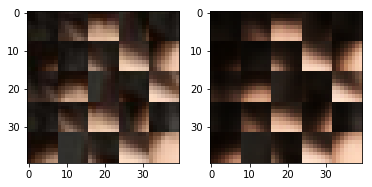

EPO: 29, recon_loss: 0.0037, total_loss: 0.0124
EPO: 29, recon_loss: 0.0037, total_loss: 0.0107
EPO: 29, recon_loss: 0.0038, total_loss: 0.0106
EPO: 29, recon_loss: 0.0038, total_loss: 0.0127
EPO: 29, recon_loss: 0.0051, total_loss: 0.0135
EPO: 29, recon_loss: 0.0068, total_loss: 0.0151
EPO: 29, recon_loss: 0.0036, total_loss: 0.0093
EPO: 29, recon_loss: 0.0035, total_loss: 0.0096
EPO: 29, recon_loss: 0.0023, total_loss: 0.0078
EPO: 29, recon_loss: 0.0045, total_loss: 0.0118
######### what? the reconstruction psnr is: 31.3211


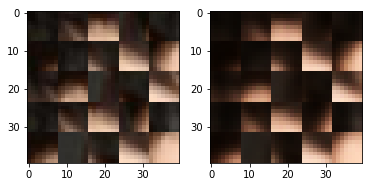

EPO: 29, recon_loss: 0.0077, total_loss: 0.0140
EPO: 29, recon_loss: 0.0020, total_loss: 0.0072
EPO: 29, recon_loss: 0.0037, total_loss: 0.0103
EPO: 29, recon_loss: 0.0020, total_loss: 0.0068
EPO: 29, recon_loss: 0.0039, total_loss: 0.0107
EPO: 29, recon_loss: 0.0093, total_loss: 0.0158
EPO: 29, recon_loss: 0.0039, total_loss: 0.0111
EPO: 29, recon_loss: 0.0070, total_loss: 0.0133
EPO: 29, recon_loss: 0.0015, total_loss: 0.0071
EPO: 29, recon_loss: 0.0027, total_loss: 0.0075
######### what? the reconstruction psnr is: 31.2611


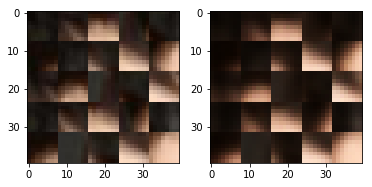

EPO: 29, recon_loss: 0.0062, total_loss: 0.0117
EPO: 29, recon_loss: 0.0027, total_loss: 0.0062
EPO: 29, recon_loss: 0.0048, total_loss: 0.0116
EPO: 29, recon_loss: 0.0018, total_loss: 0.0066
EPO: 29, recon_loss: 0.0016, total_loss: 0.0064
EPO: 29, recon_loss: 0.0031, total_loss: 0.0079
EPO: 29, recon_loss: 0.0019, total_loss: 0.0056
EPO: 29, recon_loss: 0.0025, total_loss: 0.0068
EPO: 29, recon_loss: 0.0083, total_loss: 0.0184
EPO: 29, recon_loss: 0.0065, total_loss: 0.0161
######### what? the reconstruction psnr is: 30.7379


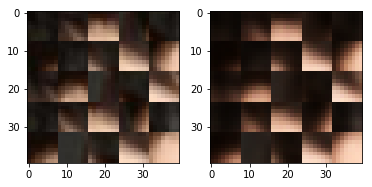

EPO: 29, recon_loss: 0.0044, total_loss: 0.0096
EPO: 29, recon_loss: 0.0052, total_loss: 0.0129
EPO: 29, recon_loss: 0.0034, total_loss: 0.0079
EPO: 29, recon_loss: 0.0060, total_loss: 0.0176
EPO: 29, recon_loss: 0.0026, total_loss: 0.0100
EPO: 29, recon_loss: 0.0060, total_loss: 0.0133
EPO: 29, recon_loss: 0.0024, total_loss: 0.0079
EPO: 29, recon_loss: 0.0054, total_loss: 0.0114
EPO: 29, recon_loss: 0.0014, total_loss: 0.0038
EPO: 29, recon_loss: 0.0007, total_loss: 0.0020
######### what? the reconstruction psnr is: 30.9497


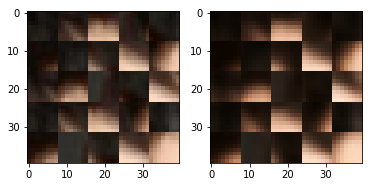

EPO: 29, recon_loss: 0.0039, total_loss: 0.0074
EPO: 29, recon_loss: 0.0014, total_loss: 0.0033
EPO: 29, recon_loss: 0.0019, total_loss: 0.0040
EPO: 29, recon_loss: 0.0038, total_loss: 0.0082
EPO: 29, recon_loss: 0.0026, total_loss: 0.0070
EPO: 29, recon_loss: 0.0050, total_loss: 0.0108
EPO: 29, recon_loss: 0.0020, total_loss: 0.0055
EPO: 29, recon_loss: 0.0021, total_loss: 0.0047
EPO: 29, recon_loss: 0.0060, total_loss: 0.0161
EPO: 29, recon_loss: 0.0040, total_loss: 0.0098
######### what? the reconstruction psnr is: 30.6344


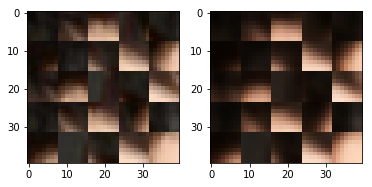

EPO: 29, recon_loss: 0.0063, total_loss: 0.0117
EPO: 29, recon_loss: 0.0041, total_loss: 0.0082
EPO: 29, recon_loss: 0.0058, total_loss: 0.0108
EPO: 29, recon_loss: 0.0098, total_loss: 0.0187
EPO: 29, recon_loss: 0.0162, total_loss: 0.0303
EPO: 29, recon_loss: 0.0043, total_loss: 0.0089
EPO: 29, recon_loss: 0.0038, total_loss: 0.0074
EPO: 29, recon_loss: 0.0069, total_loss: 0.0119
EPO: 29, recon_loss: 0.0026, total_loss: 0.0070
EPO: 29, recon_loss: 0.0012, total_loss: 0.0057
######### what? the reconstruction psnr is: 30.1610


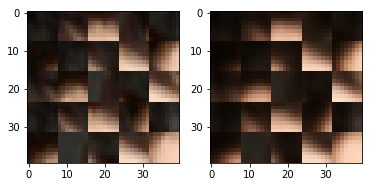

EPO: 29, recon_loss: 0.0028, total_loss: 0.0072
EPO: 29, recon_loss: 0.0033, total_loss: 0.0084
EPO: 29, recon_loss: 0.0036, total_loss: 0.0080
EPO: 29, recon_loss: 0.0026, total_loss: 0.0144
EPO: 29, recon_loss: 0.0013, total_loss: 0.0059
EPO: 29, recon_loss: 0.0030, total_loss: 0.0073
EPO: 29, recon_loss: 0.0032, total_loss: 0.0073
EPO: 29, recon_loss: 0.0010, total_loss: 0.0025
EPO: 29, recon_loss: 0.0038, total_loss: 0.0079
EPO: 29, recon_loss: 0.0046, total_loss: 0.0108
######### what? the reconstruction psnr is: 30.6243


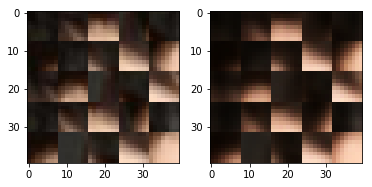

EPO: 29, recon_loss: 0.0097, total_loss: 0.0147
EPO: 29, recon_loss: 0.0109, total_loss: 0.0180
EPO: 29, recon_loss: 0.0093, total_loss: 0.0155
EPO: 29, recon_loss: 0.0079, total_loss: 0.0123
EPO: 30, recon_loss: 0.0018, total_loss: 0.0038
EPO: 30, recon_loss: 0.0023, total_loss: 0.0046
EPO: 30, recon_loss: 0.0054, total_loss: 0.0096
EPO: 30, recon_loss: 0.0024, total_loss: 0.0051
EPO: 30, recon_loss: 0.0049, total_loss: 0.0087
EPO: 30, recon_loss: 0.0018, total_loss: 0.0067
######### what? the reconstruction psnr is: 31.1094


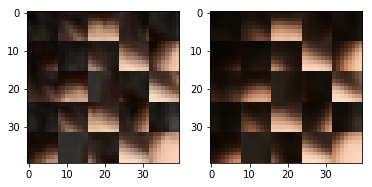

EPO: 30, recon_loss: 0.0026, total_loss: 0.0072
EPO: 30, recon_loss: 0.0055, total_loss: 0.0095
EPO: 30, recon_loss: 0.0056, total_loss: 0.0100
EPO: 30, recon_loss: 0.0058, total_loss: 0.0120
EPO: 30, recon_loss: 0.0021, total_loss: 0.0070
EPO: 30, recon_loss: 0.0016, total_loss: 0.0050
EPO: 30, recon_loss: 0.0029, total_loss: 0.0069
EPO: 30, recon_loss: 0.0024, total_loss: 0.0048
EPO: 30, recon_loss: 0.0064, total_loss: 0.0114
EPO: 30, recon_loss: 0.0029, total_loss: 0.0076
######### what? the reconstruction psnr is: 31.2798


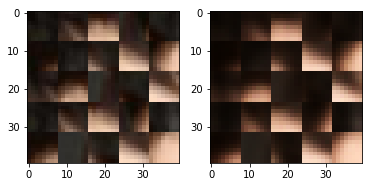

EPO: 30, recon_loss: 0.0027, total_loss: 0.0069
EPO: 30, recon_loss: 0.0035, total_loss: 0.0086
EPO: 30, recon_loss: 0.0029, total_loss: 0.0076
EPO: 30, recon_loss: 0.0032, total_loss: 0.0078
EPO: 30, recon_loss: 0.0026, total_loss: 0.0052
EPO: 30, recon_loss: 0.0023, total_loss: 0.0053
EPO: 30, recon_loss: 0.0076, total_loss: 0.0122
EPO: 30, recon_loss: 0.0019, total_loss: 0.0045
EPO: 30, recon_loss: 0.0038, total_loss: 0.0065
EPO: 30, recon_loss: 0.0054, total_loss: 0.0130
######### what? the reconstruction psnr is: 30.8524


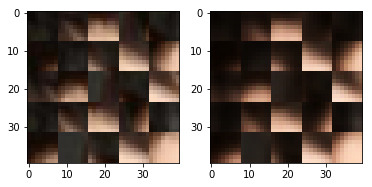

EPO: 30, recon_loss: 0.0039, total_loss: 0.0115
EPO: 30, recon_loss: 0.0064, total_loss: 0.0140
EPO: 30, recon_loss: 0.0077, total_loss: 0.0150
EPO: 30, recon_loss: 0.0059, total_loss: 0.0106
EPO: 30, recon_loss: 0.0041, total_loss: 0.0130
EPO: 30, recon_loss: 0.0016, total_loss: 0.0056
EPO: 30, recon_loss: 0.0050, total_loss: 0.0099
EPO: 30, recon_loss: 0.0028, total_loss: 0.0049
EPO: 30, recon_loss: 0.0023, total_loss: 0.0063
EPO: 30, recon_loss: 0.0012, total_loss: 0.0028
######### what? the reconstruction psnr is: 30.2963


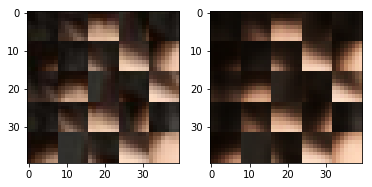

EPO: 30, recon_loss: 0.0015, total_loss: 0.0036
EPO: 30, recon_loss: 0.0043, total_loss: 0.0085
EPO: 30, recon_loss: 0.0028, total_loss: 0.0068
EPO: 30, recon_loss: 0.0037, total_loss: 0.0094
EPO: 30, recon_loss: 0.0013, total_loss: 0.0079
EPO: 30, recon_loss: 0.0014, total_loss: 0.0068
EPO: 30, recon_loss: 0.0036, total_loss: 0.0093
EPO: 30, recon_loss: 0.0012, total_loss: 0.0046
EPO: 30, recon_loss: 0.0030, total_loss: 0.0077
EPO: 30, recon_loss: 0.0056, total_loss: 0.0150
######### what? the reconstruction psnr is: 31.1446


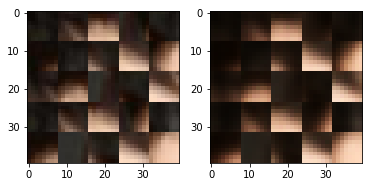

EPO: 30, recon_loss: 0.0018, total_loss: 0.0061
EPO: 30, recon_loss: 0.0062, total_loss: 0.0130
EPO: 30, recon_loss: 0.0034, total_loss: 0.0069
EPO: 30, recon_loss: 0.0030, total_loss: 0.0059
EPO: 30, recon_loss: 0.0075, total_loss: 0.0133
EPO: 30, recon_loss: 0.0029, total_loss: 0.0063
EPO: 30, recon_loss: 0.0042, total_loss: 0.0100
EPO: 30, recon_loss: 0.0037, total_loss: 0.0078
EPO: 30, recon_loss: 0.0042, total_loss: 0.0092
EPO: 30, recon_loss: 0.0122, total_loss: 0.0222
######### what? the reconstruction psnr is: 31.2938


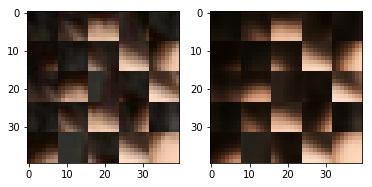

EPO: 30, recon_loss: 0.0108, total_loss: 0.0196
EPO: 30, recon_loss: 0.0090, total_loss: 0.0184
EPO: 30, recon_loss: 0.0103, total_loss: 0.0188
EPO: 30, recon_loss: 0.0068, total_loss: 0.0140
EPO: 30, recon_loss: 0.0060, total_loss: 0.0130
EPO: 30, recon_loss: 0.0032, total_loss: 0.0078
EPO: 30, recon_loss: 0.0049, total_loss: 0.0114
EPO: 30, recon_loss: 0.0072, total_loss: 0.0123
EPO: 30, recon_loss: 0.0067, total_loss: 0.0144
EPO: 30, recon_loss: 0.0080, total_loss: 0.0162
######### what? the reconstruction psnr is: 31.2598


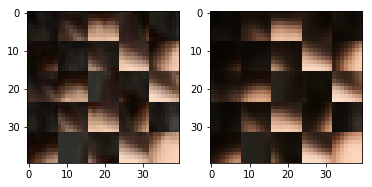

EPO: 30, recon_loss: 0.0017, total_loss: 0.0067
EPO: 30, recon_loss: 0.0046, total_loss: 0.0112
EPO: 30, recon_loss: 0.0076, total_loss: 0.0142
EPO: 30, recon_loss: 0.0029, total_loss: 0.0086
EPO: 30, recon_loss: 0.0054, total_loss: 0.0128
EPO: 30, recon_loss: 0.0057, total_loss: 0.0163
EPO: 30, recon_loss: 0.0077, total_loss: 0.0176
EPO: 30, recon_loss: 0.0140, total_loss: 0.0282
EPO: 30, recon_loss: 0.0047, total_loss: 0.0152
EPO: 30, recon_loss: 0.0092, total_loss: 0.0192
######### what? the reconstruction psnr is: 31.0811


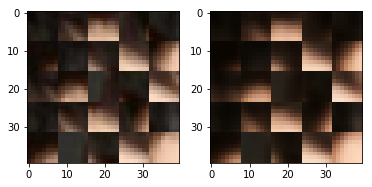

EPO: 30, recon_loss: 0.0061, total_loss: 0.0159
EPO: 30, recon_loss: 0.0071, total_loss: 0.0192
EPO: 30, recon_loss: 0.0141, total_loss: 0.0266
EPO: 30, recon_loss: 0.0103, total_loss: 0.0238
EPO: 30, recon_loss: 0.0097, total_loss: 0.0212
EPO: 30, recon_loss: 0.0019, total_loss: 0.0109
EPO: 30, recon_loss: 0.0077, total_loss: 0.0193
EPO: 30, recon_loss: 0.0185, total_loss: 0.0278
EPO: 30, recon_loss: 0.0098, total_loss: 0.0153
EPO: 30, recon_loss: 0.0035, total_loss: 0.0071
######### what? the reconstruction psnr is: 30.7444


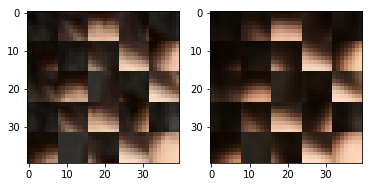

EPO: 30, recon_loss: 0.0020, total_loss: 0.0063
EPO: 30, recon_loss: 0.0027, total_loss: 0.0084
EPO: 30, recon_loss: 0.0077, total_loss: 0.0140
EPO: 30, recon_loss: 0.0034, total_loss: 0.0102
EPO: 30, recon_loss: 0.0069, total_loss: 0.0135
EPO: 30, recon_loss: 0.0008, total_loss: 0.0029
EPO: 30, recon_loss: 0.0005, total_loss: 0.0020
EPO: 30, recon_loss: 0.0016, total_loss: 0.0038
EPO: 30, recon_loss: 0.0007, total_loss: 0.0019
EPO: 30, recon_loss: 0.0015, total_loss: 0.0037
######### what? the reconstruction psnr is: 31.0675


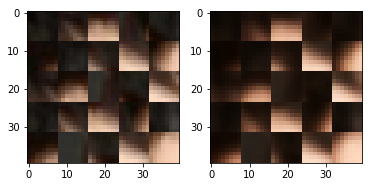

EPO: 30, recon_loss: 0.0034, total_loss: 0.0106
EPO: 30, recon_loss: 0.0020, total_loss: 0.0056
EPO: 30, recon_loss: 0.0048, total_loss: 0.0100
EPO: 30, recon_loss: 0.0023, total_loss: 0.0051
EPO: 30, recon_loss: 0.0030, total_loss: 0.0057
EPO: 30, recon_loss: 0.0052, total_loss: 0.0138
EPO: 30, recon_loss: 0.0062, total_loss: 0.0143
EPO: 30, recon_loss: 0.0062, total_loss: 0.0143
EPO: 30, recon_loss: 0.0070, total_loss: 0.0160
EPO: 30, recon_loss: 0.0035, total_loss: 0.0075
######### what? the reconstruction psnr is: 30.7802


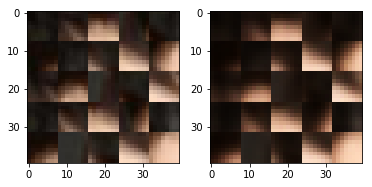

EPO: 30, recon_loss: 0.0042, total_loss: 0.0098
EPO: 30, recon_loss: 0.0027, total_loss: 0.0060
EPO: 30, recon_loss: 0.0042, total_loss: 0.0090
EPO: 30, recon_loss: 0.0026, total_loss: 0.0060
EPO: 30, recon_loss: 0.0027, total_loss: 0.0060
EPO: 30, recon_loss: 0.0030, total_loss: 0.0128
EPO: 30, recon_loss: 0.0012, total_loss: 0.0051
EPO: 30, recon_loss: 0.0042, total_loss: 0.0110
EPO: 30, recon_loss: 0.0032, total_loss: 0.0072
EPO: 30, recon_loss: 0.0042, total_loss: 0.0084
######### what? the reconstruction psnr is: 30.9078


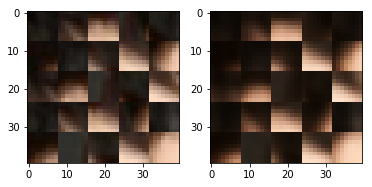

EPO: 30, recon_loss: 0.0016, total_loss: 0.0037
EPO: 30, recon_loss: 0.0009, total_loss: 0.0034
EPO: 30, recon_loss: 0.0021, total_loss: 0.0049
EPO: 30, recon_loss: 0.0019, total_loss: 0.0050
EPO: 30, recon_loss: 0.0019, total_loss: 0.0041
EPO: 30, recon_loss: 0.0033, total_loss: 0.0083
EPO: 30, recon_loss: 0.0020, total_loss: 0.0055
EPO: 30, recon_loss: 0.0046, total_loss: 0.0099
EPO: 30, recon_loss: 0.0034, total_loss: 0.0083
EPO: 30, recon_loss: 0.0032, total_loss: 0.0076
######### what? the reconstruction psnr is: 30.6307


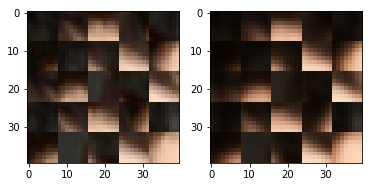

EPO: 30, recon_loss: 0.0031, total_loss: 0.0123
EPO: 30, recon_loss: 0.0031, total_loss: 0.0103
EPO: 30, recon_loss: 0.0081, total_loss: 0.0163
EPO: 30, recon_loss: 0.0077, total_loss: 0.0144
EPO: 30, recon_loss: 0.0033, total_loss: 0.0087
EPO: 30, recon_loss: 0.0116, total_loss: 0.0209
EPO: 30, recon_loss: 0.0008, total_loss: 0.0036
EPO: 30, recon_loss: 0.0019, total_loss: 0.0069
EPO: 30, recon_loss: 0.0072, total_loss: 0.0128
EPO: 30, recon_loss: 0.0039, total_loss: 0.0081
######### what? the reconstruction psnr is: 30.3742


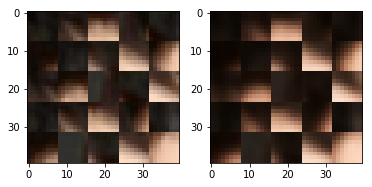

EPO: 30, recon_loss: 0.0034, total_loss: 0.0079
EPO: 30, recon_loss: 0.0046, total_loss: 0.0104
EPO: 30, recon_loss: 0.0055, total_loss: 0.0120
EPO: 30, recon_loss: 0.0068, total_loss: 0.0133
EPO: 30, recon_loss: 0.0015, total_loss: 0.0051
EPO: 30, recon_loss: 0.0069, total_loss: 0.0120
EPO: 30, recon_loss: 0.0013, total_loss: 0.0047
EPO: 30, recon_loss: 0.0056, total_loss: 0.0106
EPO: 30, recon_loss: 0.0058, total_loss: 0.0123
EPO: 30, recon_loss: 0.0025, total_loss: 0.0068
######### what? the reconstruction psnr is: 30.7937


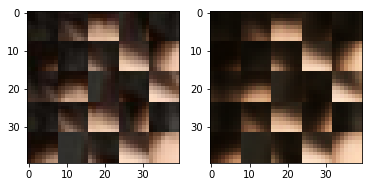

EPO: 30, recon_loss: 0.0034, total_loss: 0.0075
EPO: 30, recon_loss: 0.0044, total_loss: 0.0106
EPO: 30, recon_loss: 0.0030, total_loss: 0.0081
EPO: 30, recon_loss: 0.0087, total_loss: 0.0142
EPO: 30, recon_loss: 0.0037, total_loss: 0.0100
EPO: 30, recon_loss: 0.0055, total_loss: 0.0111
EPO: 30, recon_loss: 0.0048, total_loss: 0.0119
EPO: 30, recon_loss: 0.0009, total_loss: 0.0037
EPO: 30, recon_loss: 0.0053, total_loss: 0.0094
EPO: 30, recon_loss: 0.0029, total_loss: 0.0070
######### what? the reconstruction psnr is: 31.1878


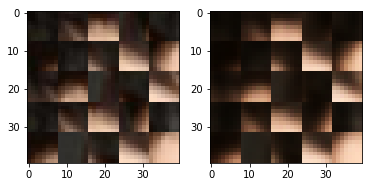

EPO: 30, recon_loss: 0.0039, total_loss: 0.0085
EPO: 30, recon_loss: 0.0032, total_loss: 0.0097
EPO: 30, recon_loss: 0.0034, total_loss: 0.0085
EPO: 30, recon_loss: 0.0082, total_loss: 0.0153
EPO: 30, recon_loss: 0.0028, total_loss: 0.0083
EPO: 30, recon_loss: 0.0066, total_loss: 0.0138
EPO: 30, recon_loss: 0.0042, total_loss: 0.0112
EPO: 30, recon_loss: 0.0014, total_loss: 0.0054
EPO: 30, recon_loss: 0.0055, total_loss: 0.0129
EPO: 30, recon_loss: 0.0022, total_loss: 0.0066
######### what? the reconstruction psnr is: 31.1726


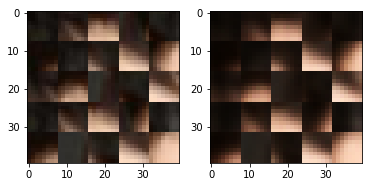

EPO: 30, recon_loss: 0.0048, total_loss: 0.0104
EPO: 30, recon_loss: 0.0021, total_loss: 0.0035
EPO: 30, recon_loss: 0.0016, total_loss: 0.0033
EPO: 30, recon_loss: 0.0038, total_loss: 0.0072
EPO: 30, recon_loss: 0.0023, total_loss: 0.0060
EPO: 30, recon_loss: 0.0024, total_loss: 0.0061
EPO: 30, recon_loss: 0.0104, total_loss: 0.0222
EPO: 30, recon_loss: 0.0073, total_loss: 0.0176
EPO: 30, recon_loss: 0.0085, total_loss: 0.0224
EPO: 30, recon_loss: 0.0057, total_loss: 0.0172
######### what? the reconstruction psnr is: 31.3443


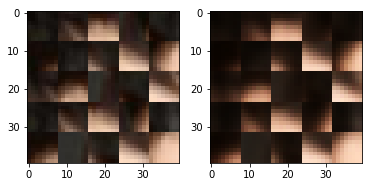

EPO: 30, recon_loss: 0.0076, total_loss: 0.0216
EPO: 30, recon_loss: 0.0019, total_loss: 0.0078
EPO: 30, recon_loss: 0.0023, total_loss: 0.0070
EPO: 30, recon_loss: 0.0070, total_loss: 0.0182
EPO: 30, recon_loss: 0.0031, total_loss: 0.0109
EPO: 30, recon_loss: 0.0033, total_loss: 0.0091
EPO: 30, recon_loss: 0.0036, total_loss: 0.0138
EPO: 30, recon_loss: 0.0036, total_loss: 0.0118
EPO: 30, recon_loss: 0.0063, total_loss: 0.0153
EPO: 30, recon_loss: 0.0034, total_loss: 0.0094
######### what? the reconstruction psnr is: 31.4739


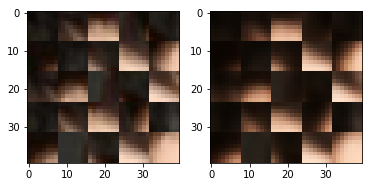

EPO: 30, recon_loss: 0.0032, total_loss: 0.0085
EPO: 30, recon_loss: 0.0045, total_loss: 0.0102
EPO: 30, recon_loss: 0.0021, total_loss: 0.0074
EPO: 30, recon_loss: 0.0068, total_loss: 0.0145
EPO: 30, recon_loss: 0.0035, total_loss: 0.0088
EPO: 30, recon_loss: 0.0022, total_loss: 0.0074
EPO: 30, recon_loss: 0.0040, total_loss: 0.0080
EPO: 30, recon_loss: 0.0020, total_loss: 0.0065
EPO: 30, recon_loss: 0.0054, total_loss: 0.0137
EPO: 30, recon_loss: 0.0057, total_loss: 0.0128
######### what? the reconstruction psnr is: 31.0525


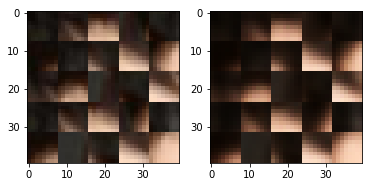

EPO: 30, recon_loss: 0.0042, total_loss: 0.0114
EPO: 30, recon_loss: 0.0080, total_loss: 0.0151
EPO: 30, recon_loss: 0.0013, total_loss: 0.0057
EPO: 30, recon_loss: 0.0043, total_loss: 0.0119
EPO: 30, recon_loss: 0.0055, total_loss: 0.0103
EPO: 30, recon_loss: 0.0042, total_loss: 0.0094
EPO: 30, recon_loss: 0.0046, total_loss: 0.0103
EPO: 30, recon_loss: 0.0017, total_loss: 0.0063
EPO: 30, recon_loss: 0.0025, total_loss: 0.0090
EPO: 30, recon_loss: 0.0022, total_loss: 0.0068
######### what? the reconstruction psnr is: 31.3525


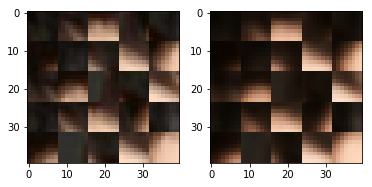

EPO: 30, recon_loss: 0.0022, total_loss: 0.0060
EPO: 30, recon_loss: 0.0021, total_loss: 0.0057
EPO: 30, recon_loss: 0.0086, total_loss: 0.0194
EPO: 30, recon_loss: 0.0058, total_loss: 0.0137
EPO: 30, recon_loss: 0.0058, total_loss: 0.0115
EPO: 30, recon_loss: 0.0055, total_loss: 0.0129
EPO: 30, recon_loss: 0.0034, total_loss: 0.0083
EPO: 30, recon_loss: 0.0051, total_loss: 0.0158
EPO: 30, recon_loss: 0.0029, total_loss: 0.0095
EPO: 30, recon_loss: 0.0066, total_loss: 0.0137
######### what? the reconstruction psnr is: 30.9996


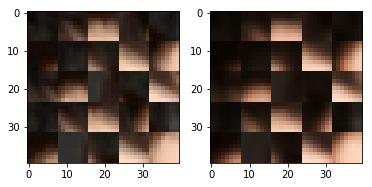

EPO: 30, recon_loss: 0.0025, total_loss: 0.0079
EPO: 30, recon_loss: 0.0059, total_loss: 0.0123
EPO: 30, recon_loss: 0.0012, total_loss: 0.0030
EPO: 30, recon_loss: 0.0008, total_loss: 0.0022
EPO: 30, recon_loss: 0.0045, total_loss: 0.0079
EPO: 30, recon_loss: 0.0013, total_loss: 0.0031
EPO: 30, recon_loss: 0.0027, total_loss: 0.0054
EPO: 30, recon_loss: 0.0037, total_loss: 0.0089
EPO: 30, recon_loss: 0.0029, total_loss: 0.0081
EPO: 30, recon_loss: 0.0036, total_loss: 0.0087
######### what? the reconstruction psnr is: 30.6939


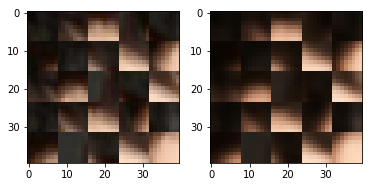

EPO: 30, recon_loss: 0.0020, total_loss: 0.0055
EPO: 30, recon_loss: 0.0025, total_loss: 0.0059
EPO: 30, recon_loss: 0.0047, total_loss: 0.0113
EPO: 30, recon_loss: 0.0042, total_loss: 0.0104
EPO: 30, recon_loss: 0.0074, total_loss: 0.0121
EPO: 30, recon_loss: 0.0050, total_loss: 0.0096
EPO: 30, recon_loss: 0.0051, total_loss: 0.0093
EPO: 30, recon_loss: 0.0077, total_loss: 0.0173
EPO: 30, recon_loss: 0.0141, total_loss: 0.0260
EPO: 30, recon_loss: 0.0070, total_loss: 0.0121
######### what? the reconstruction psnr is: 30.5137


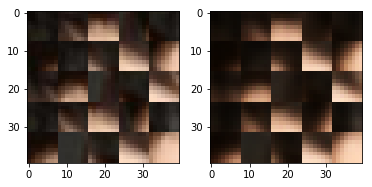

EPO: 30, recon_loss: 0.0045, total_loss: 0.0090
EPO: 30, recon_loss: 0.0073, total_loss: 0.0115
EPO: 30, recon_loss: 0.0018, total_loss: 0.0065
EPO: 30, recon_loss: 0.0012, total_loss: 0.0053
EPO: 30, recon_loss: 0.0037, total_loss: 0.0077
EPO: 30, recon_loss: 0.0022, total_loss: 0.0071
EPO: 30, recon_loss: 0.0032, total_loss: 0.0067
EPO: 30, recon_loss: 0.0032, total_loss: 0.0141
EPO: 30, recon_loss: 0.0013, total_loss: 0.0057
EPO: 30, recon_loss: 0.0028, total_loss: 0.0079
######### what? the reconstruction psnr is: 30.7807


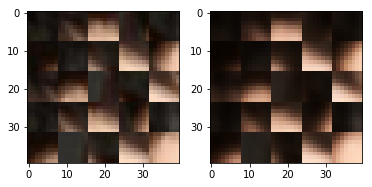

EPO: 30, recon_loss: 0.0012, total_loss: 0.0036
EPO: 30, recon_loss: 0.0011, total_loss: 0.0026
EPO: 30, recon_loss: 0.0042, total_loss: 0.0105
EPO: 30, recon_loss: 0.0047, total_loss: 0.0103
EPO: 30, recon_loss: 0.0111, total_loss: 0.0169
EPO: 30, recon_loss: 0.0090, total_loss: 0.0147
EPO: 30, recon_loss: 0.0084, total_loss: 0.0138
EPO: 31, recon_loss: 0.0039, total_loss: 0.0080
EPO: 31, recon_loss: 0.0017, total_loss: 0.0037
EPO: 31, recon_loss: 0.0053, total_loss: 0.0083
######### what? the reconstruction psnr is: 31.0275


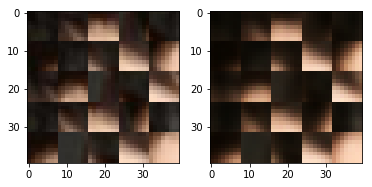

EPO: 31, recon_loss: 0.0026, total_loss: 0.0063
EPO: 31, recon_loss: 0.0021, total_loss: 0.0045
EPO: 31, recon_loss: 0.0034, total_loss: 0.0131
EPO: 31, recon_loss: 0.0015, total_loss: 0.0057
EPO: 31, recon_loss: 0.0031, total_loss: 0.0077
EPO: 31, recon_loss: 0.0046, total_loss: 0.0086
EPO: 31, recon_loss: 0.0041, total_loss: 0.0084
EPO: 31, recon_loss: 0.0045, total_loss: 0.0110
EPO: 31, recon_loss: 0.0020, total_loss: 0.0064
EPO: 31, recon_loss: 0.0027, total_loss: 0.0078
######### what? the reconstruction psnr is: 31.2671


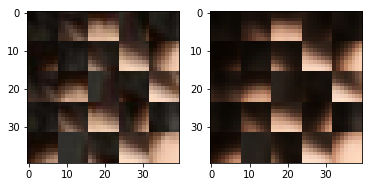

EPO: 31, recon_loss: 0.0023, total_loss: 0.0055
EPO: 31, recon_loss: 0.0027, total_loss: 0.0058
EPO: 31, recon_loss: 0.0078, total_loss: 0.0134
EPO: 31, recon_loss: 0.0027, total_loss: 0.0070
EPO: 31, recon_loss: 0.0034, total_loss: 0.0089
EPO: 31, recon_loss: 0.0036, total_loss: 0.0086
EPO: 31, recon_loss: 0.0028, total_loss: 0.0069
EPO: 31, recon_loss: 0.0031, total_loss: 0.0075
EPO: 31, recon_loss: 0.0027, total_loss: 0.0054
EPO: 31, recon_loss: 0.0028, total_loss: 0.0063
######### what? the reconstruction psnr is: 31.2684


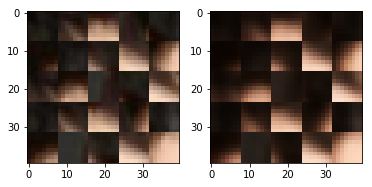

EPO: 31, recon_loss: 0.0071, total_loss: 0.0114
EPO: 31, recon_loss: 0.0020, total_loss: 0.0048
EPO: 31, recon_loss: 0.0043, total_loss: 0.0071
EPO: 31, recon_loss: 0.0065, total_loss: 0.0158
EPO: 31, recon_loss: 0.0030, total_loss: 0.0090
EPO: 31, recon_loss: 0.0075, total_loss: 0.0143
EPO: 31, recon_loss: 0.0055, total_loss: 0.0114
EPO: 31, recon_loss: 0.0094, total_loss: 0.0153
EPO: 31, recon_loss: 0.0037, total_loss: 0.0117
EPO: 31, recon_loss: 0.0018, total_loss: 0.0062
######### what? the reconstruction psnr is: 30.8932


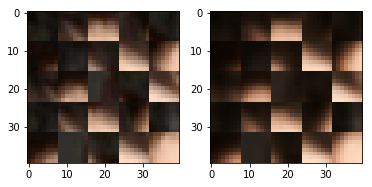

EPO: 31, recon_loss: 0.0047, total_loss: 0.0094
EPO: 31, recon_loss: 0.0034, total_loss: 0.0061
EPO: 31, recon_loss: 0.0032, total_loss: 0.0070
EPO: 31, recon_loss: 0.0010, total_loss: 0.0024
EPO: 31, recon_loss: 0.0016, total_loss: 0.0039
EPO: 31, recon_loss: 0.0052, total_loss: 0.0099
EPO: 31, recon_loss: 0.0025, total_loss: 0.0063
EPO: 31, recon_loss: 0.0038, total_loss: 0.0098
EPO: 31, recon_loss: 0.0012, total_loss: 0.0072
EPO: 31, recon_loss: 0.0018, total_loss: 0.0076
######### what? the reconstruction psnr is: 30.9657


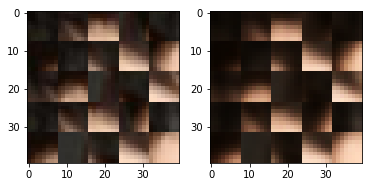

EPO: 31, recon_loss: 0.0043, total_loss: 0.0099
EPO: 31, recon_loss: 0.0010, total_loss: 0.0044
EPO: 31, recon_loss: 0.0038, total_loss: 0.0086
EPO: 31, recon_loss: 0.0071, total_loss: 0.0190
EPO: 31, recon_loss: 0.0018, total_loss: 0.0061
EPO: 31, recon_loss: 0.0092, total_loss: 0.0156
EPO: 31, recon_loss: 0.0025, total_loss: 0.0056
EPO: 31, recon_loss: 0.0024, total_loss: 0.0052
EPO: 31, recon_loss: 0.0057, total_loss: 0.0112
EPO: 31, recon_loss: 0.0025, total_loss: 0.0060
######### what? the reconstruction psnr is: 31.1227


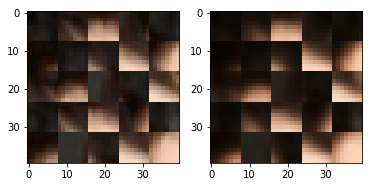

EPO: 31, recon_loss: 0.0052, total_loss: 0.0106
EPO: 31, recon_loss: 0.0031, total_loss: 0.0062
EPO: 31, recon_loss: 0.0045, total_loss: 0.0091
EPO: 31, recon_loss: 0.0131, total_loss: 0.0227
EPO: 31, recon_loss: 0.0075, total_loss: 0.0153
EPO: 31, recon_loss: 0.0127, total_loss: 0.0224
EPO: 31, recon_loss: 0.0080, total_loss: 0.0158
EPO: 31, recon_loss: 0.0070, total_loss: 0.0149
EPO: 31, recon_loss: 0.0027, total_loss: 0.0090
EPO: 31, recon_loss: 0.0031, total_loss: 0.0076
######### what? the reconstruction psnr is: 31.0207


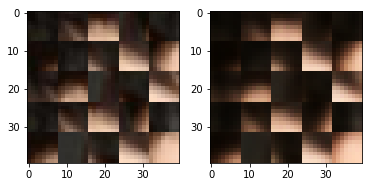

EPO: 31, recon_loss: 0.0044, total_loss: 0.0112
EPO: 31, recon_loss: 0.0053, total_loss: 0.0098
EPO: 31, recon_loss: 0.0053, total_loss: 0.0128
EPO: 31, recon_loss: 0.0034, total_loss: 0.0120
EPO: 31, recon_loss: 0.0013, total_loss: 0.0065
EPO: 31, recon_loss: 0.0057, total_loss: 0.0122
EPO: 31, recon_loss: 0.0037, total_loss: 0.0089
EPO: 31, recon_loss: 0.0033, total_loss: 0.0091
EPO: 31, recon_loss: 0.0064, total_loss: 0.0162
EPO: 31, recon_loss: 0.0052, total_loss: 0.0157
######### what? the reconstruction psnr is: 30.6127


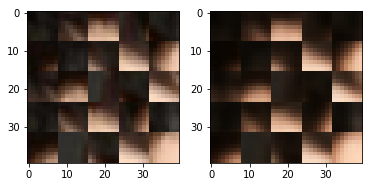

EPO: 31, recon_loss: 0.0111, total_loss: 0.0236
EPO: 31, recon_loss: 0.0101, total_loss: 0.0221
EPO: 31, recon_loss: 0.0051, total_loss: 0.0151
EPO: 31, recon_loss: 0.0166, total_loss: 0.0295
EPO: 31, recon_loss: 0.0054, total_loss: 0.0155
EPO: 31, recon_loss: 0.0088, total_loss: 0.0207
EPO: 31, recon_loss: 0.0128, total_loss: 0.0248
EPO: 31, recon_loss: 0.0077, total_loss: 0.0199
EPO: 31, recon_loss: 0.0091, total_loss: 0.0197
EPO: 31, recon_loss: 0.0018, total_loss: 0.0106
######### what? the reconstruction psnr is: 30.5238


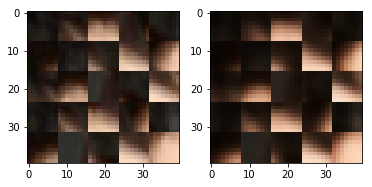

EPO: 31, recon_loss: 0.0101, total_loss: 0.0208
EPO: 31, recon_loss: 0.0131, total_loss: 0.0201
EPO: 31, recon_loss: 0.0035, total_loss: 0.0074
EPO: 31, recon_loss: 0.0030, total_loss: 0.0065
EPO: 31, recon_loss: 0.0018, total_loss: 0.0060
EPO: 31, recon_loss: 0.0031, total_loss: 0.0092
EPO: 31, recon_loss: 0.0054, total_loss: 0.0118
EPO: 31, recon_loss: 0.0037, total_loss: 0.0105
EPO: 31, recon_loss: 0.0067, total_loss: 0.0144
EPO: 31, recon_loss: 0.0005, total_loss: 0.0023
######### what? the reconstruction psnr is: 31.2022


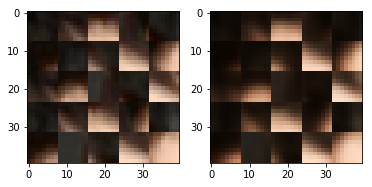

EPO: 31, recon_loss: 0.0006, total_loss: 0.0025
EPO: 31, recon_loss: 0.0015, total_loss: 0.0035
EPO: 31, recon_loss: 0.0007, total_loss: 0.0021
EPO: 31, recon_loss: 0.0022, total_loss: 0.0048
EPO: 31, recon_loss: 0.0024, total_loss: 0.0073
EPO: 31, recon_loss: 0.0030, total_loss: 0.0073
EPO: 31, recon_loss: 0.0051, total_loss: 0.0108
EPO: 31, recon_loss: 0.0023, total_loss: 0.0050
EPO: 31, recon_loss: 0.0040, total_loss: 0.0069
EPO: 31, recon_loss: 0.0053, total_loss: 0.0139
######### what? the reconstruction psnr is: 30.9581


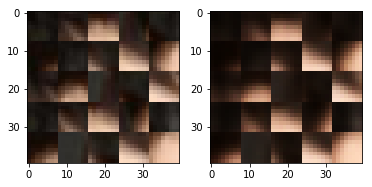

EPO: 31, recon_loss: 0.0087, total_loss: 0.0191
EPO: 31, recon_loss: 0.0060, total_loss: 0.0155
EPO: 31, recon_loss: 0.0045, total_loss: 0.0110
EPO: 31, recon_loss: 0.0052, total_loss: 0.0102
EPO: 31, recon_loss: 0.0033, total_loss: 0.0084
EPO: 31, recon_loss: 0.0028, total_loss: 0.0062
EPO: 31, recon_loss: 0.0045, total_loss: 0.0094
EPO: 31, recon_loss: 0.0020, total_loss: 0.0047
EPO: 31, recon_loss: 0.0028, total_loss: 0.0065
EPO: 31, recon_loss: 0.0030, total_loss: 0.0127
######### what? the reconstruction psnr is: 31.2198


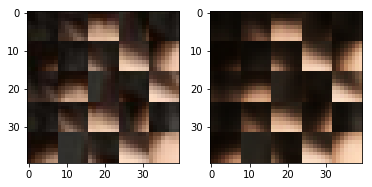

EPO: 31, recon_loss: 0.0010, total_loss: 0.0047
EPO: 31, recon_loss: 0.0060, total_loss: 0.0128
EPO: 31, recon_loss: 0.0037, total_loss: 0.0080
EPO: 31, recon_loss: 0.0038, total_loss: 0.0090
EPO: 31, recon_loss: 0.0014, total_loss: 0.0035
EPO: 31, recon_loss: 0.0011, total_loss: 0.0033
EPO: 31, recon_loss: 0.0025, total_loss: 0.0059
EPO: 31, recon_loss: 0.0010, total_loss: 0.0035
EPO: 31, recon_loss: 0.0013, total_loss: 0.0033
EPO: 31, recon_loss: 0.0029, total_loss: 0.0077
######### what? the reconstruction psnr is: 30.9701


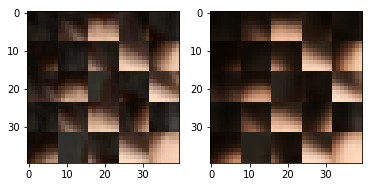

EPO: 31, recon_loss: 0.0020, total_loss: 0.0056
EPO: 31, recon_loss: 0.0064, total_loss: 0.0120
EPO: 31, recon_loss: 0.0031, total_loss: 0.0079
EPO: 31, recon_loss: 0.0025, total_loss: 0.0064
EPO: 31, recon_loss: 0.0028, total_loss: 0.0118
EPO: 31, recon_loss: 0.0032, total_loss: 0.0096
EPO: 31, recon_loss: 0.0097, total_loss: 0.0180
EPO: 31, recon_loss: 0.0040, total_loss: 0.0092
EPO: 31, recon_loss: 0.0053, total_loss: 0.0117
EPO: 31, recon_loss: 0.0016, total_loss: 0.0073
######### what? the reconstruction psnr is: 31.1259


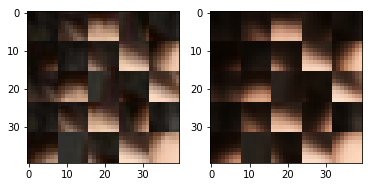

EPO: 31, recon_loss: 0.0005, total_loss: 0.0030
EPO: 31, recon_loss: 0.0035, total_loss: 0.0087
EPO: 31, recon_loss: 0.0046, total_loss: 0.0085
EPO: 31, recon_loss: 0.0041, total_loss: 0.0092
EPO: 31, recon_loss: 0.0046, total_loss: 0.0105
EPO: 31, recon_loss: 0.0064, total_loss: 0.0124
EPO: 31, recon_loss: 0.0050, total_loss: 0.0117
EPO: 31, recon_loss: 0.0047, total_loss: 0.0105
EPO: 31, recon_loss: 0.0016, total_loss: 0.0050
EPO: 31, recon_loss: 0.0058, total_loss: 0.0120
######### what? the reconstruction psnr is: 31.1209


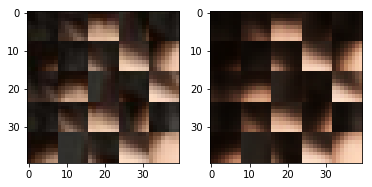

EPO: 31, recon_loss: 0.0012, total_loss: 0.0045
EPO: 31, recon_loss: 0.0056, total_loss: 0.0113
EPO: 31, recon_loss: 0.0058, total_loss: 0.0118
EPO: 31, recon_loss: 0.0028, total_loss: 0.0068
EPO: 31, recon_loss: 0.0030, total_loss: 0.0071
EPO: 31, recon_loss: 0.0035, total_loss: 0.0086
EPO: 31, recon_loss: 0.0032, total_loss: 0.0086
EPO: 31, recon_loss: 0.0071, total_loss: 0.0122
EPO: 31, recon_loss: 0.0042, total_loss: 0.0107
EPO: 31, recon_loss: 0.0064, total_loss: 0.0120
######### what? the reconstruction psnr is: 31.2894


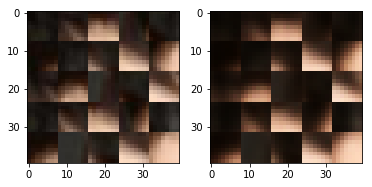

EPO: 31, recon_loss: 0.0036, total_loss: 0.0085
EPO: 31, recon_loss: 0.0013, total_loss: 0.0042
EPO: 31, recon_loss: 0.0035, total_loss: 0.0072
EPO: 31, recon_loss: 0.0031, total_loss: 0.0075
EPO: 31, recon_loss: 0.0053, total_loss: 0.0112
EPO: 31, recon_loss: 0.0032, total_loss: 0.0088
EPO: 31, recon_loss: 0.0035, total_loss: 0.0091
EPO: 31, recon_loss: 0.0098, total_loss: 0.0178
EPO: 31, recon_loss: 0.0030, total_loss: 0.0088
EPO: 31, recon_loss: 0.0079, total_loss: 0.0167
######### what? the reconstruction psnr is: 31.2169


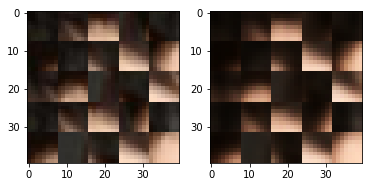

EPO: 31, recon_loss: 0.0023, total_loss: 0.0070
EPO: 31, recon_loss: 0.0014, total_loss: 0.0056
EPO: 31, recon_loss: 0.0059, total_loss: 0.0138
EPO: 31, recon_loss: 0.0028, total_loss: 0.0078
EPO: 31, recon_loss: 0.0068, total_loss: 0.0131
EPO: 31, recon_loss: 0.0020, total_loss: 0.0035
EPO: 31, recon_loss: 0.0015, total_loss: 0.0032
EPO: 31, recon_loss: 0.0041, total_loss: 0.0078
EPO: 31, recon_loss: 0.0016, total_loss: 0.0053
EPO: 31, recon_loss: 0.0030, total_loss: 0.0078
######### what? the reconstruction psnr is: 31.1732


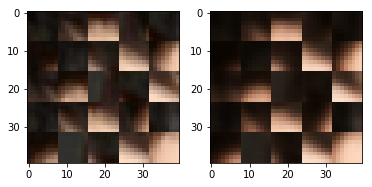

EPO: 31, recon_loss: 0.0098, total_loss: 0.0219
EPO: 31, recon_loss: 0.0073, total_loss: 0.0176
EPO: 31, recon_loss: 0.0112, total_loss: 0.0257
EPO: 31, recon_loss: 0.0055, total_loss: 0.0158
EPO: 31, recon_loss: 0.0094, total_loss: 0.0238
EPO: 31, recon_loss: 0.0019, total_loss: 0.0078
EPO: 31, recon_loss: 0.0036, total_loss: 0.0085
EPO: 31, recon_loss: 0.0057, total_loss: 0.0166
EPO: 31, recon_loss: 0.0032, total_loss: 0.0101
EPO: 31, recon_loss: 0.0033, total_loss: 0.0092
######### what? the reconstruction psnr is: 31.4357


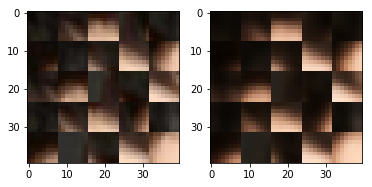

EPO: 31, recon_loss: 0.0035, total_loss: 0.0134
EPO: 31, recon_loss: 0.0039, total_loss: 0.0122
EPO: 31, recon_loss: 0.0087, total_loss: 0.0178
EPO: 31, recon_loss: 0.0022, total_loss: 0.0077
EPO: 31, recon_loss: 0.0023, total_loss: 0.0072
EPO: 31, recon_loss: 0.0043, total_loss: 0.0111
EPO: 31, recon_loss: 0.0016, total_loss: 0.0069
EPO: 31, recon_loss: 0.0080, total_loss: 0.0157
EPO: 31, recon_loss: 0.0020, total_loss: 0.0072
EPO: 31, recon_loss: 0.0027, total_loss: 0.0078
######### what? the reconstruction psnr is: 31.4107


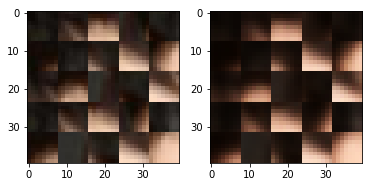

EPO: 31, recon_loss: 0.0038, total_loss: 0.0077
EPO: 31, recon_loss: 0.0020, total_loss: 0.0072
EPO: 31, recon_loss: 0.0086, total_loss: 0.0163
EPO: 31, recon_loss: 0.0044, total_loss: 0.0118
EPO: 31, recon_loss: 0.0038, total_loss: 0.0095
EPO: 31, recon_loss: 0.0041, total_loss: 0.0157
EPO: 31, recon_loss: 0.0012, total_loss: 0.0058
EPO: 31, recon_loss: 0.0061, total_loss: 0.0156
EPO: 31, recon_loss: 0.0038, total_loss: 0.0073
EPO: 31, recon_loss: 0.0036, total_loss: 0.0086
######### what? the reconstruction psnr is: 31.3138


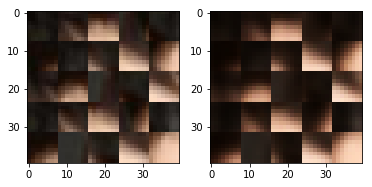

EPO: 31, recon_loss: 0.0030, total_loss: 0.0099
EPO: 31, recon_loss: 0.0016, total_loss: 0.0063
EPO: 31, recon_loss: 0.0030, total_loss: 0.0095
EPO: 31, recon_loss: 0.0016, total_loss: 0.0056
EPO: 31, recon_loss: 0.0027, total_loss: 0.0067
EPO: 31, recon_loss: 0.0061, total_loss: 0.0143
EPO: 31, recon_loss: 0.0096, total_loss: 0.0201
EPO: 31, recon_loss: 0.0049, total_loss: 0.0120
EPO: 31, recon_loss: 0.0054, total_loss: 0.0123
EPO: 31, recon_loss: 0.0056, total_loss: 0.0129
######### what? the reconstruction psnr is: 30.8392


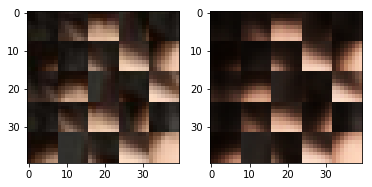

EPO: 31, recon_loss: 0.0030, total_loss: 0.0068
EPO: 31, recon_loss: 0.0038, total_loss: 0.0127
EPO: 31, recon_loss: 0.0035, total_loss: 0.0104
EPO: 31, recon_loss: 0.0052, total_loss: 0.0123
EPO: 31, recon_loss: 0.0034, total_loss: 0.0094
EPO: 31, recon_loss: 0.0070, total_loss: 0.0142
EPO: 31, recon_loss: 0.0008, total_loss: 0.0023
EPO: 31, recon_loss: 0.0016, total_loss: 0.0042
EPO: 31, recon_loss: 0.0031, total_loss: 0.0056
EPO: 31, recon_loss: 0.0012, total_loss: 0.0030
######### what? the reconstruction psnr is: 31.0147


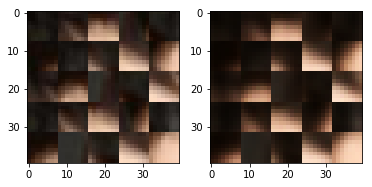

EPO: 31, recon_loss: 0.0029, total_loss: 0.0060
EPO: 31, recon_loss: 0.0041, total_loss: 0.0102
EPO: 31, recon_loss: 0.0028, total_loss: 0.0078
EPO: 31, recon_loss: 0.0036, total_loss: 0.0087
EPO: 31, recon_loss: 0.0024, total_loss: 0.0060
EPO: 31, recon_loss: 0.0034, total_loss: 0.0073
EPO: 31, recon_loss: 0.0041, total_loss: 0.0101
EPO: 31, recon_loss: 0.0037, total_loss: 0.0099
EPO: 31, recon_loss: 0.0081, total_loss: 0.0130
EPO: 31, recon_loss: 0.0042, total_loss: 0.0087
######### what? the reconstruction psnr is: 30.6096


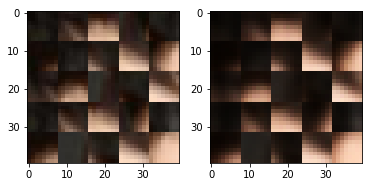

EPO: 31, recon_loss: 0.0065, total_loss: 0.0113
EPO: 31, recon_loss: 0.0108, total_loss: 0.0215
EPO: 31, recon_loss: 0.0097, total_loss: 0.0169
EPO: 31, recon_loss: 0.0065, total_loss: 0.0117
EPO: 31, recon_loss: 0.0045, total_loss: 0.0082
EPO: 31, recon_loss: 0.0090, total_loss: 0.0131
EPO: 31, recon_loss: 0.0013, total_loss: 0.0051
EPO: 31, recon_loss: 0.0018, total_loss: 0.0062
EPO: 31, recon_loss: 0.0046, total_loss: 0.0084
EPO: 31, recon_loss: 0.0031, total_loss: 0.0087
######### what? the reconstruction psnr is: 30.2423


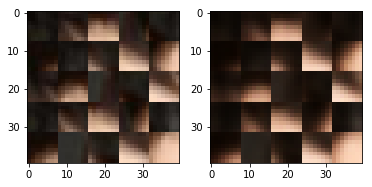

EPO: 31, recon_loss: 0.0048, total_loss: 0.0093
EPO: 31, recon_loss: 0.0030, total_loss: 0.0128
EPO: 31, recon_loss: 0.0013, total_loss: 0.0057
EPO: 31, recon_loss: 0.0046, total_loss: 0.0096
EPO: 31, recon_loss: 0.0008, total_loss: 0.0026
EPO: 31, recon_loss: 0.0014, total_loss: 0.0029
EPO: 31, recon_loss: 0.0048, total_loss: 0.0107
EPO: 31, recon_loss: 0.0049, total_loss: 0.0109
EPO: 31, recon_loss: 0.0132, total_loss: 0.0193
EPO: 31, recon_loss: 0.0094, total_loss: 0.0150
######### what? the reconstruction psnr is: 30.5090


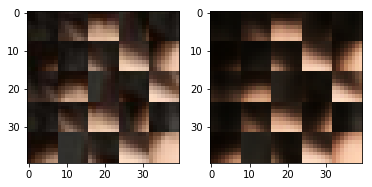

EPO: 31, recon_loss: 0.0081, total_loss: 0.0128
EPO: 32, recon_loss: 0.0030, total_loss: 0.0062
EPO: 32, recon_loss: 0.0017, total_loss: 0.0036
EPO: 32, recon_loss: 0.0067, total_loss: 0.0100
EPO: 32, recon_loss: 0.0018, total_loss: 0.0043
EPO: 32, recon_loss: 0.0021, total_loss: 0.0043
EPO: 32, recon_loss: 0.0025, total_loss: 0.0098
EPO: 32, recon_loss: 0.0015, total_loss: 0.0057
EPO: 32, recon_loss: 0.0027, total_loss: 0.0072
EPO: 32, recon_loss: 0.0023, total_loss: 0.0048
######### what? the reconstruction psnr is: 31.2512


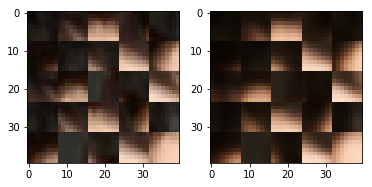

EPO: 32, recon_loss: 0.0050, total_loss: 0.0096
EPO: 32, recon_loss: 0.0022, total_loss: 0.0089
EPO: 32, recon_loss: 0.0016, total_loss: 0.0055
EPO: 32, recon_loss: 0.0025, total_loss: 0.0074
EPO: 32, recon_loss: 0.0020, total_loss: 0.0046
EPO: 32, recon_loss: 0.0029, total_loss: 0.0066
EPO: 32, recon_loss: 0.0029, total_loss: 0.0077
EPO: 32, recon_loss: 0.0033, total_loss: 0.0084
EPO: 32, recon_loss: 0.0033, total_loss: 0.0076
EPO: 32, recon_loss: 0.0030, total_loss: 0.0075
######### what? the reconstruction psnr is: 31.3707


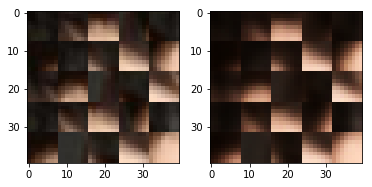

EPO: 32, recon_loss: 0.0024, total_loss: 0.0058
EPO: 32, recon_loss: 0.0029, total_loss: 0.0059
EPO: 32, recon_loss: 0.0019, total_loss: 0.0047
EPO: 32, recon_loss: 0.0032, total_loss: 0.0072
EPO: 32, recon_loss: 0.0060, total_loss: 0.0102
EPO: 32, recon_loss: 0.0020, total_loss: 0.0043
EPO: 32, recon_loss: 0.0043, total_loss: 0.0088
EPO: 32, recon_loss: 0.0033, total_loss: 0.0092
EPO: 32, recon_loss: 0.0033, total_loss: 0.0091
EPO: 32, recon_loss: 0.0070, total_loss: 0.0135
######### what? the reconstruction psnr is: 30.8513


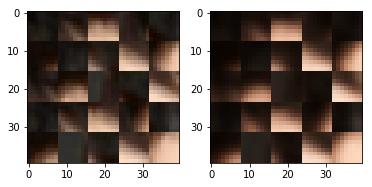

EPO: 32, recon_loss: 0.0063, total_loss: 0.0137
EPO: 32, recon_loss: 0.0066, total_loss: 0.0116
EPO: 32, recon_loss: 0.0028, total_loss: 0.0088
EPO: 32, recon_loss: 0.0023, total_loss: 0.0078
EPO: 32, recon_loss: 0.0043, total_loss: 0.0084
EPO: 32, recon_loss: 0.0031, total_loss: 0.0058
EPO: 32, recon_loss: 0.0038, total_loss: 0.0084
EPO: 32, recon_loss: 0.0010, total_loss: 0.0025
EPO: 32, recon_loss: 0.0024, total_loss: 0.0060
EPO: 32, recon_loss: 0.0046, total_loss: 0.0084
######### what? the reconstruction psnr is: 30.8716


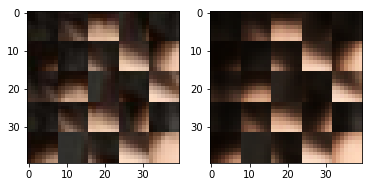

EPO: 32, recon_loss: 0.0029, total_loss: 0.0069
EPO: 32, recon_loss: 0.0050, total_loss: 0.0112
EPO: 32, recon_loss: 0.0013, total_loss: 0.0072
EPO: 32, recon_loss: 0.0015, total_loss: 0.0069
EPO: 32, recon_loss: 0.0049, total_loss: 0.0099
EPO: 32, recon_loss: 0.0011, total_loss: 0.0045
EPO: 32, recon_loss: 0.0047, total_loss: 0.0100
EPO: 32, recon_loss: 0.0066, total_loss: 0.0185
EPO: 32, recon_loss: 0.0024, total_loss: 0.0071
EPO: 32, recon_loss: 0.0066, total_loss: 0.0120
######### what? the reconstruction psnr is: 31.3056


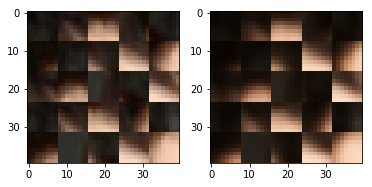

EPO: 32, recon_loss: 0.0021, total_loss: 0.0048
EPO: 32, recon_loss: 0.0033, total_loss: 0.0066
EPO: 32, recon_loss: 0.0052, total_loss: 0.0109
EPO: 32, recon_loss: 0.0020, total_loss: 0.0052
EPO: 32, recon_loss: 0.0050, total_loss: 0.0103
EPO: 32, recon_loss: 0.0030, total_loss: 0.0060
EPO: 32, recon_loss: 0.0052, total_loss: 0.0111
EPO: 32, recon_loss: 0.0080, total_loss: 0.0155
EPO: 32, recon_loss: 0.0082, total_loss: 0.0164
EPO: 32, recon_loss: 0.0161, total_loss: 0.0262
######### what? the reconstruction psnr is: 30.8628


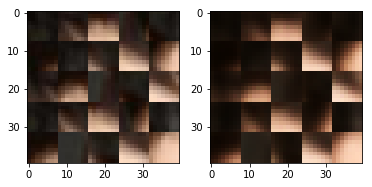

EPO: 32, recon_loss: 0.0095, total_loss: 0.0180
EPO: 32, recon_loss: 0.0072, total_loss: 0.0145
EPO: 32, recon_loss: 0.0027, total_loss: 0.0084
EPO: 32, recon_loss: 0.0032, total_loss: 0.0082
EPO: 32, recon_loss: 0.0044, total_loss: 0.0103
EPO: 32, recon_loss: 0.0037, total_loss: 0.0082
EPO: 32, recon_loss: 0.0054, total_loss: 0.0121
EPO: 32, recon_loss: 0.0029, total_loss: 0.0097
EPO: 32, recon_loss: 0.0013, total_loss: 0.0064
EPO: 32, recon_loss: 0.0065, total_loss: 0.0121
######### what? the reconstruction psnr is: 30.9001


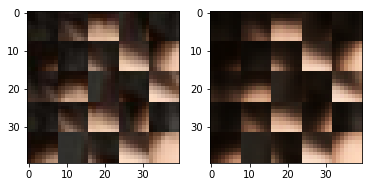

EPO: 32, recon_loss: 0.0028, total_loss: 0.0084
EPO: 32, recon_loss: 0.0032, total_loss: 0.0083
EPO: 32, recon_loss: 0.0068, total_loss: 0.0167
EPO: 32, recon_loss: 0.0055, total_loss: 0.0176
EPO: 32, recon_loss: 0.0116, total_loss: 0.0234
EPO: 32, recon_loss: 0.0066, total_loss: 0.0172
EPO: 32, recon_loss: 0.0053, total_loss: 0.0150
EPO: 32, recon_loss: 0.0092, total_loss: 0.0194
EPO: 32, recon_loss: 0.0055, total_loss: 0.0157
EPO: 32, recon_loss: 0.0132, total_loss: 0.0265
######### what? the reconstruction psnr is: 31.1047


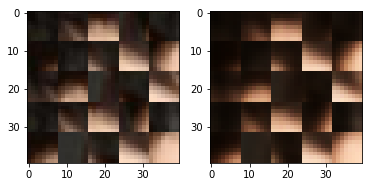

EPO: 32, recon_loss: 0.0094, total_loss: 0.0207
EPO: 32, recon_loss: 0.0079, total_loss: 0.0200
EPO: 32, recon_loss: 0.0028, total_loss: 0.0120
EPO: 32, recon_loss: 0.0026, total_loss: 0.0122
EPO: 32, recon_loss: 0.0132, total_loss: 0.0230
EPO: 32, recon_loss: 0.0146, total_loss: 0.0211
EPO: 32, recon_loss: 0.0023, total_loss: 0.0055
EPO: 32, recon_loss: 0.0032, total_loss: 0.0069
EPO: 32, recon_loss: 0.0020, total_loss: 0.0071
EPO: 32, recon_loss: 0.0040, total_loss: 0.0100
######### what? the reconstruction psnr is: 31.3299


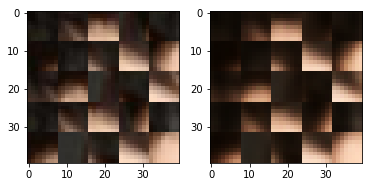

EPO: 32, recon_loss: 0.0046, total_loss: 0.0107
EPO: 32, recon_loss: 0.0039, total_loss: 0.0115
EPO: 32, recon_loss: 0.0085, total_loss: 0.0170
EPO: 32, recon_loss: 0.0005, total_loss: 0.0022
EPO: 32, recon_loss: 0.0007, total_loss: 0.0027
EPO: 32, recon_loss: 0.0013, total_loss: 0.0028
EPO: 32, recon_loss: 0.0008, total_loss: 0.0022
EPO: 32, recon_loss: 0.0026, total_loss: 0.0056
EPO: 32, recon_loss: 0.0022, total_loss: 0.0064
EPO: 32, recon_loss: 0.0034, total_loss: 0.0083
######### what? the reconstruction psnr is: 31.2552


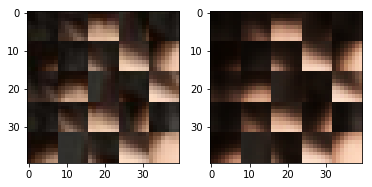

EPO: 32, recon_loss: 0.0055, total_loss: 0.0107
EPO: 32, recon_loss: 0.0023, total_loss: 0.0050
EPO: 32, recon_loss: 0.0060, total_loss: 0.0099
EPO: 32, recon_loss: 0.0054, total_loss: 0.0141
EPO: 32, recon_loss: 0.0077, total_loss: 0.0169
EPO: 32, recon_loss: 0.0058, total_loss: 0.0148
EPO: 32, recon_loss: 0.0043, total_loss: 0.0101
EPO: 32, recon_loss: 0.0058, total_loss: 0.0113
EPO: 32, recon_loss: 0.0036, total_loss: 0.0086
EPO: 32, recon_loss: 0.0029, total_loss: 0.0063
######### what? the reconstruction psnr is: 30.7952


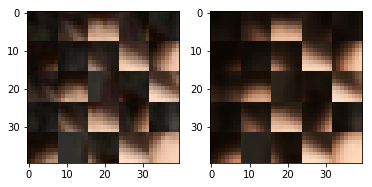

EPO: 32, recon_loss: 0.0047, total_loss: 0.0094
EPO: 32, recon_loss: 0.0029, total_loss: 0.0064
EPO: 32, recon_loss: 0.0040, total_loss: 0.0084
EPO: 32, recon_loss: 0.0028, total_loss: 0.0112
EPO: 32, recon_loss: 0.0016, total_loss: 0.0050
EPO: 32, recon_loss: 0.0052, total_loss: 0.0108
EPO: 32, recon_loss: 0.0039, total_loss: 0.0084
EPO: 32, recon_loss: 0.0048, total_loss: 0.0115
EPO: 32, recon_loss: 0.0014, total_loss: 0.0036
EPO: 32, recon_loss: 0.0013, total_loss: 0.0036
######### what? the reconstruction psnr is: 30.8677


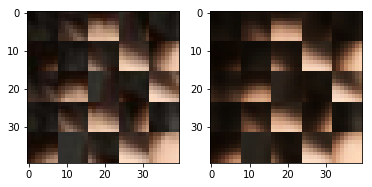

EPO: 32, recon_loss: 0.0024, total_loss: 0.0058
EPO: 32, recon_loss: 0.0009, total_loss: 0.0031
EPO: 32, recon_loss: 0.0013, total_loss: 0.0033
EPO: 32, recon_loss: 0.0028, total_loss: 0.0070
EPO: 32, recon_loss: 0.0019, total_loss: 0.0054
EPO: 32, recon_loss: 0.0076, total_loss: 0.0139
EPO: 32, recon_loss: 0.0036, total_loss: 0.0089
EPO: 32, recon_loss: 0.0025, total_loss: 0.0059
EPO: 32, recon_loss: 0.0023, total_loss: 0.0091
EPO: 32, recon_loss: 0.0026, total_loss: 0.0086
######### what? the reconstruction psnr is: 30.9321


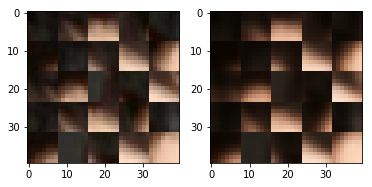

EPO: 32, recon_loss: 0.0106, total_loss: 0.0192
EPO: 32, recon_loss: 0.0033, total_loss: 0.0082
EPO: 32, recon_loss: 0.0076, total_loss: 0.0146
EPO: 32, recon_loss: 0.0011, total_loss: 0.0057
EPO: 32, recon_loss: 0.0005, total_loss: 0.0030
EPO: 32, recon_loss: 0.0065, total_loss: 0.0126
EPO: 32, recon_loss: 0.0040, total_loss: 0.0075
EPO: 32, recon_loss: 0.0041, total_loss: 0.0083
EPO: 32, recon_loss: 0.0047, total_loss: 0.0098
EPO: 32, recon_loss: 0.0057, total_loss: 0.0124
######### what? the reconstruction psnr is: 31.2408


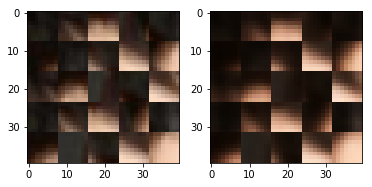

EPO: 32, recon_loss: 0.0059, total_loss: 0.0118
EPO: 32, recon_loss: 0.0027, total_loss: 0.0072
EPO: 32, recon_loss: 0.0018, total_loss: 0.0050
EPO: 32, recon_loss: 0.0027, total_loss: 0.0077
EPO: 32, recon_loss: 0.0011, total_loss: 0.0044
EPO: 32, recon_loss: 0.0067, total_loss: 0.0137
EPO: 32, recon_loss: 0.0019, total_loss: 0.0056
EPO: 32, recon_loss: 0.0024, total_loss: 0.0063
EPO: 32, recon_loss: 0.0047, total_loss: 0.0101
EPO: 32, recon_loss: 0.0031, total_loss: 0.0084
######### what? the reconstruction psnr is: 31.2633


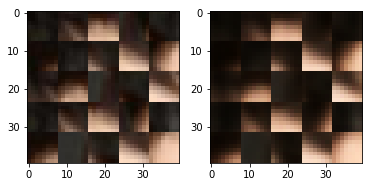

EPO: 32, recon_loss: 0.0035, total_loss: 0.0088
EPO: 32, recon_loss: 0.0055, total_loss: 0.0105
EPO: 32, recon_loss: 0.0045, total_loss: 0.0110
EPO: 32, recon_loss: 0.0051, total_loss: 0.0171
EPO: 32, recon_loss: 0.0028, total_loss: 0.0066
EPO: 32, recon_loss: 0.0021, total_loss: 0.0058
EPO: 32, recon_loss: 0.0024, total_loss: 0.0056
EPO: 32, recon_loss: 0.0043, total_loss: 0.0095
EPO: 32, recon_loss: 0.0040, total_loss: 0.0095
EPO: 32, recon_loss: 0.0022, total_loss: 0.0067
######### what? the reconstruction psnr is: 31.1163


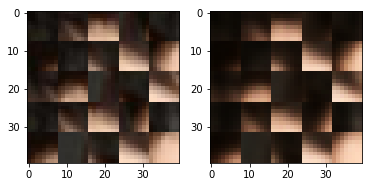

EPO: 32, recon_loss: 0.0054, total_loss: 0.0114
EPO: 32, recon_loss: 0.0078, total_loss: 0.0151
EPO: 32, recon_loss: 0.0037, total_loss: 0.0109
EPO: 32, recon_loss: 0.0081, total_loss: 0.0164
EPO: 32, recon_loss: 0.0019, total_loss: 0.0065
EPO: 32, recon_loss: 0.0022, total_loss: 0.0073
EPO: 32, recon_loss: 0.0051, total_loss: 0.0118
EPO: 32, recon_loss: 0.0033, total_loss: 0.0085
EPO: 32, recon_loss: 0.0066, total_loss: 0.0130
EPO: 32, recon_loss: 0.0019, total_loss: 0.0033
######### what? the reconstruction psnr is: 31.4163


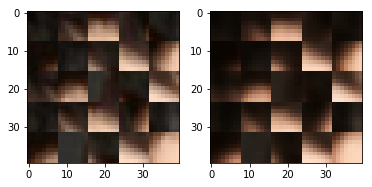

EPO: 32, recon_loss: 0.0016, total_loss: 0.0033
EPO: 32, recon_loss: 0.0045, total_loss: 0.0094
EPO: 32, recon_loss: 0.0016, total_loss: 0.0055
EPO: 32, recon_loss: 0.0031, total_loss: 0.0077
EPO: 32, recon_loss: 0.0107, total_loss: 0.0220
EPO: 32, recon_loss: 0.0056, total_loss: 0.0163
EPO: 32, recon_loss: 0.0139, total_loss: 0.0272
EPO: 32, recon_loss: 0.0062, total_loss: 0.0178
EPO: 32, recon_loss: 0.0094, total_loss: 0.0245
EPO: 32, recon_loss: 0.0022, total_loss: 0.0095
######### what? the reconstruction psnr is: 31.5963


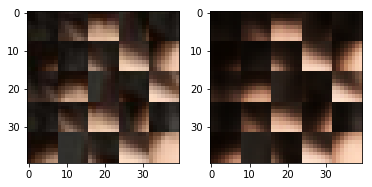

EPO: 32, recon_loss: 0.0039, total_loss: 0.0082
EPO: 32, recon_loss: 0.0047, total_loss: 0.0146
EPO: 32, recon_loss: 0.0031, total_loss: 0.0094
EPO: 32, recon_loss: 0.0035, total_loss: 0.0096
EPO: 32, recon_loss: 0.0037, total_loss: 0.0140
EPO: 32, recon_loss: 0.0038, total_loss: 0.0108
EPO: 32, recon_loss: 0.0105, total_loss: 0.0194
EPO: 32, recon_loss: 0.0022, total_loss: 0.0077
EPO: 32, recon_loss: 0.0023, total_loss: 0.0081
EPO: 32, recon_loss: 0.0035, total_loss: 0.0101
######### what? the reconstruction psnr is: 31.5344


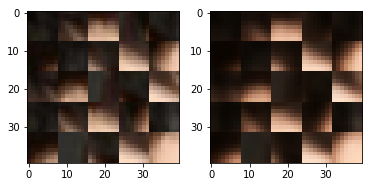

EPO: 32, recon_loss: 0.0014, total_loss: 0.0072
EPO: 32, recon_loss: 0.0094, total_loss: 0.0170
EPO: 32, recon_loss: 0.0019, total_loss: 0.0069
EPO: 32, recon_loss: 0.0033, total_loss: 0.0095
EPO: 32, recon_loss: 0.0028, total_loss: 0.0067
EPO: 32, recon_loss: 0.0025, total_loss: 0.0087
EPO: 32, recon_loss: 0.0109, total_loss: 0.0178
EPO: 32, recon_loss: 0.0032, total_loss: 0.0095
EPO: 32, recon_loss: 0.0034, total_loss: 0.0081
EPO: 32, recon_loss: 0.0034, total_loss: 0.0126
######### what? the reconstruction psnr is: 31.6897


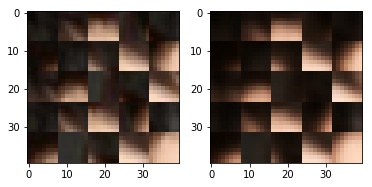

EPO: 32, recon_loss: 0.0013, total_loss: 0.0058
EPO: 32, recon_loss: 0.0081, total_loss: 0.0170
EPO: 32, recon_loss: 0.0019, total_loss: 0.0044
EPO: 32, recon_loss: 0.0043, total_loss: 0.0098
EPO: 32, recon_loss: 0.0025, total_loss: 0.0094
EPO: 32, recon_loss: 0.0015, total_loss: 0.0062
EPO: 32, recon_loss: 0.0035, total_loss: 0.0097
EPO: 32, recon_loss: 0.0013, total_loss: 0.0046
EPO: 32, recon_loss: 0.0029, total_loss: 0.0072
EPO: 32, recon_loss: 0.0098, total_loss: 0.0214
######### what? the reconstruction psnr is: 31.0544


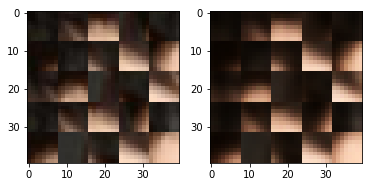

EPO: 32, recon_loss: 0.0079, total_loss: 0.0181
EPO: 32, recon_loss: 0.0038, total_loss: 0.0096
EPO: 32, recon_loss: 0.0043, total_loss: 0.0115
EPO: 32, recon_loss: 0.0040, total_loss: 0.0090
EPO: 32, recon_loss: 0.0065, total_loss: 0.0177
EPO: 32, recon_loss: 0.0028, total_loss: 0.0110
EPO: 32, recon_loss: 0.0034, total_loss: 0.0094
EPO: 32, recon_loss: 0.0039, total_loss: 0.0100
EPO: 32, recon_loss: 0.0048, total_loss: 0.0119
EPO: 32, recon_loss: 0.0024, total_loss: 0.0071
######### what? the reconstruction psnr is: 31.2071


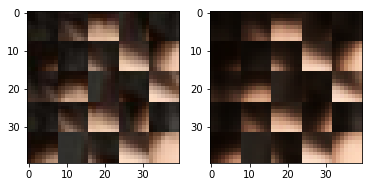

EPO: 32, recon_loss: 0.0007, total_loss: 0.0021
EPO: 32, recon_loss: 0.0021, total_loss: 0.0053
EPO: 32, recon_loss: 0.0020, total_loss: 0.0039
EPO: 32, recon_loss: 0.0014, total_loss: 0.0032
EPO: 32, recon_loss: 0.0036, total_loss: 0.0068
EPO: 32, recon_loss: 0.0032, total_loss: 0.0081
EPO: 32, recon_loss: 0.0039, total_loss: 0.0094
EPO: 32, recon_loss: 0.0031, total_loss: 0.0077
EPO: 32, recon_loss: 0.0026, total_loss: 0.0057
EPO: 32, recon_loss: 0.0041, total_loss: 0.0083
######### what? the reconstruction psnr is: 30.9377


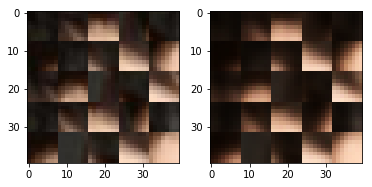

EPO: 32, recon_loss: 0.0037, total_loss: 0.0094
EPO: 32, recon_loss: 0.0051, total_loss: 0.0119
EPO: 32, recon_loss: 0.0063, total_loss: 0.0106
EPO: 32, recon_loss: 0.0047, total_loss: 0.0096
EPO: 32, recon_loss: 0.0084, total_loss: 0.0133
EPO: 32, recon_loss: 0.0100, total_loss: 0.0203
EPO: 32, recon_loss: 0.0073, total_loss: 0.0125
EPO: 32, recon_loss: 0.0066, total_loss: 0.0115
EPO: 32, recon_loss: 0.0047, total_loss: 0.0084
EPO: 32, recon_loss: 0.0111, total_loss: 0.0155
######### what? the reconstruction psnr is: 26.8504


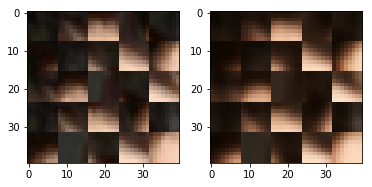

EPO: 32, recon_loss: 0.0011, total_loss: 0.0049
EPO: 32, recon_loss: 0.0019, total_loss: 0.0062
EPO: 32, recon_loss: 0.0055, total_loss: 0.0096
EPO: 32, recon_loss: 0.0039, total_loss: 0.0101
EPO: 32, recon_loss: 0.0084, total_loss: 0.0152
EPO: 32, recon_loss: 0.0025, total_loss: 0.0104
EPO: 32, recon_loss: 0.0020, total_loss: 0.0058
EPO: 32, recon_loss: 0.0043, total_loss: 0.0087
EPO: 32, recon_loss: 0.0008, total_loss: 0.0024
EPO: 32, recon_loss: 0.0021, total_loss: 0.0043
######### what? the reconstruction psnr is: 30.8462


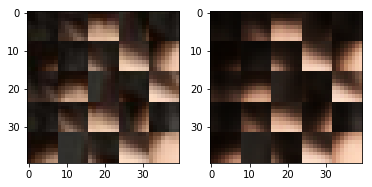

EPO: 32, recon_loss: 0.0049, total_loss: 0.0106
EPO: 32, recon_loss: 0.0056, total_loss: 0.0115
EPO: 32, recon_loss: 0.0151, total_loss: 0.0217
EPO: 32, recon_loss: 0.0104, total_loss: 0.0161
EPO: 32, recon_loss: 0.0085, total_loss: 0.0124
EPO: 33, recon_loss: 0.0022, total_loss: 0.0046
EPO: 33, recon_loss: 0.0017, total_loss: 0.0035
EPO: 33, recon_loss: 0.0077, total_loss: 0.0110
EPO: 33, recon_loss: 0.0015, total_loss: 0.0041
EPO: 33, recon_loss: 0.0035, total_loss: 0.0067
######### what? the reconstruction psnr is: 31.1087


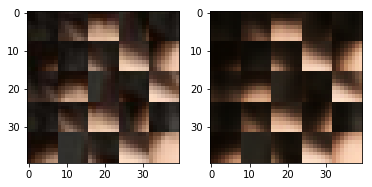

EPO: 33, recon_loss: 0.0025, total_loss: 0.0093
EPO: 33, recon_loss: 0.0019, total_loss: 0.0070
EPO: 33, recon_loss: 0.0042, total_loss: 0.0085
EPO: 33, recon_loss: 0.0023, total_loss: 0.0050
EPO: 33, recon_loss: 0.0047, total_loss: 0.0100
EPO: 33, recon_loss: 0.0020, total_loss: 0.0084
EPO: 33, recon_loss: 0.0010, total_loss: 0.0037
EPO: 33, recon_loss: 0.0028, total_loss: 0.0077
EPO: 33, recon_loss: 0.0017, total_loss: 0.0035
EPO: 33, recon_loss: 0.0033, total_loss: 0.0075
######### what? the reconstruction psnr is: 31.4135


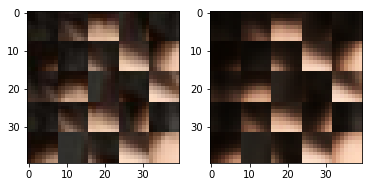

EPO: 33, recon_loss: 0.0029, total_loss: 0.0083
EPO: 33, recon_loss: 0.0027, total_loss: 0.0070
EPO: 33, recon_loss: 0.0034, total_loss: 0.0078
EPO: 33, recon_loss: 0.0025, total_loss: 0.0070
EPO: 33, recon_loss: 0.0022, total_loss: 0.0055
EPO: 33, recon_loss: 0.0034, total_loss: 0.0062
EPO: 33, recon_loss: 0.0018, total_loss: 0.0048
EPO: 33, recon_loss: 0.0048, total_loss: 0.0091
EPO: 33, recon_loss: 0.0028, total_loss: 0.0058
EPO: 33, recon_loss: 0.0030, total_loss: 0.0056
######### what? the reconstruction psnr is: 31.2767


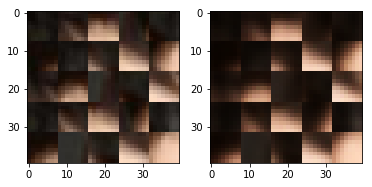

EPO: 33, recon_loss: 0.0078, total_loss: 0.0185
EPO: 33, recon_loss: 0.0029, total_loss: 0.0084
EPO: 33, recon_loss: 0.0041, total_loss: 0.0109
EPO: 33, recon_loss: 0.0070, total_loss: 0.0149
EPO: 33, recon_loss: 0.0040, total_loss: 0.0091
EPO: 33, recon_loss: 0.0031, total_loss: 0.0095
EPO: 33, recon_loss: 0.0021, total_loss: 0.0068
EPO: 33, recon_loss: 0.0032, total_loss: 0.0089
EPO: 33, recon_loss: 0.0027, total_loss: 0.0053
EPO: 33, recon_loss: 0.0033, total_loss: 0.0064
######### what? the reconstruction psnr is: 30.8496


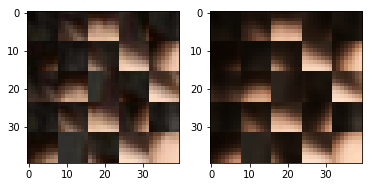

EPO: 33, recon_loss: 0.0012, total_loss: 0.0035
EPO: 33, recon_loss: 0.0016, total_loss: 0.0038
EPO: 33, recon_loss: 0.0018, total_loss: 0.0049
EPO: 33, recon_loss: 0.0045, total_loss: 0.0078
EPO: 33, recon_loss: 0.0034, total_loss: 0.0082
EPO: 33, recon_loss: 0.0049, total_loss: 0.0125
EPO: 33, recon_loss: 0.0015, total_loss: 0.0071
EPO: 33, recon_loss: 0.0017, total_loss: 0.0069
EPO: 33, recon_loss: 0.0035, total_loss: 0.0075
EPO: 33, recon_loss: 0.0013, total_loss: 0.0047
######### what? the reconstruction psnr is: 31.0436


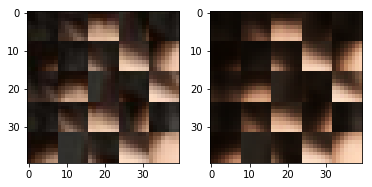

EPO: 33, recon_loss: 0.0052, total_loss: 0.0120
EPO: 33, recon_loss: 0.0067, total_loss: 0.0174
EPO: 33, recon_loss: 0.0031, total_loss: 0.0086
EPO: 33, recon_loss: 0.0060, total_loss: 0.0106
EPO: 33, recon_loss: 0.0022, total_loss: 0.0050
EPO: 33, recon_loss: 0.0045, total_loss: 0.0083
EPO: 33, recon_loss: 0.0036, total_loss: 0.0081
EPO: 33, recon_loss: 0.0029, total_loss: 0.0074
EPO: 33, recon_loss: 0.0052, total_loss: 0.0109
EPO: 33, recon_loss: 0.0041, total_loss: 0.0084
######### what? the reconstruction psnr is: 31.2510


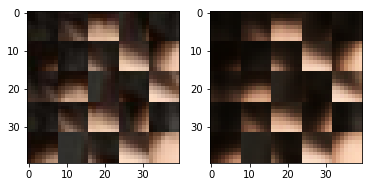

EPO: 33, recon_loss: 0.0072, total_loss: 0.0127
EPO: 33, recon_loss: 0.0077, total_loss: 0.0151
EPO: 33, recon_loss: 0.0090, total_loss: 0.0173
EPO: 33, recon_loss: 0.0184, total_loss: 0.0282
EPO: 33, recon_loss: 0.0088, total_loss: 0.0167
EPO: 33, recon_loss: 0.0080, total_loss: 0.0156
EPO: 33, recon_loss: 0.0037, total_loss: 0.0082
EPO: 33, recon_loss: 0.0033, total_loss: 0.0085
EPO: 33, recon_loss: 0.0047, total_loss: 0.0095
EPO: 33, recon_loss: 0.0048, total_loss: 0.0104
######### what? the reconstruction psnr is: 31.1885


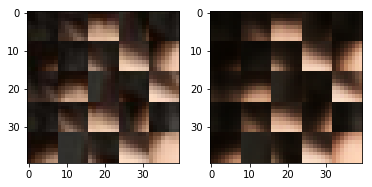

EPO: 33, recon_loss: 0.0066, total_loss: 0.0134
EPO: 33, recon_loss: 0.0022, total_loss: 0.0081
EPO: 33, recon_loss: 0.0022, total_loss: 0.0074
EPO: 33, recon_loss: 0.0078, total_loss: 0.0141
EPO: 33, recon_loss: 0.0023, total_loss: 0.0079
EPO: 33, recon_loss: 0.0031, total_loss: 0.0079
EPO: 33, recon_loss: 0.0067, total_loss: 0.0183
EPO: 33, recon_loss: 0.0049, total_loss: 0.0152
EPO: 33, recon_loss: 0.0151, total_loss: 0.0288
EPO: 33, recon_loss: 0.0046, total_loss: 0.0145
######### what? the reconstruction psnr is: 31.2713


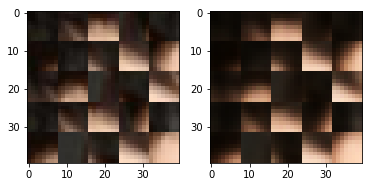

EPO: 33, recon_loss: 0.0056, total_loss: 0.0167
EPO: 33, recon_loss: 0.0091, total_loss: 0.0189
EPO: 33, recon_loss: 0.0050, total_loss: 0.0165
EPO: 33, recon_loss: 0.0143, total_loss: 0.0272
EPO: 33, recon_loss: 0.0072, total_loss: 0.0191
EPO: 33, recon_loss: 0.0076, total_loss: 0.0191
EPO: 33, recon_loss: 0.0029, total_loss: 0.0127
EPO: 33, recon_loss: 0.0028, total_loss: 0.0113
EPO: 33, recon_loss: 0.0172, total_loss: 0.0275
EPO: 33, recon_loss: 0.0170, total_loss: 0.0236
######### what? the reconstruction psnr is: 30.6147


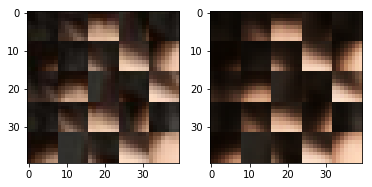

EPO: 33, recon_loss: 0.0025, total_loss: 0.0065
EPO: 33, recon_loss: 0.0024, total_loss: 0.0064
EPO: 33, recon_loss: 0.0021, total_loss: 0.0074
EPO: 33, recon_loss: 0.0063, total_loss: 0.0126
EPO: 33, recon_loss: 0.0035, total_loss: 0.0099
EPO: 33, recon_loss: 0.0043, total_loss: 0.0111
EPO: 33, recon_loss: 0.0017, total_loss: 0.0057
EPO: 33, recon_loss: 0.0005, total_loss: 0.0021
EPO: 33, recon_loss: 0.0007, total_loss: 0.0028
EPO: 33, recon_loss: 0.0009, total_loss: 0.0019
######### what? the reconstruction psnr is: 31.2486


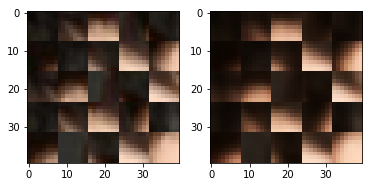

EPO: 33, recon_loss: 0.0009, total_loss: 0.0024
EPO: 33, recon_loss: 0.0049, total_loss: 0.0156
EPO: 33, recon_loss: 0.0023, total_loss: 0.0066
EPO: 33, recon_loss: 0.0037, total_loss: 0.0090
EPO: 33, recon_loss: 0.0039, total_loss: 0.0077
EPO: 33, recon_loss: 0.0032, total_loss: 0.0058
EPO: 33, recon_loss: 0.0068, total_loss: 0.0159
EPO: 33, recon_loss: 0.0053, total_loss: 0.0130
EPO: 33, recon_loss: 0.0074, total_loss: 0.0159
EPO: 33, recon_loss: 0.0056, total_loss: 0.0147
######### what? the reconstruction psnr is: 30.9747


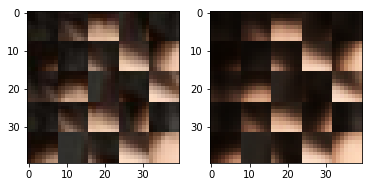

EPO: 33, recon_loss: 0.0033, total_loss: 0.0083
EPO: 33, recon_loss: 0.0043, total_loss: 0.0097
EPO: 33, recon_loss: 0.0031, total_loss: 0.0069
EPO: 33, recon_loss: 0.0032, total_loss: 0.0067
EPO: 33, recon_loss: 0.0034, total_loss: 0.0075
EPO: 33, recon_loss: 0.0027, total_loss: 0.0061
EPO: 33, recon_loss: 0.0038, total_loss: 0.0089
EPO: 33, recon_loss: 0.0025, total_loss: 0.0088
EPO: 33, recon_loss: 0.0024, total_loss: 0.0070
EPO: 33, recon_loss: 0.0060, total_loss: 0.0114
######### what? the reconstruction psnr is: 30.9211


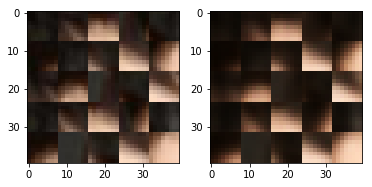

EPO: 33, recon_loss: 0.0058, total_loss: 0.0112
EPO: 33, recon_loss: 0.0037, total_loss: 0.0090
EPO: 33, recon_loss: 0.0011, total_loss: 0.0033
EPO: 33, recon_loss: 0.0016, total_loss: 0.0040
EPO: 33, recon_loss: 0.0023, total_loss: 0.0062
EPO: 33, recon_loss: 0.0012, total_loss: 0.0031
EPO: 33, recon_loss: 0.0020, total_loss: 0.0044
EPO: 33, recon_loss: 0.0024, total_loss: 0.0062
EPO: 33, recon_loss: 0.0030, total_loss: 0.0071
EPO: 33, recon_loss: 0.0061, total_loss: 0.0117
######### what? the reconstruction psnr is: 31.2495


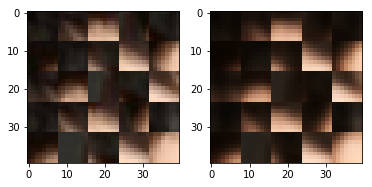

EPO: 33, recon_loss: 0.0034, total_loss: 0.0084
EPO: 33, recon_loss: 0.0025, total_loss: 0.0056
EPO: 33, recon_loss: 0.0019, total_loss: 0.0077
EPO: 33, recon_loss: 0.0025, total_loss: 0.0084
EPO: 33, recon_loss: 0.0103, total_loss: 0.0182
EPO: 33, recon_loss: 0.0028, total_loss: 0.0076
EPO: 33, recon_loss: 0.0108, total_loss: 0.0204
EPO: 33, recon_loss: 0.0008, total_loss: 0.0043
EPO: 33, recon_loss: 0.0006, total_loss: 0.0033
EPO: 33, recon_loss: 0.0090, total_loss: 0.0151
######### what? the reconstruction psnr is: 30.4085


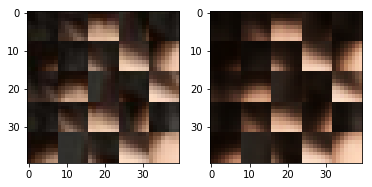

EPO: 33, recon_loss: 0.0030, total_loss: 0.0062
EPO: 33, recon_loss: 0.0037, total_loss: 0.0075
EPO: 33, recon_loss: 0.0043, total_loss: 0.0094
EPO: 33, recon_loss: 0.0051, total_loss: 0.0110
EPO: 33, recon_loss: 0.0074, total_loss: 0.0140
EPO: 33, recon_loss: 0.0020, total_loss: 0.0057
EPO: 33, recon_loss: 0.0030, total_loss: 0.0065
EPO: 33, recon_loss: 0.0019, total_loss: 0.0059
EPO: 33, recon_loss: 0.0013, total_loss: 0.0043
EPO: 33, recon_loss: 0.0058, total_loss: 0.0125
######### what? the reconstruction psnr is: 31.0400


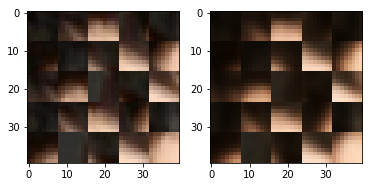

EPO: 33, recon_loss: 0.0013, total_loss: 0.0047
EPO: 33, recon_loss: 0.0022, total_loss: 0.0062
EPO: 33, recon_loss: 0.0048, total_loss: 0.0113
EPO: 33, recon_loss: 0.0028, total_loss: 0.0083
EPO: 33, recon_loss: 0.0049, total_loss: 0.0102
EPO: 33, recon_loss: 0.0035, total_loss: 0.0088
EPO: 33, recon_loss: 0.0045, total_loss: 0.0103
EPO: 33, recon_loss: 0.0062, total_loss: 0.0171
EPO: 33, recon_loss: 0.0016, total_loss: 0.0044
EPO: 33, recon_loss: 0.0033, total_loss: 0.0072
######### what? the reconstruction psnr is: 31.2990


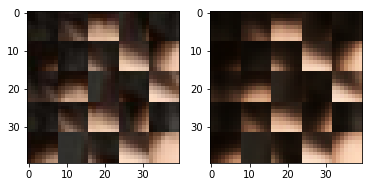

EPO: 33, recon_loss: 0.0025, total_loss: 0.0063
EPO: 33, recon_loss: 0.0032, total_loss: 0.0072
EPO: 33, recon_loss: 0.0032, total_loss: 0.0091
EPO: 33, recon_loss: 0.0021, total_loss: 0.0062
EPO: 33, recon_loss: 0.0057, total_loss: 0.0116
EPO: 33, recon_loss: 0.0061, total_loss: 0.0123
EPO: 33, recon_loss: 0.0045, total_loss: 0.0119
EPO: 33, recon_loss: 0.0051, total_loss: 0.0139
EPO: 33, recon_loss: 0.0022, total_loss: 0.0071
EPO: 33, recon_loss: 0.0024, total_loss: 0.0079
######### what? the reconstruction psnr is: 31.4902


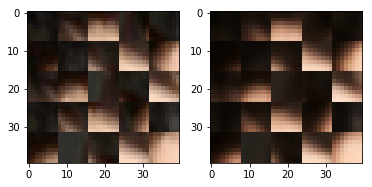

EPO: 33, recon_loss: 0.0045, total_loss: 0.0101
EPO: 33, recon_loss: 0.0037, total_loss: 0.0094
EPO: 33, recon_loss: 0.0029, total_loss: 0.0056
EPO: 33, recon_loss: 0.0018, total_loss: 0.0035
EPO: 33, recon_loss: 0.0013, total_loss: 0.0031
EPO: 33, recon_loss: 0.0029, total_loss: 0.0069
EPO: 33, recon_loss: 0.0020, total_loss: 0.0061
EPO: 33, recon_loss: 0.0037, total_loss: 0.0085
EPO: 33, recon_loss: 0.0085, total_loss: 0.0200
EPO: 33, recon_loss: 0.0050, total_loss: 0.0142
######### what? the reconstruction psnr is: 31.3081


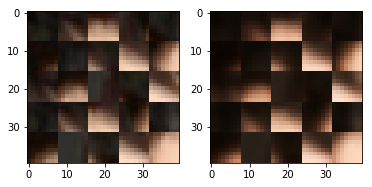

EPO: 33, recon_loss: 0.0107, total_loss: 0.0234
EPO: 33, recon_loss: 0.0073, total_loss: 0.0206
EPO: 33, recon_loss: 0.0088, total_loss: 0.0233
EPO: 33, recon_loss: 0.0020, total_loss: 0.0079
EPO: 33, recon_loss: 0.0072, total_loss: 0.0137
EPO: 33, recon_loss: 0.0039, total_loss: 0.0129
EPO: 33, recon_loss: 0.0032, total_loss: 0.0095
EPO: 33, recon_loss: 0.0039, total_loss: 0.0110
EPO: 33, recon_loss: 0.0038, total_loss: 0.0128
EPO: 33, recon_loss: 0.0048, total_loss: 0.0121
######### what? the reconstruction psnr is: 31.7037


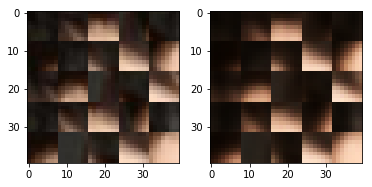

EPO: 33, recon_loss: 0.0078, total_loss: 0.0164
EPO: 33, recon_loss: 0.0029, total_loss: 0.0090
EPO: 33, recon_loss: 0.0034, total_loss: 0.0095
EPO: 33, recon_loss: 0.0027, total_loss: 0.0079
EPO: 33, recon_loss: 0.0019, total_loss: 0.0077
EPO: 33, recon_loss: 0.0079, total_loss: 0.0145
EPO: 33, recon_loss: 0.0020, total_loss: 0.0071
EPO: 33, recon_loss: 0.0032, total_loss: 0.0095
EPO: 33, recon_loss: 0.0023, total_loss: 0.0065
EPO: 33, recon_loss: 0.0030, total_loss: 0.0097
######### what? the reconstruction psnr is: 31.3217


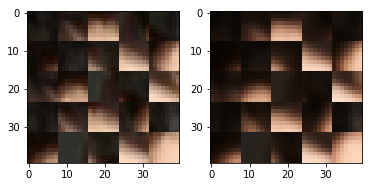

EPO: 33, recon_loss: 0.0098, total_loss: 0.0159
EPO: 33, recon_loss: 0.0034, total_loss: 0.0100
EPO: 33, recon_loss: 0.0051, total_loss: 0.0102
EPO: 33, recon_loss: 0.0021, total_loss: 0.0082
EPO: 33, recon_loss: 0.0017, total_loss: 0.0065
EPO: 33, recon_loss: 0.0073, total_loss: 0.0143
EPO: 33, recon_loss: 0.0022, total_loss: 0.0049
EPO: 33, recon_loss: 0.0050, total_loss: 0.0105
EPO: 33, recon_loss: 0.0021, total_loss: 0.0082
EPO: 33, recon_loss: 0.0014, total_loss: 0.0056
######### what? the reconstruction psnr is: 31.5305


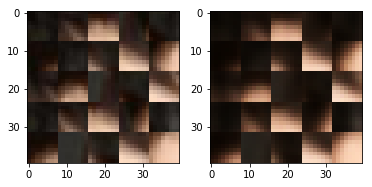

EPO: 33, recon_loss: 0.0032, total_loss: 0.0081
EPO: 33, recon_loss: 0.0014, total_loss: 0.0051
EPO: 33, recon_loss: 0.0027, total_loss: 0.0065
EPO: 33, recon_loss: 0.0083, total_loss: 0.0197
EPO: 33, recon_loss: 0.0075, total_loss: 0.0169
EPO: 33, recon_loss: 0.0040, total_loss: 0.0091
EPO: 33, recon_loss: 0.0041, total_loss: 0.0110
EPO: 33, recon_loss: 0.0033, total_loss: 0.0075
EPO: 33, recon_loss: 0.0059, total_loss: 0.0171
EPO: 33, recon_loss: 0.0026, total_loss: 0.0101
######### what? the reconstruction psnr is: 30.6950


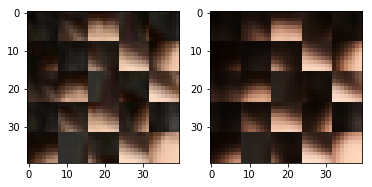

EPO: 33, recon_loss: 0.0052, total_loss: 0.0116
EPO: 33, recon_loss: 0.0031, total_loss: 0.0096
EPO: 33, recon_loss: 0.0041, total_loss: 0.0100
EPO: 33, recon_loss: 0.0022, total_loss: 0.0063
EPO: 33, recon_loss: 0.0006, total_loss: 0.0018
EPO: 33, recon_loss: 0.0031, total_loss: 0.0067
EPO: 33, recon_loss: 0.0013, total_loss: 0.0030
EPO: 33, recon_loss: 0.0015, total_loss: 0.0033
EPO: 33, recon_loss: 0.0030, total_loss: 0.0064
EPO: 33, recon_loss: 0.0028, total_loss: 0.0073
######### what? the reconstruction psnr is: 31.1705


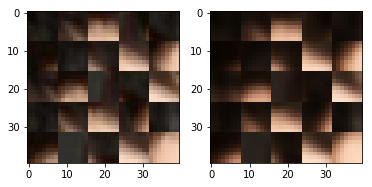

EPO: 33, recon_loss: 0.0046, total_loss: 0.0105
EPO: 33, recon_loss: 0.0027, total_loss: 0.0067
EPO: 33, recon_loss: 0.0029, total_loss: 0.0059
EPO: 33, recon_loss: 0.0056, total_loss: 0.0153
EPO: 33, recon_loss: 0.0048, total_loss: 0.0118
EPO: 33, recon_loss: 0.0047, total_loss: 0.0098
EPO: 33, recon_loss: 0.0056, total_loss: 0.0098
EPO: 33, recon_loss: 0.0046, total_loss: 0.0093
EPO: 33, recon_loss: 0.0112, total_loss: 0.0194
EPO: 33, recon_loss: 0.0131, total_loss: 0.0254
######### what? the reconstruction psnr is: 30.5926


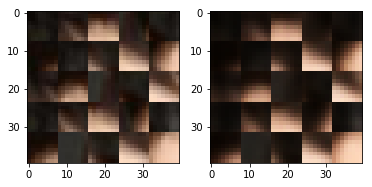

EPO: 33, recon_loss: 0.0048, total_loss: 0.0098
EPO: 33, recon_loss: 0.0050, total_loss: 0.0095
EPO: 33, recon_loss: 0.0056, total_loss: 0.0095
EPO: 33, recon_loss: 0.0131, total_loss: 0.0193
EPO: 33, recon_loss: 0.0010, total_loss: 0.0048
EPO: 33, recon_loss: 0.0023, total_loss: 0.0071
EPO: 33, recon_loss: 0.0054, total_loss: 0.0099
EPO: 33, recon_loss: 0.0042, total_loss: 0.0103
EPO: 33, recon_loss: 0.0097, total_loss: 0.0170
EPO: 33, recon_loss: 0.0016, total_loss: 0.0069
######### what? the reconstruction psnr is: 31.2485


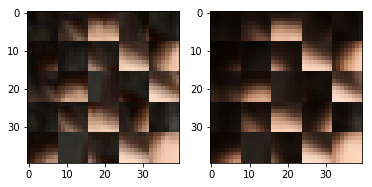

EPO: 33, recon_loss: 0.0023, total_loss: 0.0062
EPO: 33, recon_loss: 0.0049, total_loss: 0.0094
EPO: 33, recon_loss: 0.0012, total_loss: 0.0033
EPO: 33, recon_loss: 0.0026, total_loss: 0.0047
EPO: 33, recon_loss: 0.0044, total_loss: 0.0102
EPO: 33, recon_loss: 0.0066, total_loss: 0.0120
EPO: 33, recon_loss: 0.0124, total_loss: 0.0188
EPO: 33, recon_loss: 0.0111, total_loss: 0.0164
EPO: 33, recon_loss: 0.0107, total_loss: 0.0154
EPO: 34, recon_loss: 0.0021, total_loss: 0.0044
######### what? the reconstruction psnr is: 31.2287


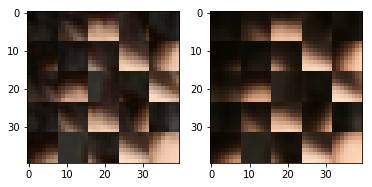

EPO: 34, recon_loss: 0.0016, total_loss: 0.0035
EPO: 34, recon_loss: 0.0079, total_loss: 0.0124
EPO: 34, recon_loss: 0.0020, total_loss: 0.0046
EPO: 34, recon_loss: 0.0039, total_loss: 0.0074
EPO: 34, recon_loss: 0.0024, total_loss: 0.0088
EPO: 34, recon_loss: 0.0025, total_loss: 0.0070
EPO: 34, recon_loss: 0.0042, total_loss: 0.0080
EPO: 34, recon_loss: 0.0031, total_loss: 0.0060
EPO: 34, recon_loss: 0.0052, total_loss: 0.0117
EPO: 34, recon_loss: 0.0018, total_loss: 0.0077
######### what? the reconstruction psnr is: 31.4750


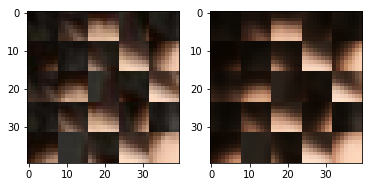

EPO: 34, recon_loss: 0.0009, total_loss: 0.0034
EPO: 34, recon_loss: 0.0030, total_loss: 0.0075
EPO: 34, recon_loss: 0.0019, total_loss: 0.0036
EPO: 34, recon_loss: 0.0043, total_loss: 0.0094
EPO: 34, recon_loss: 0.0027, total_loss: 0.0073
EPO: 34, recon_loss: 0.0026, total_loss: 0.0069
EPO: 34, recon_loss: 0.0035, total_loss: 0.0074
EPO: 34, recon_loss: 0.0025, total_loss: 0.0073
EPO: 34, recon_loss: 0.0026, total_loss: 0.0064
EPO: 34, recon_loss: 0.0028, total_loss: 0.0053
######### what? the reconstruction psnr is: 31.4945


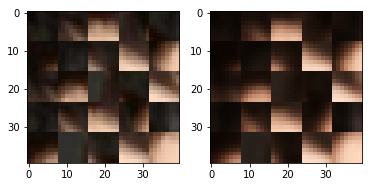

EPO: 34, recon_loss: 0.0019, total_loss: 0.0050
EPO: 34, recon_loss: 0.0058, total_loss: 0.0095
EPO: 34, recon_loss: 0.0021, total_loss: 0.0046
EPO: 34, recon_loss: 0.0029, total_loss: 0.0054
EPO: 34, recon_loss: 0.0060, total_loss: 0.0139
EPO: 34, recon_loss: 0.0023, total_loss: 0.0075
EPO: 34, recon_loss: 0.0054, total_loss: 0.0133
EPO: 34, recon_loss: 0.0062, total_loss: 0.0125
EPO: 34, recon_loss: 0.0050, total_loss: 0.0102
EPO: 34, recon_loss: 0.0039, total_loss: 0.0124
######### what? the reconstruction psnr is: 31.1269


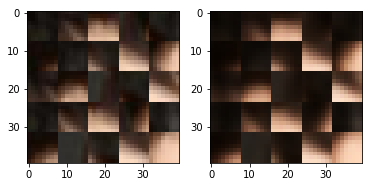

EPO: 34, recon_loss: 0.0017, total_loss: 0.0064
EPO: 34, recon_loss: 0.0045, total_loss: 0.0094
EPO: 34, recon_loss: 0.0022, total_loss: 0.0042
EPO: 34, recon_loss: 0.0018, total_loss: 0.0045
EPO: 34, recon_loss: 0.0014, total_loss: 0.0034
EPO: 34, recon_loss: 0.0014, total_loss: 0.0033
EPO: 34, recon_loss: 0.0024, total_loss: 0.0063
EPO: 34, recon_loss: 0.0027, total_loss: 0.0054
EPO: 34, recon_loss: 0.0040, total_loss: 0.0099
EPO: 34, recon_loss: 0.0014, total_loss: 0.0080
######### what? the reconstruction psnr is: 31.2614


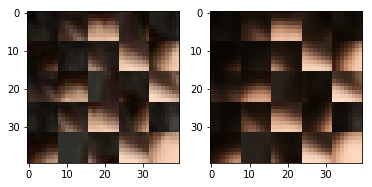

EPO: 34, recon_loss: 0.0013, total_loss: 0.0065
EPO: 34, recon_loss: 0.0020, total_loss: 0.0068
EPO: 34, recon_loss: 0.0026, total_loss: 0.0057
EPO: 34, recon_loss: 0.0024, total_loss: 0.0066
EPO: 34, recon_loss: 0.0046, total_loss: 0.0132
EPO: 34, recon_loss: 0.0030, total_loss: 0.0087
EPO: 34, recon_loss: 0.0046, total_loss: 0.0110
EPO: 34, recon_loss: 0.0042, total_loss: 0.0080
EPO: 34, recon_loss: 0.0027, total_loss: 0.0058
EPO: 34, recon_loss: 0.0068, total_loss: 0.0120
######### what? the reconstruction psnr is: 31.3846


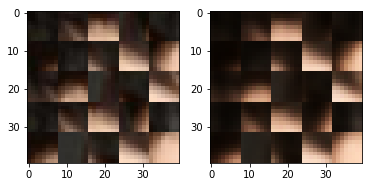

EPO: 34, recon_loss: 0.0029, total_loss: 0.0065
EPO: 34, recon_loss: 0.0035, total_loss: 0.0091
EPO: 34, recon_loss: 0.0046, total_loss: 0.0095
EPO: 34, recon_loss: 0.0036, total_loss: 0.0083
EPO: 34, recon_loss: 0.0114, total_loss: 0.0165
EPO: 34, recon_loss: 0.0079, total_loss: 0.0154
EPO: 34, recon_loss: 0.0097, total_loss: 0.0185
EPO: 34, recon_loss: 0.0163, total_loss: 0.0254
EPO: 34, recon_loss: 0.0089, total_loss: 0.0166
EPO: 34, recon_loss: 0.0088, total_loss: 0.0162
######### what? the reconstruction psnr is: 30.3141


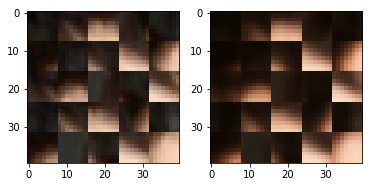

EPO: 34, recon_loss: 0.0034, total_loss: 0.0077
EPO: 34, recon_loss: 0.0040, total_loss: 0.0087
EPO: 34, recon_loss: 0.0057, total_loss: 0.0108
EPO: 34, recon_loss: 0.0063, total_loss: 0.0135
EPO: 34, recon_loss: 0.0063, total_loss: 0.0127
EPO: 34, recon_loss: 0.0023, total_loss: 0.0081
EPO: 34, recon_loss: 0.0037, total_loss: 0.0100
EPO: 34, recon_loss: 0.0068, total_loss: 0.0132
EPO: 34, recon_loss: 0.0024, total_loss: 0.0080
EPO: 34, recon_loss: 0.0035, total_loss: 0.0087
######### what? the reconstruction psnr is: 30.8721


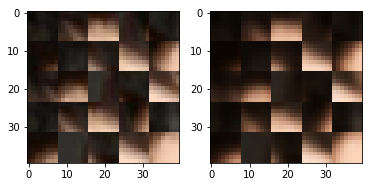

EPO: 34, recon_loss: 0.0054, total_loss: 0.0153
EPO: 34, recon_loss: 0.0054, total_loss: 0.0152
EPO: 34, recon_loss: 0.0150, total_loss: 0.0281
EPO: 34, recon_loss: 0.0049, total_loss: 0.0161
EPO: 34, recon_loss: 0.0065, total_loss: 0.0163
EPO: 34, recon_loss: 0.0070, total_loss: 0.0166
EPO: 34, recon_loss: 0.0046, total_loss: 0.0156
EPO: 34, recon_loss: 0.0168, total_loss: 0.0299
EPO: 34, recon_loss: 0.0075, total_loss: 0.0194
EPO: 34, recon_loss: 0.0078, total_loss: 0.0191
######### what? the reconstruction psnr is: 31.2784


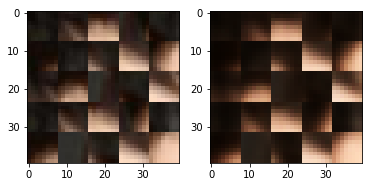

EPO: 34, recon_loss: 0.0017, total_loss: 0.0103
EPO: 34, recon_loss: 0.0053, total_loss: 0.0166
EPO: 34, recon_loss: 0.0190, total_loss: 0.0294
EPO: 34, recon_loss: 0.0130, total_loss: 0.0195
EPO: 34, recon_loss: 0.0027, total_loss: 0.0060
EPO: 34, recon_loss: 0.0018, total_loss: 0.0058
EPO: 34, recon_loss: 0.0025, total_loss: 0.0079
EPO: 34, recon_loss: 0.0064, total_loss: 0.0127
EPO: 34, recon_loss: 0.0032, total_loss: 0.0096
EPO: 34, recon_loss: 0.0051, total_loss: 0.0119
######### what? the reconstruction psnr is: 31.3224


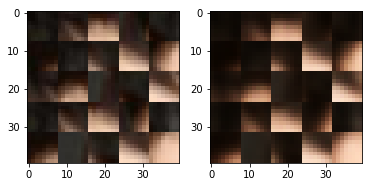

EPO: 34, recon_loss: 0.0010, total_loss: 0.0035
EPO: 34, recon_loss: 0.0005, total_loss: 0.0022
EPO: 34, recon_loss: 0.0010, total_loss: 0.0030
EPO: 34, recon_loss: 0.0007, total_loss: 0.0017
EPO: 34, recon_loss: 0.0008, total_loss: 0.0025
EPO: 34, recon_loss: 0.0046, total_loss: 0.0140
EPO: 34, recon_loss: 0.0018, total_loss: 0.0060
EPO: 34, recon_loss: 0.0037, total_loss: 0.0087
EPO: 34, recon_loss: 0.0022, total_loss: 0.0050
EPO: 34, recon_loss: 0.0028, total_loss: 0.0051
######### what? the reconstruction psnr is: 31.3025


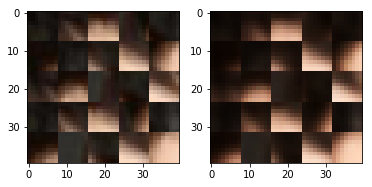

EPO: 34, recon_loss: 0.0061, total_loss: 0.0163
EPO: 34, recon_loss: 0.0051, total_loss: 0.0123
EPO: 34, recon_loss: 0.0062, total_loss: 0.0139
EPO: 34, recon_loss: 0.0059, total_loss: 0.0144
EPO: 34, recon_loss: 0.0036, total_loss: 0.0087
EPO: 34, recon_loss: 0.0043, total_loss: 0.0097
EPO: 34, recon_loss: 0.0030, total_loss: 0.0065
EPO: 34, recon_loss: 0.0029, total_loss: 0.0065
EPO: 34, recon_loss: 0.0026, total_loss: 0.0059
EPO: 34, recon_loss: 0.0032, total_loss: 0.0073
######### what? the reconstruction psnr is: 30.8674


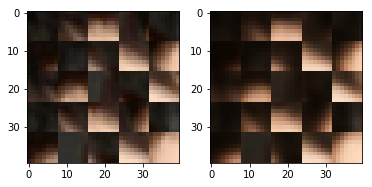

EPO: 34, recon_loss: 0.0024, total_loss: 0.0104
EPO: 34, recon_loss: 0.0015, total_loss: 0.0059
EPO: 34, recon_loss: 0.0033, total_loss: 0.0091
EPO: 34, recon_loss: 0.0049, total_loss: 0.0101
EPO: 34, recon_loss: 0.0034, total_loss: 0.0074
EPO: 34, recon_loss: 0.0027, total_loss: 0.0067
EPO: 34, recon_loss: 0.0009, total_loss: 0.0033
EPO: 34, recon_loss: 0.0017, total_loss: 0.0042
EPO: 34, recon_loss: 0.0023, total_loss: 0.0057
EPO: 34, recon_loss: 0.0015, total_loss: 0.0035
######### what? the reconstruction psnr is: 30.9661


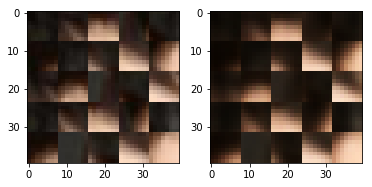

EPO: 34, recon_loss: 0.0025, total_loss: 0.0053
EPO: 34, recon_loss: 0.0019, total_loss: 0.0052
EPO: 34, recon_loss: 0.0029, total_loss: 0.0072
EPO: 34, recon_loss: 0.0048, total_loss: 0.0100
EPO: 34, recon_loss: 0.0038, total_loss: 0.0082
EPO: 34, recon_loss: 0.0022, total_loss: 0.0054
EPO: 34, recon_loss: 0.0025, total_loss: 0.0096
EPO: 34, recon_loss: 0.0054, total_loss: 0.0123
EPO: 34, recon_loss: 0.0105, total_loss: 0.0183
EPO: 34, recon_loss: 0.0030, total_loss: 0.0081
######### what? the reconstruction psnr is: 30.5435


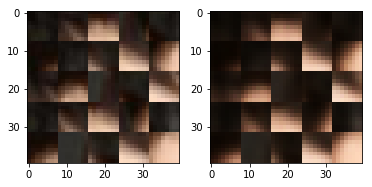

EPO: 34, recon_loss: 0.0115, total_loss: 0.0201
EPO: 34, recon_loss: 0.0007, total_loss: 0.0035
EPO: 34, recon_loss: 0.0012, total_loss: 0.0045
EPO: 34, recon_loss: 0.0087, total_loss: 0.0144
EPO: 34, recon_loss: 0.0023, total_loss: 0.0057
EPO: 34, recon_loss: 0.0036, total_loss: 0.0074
EPO: 34, recon_loss: 0.0038, total_loss: 0.0085
EPO: 34, recon_loss: 0.0043, total_loss: 0.0103
EPO: 34, recon_loss: 0.0079, total_loss: 0.0136
EPO: 34, recon_loss: 0.0019, total_loss: 0.0059
######### what? the reconstruction psnr is: 31.4092


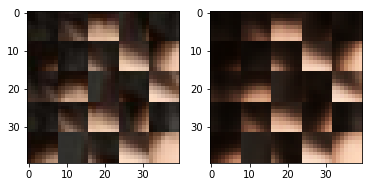

EPO: 34, recon_loss: 0.0045, total_loss: 0.0088
EPO: 34, recon_loss: 0.0018, total_loss: 0.0054
EPO: 34, recon_loss: 0.0033, total_loss: 0.0072
EPO: 34, recon_loss: 0.0068, total_loss: 0.0137
EPO: 34, recon_loss: 0.0017, total_loss: 0.0053
EPO: 34, recon_loss: 0.0026, total_loss: 0.0069
EPO: 34, recon_loss: 0.0039, total_loss: 0.0099
EPO: 34, recon_loss: 0.0026, total_loss: 0.0079
EPO: 34, recon_loss: 0.0071, total_loss: 0.0124
EPO: 34, recon_loss: 0.0035, total_loss: 0.0092
######### what? the reconstruction psnr is: 31.5483


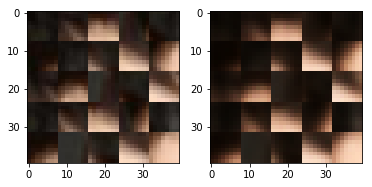

EPO: 34, recon_loss: 0.0052, total_loss: 0.0107
EPO: 34, recon_loss: 0.0064, total_loss: 0.0160
EPO: 34, recon_loss: 0.0010, total_loss: 0.0036
EPO: 34, recon_loss: 0.0046, total_loss: 0.0086
EPO: 34, recon_loss: 0.0021, total_loss: 0.0056
EPO: 34, recon_loss: 0.0033, total_loss: 0.0070
EPO: 34, recon_loss: 0.0032, total_loss: 0.0092
EPO: 34, recon_loss: 0.0021, total_loss: 0.0063
EPO: 34, recon_loss: 0.0074, total_loss: 0.0139
EPO: 34, recon_loss: 0.0029, total_loss: 0.0080
######### what? the reconstruction psnr is: 31.2121


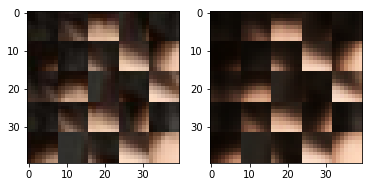

EPO: 34, recon_loss: 0.0055, total_loss: 0.0119
EPO: 34, recon_loss: 0.0041, total_loss: 0.0118
EPO: 34, recon_loss: 0.0016, total_loss: 0.0064
EPO: 34, recon_loss: 0.0039, total_loss: 0.0104
EPO: 34, recon_loss: 0.0020, total_loss: 0.0063
EPO: 34, recon_loss: 0.0037, total_loss: 0.0086
EPO: 34, recon_loss: 0.0023, total_loss: 0.0039
EPO: 34, recon_loss: 0.0014, total_loss: 0.0029
EPO: 34, recon_loss: 0.0018, total_loss: 0.0040
EPO: 34, recon_loss: 0.0020, total_loss: 0.0052
######### what? the reconstruction psnr is: 31.3464


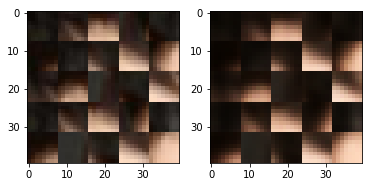

EPO: 34, recon_loss: 0.0024, total_loss: 0.0065
EPO: 34, recon_loss: 0.0089, total_loss: 0.0204
EPO: 34, recon_loss: 0.0078, total_loss: 0.0179
EPO: 34, recon_loss: 0.0065, total_loss: 0.0170
EPO: 34, recon_loss: 0.0076, total_loss: 0.0200
EPO: 34, recon_loss: 0.0067, total_loss: 0.0199
EPO: 34, recon_loss: 0.0020, total_loss: 0.0079
EPO: 34, recon_loss: 0.0026, total_loss: 0.0076
EPO: 34, recon_loss: 0.0086, total_loss: 0.0183
EPO: 34, recon_loss: 0.0034, total_loss: 0.0115
######### what? the reconstruction psnr is: 31.5905


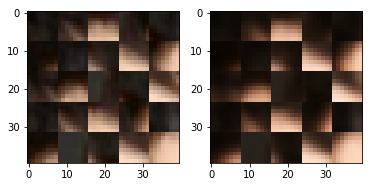

EPO: 34, recon_loss: 0.0034, total_loss: 0.0099
EPO: 34, recon_loss: 0.0035, total_loss: 0.0098
EPO: 34, recon_loss: 0.0035, total_loss: 0.0118
EPO: 34, recon_loss: 0.0046, total_loss: 0.0126
EPO: 34, recon_loss: 0.0062, total_loss: 0.0141
EPO: 34, recon_loss: 0.0033, total_loss: 0.0087
EPO: 34, recon_loss: 0.0033, total_loss: 0.0089
EPO: 34, recon_loss: 0.0021, total_loss: 0.0072
EPO: 34, recon_loss: 0.0040, total_loss: 0.0109
EPO: 34, recon_loss: 0.0071, total_loss: 0.0131
######### what? the reconstruction psnr is: 31.7009


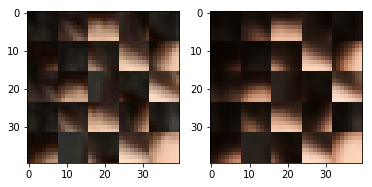

EPO: 34, recon_loss: 0.0019, total_loss: 0.0067
EPO: 34, recon_loss: 0.0034, total_loss: 0.0096
EPO: 34, recon_loss: 0.0019, total_loss: 0.0063
EPO: 34, recon_loss: 0.0036, total_loss: 0.0100
EPO: 34, recon_loss: 0.0086, total_loss: 0.0147
EPO: 34, recon_loss: 0.0036, total_loss: 0.0104
EPO: 34, recon_loss: 0.0065, total_loss: 0.0125
EPO: 34, recon_loss: 0.0014, total_loss: 0.0066
EPO: 34, recon_loss: 0.0024, total_loss: 0.0070
EPO: 34, recon_loss: 0.0057, total_loss: 0.0109
######### what? the reconstruction psnr is: 31.4951


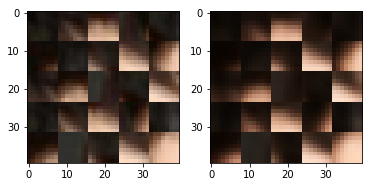

EPO: 34, recon_loss: 0.0025, total_loss: 0.0058
EPO: 34, recon_loss: 0.0044, total_loss: 0.0108
EPO: 34, recon_loss: 0.0017, total_loss: 0.0061
EPO: 34, recon_loss: 0.0015, total_loss: 0.0059
EPO: 34, recon_loss: 0.0028, total_loss: 0.0073
EPO: 34, recon_loss: 0.0017, total_loss: 0.0052
EPO: 34, recon_loss: 0.0023, total_loss: 0.0063
EPO: 34, recon_loss: 0.0076, total_loss: 0.0171
EPO: 34, recon_loss: 0.0059, total_loss: 0.0150
EPO: 34, recon_loss: 0.0040, total_loss: 0.0090
######### what? the reconstruction psnr is: 31.0360


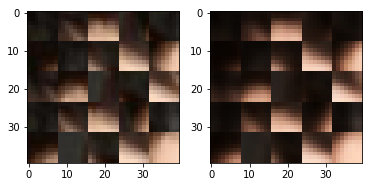

EPO: 34, recon_loss: 0.0047, total_loss: 0.0119
EPO: 34, recon_loss: 0.0031, total_loss: 0.0073
EPO: 34, recon_loss: 0.0056, total_loss: 0.0165
EPO: 34, recon_loss: 0.0028, total_loss: 0.0095
EPO: 34, recon_loss: 0.0056, total_loss: 0.0124
EPO: 34, recon_loss: 0.0021, total_loss: 0.0073
EPO: 34, recon_loss: 0.0050, total_loss: 0.0106
EPO: 34, recon_loss: 0.0013, total_loss: 0.0036
EPO: 34, recon_loss: 0.0006, total_loss: 0.0018
EPO: 34, recon_loss: 0.0035, total_loss: 0.0069
######### what? the reconstruction psnr is: 31.2330


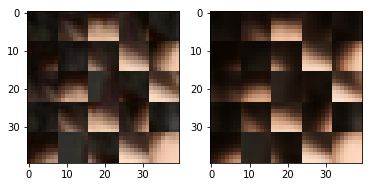

EPO: 34, recon_loss: 0.0013, total_loss: 0.0031
EPO: 34, recon_loss: 0.0017, total_loss: 0.0038
EPO: 34, recon_loss: 0.0035, total_loss: 0.0077
EPO: 34, recon_loss: 0.0024, total_loss: 0.0065
EPO: 34, recon_loss: 0.0045, total_loss: 0.0100
EPO: 34, recon_loss: 0.0018, total_loss: 0.0051
EPO: 34, recon_loss: 0.0019, total_loss: 0.0043
EPO: 34, recon_loss: 0.0055, total_loss: 0.0150
EPO: 34, recon_loss: 0.0037, total_loss: 0.0091
EPO: 34, recon_loss: 0.0058, total_loss: 0.0109
######### what? the reconstruction psnr is: 30.9084


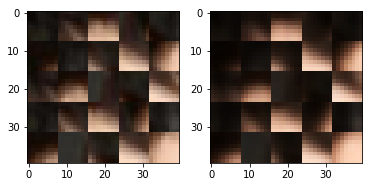

EPO: 34, recon_loss: 0.0038, total_loss: 0.0076
EPO: 34, recon_loss: 0.0053, total_loss: 0.0101
EPO: 34, recon_loss: 0.0091, total_loss: 0.0175
EPO: 34, recon_loss: 0.0147, total_loss: 0.0281
EPO: 34, recon_loss: 0.0039, total_loss: 0.0083
EPO: 34, recon_loss: 0.0035, total_loss: 0.0069
EPO: 34, recon_loss: 0.0065, total_loss: 0.0112
EPO: 34, recon_loss: 0.0025, total_loss: 0.0066
EPO: 34, recon_loss: 0.0011, total_loss: 0.0052
EPO: 34, recon_loss: 0.0025, total_loss: 0.0067
######### what? the reconstruction psnr is: 30.7929


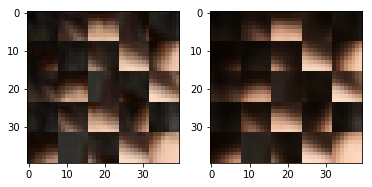

EPO: 34, recon_loss: 0.0030, total_loss: 0.0078
EPO: 34, recon_loss: 0.0032, total_loss: 0.0074
EPO: 34, recon_loss: 0.0024, total_loss: 0.0134
EPO: 34, recon_loss: 0.0012, total_loss: 0.0055
EPO: 34, recon_loss: 0.0027, total_loss: 0.0068
EPO: 34, recon_loss: 0.0030, total_loss: 0.0069
EPO: 34, recon_loss: 0.0009, total_loss: 0.0023
EPO: 34, recon_loss: 0.0035, total_loss: 0.0074
EPO: 34, recon_loss: 0.0042, total_loss: 0.0100
EPO: 34, recon_loss: 0.0080, total_loss: 0.0128
######### what? the reconstruction psnr is: 30.4683


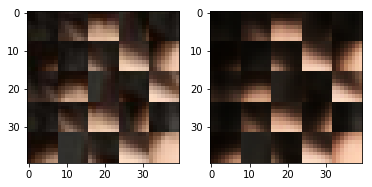

EPO: 34, recon_loss: 0.0095, total_loss: 0.0162
EPO: 34, recon_loss: 0.0101, total_loss: 0.0159
EPO: 34, recon_loss: 0.0087, total_loss: 0.0128
EPO: 35, recon_loss: 0.0017, total_loss: 0.0036
EPO: 35, recon_loss: 0.0022, total_loss: 0.0043
EPO: 35, recon_loss: 0.0050, total_loss: 0.0090
EPO: 35, recon_loss: 0.0022, total_loss: 0.0048
EPO: 35, recon_loss: 0.0044, total_loss: 0.0080
EPO: 35, recon_loss: 0.0017, total_loss: 0.0063
EPO: 35, recon_loss: 0.0024, total_loss: 0.0067
######### what? the reconstruction psnr is: 31.4739


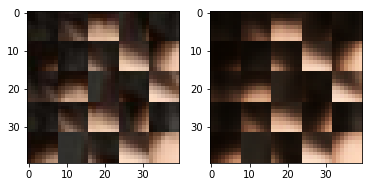

EPO: 35, recon_loss: 0.0052, total_loss: 0.0090
EPO: 35, recon_loss: 0.0051, total_loss: 0.0093
EPO: 35, recon_loss: 0.0054, total_loss: 0.0112
EPO: 35, recon_loss: 0.0019, total_loss: 0.0065
EPO: 35, recon_loss: 0.0015, total_loss: 0.0046
EPO: 35, recon_loss: 0.0027, total_loss: 0.0065
EPO: 35, recon_loss: 0.0022, total_loss: 0.0044
EPO: 35, recon_loss: 0.0059, total_loss: 0.0106
EPO: 35, recon_loss: 0.0027, total_loss: 0.0070
EPO: 35, recon_loss: 0.0025, total_loss: 0.0065
######### what? the reconstruction psnr is: 31.6014


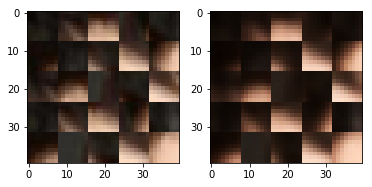

EPO: 35, recon_loss: 0.0033, total_loss: 0.0080
EPO: 35, recon_loss: 0.0027, total_loss: 0.0071
EPO: 35, recon_loss: 0.0029, total_loss: 0.0073
EPO: 35, recon_loss: 0.0024, total_loss: 0.0049
EPO: 35, recon_loss: 0.0021, total_loss: 0.0049
EPO: 35, recon_loss: 0.0070, total_loss: 0.0115
EPO: 35, recon_loss: 0.0017, total_loss: 0.0042
EPO: 35, recon_loss: 0.0035, total_loss: 0.0061
EPO: 35, recon_loss: 0.0049, total_loss: 0.0121
EPO: 35, recon_loss: 0.0035, total_loss: 0.0107
######### what? the reconstruction psnr is: 31.0048


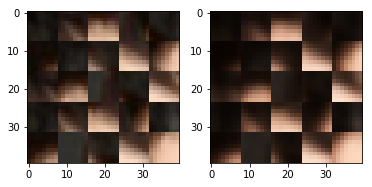

EPO: 35, recon_loss: 0.0059, total_loss: 0.0131
EPO: 35, recon_loss: 0.0068, total_loss: 0.0138
EPO: 35, recon_loss: 0.0054, total_loss: 0.0099
EPO: 35, recon_loss: 0.0036, total_loss: 0.0120
EPO: 35, recon_loss: 0.0014, total_loss: 0.0052
EPO: 35, recon_loss: 0.0045, total_loss: 0.0092
EPO: 35, recon_loss: 0.0025, total_loss: 0.0045
EPO: 35, recon_loss: 0.0021, total_loss: 0.0059
EPO: 35, recon_loss: 0.0011, total_loss: 0.0026
EPO: 35, recon_loss: 0.0014, total_loss: 0.0034
######### what? the reconstruction psnr is: 30.8046


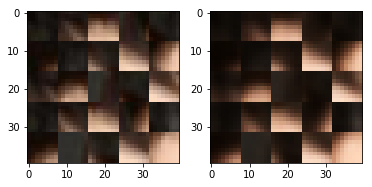

EPO: 35, recon_loss: 0.0040, total_loss: 0.0079
EPO: 35, recon_loss: 0.0027, total_loss: 0.0064
EPO: 35, recon_loss: 0.0034, total_loss: 0.0089
EPO: 35, recon_loss: 0.0012, total_loss: 0.0073
EPO: 35, recon_loss: 0.0013, total_loss: 0.0063
EPO: 35, recon_loss: 0.0032, total_loss: 0.0086
EPO: 35, recon_loss: 0.0011, total_loss: 0.0042
EPO: 35, recon_loss: 0.0028, total_loss: 0.0071
EPO: 35, recon_loss: 0.0052, total_loss: 0.0140
EPO: 35, recon_loss: 0.0016, total_loss: 0.0057
######### what? the reconstruction psnr is: 31.6386


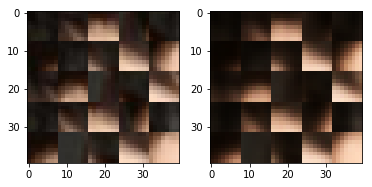

EPO: 35, recon_loss: 0.0054, total_loss: 0.0120
EPO: 35, recon_loss: 0.0031, total_loss: 0.0064
EPO: 35, recon_loss: 0.0027, total_loss: 0.0055
EPO: 35, recon_loss: 0.0069, total_loss: 0.0125
EPO: 35, recon_loss: 0.0027, total_loss: 0.0059
EPO: 35, recon_loss: 0.0039, total_loss: 0.0093
EPO: 35, recon_loss: 0.0034, total_loss: 0.0073
EPO: 35, recon_loss: 0.0039, total_loss: 0.0086
EPO: 35, recon_loss: 0.0114, total_loss: 0.0208
EPO: 35, recon_loss: 0.0102, total_loss: 0.0185
######### what? the reconstruction psnr is: 30.9918


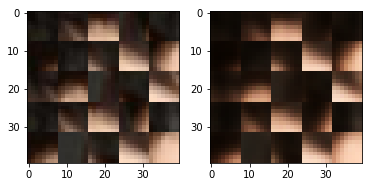

EPO: 35, recon_loss: 0.0084, total_loss: 0.0172
EPO: 35, recon_loss: 0.0096, total_loss: 0.0177
EPO: 35, recon_loss: 0.0064, total_loss: 0.0132
EPO: 35, recon_loss: 0.0055, total_loss: 0.0122
EPO: 35, recon_loss: 0.0029, total_loss: 0.0073
EPO: 35, recon_loss: 0.0044, total_loss: 0.0106
EPO: 35, recon_loss: 0.0066, total_loss: 0.0115
EPO: 35, recon_loss: 0.0062, total_loss: 0.0135
EPO: 35, recon_loss: 0.0073, total_loss: 0.0151
EPO: 35, recon_loss: 0.0015, total_loss: 0.0063
######### what? the reconstruction psnr is: 31.3839


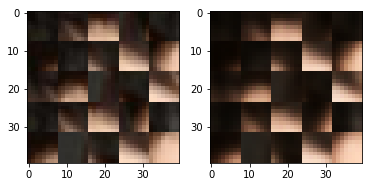

EPO: 35, recon_loss: 0.0041, total_loss: 0.0104
EPO: 35, recon_loss: 0.0069, total_loss: 0.0133
EPO: 35, recon_loss: 0.0027, total_loss: 0.0080
EPO: 35, recon_loss: 0.0049, total_loss: 0.0119
EPO: 35, recon_loss: 0.0053, total_loss: 0.0153
EPO: 35, recon_loss: 0.0072, total_loss: 0.0165
EPO: 35, recon_loss: 0.0130, total_loss: 0.0264
EPO: 35, recon_loss: 0.0044, total_loss: 0.0142
EPO: 35, recon_loss: 0.0087, total_loss: 0.0181
EPO: 35, recon_loss: 0.0057, total_loss: 0.0149
######### what? the reconstruction psnr is: 31.6099


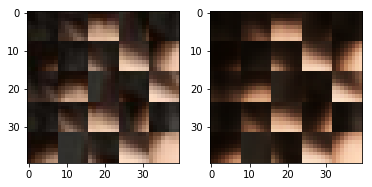

EPO: 35, recon_loss: 0.0066, total_loss: 0.0180
EPO: 35, recon_loss: 0.0131, total_loss: 0.0250
EPO: 35, recon_loss: 0.0094, total_loss: 0.0222
EPO: 35, recon_loss: 0.0091, total_loss: 0.0200
EPO: 35, recon_loss: 0.0017, total_loss: 0.0101
EPO: 35, recon_loss: 0.0070, total_loss: 0.0179
EPO: 35, recon_loss: 0.0173, total_loss: 0.0261
EPO: 35, recon_loss: 0.0091, total_loss: 0.0143
EPO: 35, recon_loss: 0.0032, total_loss: 0.0066
EPO: 35, recon_loss: 0.0019, total_loss: 0.0058
######### what? the reconstruction psnr is: 31.2425


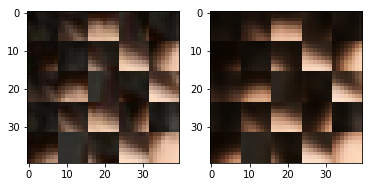

EPO: 35, recon_loss: 0.0025, total_loss: 0.0078
EPO: 35, recon_loss: 0.0070, total_loss: 0.0130
EPO: 35, recon_loss: 0.0031, total_loss: 0.0096
EPO: 35, recon_loss: 0.0063, total_loss: 0.0126
EPO: 35, recon_loss: 0.0007, total_loss: 0.0027
EPO: 35, recon_loss: 0.0004, total_loss: 0.0019
EPO: 35, recon_loss: 0.0014, total_loss: 0.0035
EPO: 35, recon_loss: 0.0006, total_loss: 0.0018
EPO: 35, recon_loss: 0.0014, total_loss: 0.0035
EPO: 35, recon_loss: 0.0031, total_loss: 0.0099
######### what? the reconstruction psnr is: 31.7533


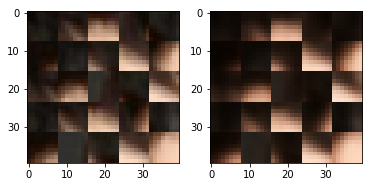

EPO: 35, recon_loss: 0.0018, total_loss: 0.0052
EPO: 35, recon_loss: 0.0043, total_loss: 0.0093
EPO: 35, recon_loss: 0.0021, total_loss: 0.0047
EPO: 35, recon_loss: 0.0028, total_loss: 0.0053
EPO: 35, recon_loss: 0.0048, total_loss: 0.0129
EPO: 35, recon_loss: 0.0057, total_loss: 0.0133
EPO: 35, recon_loss: 0.0056, total_loss: 0.0133
EPO: 35, recon_loss: 0.0064, total_loss: 0.0149
EPO: 35, recon_loss: 0.0033, total_loss: 0.0070
EPO: 35, recon_loss: 0.0038, total_loss: 0.0091
######### what? the reconstruction psnr is: 31.0199


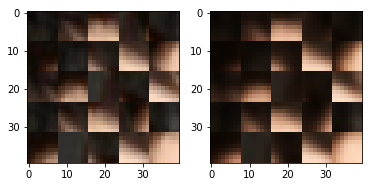

EPO: 35, recon_loss: 0.0025, total_loss: 0.0056
EPO: 35, recon_loss: 0.0039, total_loss: 0.0084
EPO: 35, recon_loss: 0.0024, total_loss: 0.0056
EPO: 35, recon_loss: 0.0025, total_loss: 0.0056
EPO: 35, recon_loss: 0.0027, total_loss: 0.0119
EPO: 35, recon_loss: 0.0011, total_loss: 0.0047
EPO: 35, recon_loss: 0.0038, total_loss: 0.0101
EPO: 35, recon_loss: 0.0028, total_loss: 0.0067
EPO: 35, recon_loss: 0.0038, total_loss: 0.0078
EPO: 35, recon_loss: 0.0014, total_loss: 0.0035
######### what? the reconstruction psnr is: 31.1697


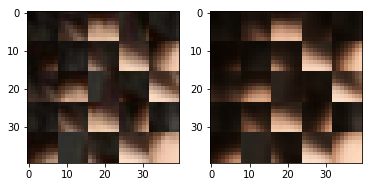

EPO: 35, recon_loss: 0.0009, total_loss: 0.0031
EPO: 35, recon_loss: 0.0018, total_loss: 0.0045
EPO: 35, recon_loss: 0.0018, total_loss: 0.0046
EPO: 35, recon_loss: 0.0017, total_loss: 0.0039
EPO: 35, recon_loss: 0.0030, total_loss: 0.0077
EPO: 35, recon_loss: 0.0018, total_loss: 0.0051
EPO: 35, recon_loss: 0.0042, total_loss: 0.0092
EPO: 35, recon_loss: 0.0032, total_loss: 0.0078
EPO: 35, recon_loss: 0.0030, total_loss: 0.0071
EPO: 35, recon_loss: 0.0029, total_loss: 0.0115
######### what? the reconstruction psnr is: 31.4241


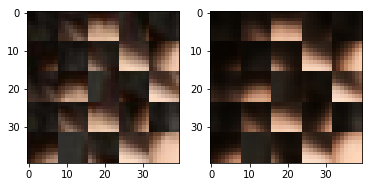

EPO: 35, recon_loss: 0.0028, total_loss: 0.0096
EPO: 35, recon_loss: 0.0073, total_loss: 0.0150
EPO: 35, recon_loss: 0.0071, total_loss: 0.0135
EPO: 35, recon_loss: 0.0031, total_loss: 0.0081
EPO: 35, recon_loss: 0.0107, total_loss: 0.0196
EPO: 35, recon_loss: 0.0008, total_loss: 0.0033
EPO: 35, recon_loss: 0.0017, total_loss: 0.0064
EPO: 35, recon_loss: 0.0066, total_loss: 0.0120
EPO: 35, recon_loss: 0.0036, total_loss: 0.0075
EPO: 35, recon_loss: 0.0031, total_loss: 0.0074
######### what? the reconstruction psnr is: 30.7635


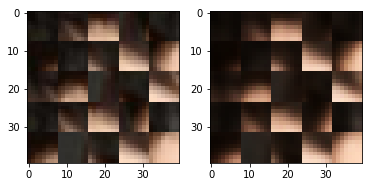

EPO: 35, recon_loss: 0.0043, total_loss: 0.0097
EPO: 35, recon_loss: 0.0051, total_loss: 0.0113
EPO: 35, recon_loss: 0.0064, total_loss: 0.0125
EPO: 35, recon_loss: 0.0014, total_loss: 0.0047
EPO: 35, recon_loss: 0.0064, total_loss: 0.0112
EPO: 35, recon_loss: 0.0012, total_loss: 0.0043
EPO: 35, recon_loss: 0.0050, total_loss: 0.0098
EPO: 35, recon_loss: 0.0053, total_loss: 0.0115
EPO: 35, recon_loss: 0.0023, total_loss: 0.0063
EPO: 35, recon_loss: 0.0031, total_loss: 0.0070
######### what? the reconstruction psnr is: 31.0779


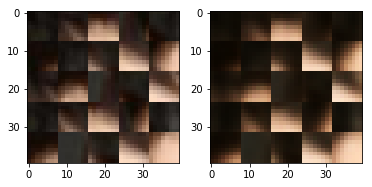

EPO: 35, recon_loss: 0.0041, total_loss: 0.0099
EPO: 35, recon_loss: 0.0028, total_loss: 0.0076
EPO: 35, recon_loss: 0.0080, total_loss: 0.0133
EPO: 35, recon_loss: 0.0035, total_loss: 0.0093
EPO: 35, recon_loss: 0.0052, total_loss: 0.0104
EPO: 35, recon_loss: 0.0045, total_loss: 0.0111
EPO: 35, recon_loss: 0.0009, total_loss: 0.0034
EPO: 35, recon_loss: 0.0049, total_loss: 0.0088
EPO: 35, recon_loss: 0.0027, total_loss: 0.0066
EPO: 35, recon_loss: 0.0037, total_loss: 0.0080
######### what? the reconstruction psnr is: 31.5498


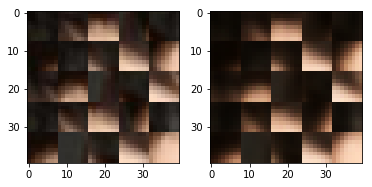

EPO: 35, recon_loss: 0.0030, total_loss: 0.0091
EPO: 35, recon_loss: 0.0031, total_loss: 0.0079
EPO: 35, recon_loss: 0.0075, total_loss: 0.0142
EPO: 35, recon_loss: 0.0026, total_loss: 0.0077
EPO: 35, recon_loss: 0.0061, total_loss: 0.0129
EPO: 35, recon_loss: 0.0039, total_loss: 0.0105
EPO: 35, recon_loss: 0.0013, total_loss: 0.0050
EPO: 35, recon_loss: 0.0050, total_loss: 0.0120
EPO: 35, recon_loss: 0.0020, total_loss: 0.0061
EPO: 35, recon_loss: 0.0044, total_loss: 0.0097
######### what? the reconstruction psnr is: 31.5389


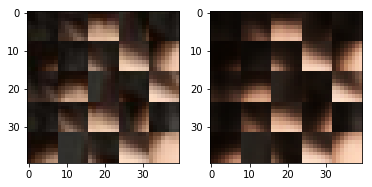

EPO: 35, recon_loss: 0.0019, total_loss: 0.0032
EPO: 35, recon_loss: 0.0015, total_loss: 0.0030
EPO: 35, recon_loss: 0.0035, total_loss: 0.0067
EPO: 35, recon_loss: 0.0021, total_loss: 0.0056
EPO: 35, recon_loss: 0.0022, total_loss: 0.0056
EPO: 35, recon_loss: 0.0098, total_loss: 0.0210
EPO: 35, recon_loss: 0.0068, total_loss: 0.0166
EPO: 35, recon_loss: 0.0079, total_loss: 0.0211
EPO: 35, recon_loss: 0.0054, total_loss: 0.0162
EPO: 35, recon_loss: 0.0071, total_loss: 0.0203
######### what? the reconstruction psnr is: 30.9162


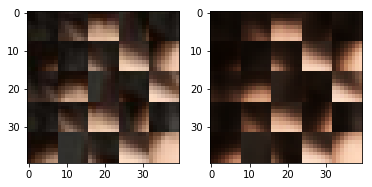

EPO: 35, recon_loss: 0.0017, total_loss: 0.0072
EPO: 35, recon_loss: 0.0021, total_loss: 0.0065
EPO: 35, recon_loss: 0.0064, total_loss: 0.0170
EPO: 35, recon_loss: 0.0028, total_loss: 0.0101
EPO: 35, recon_loss: 0.0031, total_loss: 0.0084
EPO: 35, recon_loss: 0.0034, total_loss: 0.0129
EPO: 35, recon_loss: 0.0033, total_loss: 0.0110
EPO: 35, recon_loss: 0.0059, total_loss: 0.0144
EPO: 35, recon_loss: 0.0032, total_loss: 0.0088
EPO: 35, recon_loss: 0.0030, total_loss: 0.0080
######### what? the reconstruction psnr is: 31.7541


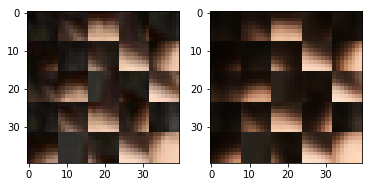

EPO: 35, recon_loss: 0.0041, total_loss: 0.0096
EPO: 35, recon_loss: 0.0019, total_loss: 0.0069
EPO: 35, recon_loss: 0.0061, total_loss: 0.0135
EPO: 35, recon_loss: 0.0032, total_loss: 0.0082
EPO: 35, recon_loss: 0.0020, total_loss: 0.0069
EPO: 35, recon_loss: 0.0037, total_loss: 0.0075
EPO: 35, recon_loss: 0.0018, total_loss: 0.0061
EPO: 35, recon_loss: 0.0049, total_loss: 0.0128
EPO: 35, recon_loss: 0.0052, total_loss: 0.0119
EPO: 35, recon_loss: 0.0039, total_loss: 0.0106
######### what? the reconstruction psnr is: 31.5931


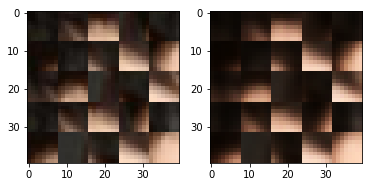

EPO: 35, recon_loss: 0.0075, total_loss: 0.0142
EPO: 35, recon_loss: 0.0012, total_loss: 0.0053
EPO: 35, recon_loss: 0.0039, total_loss: 0.0110
EPO: 35, recon_loss: 0.0051, total_loss: 0.0096
EPO: 35, recon_loss: 0.0038, total_loss: 0.0088
EPO: 35, recon_loss: 0.0042, total_loss: 0.0096
EPO: 35, recon_loss: 0.0015, total_loss: 0.0059
EPO: 35, recon_loss: 0.0023, total_loss: 0.0084
EPO: 35, recon_loss: 0.0020, total_loss: 0.0063
EPO: 35, recon_loss: 0.0020, total_loss: 0.0056
######### what? the reconstruction psnr is: 31.5690


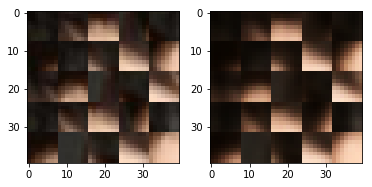

EPO: 35, recon_loss: 0.0019, total_loss: 0.0053
EPO: 35, recon_loss: 0.0079, total_loss: 0.0181
EPO: 35, recon_loss: 0.0053, total_loss: 0.0128
EPO: 35, recon_loss: 0.0053, total_loss: 0.0107
EPO: 35, recon_loss: 0.0050, total_loss: 0.0120
EPO: 35, recon_loss: 0.0031, total_loss: 0.0077
EPO: 35, recon_loss: 0.0049, total_loss: 0.0148
EPO: 35, recon_loss: 0.0036, total_loss: 0.0096
EPO: 35, recon_loss: 0.0061, total_loss: 0.0128
EPO: 35, recon_loss: 0.0023, total_loss: 0.0073
######### what? the reconstruction psnr is: 31.4451


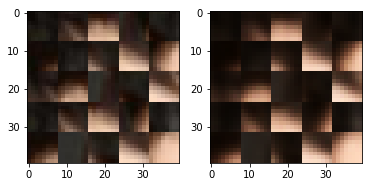

EPO: 35, recon_loss: 0.0054, total_loss: 0.0114
EPO: 35, recon_loss: 0.0011, total_loss: 0.0028
EPO: 35, recon_loss: 0.0007, total_loss: 0.0020
EPO: 35, recon_loss: 0.0042, total_loss: 0.0074
EPO: 35, recon_loss: 0.0012, total_loss: 0.0029
EPO: 35, recon_loss: 0.0025, total_loss: 0.0050
EPO: 35, recon_loss: 0.0034, total_loss: 0.0083
EPO: 35, recon_loss: 0.0027, total_loss: 0.0075
EPO: 35, recon_loss: 0.0032, total_loss: 0.0080
EPO: 35, recon_loss: 0.0019, total_loss: 0.0052
######### what? the reconstruction psnr is: 31.0988


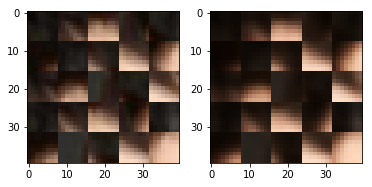

EPO: 35, recon_loss: 0.0023, total_loss: 0.0055
EPO: 35, recon_loss: 0.0043, total_loss: 0.0105
EPO: 35, recon_loss: 0.0038, total_loss: 0.0096
EPO: 35, recon_loss: 0.0068, total_loss: 0.0113
EPO: 35, recon_loss: 0.0046, total_loss: 0.0089
EPO: 35, recon_loss: 0.0047, total_loss: 0.0086
EPO: 35, recon_loss: 0.0072, total_loss: 0.0163
EPO: 35, recon_loss: 0.0128, total_loss: 0.0243
EPO: 35, recon_loss: 0.0065, total_loss: 0.0114
EPO: 35, recon_loss: 0.0042, total_loss: 0.0084
######### what? the reconstruction psnr is: 29.7446


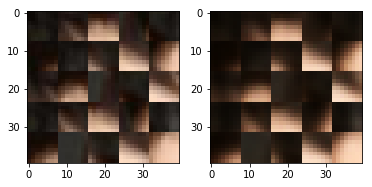

EPO: 35, recon_loss: 0.0070, total_loss: 0.0111
EPO: 35, recon_loss: 0.0016, total_loss: 0.0061
EPO: 35, recon_loss: 0.0011, total_loss: 0.0049
EPO: 35, recon_loss: 0.0034, total_loss: 0.0072
EPO: 35, recon_loss: 0.0021, total_loss: 0.0067
EPO: 35, recon_loss: 0.0030, total_loss: 0.0063
EPO: 35, recon_loss: 0.0029, total_loss: 0.0132
EPO: 35, recon_loss: 0.0012, total_loss: 0.0054
EPO: 35, recon_loss: 0.0026, total_loss: 0.0074
EPO: 35, recon_loss: 0.0011, total_loss: 0.0033
######### what? the reconstruction psnr is: 31.1698


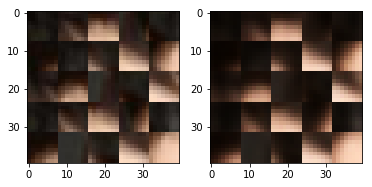

EPO: 35, recon_loss: 0.0010, total_loss: 0.0024
EPO: 35, recon_loss: 0.0039, total_loss: 0.0099
EPO: 35, recon_loss: 0.0042, total_loss: 0.0096
EPO: 35, recon_loss: 0.0086, total_loss: 0.0140
EPO: 35, recon_loss: 0.0082, total_loss: 0.0136
EPO: 35, recon_loss: 0.0095, total_loss: 0.0146
EPO: 36, recon_loss: 0.0041, total_loss: 0.0080
EPO: 36, recon_loss: 0.0016, total_loss: 0.0035
EPO: 36, recon_loss: 0.0049, total_loss: 0.0077
EPO: 36, recon_loss: 0.0024, total_loss: 0.0058
######### what? the reconstruction psnr is: 31.3642


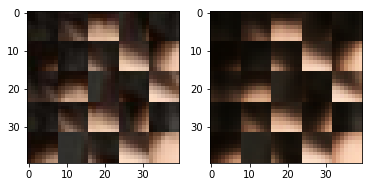

EPO: 36, recon_loss: 0.0019, total_loss: 0.0042
EPO: 36, recon_loss: 0.0031, total_loss: 0.0123
EPO: 36, recon_loss: 0.0014, total_loss: 0.0053
EPO: 36, recon_loss: 0.0028, total_loss: 0.0072
EPO: 36, recon_loss: 0.0043, total_loss: 0.0081
EPO: 36, recon_loss: 0.0038, total_loss: 0.0078
EPO: 36, recon_loss: 0.0041, total_loss: 0.0103
EPO: 36, recon_loss: 0.0018, total_loss: 0.0060
EPO: 36, recon_loss: 0.0024, total_loss: 0.0073
EPO: 36, recon_loss: 0.0022, total_loss: 0.0051
######### what? the reconstruction psnr is: 31.6487


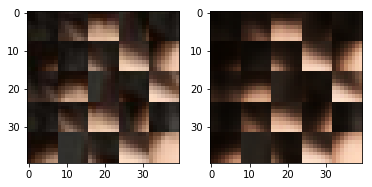

EPO: 36, recon_loss: 0.0024, total_loss: 0.0054
EPO: 36, recon_loss: 0.0070, total_loss: 0.0124
EPO: 36, recon_loss: 0.0025, total_loss: 0.0065
EPO: 36, recon_loss: 0.0032, total_loss: 0.0083
EPO: 36, recon_loss: 0.0033, total_loss: 0.0080
EPO: 36, recon_loss: 0.0026, total_loss: 0.0064
EPO: 36, recon_loss: 0.0028, total_loss: 0.0071
EPO: 36, recon_loss: 0.0025, total_loss: 0.0051
EPO: 36, recon_loss: 0.0026, total_loss: 0.0058
EPO: 36, recon_loss: 0.0066, total_loss: 0.0107
######### what? the reconstruction psnr is: 31.4693


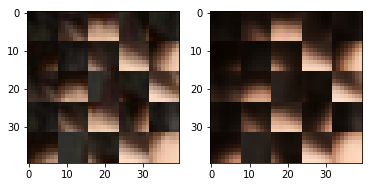

EPO: 36, recon_loss: 0.0018, total_loss: 0.0045
EPO: 36, recon_loss: 0.0039, total_loss: 0.0066
EPO: 36, recon_loss: 0.0059, total_loss: 0.0147
EPO: 36, recon_loss: 0.0028, total_loss: 0.0084
EPO: 36, recon_loss: 0.0070, total_loss: 0.0135
EPO: 36, recon_loss: 0.0050, total_loss: 0.0106
EPO: 36, recon_loss: 0.0087, total_loss: 0.0143
EPO: 36, recon_loss: 0.0033, total_loss: 0.0108
EPO: 36, recon_loss: 0.0016, total_loss: 0.0058
EPO: 36, recon_loss: 0.0044, total_loss: 0.0088
######### what? the reconstruction psnr is: 30.9848


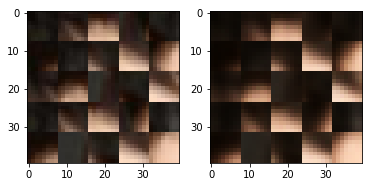

EPO: 36, recon_loss: 0.0031, total_loss: 0.0057
EPO: 36, recon_loss: 0.0029, total_loss: 0.0065
EPO: 36, recon_loss: 0.0009, total_loss: 0.0023
EPO: 36, recon_loss: 0.0014, total_loss: 0.0036
EPO: 36, recon_loss: 0.0049, total_loss: 0.0093
EPO: 36, recon_loss: 0.0023, total_loss: 0.0059
EPO: 36, recon_loss: 0.0036, total_loss: 0.0092
EPO: 36, recon_loss: 0.0011, total_loss: 0.0067
EPO: 36, recon_loss: 0.0016, total_loss: 0.0071
EPO: 36, recon_loss: 0.0039, total_loss: 0.0092
######### what? the reconstruction psnr is: 31.3003


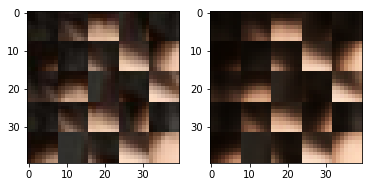

EPO: 36, recon_loss: 0.0009, total_loss: 0.0041
EPO: 36, recon_loss: 0.0035, total_loss: 0.0081
EPO: 36, recon_loss: 0.0065, total_loss: 0.0177
EPO: 36, recon_loss: 0.0016, total_loss: 0.0057
EPO: 36, recon_loss: 0.0082, total_loss: 0.0145
EPO: 36, recon_loss: 0.0022, total_loss: 0.0053
EPO: 36, recon_loss: 0.0022, total_loss: 0.0048
EPO: 36, recon_loss: 0.0053, total_loss: 0.0105
EPO: 36, recon_loss: 0.0023, total_loss: 0.0056
EPO: 36, recon_loss: 0.0048, total_loss: 0.0099
######### what? the reconstruction psnr is: 31.3486


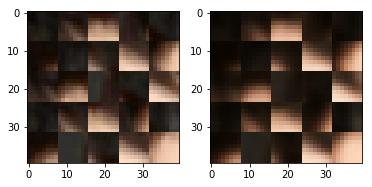

EPO: 36, recon_loss: 0.0029, total_loss: 0.0058
EPO: 36, recon_loss: 0.0042, total_loss: 0.0085
EPO: 36, recon_loss: 0.0122, total_loss: 0.0213
EPO: 36, recon_loss: 0.0071, total_loss: 0.0145
EPO: 36, recon_loss: 0.0117, total_loss: 0.0211
EPO: 36, recon_loss: 0.0075, total_loss: 0.0149
EPO: 36, recon_loss: 0.0066, total_loss: 0.0141
EPO: 36, recon_loss: 0.0024, total_loss: 0.0084
EPO: 36, recon_loss: 0.0029, total_loss: 0.0072
EPO: 36, recon_loss: 0.0040, total_loss: 0.0104
######### what? the reconstruction psnr is: 31.4579


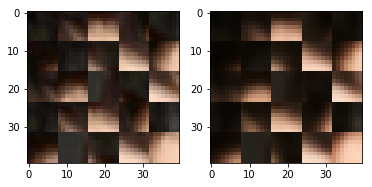

EPO: 36, recon_loss: 0.0050, total_loss: 0.0092
EPO: 36, recon_loss: 0.0049, total_loss: 0.0121
EPO: 36, recon_loss: 0.0031, total_loss: 0.0112
EPO: 36, recon_loss: 0.0012, total_loss: 0.0060
EPO: 36, recon_loss: 0.0051, total_loss: 0.0112
EPO: 36, recon_loss: 0.0034, total_loss: 0.0083
EPO: 36, recon_loss: 0.0031, total_loss: 0.0085
EPO: 36, recon_loss: 0.0059, total_loss: 0.0151
EPO: 36, recon_loss: 0.0049, total_loss: 0.0147
EPO: 36, recon_loss: 0.0102, total_loss: 0.0221
######### what? the reconstruction psnr is: 31.2684


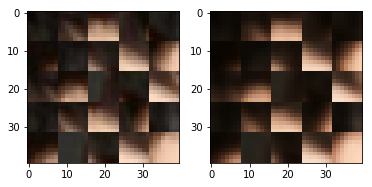

EPO: 36, recon_loss: 0.0093, total_loss: 0.0207
EPO: 36, recon_loss: 0.0047, total_loss: 0.0142
EPO: 36, recon_loss: 0.0155, total_loss: 0.0278
EPO: 36, recon_loss: 0.0050, total_loss: 0.0146
EPO: 36, recon_loss: 0.0082, total_loss: 0.0194
EPO: 36, recon_loss: 0.0120, total_loss: 0.0234
EPO: 36, recon_loss: 0.0072, total_loss: 0.0187
EPO: 36, recon_loss: 0.0085, total_loss: 0.0185
EPO: 36, recon_loss: 0.0016, total_loss: 0.0098
EPO: 36, recon_loss: 0.0092, total_loss: 0.0193
######### what? the reconstruction psnr is: 30.6747


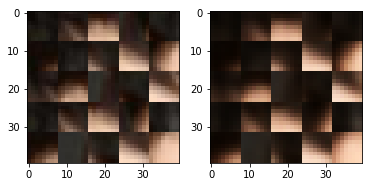

EPO: 36, recon_loss: 0.0123, total_loss: 0.0190
EPO: 36, recon_loss: 0.0032, total_loss: 0.0068
EPO: 36, recon_loss: 0.0028, total_loss: 0.0061
EPO: 36, recon_loss: 0.0017, total_loss: 0.0056
EPO: 36, recon_loss: 0.0029, total_loss: 0.0086
EPO: 36, recon_loss: 0.0050, total_loss: 0.0110
EPO: 36, recon_loss: 0.0035, total_loss: 0.0099
EPO: 36, recon_loss: 0.0062, total_loss: 0.0134
EPO: 36, recon_loss: 0.0004, total_loss: 0.0021
EPO: 36, recon_loss: 0.0005, total_loss: 0.0023
######### what? the reconstruction psnr is: 31.5625


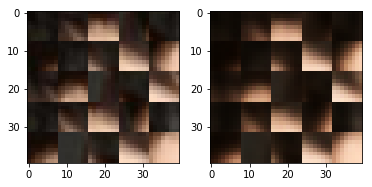

EPO: 36, recon_loss: 0.0014, total_loss: 0.0033
EPO: 36, recon_loss: 0.0007, total_loss: 0.0019
EPO: 36, recon_loss: 0.0020, total_loss: 0.0044
EPO: 36, recon_loss: 0.0022, total_loss: 0.0068
EPO: 36, recon_loss: 0.0026, total_loss: 0.0067
EPO: 36, recon_loss: 0.0046, total_loss: 0.0100
EPO: 36, recon_loss: 0.0021, total_loss: 0.0047
EPO: 36, recon_loss: 0.0037, total_loss: 0.0064
EPO: 36, recon_loss: 0.0049, total_loss: 0.0130
EPO: 36, recon_loss: 0.0080, total_loss: 0.0178
######### what? the reconstruction psnr is: 31.3417


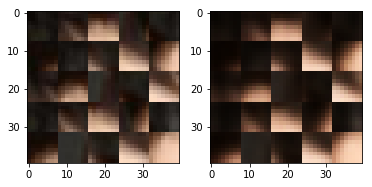

EPO: 36, recon_loss: 0.0055, total_loss: 0.0144
EPO: 36, recon_loss: 0.0041, total_loss: 0.0103
EPO: 36, recon_loss: 0.0049, total_loss: 0.0095
EPO: 36, recon_loss: 0.0030, total_loss: 0.0078
EPO: 36, recon_loss: 0.0025, total_loss: 0.0058
EPO: 36, recon_loss: 0.0041, total_loss: 0.0088
EPO: 36, recon_loss: 0.0019, total_loss: 0.0044
EPO: 36, recon_loss: 0.0026, total_loss: 0.0061
EPO: 36, recon_loss: 0.0028, total_loss: 0.0118
EPO: 36, recon_loss: 0.0009, total_loss: 0.0044
######### what? the reconstruction psnr is: 31.0478


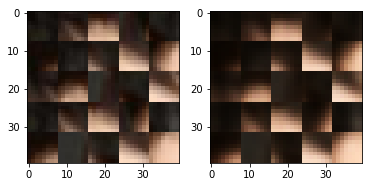

EPO: 36, recon_loss: 0.0054, total_loss: 0.0119
EPO: 36, recon_loss: 0.0033, total_loss: 0.0074
EPO: 36, recon_loss: 0.0035, total_loss: 0.0084
EPO: 36, recon_loss: 0.0012, total_loss: 0.0033
EPO: 36, recon_loss: 0.0010, total_loss: 0.0031
EPO: 36, recon_loss: 0.0022, total_loss: 0.0055
EPO: 36, recon_loss: 0.0009, total_loss: 0.0032
EPO: 36, recon_loss: 0.0012, total_loss: 0.0031
EPO: 36, recon_loss: 0.0027, total_loss: 0.0072
EPO: 36, recon_loss: 0.0018, total_loss: 0.0052
######### what? the reconstruction psnr is: 31.3617


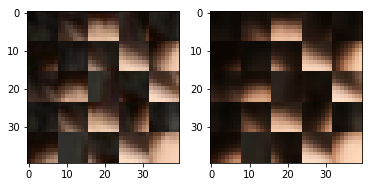

EPO: 36, recon_loss: 0.0058, total_loss: 0.0112
EPO: 36, recon_loss: 0.0029, total_loss: 0.0074
EPO: 36, recon_loss: 0.0024, total_loss: 0.0060
EPO: 36, recon_loss: 0.0026, total_loss: 0.0110
EPO: 36, recon_loss: 0.0029, total_loss: 0.0090
EPO: 36, recon_loss: 0.0088, total_loss: 0.0167
EPO: 36, recon_loss: 0.0037, total_loss: 0.0086
EPO: 36, recon_loss: 0.0049, total_loss: 0.0110
EPO: 36, recon_loss: 0.0015, total_loss: 0.0068
EPO: 36, recon_loss: 0.0005, total_loss: 0.0028
######### what? the reconstruction psnr is: 30.8058


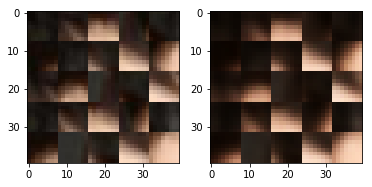

EPO: 36, recon_loss: 0.0031, total_loss: 0.0081
EPO: 36, recon_loss: 0.0042, total_loss: 0.0079
EPO: 36, recon_loss: 0.0038, total_loss: 0.0086
EPO: 36, recon_loss: 0.0043, total_loss: 0.0099
EPO: 36, recon_loss: 0.0059, total_loss: 0.0116
EPO: 36, recon_loss: 0.0047, total_loss: 0.0109
EPO: 36, recon_loss: 0.0043, total_loss: 0.0098
EPO: 36, recon_loss: 0.0015, total_loss: 0.0047
EPO: 36, recon_loss: 0.0054, total_loss: 0.0112
EPO: 36, recon_loss: 0.0011, total_loss: 0.0041
######### what? the reconstruction psnr is: 31.4183


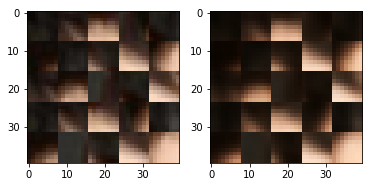

EPO: 36, recon_loss: 0.0052, total_loss: 0.0105
EPO: 36, recon_loss: 0.0053, total_loss: 0.0110
EPO: 36, recon_loss: 0.0026, total_loss: 0.0063
EPO: 36, recon_loss: 0.0027, total_loss: 0.0066
EPO: 36, recon_loss: 0.0033, total_loss: 0.0081
EPO: 36, recon_loss: 0.0030, total_loss: 0.0080
EPO: 36, recon_loss: 0.0065, total_loss: 0.0115
EPO: 36, recon_loss: 0.0039, total_loss: 0.0100
EPO: 36, recon_loss: 0.0060, total_loss: 0.0112
EPO: 36, recon_loss: 0.0033, total_loss: 0.0079
######### what? the reconstruction psnr is: 31.6340


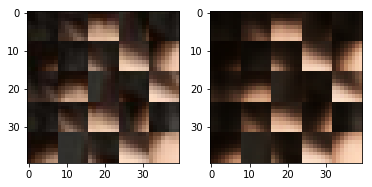

EPO: 36, recon_loss: 0.0012, total_loss: 0.0039
EPO: 36, recon_loss: 0.0032, total_loss: 0.0067
EPO: 36, recon_loss: 0.0029, total_loss: 0.0070
EPO: 36, recon_loss: 0.0049, total_loss: 0.0106
EPO: 36, recon_loss: 0.0030, total_loss: 0.0082
EPO: 36, recon_loss: 0.0032, total_loss: 0.0085
EPO: 36, recon_loss: 0.0090, total_loss: 0.0167
EPO: 36, recon_loss: 0.0028, total_loss: 0.0083
EPO: 36, recon_loss: 0.0072, total_loss: 0.0156
EPO: 36, recon_loss: 0.0021, total_loss: 0.0065
######### what? the reconstruction psnr is: 31.5086


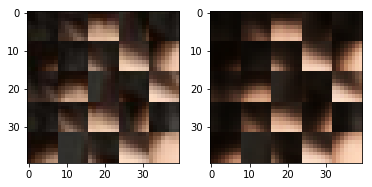

EPO: 36, recon_loss: 0.0013, total_loss: 0.0052
EPO: 36, recon_loss: 0.0054, total_loss: 0.0128
EPO: 36, recon_loss: 0.0025, total_loss: 0.0072
EPO: 36, recon_loss: 0.0062, total_loss: 0.0122
EPO: 36, recon_loss: 0.0019, total_loss: 0.0033
EPO: 36, recon_loss: 0.0014, total_loss: 0.0030
EPO: 36, recon_loss: 0.0037, total_loss: 0.0073
EPO: 36, recon_loss: 0.0014, total_loss: 0.0049
EPO: 36, recon_loss: 0.0027, total_loss: 0.0073
EPO: 36, recon_loss: 0.0092, total_loss: 0.0207
######### what? the reconstruction psnr is: 31.6004


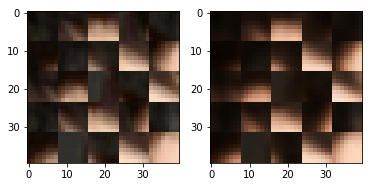

EPO: 36, recon_loss: 0.0069, total_loss: 0.0166
EPO: 36, recon_loss: 0.0105, total_loss: 0.0242
EPO: 36, recon_loss: 0.0052, total_loss: 0.0148
EPO: 36, recon_loss: 0.0087, total_loss: 0.0223
EPO: 36, recon_loss: 0.0017, total_loss: 0.0073
EPO: 36, recon_loss: 0.0033, total_loss: 0.0079
EPO: 36, recon_loss: 0.0053, total_loss: 0.0155
EPO: 36, recon_loss: 0.0029, total_loss: 0.0094
EPO: 36, recon_loss: 0.0031, total_loss: 0.0086
EPO: 36, recon_loss: 0.0033, total_loss: 0.0126
######### what? the reconstruction psnr is: 31.8170


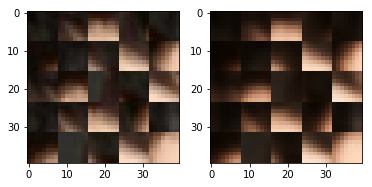

EPO: 36, recon_loss: 0.0036, total_loss: 0.0114
EPO: 36, recon_loss: 0.0079, total_loss: 0.0166
EPO: 36, recon_loss: 0.0020, total_loss: 0.0072
EPO: 36, recon_loss: 0.0021, total_loss: 0.0067
EPO: 36, recon_loss: 0.0040, total_loss: 0.0103
EPO: 36, recon_loss: 0.0014, total_loss: 0.0064
EPO: 36, recon_loss: 0.0073, total_loss: 0.0146
EPO: 36, recon_loss: 0.0019, total_loss: 0.0067
EPO: 36, recon_loss: 0.0025, total_loss: 0.0073
EPO: 36, recon_loss: 0.0035, total_loss: 0.0073
######### what? the reconstruction psnr is: 31.4773


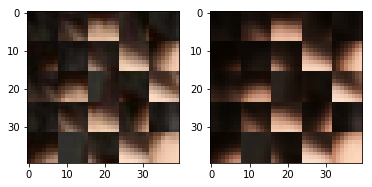

EPO: 36, recon_loss: 0.0019, total_loss: 0.0067
EPO: 36, recon_loss: 0.0079, total_loss: 0.0152
EPO: 36, recon_loss: 0.0041, total_loss: 0.0111
EPO: 36, recon_loss: 0.0035, total_loss: 0.0089
EPO: 36, recon_loss: 0.0038, total_loss: 0.0147
EPO: 36, recon_loss: 0.0011, total_loss: 0.0054
EPO: 36, recon_loss: 0.0055, total_loss: 0.0145
EPO: 36, recon_loss: 0.0036, total_loss: 0.0069
EPO: 36, recon_loss: 0.0033, total_loss: 0.0080
EPO: 36, recon_loss: 0.0028, total_loss: 0.0092
######### what? the reconstruction psnr is: 31.6959


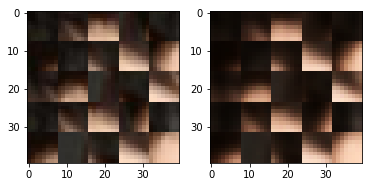

EPO: 36, recon_loss: 0.0014, total_loss: 0.0059
EPO: 36, recon_loss: 0.0027, total_loss: 0.0088
EPO: 36, recon_loss: 0.0015, total_loss: 0.0052
EPO: 36, recon_loss: 0.0025, total_loss: 0.0062
EPO: 36, recon_loss: 0.0056, total_loss: 0.0133
EPO: 36, recon_loss: 0.0089, total_loss: 0.0188
EPO: 36, recon_loss: 0.0044, total_loss: 0.0112
EPO: 36, recon_loss: 0.0050, total_loss: 0.0115
EPO: 36, recon_loss: 0.0051, total_loss: 0.0120
EPO: 36, recon_loss: 0.0027, total_loss: 0.0064
######### what? the reconstruction psnr is: 31.3395


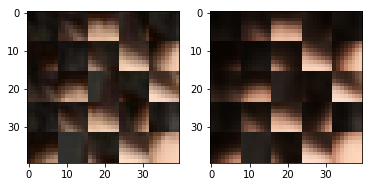

EPO: 36, recon_loss: 0.0037, total_loss: 0.0120
EPO: 36, recon_loss: 0.0045, total_loss: 0.0107
EPO: 36, recon_loss: 0.0048, total_loss: 0.0115
EPO: 36, recon_loss: 0.0031, total_loss: 0.0087
EPO: 36, recon_loss: 0.0064, total_loss: 0.0133
EPO: 36, recon_loss: 0.0008, total_loss: 0.0021
EPO: 36, recon_loss: 0.0015, total_loss: 0.0039
EPO: 36, recon_loss: 0.0029, total_loss: 0.0052
EPO: 36, recon_loss: 0.0011, total_loss: 0.0028
EPO: 36, recon_loss: 0.0027, total_loss: 0.0056
######### what? the reconstruction psnr is: 31.3775


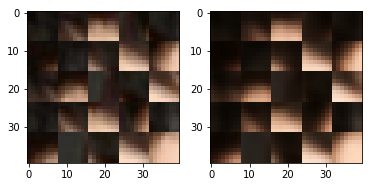

EPO: 36, recon_loss: 0.0038, total_loss: 0.0096
EPO: 36, recon_loss: 0.0025, total_loss: 0.0072
EPO: 36, recon_loss: 0.0032, total_loss: 0.0081
EPO: 36, recon_loss: 0.0022, total_loss: 0.0056
EPO: 36, recon_loss: 0.0031, total_loss: 0.0068
EPO: 36, recon_loss: 0.0038, total_loss: 0.0094
EPO: 36, recon_loss: 0.0034, total_loss: 0.0092
EPO: 36, recon_loss: 0.0075, total_loss: 0.0122
EPO: 36, recon_loss: 0.0039, total_loss: 0.0082
EPO: 36, recon_loss: 0.0061, total_loss: 0.0106
######### what? the reconstruction psnr is: 30.9505


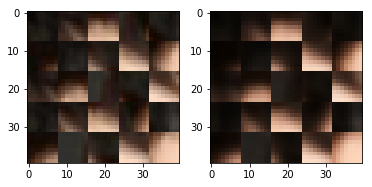

EPO: 36, recon_loss: 0.0102, total_loss: 0.0203
EPO: 36, recon_loss: 0.0089, total_loss: 0.0158
EPO: 36, recon_loss: 0.0060, total_loss: 0.0110
EPO: 36, recon_loss: 0.0043, total_loss: 0.0078
EPO: 36, recon_loss: 0.0089, total_loss: 0.0129
EPO: 36, recon_loss: 0.0012, total_loss: 0.0048
EPO: 36, recon_loss: 0.0017, total_loss: 0.0058
EPO: 36, recon_loss: 0.0042, total_loss: 0.0078
EPO: 36, recon_loss: 0.0028, total_loss: 0.0081
EPO: 36, recon_loss: 0.0044, total_loss: 0.0087
######### what? the reconstruction psnr is: 30.5700


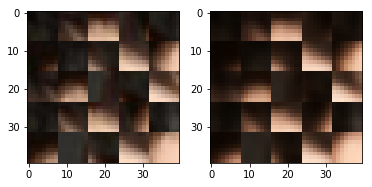

EPO: 36, recon_loss: 0.0028, total_loss: 0.0120
EPO: 36, recon_loss: 0.0012, total_loss: 0.0053
EPO: 36, recon_loss: 0.0043, total_loss: 0.0091
EPO: 36, recon_loss: 0.0007, total_loss: 0.0024
EPO: 36, recon_loss: 0.0013, total_loss: 0.0027
EPO: 36, recon_loss: 0.0045, total_loss: 0.0101
EPO: 36, recon_loss: 0.0045, total_loss: 0.0101
EPO: 36, recon_loss: 0.0100, total_loss: 0.0156
EPO: 36, recon_loss: 0.0088, total_loss: 0.0141
EPO: 36, recon_loss: 0.0091, total_loss: 0.0136
######### what? the reconstruction psnr is: 29.4547


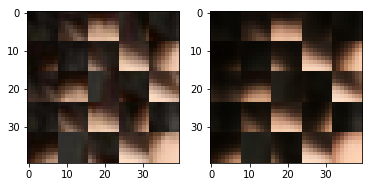

EPO: 37, recon_loss: 0.0032, total_loss: 0.0062
EPO: 37, recon_loss: 0.0016, total_loss: 0.0034
EPO: 37, recon_loss: 0.0062, total_loss: 0.0094
EPO: 37, recon_loss: 0.0017, total_loss: 0.0040
EPO: 37, recon_loss: 0.0020, total_loss: 0.0040
EPO: 37, recon_loss: 0.0023, total_loss: 0.0092
EPO: 37, recon_loss: 0.0014, total_loss: 0.0053
EPO: 37, recon_loss: 0.0026, total_loss: 0.0068
EPO: 37, recon_loss: 0.0022, total_loss: 0.0045
EPO: 37, recon_loss: 0.0047, total_loss: 0.0090
######### what? the reconstruction psnr is: 31.4672


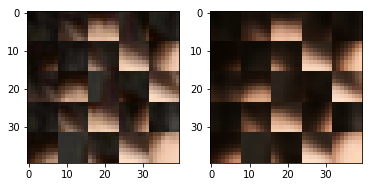

EPO: 37, recon_loss: 0.0021, total_loss: 0.0084
EPO: 37, recon_loss: 0.0015, total_loss: 0.0051
EPO: 37, recon_loss: 0.0023, total_loss: 0.0069
EPO: 37, recon_loss: 0.0019, total_loss: 0.0043
EPO: 37, recon_loss: 0.0027, total_loss: 0.0062
EPO: 37, recon_loss: 0.0027, total_loss: 0.0072
EPO: 37, recon_loss: 0.0031, total_loss: 0.0079
EPO: 37, recon_loss: 0.0031, total_loss: 0.0072
EPO: 37, recon_loss: 0.0028, total_loss: 0.0070
EPO: 37, recon_loss: 0.0022, total_loss: 0.0054
######### what? the reconstruction psnr is: 31.6496


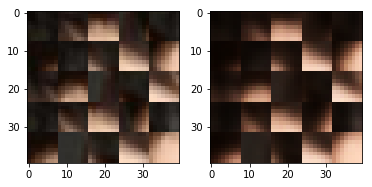

EPO: 37, recon_loss: 0.0027, total_loss: 0.0055
EPO: 37, recon_loss: 0.0017, total_loss: 0.0044
EPO: 37, recon_loss: 0.0029, total_loss: 0.0067
EPO: 37, recon_loss: 0.0055, total_loss: 0.0095
EPO: 37, recon_loss: 0.0019, total_loss: 0.0041
EPO: 37, recon_loss: 0.0039, total_loss: 0.0082
EPO: 37, recon_loss: 0.0030, total_loss: 0.0086
EPO: 37, recon_loss: 0.0030, total_loss: 0.0085
EPO: 37, recon_loss: 0.0065, total_loss: 0.0127
EPO: 37, recon_loss: 0.0057, total_loss: 0.0128
######### what? the reconstruction psnr is: 31.4077


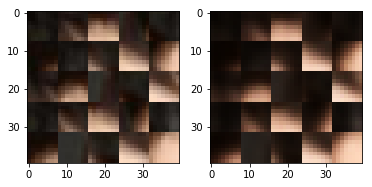

EPO: 37, recon_loss: 0.0061, total_loss: 0.0109
EPO: 37, recon_loss: 0.0025, total_loss: 0.0081
EPO: 37, recon_loss: 0.0021, total_loss: 0.0073
EPO: 37, recon_loss: 0.0040, total_loss: 0.0078
EPO: 37, recon_loss: 0.0028, total_loss: 0.0054
EPO: 37, recon_loss: 0.0035, total_loss: 0.0078
EPO: 37, recon_loss: 0.0010, total_loss: 0.0023
EPO: 37, recon_loss: 0.0023, total_loss: 0.0057
EPO: 37, recon_loss: 0.0044, total_loss: 0.0080
EPO: 37, recon_loss: 0.0027, total_loss: 0.0065
######### what? the reconstruction psnr is: 31.4949


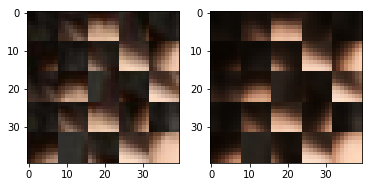

EPO: 37, recon_loss: 0.0047, total_loss: 0.0106
EPO: 37, recon_loss: 0.0012, total_loss: 0.0068
EPO: 37, recon_loss: 0.0013, total_loss: 0.0064
EPO: 37, recon_loss: 0.0045, total_loss: 0.0093
EPO: 37, recon_loss: 0.0010, total_loss: 0.0042
EPO: 37, recon_loss: 0.0043, total_loss: 0.0094
EPO: 37, recon_loss: 0.0061, total_loss: 0.0174
EPO: 37, recon_loss: 0.0022, total_loss: 0.0066
EPO: 37, recon_loss: 0.0060, total_loss: 0.0111
EPO: 37, recon_loss: 0.0019, total_loss: 0.0045
######### what? the reconstruction psnr is: 31.5938


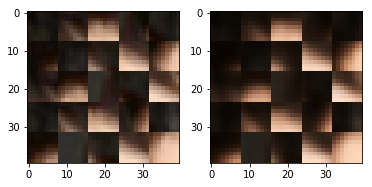

EPO: 37, recon_loss: 0.0031, total_loss: 0.0062
EPO: 37, recon_loss: 0.0048, total_loss: 0.0102
EPO: 37, recon_loss: 0.0019, total_loss: 0.0049
EPO: 37, recon_loss: 0.0047, total_loss: 0.0097
EPO: 37, recon_loss: 0.0028, total_loss: 0.0056
EPO: 37, recon_loss: 0.0048, total_loss: 0.0104
EPO: 37, recon_loss: 0.0075, total_loss: 0.0146
EPO: 37, recon_loss: 0.0078, total_loss: 0.0155
EPO: 37, recon_loss: 0.0150, total_loss: 0.0247
EPO: 37, recon_loss: 0.0089, total_loss: 0.0170
######### what? the reconstruction psnr is: 30.9976


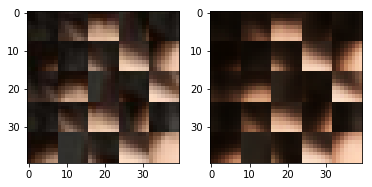

EPO: 37, recon_loss: 0.0069, total_loss: 0.0138
EPO: 37, recon_loss: 0.0026, total_loss: 0.0078
EPO: 37, recon_loss: 0.0029, total_loss: 0.0077
EPO: 37, recon_loss: 0.0040, total_loss: 0.0096
EPO: 37, recon_loss: 0.0035, total_loss: 0.0077
EPO: 37, recon_loss: 0.0050, total_loss: 0.0114
EPO: 37, recon_loss: 0.0027, total_loss: 0.0091
EPO: 37, recon_loss: 0.0012, total_loss: 0.0060
EPO: 37, recon_loss: 0.0059, total_loss: 0.0113
EPO: 37, recon_loss: 0.0026, total_loss: 0.0078
######### what? the reconstruction psnr is: 31.0569


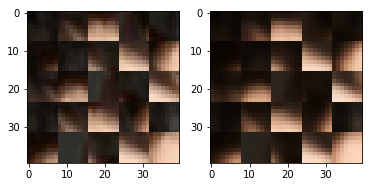

EPO: 37, recon_loss: 0.0030, total_loss: 0.0078
EPO: 37, recon_loss: 0.0063, total_loss: 0.0157
EPO: 37, recon_loss: 0.0051, total_loss: 0.0166
EPO: 37, recon_loss: 0.0106, total_loss: 0.0219
EPO: 37, recon_loss: 0.0062, total_loss: 0.0162
EPO: 37, recon_loss: 0.0050, total_loss: 0.0141
EPO: 37, recon_loss: 0.0085, total_loss: 0.0182
EPO: 37, recon_loss: 0.0052, total_loss: 0.0148
EPO: 37, recon_loss: 0.0122, total_loss: 0.0249
EPO: 37, recon_loss: 0.0088, total_loss: 0.0195
######### what? the reconstruction psnr is: 31.8313


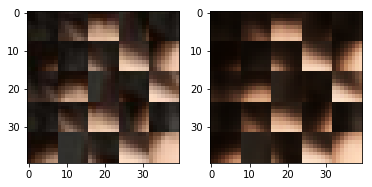

EPO: 37, recon_loss: 0.0074, total_loss: 0.0188
EPO: 37, recon_loss: 0.0025, total_loss: 0.0111
EPO: 37, recon_loss: 0.0024, total_loss: 0.0113
EPO: 37, recon_loss: 0.0122, total_loss: 0.0215
EPO: 37, recon_loss: 0.0136, total_loss: 0.0199
EPO: 37, recon_loss: 0.0021, total_loss: 0.0051
EPO: 37, recon_loss: 0.0029, total_loss: 0.0064
EPO: 37, recon_loss: 0.0019, total_loss: 0.0066
EPO: 37, recon_loss: 0.0036, total_loss: 0.0093
EPO: 37, recon_loss: 0.0043, total_loss: 0.0101
######### what? the reconstruction psnr is: 31.6089


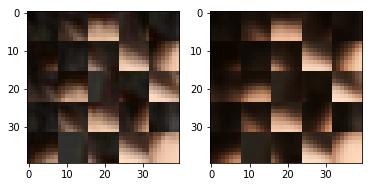

EPO: 37, recon_loss: 0.0037, total_loss: 0.0108
EPO: 37, recon_loss: 0.0079, total_loss: 0.0159
EPO: 37, recon_loss: 0.0004, total_loss: 0.0020
EPO: 37, recon_loss: 0.0006, total_loss: 0.0025
EPO: 37, recon_loss: 0.0012, total_loss: 0.0026
EPO: 37, recon_loss: 0.0007, total_loss: 0.0020
EPO: 37, recon_loss: 0.0023, total_loss: 0.0051
EPO: 37, recon_loss: 0.0020, total_loss: 0.0060
EPO: 37, recon_loss: 0.0031, total_loss: 0.0077
EPO: 37, recon_loss: 0.0050, total_loss: 0.0100
######### what? the reconstruction psnr is: 31.4077


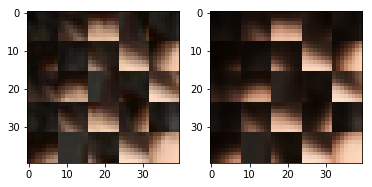

EPO: 37, recon_loss: 0.0022, total_loss: 0.0046
EPO: 37, recon_loss: 0.0055, total_loss: 0.0092
EPO: 37, recon_loss: 0.0051, total_loss: 0.0133
EPO: 37, recon_loss: 0.0070, total_loss: 0.0158
EPO: 37, recon_loss: 0.0052, total_loss: 0.0138
EPO: 37, recon_loss: 0.0040, total_loss: 0.0094
EPO: 37, recon_loss: 0.0053, total_loss: 0.0106
EPO: 37, recon_loss: 0.0033, total_loss: 0.0081
EPO: 37, recon_loss: 0.0026, total_loss: 0.0059
EPO: 37, recon_loss: 0.0043, total_loss: 0.0089
######### what? the reconstruction psnr is: 31.1387


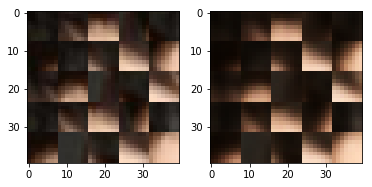

EPO: 37, recon_loss: 0.0027, total_loss: 0.0060
EPO: 37, recon_loss: 0.0037, total_loss: 0.0079
EPO: 37, recon_loss: 0.0026, total_loss: 0.0105
EPO: 37, recon_loss: 0.0015, total_loss: 0.0047
EPO: 37, recon_loss: 0.0048, total_loss: 0.0101
EPO: 37, recon_loss: 0.0035, total_loss: 0.0078
EPO: 37, recon_loss: 0.0044, total_loss: 0.0108
EPO: 37, recon_loss: 0.0012, total_loss: 0.0034
EPO: 37, recon_loss: 0.0012, total_loss: 0.0033
EPO: 37, recon_loss: 0.0022, total_loss: 0.0054
######### what? the reconstruction psnr is: 31.1687


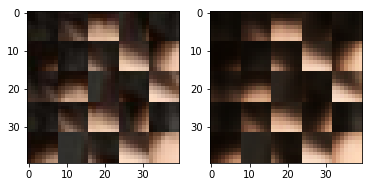

EPO: 37, recon_loss: 0.0008, total_loss: 0.0029
EPO: 37, recon_loss: 0.0012, total_loss: 0.0031
EPO: 37, recon_loss: 0.0026, total_loss: 0.0066
EPO: 37, recon_loss: 0.0017, total_loss: 0.0051
EPO: 37, recon_loss: 0.0070, total_loss: 0.0130
EPO: 37, recon_loss: 0.0033, total_loss: 0.0084
EPO: 37, recon_loss: 0.0023, total_loss: 0.0055
EPO: 37, recon_loss: 0.0022, total_loss: 0.0085
EPO: 37, recon_loss: 0.0024, total_loss: 0.0081
EPO: 37, recon_loss: 0.0098, total_loss: 0.0180
######### what? the reconstruction psnr is: 31.3374


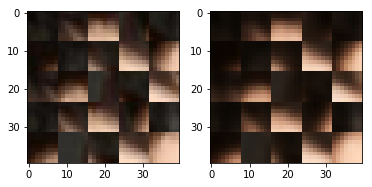

EPO: 37, recon_loss: 0.0031, total_loss: 0.0076
EPO: 37, recon_loss: 0.0070, total_loss: 0.0137
EPO: 37, recon_loss: 0.0010, total_loss: 0.0053
EPO: 37, recon_loss: 0.0004, total_loss: 0.0028
EPO: 37, recon_loss: 0.0060, total_loss: 0.0118
EPO: 37, recon_loss: 0.0037, total_loss: 0.0070
EPO: 37, recon_loss: 0.0038, total_loss: 0.0078
EPO: 37, recon_loss: 0.0044, total_loss: 0.0092
EPO: 37, recon_loss: 0.0053, total_loss: 0.0116
EPO: 37, recon_loss: 0.0053, total_loss: 0.0110
######### what? the reconstruction psnr is: 31.5424


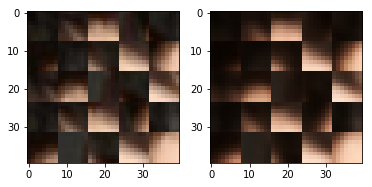

EPO: 37, recon_loss: 0.0025, total_loss: 0.0067
EPO: 37, recon_loss: 0.0017, total_loss: 0.0047
EPO: 37, recon_loss: 0.0024, total_loss: 0.0071
EPO: 37, recon_loss: 0.0009, total_loss: 0.0040
EPO: 37, recon_loss: 0.0062, total_loss: 0.0128
EPO: 37, recon_loss: 0.0017, total_loss: 0.0052
EPO: 37, recon_loss: 0.0022, total_loss: 0.0059
EPO: 37, recon_loss: 0.0043, total_loss: 0.0094
EPO: 37, recon_loss: 0.0029, total_loss: 0.0078
EPO: 37, recon_loss: 0.0032, total_loss: 0.0082
######### what? the reconstruction psnr is: 31.6063


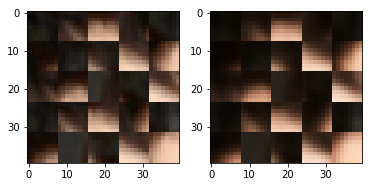

EPO: 37, recon_loss: 0.0050, total_loss: 0.0098
EPO: 37, recon_loss: 0.0042, total_loss: 0.0103
EPO: 37, recon_loss: 0.0048, total_loss: 0.0161
EPO: 37, recon_loss: 0.0026, total_loss: 0.0062
EPO: 37, recon_loss: 0.0019, total_loss: 0.0054
EPO: 37, recon_loss: 0.0022, total_loss: 0.0053
EPO: 37, recon_loss: 0.0040, total_loss: 0.0089
EPO: 37, recon_loss: 0.0037, total_loss: 0.0089
EPO: 37, recon_loss: 0.0020, total_loss: 0.0062
EPO: 37, recon_loss: 0.0048, total_loss: 0.0106
######### what? the reconstruction psnr is: 31.4355


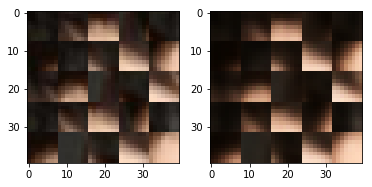

EPO: 37, recon_loss: 0.0072, total_loss: 0.0141
EPO: 37, recon_loss: 0.0035, total_loss: 0.0102
EPO: 37, recon_loss: 0.0075, total_loss: 0.0154
EPO: 37, recon_loss: 0.0017, total_loss: 0.0060
EPO: 37, recon_loss: 0.0020, total_loss: 0.0068
EPO: 37, recon_loss: 0.0047, total_loss: 0.0110
EPO: 37, recon_loss: 0.0030, total_loss: 0.0079
EPO: 37, recon_loss: 0.0060, total_loss: 0.0121
EPO: 37, recon_loss: 0.0018, total_loss: 0.0031
EPO: 37, recon_loss: 0.0015, total_loss: 0.0031
######### what? the reconstruction psnr is: 31.6329


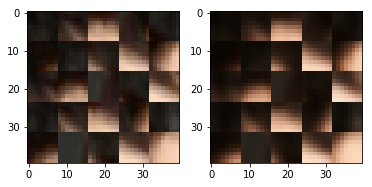

EPO: 37, recon_loss: 0.0041, total_loss: 0.0088
EPO: 37, recon_loss: 0.0015, total_loss: 0.0051
EPO: 37, recon_loss: 0.0028, total_loss: 0.0071
EPO: 37, recon_loss: 0.0101, total_loss: 0.0208
EPO: 37, recon_loss: 0.0053, total_loss: 0.0153
EPO: 37, recon_loss: 0.0131, total_loss: 0.0258
EPO: 37, recon_loss: 0.0058, total_loss: 0.0168
EPO: 37, recon_loss: 0.0088, total_loss: 0.0231
EPO: 37, recon_loss: 0.0020, total_loss: 0.0088
EPO: 37, recon_loss: 0.0035, total_loss: 0.0076
######### what? the reconstruction psnr is: 31.6048


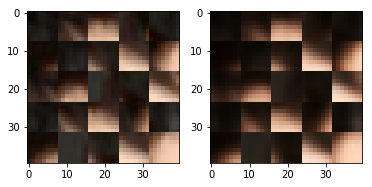

EPO: 37, recon_loss: 0.0043, total_loss: 0.0137
EPO: 37, recon_loss: 0.0029, total_loss: 0.0088
EPO: 37, recon_loss: 0.0032, total_loss: 0.0089
EPO: 37, recon_loss: 0.0035, total_loss: 0.0131
EPO: 37, recon_loss: 0.0035, total_loss: 0.0102
EPO: 37, recon_loss: 0.0096, total_loss: 0.0181
EPO: 37, recon_loss: 0.0020, total_loss: 0.0072
EPO: 37, recon_loss: 0.0021, total_loss: 0.0076
EPO: 37, recon_loss: 0.0032, total_loss: 0.0094
EPO: 37, recon_loss: 0.0013, total_loss: 0.0067
######### what? the reconstruction psnr is: 31.8895


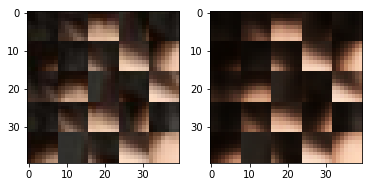

EPO: 37, recon_loss: 0.0087, total_loss: 0.0160
EPO: 37, recon_loss: 0.0017, total_loss: 0.0065
EPO: 37, recon_loss: 0.0031, total_loss: 0.0089
EPO: 37, recon_loss: 0.0026, total_loss: 0.0063
EPO: 37, recon_loss: 0.0023, total_loss: 0.0081
EPO: 37, recon_loss: 0.0100, total_loss: 0.0166
EPO: 37, recon_loss: 0.0030, total_loss: 0.0090
EPO: 37, recon_loss: 0.0032, total_loss: 0.0076
EPO: 37, recon_loss: 0.0031, total_loss: 0.0118
EPO: 37, recon_loss: 0.0012, total_loss: 0.0054
######### what? the reconstruction psnr is: 31.8437


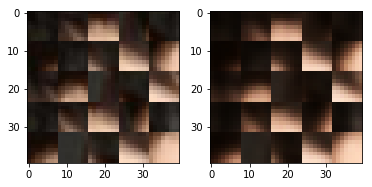

EPO: 37, recon_loss: 0.0074, total_loss: 0.0158
EPO: 37, recon_loss: 0.0018, total_loss: 0.0041
EPO: 37, recon_loss: 0.0040, total_loss: 0.0092
EPO: 37, recon_loss: 0.0024, total_loss: 0.0088
EPO: 37, recon_loss: 0.0014, total_loss: 0.0058
EPO: 37, recon_loss: 0.0031, total_loss: 0.0090
EPO: 37, recon_loss: 0.0012, total_loss: 0.0043
EPO: 37, recon_loss: 0.0027, total_loss: 0.0067
EPO: 37, recon_loss: 0.0091, total_loss: 0.0201
EPO: 37, recon_loss: 0.0073, total_loss: 0.0170
######### what? the reconstruction psnr is: 31.4172


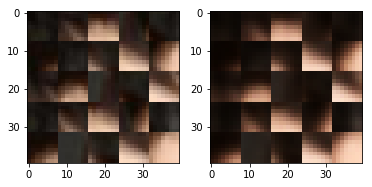

EPO: 37, recon_loss: 0.0035, total_loss: 0.0090
EPO: 37, recon_loss: 0.0039, total_loss: 0.0107
EPO: 37, recon_loss: 0.0036, total_loss: 0.0084
EPO: 37, recon_loss: 0.0062, total_loss: 0.0168
EPO: 37, recon_loss: 0.0028, total_loss: 0.0103
EPO: 37, recon_loss: 0.0038, total_loss: 0.0094
EPO: 37, recon_loss: 0.0036, total_loss: 0.0094
EPO: 37, recon_loss: 0.0044, total_loss: 0.0111
EPO: 37, recon_loss: 0.0022, total_loss: 0.0066
EPO: 37, recon_loss: 0.0007, total_loss: 0.0019
######### what? the reconstruction psnr is: 31.5544


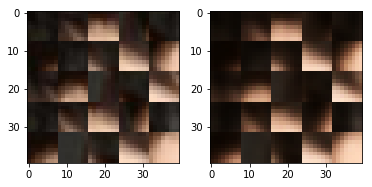

EPO: 37, recon_loss: 0.0019, total_loss: 0.0049
EPO: 37, recon_loss: 0.0019, total_loss: 0.0037
EPO: 37, recon_loss: 0.0013, total_loss: 0.0030
EPO: 37, recon_loss: 0.0033, total_loss: 0.0064
EPO: 37, recon_loss: 0.0029, total_loss: 0.0076
EPO: 37, recon_loss: 0.0035, total_loss: 0.0087
EPO: 37, recon_loss: 0.0029, total_loss: 0.0073
EPO: 37, recon_loss: 0.0024, total_loss: 0.0053
EPO: 37, recon_loss: 0.0037, total_loss: 0.0077
EPO: 37, recon_loss: 0.0034, total_loss: 0.0088
######### what? the reconstruction psnr is: 31.2712


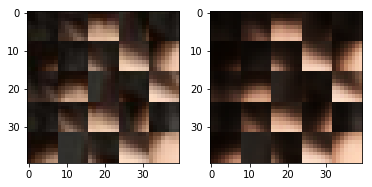

EPO: 37, recon_loss: 0.0047, total_loss: 0.0111
EPO: 37, recon_loss: 0.0059, total_loss: 0.0100
EPO: 37, recon_loss: 0.0043, total_loss: 0.0089
EPO: 37, recon_loss: 0.0079, total_loss: 0.0126
EPO: 37, recon_loss: 0.0094, total_loss: 0.0192
EPO: 37, recon_loss: 0.0067, total_loss: 0.0117
EPO: 37, recon_loss: 0.0062, total_loss: 0.0109
EPO: 37, recon_loss: 0.0044, total_loss: 0.0079
EPO: 37, recon_loss: 0.0109, total_loss: 0.0151
EPO: 37, recon_loss: 0.0010, total_loss: 0.0046
######### what? the reconstruction psnr is: 30.6475


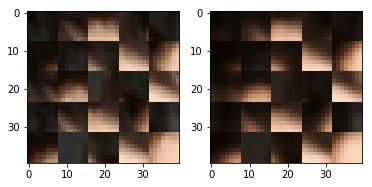

EPO: 37, recon_loss: 0.0017, total_loss: 0.0058
EPO: 37, recon_loss: 0.0051, total_loss: 0.0089
EPO: 37, recon_loss: 0.0035, total_loss: 0.0094
EPO: 37, recon_loss: 0.0075, total_loss: 0.0141
EPO: 37, recon_loss: 0.0023, total_loss: 0.0098
EPO: 37, recon_loss: 0.0018, total_loss: 0.0054
EPO: 37, recon_loss: 0.0040, total_loss: 0.0082
EPO: 37, recon_loss: 0.0008, total_loss: 0.0023
EPO: 37, recon_loss: 0.0020, total_loss: 0.0040
EPO: 37, recon_loss: 0.0046, total_loss: 0.0100
######### what? the reconstruction psnr is: 31.3118


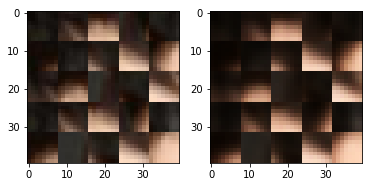

EPO: 37, recon_loss: 0.0051, total_loss: 0.0106
EPO: 37, recon_loss: 0.0123, total_loss: 0.0184
EPO: 37, recon_loss: 0.0103, total_loss: 0.0157
EPO: 37, recon_loss: 0.0093, total_loss: 0.0130
EPO: 38, recon_loss: 0.0022, total_loss: 0.0045
EPO: 38, recon_loss: 0.0016, total_loss: 0.0033
EPO: 38, recon_loss: 0.0071, total_loss: 0.0104
EPO: 38, recon_loss: 0.0014, total_loss: 0.0039
EPO: 38, recon_loss: 0.0033, total_loss: 0.0063
EPO: 38, recon_loss: 0.0024, total_loss: 0.0087
######### what? the reconstruction psnr is: 31.6948


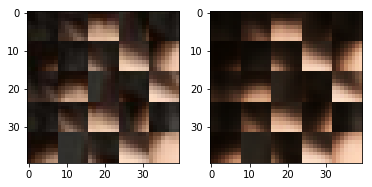

EPO: 38, recon_loss: 0.0017, total_loss: 0.0066
EPO: 38, recon_loss: 0.0040, total_loss: 0.0080
EPO: 38, recon_loss: 0.0021, total_loss: 0.0047
EPO: 38, recon_loss: 0.0044, total_loss: 0.0094
EPO: 38, recon_loss: 0.0019, total_loss: 0.0078
EPO: 38, recon_loss: 0.0009, total_loss: 0.0034
EPO: 38, recon_loss: 0.0026, total_loss: 0.0072
EPO: 38, recon_loss: 0.0015, total_loss: 0.0032
EPO: 38, recon_loss: 0.0030, total_loss: 0.0070
EPO: 38, recon_loss: 0.0027, total_loss: 0.0078
######### what? the reconstruction psnr is: 31.7753


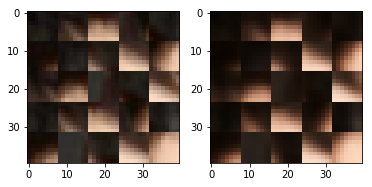

EPO: 38, recon_loss: 0.0025, total_loss: 0.0065
EPO: 38, recon_loss: 0.0032, total_loss: 0.0074
EPO: 38, recon_loss: 0.0024, total_loss: 0.0066
EPO: 38, recon_loss: 0.0020, total_loss: 0.0052
EPO: 38, recon_loss: 0.0032, total_loss: 0.0058
EPO: 38, recon_loss: 0.0017, total_loss: 0.0045
EPO: 38, recon_loss: 0.0044, total_loss: 0.0085
EPO: 38, recon_loss: 0.0025, total_loss: 0.0054
EPO: 38, recon_loss: 0.0028, total_loss: 0.0053
EPO: 38, recon_loss: 0.0071, total_loss: 0.0172
######### what? the reconstruction psnr is: 31.6330


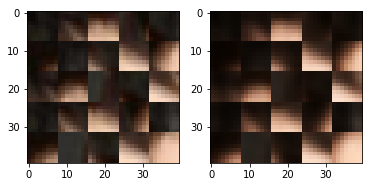

EPO: 38, recon_loss: 0.0027, total_loss: 0.0079
EPO: 38, recon_loss: 0.0038, total_loss: 0.0102
EPO: 38, recon_loss: 0.0064, total_loss: 0.0139
EPO: 38, recon_loss: 0.0037, total_loss: 0.0085
EPO: 38, recon_loss: 0.0028, total_loss: 0.0089
EPO: 38, recon_loss: 0.0019, total_loss: 0.0064
EPO: 38, recon_loss: 0.0029, total_loss: 0.0083
EPO: 38, recon_loss: 0.0025, total_loss: 0.0050
EPO: 38, recon_loss: 0.0030, total_loss: 0.0060
EPO: 38, recon_loss: 0.0011, total_loss: 0.0033
######### what? the reconstruction psnr is: 31.1202


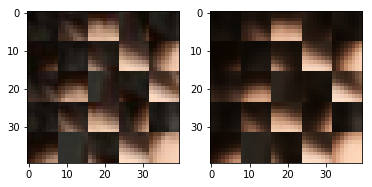

EPO: 38, recon_loss: 0.0014, total_loss: 0.0036
EPO: 38, recon_loss: 0.0017, total_loss: 0.0046
EPO: 38, recon_loss: 0.0042, total_loss: 0.0074
EPO: 38, recon_loss: 0.0032, total_loss: 0.0078
EPO: 38, recon_loss: 0.0046, total_loss: 0.0117
EPO: 38, recon_loss: 0.0014, total_loss: 0.0066
EPO: 38, recon_loss: 0.0016, total_loss: 0.0065
EPO: 38, recon_loss: 0.0032, total_loss: 0.0071
EPO: 38, recon_loss: 0.0012, total_loss: 0.0044
EPO: 38, recon_loss: 0.0049, total_loss: 0.0112
######### what? the reconstruction psnr is: 31.3898


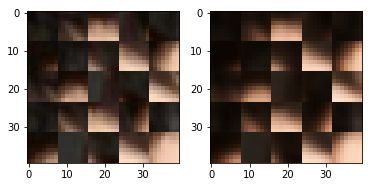

EPO: 38, recon_loss: 0.0061, total_loss: 0.0163
EPO: 38, recon_loss: 0.0028, total_loss: 0.0080
EPO: 38, recon_loss: 0.0055, total_loss: 0.0099
EPO: 38, recon_loss: 0.0020, total_loss: 0.0046
EPO: 38, recon_loss: 0.0041, total_loss: 0.0077
EPO: 38, recon_loss: 0.0033, total_loss: 0.0076
EPO: 38, recon_loss: 0.0026, total_loss: 0.0069
EPO: 38, recon_loss: 0.0049, total_loss: 0.0103
EPO: 38, recon_loss: 0.0038, total_loss: 0.0078
EPO: 38, recon_loss: 0.0066, total_loss: 0.0119
######### what? the reconstruction psnr is: 31.6024


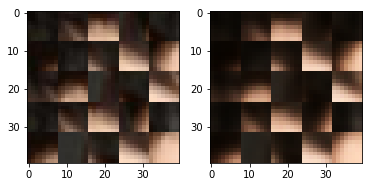

EPO: 38, recon_loss: 0.0073, total_loss: 0.0143
EPO: 38, recon_loss: 0.0085, total_loss: 0.0164
EPO: 38, recon_loss: 0.0173, total_loss: 0.0267
EPO: 38, recon_loss: 0.0083, total_loss: 0.0159
EPO: 38, recon_loss: 0.0076, total_loss: 0.0148
EPO: 38, recon_loss: 0.0034, total_loss: 0.0077
EPO: 38, recon_loss: 0.0030, total_loss: 0.0080
EPO: 38, recon_loss: 0.0044, total_loss: 0.0090
EPO: 38, recon_loss: 0.0045, total_loss: 0.0098
EPO: 38, recon_loss: 0.0061, total_loss: 0.0126
######### what? the reconstruction psnr is: 31.7408


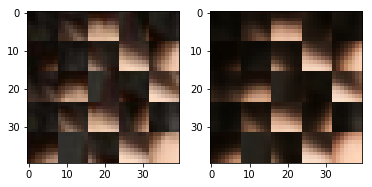

EPO: 38, recon_loss: 0.0021, total_loss: 0.0076
EPO: 38, recon_loss: 0.0020, total_loss: 0.0069
EPO: 38, recon_loss: 0.0072, total_loss: 0.0132
EPO: 38, recon_loss: 0.0022, total_loss: 0.0074
EPO: 38, recon_loss: 0.0029, total_loss: 0.0074
EPO: 38, recon_loss: 0.0063, total_loss: 0.0172
EPO: 38, recon_loss: 0.0046, total_loss: 0.0143
EPO: 38, recon_loss: 0.0140, total_loss: 0.0270
EPO: 38, recon_loss: 0.0044, total_loss: 0.0137
EPO: 38, recon_loss: 0.0052, total_loss: 0.0158
######### what? the reconstruction psnr is: 31.5916


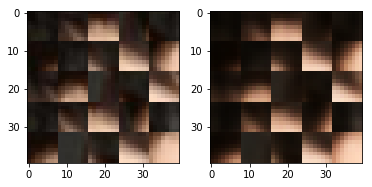

EPO: 38, recon_loss: 0.0085, total_loss: 0.0178
EPO: 38, recon_loss: 0.0047, total_loss: 0.0155
EPO: 38, recon_loss: 0.0132, total_loss: 0.0255
EPO: 38, recon_loss: 0.0067, total_loss: 0.0179
EPO: 38, recon_loss: 0.0071, total_loss: 0.0180
EPO: 38, recon_loss: 0.0026, total_loss: 0.0118
EPO: 38, recon_loss: 0.0025, total_loss: 0.0105
EPO: 38, recon_loss: 0.0161, total_loss: 0.0259
EPO: 38, recon_loss: 0.0159, total_loss: 0.0223
EPO: 38, recon_loss: 0.0023, total_loss: 0.0060
######### what? the reconstruction psnr is: 31.1208


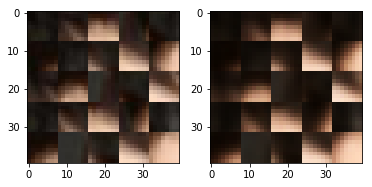

EPO: 38, recon_loss: 0.0022, total_loss: 0.0060
EPO: 38, recon_loss: 0.0020, total_loss: 0.0070
EPO: 38, recon_loss: 0.0057, total_loss: 0.0117
EPO: 38, recon_loss: 0.0032, total_loss: 0.0093
EPO: 38, recon_loss: 0.0040, total_loss: 0.0104
EPO: 38, recon_loss: 0.0016, total_loss: 0.0053
EPO: 38, recon_loss: 0.0004, total_loss: 0.0020
EPO: 38, recon_loss: 0.0006, total_loss: 0.0026
EPO: 38, recon_loss: 0.0008, total_loss: 0.0018
EPO: 38, recon_loss: 0.0008, total_loss: 0.0022
######### what? the reconstruction psnr is: 31.5412


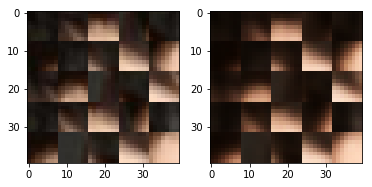

EPO: 38, recon_loss: 0.0045, total_loss: 0.0146
EPO: 38, recon_loss: 0.0021, total_loss: 0.0062
EPO: 38, recon_loss: 0.0034, total_loss: 0.0085
EPO: 38, recon_loss: 0.0036, total_loss: 0.0072
EPO: 38, recon_loss: 0.0029, total_loss: 0.0054
EPO: 38, recon_loss: 0.0064, total_loss: 0.0150
EPO: 38, recon_loss: 0.0049, total_loss: 0.0122
EPO: 38, recon_loss: 0.0068, total_loss: 0.0149
EPO: 38, recon_loss: 0.0051, total_loss: 0.0137
EPO: 38, recon_loss: 0.0030, total_loss: 0.0078
######### what? the reconstruction psnr is: 31.3564


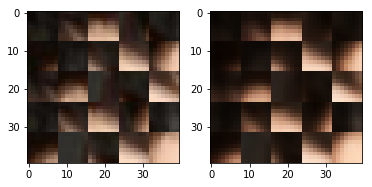

EPO: 38, recon_loss: 0.0040, total_loss: 0.0091
EPO: 38, recon_loss: 0.0029, total_loss: 0.0065
EPO: 38, recon_loss: 0.0029, total_loss: 0.0063
EPO: 38, recon_loss: 0.0032, total_loss: 0.0070
EPO: 38, recon_loss: 0.0025, total_loss: 0.0057
EPO: 38, recon_loss: 0.0036, total_loss: 0.0084
EPO: 38, recon_loss: 0.0023, total_loss: 0.0082
EPO: 38, recon_loss: 0.0022, total_loss: 0.0066
EPO: 38, recon_loss: 0.0055, total_loss: 0.0107
EPO: 38, recon_loss: 0.0053, total_loss: 0.0104
######### what? the reconstruction psnr is: 31.3788


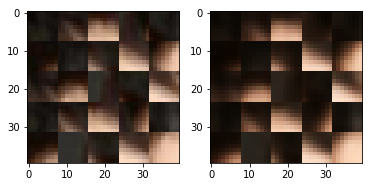

EPO: 38, recon_loss: 0.0034, total_loss: 0.0085
EPO: 38, recon_loss: 0.0010, total_loss: 0.0031
EPO: 38, recon_loss: 0.0015, total_loss: 0.0038
EPO: 38, recon_loss: 0.0021, total_loss: 0.0058
EPO: 38, recon_loss: 0.0011, total_loss: 0.0029
EPO: 38, recon_loss: 0.0019, total_loss: 0.0041
EPO: 38, recon_loss: 0.0022, total_loss: 0.0057
EPO: 38, recon_loss: 0.0027, total_loss: 0.0066
EPO: 38, recon_loss: 0.0057, total_loss: 0.0110
EPO: 38, recon_loss: 0.0032, total_loss: 0.0079
######### what? the reconstruction psnr is: 31.4296


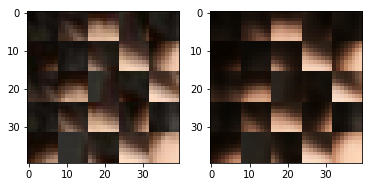

EPO: 38, recon_loss: 0.0023, total_loss: 0.0052
EPO: 38, recon_loss: 0.0018, total_loss: 0.0072
EPO: 38, recon_loss: 0.0023, total_loss: 0.0079
EPO: 38, recon_loss: 0.0096, total_loss: 0.0172
EPO: 38, recon_loss: 0.0026, total_loss: 0.0071
EPO: 38, recon_loss: 0.0099, total_loss: 0.0191
EPO: 38, recon_loss: 0.0008, total_loss: 0.0040
EPO: 38, recon_loss: 0.0005, total_loss: 0.0031
EPO: 38, recon_loss: 0.0083, total_loss: 0.0142
EPO: 38, recon_loss: 0.0028, total_loss: 0.0058
######### what? the reconstruction psnr is: 30.9433


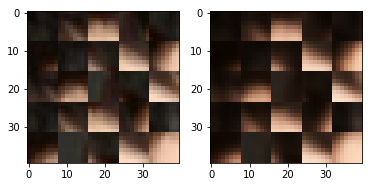

EPO: 38, recon_loss: 0.0034, total_loss: 0.0071
EPO: 38, recon_loss: 0.0041, total_loss: 0.0089
EPO: 38, recon_loss: 0.0047, total_loss: 0.0104
EPO: 38, recon_loss: 0.0066, total_loss: 0.0130
EPO: 38, recon_loss: 0.0018, total_loss: 0.0054
EPO: 38, recon_loss: 0.0029, total_loss: 0.0062
EPO: 38, recon_loss: 0.0017, total_loss: 0.0055
EPO: 38, recon_loss: 0.0012, total_loss: 0.0040
EPO: 38, recon_loss: 0.0054, total_loss: 0.0118
EPO: 38, recon_loss: 0.0012, total_loss: 0.0044
######### what? the reconstruction psnr is: 31.3502


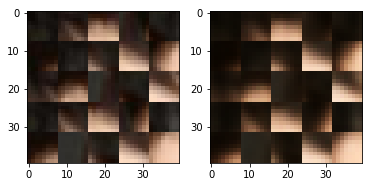

EPO: 38, recon_loss: 0.0020, total_loss: 0.0058
EPO: 38, recon_loss: 0.0044, total_loss: 0.0106
EPO: 38, recon_loss: 0.0026, total_loss: 0.0078
EPO: 38, recon_loss: 0.0046, total_loss: 0.0096
EPO: 38, recon_loss: 0.0032, total_loss: 0.0083
EPO: 38, recon_loss: 0.0042, total_loss: 0.0097
EPO: 38, recon_loss: 0.0058, total_loss: 0.0162
EPO: 38, recon_loss: 0.0015, total_loss: 0.0042
EPO: 38, recon_loss: 0.0031, total_loss: 0.0067
EPO: 38, recon_loss: 0.0024, total_loss: 0.0059
######### what? the reconstruction psnr is: 31.7088


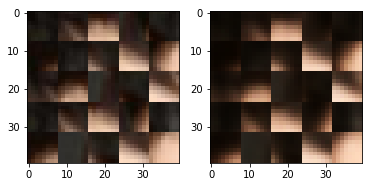

EPO: 38, recon_loss: 0.0030, total_loss: 0.0068
EPO: 38, recon_loss: 0.0030, total_loss: 0.0085
EPO: 38, recon_loss: 0.0019, total_loss: 0.0058
EPO: 38, recon_loss: 0.0053, total_loss: 0.0109
EPO: 38, recon_loss: 0.0057, total_loss: 0.0116
EPO: 38, recon_loss: 0.0042, total_loss: 0.0111
EPO: 38, recon_loss: 0.0047, total_loss: 0.0130
EPO: 38, recon_loss: 0.0020, total_loss: 0.0066
EPO: 38, recon_loss: 0.0022, total_loss: 0.0074
EPO: 38, recon_loss: 0.0041, total_loss: 0.0095
######### what? the reconstruction psnr is: 31.6747


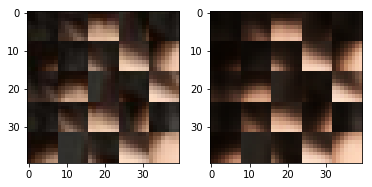

EPO: 38, recon_loss: 0.0034, total_loss: 0.0088
EPO: 38, recon_loss: 0.0026, total_loss: 0.0052
EPO: 38, recon_loss: 0.0017, total_loss: 0.0032
EPO: 38, recon_loss: 0.0012, total_loss: 0.0029
EPO: 38, recon_loss: 0.0027, total_loss: 0.0065
EPO: 38, recon_loss: 0.0019, total_loss: 0.0057
EPO: 38, recon_loss: 0.0034, total_loss: 0.0079
EPO: 38, recon_loss: 0.0080, total_loss: 0.0189
EPO: 38, recon_loss: 0.0048, total_loss: 0.0135
EPO: 38, recon_loss: 0.0101, total_loss: 0.0221
######### what? the reconstruction psnr is: 31.9593


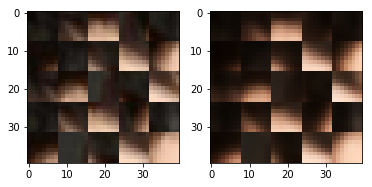

EPO: 38, recon_loss: 0.0068, total_loss: 0.0194
EPO: 38, recon_loss: 0.0082, total_loss: 0.0220
EPO: 38, recon_loss: 0.0019, total_loss: 0.0074
EPO: 38, recon_loss: 0.0066, total_loss: 0.0128
EPO: 38, recon_loss: 0.0036, total_loss: 0.0121
EPO: 38, recon_loss: 0.0029, total_loss: 0.0089
EPO: 38, recon_loss: 0.0036, total_loss: 0.0103
EPO: 38, recon_loss: 0.0036, total_loss: 0.0120
EPO: 38, recon_loss: 0.0044, total_loss: 0.0114
EPO: 38, recon_loss: 0.0072, total_loss: 0.0153
######### what? the reconstruction psnr is: 31.9542


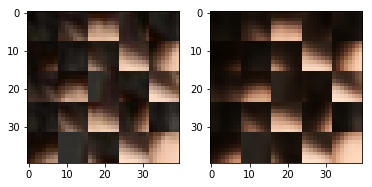

EPO: 38, recon_loss: 0.0028, total_loss: 0.0085
EPO: 38, recon_loss: 0.0032, total_loss: 0.0089
EPO: 38, recon_loss: 0.0025, total_loss: 0.0074
EPO: 38, recon_loss: 0.0017, total_loss: 0.0072
EPO: 38, recon_loss: 0.0073, total_loss: 0.0136
EPO: 38, recon_loss: 0.0019, total_loss: 0.0067
EPO: 38, recon_loss: 0.0030, total_loss: 0.0089
EPO: 38, recon_loss: 0.0022, total_loss: 0.0061
EPO: 38, recon_loss: 0.0028, total_loss: 0.0091
EPO: 38, recon_loss: 0.0091, total_loss: 0.0149
######### what? the reconstruction psnr is: 31.7448


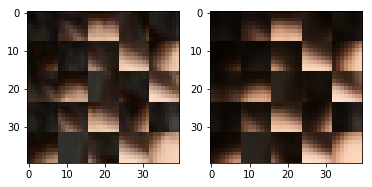

EPO: 38, recon_loss: 0.0032, total_loss: 0.0094
EPO: 38, recon_loss: 0.0047, total_loss: 0.0097
EPO: 38, recon_loss: 0.0019, total_loss: 0.0076
EPO: 38, recon_loss: 0.0016, total_loss: 0.0061
EPO: 38, recon_loss: 0.0067, total_loss: 0.0134
EPO: 38, recon_loss: 0.0020, total_loss: 0.0046
EPO: 38, recon_loss: 0.0047, total_loss: 0.0099
EPO: 38, recon_loss: 0.0019, total_loss: 0.0077
EPO: 38, recon_loss: 0.0013, total_loss: 0.0053
EPO: 38, recon_loss: 0.0029, total_loss: 0.0075
######### what? the reconstruction psnr is: 31.8372


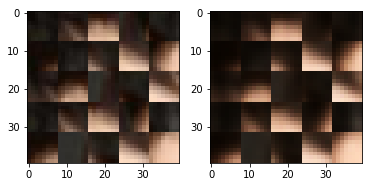

EPO: 38, recon_loss: 0.0013, total_loss: 0.0048
EPO: 38, recon_loss: 0.0024, total_loss: 0.0061
EPO: 38, recon_loss: 0.0077, total_loss: 0.0184
EPO: 38, recon_loss: 0.0068, total_loss: 0.0159
EPO: 38, recon_loss: 0.0037, total_loss: 0.0085
EPO: 38, recon_loss: 0.0037, total_loss: 0.0103
EPO: 38, recon_loss: 0.0030, total_loss: 0.0070
EPO: 38, recon_loss: 0.0056, total_loss: 0.0162
EPO: 38, recon_loss: 0.0028, total_loss: 0.0097
EPO: 38, recon_loss: 0.0051, total_loss: 0.0111
######### what? the reconstruction psnr is: 30.7837


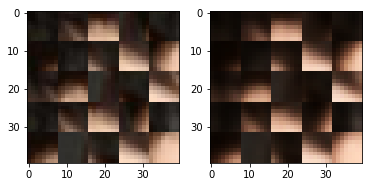

EPO: 38, recon_loss: 0.0028, total_loss: 0.0090
EPO: 38, recon_loss: 0.0038, total_loss: 0.0094
EPO: 38, recon_loss: 0.0020, total_loss: 0.0059
EPO: 38, recon_loss: 0.0005, total_loss: 0.0017
EPO: 38, recon_loss: 0.0027, total_loss: 0.0062
EPO: 38, recon_loss: 0.0012, total_loss: 0.0028
EPO: 38, recon_loss: 0.0014, total_loss: 0.0031
EPO: 38, recon_loss: 0.0028, total_loss: 0.0060
EPO: 38, recon_loss: 0.0026, total_loss: 0.0069
EPO: 38, recon_loss: 0.0041, total_loss: 0.0098
######### what? the reconstruction psnr is: 31.4469


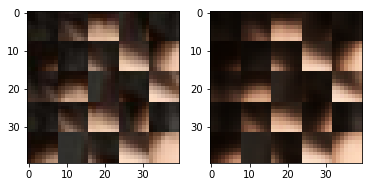

EPO: 38, recon_loss: 0.0025, total_loss: 0.0063
EPO: 38, recon_loss: 0.0027, total_loss: 0.0056
EPO: 38, recon_loss: 0.0052, total_loss: 0.0144
EPO: 38, recon_loss: 0.0044, total_loss: 0.0110
EPO: 38, recon_loss: 0.0044, total_loss: 0.0092
EPO: 38, recon_loss: 0.0052, total_loss: 0.0092
EPO: 38, recon_loss: 0.0043, total_loss: 0.0087
EPO: 38, recon_loss: 0.0105, total_loss: 0.0183
EPO: 38, recon_loss: 0.0122, total_loss: 0.0240
EPO: 38, recon_loss: 0.0045, total_loss: 0.0092
######### what? the reconstruction psnr is: 31.2104


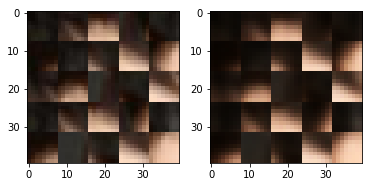

EPO: 38, recon_loss: 0.0047, total_loss: 0.0089
EPO: 38, recon_loss: 0.0052, total_loss: 0.0088
EPO: 38, recon_loss: 0.0124, total_loss: 0.0184
EPO: 38, recon_loss: 0.0009, total_loss: 0.0045
EPO: 38, recon_loss: 0.0021, total_loss: 0.0066
EPO: 38, recon_loss: 0.0050, total_loss: 0.0093
EPO: 38, recon_loss: 0.0038, total_loss: 0.0096
EPO: 38, recon_loss: 0.0088, total_loss: 0.0158
EPO: 38, recon_loss: 0.0015, total_loss: 0.0065
EPO: 38, recon_loss: 0.0021, total_loss: 0.0058
######### what? the reconstruction psnr is: 31.4564


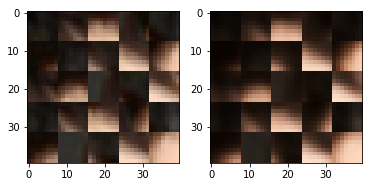

EPO: 38, recon_loss: 0.0046, total_loss: 0.0089
EPO: 38, recon_loss: 0.0012, total_loss: 0.0031
EPO: 38, recon_loss: 0.0024, total_loss: 0.0044
EPO: 38, recon_loss: 0.0041, total_loss: 0.0096
EPO: 38, recon_loss: 0.0060, total_loss: 0.0112
EPO: 38, recon_loss: 0.0107, total_loss: 0.0168
EPO: 38, recon_loss: 0.0113, total_loss: 0.0164
EPO: 38, recon_loss: 0.0108, total_loss: 0.0153
EPO: 39, recon_loss: 0.0020, total_loss: 0.0042
EPO: 39, recon_loss: 0.0015, total_loss: 0.0033
######### what? the reconstruction psnr is: 31.4824


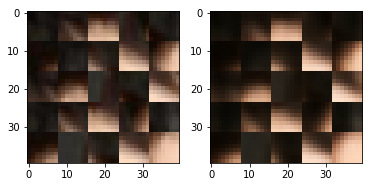

EPO: 39, recon_loss: 0.0073, total_loss: 0.0117
EPO: 39, recon_loss: 0.0019, total_loss: 0.0044
EPO: 39, recon_loss: 0.0037, total_loss: 0.0070
EPO: 39, recon_loss: 0.0023, total_loss: 0.0083
EPO: 39, recon_loss: 0.0023, total_loss: 0.0065
EPO: 39, recon_loss: 0.0039, total_loss: 0.0076
EPO: 39, recon_loss: 0.0029, total_loss: 0.0056
EPO: 39, recon_loss: 0.0048, total_loss: 0.0110
EPO: 39, recon_loss: 0.0017, total_loss: 0.0073
EPO: 39, recon_loss: 0.0009, total_loss: 0.0032
######### what? the reconstruction psnr is: 31.7999


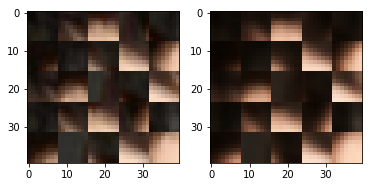

EPO: 39, recon_loss: 0.0028, total_loss: 0.0071
EPO: 39, recon_loss: 0.0018, total_loss: 0.0034
EPO: 39, recon_loss: 0.0039, total_loss: 0.0088
EPO: 39, recon_loss: 0.0025, total_loss: 0.0068
EPO: 39, recon_loss: 0.0024, total_loss: 0.0065
EPO: 39, recon_loss: 0.0033, total_loss: 0.0070
EPO: 39, recon_loss: 0.0023, total_loss: 0.0069
EPO: 39, recon_loss: 0.0025, total_loss: 0.0060
EPO: 39, recon_loss: 0.0026, total_loss: 0.0049
EPO: 39, recon_loss: 0.0018, total_loss: 0.0047
######### what? the reconstruction psnr is: 31.7951


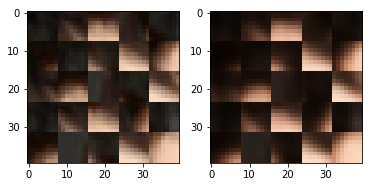

EPO: 39, recon_loss: 0.0054, total_loss: 0.0090
EPO: 39, recon_loss: 0.0020, total_loss: 0.0043
EPO: 39, recon_loss: 0.0027, total_loss: 0.0051
EPO: 39, recon_loss: 0.0055, total_loss: 0.0131
EPO: 39, recon_loss: 0.0021, total_loss: 0.0070
EPO: 39, recon_loss: 0.0050, total_loss: 0.0125
EPO: 39, recon_loss: 0.0056, total_loss: 0.0117
EPO: 39, recon_loss: 0.0046, total_loss: 0.0095
EPO: 39, recon_loss: 0.0036, total_loss: 0.0116
EPO: 39, recon_loss: 0.0016, total_loss: 0.0059
######### what? the reconstruction psnr is: 31.5157


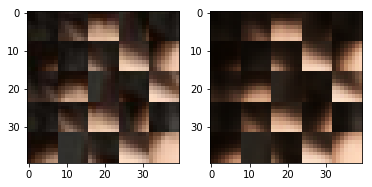

EPO: 39, recon_loss: 0.0041, total_loss: 0.0088
EPO: 39, recon_loss: 0.0020, total_loss: 0.0039
EPO: 39, recon_loss: 0.0017, total_loss: 0.0042
EPO: 39, recon_loss: 0.0013, total_loss: 0.0031
EPO: 39, recon_loss: 0.0013, total_loss: 0.0031
EPO: 39, recon_loss: 0.0022, total_loss: 0.0059
EPO: 39, recon_loss: 0.0026, total_loss: 0.0052
EPO: 39, recon_loss: 0.0037, total_loss: 0.0093
EPO: 39, recon_loss: 0.0013, total_loss: 0.0075
EPO: 39, recon_loss: 0.0012, total_loss: 0.0061
######### what? the reconstruction psnr is: 31.4307


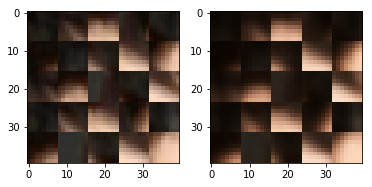

EPO: 39, recon_loss: 0.0018, total_loss: 0.0064
EPO: 39, recon_loss: 0.0024, total_loss: 0.0054
EPO: 39, recon_loss: 0.0022, total_loss: 0.0062
EPO: 39, recon_loss: 0.0043, total_loss: 0.0125
EPO: 39, recon_loss: 0.0028, total_loss: 0.0082
EPO: 39, recon_loss: 0.0042, total_loss: 0.0103
EPO: 39, recon_loss: 0.0039, total_loss: 0.0074
EPO: 39, recon_loss: 0.0025, total_loss: 0.0054
EPO: 39, recon_loss: 0.0063, total_loss: 0.0113
EPO: 39, recon_loss: 0.0027, total_loss: 0.0061
######### what? the reconstruction psnr is: 31.6823


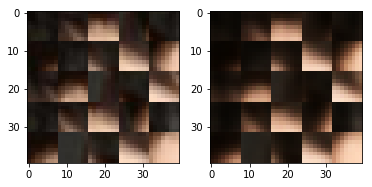

EPO: 39, recon_loss: 0.0032, total_loss: 0.0086
EPO: 39, recon_loss: 0.0043, total_loss: 0.0090
EPO: 39, recon_loss: 0.0034, total_loss: 0.0078
EPO: 39, recon_loss: 0.0106, total_loss: 0.0156
EPO: 39, recon_loss: 0.0075, total_loss: 0.0146
EPO: 39, recon_loss: 0.0091, total_loss: 0.0176
EPO: 39, recon_loss: 0.0153, total_loss: 0.0240
EPO: 39, recon_loss: 0.0084, total_loss: 0.0158
EPO: 39, recon_loss: 0.0084, total_loss: 0.0154
EPO: 39, recon_loss: 0.0032, total_loss: 0.0072
######### what? the reconstruction psnr is: 31.6959


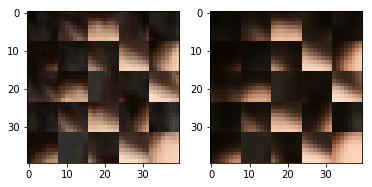

EPO: 39, recon_loss: 0.0037, total_loss: 0.0082
EPO: 39, recon_loss: 0.0053, total_loss: 0.0101
EPO: 39, recon_loss: 0.0059, total_loss: 0.0127
EPO: 39, recon_loss: 0.0058, total_loss: 0.0120
EPO: 39, recon_loss: 0.0022, total_loss: 0.0076
EPO: 39, recon_loss: 0.0033, total_loss: 0.0093
EPO: 39, recon_loss: 0.0063, total_loss: 0.0123
EPO: 39, recon_loss: 0.0022, total_loss: 0.0075
EPO: 39, recon_loss: 0.0032, total_loss: 0.0081
EPO: 39, recon_loss: 0.0051, total_loss: 0.0145
######### what? the reconstruction psnr is: 31.0600


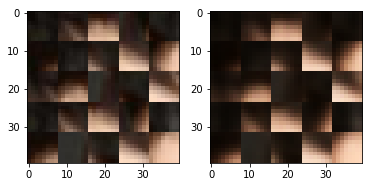

EPO: 39, recon_loss: 0.0051, total_loss: 0.0144
EPO: 39, recon_loss: 0.0139, total_loss: 0.0265
EPO: 39, recon_loss: 0.0046, total_loss: 0.0152
EPO: 39, recon_loss: 0.0061, total_loss: 0.0154
EPO: 39, recon_loss: 0.0066, total_loss: 0.0157
EPO: 39, recon_loss: 0.0044, total_loss: 0.0148
EPO: 39, recon_loss: 0.0156, total_loss: 0.0281
EPO: 39, recon_loss: 0.0070, total_loss: 0.0183
EPO: 39, recon_loss: 0.0073, total_loss: 0.0181
EPO: 39, recon_loss: 0.0015, total_loss: 0.0096
######### what? the reconstruction psnr is: 31.0924


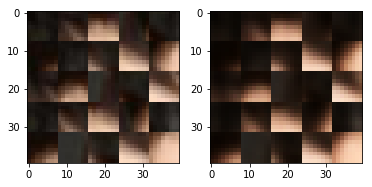

EPO: 39, recon_loss: 0.0049, total_loss: 0.0156
EPO: 39, recon_loss: 0.0177, total_loss: 0.0278
EPO: 39, recon_loss: 0.0122, total_loss: 0.0185
EPO: 39, recon_loss: 0.0025, total_loss: 0.0056
EPO: 39, recon_loss: 0.0017, total_loss: 0.0054
EPO: 39, recon_loss: 0.0024, total_loss: 0.0074
EPO: 39, recon_loss: 0.0058, total_loss: 0.0119
EPO: 39, recon_loss: 0.0030, total_loss: 0.0090
EPO: 39, recon_loss: 0.0048, total_loss: 0.0112
EPO: 39, recon_loss: 0.0010, total_loss: 0.0033
######### what? the reconstruction psnr is: 31.7439


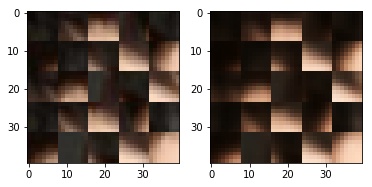

EPO: 39, recon_loss: 0.0004, total_loss: 0.0020
EPO: 39, recon_loss: 0.0009, total_loss: 0.0028
EPO: 39, recon_loss: 0.0006, total_loss: 0.0016
EPO: 39, recon_loss: 0.0007, total_loss: 0.0024
EPO: 39, recon_loss: 0.0042, total_loss: 0.0132
EPO: 39, recon_loss: 0.0017, total_loss: 0.0056
EPO: 39, recon_loss: 0.0034, total_loss: 0.0081
EPO: 39, recon_loss: 0.0020, total_loss: 0.0047
EPO: 39, recon_loss: 0.0026, total_loss: 0.0048
EPO: 39, recon_loss: 0.0057, total_loss: 0.0153
######### what? the reconstruction psnr is: 31.4862


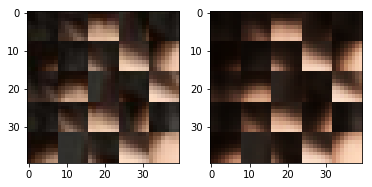

EPO: 39, recon_loss: 0.0047, total_loss: 0.0115
EPO: 39, recon_loss: 0.0057, total_loss: 0.0130
EPO: 39, recon_loss: 0.0054, total_loss: 0.0135
EPO: 39, recon_loss: 0.0034, total_loss: 0.0082
EPO: 39, recon_loss: 0.0040, total_loss: 0.0091
EPO: 39, recon_loss: 0.0028, total_loss: 0.0061
EPO: 39, recon_loss: 0.0027, total_loss: 0.0061
EPO: 39, recon_loss: 0.0024, total_loss: 0.0055
EPO: 39, recon_loss: 0.0029, total_loss: 0.0068
EPO: 39, recon_loss: 0.0022, total_loss: 0.0097
######### what? the reconstruction psnr is: 31.5476


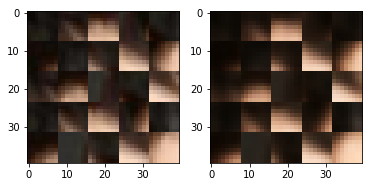

EPO: 39, recon_loss: 0.0014, total_loss: 0.0055
EPO: 39, recon_loss: 0.0031, total_loss: 0.0085
EPO: 39, recon_loss: 0.0045, total_loss: 0.0094
EPO: 39, recon_loss: 0.0031, total_loss: 0.0070
EPO: 39, recon_loss: 0.0025, total_loss: 0.0063
EPO: 39, recon_loss: 0.0009, total_loss: 0.0031
EPO: 39, recon_loss: 0.0016, total_loss: 0.0039
EPO: 39, recon_loss: 0.0021, total_loss: 0.0054
EPO: 39, recon_loss: 0.0014, total_loss: 0.0033
EPO: 39, recon_loss: 0.0023, total_loss: 0.0050
######### what? the reconstruction psnr is: 31.3009


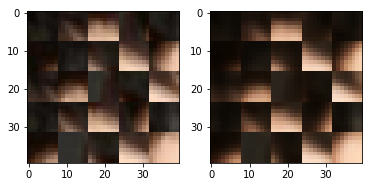

EPO: 39, recon_loss: 0.0018, total_loss: 0.0049
EPO: 39, recon_loss: 0.0027, total_loss: 0.0067
EPO: 39, recon_loss: 0.0045, total_loss: 0.0094
EPO: 39, recon_loss: 0.0035, total_loss: 0.0078
EPO: 39, recon_loss: 0.0020, total_loss: 0.0051
EPO: 39, recon_loss: 0.0023, total_loss: 0.0089
EPO: 39, recon_loss: 0.0049, total_loss: 0.0115
EPO: 39, recon_loss: 0.0099, total_loss: 0.0173
EPO: 39, recon_loss: 0.0028, total_loss: 0.0076
EPO: 39, recon_loss: 0.0106, total_loss: 0.0188
######### what? the reconstruction psnr is: 31.3796


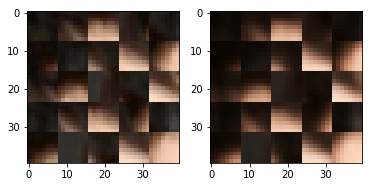

EPO: 39, recon_loss: 0.0006, total_loss: 0.0033
EPO: 39, recon_loss: 0.0011, total_loss: 0.0042
EPO: 39, recon_loss: 0.0081, total_loss: 0.0136
EPO: 39, recon_loss: 0.0022, total_loss: 0.0054
EPO: 39, recon_loss: 0.0033, total_loss: 0.0069
EPO: 39, recon_loss: 0.0036, total_loss: 0.0080
EPO: 39, recon_loss: 0.0040, total_loss: 0.0097
EPO: 39, recon_loss: 0.0073, total_loss: 0.0128
EPO: 39, recon_loss: 0.0018, total_loss: 0.0055
EPO: 39, recon_loss: 0.0042, total_loss: 0.0083
######### what? the reconstruction psnr is: 31.6100


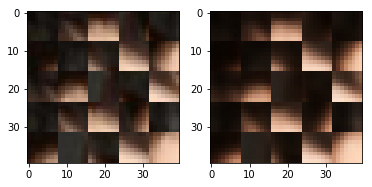

EPO: 39, recon_loss: 0.0016, total_loss: 0.0050
EPO: 39, recon_loss: 0.0030, total_loss: 0.0068
EPO: 39, recon_loss: 0.0063, total_loss: 0.0129
EPO: 39, recon_loss: 0.0015, total_loss: 0.0050
EPO: 39, recon_loss: 0.0024, total_loss: 0.0065
EPO: 39, recon_loss: 0.0036, total_loss: 0.0093
EPO: 39, recon_loss: 0.0024, total_loss: 0.0074
EPO: 39, recon_loss: 0.0065, total_loss: 0.0116
EPO: 39, recon_loss: 0.0032, total_loss: 0.0086
EPO: 39, recon_loss: 0.0049, total_loss: 0.0101
######### what? the reconstruction psnr is: 31.8128


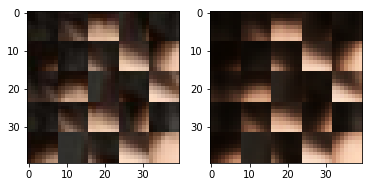

EPO: 39, recon_loss: 0.0060, total_loss: 0.0151
EPO: 39, recon_loss: 0.0009, total_loss: 0.0034
EPO: 39, recon_loss: 0.0043, total_loss: 0.0080
EPO: 39, recon_loss: 0.0020, total_loss: 0.0053
EPO: 39, recon_loss: 0.0031, total_loss: 0.0067
EPO: 39, recon_loss: 0.0030, total_loss: 0.0087
EPO: 39, recon_loss: 0.0020, total_loss: 0.0059
EPO: 39, recon_loss: 0.0068, total_loss: 0.0130
EPO: 39, recon_loss: 0.0027, total_loss: 0.0075
EPO: 39, recon_loss: 0.0051, total_loss: 0.0112
######### what? the reconstruction psnr is: 31.6545


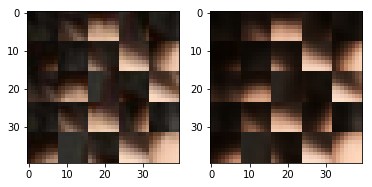

EPO: 39, recon_loss: 0.0038, total_loss: 0.0110
EPO: 39, recon_loss: 0.0015, total_loss: 0.0060
EPO: 39, recon_loss: 0.0036, total_loss: 0.0097
EPO: 39, recon_loss: 0.0019, total_loss: 0.0059
EPO: 39, recon_loss: 0.0034, total_loss: 0.0081
EPO: 39, recon_loss: 0.0021, total_loss: 0.0036
EPO: 39, recon_loss: 0.0013, total_loss: 0.0027
EPO: 39, recon_loss: 0.0016, total_loss: 0.0037
EPO: 39, recon_loss: 0.0019, total_loss: 0.0049
EPO: 39, recon_loss: 0.0023, total_loss: 0.0061
######### what? the reconstruction psnr is: 31.6991


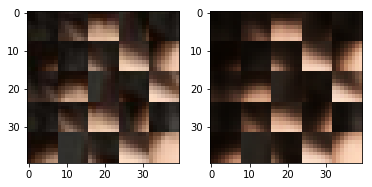

EPO: 39, recon_loss: 0.0085, total_loss: 0.0193
EPO: 39, recon_loss: 0.0073, total_loss: 0.0169
EPO: 39, recon_loss: 0.0062, total_loss: 0.0161
EPO: 39, recon_loss: 0.0072, total_loss: 0.0189
EPO: 39, recon_loss: 0.0063, total_loss: 0.0188
EPO: 39, recon_loss: 0.0018, total_loss: 0.0074
EPO: 39, recon_loss: 0.0024, total_loss: 0.0071
EPO: 39, recon_loss: 0.0079, total_loss: 0.0171
EPO: 39, recon_loss: 0.0032, total_loss: 0.0108
EPO: 39, recon_loss: 0.0032, total_loss: 0.0093
######### what? the reconstruction psnr is: 31.9227


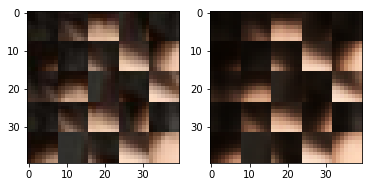

EPO: 39, recon_loss: 0.0032, total_loss: 0.0092
EPO: 39, recon_loss: 0.0032, total_loss: 0.0111
EPO: 39, recon_loss: 0.0043, total_loss: 0.0119
EPO: 39, recon_loss: 0.0058, total_loss: 0.0132
EPO: 39, recon_loss: 0.0032, total_loss: 0.0082
EPO: 39, recon_loss: 0.0031, total_loss: 0.0084
EPO: 39, recon_loss: 0.0020, total_loss: 0.0067
EPO: 39, recon_loss: 0.0037, total_loss: 0.0102
EPO: 39, recon_loss: 0.0066, total_loss: 0.0123
EPO: 39, recon_loss: 0.0017, total_loss: 0.0063
######### what? the reconstruction psnr is: 31.9566


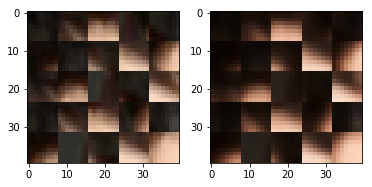

EPO: 39, recon_loss: 0.0031, total_loss: 0.0090
EPO: 39, recon_loss: 0.0018, total_loss: 0.0060
EPO: 39, recon_loss: 0.0033, total_loss: 0.0094
EPO: 39, recon_loss: 0.0080, total_loss: 0.0139
EPO: 39, recon_loss: 0.0034, total_loss: 0.0098
EPO: 39, recon_loss: 0.0061, total_loss: 0.0118
EPO: 39, recon_loss: 0.0013, total_loss: 0.0062
EPO: 39, recon_loss: 0.0022, total_loss: 0.0065
EPO: 39, recon_loss: 0.0053, total_loss: 0.0102
EPO: 39, recon_loss: 0.0023, total_loss: 0.0054
######### what? the reconstruction psnr is: 31.8093


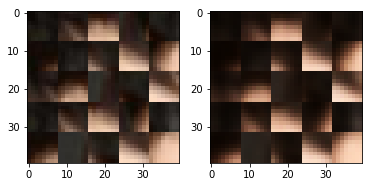

EPO: 39, recon_loss: 0.0040, total_loss: 0.0102
EPO: 39, recon_loss: 0.0015, total_loss: 0.0057
EPO: 39, recon_loss: 0.0014, total_loss: 0.0056
EPO: 39, recon_loss: 0.0025, total_loss: 0.0068
EPO: 39, recon_loss: 0.0016, total_loss: 0.0048
EPO: 39, recon_loss: 0.0021, total_loss: 0.0059
EPO: 39, recon_loss: 0.0071, total_loss: 0.0161
EPO: 39, recon_loss: 0.0054, total_loss: 0.0141
EPO: 39, recon_loss: 0.0037, total_loss: 0.0084
EPO: 39, recon_loss: 0.0043, total_loss: 0.0111
######### what? the reconstruction psnr is: 31.3797


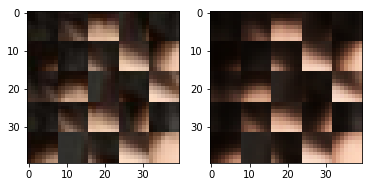

EPO: 39, recon_loss: 0.0028, total_loss: 0.0068
EPO: 39, recon_loss: 0.0054, total_loss: 0.0156
EPO: 39, recon_loss: 0.0035, total_loss: 0.0096
EPO: 39, recon_loss: 0.0052, total_loss: 0.0117
EPO: 39, recon_loss: 0.0020, total_loss: 0.0069
EPO: 39, recon_loss: 0.0046, total_loss: 0.0100
EPO: 39, recon_loss: 0.0012, total_loss: 0.0033
EPO: 39, recon_loss: 0.0006, total_loss: 0.0017
EPO: 39, recon_loss: 0.0032, total_loss: 0.0064
EPO: 39, recon_loss: 0.0012, total_loss: 0.0029
######### what? the reconstruction psnr is: 31.5121


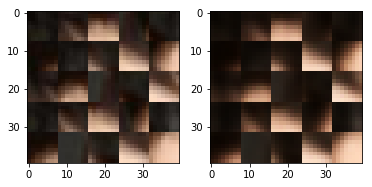

EPO: 39, recon_loss: 0.0016, total_loss: 0.0035
EPO: 39, recon_loss: 0.0032, total_loss: 0.0072
EPO: 39, recon_loss: 0.0022, total_loss: 0.0061
EPO: 39, recon_loss: 0.0041, total_loss: 0.0093
EPO: 39, recon_loss: 0.0017, total_loss: 0.0048
EPO: 39, recon_loss: 0.0017, total_loss: 0.0041
EPO: 39, recon_loss: 0.0051, total_loss: 0.0141
EPO: 39, recon_loss: 0.0034, total_loss: 0.0085
EPO: 39, recon_loss: 0.0054, total_loss: 0.0102
EPO: 39, recon_loss: 0.0035, total_loss: 0.0072
######### what? the reconstruction psnr is: 31.1870


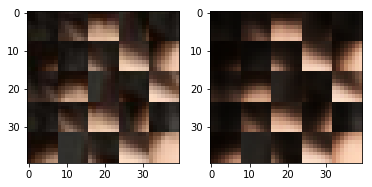

EPO: 39, recon_loss: 0.0049, total_loss: 0.0095
EPO: 39, recon_loss: 0.0085, total_loss: 0.0166
EPO: 39, recon_loss: 0.0134, total_loss: 0.0264
EPO: 39, recon_loss: 0.0036, total_loss: 0.0078
EPO: 39, recon_loss: 0.0033, total_loss: 0.0065
EPO: 39, recon_loss: 0.0060, total_loss: 0.0104
EPO: 39, recon_loss: 0.0025, total_loss: 0.0063
EPO: 39, recon_loss: 0.0010, total_loss: 0.0049
EPO: 39, recon_loss: 0.0023, total_loss: 0.0063
EPO: 39, recon_loss: 0.0028, total_loss: 0.0073
######### what? the reconstruction psnr is: 30.9698


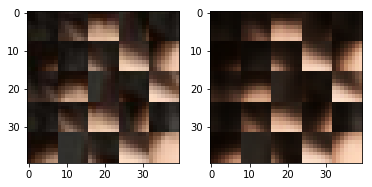

EPO: 39, recon_loss: 0.0030, total_loss: 0.0069
EPO: 39, recon_loss: 0.0023, total_loss: 0.0126
EPO: 39, recon_loss: 0.0011, total_loss: 0.0052
EPO: 39, recon_loss: 0.0025, total_loss: 0.0064
EPO: 39, recon_loss: 0.0028, total_loss: 0.0065
EPO: 39, recon_loss: 0.0009, total_loss: 0.0022
EPO: 39, recon_loss: 0.0032, total_loss: 0.0069
EPO: 39, recon_loss: 0.0040, total_loss: 0.0094
EPO: 39, recon_loss: 0.0075, total_loss: 0.0120
EPO: 39, recon_loss: 0.0085, total_loss: 0.0148
######### what? the reconstruction psnr is: 30.6009


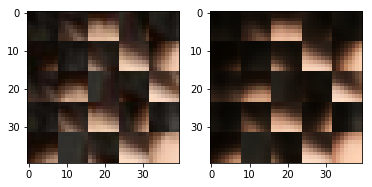

EPO: 39, recon_loss: 0.0105, total_loss: 0.0160
EPO: 39, recon_loss: 0.0085, total_loss: 0.0125
EPO: 40, recon_loss: 0.0016, total_loss: 0.0034
EPO: 40, recon_loss: 0.0020, total_loss: 0.0041
EPO: 40, recon_loss: 0.0047, total_loss: 0.0085
EPO: 40, recon_loss: 0.0021, total_loss: 0.0045
EPO: 40, recon_loss: 0.0041, total_loss: 0.0076
EPO: 40, recon_loss: 0.0016, total_loss: 0.0059
EPO: 40, recon_loss: 0.0023, total_loss: 0.0063
EPO: 40, recon_loss: 0.0049, total_loss: 0.0085
######### what? the reconstruction psnr is: 31.6685


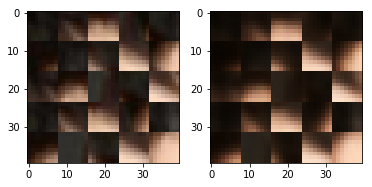

EPO: 40, recon_loss: 0.0047, total_loss: 0.0088
EPO: 40, recon_loss: 0.0051, total_loss: 0.0106
EPO: 40, recon_loss: 0.0018, total_loss: 0.0061
EPO: 40, recon_loss: 0.0014, total_loss: 0.0043
EPO: 40, recon_loss: 0.0025, total_loss: 0.0061
EPO: 40, recon_loss: 0.0020, total_loss: 0.0042
EPO: 40, recon_loss: 0.0054, total_loss: 0.0100
EPO: 40, recon_loss: 0.0025, total_loss: 0.0066
EPO: 40, recon_loss: 0.0023, total_loss: 0.0061
EPO: 40, recon_loss: 0.0031, total_loss: 0.0076
######### what? the reconstruction psnr is: 31.8844


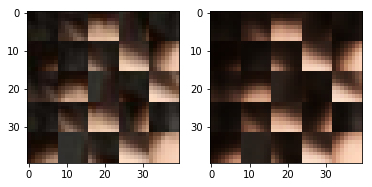

EPO: 40, recon_loss: 0.0025, total_loss: 0.0066
EPO: 40, recon_loss: 0.0027, total_loss: 0.0068
EPO: 40, recon_loss: 0.0023, total_loss: 0.0046
EPO: 40, recon_loss: 0.0020, total_loss: 0.0046
EPO: 40, recon_loss: 0.0066, total_loss: 0.0108
EPO: 40, recon_loss: 0.0016, total_loss: 0.0040
EPO: 40, recon_loss: 0.0033, total_loss: 0.0058
EPO: 40, recon_loss: 0.0045, total_loss: 0.0113
EPO: 40, recon_loss: 0.0032, total_loss: 0.0100
EPO: 40, recon_loss: 0.0055, total_loss: 0.0123
######### what? the reconstruction psnr is: 31.5721


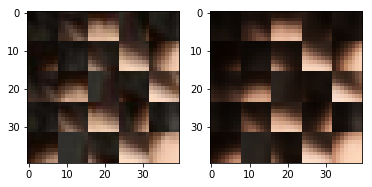

EPO: 40, recon_loss: 0.0062, total_loss: 0.0129
EPO: 40, recon_loss: 0.0050, total_loss: 0.0093
EPO: 40, recon_loss: 0.0033, total_loss: 0.0112
EPO: 40, recon_loss: 0.0013, total_loss: 0.0049
EPO: 40, recon_loss: 0.0041, total_loss: 0.0086
EPO: 40, recon_loss: 0.0023, total_loss: 0.0042
EPO: 40, recon_loss: 0.0020, total_loss: 0.0055
EPO: 40, recon_loss: 0.0010, total_loss: 0.0024
EPO: 40, recon_loss: 0.0013, total_loss: 0.0032
EPO: 40, recon_loss: 0.0038, total_loss: 0.0075
######### what? the reconstruction psnr is: 31.6032


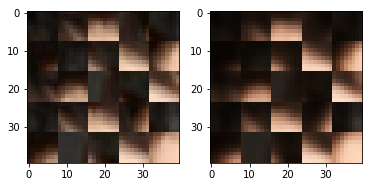

EPO: 40, recon_loss: 0.0025, total_loss: 0.0061
EPO: 40, recon_loss: 0.0032, total_loss: 0.0084
EPO: 40, recon_loss: 0.0011, total_loss: 0.0068
EPO: 40, recon_loss: 0.0012, total_loss: 0.0059
EPO: 40, recon_loss: 0.0029, total_loss: 0.0080
EPO: 40, recon_loss: 0.0010, total_loss: 0.0040
EPO: 40, recon_loss: 0.0026, total_loss: 0.0067
EPO: 40, recon_loss: 0.0048, total_loss: 0.0132
EPO: 40, recon_loss: 0.0015, total_loss: 0.0053
EPO: 40, recon_loss: 0.0049, total_loss: 0.0112
######### what? the reconstruction psnr is: 31.7985


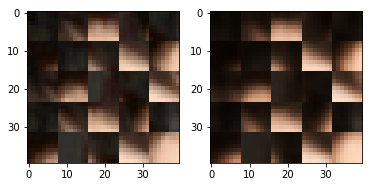

EPO: 40, recon_loss: 0.0028, total_loss: 0.0060
EPO: 40, recon_loss: 0.0025, total_loss: 0.0051
EPO: 40, recon_loss: 0.0064, total_loss: 0.0117
EPO: 40, recon_loss: 0.0025, total_loss: 0.0056
EPO: 40, recon_loss: 0.0036, total_loss: 0.0087
EPO: 40, recon_loss: 0.0032, total_loss: 0.0069
EPO: 40, recon_loss: 0.0036, total_loss: 0.0081
EPO: 40, recon_loss: 0.0107, total_loss: 0.0197
EPO: 40, recon_loss: 0.0096, total_loss: 0.0175
EPO: 40, recon_loss: 0.0079, total_loss: 0.0163
######### what? the reconstruction psnr is: 30.9980


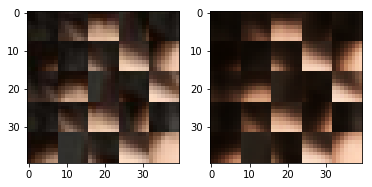

EPO: 40, recon_loss: 0.0090, total_loss: 0.0168
EPO: 40, recon_loss: 0.0061, total_loss: 0.0126
EPO: 40, recon_loss: 0.0051, total_loss: 0.0115
EPO: 40, recon_loss: 0.0027, total_loss: 0.0069
EPO: 40, recon_loss: 0.0040, total_loss: 0.0099
EPO: 40, recon_loss: 0.0061, total_loss: 0.0108
EPO: 40, recon_loss: 0.0058, total_loss: 0.0128
EPO: 40, recon_loss: 0.0068, total_loss: 0.0143
EPO: 40, recon_loss: 0.0014, total_loss: 0.0059
EPO: 40, recon_loss: 0.0038, total_loss: 0.0097
######### what? the reconstruction psnr is: 31.4926


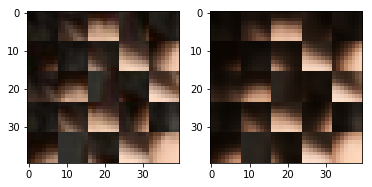

EPO: 40, recon_loss: 0.0064, total_loss: 0.0125
EPO: 40, recon_loss: 0.0025, total_loss: 0.0075
EPO: 40, recon_loss: 0.0046, total_loss: 0.0112
EPO: 40, recon_loss: 0.0050, total_loss: 0.0145
EPO: 40, recon_loss: 0.0068, total_loss: 0.0156
EPO: 40, recon_loss: 0.0121, total_loss: 0.0250
EPO: 40, recon_loss: 0.0042, total_loss: 0.0135
EPO: 40, recon_loss: 0.0083, total_loss: 0.0172
EPO: 40, recon_loss: 0.0053, total_loss: 0.0141
EPO: 40, recon_loss: 0.0062, total_loss: 0.0170
######### what? the reconstruction psnr is: 31.6346


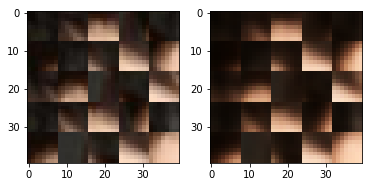

EPO: 40, recon_loss: 0.0123, total_loss: 0.0237
EPO: 40, recon_loss: 0.0087, total_loss: 0.0209
EPO: 40, recon_loss: 0.0086, total_loss: 0.0189
EPO: 40, recon_loss: 0.0015, total_loss: 0.0095
EPO: 40, recon_loss: 0.0065, total_loss: 0.0168
EPO: 40, recon_loss: 0.0163, total_loss: 0.0248
EPO: 40, recon_loss: 0.0085, total_loss: 0.0135
EPO: 40, recon_loss: 0.0029, total_loss: 0.0062
EPO: 40, recon_loss: 0.0018, total_loss: 0.0055
EPO: 40, recon_loss: 0.0024, total_loss: 0.0074
######### what? the reconstruction psnr is: 31.7352


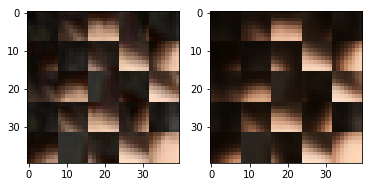

EPO: 40, recon_loss: 0.0064, total_loss: 0.0121
EPO: 40, recon_loss: 0.0030, total_loss: 0.0090
EPO: 40, recon_loss: 0.0058, total_loss: 0.0119
EPO: 40, recon_loss: 0.0007, total_loss: 0.0026
EPO: 40, recon_loss: 0.0004, total_loss: 0.0018
EPO: 40, recon_loss: 0.0012, total_loss: 0.0033
EPO: 40, recon_loss: 0.0006, total_loss: 0.0016
EPO: 40, recon_loss: 0.0013, total_loss: 0.0032
EPO: 40, recon_loss: 0.0028, total_loss: 0.0093
EPO: 40, recon_loss: 0.0017, total_loss: 0.0049
######### what? the reconstruction psnr is: 31.7687


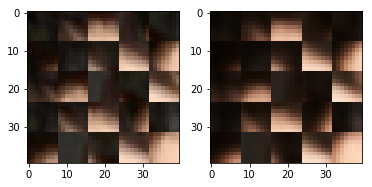

EPO: 40, recon_loss: 0.0040, total_loss: 0.0088
EPO: 40, recon_loss: 0.0019, total_loss: 0.0044
EPO: 40, recon_loss: 0.0026, total_loss: 0.0050
EPO: 40, recon_loss: 0.0045, total_loss: 0.0122
EPO: 40, recon_loss: 0.0052, total_loss: 0.0125
EPO: 40, recon_loss: 0.0051, total_loss: 0.0125
EPO: 40, recon_loss: 0.0059, total_loss: 0.0140
EPO: 40, recon_loss: 0.0031, total_loss: 0.0066
EPO: 40, recon_loss: 0.0035, total_loss: 0.0085
EPO: 40, recon_loss: 0.0023, total_loss: 0.0053
######### what? the reconstruction psnr is: 31.3561


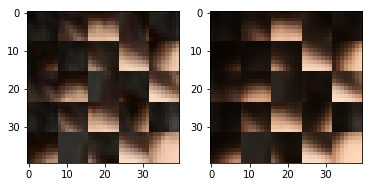

EPO: 40, recon_loss: 0.0036, total_loss: 0.0079
EPO: 40, recon_loss: 0.0023, total_loss: 0.0053
EPO: 40, recon_loss: 0.0023, total_loss: 0.0053
EPO: 40, recon_loss: 0.0025, total_loss: 0.0111
EPO: 40, recon_loss: 0.0010, total_loss: 0.0044
EPO: 40, recon_loss: 0.0035, total_loss: 0.0095
EPO: 40, recon_loss: 0.0026, total_loss: 0.0062
EPO: 40, recon_loss: 0.0035, total_loss: 0.0073
EPO: 40, recon_loss: 0.0013, total_loss: 0.0032
EPO: 40, recon_loss: 0.0008, total_loss: 0.0029
######### what? the reconstruction psnr is: 31.3950


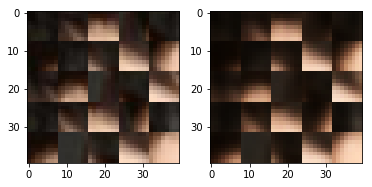

EPO: 40, recon_loss: 0.0017, total_loss: 0.0042
EPO: 40, recon_loss: 0.0016, total_loss: 0.0043
EPO: 40, recon_loss: 0.0016, total_loss: 0.0036
EPO: 40, recon_loss: 0.0027, total_loss: 0.0072
EPO: 40, recon_loss: 0.0017, total_loss: 0.0048
EPO: 40, recon_loss: 0.0038, total_loss: 0.0086
EPO: 40, recon_loss: 0.0030, total_loss: 0.0073
EPO: 40, recon_loss: 0.0028, total_loss: 0.0067
EPO: 40, recon_loss: 0.0026, total_loss: 0.0108
EPO: 40, recon_loss: 0.0026, total_loss: 0.0090
######### what? the reconstruction psnr is: 31.4086


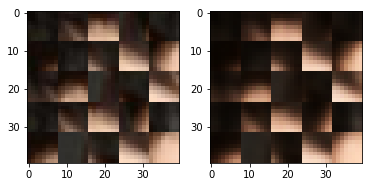

EPO: 40, recon_loss: 0.0066, total_loss: 0.0141
EPO: 40, recon_loss: 0.0067, total_loss: 0.0128
EPO: 40, recon_loss: 0.0028, total_loss: 0.0076
EPO: 40, recon_loss: 0.0100, total_loss: 0.0185
EPO: 40, recon_loss: 0.0007, total_loss: 0.0031
EPO: 40, recon_loss: 0.0015, total_loss: 0.0060
EPO: 40, recon_loss: 0.0062, total_loss: 0.0113
EPO: 40, recon_loss: 0.0033, total_loss: 0.0071
EPO: 40, recon_loss: 0.0029, total_loss: 0.0070
EPO: 40, recon_loss: 0.0040, total_loss: 0.0092
######### what? the reconstruction psnr is: 31.6413


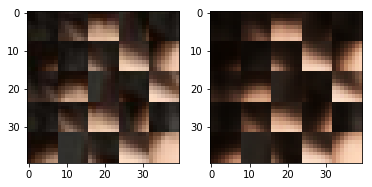

EPO: 40, recon_loss: 0.0048, total_loss: 0.0107
EPO: 40, recon_loss: 0.0060, total_loss: 0.0119
EPO: 40, recon_loss: 0.0014, total_loss: 0.0045
EPO: 40, recon_loss: 0.0060, total_loss: 0.0106
EPO: 40, recon_loss: 0.0011, total_loss: 0.0040
EPO: 40, recon_loss: 0.0046, total_loss: 0.0092
EPO: 40, recon_loss: 0.0049, total_loss: 0.0108
EPO: 40, recon_loss: 0.0021, total_loss: 0.0059
EPO: 40, recon_loss: 0.0029, total_loss: 0.0066
EPO: 40, recon_loss: 0.0038, total_loss: 0.0093
######### what? the reconstruction psnr is: 31.8616


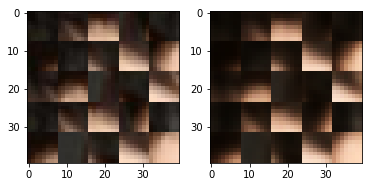

EPO: 40, recon_loss: 0.0026, total_loss: 0.0071
EPO: 40, recon_loss: 0.0075, total_loss: 0.0126
EPO: 40, recon_loss: 0.0033, total_loss: 0.0088
EPO: 40, recon_loss: 0.0049, total_loss: 0.0098
EPO: 40, recon_loss: 0.0043, total_loss: 0.0105
EPO: 40, recon_loss: 0.0008, total_loss: 0.0032
EPO: 40, recon_loss: 0.0046, total_loss: 0.0083
EPO: 40, recon_loss: 0.0025, total_loss: 0.0062
EPO: 40, recon_loss: 0.0034, total_loss: 0.0075
EPO: 40, recon_loss: 0.0028, total_loss: 0.0085
######### what? the reconstruction psnr is: 31.6717


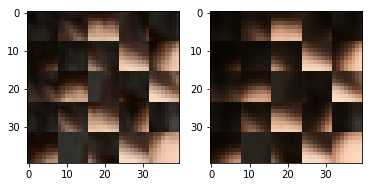

EPO: 40, recon_loss: 0.0028, total_loss: 0.0074
EPO: 40, recon_loss: 0.0069, total_loss: 0.0134
EPO: 40, recon_loss: 0.0024, total_loss: 0.0073
EPO: 40, recon_loss: 0.0057, total_loss: 0.0122
EPO: 40, recon_loss: 0.0036, total_loss: 0.0098
EPO: 40, recon_loss: 0.0012, total_loss: 0.0047
EPO: 40, recon_loss: 0.0047, total_loss: 0.0112
EPO: 40, recon_loss: 0.0018, total_loss: 0.0057
EPO: 40, recon_loss: 0.0040, total_loss: 0.0091
EPO: 40, recon_loss: 0.0018, total_loss: 0.0030
######### what? the reconstruction psnr is: 31.9411


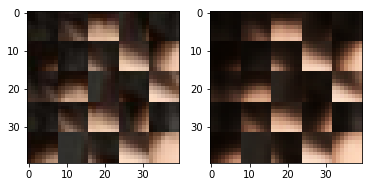

EPO: 40, recon_loss: 0.0014, total_loss: 0.0029
EPO: 40, recon_loss: 0.0032, total_loss: 0.0063
EPO: 40, recon_loss: 0.0019, total_loss: 0.0052
EPO: 40, recon_loss: 0.0020, total_loss: 0.0053
EPO: 40, recon_loss: 0.0093, total_loss: 0.0200
EPO: 40, recon_loss: 0.0064, total_loss: 0.0157
EPO: 40, recon_loss: 0.0074, total_loss: 0.0200
EPO: 40, recon_loss: 0.0051, total_loss: 0.0153
EPO: 40, recon_loss: 0.0066, total_loss: 0.0192
EPO: 40, recon_loss: 0.0015, total_loss: 0.0067
######### what? the reconstruction psnr is: 32.1533


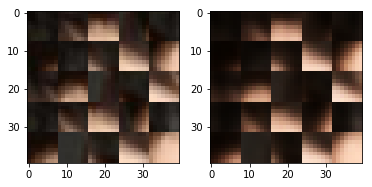

EPO: 40, recon_loss: 0.0019, total_loss: 0.0061
EPO: 40, recon_loss: 0.0060, total_loss: 0.0161
EPO: 40, recon_loss: 0.0026, total_loss: 0.0095
EPO: 40, recon_loss: 0.0029, total_loss: 0.0080
EPO: 40, recon_loss: 0.0031, total_loss: 0.0122
EPO: 40, recon_loss: 0.0031, total_loss: 0.0103
EPO: 40, recon_loss: 0.0055, total_loss: 0.0136
EPO: 40, recon_loss: 0.0030, total_loss: 0.0083
EPO: 40, recon_loss: 0.0028, total_loss: 0.0075
EPO: 40, recon_loss: 0.0039, total_loss: 0.0090
######### what? the reconstruction psnr is: 31.8769


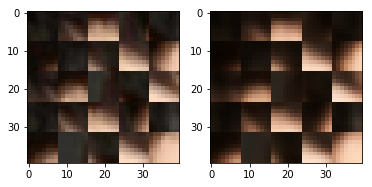

EPO: 40, recon_loss: 0.0018, total_loss: 0.0065
EPO: 40, recon_loss: 0.0055, total_loss: 0.0126
EPO: 40, recon_loss: 0.0030, total_loss: 0.0077
EPO: 40, recon_loss: 0.0019, total_loss: 0.0065
EPO: 40, recon_loss: 0.0035, total_loss: 0.0071
EPO: 40, recon_loss: 0.0017, total_loss: 0.0058
EPO: 40, recon_loss: 0.0045, total_loss: 0.0120
EPO: 40, recon_loss: 0.0048, total_loss: 0.0112
EPO: 40, recon_loss: 0.0036, total_loss: 0.0100
EPO: 40, recon_loss: 0.0070, total_loss: 0.0135
######### what? the reconstruction psnr is: 31.9552


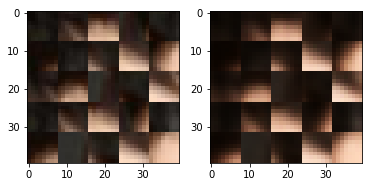

EPO: 40, recon_loss: 0.0011, total_loss: 0.0050
EPO: 40, recon_loss: 0.0036, total_loss: 0.0103
EPO: 40, recon_loss: 0.0047, total_loss: 0.0091
EPO: 40, recon_loss: 0.0036, total_loss: 0.0082
EPO: 40, recon_loss: 0.0039, total_loss: 0.0090
EPO: 40, recon_loss: 0.0014, total_loss: 0.0055
EPO: 40, recon_loss: 0.0022, total_loss: 0.0079
EPO: 40, recon_loss: 0.0019, total_loss: 0.0059
EPO: 40, recon_loss: 0.0019, total_loss: 0.0052
EPO: 40, recon_loss: 0.0018, total_loss: 0.0050
######### what? the reconstruction psnr is: 31.9772


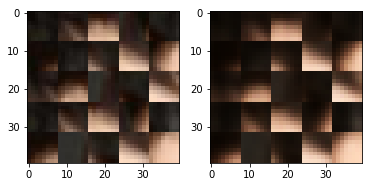

EPO: 40, recon_loss: 0.0073, total_loss: 0.0170
EPO: 40, recon_loss: 0.0048, total_loss: 0.0120
EPO: 40, recon_loss: 0.0050, total_loss: 0.0101
EPO: 40, recon_loss: 0.0046, total_loss: 0.0112
EPO: 40, recon_loss: 0.0029, total_loss: 0.0072
EPO: 40, recon_loss: 0.0047, total_loss: 0.0140
EPO: 40, recon_loss: 0.0053, total_loss: 0.0107
EPO: 40, recon_loss: 0.0056, total_loss: 0.0121
EPO: 40, recon_loss: 0.0021, total_loss: 0.0069
EPO: 40, recon_loss: 0.0050, total_loss: 0.0108
######### what? the reconstruction psnr is: 31.5350


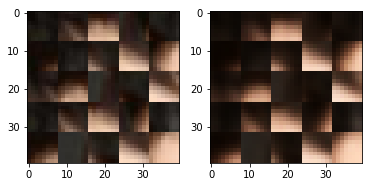

EPO: 40, recon_loss: 0.0010, total_loss: 0.0026
EPO: 40, recon_loss: 0.0007, total_loss: 0.0019
EPO: 40, recon_loss: 0.0039, total_loss: 0.0070
EPO: 40, recon_loss: 0.0011, total_loss: 0.0027
EPO: 40, recon_loss: 0.0023, total_loss: 0.0048
EPO: 40, recon_loss: 0.0031, total_loss: 0.0078
EPO: 40, recon_loss: 0.0025, total_loss: 0.0071
EPO: 40, recon_loss: 0.0030, total_loss: 0.0075
EPO: 40, recon_loss: 0.0017, total_loss: 0.0049
EPO: 40, recon_loss: 0.0021, total_loss: 0.0051
######### what? the reconstruction psnr is: 31.4500


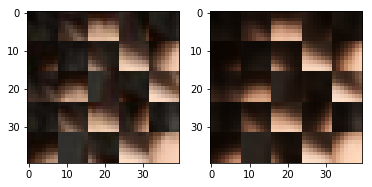

EPO: 40, recon_loss: 0.0040, total_loss: 0.0099
EPO: 40, recon_loss: 0.0035, total_loss: 0.0090
EPO: 40, recon_loss: 0.0063, total_loss: 0.0107
EPO: 40, recon_loss: 0.0042, total_loss: 0.0083
EPO: 40, recon_loss: 0.0044, total_loss: 0.0081
EPO: 40, recon_loss: 0.0068, total_loss: 0.0154
EPO: 40, recon_loss: 0.0117, total_loss: 0.0228
EPO: 40, recon_loss: 0.0060, total_loss: 0.0107
EPO: 40, recon_loss: 0.0041, total_loss: 0.0081
EPO: 40, recon_loss: 0.0067, total_loss: 0.0105
######### what? the reconstruction psnr is: 28.9964


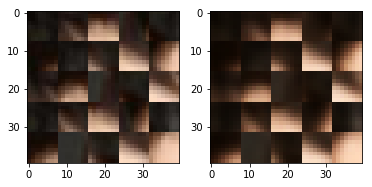

EPO: 40, recon_loss: 0.0016, total_loss: 0.0057
EPO: 40, recon_loss: 0.0010, total_loss: 0.0046
EPO: 40, recon_loss: 0.0031, total_loss: 0.0068
EPO: 40, recon_loss: 0.0019, total_loss: 0.0063
EPO: 40, recon_loss: 0.0028, total_loss: 0.0059
EPO: 40, recon_loss: 0.0027, total_loss: 0.0125
EPO: 40, recon_loss: 0.0011, total_loss: 0.0051
EPO: 40, recon_loss: 0.0024, total_loss: 0.0069
EPO: 40, recon_loss: 0.0010, total_loss: 0.0031
EPO: 40, recon_loss: 0.0010, total_loss: 0.0023
######### what? the reconstruction psnr is: 31.4003


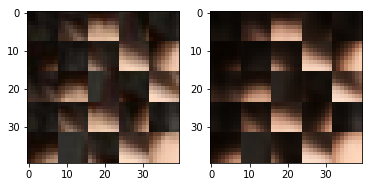

EPO: 40, recon_loss: 0.0037, total_loss: 0.0093
EPO: 40, recon_loss: 0.0040, total_loss: 0.0091
EPO: 40, recon_loss: 0.0081, total_loss: 0.0132
EPO: 40, recon_loss: 0.0074, total_loss: 0.0126
EPO: 40, recon_loss: 0.0096, total_loss: 0.0145
EPO: 41, recon_loss: 0.0040, total_loss: 0.0077
EPO: 41, recon_loss: 0.0015, total_loss: 0.0033
EPO: 41, recon_loss: 0.0045, total_loss: 0.0073
EPO: 41, recon_loss: 0.0022, total_loss: 0.0054
EPO: 41, recon_loss: 0.0018, total_loss: 0.0040
######### what? the reconstruction psnr is: 31.6008


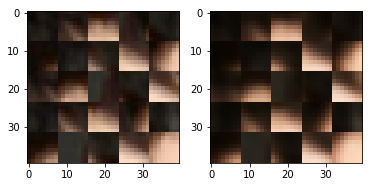

EPO: 41, recon_loss: 0.0029, total_loss: 0.0116
EPO: 41, recon_loss: 0.0013, total_loss: 0.0050
EPO: 41, recon_loss: 0.0026, total_loss: 0.0068
EPO: 41, recon_loss: 0.0040, total_loss: 0.0076
EPO: 41, recon_loss: 0.0035, total_loss: 0.0074
EPO: 41, recon_loss: 0.0039, total_loss: 0.0097
EPO: 41, recon_loss: 0.0017, total_loss: 0.0056
EPO: 41, recon_loss: 0.0022, total_loss: 0.0068
EPO: 41, recon_loss: 0.0021, total_loss: 0.0048
EPO: 41, recon_loss: 0.0022, total_loss: 0.0051
######### what? the reconstruction psnr is: 31.9168


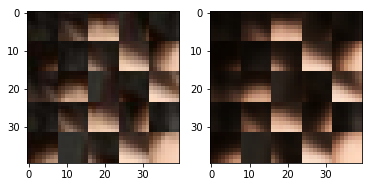

EPO: 41, recon_loss: 0.0064, total_loss: 0.0116
EPO: 41, recon_loss: 0.0024, total_loss: 0.0062
EPO: 41, recon_loss: 0.0030, total_loss: 0.0078
EPO: 41, recon_loss: 0.0031, total_loss: 0.0075
EPO: 41, recon_loss: 0.0024, total_loss: 0.0060
EPO: 41, recon_loss: 0.0027, total_loss: 0.0067
EPO: 41, recon_loss: 0.0023, total_loss: 0.0048
EPO: 41, recon_loss: 0.0024, total_loss: 0.0055
EPO: 41, recon_loss: 0.0062, total_loss: 0.0101
EPO: 41, recon_loss: 0.0017, total_loss: 0.0042
######### what? the reconstruction psnr is: 31.7695


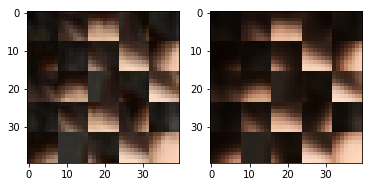

EPO: 41, recon_loss: 0.0036, total_loss: 0.0062
EPO: 41, recon_loss: 0.0054, total_loss: 0.0138
EPO: 41, recon_loss: 0.0026, total_loss: 0.0079
EPO: 41, recon_loss: 0.0066, total_loss: 0.0128
EPO: 41, recon_loss: 0.0046, total_loss: 0.0099
EPO: 41, recon_loss: 0.0081, total_loss: 0.0135
EPO: 41, recon_loss: 0.0030, total_loss: 0.0101
EPO: 41, recon_loss: 0.0015, total_loss: 0.0054
EPO: 41, recon_loss: 0.0040, total_loss: 0.0083
EPO: 41, recon_loss: 0.0028, total_loss: 0.0053
######### what? the reconstruction psnr is: 31.4307


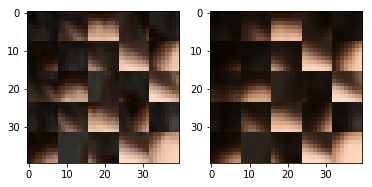

EPO: 41, recon_loss: 0.0027, total_loss: 0.0061
EPO: 41, recon_loss: 0.0009, total_loss: 0.0021
EPO: 41, recon_loss: 0.0014, total_loss: 0.0034
EPO: 41, recon_loss: 0.0046, total_loss: 0.0089
EPO: 41, recon_loss: 0.0022, total_loss: 0.0056
EPO: 41, recon_loss: 0.0034, total_loss: 0.0088
EPO: 41, recon_loss: 0.0010, total_loss: 0.0063
EPO: 41, recon_loss: 0.0015, total_loss: 0.0066
EPO: 41, recon_loss: 0.0036, total_loss: 0.0087
EPO: 41, recon_loss: 0.0008, total_loss: 0.0038
######### what? the reconstruction psnr is: 31.5443


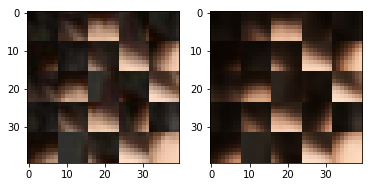

EPO: 41, recon_loss: 0.0033, total_loss: 0.0076
EPO: 41, recon_loss: 0.0061, total_loss: 0.0167
EPO: 41, recon_loss: 0.0015, total_loss: 0.0054
EPO: 41, recon_loss: 0.0075, total_loss: 0.0135
EPO: 41, recon_loss: 0.0021, total_loss: 0.0049
EPO: 41, recon_loss: 0.0020, total_loss: 0.0045
EPO: 41, recon_loss: 0.0050, total_loss: 0.0099
EPO: 41, recon_loss: 0.0022, total_loss: 0.0053
EPO: 41, recon_loss: 0.0045, total_loss: 0.0094
EPO: 41, recon_loss: 0.0027, total_loss: 0.0055
######### what? the reconstruction psnr is: 31.8246


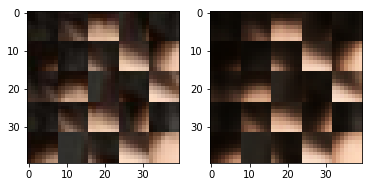

EPO: 41, recon_loss: 0.0039, total_loss: 0.0080
EPO: 41, recon_loss: 0.0114, total_loss: 0.0201
EPO: 41, recon_loss: 0.0068, total_loss: 0.0138
EPO: 41, recon_loss: 0.0110, total_loss: 0.0199
EPO: 41, recon_loss: 0.0070, total_loss: 0.0141
EPO: 41, recon_loss: 0.0063, total_loss: 0.0134
EPO: 41, recon_loss: 0.0023, total_loss: 0.0079
EPO: 41, recon_loss: 0.0027, total_loss: 0.0068
EPO: 41, recon_loss: 0.0037, total_loss: 0.0098
EPO: 41, recon_loss: 0.0046, total_loss: 0.0087
######### what? the reconstruction psnr is: 31.8140


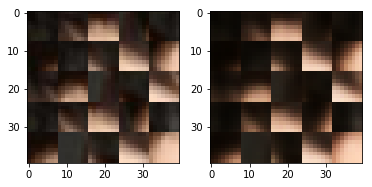

EPO: 41, recon_loss: 0.0046, total_loss: 0.0114
EPO: 41, recon_loss: 0.0029, total_loss: 0.0106
EPO: 41, recon_loss: 0.0011, total_loss: 0.0057
EPO: 41, recon_loss: 0.0046, total_loss: 0.0105
EPO: 41, recon_loss: 0.0031, total_loss: 0.0078
EPO: 41, recon_loss: 0.0029, total_loss: 0.0080
EPO: 41, recon_loss: 0.0055, total_loss: 0.0143
EPO: 41, recon_loss: 0.0046, total_loss: 0.0139
EPO: 41, recon_loss: 0.0094, total_loss: 0.0209
EPO: 41, recon_loss: 0.0087, total_loss: 0.0196
######### what? the reconstruction psnr is: 31.8062


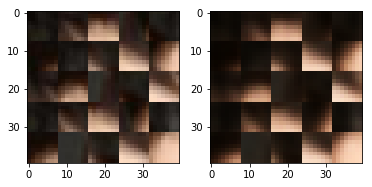

EPO: 41, recon_loss: 0.0045, total_loss: 0.0135
EPO: 41, recon_loss: 0.0146, total_loss: 0.0264
EPO: 41, recon_loss: 0.0048, total_loss: 0.0138
EPO: 41, recon_loss: 0.0077, total_loss: 0.0184
EPO: 41, recon_loss: 0.0113, total_loss: 0.0222
EPO: 41, recon_loss: 0.0067, total_loss: 0.0176
EPO: 41, recon_loss: 0.0080, total_loss: 0.0176
EPO: 41, recon_loss: 0.0014, total_loss: 0.0092
EPO: 41, recon_loss: 0.0085, total_loss: 0.0181
EPO: 41, recon_loss: 0.0116, total_loss: 0.0180
######### what? the reconstruction psnr is: 31.1534


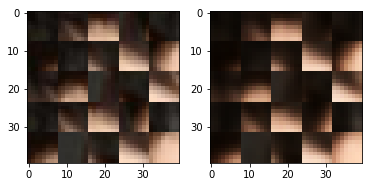

EPO: 41, recon_loss: 0.0029, total_loss: 0.0064
EPO: 41, recon_loss: 0.0026, total_loss: 0.0057
EPO: 41, recon_loss: 0.0016, total_loss: 0.0053
EPO: 41, recon_loss: 0.0027, total_loss: 0.0081
EPO: 41, recon_loss: 0.0047, total_loss: 0.0104
EPO: 41, recon_loss: 0.0033, total_loss: 0.0093
EPO: 41, recon_loss: 0.0057, total_loss: 0.0127
EPO: 41, recon_loss: 0.0004, total_loss: 0.0020
EPO: 41, recon_loss: 0.0005, total_loss: 0.0022
EPO: 41, recon_loss: 0.0012, total_loss: 0.0030
######### what? the reconstruction psnr is: 31.7613


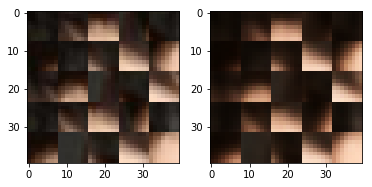

EPO: 41, recon_loss: 0.0006, total_loss: 0.0018
EPO: 41, recon_loss: 0.0018, total_loss: 0.0042
EPO: 41, recon_loss: 0.0021, total_loss: 0.0064
EPO: 41, recon_loss: 0.0024, total_loss: 0.0063
EPO: 41, recon_loss: 0.0042, total_loss: 0.0094
EPO: 41, recon_loss: 0.0020, total_loss: 0.0044
EPO: 41, recon_loss: 0.0035, total_loss: 0.0061
EPO: 41, recon_loss: 0.0046, total_loss: 0.0123
EPO: 41, recon_loss: 0.0074, total_loss: 0.0168
EPO: 41, recon_loss: 0.0050, total_loss: 0.0135
######### what? the reconstruction psnr is: 31.5217


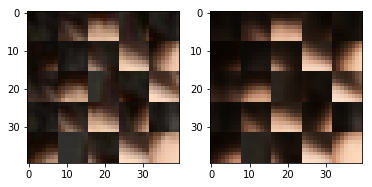

EPO: 41, recon_loss: 0.0038, total_loss: 0.0097
EPO: 41, recon_loss: 0.0046, total_loss: 0.0090
EPO: 41, recon_loss: 0.0028, total_loss: 0.0073
EPO: 41, recon_loss: 0.0023, total_loss: 0.0054
EPO: 41, recon_loss: 0.0039, total_loss: 0.0083
EPO: 41, recon_loss: 0.0018, total_loss: 0.0042
EPO: 41, recon_loss: 0.0024, total_loss: 0.0057
EPO: 41, recon_loss: 0.0026, total_loss: 0.0111
EPO: 41, recon_loss: 0.0008, total_loss: 0.0042
EPO: 41, recon_loss: 0.0050, total_loss: 0.0111
######### what? the reconstruction psnr is: 31.3662


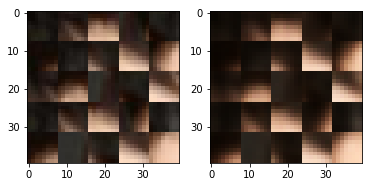

EPO: 41, recon_loss: 0.0030, total_loss: 0.0069
EPO: 41, recon_loss: 0.0033, total_loss: 0.0079
EPO: 41, recon_loss: 0.0011, total_loss: 0.0031
EPO: 41, recon_loss: 0.0010, total_loss: 0.0029
EPO: 41, recon_loss: 0.0020, total_loss: 0.0052
EPO: 41, recon_loss: 0.0008, total_loss: 0.0030
EPO: 41, recon_loss: 0.0011, total_loss: 0.0029
EPO: 41, recon_loss: 0.0025, total_loss: 0.0067
EPO: 41, recon_loss: 0.0017, total_loss: 0.0049
EPO: 41, recon_loss: 0.0054, total_loss: 0.0105
######### what? the reconstruction psnr is: 31.7896


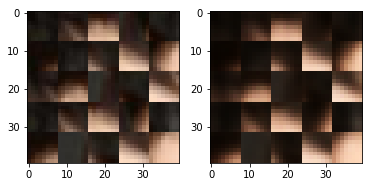

EPO: 41, recon_loss: 0.0027, total_loss: 0.0070
EPO: 41, recon_loss: 0.0022, total_loss: 0.0057
EPO: 41, recon_loss: 0.0024, total_loss: 0.0103
EPO: 41, recon_loss: 0.0028, total_loss: 0.0085
EPO: 41, recon_loss: 0.0081, total_loss: 0.0157
EPO: 41, recon_loss: 0.0034, total_loss: 0.0081
EPO: 41, recon_loss: 0.0045, total_loss: 0.0103
EPO: 41, recon_loss: 0.0014, total_loss: 0.0064
EPO: 41, recon_loss: 0.0004, total_loss: 0.0026
EPO: 41, recon_loss: 0.0028, total_loss: 0.0076
######### what? the reconstruction psnr is: 30.9941


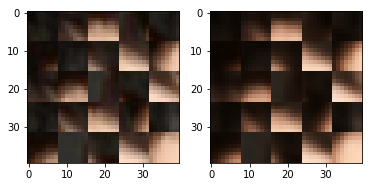

EPO: 41, recon_loss: 0.0039, total_loss: 0.0075
EPO: 41, recon_loss: 0.0035, total_loss: 0.0081
EPO: 41, recon_loss: 0.0041, total_loss: 0.0093
EPO: 41, recon_loss: 0.0055, total_loss: 0.0110
EPO: 41, recon_loss: 0.0043, total_loss: 0.0103
EPO: 41, recon_loss: 0.0040, total_loss: 0.0092
EPO: 41, recon_loss: 0.0015, total_loss: 0.0044
EPO: 41, recon_loss: 0.0050, total_loss: 0.0106
EPO: 41, recon_loss: 0.0010, total_loss: 0.0038
EPO: 41, recon_loss: 0.0048, total_loss: 0.0099
######### what? the reconstruction psnr is: 31.5862


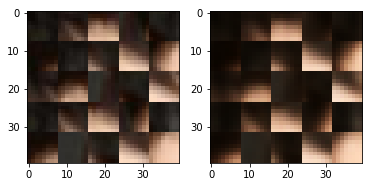

EPO: 41, recon_loss: 0.0049, total_loss: 0.0104
EPO: 41, recon_loss: 0.0024, total_loss: 0.0060
EPO: 41, recon_loss: 0.0026, total_loss: 0.0063
EPO: 41, recon_loss: 0.0030, total_loss: 0.0076
EPO: 41, recon_loss: 0.0028, total_loss: 0.0075
EPO: 41, recon_loss: 0.0061, total_loss: 0.0108
EPO: 41, recon_loss: 0.0037, total_loss: 0.0095
EPO: 41, recon_loss: 0.0056, total_loss: 0.0106
EPO: 41, recon_loss: 0.0031, total_loss: 0.0075
EPO: 41, recon_loss: 0.0011, total_loss: 0.0036
######### what? the reconstruction psnr is: 31.8610


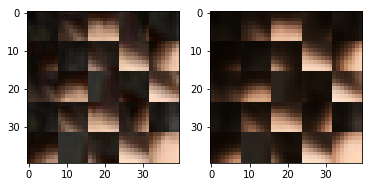

EPO: 41, recon_loss: 0.0030, total_loss: 0.0064
EPO: 41, recon_loss: 0.0027, total_loss: 0.0066
EPO: 41, recon_loss: 0.0046, total_loss: 0.0100
EPO: 41, recon_loss: 0.0028, total_loss: 0.0078
EPO: 41, recon_loss: 0.0029, total_loss: 0.0080
EPO: 41, recon_loss: 0.0084, total_loss: 0.0157
EPO: 41, recon_loss: 0.0027, total_loss: 0.0078
EPO: 41, recon_loss: 0.0067, total_loss: 0.0147
EPO: 41, recon_loss: 0.0019, total_loss: 0.0061
EPO: 41, recon_loss: 0.0012, total_loss: 0.0049
######### what? the reconstruction psnr is: 31.9784


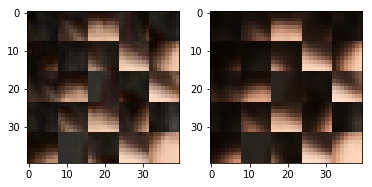

EPO: 41, recon_loss: 0.0050, total_loss: 0.0121
EPO: 41, recon_loss: 0.0023, total_loss: 0.0068
EPO: 41, recon_loss: 0.0057, total_loss: 0.0115
EPO: 41, recon_loss: 0.0017, total_loss: 0.0031
EPO: 41, recon_loss: 0.0014, total_loss: 0.0028
EPO: 41, recon_loss: 0.0034, total_loss: 0.0068
EPO: 41, recon_loss: 0.0013, total_loss: 0.0046
EPO: 41, recon_loss: 0.0025, total_loss: 0.0068
EPO: 41, recon_loss: 0.0087, total_loss: 0.0197
EPO: 41, recon_loss: 0.0065, total_loss: 0.0158
######### what? the reconstruction psnr is: 31.7583


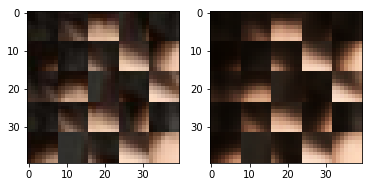

EPO: 41, recon_loss: 0.0099, total_loss: 0.0230
EPO: 41, recon_loss: 0.0049, total_loss: 0.0140
EPO: 41, recon_loss: 0.0082, total_loss: 0.0212
EPO: 41, recon_loss: 0.0015, total_loss: 0.0068
EPO: 41, recon_loss: 0.0030, total_loss: 0.0074
EPO: 41, recon_loss: 0.0049, total_loss: 0.0147
EPO: 41, recon_loss: 0.0028, total_loss: 0.0089
EPO: 41, recon_loss: 0.0029, total_loss: 0.0081
EPO: 41, recon_loss: 0.0031, total_loss: 0.0119
EPO: 41, recon_loss: 0.0034, total_loss: 0.0108
######### what? the reconstruction psnr is: 32.1567


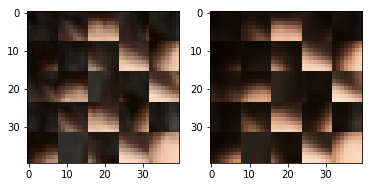

EPO: 41, recon_loss: 0.0073, total_loss: 0.0156
EPO: 41, recon_loss: 0.0019, total_loss: 0.0068
EPO: 41, recon_loss: 0.0020, total_loss: 0.0064
EPO: 41, recon_loss: 0.0038, total_loss: 0.0098
EPO: 41, recon_loss: 0.0013, total_loss: 0.0060
EPO: 41, recon_loss: 0.0068, total_loss: 0.0137
EPO: 41, recon_loss: 0.0018, total_loss: 0.0063
EPO: 41, recon_loss: 0.0023, total_loss: 0.0069
EPO: 41, recon_loss: 0.0033, total_loss: 0.0069
EPO: 41, recon_loss: 0.0018, total_loss: 0.0063
######### what? the reconstruction psnr is: 31.8413


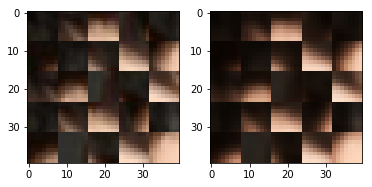

EPO: 41, recon_loss: 0.0073, total_loss: 0.0143
EPO: 41, recon_loss: 0.0038, total_loss: 0.0104
EPO: 41, recon_loss: 0.0033, total_loss: 0.0085
EPO: 41, recon_loss: 0.0035, total_loss: 0.0139
EPO: 41, recon_loss: 0.0011, total_loss: 0.0050
EPO: 41, recon_loss: 0.0051, total_loss: 0.0136
EPO: 41, recon_loss: 0.0034, total_loss: 0.0065
EPO: 41, recon_loss: 0.0030, total_loss: 0.0075
EPO: 41, recon_loss: 0.0026, total_loss: 0.0087
EPO: 41, recon_loss: 0.0014, total_loss: 0.0055
######### what? the reconstruction psnr is: 32.0077


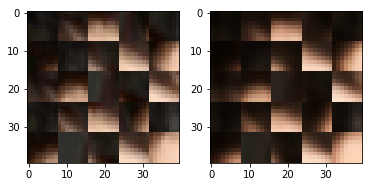

EPO: 41, recon_loss: 0.0025, total_loss: 0.0083
EPO: 41, recon_loss: 0.0014, total_loss: 0.0049
EPO: 41, recon_loss: 0.0023, total_loss: 0.0058
EPO: 41, recon_loss: 0.0051, total_loss: 0.0125
EPO: 41, recon_loss: 0.0082, total_loss: 0.0177
EPO: 41, recon_loss: 0.0041, total_loss: 0.0105
EPO: 41, recon_loss: 0.0047, total_loss: 0.0109
EPO: 41, recon_loss: 0.0047, total_loss: 0.0112
EPO: 41, recon_loss: 0.0026, total_loss: 0.0060
EPO: 41, recon_loss: 0.0035, total_loss: 0.0114
######### what? the reconstruction psnr is: 31.2200


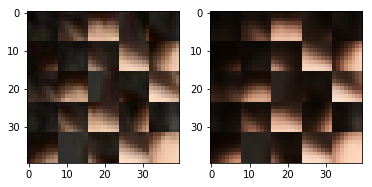

EPO: 41, recon_loss: 0.0059, total_loss: 0.0117
EPO: 41, recon_loss: 0.0045, total_loss: 0.0109
EPO: 41, recon_loss: 0.0029, total_loss: 0.0082
EPO: 41, recon_loss: 0.0060, total_loss: 0.0125
EPO: 41, recon_loss: 0.0007, total_loss: 0.0020
EPO: 41, recon_loss: 0.0014, total_loss: 0.0037
EPO: 41, recon_loss: 0.0028, total_loss: 0.0050
EPO: 41, recon_loss: 0.0011, total_loss: 0.0026
EPO: 41, recon_loss: 0.0026, total_loss: 0.0053
EPO: 41, recon_loss: 0.0035, total_loss: 0.0090
######### what? the reconstruction psnr is: 31.4981


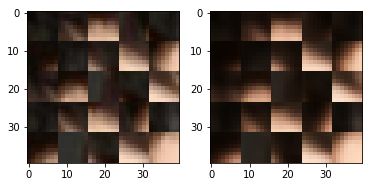

EPO: 41, recon_loss: 0.0023, total_loss: 0.0068
EPO: 41, recon_loss: 0.0030, total_loss: 0.0076
EPO: 41, recon_loss: 0.0021, total_loss: 0.0052
EPO: 41, recon_loss: 0.0029, total_loss: 0.0064
EPO: 41, recon_loss: 0.0036, total_loss: 0.0089
EPO: 41, recon_loss: 0.0031, total_loss: 0.0087
EPO: 41, recon_loss: 0.0071, total_loss: 0.0115
EPO: 41, recon_loss: 0.0036, total_loss: 0.0077
EPO: 41, recon_loss: 0.0057, total_loss: 0.0100
EPO: 41, recon_loss: 0.0097, total_loss: 0.0193
######### what? the reconstruction psnr is: 31.3171


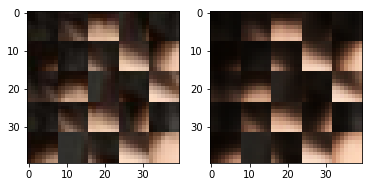

EPO: 41, recon_loss: 0.0083, total_loss: 0.0150
EPO: 41, recon_loss: 0.0056, total_loss: 0.0104
EPO: 41, recon_loss: 0.0042, total_loss: 0.0075
EPO: 41, recon_loss: 0.0085, total_loss: 0.0122
EPO: 41, recon_loss: 0.0011, total_loss: 0.0045
EPO: 41, recon_loss: 0.0015, total_loss: 0.0054
EPO: 41, recon_loss: 0.0039, total_loss: 0.0074
EPO: 41, recon_loss: 0.0026, total_loss: 0.0076
EPO: 41, recon_loss: 0.0041, total_loss: 0.0082
EPO: 41, recon_loss: 0.0026, total_loss: 0.0114
######### what? the reconstruction psnr is: 31.7415


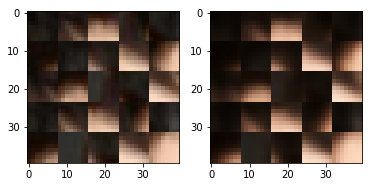

EPO: 41, recon_loss: 0.0011, total_loss: 0.0050
EPO: 41, recon_loss: 0.0041, total_loss: 0.0086
EPO: 41, recon_loss: 0.0007, total_loss: 0.0023
EPO: 41, recon_loss: 0.0012, total_loss: 0.0025
EPO: 41, recon_loss: 0.0042, total_loss: 0.0095
EPO: 41, recon_loss: 0.0042, total_loss: 0.0096
EPO: 41, recon_loss: 0.0092, total_loss: 0.0145
EPO: 41, recon_loss: 0.0082, total_loss: 0.0132
EPO: 41, recon_loss: 0.0090, total_loss: 0.0133
EPO: 42, recon_loss: 0.0031, total_loss: 0.0059
######### what? the reconstruction psnr is: 31.2413


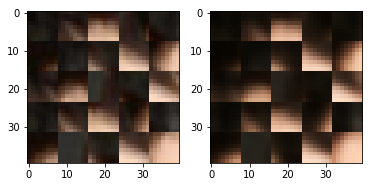

EPO: 42, recon_loss: 0.0015, total_loss: 0.0032
EPO: 42, recon_loss: 0.0057, total_loss: 0.0089
EPO: 42, recon_loss: 0.0016, total_loss: 0.0037
EPO: 42, recon_loss: 0.0019, total_loss: 0.0038
EPO: 42, recon_loss: 0.0022, total_loss: 0.0087
EPO: 42, recon_loss: 0.0013, total_loss: 0.0050
EPO: 42, recon_loss: 0.0024, total_loss: 0.0064
EPO: 42, recon_loss: 0.0020, total_loss: 0.0043
EPO: 42, recon_loss: 0.0044, total_loss: 0.0085
EPO: 42, recon_loss: 0.0020, total_loss: 0.0079
######### what? the reconstruction psnr is: 31.8000


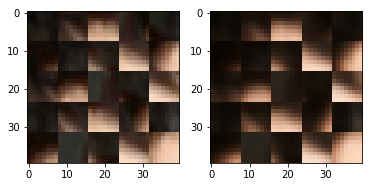

EPO: 42, recon_loss: 0.0014, total_loss: 0.0048
EPO: 42, recon_loss: 0.0021, total_loss: 0.0065
EPO: 42, recon_loss: 0.0017, total_loss: 0.0040
EPO: 42, recon_loss: 0.0025, total_loss: 0.0058
EPO: 42, recon_loss: 0.0025, total_loss: 0.0067
EPO: 42, recon_loss: 0.0029, total_loss: 0.0074
EPO: 42, recon_loss: 0.0029, total_loss: 0.0068
EPO: 42, recon_loss: 0.0026, total_loss: 0.0066
EPO: 42, recon_loss: 0.0021, total_loss: 0.0051
EPO: 42, recon_loss: 0.0025, total_loss: 0.0052
######### what? the reconstruction psnr is: 31.9566


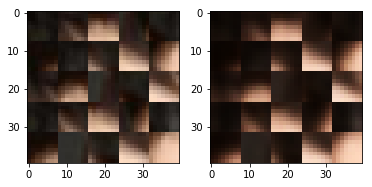

EPO: 42, recon_loss: 0.0016, total_loss: 0.0042
EPO: 42, recon_loss: 0.0027, total_loss: 0.0063
EPO: 42, recon_loss: 0.0052, total_loss: 0.0090
EPO: 42, recon_loss: 0.0018, total_loss: 0.0038
EPO: 42, recon_loss: 0.0037, total_loss: 0.0077
EPO: 42, recon_loss: 0.0027, total_loss: 0.0081
EPO: 42, recon_loss: 0.0028, total_loss: 0.0080
EPO: 42, recon_loss: 0.0061, total_loss: 0.0120
EPO: 42, recon_loss: 0.0052, total_loss: 0.0120
EPO: 42, recon_loss: 0.0057, total_loss: 0.0103
######### what? the reconstruction psnr is: 31.7731


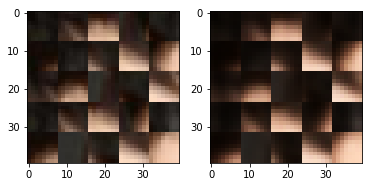

EPO: 42, recon_loss: 0.0023, total_loss: 0.0076
EPO: 42, recon_loss: 0.0019, total_loss: 0.0068
EPO: 42, recon_loss: 0.0037, total_loss: 0.0073
EPO: 42, recon_loss: 0.0025, total_loss: 0.0051
EPO: 42, recon_loss: 0.0033, total_loss: 0.0074
EPO: 42, recon_loss: 0.0009, total_loss: 0.0022
EPO: 42, recon_loss: 0.0021, total_loss: 0.0054
EPO: 42, recon_loss: 0.0042, total_loss: 0.0076
EPO: 42, recon_loss: 0.0025, total_loss: 0.0062
EPO: 42, recon_loss: 0.0045, total_loss: 0.0100
######### what? the reconstruction psnr is: 31.8980


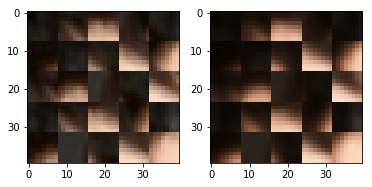

EPO: 42, recon_loss: 0.0011, total_loss: 0.0064
EPO: 42, recon_loss: 0.0013, total_loss: 0.0060
EPO: 42, recon_loss: 0.0043, total_loss: 0.0088
EPO: 42, recon_loss: 0.0009, total_loss: 0.0040
EPO: 42, recon_loss: 0.0040, total_loss: 0.0089
EPO: 42, recon_loss: 0.0057, total_loss: 0.0164
EPO: 42, recon_loss: 0.0020, total_loss: 0.0063
EPO: 42, recon_loss: 0.0055, total_loss: 0.0105
EPO: 42, recon_loss: 0.0018, total_loss: 0.0042
EPO: 42, recon_loss: 0.0028, total_loss: 0.0058
######### what? the reconstruction psnr is: 31.8951


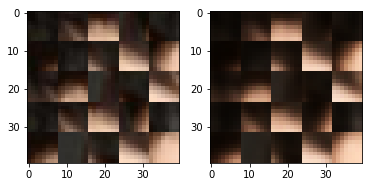

EPO: 42, recon_loss: 0.0045, total_loss: 0.0096
EPO: 42, recon_loss: 0.0018, total_loss: 0.0046
EPO: 42, recon_loss: 0.0044, total_loss: 0.0092
EPO: 42, recon_loss: 0.0026, total_loss: 0.0053
EPO: 42, recon_loss: 0.0045, total_loss: 0.0098
EPO: 42, recon_loss: 0.0071, total_loss: 0.0139
EPO: 42, recon_loss: 0.0075, total_loss: 0.0148
EPO: 42, recon_loss: 0.0141, total_loss: 0.0235
EPO: 42, recon_loss: 0.0085, total_loss: 0.0162
EPO: 42, recon_loss: 0.0066, total_loss: 0.0132
######### what? the reconstruction psnr is: 30.6723


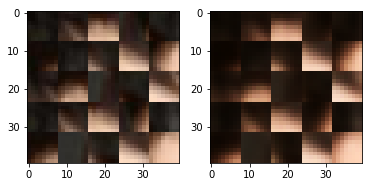

EPO: 42, recon_loss: 0.0024, total_loss: 0.0074
EPO: 42, recon_loss: 0.0028, total_loss: 0.0073
EPO: 42, recon_loss: 0.0037, total_loss: 0.0090
EPO: 42, recon_loss: 0.0033, total_loss: 0.0073
EPO: 42, recon_loss: 0.0047, total_loss: 0.0108
EPO: 42, recon_loss: 0.0025, total_loss: 0.0086
EPO: 42, recon_loss: 0.0011, total_loss: 0.0056
EPO: 42, recon_loss: 0.0055, total_loss: 0.0106
EPO: 42, recon_loss: 0.0025, total_loss: 0.0074
EPO: 42, recon_loss: 0.0029, total_loss: 0.0073
######### what? the reconstruction psnr is: 31.3691


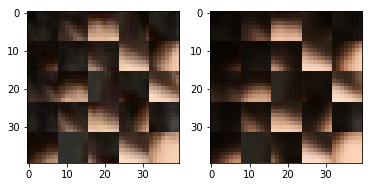

EPO: 42, recon_loss: 0.0059, total_loss: 0.0148
EPO: 42, recon_loss: 0.0048, total_loss: 0.0157
EPO: 42, recon_loss: 0.0099, total_loss: 0.0207
EPO: 42, recon_loss: 0.0059, total_loss: 0.0154
EPO: 42, recon_loss: 0.0047, total_loss: 0.0134
EPO: 42, recon_loss: 0.0080, total_loss: 0.0172
EPO: 42, recon_loss: 0.0050, total_loss: 0.0141
EPO: 42, recon_loss: 0.0114, total_loss: 0.0235
EPO: 42, recon_loss: 0.0083, total_loss: 0.0185
EPO: 42, recon_loss: 0.0069, total_loss: 0.0178
######### what? the reconstruction psnr is: 31.9640


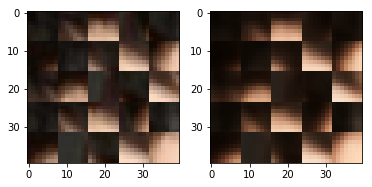

EPO: 42, recon_loss: 0.0022, total_loss: 0.0104
EPO: 42, recon_loss: 0.0022, total_loss: 0.0106
EPO: 42, recon_loss: 0.0113, total_loss: 0.0203
EPO: 42, recon_loss: 0.0128, total_loss: 0.0189
EPO: 42, recon_loss: 0.0020, total_loss: 0.0048
EPO: 42, recon_loss: 0.0027, total_loss: 0.0061
EPO: 42, recon_loss: 0.0018, total_loss: 0.0063
EPO: 42, recon_loss: 0.0033, total_loss: 0.0088
EPO: 42, recon_loss: 0.0040, total_loss: 0.0095
EPO: 42, recon_loss: 0.0034, total_loss: 0.0102
######### what? the reconstruction psnr is: 31.7025


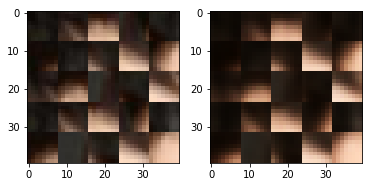

EPO: 42, recon_loss: 0.0073, total_loss: 0.0150
EPO: 42, recon_loss: 0.0004, total_loss: 0.0019
EPO: 42, recon_loss: 0.0005, total_loss: 0.0024
EPO: 42, recon_loss: 0.0011, total_loss: 0.0025
EPO: 42, recon_loss: 0.0007, total_loss: 0.0019
EPO: 42, recon_loss: 0.0021, total_loss: 0.0048
EPO: 42, recon_loss: 0.0019, total_loss: 0.0056
EPO: 42, recon_loss: 0.0029, total_loss: 0.0073
EPO: 42, recon_loss: 0.0046, total_loss: 0.0094
EPO: 42, recon_loss: 0.0020, total_loss: 0.0044
######### what? the reconstruction psnr is: 31.8161


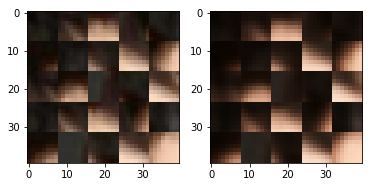

EPO: 42, recon_loss: 0.0051, total_loss: 0.0087
EPO: 42, recon_loss: 0.0047, total_loss: 0.0126
EPO: 42, recon_loss: 0.0065, total_loss: 0.0149
EPO: 42, recon_loss: 0.0048, total_loss: 0.0129
EPO: 42, recon_loss: 0.0037, total_loss: 0.0089
EPO: 42, recon_loss: 0.0049, total_loss: 0.0100
EPO: 42, recon_loss: 0.0031, total_loss: 0.0076
EPO: 42, recon_loss: 0.0024, total_loss: 0.0055
EPO: 42, recon_loss: 0.0041, total_loss: 0.0084
EPO: 42, recon_loss: 0.0025, total_loss: 0.0056
######### what? the reconstruction psnr is: 31.3793


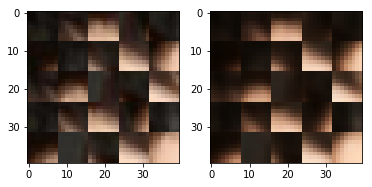

EPO: 42, recon_loss: 0.0034, total_loss: 0.0074
EPO: 42, recon_loss: 0.0024, total_loss: 0.0099
EPO: 42, recon_loss: 0.0014, total_loss: 0.0044
EPO: 42, recon_loss: 0.0044, total_loss: 0.0095
EPO: 42, recon_loss: 0.0032, total_loss: 0.0073
EPO: 42, recon_loss: 0.0041, total_loss: 0.0101
EPO: 42, recon_loss: 0.0012, total_loss: 0.0032
EPO: 42, recon_loss: 0.0011, total_loss: 0.0031
EPO: 42, recon_loss: 0.0020, total_loss: 0.0051
EPO: 42, recon_loss: 0.0008, total_loss: 0.0027
######### what? the reconstruction psnr is: 31.4962


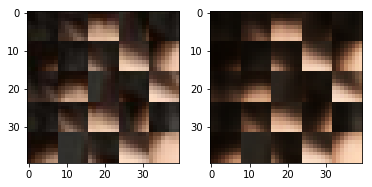

EPO: 42, recon_loss: 0.0011, total_loss: 0.0029
EPO: 42, recon_loss: 0.0024, total_loss: 0.0062
EPO: 42, recon_loss: 0.0016, total_loss: 0.0048
EPO: 42, recon_loss: 0.0064, total_loss: 0.0122
EPO: 42, recon_loss: 0.0032, total_loss: 0.0079
EPO: 42, recon_loss: 0.0022, total_loss: 0.0052
EPO: 42, recon_loss: 0.0020, total_loss: 0.0080
EPO: 42, recon_loss: 0.0022, total_loss: 0.0076
EPO: 42, recon_loss: 0.0092, total_loss: 0.0171
EPO: 42, recon_loss: 0.0029, total_loss: 0.0072
######### what? the reconstruction psnr is: 31.1885


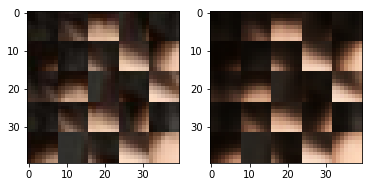

EPO: 42, recon_loss: 0.0065, total_loss: 0.0129
EPO: 42, recon_loss: 0.0009, total_loss: 0.0050
EPO: 42, recon_loss: 0.0004, total_loss: 0.0026
EPO: 42, recon_loss: 0.0055, total_loss: 0.0111
EPO: 42, recon_loss: 0.0035, total_loss: 0.0066
EPO: 42, recon_loss: 0.0036, total_loss: 0.0073
EPO: 42, recon_loss: 0.0041, total_loss: 0.0087
EPO: 42, recon_loss: 0.0049, total_loss: 0.0110
EPO: 42, recon_loss: 0.0048, total_loss: 0.0103
EPO: 42, recon_loss: 0.0023, total_loss: 0.0063
######### what? the reconstruction psnr is: 31.8869


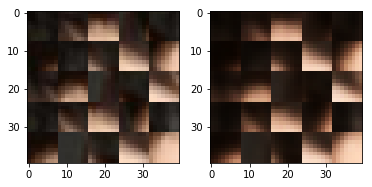

EPO: 42, recon_loss: 0.0016, total_loss: 0.0044
EPO: 42, recon_loss: 0.0022, total_loss: 0.0067
EPO: 42, recon_loss: 0.0009, total_loss: 0.0038
EPO: 42, recon_loss: 0.0058, total_loss: 0.0121
EPO: 42, recon_loss: 0.0016, total_loss: 0.0049
EPO: 42, recon_loss: 0.0021, total_loss: 0.0055
EPO: 42, recon_loss: 0.0041, total_loss: 0.0089
EPO: 42, recon_loss: 0.0027, total_loss: 0.0074
EPO: 42, recon_loss: 0.0030, total_loss: 0.0078
EPO: 42, recon_loss: 0.0047, total_loss: 0.0093
######### what? the reconstruction psnr is: 32.0419


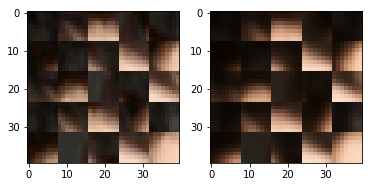

EPO: 42, recon_loss: 0.0039, total_loss: 0.0098
EPO: 42, recon_loss: 0.0045, total_loss: 0.0153
EPO: 42, recon_loss: 0.0025, total_loss: 0.0058
EPO: 42, recon_loss: 0.0018, total_loss: 0.0051
EPO: 42, recon_loss: 0.0021, total_loss: 0.0050
EPO: 42, recon_loss: 0.0037, total_loss: 0.0084
EPO: 42, recon_loss: 0.0035, total_loss: 0.0084
EPO: 42, recon_loss: 0.0019, total_loss: 0.0059
EPO: 42, recon_loss: 0.0044, total_loss: 0.0099
EPO: 42, recon_loss: 0.0066, total_loss: 0.0133
######### what? the reconstruction psnr is: 31.6211


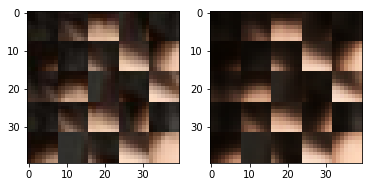

EPO: 42, recon_loss: 0.0032, total_loss: 0.0096
EPO: 42, recon_loss: 0.0071, total_loss: 0.0145
EPO: 42, recon_loss: 0.0016, total_loss: 0.0057
EPO: 42, recon_loss: 0.0019, total_loss: 0.0064
EPO: 42, recon_loss: 0.0044, total_loss: 0.0104
EPO: 42, recon_loss: 0.0027, total_loss: 0.0075
EPO: 42, recon_loss: 0.0055, total_loss: 0.0114
EPO: 42, recon_loss: 0.0016, total_loss: 0.0029
EPO: 42, recon_loss: 0.0014, total_loss: 0.0029
EPO: 42, recon_loss: 0.0038, total_loss: 0.0083
######### what? the reconstruction psnr is: 31.8988


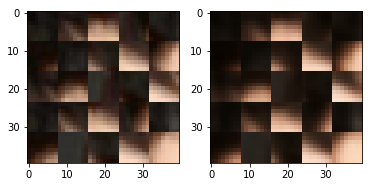

EPO: 42, recon_loss: 0.0014, total_loss: 0.0048
EPO: 42, recon_loss: 0.0026, total_loss: 0.0067
EPO: 42, recon_loss: 0.0095, total_loss: 0.0198
EPO: 42, recon_loss: 0.0050, total_loss: 0.0146
EPO: 42, recon_loss: 0.0124, total_loss: 0.0246
EPO: 42, recon_loss: 0.0055, total_loss: 0.0159
EPO: 42, recon_loss: 0.0083, total_loss: 0.0219
EPO: 42, recon_loss: 0.0018, total_loss: 0.0083
EPO: 42, recon_loss: 0.0033, total_loss: 0.0072
EPO: 42, recon_loss: 0.0040, total_loss: 0.0130
######### what? the reconstruction psnr is: 32.1369


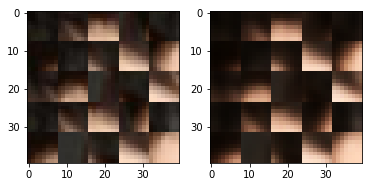

EPO: 42, recon_loss: 0.0027, total_loss: 0.0083
EPO: 42, recon_loss: 0.0030, total_loss: 0.0084
EPO: 42, recon_loss: 0.0033, total_loss: 0.0124
EPO: 42, recon_loss: 0.0033, total_loss: 0.0096
EPO: 42, recon_loss: 0.0088, total_loss: 0.0171
EPO: 42, recon_loss: 0.0019, total_loss: 0.0068
EPO: 42, recon_loss: 0.0020, total_loss: 0.0072
EPO: 42, recon_loss: 0.0030, total_loss: 0.0089
EPO: 42, recon_loss: 0.0012, total_loss: 0.0063
EPO: 42, recon_loss: 0.0081, total_loss: 0.0151
######### what? the reconstruction psnr is: 32.1084


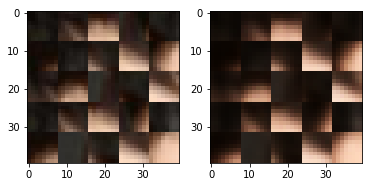

EPO: 42, recon_loss: 0.0016, total_loss: 0.0061
EPO: 42, recon_loss: 0.0028, total_loss: 0.0084
EPO: 42, recon_loss: 0.0024, total_loss: 0.0060
EPO: 42, recon_loss: 0.0022, total_loss: 0.0077
EPO: 42, recon_loss: 0.0092, total_loss: 0.0156
EPO: 42, recon_loss: 0.0028, total_loss: 0.0085
EPO: 42, recon_loss: 0.0030, total_loss: 0.0072
EPO: 42, recon_loss: 0.0029, total_loss: 0.0111
EPO: 42, recon_loss: 0.0011, total_loss: 0.0051
EPO: 42, recon_loss: 0.0068, total_loss: 0.0149
######### what? the reconstruction psnr is: 32.1027


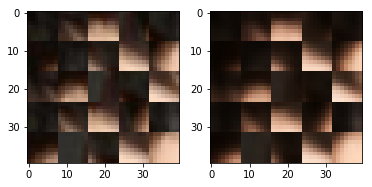

EPO: 42, recon_loss: 0.0017, total_loss: 0.0039
EPO: 42, recon_loss: 0.0037, total_loss: 0.0087
EPO: 42, recon_loss: 0.0022, total_loss: 0.0083
EPO: 42, recon_loss: 0.0013, total_loss: 0.0054
EPO: 42, recon_loss: 0.0029, total_loss: 0.0084
EPO: 42, recon_loss: 0.0011, total_loss: 0.0041
EPO: 42, recon_loss: 0.0025, total_loss: 0.0063
EPO: 42, recon_loss: 0.0085, total_loss: 0.0190
EPO: 42, recon_loss: 0.0068, total_loss: 0.0160
EPO: 42, recon_loss: 0.0033, total_loss: 0.0085
######### what? the reconstruction psnr is: 31.6405


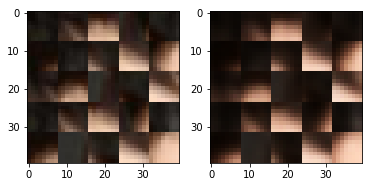

EPO: 42, recon_loss: 0.0036, total_loss: 0.0101
EPO: 42, recon_loss: 0.0034, total_loss: 0.0079
EPO: 42, recon_loss: 0.0059, total_loss: 0.0159
EPO: 42, recon_loss: 0.0028, total_loss: 0.0099
EPO: 42, recon_loss: 0.0044, total_loss: 0.0096
EPO: 42, recon_loss: 0.0034, total_loss: 0.0088
EPO: 42, recon_loss: 0.0041, total_loss: 0.0105
EPO: 42, recon_loss: 0.0021, total_loss: 0.0062
EPO: 42, recon_loss: 0.0006, total_loss: 0.0018
EPO: 42, recon_loss: 0.0017, total_loss: 0.0046
######### what? the reconstruction psnr is: 31.7337


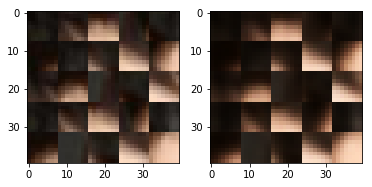

EPO: 42, recon_loss: 0.0018, total_loss: 0.0035
EPO: 42, recon_loss: 0.0012, total_loss: 0.0028
EPO: 42, recon_loss: 0.0032, total_loss: 0.0061
EPO: 42, recon_loss: 0.0027, total_loss: 0.0071
EPO: 42, recon_loss: 0.0032, total_loss: 0.0082
EPO: 42, recon_loss: 0.0027, total_loss: 0.0069
EPO: 42, recon_loss: 0.0022, total_loss: 0.0050
EPO: 42, recon_loss: 0.0034, total_loss: 0.0073
EPO: 42, recon_loss: 0.0032, total_loss: 0.0083
EPO: 42, recon_loss: 0.0043, total_loss: 0.0104
######### what? the reconstruction psnr is: 31.4257


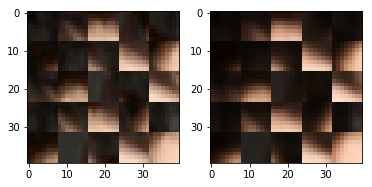

EPO: 42, recon_loss: 0.0055, total_loss: 0.0094
EPO: 42, recon_loss: 0.0040, total_loss: 0.0084
EPO: 42, recon_loss: 0.0074, total_loss: 0.0120
EPO: 42, recon_loss: 0.0090, total_loss: 0.0183
EPO: 42, recon_loss: 0.0062, total_loss: 0.0111
EPO: 42, recon_loss: 0.0059, total_loss: 0.0104
EPO: 42, recon_loss: 0.0043, total_loss: 0.0076
EPO: 42, recon_loss: 0.0103, total_loss: 0.0143
EPO: 42, recon_loss: 0.0010, total_loss: 0.0043
EPO: 42, recon_loss: 0.0016, total_loss: 0.0055
######### what? the reconstruction psnr is: 31.1925


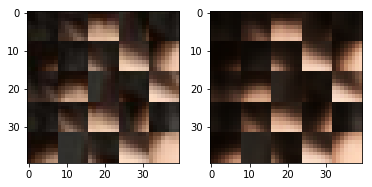

EPO: 42, recon_loss: 0.0047, total_loss: 0.0084
EPO: 42, recon_loss: 0.0032, total_loss: 0.0088
EPO: 42, recon_loss: 0.0069, total_loss: 0.0132
EPO: 42, recon_loss: 0.0022, total_loss: 0.0093
EPO: 42, recon_loss: 0.0017, total_loss: 0.0051
EPO: 42, recon_loss: 0.0037, total_loss: 0.0078
EPO: 42, recon_loss: 0.0007, total_loss: 0.0022
EPO: 42, recon_loss: 0.0019, total_loss: 0.0038
EPO: 42, recon_loss: 0.0043, total_loss: 0.0095
EPO: 42, recon_loss: 0.0048, total_loss: 0.0101
######### what? the reconstruction psnr is: 31.3965


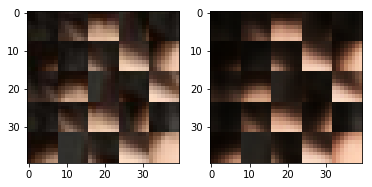

EPO: 42, recon_loss: 0.0113, total_loss: 0.0170
EPO: 42, recon_loss: 0.0100, total_loss: 0.0151
EPO: 42, recon_loss: 0.0089, total_loss: 0.0124
EPO: 43, recon_loss: 0.0022, total_loss: 0.0043
EPO: 43, recon_loss: 0.0015, total_loss: 0.0032
EPO: 43, recon_loss: 0.0066, total_loss: 0.0098
EPO: 43, recon_loss: 0.0013, total_loss: 0.0036
EPO: 43, recon_loss: 0.0032, total_loss: 0.0060
EPO: 43, recon_loss: 0.0022, total_loss: 0.0083
EPO: 43, recon_loss: 0.0016, total_loss: 0.0062
######### what? the reconstruction psnr is: 31.9150


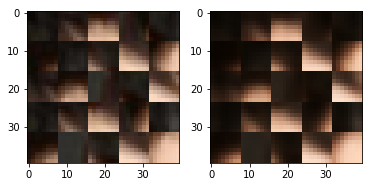

EPO: 43, recon_loss: 0.0038, total_loss: 0.0077
EPO: 43, recon_loss: 0.0020, total_loss: 0.0045
EPO: 43, recon_loss: 0.0042, total_loss: 0.0090
EPO: 43, recon_loss: 0.0018, total_loss: 0.0074
EPO: 43, recon_loss: 0.0008, total_loss: 0.0032
EPO: 43, recon_loss: 0.0025, total_loss: 0.0068
EPO: 43, recon_loss: 0.0014, total_loss: 0.0030
EPO: 43, recon_loss: 0.0028, total_loss: 0.0066
EPO: 43, recon_loss: 0.0026, total_loss: 0.0074
EPO: 43, recon_loss: 0.0023, total_loss: 0.0062
######### what? the reconstruction psnr is: 32.0350


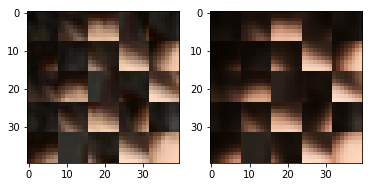

EPO: 43, recon_loss: 0.0030, total_loss: 0.0070
EPO: 43, recon_loss: 0.0022, total_loss: 0.0062
EPO: 43, recon_loss: 0.0019, total_loss: 0.0049
EPO: 43, recon_loss: 0.0030, total_loss: 0.0054
EPO: 43, recon_loss: 0.0015, total_loss: 0.0042
EPO: 43, recon_loss: 0.0041, total_loss: 0.0080
EPO: 43, recon_loss: 0.0024, total_loss: 0.0051
EPO: 43, recon_loss: 0.0026, total_loss: 0.0050
EPO: 43, recon_loss: 0.0065, total_loss: 0.0162
EPO: 43, recon_loss: 0.0025, total_loss: 0.0074
######### what? the reconstruction psnr is: 31.6480


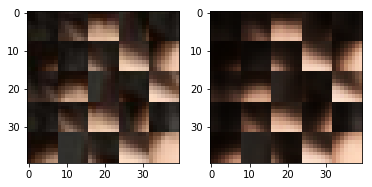

EPO: 43, recon_loss: 0.0035, total_loss: 0.0096
EPO: 43, recon_loss: 0.0059, total_loss: 0.0131
EPO: 43, recon_loss: 0.0034, total_loss: 0.0080
EPO: 43, recon_loss: 0.0026, total_loss: 0.0084
EPO: 43, recon_loss: 0.0017, total_loss: 0.0060
EPO: 43, recon_loss: 0.0027, total_loss: 0.0078
EPO: 43, recon_loss: 0.0024, total_loss: 0.0047
EPO: 43, recon_loss: 0.0028, total_loss: 0.0056
EPO: 43, recon_loss: 0.0011, total_loss: 0.0031
EPO: 43, recon_loss: 0.0014, total_loss: 0.0034
######### what? the reconstruction psnr is: 31.2251


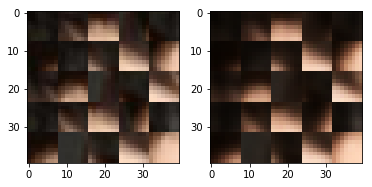

EPO: 43, recon_loss: 0.0016, total_loss: 0.0043
EPO: 43, recon_loss: 0.0040, total_loss: 0.0070
EPO: 43, recon_loss: 0.0030, total_loss: 0.0074
EPO: 43, recon_loss: 0.0044, total_loss: 0.0112
EPO: 43, recon_loss: 0.0013, total_loss: 0.0063
EPO: 43, recon_loss: 0.0015, total_loss: 0.0061
EPO: 43, recon_loss: 0.0031, total_loss: 0.0067
EPO: 43, recon_loss: 0.0012, total_loss: 0.0041
EPO: 43, recon_loss: 0.0045, total_loss: 0.0106
EPO: 43, recon_loss: 0.0057, total_loss: 0.0154
######### what? the reconstruction psnr is: 32.2915


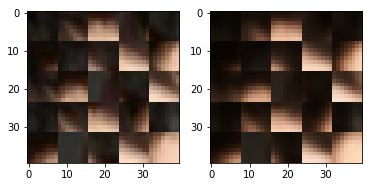

EPO: 43, recon_loss: 0.0026, total_loss: 0.0076
EPO: 43, recon_loss: 0.0051, total_loss: 0.0094
EPO: 43, recon_loss: 0.0018, total_loss: 0.0044
EPO: 43, recon_loss: 0.0038, total_loss: 0.0073
EPO: 43, recon_loss: 0.0031, total_loss: 0.0072
EPO: 43, recon_loss: 0.0024, total_loss: 0.0065
EPO: 43, recon_loss: 0.0047, total_loss: 0.0098
EPO: 43, recon_loss: 0.0036, total_loss: 0.0074
EPO: 43, recon_loss: 0.0062, total_loss: 0.0113
EPO: 43, recon_loss: 0.0069, total_loss: 0.0136
######### what? the reconstruction psnr is: 31.7331


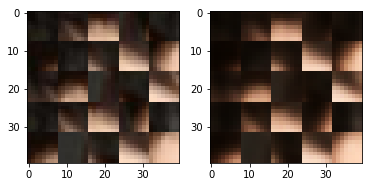

EPO: 43, recon_loss: 0.0081, total_loss: 0.0156
EPO: 43, recon_loss: 0.0164, total_loss: 0.0255
EPO: 43, recon_loss: 0.0079, total_loss: 0.0152
EPO: 43, recon_loss: 0.0073, total_loss: 0.0142
EPO: 43, recon_loss: 0.0032, total_loss: 0.0073
EPO: 43, recon_loss: 0.0029, total_loss: 0.0076
EPO: 43, recon_loss: 0.0041, total_loss: 0.0085
EPO: 43, recon_loss: 0.0043, total_loss: 0.0093
EPO: 43, recon_loss: 0.0057, total_loss: 0.0119
EPO: 43, recon_loss: 0.0020, total_loss: 0.0072
######### what? the reconstruction psnr is: 31.8250


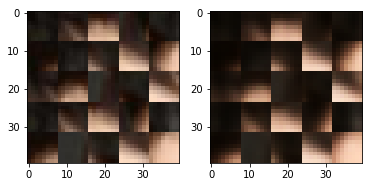

EPO: 43, recon_loss: 0.0018, total_loss: 0.0065
EPO: 43, recon_loss: 0.0067, total_loss: 0.0124
EPO: 43, recon_loss: 0.0020, total_loss: 0.0070
EPO: 43, recon_loss: 0.0027, total_loss: 0.0070
EPO: 43, recon_loss: 0.0059, total_loss: 0.0163
EPO: 43, recon_loss: 0.0043, total_loss: 0.0136
EPO: 43, recon_loss: 0.0130, total_loss: 0.0255
EPO: 43, recon_loss: 0.0041, total_loss: 0.0131
EPO: 43, recon_loss: 0.0050, total_loss: 0.0150
EPO: 43, recon_loss: 0.0080, total_loss: 0.0169
######### what? the reconstruction psnr is: 32.0371


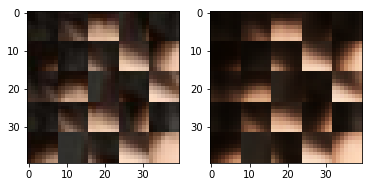

EPO: 43, recon_loss: 0.0044, total_loss: 0.0147
EPO: 43, recon_loss: 0.0123, total_loss: 0.0241
EPO: 43, recon_loss: 0.0063, total_loss: 0.0170
EPO: 43, recon_loss: 0.0067, total_loss: 0.0171
EPO: 43, recon_loss: 0.0023, total_loss: 0.0111
EPO: 43, recon_loss: 0.0023, total_loss: 0.0099
EPO: 43, recon_loss: 0.0151, total_loss: 0.0247
EPO: 43, recon_loss: 0.0150, total_loss: 0.0213
EPO: 43, recon_loss: 0.0021, total_loss: 0.0057
EPO: 43, recon_loss: 0.0021, total_loss: 0.0057
######### what? the reconstruction psnr is: 31.6249


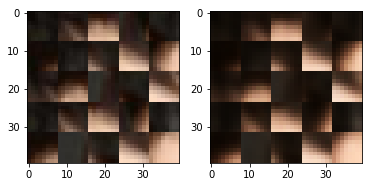

EPO: 43, recon_loss: 0.0019, total_loss: 0.0066
EPO: 43, recon_loss: 0.0052, total_loss: 0.0110
EPO: 43, recon_loss: 0.0031, total_loss: 0.0089
EPO: 43, recon_loss: 0.0037, total_loss: 0.0099
EPO: 43, recon_loss: 0.0015, total_loss: 0.0050
EPO: 43, recon_loss: 0.0004, total_loss: 0.0019
EPO: 43, recon_loss: 0.0006, total_loss: 0.0024
EPO: 43, recon_loss: 0.0007, total_loss: 0.0017
EPO: 43, recon_loss: 0.0007, total_loss: 0.0021
EPO: 43, recon_loss: 0.0042, total_loss: 0.0138
######### what? the reconstruction psnr is: 32.2110


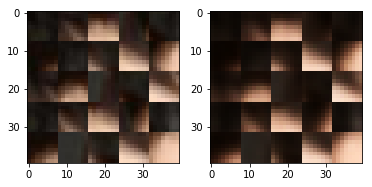

EPO: 43, recon_loss: 0.0020, total_loss: 0.0059
EPO: 43, recon_loss: 0.0032, total_loss: 0.0080
EPO: 43, recon_loss: 0.0034, total_loss: 0.0068
EPO: 43, recon_loss: 0.0027, total_loss: 0.0051
EPO: 43, recon_loss: 0.0060, total_loss: 0.0142
EPO: 43, recon_loss: 0.0045, total_loss: 0.0115
EPO: 43, recon_loss: 0.0062, total_loss: 0.0140
EPO: 43, recon_loss: 0.0047, total_loss: 0.0129
EPO: 43, recon_loss: 0.0028, total_loss: 0.0074
EPO: 43, recon_loss: 0.0037, total_loss: 0.0086
######### what? the reconstruction psnr is: 31.6100


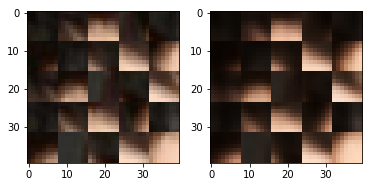

EPO: 43, recon_loss: 0.0027, total_loss: 0.0061
EPO: 43, recon_loss: 0.0028, total_loss: 0.0059
EPO: 43, recon_loss: 0.0030, total_loss: 0.0067
EPO: 43, recon_loss: 0.0024, total_loss: 0.0054
EPO: 43, recon_loss: 0.0033, total_loss: 0.0079
EPO: 43, recon_loss: 0.0021, total_loss: 0.0077
EPO: 43, recon_loss: 0.0021, total_loss: 0.0062
EPO: 43, recon_loss: 0.0051, total_loss: 0.0101
EPO: 43, recon_loss: 0.0048, total_loss: 0.0097
EPO: 43, recon_loss: 0.0032, total_loss: 0.0080
######### what? the reconstruction psnr is: 31.7473


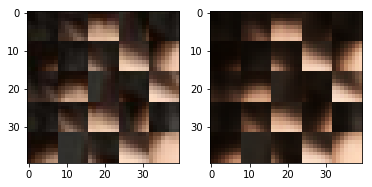

EPO: 43, recon_loss: 0.0009, total_loss: 0.0029
EPO: 43, recon_loss: 0.0014, total_loss: 0.0035
EPO: 43, recon_loss: 0.0019, total_loss: 0.0054
EPO: 43, recon_loss: 0.0010, total_loss: 0.0028
EPO: 43, recon_loss: 0.0017, total_loss: 0.0039
EPO: 43, recon_loss: 0.0021, total_loss: 0.0054
EPO: 43, recon_loss: 0.0025, total_loss: 0.0063
EPO: 43, recon_loss: 0.0053, total_loss: 0.0104
EPO: 43, recon_loss: 0.0030, total_loss: 0.0075
EPO: 43, recon_loss: 0.0022, total_loss: 0.0049
######### what? the reconstruction psnr is: 31.6482


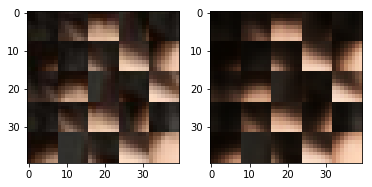

EPO: 43, recon_loss: 0.0017, total_loss: 0.0068
EPO: 43, recon_loss: 0.0022, total_loss: 0.0074
EPO: 43, recon_loss: 0.0091, total_loss: 0.0163
EPO: 43, recon_loss: 0.0024, total_loss: 0.0067
EPO: 43, recon_loss: 0.0091, total_loss: 0.0180
EPO: 43, recon_loss: 0.0007, total_loss: 0.0038
EPO: 43, recon_loss: 0.0005, total_loss: 0.0029
EPO: 43, recon_loss: 0.0077, total_loss: 0.0134
EPO: 43, recon_loss: 0.0026, total_loss: 0.0055
EPO: 43, recon_loss: 0.0032, total_loss: 0.0067
######### what? the reconstruction psnr is: 31.3829


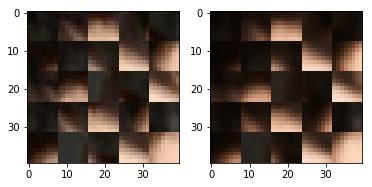

EPO: 43, recon_loss: 0.0038, total_loss: 0.0084
EPO: 43, recon_loss: 0.0044, total_loss: 0.0098
EPO: 43, recon_loss: 0.0061, total_loss: 0.0122
EPO: 43, recon_loss: 0.0017, total_loss: 0.0051
EPO: 43, recon_loss: 0.0027, total_loss: 0.0059
EPO: 43, recon_loss: 0.0016, total_loss: 0.0051
EPO: 43, recon_loss: 0.0011, total_loss: 0.0037
EPO: 43, recon_loss: 0.0050, total_loss: 0.0111
EPO: 43, recon_loss: 0.0011, total_loss: 0.0041
EPO: 43, recon_loss: 0.0019, total_loss: 0.0055
######### what? the reconstruction psnr is: 31.5540


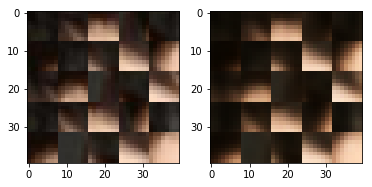

EPO: 43, recon_loss: 0.0042, total_loss: 0.0100
EPO: 43, recon_loss: 0.0024, total_loss: 0.0074
EPO: 43, recon_loss: 0.0043, total_loss: 0.0090
EPO: 43, recon_loss: 0.0031, total_loss: 0.0079
EPO: 43, recon_loss: 0.0040, total_loss: 0.0092
EPO: 43, recon_loss: 0.0056, total_loss: 0.0154
EPO: 43, recon_loss: 0.0014, total_loss: 0.0039
EPO: 43, recon_loss: 0.0028, total_loss: 0.0063
EPO: 43, recon_loss: 0.0022, total_loss: 0.0056
EPO: 43, recon_loss: 0.0028, total_loss: 0.0065
######### what? the reconstruction psnr is: 31.9601


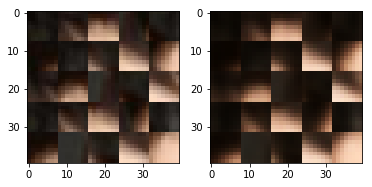

EPO: 43, recon_loss: 0.0028, total_loss: 0.0080
EPO: 43, recon_loss: 0.0018, total_loss: 0.0055
EPO: 43, recon_loss: 0.0049, total_loss: 0.0102
EPO: 43, recon_loss: 0.0053, total_loss: 0.0109
EPO: 43, recon_loss: 0.0039, total_loss: 0.0105
EPO: 43, recon_loss: 0.0044, total_loss: 0.0123
EPO: 43, recon_loss: 0.0018, total_loss: 0.0063
EPO: 43, recon_loss: 0.0021, total_loss: 0.0070
EPO: 43, recon_loss: 0.0038, total_loss: 0.0089
EPO: 43, recon_loss: 0.0032, total_loss: 0.0083
######### what? the reconstruction psnr is: 32.0082


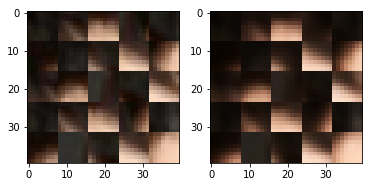

EPO: 43, recon_loss: 0.0024, total_loss: 0.0049
EPO: 43, recon_loss: 0.0015, total_loss: 0.0030
EPO: 43, recon_loss: 0.0012, total_loss: 0.0028
EPO: 43, recon_loss: 0.0025, total_loss: 0.0061
EPO: 43, recon_loss: 0.0017, total_loss: 0.0054
EPO: 43, recon_loss: 0.0032, total_loss: 0.0075
EPO: 43, recon_loss: 0.0076, total_loss: 0.0180
EPO: 43, recon_loss: 0.0046, total_loss: 0.0128
EPO: 43, recon_loss: 0.0096, total_loss: 0.0211
EPO: 43, recon_loss: 0.0064, total_loss: 0.0185
######### what? the reconstruction psnr is: 31.4583


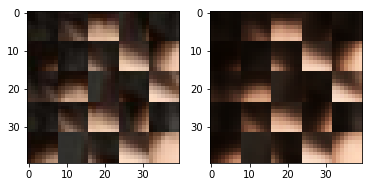

EPO: 43, recon_loss: 0.0078, total_loss: 0.0209
EPO: 43, recon_loss: 0.0017, total_loss: 0.0069
EPO: 43, recon_loss: 0.0061, total_loss: 0.0121
EPO: 43, recon_loss: 0.0034, total_loss: 0.0114
EPO: 43, recon_loss: 0.0028, total_loss: 0.0084
EPO: 43, recon_loss: 0.0033, total_loss: 0.0097
EPO: 43, recon_loss: 0.0034, total_loss: 0.0113
EPO: 43, recon_loss: 0.0041, total_loss: 0.0108
EPO: 43, recon_loss: 0.0067, total_loss: 0.0145
EPO: 43, recon_loss: 0.0026, total_loss: 0.0080
######### what? the reconstruction psnr is: 32.2126


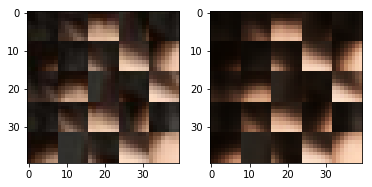

EPO: 43, recon_loss: 0.0030, total_loss: 0.0084
EPO: 43, recon_loss: 0.0024, total_loss: 0.0070
EPO: 43, recon_loss: 0.0016, total_loss: 0.0068
EPO: 43, recon_loss: 0.0069, total_loss: 0.0129
EPO: 43, recon_loss: 0.0018, total_loss: 0.0063
EPO: 43, recon_loss: 0.0028, total_loss: 0.0084
EPO: 43, recon_loss: 0.0020, total_loss: 0.0058
EPO: 43, recon_loss: 0.0026, total_loss: 0.0086
EPO: 43, recon_loss: 0.0084, total_loss: 0.0141
EPO: 43, recon_loss: 0.0030, total_loss: 0.0089
######### what? the reconstruction psnr is: 31.9504


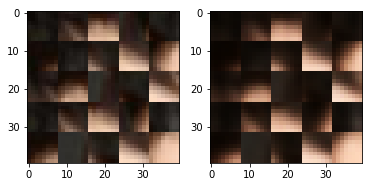

EPO: 43, recon_loss: 0.0045, total_loss: 0.0092
EPO: 43, recon_loss: 0.0018, total_loss: 0.0072
EPO: 43, recon_loss: 0.0015, total_loss: 0.0057
EPO: 43, recon_loss: 0.0063, total_loss: 0.0127
EPO: 43, recon_loss: 0.0019, total_loss: 0.0043
EPO: 43, recon_loss: 0.0043, total_loss: 0.0093
EPO: 43, recon_loss: 0.0018, total_loss: 0.0072
EPO: 43, recon_loss: 0.0012, total_loss: 0.0050
EPO: 43, recon_loss: 0.0026, total_loss: 0.0070
EPO: 43, recon_loss: 0.0012, total_loss: 0.0045
######### what? the reconstruction psnr is: 32.0408


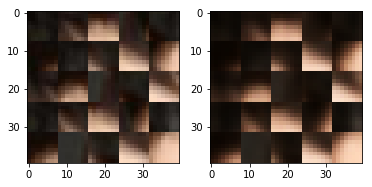

EPO: 43, recon_loss: 0.0022, total_loss: 0.0057
EPO: 43, recon_loss: 0.0072, total_loss: 0.0174
EPO: 43, recon_loss: 0.0063, total_loss: 0.0149
EPO: 43, recon_loss: 0.0035, total_loss: 0.0081
EPO: 43, recon_loss: 0.0034, total_loss: 0.0097
EPO: 43, recon_loss: 0.0028, total_loss: 0.0066
EPO: 43, recon_loss: 0.0054, total_loss: 0.0154
EPO: 43, recon_loss: 0.0031, total_loss: 0.0095
EPO: 43, recon_loss: 0.0050, total_loss: 0.0107
EPO: 43, recon_loss: 0.0026, total_loss: 0.0085
######### what? the reconstruction psnr is: 31.8207


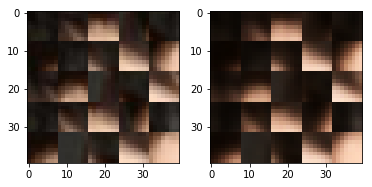

EPO: 43, recon_loss: 0.0035, total_loss: 0.0088
EPO: 43, recon_loss: 0.0019, total_loss: 0.0056
EPO: 43, recon_loss: 0.0005, total_loss: 0.0016
EPO: 43, recon_loss: 0.0025, total_loss: 0.0058
EPO: 43, recon_loss: 0.0012, total_loss: 0.0027
EPO: 43, recon_loss: 0.0013, total_loss: 0.0029
EPO: 43, recon_loss: 0.0027, total_loss: 0.0057
EPO: 43, recon_loss: 0.0024, total_loss: 0.0065
EPO: 43, recon_loss: 0.0038, total_loss: 0.0092
EPO: 43, recon_loss: 0.0023, total_loss: 0.0059
######### what? the reconstruction psnr is: 31.5292


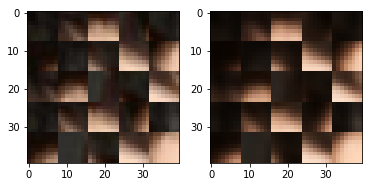

EPO: 43, recon_loss: 0.0025, total_loss: 0.0052
EPO: 43, recon_loss: 0.0049, total_loss: 0.0137
EPO: 43, recon_loss: 0.0040, total_loss: 0.0104
EPO: 43, recon_loss: 0.0041, total_loss: 0.0087
EPO: 43, recon_loss: 0.0048, total_loss: 0.0087
EPO: 43, recon_loss: 0.0040, total_loss: 0.0082
EPO: 43, recon_loss: 0.0099, total_loss: 0.0174
EPO: 43, recon_loss: 0.0115, total_loss: 0.0227
EPO: 43, recon_loss: 0.0042, total_loss: 0.0087
EPO: 43, recon_loss: 0.0044, total_loss: 0.0085
######### what? the reconstruction psnr is: 30.9006


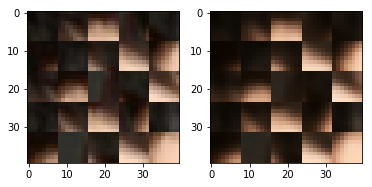

EPO: 43, recon_loss: 0.0049, total_loss: 0.0084
EPO: 43, recon_loss: 0.0114, total_loss: 0.0172
EPO: 43, recon_loss: 0.0009, total_loss: 0.0042
EPO: 43, recon_loss: 0.0019, total_loss: 0.0063
EPO: 43, recon_loss: 0.0046, total_loss: 0.0088
EPO: 43, recon_loss: 0.0035, total_loss: 0.0090
EPO: 43, recon_loss: 0.0081, total_loss: 0.0149
EPO: 43, recon_loss: 0.0014, total_loss: 0.0061
EPO: 43, recon_loss: 0.0019, total_loss: 0.0055
EPO: 43, recon_loss: 0.0043, total_loss: 0.0084
######### what? the reconstruction psnr is: 31.5477


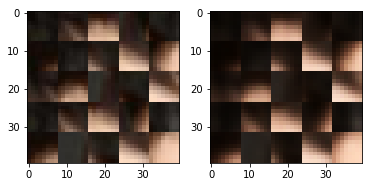

EPO: 43, recon_loss: 0.0011, total_loss: 0.0029
EPO: 43, recon_loss: 0.0023, total_loss: 0.0042
EPO: 43, recon_loss: 0.0039, total_loss: 0.0091
EPO: 43, recon_loss: 0.0059, total_loss: 0.0108
EPO: 43, recon_loss: 0.0097, total_loss: 0.0155
EPO: 43, recon_loss: 0.0115, total_loss: 0.0163
EPO: 43, recon_loss: 0.0101, total_loss: 0.0144
EPO: 44, recon_loss: 0.0020, total_loss: 0.0040
EPO: 44, recon_loss: 0.0014, total_loss: 0.0031
EPO: 44, recon_loss: 0.0069, total_loss: 0.0111
######### what? the reconstruction psnr is: 31.8240


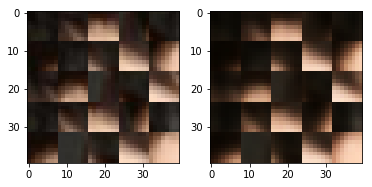

EPO: 44, recon_loss: 0.0018, total_loss: 0.0041
EPO: 44, recon_loss: 0.0035, total_loss: 0.0066
EPO: 44, recon_loss: 0.0022, total_loss: 0.0079
EPO: 44, recon_loss: 0.0021, total_loss: 0.0062
EPO: 44, recon_loss: 0.0037, total_loss: 0.0072
EPO: 44, recon_loss: 0.0027, total_loss: 0.0053
EPO: 44, recon_loss: 0.0045, total_loss: 0.0104
EPO: 44, recon_loss: 0.0016, total_loss: 0.0069
EPO: 44, recon_loss: 0.0008, total_loss: 0.0030
EPO: 44, recon_loss: 0.0026, total_loss: 0.0067
######### what? the reconstruction psnr is: 32.0833


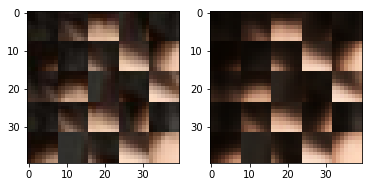

EPO: 44, recon_loss: 0.0017, total_loss: 0.0032
EPO: 44, recon_loss: 0.0036, total_loss: 0.0083
EPO: 44, recon_loss: 0.0024, total_loss: 0.0065
EPO: 44, recon_loss: 0.0023, total_loss: 0.0061
EPO: 44, recon_loss: 0.0031, total_loss: 0.0066
EPO: 44, recon_loss: 0.0022, total_loss: 0.0065
EPO: 44, recon_loss: 0.0023, total_loss: 0.0057
EPO: 44, recon_loss: 0.0024, total_loss: 0.0047
EPO: 44, recon_loss: 0.0016, total_loss: 0.0044
EPO: 44, recon_loss: 0.0050, total_loss: 0.0085
######### what? the reconstruction psnr is: 32.1241


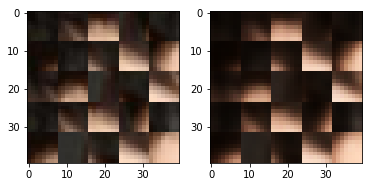

EPO: 44, recon_loss: 0.0019, total_loss: 0.0041
EPO: 44, recon_loss: 0.0025, total_loss: 0.0048
EPO: 44, recon_loss: 0.0051, total_loss: 0.0123
EPO: 44, recon_loss: 0.0020, total_loss: 0.0066
EPO: 44, recon_loss: 0.0047, total_loss: 0.0118
EPO: 44, recon_loss: 0.0052, total_loss: 0.0110
EPO: 44, recon_loss: 0.0043, total_loss: 0.0090
EPO: 44, recon_loss: 0.0033, total_loss: 0.0110
EPO: 44, recon_loss: 0.0014, total_loss: 0.0056
EPO: 44, recon_loss: 0.0038, total_loss: 0.0083
######### what? the reconstruction psnr is: 31.6407


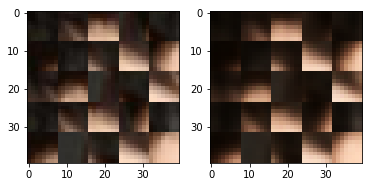

EPO: 44, recon_loss: 0.0019, total_loss: 0.0037
EPO: 44, recon_loss: 0.0016, total_loss: 0.0039
EPO: 44, recon_loss: 0.0012, total_loss: 0.0030
EPO: 44, recon_loss: 0.0012, total_loss: 0.0030
EPO: 44, recon_loss: 0.0021, total_loss: 0.0056
EPO: 44, recon_loss: 0.0024, total_loss: 0.0049
EPO: 44, recon_loss: 0.0035, total_loss: 0.0089
EPO: 44, recon_loss: 0.0012, total_loss: 0.0071
EPO: 44, recon_loss: 0.0012, total_loss: 0.0058
EPO: 44, recon_loss: 0.0017, total_loss: 0.0060
######### what? the reconstruction psnr is: 31.7773


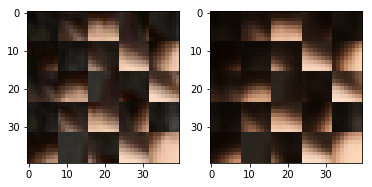

EPO: 44, recon_loss: 0.0023, total_loss: 0.0051
EPO: 44, recon_loss: 0.0020, total_loss: 0.0058
EPO: 44, recon_loss: 0.0041, total_loss: 0.0119
EPO: 44, recon_loss: 0.0026, total_loss: 0.0077
EPO: 44, recon_loss: 0.0039, total_loss: 0.0097
EPO: 44, recon_loss: 0.0036, total_loss: 0.0070
EPO: 44, recon_loss: 0.0023, total_loss: 0.0051
EPO: 44, recon_loss: 0.0059, total_loss: 0.0107
EPO: 44, recon_loss: 0.0026, total_loss: 0.0058
EPO: 44, recon_loss: 0.0030, total_loss: 0.0081
######### what? the reconstruction psnr is: 31.9273


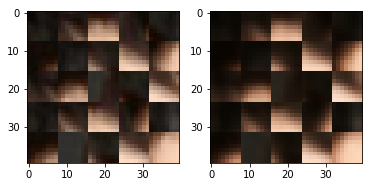

EPO: 44, recon_loss: 0.0041, total_loss: 0.0086
EPO: 44, recon_loss: 0.0032, total_loss: 0.0074
EPO: 44, recon_loss: 0.0100, total_loss: 0.0149
EPO: 44, recon_loss: 0.0071, total_loss: 0.0139
EPO: 44, recon_loss: 0.0087, total_loss: 0.0167
EPO: 44, recon_loss: 0.0144, total_loss: 0.0229
EPO: 44, recon_loss: 0.0080, total_loss: 0.0150
EPO: 44, recon_loss: 0.0080, total_loss: 0.0147
EPO: 44, recon_loss: 0.0030, total_loss: 0.0069
EPO: 44, recon_loss: 0.0035, total_loss: 0.0078
######### what? the reconstruction psnr is: 31.9284


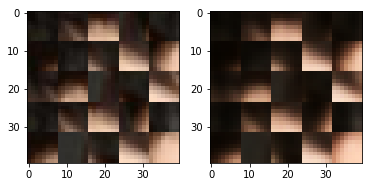

EPO: 44, recon_loss: 0.0050, total_loss: 0.0096
EPO: 44, recon_loss: 0.0055, total_loss: 0.0121
EPO: 44, recon_loss: 0.0054, total_loss: 0.0113
EPO: 44, recon_loss: 0.0021, total_loss: 0.0072
EPO: 44, recon_loss: 0.0031, total_loss: 0.0087
EPO: 44, recon_loss: 0.0059, total_loss: 0.0117
EPO: 44, recon_loss: 0.0021, total_loss: 0.0071
EPO: 44, recon_loss: 0.0030, total_loss: 0.0077
EPO: 44, recon_loss: 0.0048, total_loss: 0.0138
EPO: 44, recon_loss: 0.0049, total_loss: 0.0137
######### what? the reconstruction psnr is: 31.6216


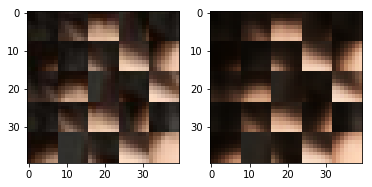

EPO: 44, recon_loss: 0.0131, total_loss: 0.0251
EPO: 44, recon_loss: 0.0044, total_loss: 0.0145
EPO: 44, recon_loss: 0.0058, total_loss: 0.0147
EPO: 44, recon_loss: 0.0063, total_loss: 0.0150
EPO: 44, recon_loss: 0.0042, total_loss: 0.0140
EPO: 44, recon_loss: 0.0146, total_loss: 0.0267
EPO: 44, recon_loss: 0.0065, total_loss: 0.0173
EPO: 44, recon_loss: 0.0069, total_loss: 0.0172
EPO: 44, recon_loss: 0.0013, total_loss: 0.0090
EPO: 44, recon_loss: 0.0045, total_loss: 0.0147
######### what? the reconstruction psnr is: 31.3918


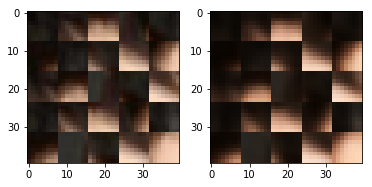

EPO: 44, recon_loss: 0.0166, total_loss: 0.0264
EPO: 44, recon_loss: 0.0115, total_loss: 0.0176
EPO: 44, recon_loss: 0.0023, total_loss: 0.0053
EPO: 44, recon_loss: 0.0015, total_loss: 0.0051
EPO: 44, recon_loss: 0.0022, total_loss: 0.0070
EPO: 44, recon_loss: 0.0053, total_loss: 0.0112
EPO: 44, recon_loss: 0.0028, total_loss: 0.0086
EPO: 44, recon_loss: 0.0045, total_loss: 0.0106
EPO: 44, recon_loss: 0.0009, total_loss: 0.0031
EPO: 44, recon_loss: 0.0004, total_loss: 0.0019
######### what? the reconstruction psnr is: 31.9820


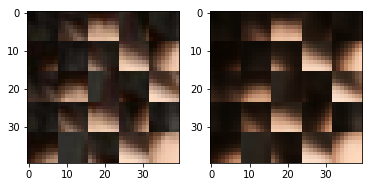

EPO: 44, recon_loss: 0.0009, total_loss: 0.0027
EPO: 44, recon_loss: 0.0006, total_loss: 0.0015
EPO: 44, recon_loss: 0.0007, total_loss: 0.0022
EPO: 44, recon_loss: 0.0039, total_loss: 0.0124
EPO: 44, recon_loss: 0.0016, total_loss: 0.0053
EPO: 44, recon_loss: 0.0032, total_loss: 0.0077
EPO: 44, recon_loss: 0.0019, total_loss: 0.0044
EPO: 44, recon_loss: 0.0024, total_loss: 0.0045
EPO: 44, recon_loss: 0.0054, total_loss: 0.0145
EPO: 44, recon_loss: 0.0043, total_loss: 0.0109
######### what? the reconstruction psnr is: 31.7317


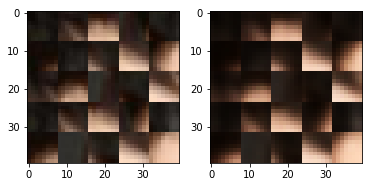

EPO: 44, recon_loss: 0.0053, total_loss: 0.0123
EPO: 44, recon_loss: 0.0050, total_loss: 0.0128
EPO: 44, recon_loss: 0.0032, total_loss: 0.0077
EPO: 44, recon_loss: 0.0037, total_loss: 0.0086
EPO: 44, recon_loss: 0.0026, total_loss: 0.0058
EPO: 44, recon_loss: 0.0025, total_loss: 0.0058
EPO: 44, recon_loss: 0.0023, total_loss: 0.0052
EPO: 44, recon_loss: 0.0028, total_loss: 0.0065
EPO: 44, recon_loss: 0.0020, total_loss: 0.0092
EPO: 44, recon_loss: 0.0013, total_loss: 0.0052
######### what? the reconstruction psnr is: 31.8003


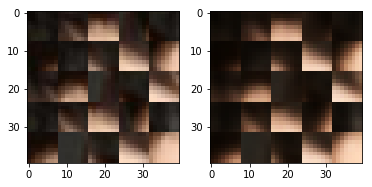

EPO: 44, recon_loss: 0.0029, total_loss: 0.0080
EPO: 44, recon_loss: 0.0041, total_loss: 0.0089
EPO: 44, recon_loss: 0.0029, total_loss: 0.0066
EPO: 44, recon_loss: 0.0024, total_loss: 0.0059
EPO: 44, recon_loss: 0.0008, total_loss: 0.0029
EPO: 44, recon_loss: 0.0014, total_loss: 0.0037
EPO: 44, recon_loss: 0.0019, total_loss: 0.0051
EPO: 44, recon_loss: 0.0013, total_loss: 0.0031
EPO: 44, recon_loss: 0.0021, total_loss: 0.0047
EPO: 44, recon_loss: 0.0017, total_loss: 0.0046
######### what? the reconstruction psnr is: 31.8360


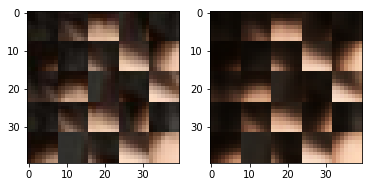

EPO: 44, recon_loss: 0.0026, total_loss: 0.0064
EPO: 44, recon_loss: 0.0042, total_loss: 0.0090
EPO: 44, recon_loss: 0.0033, total_loss: 0.0074
EPO: 44, recon_loss: 0.0019, total_loss: 0.0048
EPO: 44, recon_loss: 0.0021, total_loss: 0.0084
EPO: 44, recon_loss: 0.0046, total_loss: 0.0109
EPO: 44, recon_loss: 0.0093, total_loss: 0.0165
EPO: 44, recon_loss: 0.0027, total_loss: 0.0072
EPO: 44, recon_loss: 0.0099, total_loss: 0.0178
EPO: 44, recon_loss: 0.0006, total_loss: 0.0031
######### what? the reconstruction psnr is: 31.6557


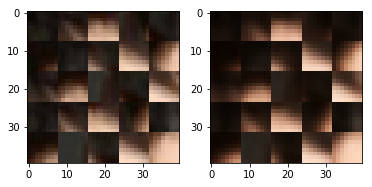

EPO: 44, recon_loss: 0.0011, total_loss: 0.0040
EPO: 44, recon_loss: 0.0076, total_loss: 0.0129
EPO: 44, recon_loss: 0.0020, total_loss: 0.0051
EPO: 44, recon_loss: 0.0031, total_loss: 0.0066
EPO: 44, recon_loss: 0.0034, total_loss: 0.0076
EPO: 44, recon_loss: 0.0038, total_loss: 0.0092
EPO: 44, recon_loss: 0.0069, total_loss: 0.0122
EPO: 44, recon_loss: 0.0017, total_loss: 0.0052
EPO: 44, recon_loss: 0.0039, total_loss: 0.0078
EPO: 44, recon_loss: 0.0015, total_loss: 0.0047
######### what? the reconstruction psnr is: 31.8615


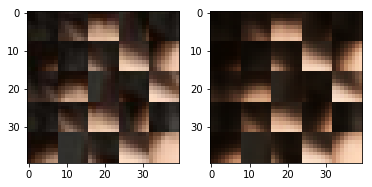

EPO: 44, recon_loss: 0.0028, total_loss: 0.0064
EPO: 44, recon_loss: 0.0059, total_loss: 0.0123
EPO: 44, recon_loss: 0.0014, total_loss: 0.0047
EPO: 44, recon_loss: 0.0023, total_loss: 0.0061
EPO: 44, recon_loss: 0.0034, total_loss: 0.0088
EPO: 44, recon_loss: 0.0023, total_loss: 0.0070
EPO: 44, recon_loss: 0.0061, total_loss: 0.0110
EPO: 44, recon_loss: 0.0031, total_loss: 0.0082
EPO: 44, recon_loss: 0.0046, total_loss: 0.0096
EPO: 44, recon_loss: 0.0057, total_loss: 0.0143
######### what? the reconstruction psnr is: 32.3322


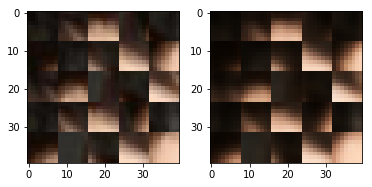

EPO: 44, recon_loss: 0.0008, total_loss: 0.0032
EPO: 44, recon_loss: 0.0040, total_loss: 0.0076
EPO: 44, recon_loss: 0.0018, total_loss: 0.0050
EPO: 44, recon_loss: 0.0030, total_loss: 0.0064
EPO: 44, recon_loss: 0.0029, total_loss: 0.0082
EPO: 44, recon_loss: 0.0019, total_loss: 0.0056
EPO: 44, recon_loss: 0.0064, total_loss: 0.0124
EPO: 44, recon_loss: 0.0025, total_loss: 0.0071
EPO: 44, recon_loss: 0.0048, total_loss: 0.0106
EPO: 44, recon_loss: 0.0035, total_loss: 0.0104
######### what? the reconstruction psnr is: 31.8335


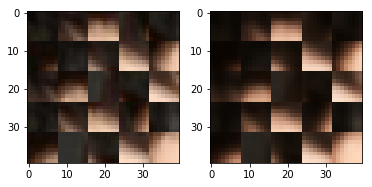

EPO: 44, recon_loss: 0.0014, total_loss: 0.0056
EPO: 44, recon_loss: 0.0033, total_loss: 0.0092
EPO: 44, recon_loss: 0.0017, total_loss: 0.0055
EPO: 44, recon_loss: 0.0031, total_loss: 0.0076
EPO: 44, recon_loss: 0.0019, total_loss: 0.0034
EPO: 44, recon_loss: 0.0012, total_loss: 0.0026
EPO: 44, recon_loss: 0.0015, total_loss: 0.0035
EPO: 44, recon_loss: 0.0017, total_loss: 0.0046
EPO: 44, recon_loss: 0.0021, total_loss: 0.0058
EPO: 44, recon_loss: 0.0081, total_loss: 0.0185
######### what? the reconstruction psnr is: 32.0358


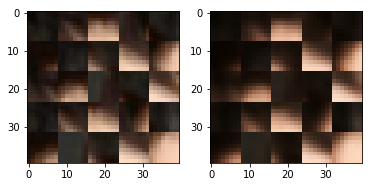

EPO: 44, recon_loss: 0.0069, total_loss: 0.0161
EPO: 44, recon_loss: 0.0058, total_loss: 0.0153
EPO: 44, recon_loss: 0.0068, total_loss: 0.0180
EPO: 44, recon_loss: 0.0060, total_loss: 0.0179
EPO: 44, recon_loss: 0.0017, total_loss: 0.0070
EPO: 44, recon_loss: 0.0022, total_loss: 0.0067
EPO: 44, recon_loss: 0.0073, total_loss: 0.0162
EPO: 44, recon_loss: 0.0030, total_loss: 0.0102
EPO: 44, recon_loss: 0.0030, total_loss: 0.0088
EPO: 44, recon_loss: 0.0030, total_loss: 0.0087
######### what? the reconstruction psnr is: 32.1480


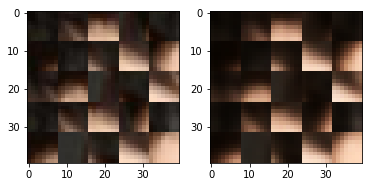

EPO: 44, recon_loss: 0.0030, total_loss: 0.0105
EPO: 44, recon_loss: 0.0041, total_loss: 0.0112
EPO: 44, recon_loss: 0.0054, total_loss: 0.0125
EPO: 44, recon_loss: 0.0030, total_loss: 0.0078
EPO: 44, recon_loss: 0.0029, total_loss: 0.0079
EPO: 44, recon_loss: 0.0018, total_loss: 0.0064
EPO: 44, recon_loss: 0.0034, total_loss: 0.0097
EPO: 44, recon_loss: 0.0062, total_loss: 0.0117
EPO: 44, recon_loss: 0.0016, total_loss: 0.0060
EPO: 44, recon_loss: 0.0029, total_loss: 0.0085
######### what? the reconstruction psnr is: 32.0656


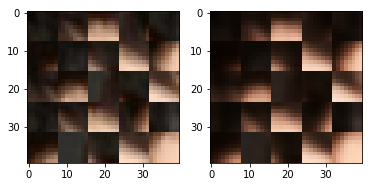

EPO: 44, recon_loss: 0.0017, total_loss: 0.0057
EPO: 44, recon_loss: 0.0031, total_loss: 0.0089
EPO: 44, recon_loss: 0.0075, total_loss: 0.0132
EPO: 44, recon_loss: 0.0032, total_loss: 0.0093
EPO: 44, recon_loss: 0.0058, total_loss: 0.0112
EPO: 44, recon_loss: 0.0012, total_loss: 0.0058
EPO: 44, recon_loss: 0.0021, total_loss: 0.0062
EPO: 44, recon_loss: 0.0049, total_loss: 0.0097
EPO: 44, recon_loss: 0.0022, total_loss: 0.0051
EPO: 44, recon_loss: 0.0038, total_loss: 0.0096
######### what? the reconstruction psnr is: 32.0256


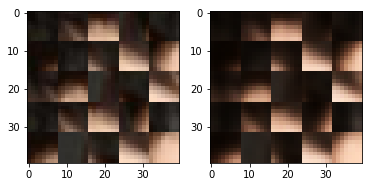

EPO: 44, recon_loss: 0.0015, total_loss: 0.0054
EPO: 44, recon_loss: 0.0013, total_loss: 0.0052
EPO: 44, recon_loss: 0.0023, total_loss: 0.0064
EPO: 44, recon_loss: 0.0015, total_loss: 0.0046
EPO: 44, recon_loss: 0.0019, total_loss: 0.0056
EPO: 44, recon_loss: 0.0066, total_loss: 0.0152
EPO: 44, recon_loss: 0.0050, total_loss: 0.0133
EPO: 44, recon_loss: 0.0035, total_loss: 0.0080
EPO: 44, recon_loss: 0.0039, total_loss: 0.0105
EPO: 44, recon_loss: 0.0026, total_loss: 0.0064
######### what? the reconstruction psnr is: 31.8025


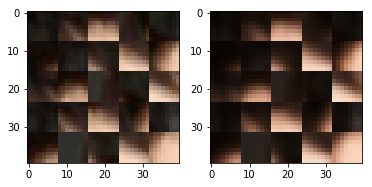

EPO: 44, recon_loss: 0.0051, total_loss: 0.0149
EPO: 44, recon_loss: 0.0047, total_loss: 0.0103
EPO: 44, recon_loss: 0.0049, total_loss: 0.0111
EPO: 44, recon_loss: 0.0018, total_loss: 0.0065
EPO: 44, recon_loss: 0.0043, total_loss: 0.0094
EPO: 44, recon_loss: 0.0011, total_loss: 0.0031
EPO: 44, recon_loss: 0.0005, total_loss: 0.0016
EPO: 44, recon_loss: 0.0030, total_loss: 0.0061
EPO: 44, recon_loss: 0.0011, total_loss: 0.0027
EPO: 44, recon_loss: 0.0015, total_loss: 0.0033
######### what? the reconstruction psnr is: 31.7598


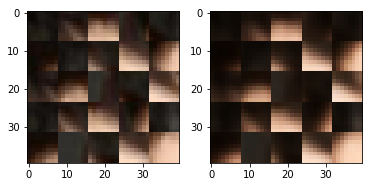

EPO: 44, recon_loss: 0.0030, total_loss: 0.0068
EPO: 44, recon_loss: 0.0020, total_loss: 0.0058
EPO: 44, recon_loss: 0.0038, total_loss: 0.0088
EPO: 44, recon_loss: 0.0015, total_loss: 0.0045
EPO: 44, recon_loss: 0.0016, total_loss: 0.0038
EPO: 44, recon_loss: 0.0047, total_loss: 0.0133
EPO: 44, recon_loss: 0.0031, total_loss: 0.0081
EPO: 44, recon_loss: 0.0050, total_loss: 0.0097
EPO: 44, recon_loss: 0.0033, total_loss: 0.0068
EPO: 44, recon_loss: 0.0046, total_loss: 0.0090
######### what? the reconstruction psnr is: 31.3652


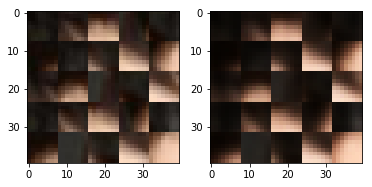

EPO: 44, recon_loss: 0.0081, total_loss: 0.0157
EPO: 44, recon_loss: 0.0125, total_loss: 0.0249
EPO: 44, recon_loss: 0.0034, total_loss: 0.0074
EPO: 44, recon_loss: 0.0033, total_loss: 0.0063
EPO: 44, recon_loss: 0.0056, total_loss: 0.0098
EPO: 44, recon_loss: 0.0024, total_loss: 0.0060
EPO: 44, recon_loss: 0.0009, total_loss: 0.0046
EPO: 44, recon_loss: 0.0022, total_loss: 0.0059
EPO: 44, recon_loss: 0.0026, total_loss: 0.0069
EPO: 44, recon_loss: 0.0028, total_loss: 0.0065
######### what? the reconstruction psnr is: 31.0914


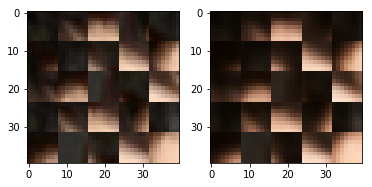

EPO: 44, recon_loss: 0.0022, total_loss: 0.0120
EPO: 44, recon_loss: 0.0011, total_loss: 0.0049
EPO: 44, recon_loss: 0.0024, total_loss: 0.0061
EPO: 44, recon_loss: 0.0026, total_loss: 0.0062
EPO: 44, recon_loss: 0.0008, total_loss: 0.0021
EPO: 44, recon_loss: 0.0030, total_loss: 0.0066
EPO: 44, recon_loss: 0.0037, total_loss: 0.0090
EPO: 44, recon_loss: 0.0075, total_loss: 0.0118
EPO: 44, recon_loss: 0.0078, total_loss: 0.0138
EPO: 44, recon_loss: 0.0104, total_loss: 0.0156
######### what? the reconstruction psnr is: 30.2187


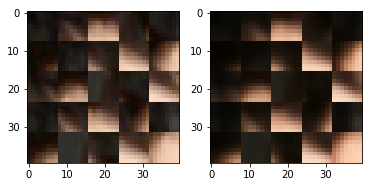

EPO: 44, recon_loss: 0.0079, total_loss: 0.0117
EPO: 45, recon_loss: 0.0015, total_loss: 0.0032
EPO: 45, recon_loss: 0.0019, total_loss: 0.0038
EPO: 45, recon_loss: 0.0045, total_loss: 0.0081
EPO: 45, recon_loss: 0.0020, total_loss: 0.0043
EPO: 45, recon_loss: 0.0039, total_loss: 0.0072
EPO: 45, recon_loss: 0.0015, total_loss: 0.0056
EPO: 45, recon_loss: 0.0021, total_loss: 0.0060
EPO: 45, recon_loss: 0.0046, total_loss: 0.0082
EPO: 45, recon_loss: 0.0044, total_loss: 0.0083
######### what? the reconstruction psnr is: 32.0553


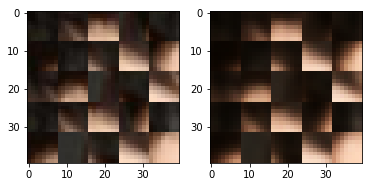

EPO: 45, recon_loss: 0.0048, total_loss: 0.0101
EPO: 45, recon_loss: 0.0017, total_loss: 0.0058
EPO: 45, recon_loss: 0.0013, total_loss: 0.0041
EPO: 45, recon_loss: 0.0023, total_loss: 0.0058
EPO: 45, recon_loss: 0.0019, total_loss: 0.0039
EPO: 45, recon_loss: 0.0050, total_loss: 0.0094
EPO: 45, recon_loss: 0.0023, total_loss: 0.0063
EPO: 45, recon_loss: 0.0022, total_loss: 0.0058
EPO: 45, recon_loss: 0.0029, total_loss: 0.0072
EPO: 45, recon_loss: 0.0023, total_loss: 0.0063
######### what? the reconstruction psnr is: 32.1122


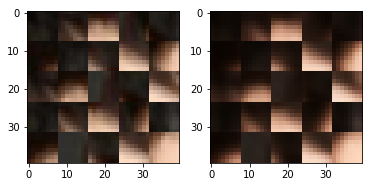

EPO: 45, recon_loss: 0.0026, total_loss: 0.0065
EPO: 45, recon_loss: 0.0021, total_loss: 0.0044
EPO: 45, recon_loss: 0.0018, total_loss: 0.0044
EPO: 45, recon_loss: 0.0062, total_loss: 0.0103
EPO: 45, recon_loss: 0.0015, total_loss: 0.0038
EPO: 45, recon_loss: 0.0031, total_loss: 0.0055
EPO: 45, recon_loss: 0.0042, total_loss: 0.0107
EPO: 45, recon_loss: 0.0030, total_loss: 0.0094
EPO: 45, recon_loss: 0.0052, total_loss: 0.0117
EPO: 45, recon_loss: 0.0056, total_loss: 0.0121
######### what? the reconstruction psnr is: 31.7737


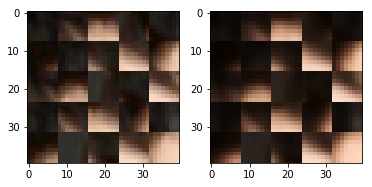

EPO: 45, recon_loss: 0.0047, total_loss: 0.0088
EPO: 45, recon_loss: 0.0031, total_loss: 0.0106
EPO: 45, recon_loss: 0.0012, total_loss: 0.0046
EPO: 45, recon_loss: 0.0039, total_loss: 0.0081
EPO: 45, recon_loss: 0.0021, total_loss: 0.0040
EPO: 45, recon_loss: 0.0018, total_loss: 0.0052
EPO: 45, recon_loss: 0.0010, total_loss: 0.0023
EPO: 45, recon_loss: 0.0012, total_loss: 0.0031
EPO: 45, recon_loss: 0.0036, total_loss: 0.0072
EPO: 45, recon_loss: 0.0024, total_loss: 0.0058
######### what? the reconstruction psnr is: 31.7207


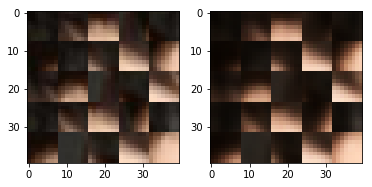

EPO: 45, recon_loss: 0.0030, total_loss: 0.0080
EPO: 45, recon_loss: 0.0010, total_loss: 0.0065
EPO: 45, recon_loss: 0.0011, total_loss: 0.0056
EPO: 45, recon_loss: 0.0026, total_loss: 0.0076
EPO: 45, recon_loss: 0.0010, total_loss: 0.0038
EPO: 45, recon_loss: 0.0024, total_loss: 0.0063
EPO: 45, recon_loss: 0.0046, total_loss: 0.0126
EPO: 45, recon_loss: 0.0014, total_loss: 0.0051
EPO: 45, recon_loss: 0.0045, total_loss: 0.0105
EPO: 45, recon_loss: 0.0026, total_loss: 0.0057
######### what? the reconstruction psnr is: 32.0852


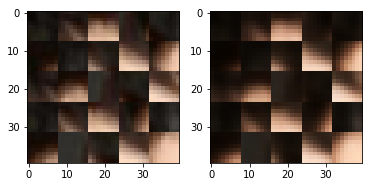

EPO: 45, recon_loss: 0.0023, total_loss: 0.0049
EPO: 45, recon_loss: 0.0060, total_loss: 0.0111
EPO: 45, recon_loss: 0.0024, total_loss: 0.0053
EPO: 45, recon_loss: 0.0034, total_loss: 0.0083
EPO: 45, recon_loss: 0.0030, total_loss: 0.0065
EPO: 45, recon_loss: 0.0034, total_loss: 0.0076
EPO: 45, recon_loss: 0.0101, total_loss: 0.0188
EPO: 45, recon_loss: 0.0091, total_loss: 0.0168
EPO: 45, recon_loss: 0.0075, total_loss: 0.0156
EPO: 45, recon_loss: 0.0085, total_loss: 0.0160
######### what? the reconstruction psnr is: 31.7536


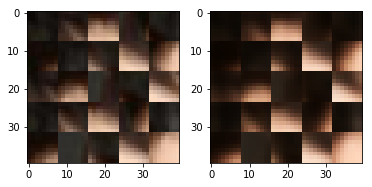

EPO: 45, recon_loss: 0.0058, total_loss: 0.0120
EPO: 45, recon_loss: 0.0048, total_loss: 0.0109
EPO: 45, recon_loss: 0.0026, total_loss: 0.0066
EPO: 45, recon_loss: 0.0037, total_loss: 0.0094
EPO: 45, recon_loss: 0.0056, total_loss: 0.0103
EPO: 45, recon_loss: 0.0055, total_loss: 0.0122
EPO: 45, recon_loss: 0.0064, total_loss: 0.0135
EPO: 45, recon_loss: 0.0014, total_loss: 0.0055
EPO: 45, recon_loss: 0.0035, total_loss: 0.0091
EPO: 45, recon_loss: 0.0059, total_loss: 0.0118
######### what? the reconstruction psnr is: 31.5283


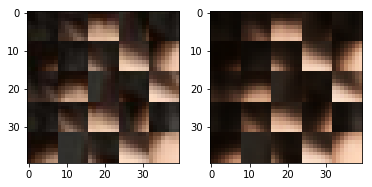

EPO: 45, recon_loss: 0.0024, total_loss: 0.0071
EPO: 45, recon_loss: 0.0043, total_loss: 0.0106
EPO: 45, recon_loss: 0.0048, total_loss: 0.0138
EPO: 45, recon_loss: 0.0064, total_loss: 0.0148
EPO: 45, recon_loss: 0.0115, total_loss: 0.0238
EPO: 45, recon_loss: 0.0039, total_loss: 0.0128
EPO: 45, recon_loss: 0.0079, total_loss: 0.0165
EPO: 45, recon_loss: 0.0051, total_loss: 0.0135
EPO: 45, recon_loss: 0.0059, total_loss: 0.0162
EPO: 45, recon_loss: 0.0117, total_loss: 0.0226
######### what? the reconstruction psnr is: 32.1143


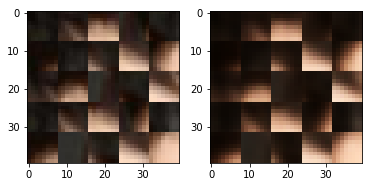

EPO: 45, recon_loss: 0.0082, total_loss: 0.0199
EPO: 45, recon_loss: 0.0081, total_loss: 0.0180
EPO: 45, recon_loss: 0.0013, total_loss: 0.0089
EPO: 45, recon_loss: 0.0060, total_loss: 0.0159
EPO: 45, recon_loss: 0.0154, total_loss: 0.0237
EPO: 45, recon_loss: 0.0080, total_loss: 0.0128
EPO: 45, recon_loss: 0.0027, total_loss: 0.0058
EPO: 45, recon_loss: 0.0017, total_loss: 0.0052
EPO: 45, recon_loss: 0.0023, total_loss: 0.0070
EPO: 45, recon_loss: 0.0058, total_loss: 0.0114
######### what? the reconstruction psnr is: 32.0494


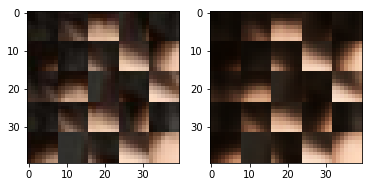

EPO: 45, recon_loss: 0.0028, total_loss: 0.0086
EPO: 45, recon_loss: 0.0054, total_loss: 0.0112
EPO: 45, recon_loss: 0.0006, total_loss: 0.0024
EPO: 45, recon_loss: 0.0004, total_loss: 0.0017
EPO: 45, recon_loss: 0.0011, total_loss: 0.0031
EPO: 45, recon_loss: 0.0005, total_loss: 0.0015
EPO: 45, recon_loss: 0.0012, total_loss: 0.0031
EPO: 45, recon_loss: 0.0026, total_loss: 0.0088
EPO: 45, recon_loss: 0.0016, total_loss: 0.0046
EPO: 45, recon_loss: 0.0038, total_loss: 0.0083
######### what? the reconstruction psnr is: 32.0126


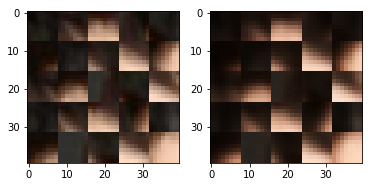

EPO: 45, recon_loss: 0.0018, total_loss: 0.0041
EPO: 45, recon_loss: 0.0024, total_loss: 0.0048
EPO: 45, recon_loss: 0.0043, total_loss: 0.0116
EPO: 45, recon_loss: 0.0048, total_loss: 0.0118
EPO: 45, recon_loss: 0.0047, total_loss: 0.0118
EPO: 45, recon_loss: 0.0055, total_loss: 0.0132
EPO: 45, recon_loss: 0.0029, total_loss: 0.0063
EPO: 45, recon_loss: 0.0033, total_loss: 0.0081
EPO: 45, recon_loss: 0.0021, total_loss: 0.0050
EPO: 45, recon_loss: 0.0033, total_loss: 0.0075
######### what? the reconstruction psnr is: 31.6917


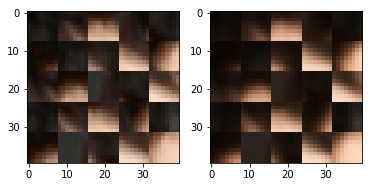

EPO: 45, recon_loss: 0.0022, total_loss: 0.0050
EPO: 45, recon_loss: 0.0022, total_loss: 0.0050
EPO: 45, recon_loss: 0.0023, total_loss: 0.0105
EPO: 45, recon_loss: 0.0010, total_loss: 0.0042
EPO: 45, recon_loss: 0.0032, total_loss: 0.0090
EPO: 45, recon_loss: 0.0024, total_loss: 0.0059
EPO: 45, recon_loss: 0.0033, total_loss: 0.0069
EPO: 45, recon_loss: 0.0012, total_loss: 0.0030
EPO: 45, recon_loss: 0.0008, total_loss: 0.0028
EPO: 45, recon_loss: 0.0015, total_loss: 0.0040
######### what? the reconstruction psnr is: 31.6931


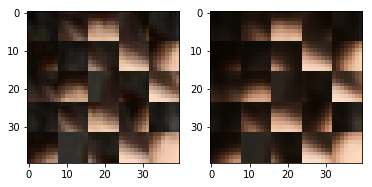

EPO: 45, recon_loss: 0.0015, total_loss: 0.0041
EPO: 45, recon_loss: 0.0014, total_loss: 0.0034
EPO: 45, recon_loss: 0.0025, total_loss: 0.0068
EPO: 45, recon_loss: 0.0016, total_loss: 0.0045
EPO: 45, recon_loss: 0.0036, total_loss: 0.0081
EPO: 45, recon_loss: 0.0028, total_loss: 0.0069
EPO: 45, recon_loss: 0.0027, total_loss: 0.0064
EPO: 45, recon_loss: 0.0025, total_loss: 0.0102
EPO: 45, recon_loss: 0.0024, total_loss: 0.0085
EPO: 45, recon_loss: 0.0061, total_loss: 0.0133
######### what? the reconstruction psnr is: 31.6487


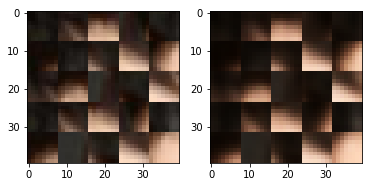

EPO: 45, recon_loss: 0.0064, total_loss: 0.0121
EPO: 45, recon_loss: 0.0027, total_loss: 0.0072
EPO: 45, recon_loss: 0.0094, total_loss: 0.0175
EPO: 45, recon_loss: 0.0007, total_loss: 0.0030
EPO: 45, recon_loss: 0.0014, total_loss: 0.0056
EPO: 45, recon_loss: 0.0058, total_loss: 0.0107
EPO: 45, recon_loss: 0.0031, total_loss: 0.0067
EPO: 45, recon_loss: 0.0028, total_loss: 0.0066
EPO: 45, recon_loss: 0.0038, total_loss: 0.0087
EPO: 45, recon_loss: 0.0045, total_loss: 0.0101
######### what? the reconstruction psnr is: 31.8739


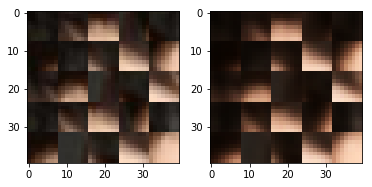

EPO: 45, recon_loss: 0.0057, total_loss: 0.0113
EPO: 45, recon_loss: 0.0013, total_loss: 0.0042
EPO: 45, recon_loss: 0.0056, total_loss: 0.0101
EPO: 45, recon_loss: 0.0010, total_loss: 0.0037
EPO: 45, recon_loss: 0.0043, total_loss: 0.0087
EPO: 45, recon_loss: 0.0046, total_loss: 0.0102
EPO: 45, recon_loss: 0.0020, total_loss: 0.0056
EPO: 45, recon_loss: 0.0028, total_loss: 0.0063
EPO: 45, recon_loss: 0.0036, total_loss: 0.0088
EPO: 45, recon_loss: 0.0025, total_loss: 0.0068
######### what? the reconstruction psnr is: 32.0391


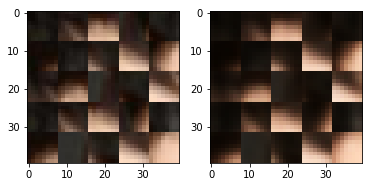

EPO: 45, recon_loss: 0.0070, total_loss: 0.0119
EPO: 45, recon_loss: 0.0031, total_loss: 0.0083
EPO: 45, recon_loss: 0.0046, total_loss: 0.0094
EPO: 45, recon_loss: 0.0041, total_loss: 0.0100
EPO: 45, recon_loss: 0.0008, total_loss: 0.0030
EPO: 45, recon_loss: 0.0043, total_loss: 0.0079
EPO: 45, recon_loss: 0.0023, total_loss: 0.0059
EPO: 45, recon_loss: 0.0032, total_loss: 0.0072
EPO: 45, recon_loss: 0.0027, total_loss: 0.0081
EPO: 45, recon_loss: 0.0026, total_loss: 0.0070
######### what? the reconstruction psnr is: 31.9819


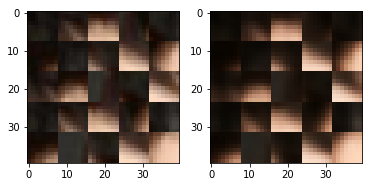

EPO: 45, recon_loss: 0.0065, total_loss: 0.0127
EPO: 45, recon_loss: 0.0023, total_loss: 0.0069
EPO: 45, recon_loss: 0.0054, total_loss: 0.0115
EPO: 45, recon_loss: 0.0034, total_loss: 0.0093
EPO: 45, recon_loss: 0.0011, total_loss: 0.0044
EPO: 45, recon_loss: 0.0044, total_loss: 0.0106
EPO: 45, recon_loss: 0.0017, total_loss: 0.0054
EPO: 45, recon_loss: 0.0037, total_loss: 0.0086
EPO: 45, recon_loss: 0.0016, total_loss: 0.0029
EPO: 45, recon_loss: 0.0013, total_loss: 0.0027
######### what? the reconstruction psnr is: 32.0659


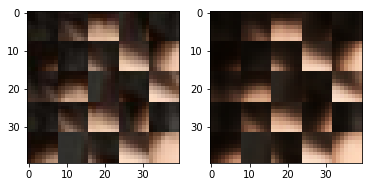

EPO: 45, recon_loss: 0.0030, total_loss: 0.0060
EPO: 45, recon_loss: 0.0018, total_loss: 0.0050
EPO: 45, recon_loss: 0.0019, total_loss: 0.0050
EPO: 45, recon_loss: 0.0089, total_loss: 0.0191
EPO: 45, recon_loss: 0.0061, total_loss: 0.0150
EPO: 45, recon_loss: 0.0071, total_loss: 0.0191
EPO: 45, recon_loss: 0.0049, total_loss: 0.0146
EPO: 45, recon_loss: 0.0063, total_loss: 0.0183
EPO: 45, recon_loss: 0.0014, total_loss: 0.0063
EPO: 45, recon_loss: 0.0018, total_loss: 0.0058
######### what? the reconstruction psnr is: 32.1768


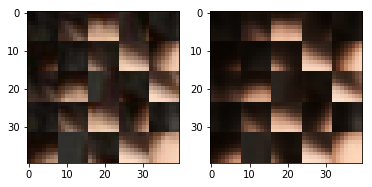

EPO: 45, recon_loss: 0.0056, total_loss: 0.0153
EPO: 45, recon_loss: 0.0025, total_loss: 0.0090
EPO: 45, recon_loss: 0.0027, total_loss: 0.0075
EPO: 45, recon_loss: 0.0030, total_loss: 0.0116
EPO: 45, recon_loss: 0.0029, total_loss: 0.0098
EPO: 45, recon_loss: 0.0052, total_loss: 0.0129
EPO: 45, recon_loss: 0.0028, total_loss: 0.0079
EPO: 45, recon_loss: 0.0027, total_loss: 0.0072
EPO: 45, recon_loss: 0.0037, total_loss: 0.0086
EPO: 45, recon_loss: 0.0017, total_loss: 0.0061
######### what? the reconstruction psnr is: 32.3324


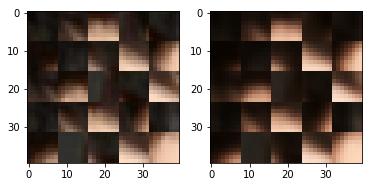

EPO: 45, recon_loss: 0.0051, total_loss: 0.0119
EPO: 45, recon_loss: 0.0028, total_loss: 0.0074
EPO: 45, recon_loss: 0.0018, total_loss: 0.0062
EPO: 45, recon_loss: 0.0033, total_loss: 0.0067
EPO: 45, recon_loss: 0.0016, total_loss: 0.0055
EPO: 45, recon_loss: 0.0041, total_loss: 0.0113
EPO: 45, recon_loss: 0.0045, total_loss: 0.0106
EPO: 45, recon_loss: 0.0034, total_loss: 0.0095
EPO: 45, recon_loss: 0.0066, total_loss: 0.0128
EPO: 45, recon_loss: 0.0010, total_loss: 0.0047
######### what? the reconstruction psnr is: 32.2791


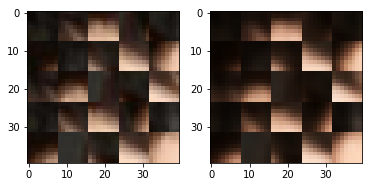

EPO: 45, recon_loss: 0.0033, total_loss: 0.0097
EPO: 45, recon_loss: 0.0045, total_loss: 0.0086
EPO: 45, recon_loss: 0.0033, total_loss: 0.0078
EPO: 45, recon_loss: 0.0036, total_loss: 0.0085
EPO: 45, recon_loss: 0.0014, total_loss: 0.0052
EPO: 45, recon_loss: 0.0020, total_loss: 0.0074
EPO: 45, recon_loss: 0.0017, total_loss: 0.0056
EPO: 45, recon_loss: 0.0017, total_loss: 0.0049
EPO: 45, recon_loss: 0.0017, total_loss: 0.0047
EPO: 45, recon_loss: 0.0068, total_loss: 0.0161
######### what? the reconstruction psnr is: 31.8694


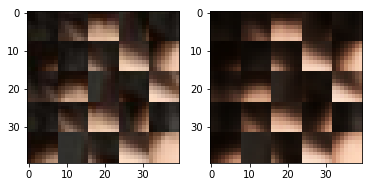

EPO: 45, recon_loss: 0.0045, total_loss: 0.0113
EPO: 45, recon_loss: 0.0047, total_loss: 0.0096
EPO: 45, recon_loss: 0.0043, total_loss: 0.0106
EPO: 45, recon_loss: 0.0027, total_loss: 0.0068
EPO: 45, recon_loss: 0.0045, total_loss: 0.0134
EPO: 45, recon_loss: 0.0072, total_loss: 0.0122
EPO: 45, recon_loss: 0.0053, total_loss: 0.0114
EPO: 45, recon_loss: 0.0019, total_loss: 0.0065
EPO: 45, recon_loss: 0.0047, total_loss: 0.0102
EPO: 45, recon_loss: 0.0009, total_loss: 0.0025
######### what? the reconstruction psnr is: 32.0167


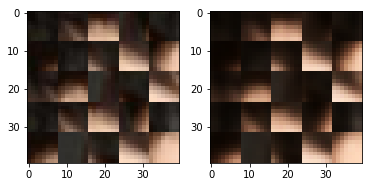

EPO: 45, recon_loss: 0.0006, total_loss: 0.0018
EPO: 45, recon_loss: 0.0037, total_loss: 0.0067
EPO: 45, recon_loss: 0.0010, total_loss: 0.0026
EPO: 45, recon_loss: 0.0022, total_loss: 0.0045
EPO: 45, recon_loss: 0.0029, total_loss: 0.0074
EPO: 45, recon_loss: 0.0024, total_loss: 0.0067
EPO: 45, recon_loss: 0.0027, total_loss: 0.0071
EPO: 45, recon_loss: 0.0016, total_loss: 0.0046
EPO: 45, recon_loss: 0.0020, total_loss: 0.0048
EPO: 45, recon_loss: 0.0037, total_loss: 0.0094
######### what? the reconstruction psnr is: 31.8915


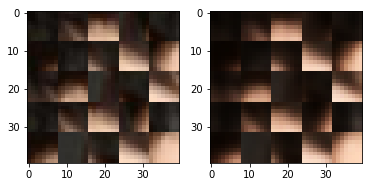

EPO: 45, recon_loss: 0.0033, total_loss: 0.0086
EPO: 45, recon_loss: 0.0059, total_loss: 0.0101
EPO: 45, recon_loss: 0.0040, total_loss: 0.0079
EPO: 45, recon_loss: 0.0041, total_loss: 0.0077
EPO: 45, recon_loss: 0.0065, total_loss: 0.0147
EPO: 45, recon_loss: 0.0108, total_loss: 0.0216
EPO: 45, recon_loss: 0.0057, total_loss: 0.0102
EPO: 45, recon_loss: 0.0040, total_loss: 0.0078
EPO: 45, recon_loss: 0.0060, total_loss: 0.0097
EPO: 45, recon_loss: 0.0015, total_loss: 0.0054
######### what? the reconstruction psnr is: 30.6148


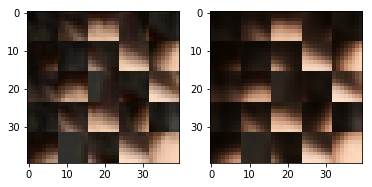

EPO: 45, recon_loss: 0.0009, total_loss: 0.0043
EPO: 45, recon_loss: 0.0030, total_loss: 0.0064
EPO: 45, recon_loss: 0.0018, total_loss: 0.0059
EPO: 45, recon_loss: 0.0026, total_loss: 0.0056
EPO: 45, recon_loss: 0.0026, total_loss: 0.0119
EPO: 45, recon_loss: 0.0010, total_loss: 0.0048
EPO: 45, recon_loss: 0.0023, total_loss: 0.0066
EPO: 45, recon_loss: 0.0010, total_loss: 0.0030
EPO: 45, recon_loss: 0.0009, total_loss: 0.0022
EPO: 45, recon_loss: 0.0035, total_loss: 0.0088
######### what? the reconstruction psnr is: 32.0144


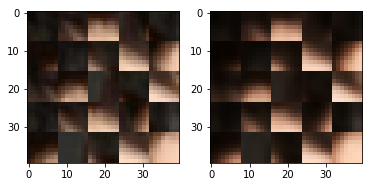

EPO: 45, recon_loss: 0.0037, total_loss: 0.0086
EPO: 45, recon_loss: 0.0085, total_loss: 0.0133
EPO: 45, recon_loss: 0.0069, total_loss: 0.0119
EPO: 45, recon_loss: 0.0092, total_loss: 0.0138
EPO: 46, recon_loss: 0.0038, total_loss: 0.0073
EPO: 46, recon_loss: 0.0015, total_loss: 0.0031
EPO: 46, recon_loss: 0.0042, total_loss: 0.0069
EPO: 46, recon_loss: 0.0021, total_loss: 0.0051
EPO: 46, recon_loss: 0.0017, total_loss: 0.0038
EPO: 46, recon_loss: 0.0027, total_loss: 0.0110
######### what? the reconstruction psnr is: 32.1586


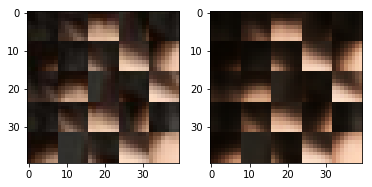

EPO: 46, recon_loss: 0.0012, total_loss: 0.0047
EPO: 46, recon_loss: 0.0025, total_loss: 0.0064
EPO: 46, recon_loss: 0.0038, total_loss: 0.0073
EPO: 46, recon_loss: 0.0033, total_loss: 0.0070
EPO: 46, recon_loss: 0.0036, total_loss: 0.0092
EPO: 46, recon_loss: 0.0016, total_loss: 0.0053
EPO: 46, recon_loss: 0.0020, total_loss: 0.0065
EPO: 46, recon_loss: 0.0019, total_loss: 0.0046
EPO: 46, recon_loss: 0.0021, total_loss: 0.0048
EPO: 46, recon_loss: 0.0058, total_loss: 0.0109
######### what? the reconstruction psnr is: 32.1955


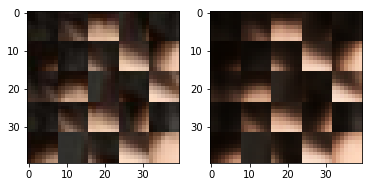

EPO: 46, recon_loss: 0.0022, total_loss: 0.0058
EPO: 46, recon_loss: 0.0028, total_loss: 0.0074
EPO: 46, recon_loss: 0.0029, total_loss: 0.0072
EPO: 46, recon_loss: 0.0022, total_loss: 0.0057
EPO: 46, recon_loss: 0.0025, total_loss: 0.0063
EPO: 46, recon_loss: 0.0022, total_loss: 0.0045
EPO: 46, recon_loss: 0.0022, total_loss: 0.0052
EPO: 46, recon_loss: 0.0058, total_loss: 0.0096
EPO: 46, recon_loss: 0.0016, total_loss: 0.0040
EPO: 46, recon_loss: 0.0034, total_loss: 0.0059
######### what? the reconstruction psnr is: 32.0903


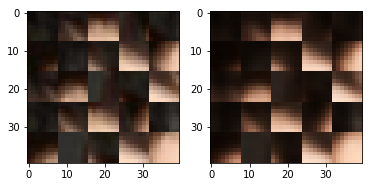

EPO: 46, recon_loss: 0.0050, total_loss: 0.0130
EPO: 46, recon_loss: 0.0024, total_loss: 0.0074
EPO: 46, recon_loss: 0.0062, total_loss: 0.0121
EPO: 46, recon_loss: 0.0042, total_loss: 0.0094
EPO: 46, recon_loss: 0.0076, total_loss: 0.0128
EPO: 46, recon_loss: 0.0028, total_loss: 0.0095
EPO: 46, recon_loss: 0.0014, total_loss: 0.0051
EPO: 46, recon_loss: 0.0038, total_loss: 0.0078
EPO: 46, recon_loss: 0.0026, total_loss: 0.0050
EPO: 46, recon_loss: 0.0025, total_loss: 0.0058
######### what? the reconstruction psnr is: 31.6041


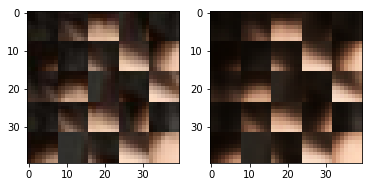

EPO: 46, recon_loss: 0.0008, total_loss: 0.0020
EPO: 46, recon_loss: 0.0013, total_loss: 0.0033
EPO: 46, recon_loss: 0.0044, total_loss: 0.0085
EPO: 46, recon_loss: 0.0021, total_loss: 0.0054
EPO: 46, recon_loss: 0.0032, total_loss: 0.0084
EPO: 46, recon_loss: 0.0010, total_loss: 0.0059
EPO: 46, recon_loss: 0.0014, total_loss: 0.0063
EPO: 46, recon_loss: 0.0034, total_loss: 0.0082
EPO: 46, recon_loss: 0.0008, total_loss: 0.0036
EPO: 46, recon_loss: 0.0031, total_loss: 0.0073
######### what? the reconstruction psnr is: 31.8098


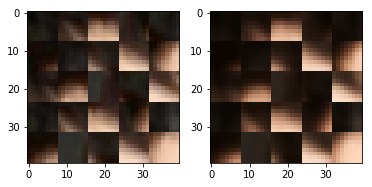

EPO: 46, recon_loss: 0.0057, total_loss: 0.0159
EPO: 46, recon_loss: 0.0014, total_loss: 0.0051
EPO: 46, recon_loss: 0.0069, total_loss: 0.0127
EPO: 46, recon_loss: 0.0020, total_loss: 0.0047
EPO: 46, recon_loss: 0.0019, total_loss: 0.0043
EPO: 46, recon_loss: 0.0047, total_loss: 0.0094
EPO: 46, recon_loss: 0.0021, total_loss: 0.0050
EPO: 46, recon_loss: 0.0043, total_loss: 0.0089
EPO: 46, recon_loss: 0.0026, total_loss: 0.0052
EPO: 46, recon_loss: 0.0036, total_loss: 0.0076
######### what? the reconstruction psnr is: 32.0230


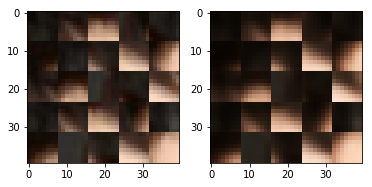

EPO: 46, recon_loss: 0.0108, total_loss: 0.0192
EPO: 46, recon_loss: 0.0065, total_loss: 0.0132
EPO: 46, recon_loss: 0.0104, total_loss: 0.0190
EPO: 46, recon_loss: 0.0067, total_loss: 0.0135
EPO: 46, recon_loss: 0.0060, total_loss: 0.0129
EPO: 46, recon_loss: 0.0021, total_loss: 0.0074
EPO: 46, recon_loss: 0.0026, total_loss: 0.0064
EPO: 46, recon_loss: 0.0034, total_loss: 0.0093
EPO: 46, recon_loss: 0.0044, total_loss: 0.0083
EPO: 46, recon_loss: 0.0043, total_loss: 0.0109
######### what? the reconstruction psnr is: 31.7890


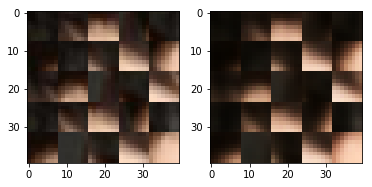

EPO: 46, recon_loss: 0.0028, total_loss: 0.0100
EPO: 46, recon_loss: 0.0011, total_loss: 0.0054
EPO: 46, recon_loss: 0.0042, total_loss: 0.0099
EPO: 46, recon_loss: 0.0029, total_loss: 0.0074
EPO: 46, recon_loss: 0.0027, total_loss: 0.0076
EPO: 46, recon_loss: 0.0052, total_loss: 0.0135
EPO: 46, recon_loss: 0.0044, total_loss: 0.0133
EPO: 46, recon_loss: 0.0089, total_loss: 0.0199
EPO: 46, recon_loss: 0.0081, total_loss: 0.0186
EPO: 46, recon_loss: 0.0042, total_loss: 0.0129
######### what? the reconstruction psnr is: 32.0596


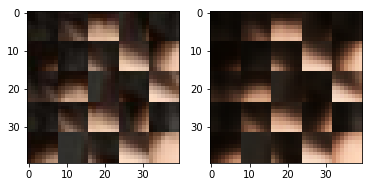

EPO: 46, recon_loss: 0.0139, total_loss: 0.0252
EPO: 46, recon_loss: 0.0046, total_loss: 0.0132
EPO: 46, recon_loss: 0.0073, total_loss: 0.0175
EPO: 46, recon_loss: 0.0108, total_loss: 0.0212
EPO: 46, recon_loss: 0.0064, total_loss: 0.0168
EPO: 46, recon_loss: 0.0076, total_loss: 0.0168
EPO: 46, recon_loss: 0.0013, total_loss: 0.0087
EPO: 46, recon_loss: 0.0079, total_loss: 0.0171
EPO: 46, recon_loss: 0.0111, total_loss: 0.0173
EPO: 46, recon_loss: 0.0027, total_loss: 0.0061
######### what? the reconstruction psnr is: 31.4500


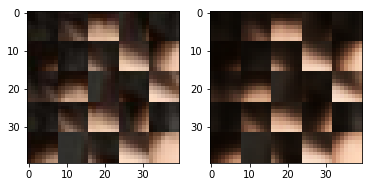

EPO: 46, recon_loss: 0.0024, total_loss: 0.0054
EPO: 46, recon_loss: 0.0015, total_loss: 0.0050
EPO: 46, recon_loss: 0.0025, total_loss: 0.0077
EPO: 46, recon_loss: 0.0044, total_loss: 0.0099
EPO: 46, recon_loss: 0.0031, total_loss: 0.0089
EPO: 46, recon_loss: 0.0054, total_loss: 0.0120
EPO: 46, recon_loss: 0.0004, total_loss: 0.0019
EPO: 46, recon_loss: 0.0004, total_loss: 0.0020
EPO: 46, recon_loss: 0.0011, total_loss: 0.0029
EPO: 46, recon_loss: 0.0005, total_loss: 0.0017
######### what? the reconstruction psnr is: 31.9783


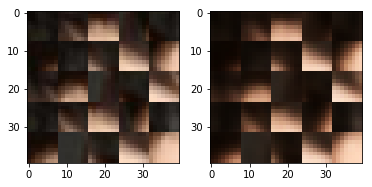

EPO: 46, recon_loss: 0.0017, total_loss: 0.0039
EPO: 46, recon_loss: 0.0019, total_loss: 0.0060
EPO: 46, recon_loss: 0.0022, total_loss: 0.0060
EPO: 46, recon_loss: 0.0039, total_loss: 0.0089
EPO: 46, recon_loss: 0.0019, total_loss: 0.0042
EPO: 46, recon_loss: 0.0033, total_loss: 0.0058
EPO: 46, recon_loss: 0.0043, total_loss: 0.0117
EPO: 46, recon_loss: 0.0069, total_loss: 0.0159
EPO: 46, recon_loss: 0.0047, total_loss: 0.0128
EPO: 46, recon_loss: 0.0036, total_loss: 0.0092
######### what? the reconstruction psnr is: 31.8250


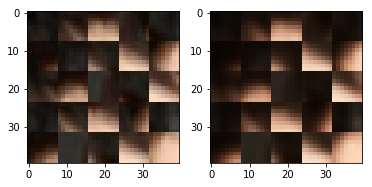

EPO: 46, recon_loss: 0.0043, total_loss: 0.0086
EPO: 46, recon_loss: 0.0026, total_loss: 0.0069
EPO: 46, recon_loss: 0.0022, total_loss: 0.0051
EPO: 46, recon_loss: 0.0036, total_loss: 0.0079
EPO: 46, recon_loss: 0.0017, total_loss: 0.0040
EPO: 46, recon_loss: 0.0023, total_loss: 0.0054
EPO: 46, recon_loss: 0.0024, total_loss: 0.0105
EPO: 46, recon_loss: 0.0008, total_loss: 0.0039
EPO: 46, recon_loss: 0.0047, total_loss: 0.0105
EPO: 46, recon_loss: 0.0027, total_loss: 0.0065
######### what? the reconstruction psnr is: 31.7803


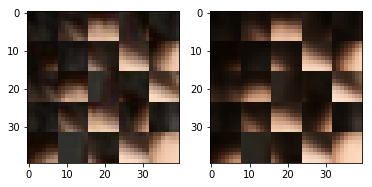

EPO: 46, recon_loss: 0.0031, total_loss: 0.0075
EPO: 46, recon_loss: 0.0011, total_loss: 0.0029
EPO: 46, recon_loss: 0.0009, total_loss: 0.0028
EPO: 46, recon_loss: 0.0019, total_loss: 0.0049
EPO: 46, recon_loss: 0.0008, total_loss: 0.0029
EPO: 46, recon_loss: 0.0010, total_loss: 0.0028
EPO: 46, recon_loss: 0.0023, total_loss: 0.0064
EPO: 46, recon_loss: 0.0016, total_loss: 0.0046
EPO: 46, recon_loss: 0.0050, total_loss: 0.0100
EPO: 46, recon_loss: 0.0026, total_loss: 0.0066
######### what? the reconstruction psnr is: 32.0249


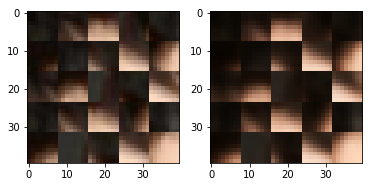

EPO: 46, recon_loss: 0.0021, total_loss: 0.0054
EPO: 46, recon_loss: 0.0023, total_loss: 0.0098
EPO: 46, recon_loss: 0.0026, total_loss: 0.0081
EPO: 46, recon_loss: 0.0075, total_loss: 0.0148
EPO: 46, recon_loss: 0.0032, total_loss: 0.0077
EPO: 46, recon_loss: 0.0043, total_loss: 0.0098
EPO: 46, recon_loss: 0.0013, total_loss: 0.0060
EPO: 46, recon_loss: 0.0004, total_loss: 0.0025
EPO: 46, recon_loss: 0.0026, total_loss: 0.0071
EPO: 46, recon_loss: 0.0037, total_loss: 0.0071
######### what? the reconstruction psnr is: 31.3906


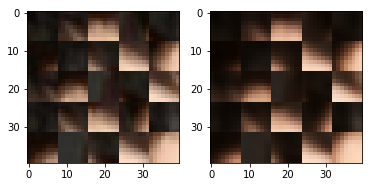

EPO: 46, recon_loss: 0.0033, total_loss: 0.0077
EPO: 46, recon_loss: 0.0039, total_loss: 0.0089
EPO: 46, recon_loss: 0.0051, total_loss: 0.0104
EPO: 46, recon_loss: 0.0041, total_loss: 0.0098
EPO: 46, recon_loss: 0.0038, total_loss: 0.0087
EPO: 46, recon_loss: 0.0014, total_loss: 0.0042
EPO: 46, recon_loss: 0.0047, total_loss: 0.0100
EPO: 46, recon_loss: 0.0009, total_loss: 0.0036
EPO: 46, recon_loss: 0.0045, total_loss: 0.0094
EPO: 46, recon_loss: 0.0046, total_loss: 0.0099
######### what? the reconstruction psnr is: 31.7406


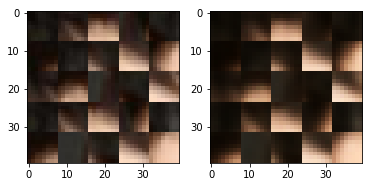

EPO: 46, recon_loss: 0.0023, total_loss: 0.0057
EPO: 46, recon_loss: 0.0024, total_loss: 0.0059
EPO: 46, recon_loss: 0.0029, total_loss: 0.0072
EPO: 46, recon_loss: 0.0026, total_loss: 0.0071
EPO: 46, recon_loss: 0.0057, total_loss: 0.0103
EPO: 46, recon_loss: 0.0035, total_loss: 0.0090
EPO: 46, recon_loss: 0.0053, total_loss: 0.0101
EPO: 46, recon_loss: 0.0030, total_loss: 0.0071
EPO: 46, recon_loss: 0.0010, total_loss: 0.0034
EPO: 46, recon_loss: 0.0029, total_loss: 0.0061
######### what? the reconstruction psnr is: 32.0362


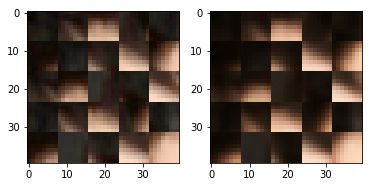

EPO: 46, recon_loss: 0.0026, total_loss: 0.0063
EPO: 46, recon_loss: 0.0044, total_loss: 0.0096
EPO: 46, recon_loss: 0.0026, total_loss: 0.0074
EPO: 46, recon_loss: 0.0027, total_loss: 0.0075
EPO: 46, recon_loss: 0.0079, total_loss: 0.0149
EPO: 46, recon_loss: 0.0025, total_loss: 0.0074
EPO: 46, recon_loss: 0.0063, total_loss: 0.0140
EPO: 46, recon_loss: 0.0018, total_loss: 0.0058
EPO: 46, recon_loss: 0.0011, total_loss: 0.0046
EPO: 46, recon_loss: 0.0047, total_loss: 0.0115
######### what? the reconstruction psnr is: 32.2098


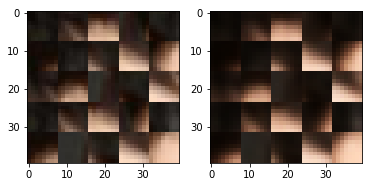

EPO: 46, recon_loss: 0.0021, total_loss: 0.0064
EPO: 46, recon_loss: 0.0053, total_loss: 0.0108
EPO: 46, recon_loss: 0.0016, total_loss: 0.0029
EPO: 46, recon_loss: 0.0013, total_loss: 0.0027
EPO: 46, recon_loss: 0.0032, total_loss: 0.0065
EPO: 46, recon_loss: 0.0013, total_loss: 0.0044
EPO: 46, recon_loss: 0.0023, total_loss: 0.0064
EPO: 46, recon_loss: 0.0082, total_loss: 0.0188
EPO: 46, recon_loss: 0.0062, total_loss: 0.0151
EPO: 46, recon_loss: 0.0094, total_loss: 0.0220
######### what? the reconstruction psnr is: 31.8486


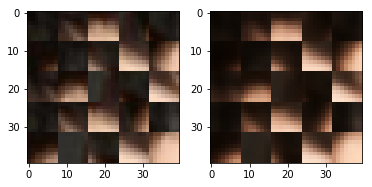

EPO: 46, recon_loss: 0.0047, total_loss: 0.0134
EPO: 46, recon_loss: 0.0078, total_loss: 0.0202
EPO: 46, recon_loss: 0.0014, total_loss: 0.0064
EPO: 46, recon_loss: 0.0027, total_loss: 0.0070
EPO: 46, recon_loss: 0.0047, total_loss: 0.0139
EPO: 46, recon_loss: 0.0026, total_loss: 0.0084
EPO: 46, recon_loss: 0.0027, total_loss: 0.0077
EPO: 46, recon_loss: 0.0030, total_loss: 0.0113
EPO: 46, recon_loss: 0.0032, total_loss: 0.0103
EPO: 46, recon_loss: 0.0068, total_loss: 0.0148
######### what? the reconstruction psnr is: 32.3837


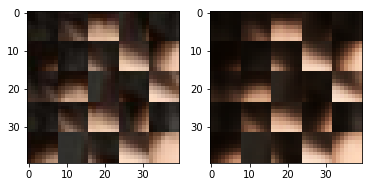

EPO: 46, recon_loss: 0.0018, total_loss: 0.0064
EPO: 46, recon_loss: 0.0019, total_loss: 0.0061
EPO: 46, recon_loss: 0.0035, total_loss: 0.0093
EPO: 46, recon_loss: 0.0013, total_loss: 0.0057
EPO: 46, recon_loss: 0.0064, total_loss: 0.0130
EPO: 46, recon_loss: 0.0017, total_loss: 0.0060
EPO: 46, recon_loss: 0.0022, total_loss: 0.0066
EPO: 46, recon_loss: 0.0031, total_loss: 0.0065
EPO: 46, recon_loss: 0.0017, total_loss: 0.0060
EPO: 46, recon_loss: 0.0068, total_loss: 0.0135
######### what? the reconstruction psnr is: 32.1478


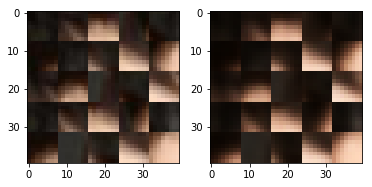

EPO: 46, recon_loss: 0.0035, total_loss: 0.0099
EPO: 46, recon_loss: 0.0032, total_loss: 0.0080
EPO: 46, recon_loss: 0.0033, total_loss: 0.0132
EPO: 46, recon_loss: 0.0010, total_loss: 0.0048
EPO: 46, recon_loss: 0.0047, total_loss: 0.0129
EPO: 46, recon_loss: 0.0032, total_loss: 0.0062
EPO: 46, recon_loss: 0.0028, total_loss: 0.0071
EPO: 46, recon_loss: 0.0025, total_loss: 0.0083
EPO: 46, recon_loss: 0.0013, total_loss: 0.0052
EPO: 46, recon_loss: 0.0023, total_loss: 0.0078
######### what? the reconstruction psnr is: 32.3472


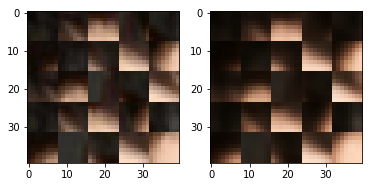

EPO: 46, recon_loss: 0.0013, total_loss: 0.0047
EPO: 46, recon_loss: 0.0021, total_loss: 0.0055
EPO: 46, recon_loss: 0.0048, total_loss: 0.0119
EPO: 46, recon_loss: 0.0077, total_loss: 0.0168
EPO: 46, recon_loss: 0.0038, total_loss: 0.0100
EPO: 46, recon_loss: 0.0044, total_loss: 0.0103
EPO: 46, recon_loss: 0.0044, total_loss: 0.0106
EPO: 46, recon_loss: 0.0024, total_loss: 0.0057
EPO: 46, recon_loss: 0.0034, total_loss: 0.0108
EPO: 46, recon_loss: 0.0068, total_loss: 0.0123
######### what? the reconstruction psnr is: 27.8446


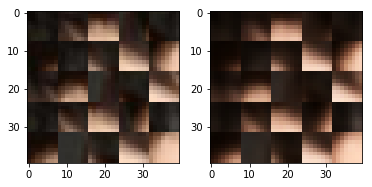

EPO: 46, recon_loss: 0.0042, total_loss: 0.0103
EPO: 46, recon_loss: 0.0027, total_loss: 0.0077
EPO: 46, recon_loss: 0.0056, total_loss: 0.0119
EPO: 46, recon_loss: 0.0007, total_loss: 0.0019
EPO: 46, recon_loss: 0.0013, total_loss: 0.0034
EPO: 46, recon_loss: 0.0026, total_loss: 0.0047
EPO: 46, recon_loss: 0.0010, total_loss: 0.0025
EPO: 46, recon_loss: 0.0024, total_loss: 0.0051
EPO: 46, recon_loss: 0.0033, total_loss: 0.0085
EPO: 46, recon_loss: 0.0022, total_loss: 0.0064
######### what? the reconstruction psnr is: 31.8852


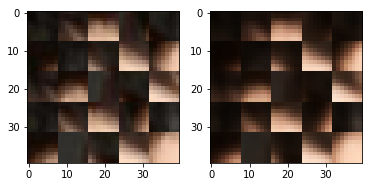

EPO: 46, recon_loss: 0.0028, total_loss: 0.0072
EPO: 46, recon_loss: 0.0020, total_loss: 0.0049
EPO: 46, recon_loss: 0.0027, total_loss: 0.0061
EPO: 46, recon_loss: 0.0034, total_loss: 0.0084
EPO: 46, recon_loss: 0.0029, total_loss: 0.0082
EPO: 46, recon_loss: 0.0067, total_loss: 0.0110
EPO: 46, recon_loss: 0.0034, total_loss: 0.0073
EPO: 46, recon_loss: 0.0054, total_loss: 0.0096
EPO: 46, recon_loss: 0.0092, total_loss: 0.0184
EPO: 46, recon_loss: 0.0078, total_loss: 0.0142
######### what? the reconstruction psnr is: 31.4561


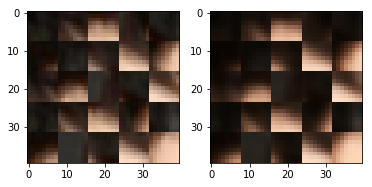

EPO: 46, recon_loss: 0.0053, total_loss: 0.0099
EPO: 46, recon_loss: 0.0040, total_loss: 0.0072
EPO: 46, recon_loss: 0.0076, total_loss: 0.0113
EPO: 46, recon_loss: 0.0010, total_loss: 0.0043
EPO: 46, recon_loss: 0.0014, total_loss: 0.0051
EPO: 46, recon_loss: 0.0037, total_loss: 0.0070
EPO: 46, recon_loss: 0.0024, total_loss: 0.0072
EPO: 46, recon_loss: 0.0038, total_loss: 0.0078
EPO: 46, recon_loss: 0.0025, total_loss: 0.0109
EPO: 46, recon_loss: 0.0010, total_loss: 0.0048
######### what? the reconstruction psnr is: 31.9781


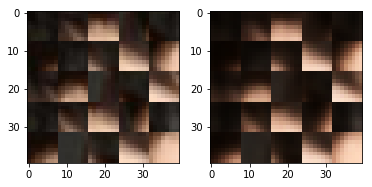

EPO: 46, recon_loss: 0.0039, total_loss: 0.0082
EPO: 46, recon_loss: 0.0007, total_loss: 0.0022
EPO: 46, recon_loss: 0.0011, total_loss: 0.0024
EPO: 46, recon_loss: 0.0040, total_loss: 0.0090
EPO: 46, recon_loss: 0.0040, total_loss: 0.0092
EPO: 46, recon_loss: 0.0094, total_loss: 0.0144
EPO: 46, recon_loss: 0.0078, total_loss: 0.0126
EPO: 46, recon_loss: 0.0084, total_loss: 0.0124
EPO: 47, recon_loss: 0.0029, total_loss: 0.0056
EPO: 47, recon_loss: 0.0015, total_loss: 0.0031
######### what? the reconstruction psnr is: 31.9343


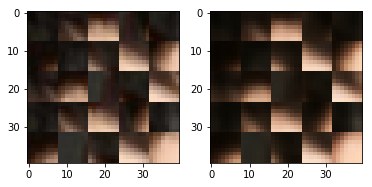

EPO: 47, recon_loss: 0.0053, total_loss: 0.0085
EPO: 47, recon_loss: 0.0015, total_loss: 0.0036
EPO: 47, recon_loss: 0.0018, total_loss: 0.0036
EPO: 47, recon_loss: 0.0021, total_loss: 0.0083
EPO: 47, recon_loss: 0.0012, total_loss: 0.0048
EPO: 47, recon_loss: 0.0023, total_loss: 0.0061
EPO: 47, recon_loss: 0.0019, total_loss: 0.0041
EPO: 47, recon_loss: 0.0042, total_loss: 0.0081
EPO: 47, recon_loss: 0.0019, total_loss: 0.0075
EPO: 47, recon_loss: 0.0013, total_loss: 0.0046
######### what? the reconstruction psnr is: 32.2247


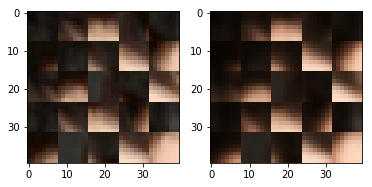

EPO: 47, recon_loss: 0.0020, total_loss: 0.0062
EPO: 47, recon_loss: 0.0016, total_loss: 0.0038
EPO: 47, recon_loss: 0.0023, total_loss: 0.0055
EPO: 47, recon_loss: 0.0024, total_loss: 0.0064
EPO: 47, recon_loss: 0.0028, total_loss: 0.0071
EPO: 47, recon_loss: 0.0027, total_loss: 0.0065
EPO: 47, recon_loss: 0.0024, total_loss: 0.0063
EPO: 47, recon_loss: 0.0019, total_loss: 0.0048
EPO: 47, recon_loss: 0.0023, total_loss: 0.0049
EPO: 47, recon_loss: 0.0015, total_loss: 0.0039
######### what? the reconstruction psnr is: 32.1962


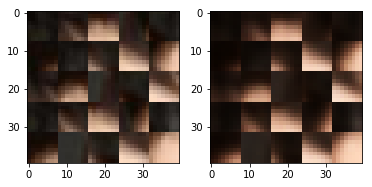

EPO: 47, recon_loss: 0.0026, total_loss: 0.0060
EPO: 47, recon_loss: 0.0049, total_loss: 0.0086
EPO: 47, recon_loss: 0.0017, total_loss: 0.0036
EPO: 47, recon_loss: 0.0034, total_loss: 0.0073
EPO: 47, recon_loss: 0.0026, total_loss: 0.0077
EPO: 47, recon_loss: 0.0026, total_loss: 0.0076
EPO: 47, recon_loss: 0.0057, total_loss: 0.0114
EPO: 47, recon_loss: 0.0048, total_loss: 0.0113
EPO: 47, recon_loss: 0.0054, total_loss: 0.0098
EPO: 47, recon_loss: 0.0021, total_loss: 0.0072
######### what? the reconstruction psnr is: 31.8924


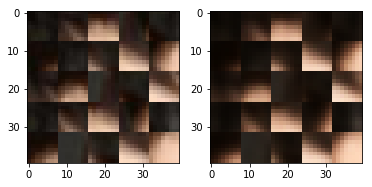

EPO: 47, recon_loss: 0.0017, total_loss: 0.0064
EPO: 47, recon_loss: 0.0035, total_loss: 0.0070
EPO: 47, recon_loss: 0.0023, total_loss: 0.0048
EPO: 47, recon_loss: 0.0031, total_loss: 0.0070
EPO: 47, recon_loss: 0.0008, total_loss: 0.0021
EPO: 47, recon_loss: 0.0020, total_loss: 0.0051
EPO: 47, recon_loss: 0.0040, total_loss: 0.0073
EPO: 47, recon_loss: 0.0024, total_loss: 0.0059
EPO: 47, recon_loss: 0.0043, total_loss: 0.0096
EPO: 47, recon_loss: 0.0010, total_loss: 0.0060
######### what? the reconstruction psnr is: 31.8700


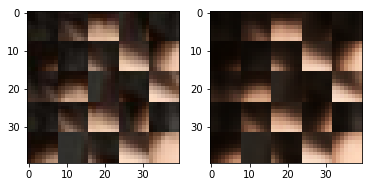

EPO: 47, recon_loss: 0.0012, total_loss: 0.0057
EPO: 47, recon_loss: 0.0040, total_loss: 0.0084
EPO: 47, recon_loss: 0.0008, total_loss: 0.0038
EPO: 47, recon_loss: 0.0038, total_loss: 0.0084
EPO: 47, recon_loss: 0.0053, total_loss: 0.0156
EPO: 47, recon_loss: 0.0019, total_loss: 0.0059
EPO: 47, recon_loss: 0.0051, total_loss: 0.0099
EPO: 47, recon_loss: 0.0017, total_loss: 0.0040
EPO: 47, recon_loss: 0.0027, total_loss: 0.0055
EPO: 47, recon_loss: 0.0042, total_loss: 0.0091
######### what? the reconstruction psnr is: 32.1690


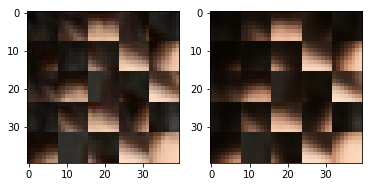

EPO: 47, recon_loss: 0.0017, total_loss: 0.0044
EPO: 47, recon_loss: 0.0042, total_loss: 0.0088
EPO: 47, recon_loss: 0.0024, total_loss: 0.0050
EPO: 47, recon_loss: 0.0043, total_loss: 0.0093
EPO: 47, recon_loss: 0.0068, total_loss: 0.0132
EPO: 47, recon_loss: 0.0072, total_loss: 0.0142
EPO: 47, recon_loss: 0.0133, total_loss: 0.0224
EPO: 47, recon_loss: 0.0081, total_loss: 0.0155
EPO: 47, recon_loss: 0.0063, total_loss: 0.0127
EPO: 47, recon_loss: 0.0023, total_loss: 0.0070
######### what? the reconstruction psnr is: 32.1896


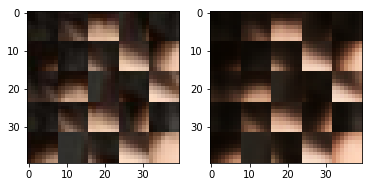

EPO: 47, recon_loss: 0.0026, total_loss: 0.0070
EPO: 47, recon_loss: 0.0035, total_loss: 0.0086
EPO: 47, recon_loss: 0.0031, total_loss: 0.0070
EPO: 47, recon_loss: 0.0045, total_loss: 0.0103
EPO: 47, recon_loss: 0.0024, total_loss: 0.0082
EPO: 47, recon_loss: 0.0010, total_loss: 0.0053
EPO: 47, recon_loss: 0.0051, total_loss: 0.0100
EPO: 47, recon_loss: 0.0023, total_loss: 0.0070
EPO: 47, recon_loss: 0.0027, total_loss: 0.0070
EPO: 47, recon_loss: 0.0056, total_loss: 0.0141
######### what? the reconstruction psnr is: 31.4613


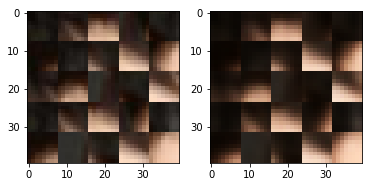

EPO: 47, recon_loss: 0.0046, total_loss: 0.0150
EPO: 47, recon_loss: 0.0093, total_loss: 0.0197
EPO: 47, recon_loss: 0.0056, total_loss: 0.0147
EPO: 47, recon_loss: 0.0044, total_loss: 0.0128
EPO: 47, recon_loss: 0.0076, total_loss: 0.0164
EPO: 47, recon_loss: 0.0048, total_loss: 0.0135
EPO: 47, recon_loss: 0.0108, total_loss: 0.0224
EPO: 47, recon_loss: 0.0079, total_loss: 0.0177
EPO: 47, recon_loss: 0.0066, total_loss: 0.0170
EPO: 47, recon_loss: 0.0020, total_loss: 0.0098
######### what? the reconstruction psnr is: 31.7241


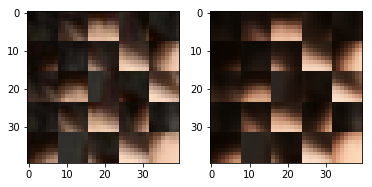

EPO: 47, recon_loss: 0.0020, total_loss: 0.0101
EPO: 47, recon_loss: 0.0106, total_loss: 0.0193
EPO: 47, recon_loss: 0.0121, total_loss: 0.0180
EPO: 47, recon_loss: 0.0018, total_loss: 0.0046
EPO: 47, recon_loss: 0.0026, total_loss: 0.0057
EPO: 47, recon_loss: 0.0017, total_loss: 0.0060
EPO: 47, recon_loss: 0.0031, total_loss: 0.0083
EPO: 47, recon_loss: 0.0038, total_loss: 0.0091
EPO: 47, recon_loss: 0.0033, total_loss: 0.0097
EPO: 47, recon_loss: 0.0069, total_loss: 0.0143
######### what? the reconstruction psnr is: 32.1885


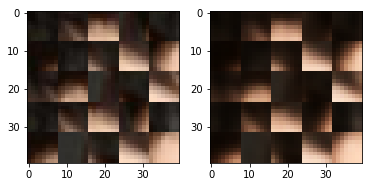

EPO: 47, recon_loss: 0.0004, total_loss: 0.0018
EPO: 47, recon_loss: 0.0005, total_loss: 0.0022
EPO: 47, recon_loss: 0.0010, total_loss: 0.0023
EPO: 47, recon_loss: 0.0006, total_loss: 0.0018
EPO: 47, recon_loss: 0.0019, total_loss: 0.0045
EPO: 47, recon_loss: 0.0018, total_loss: 0.0054
EPO: 47, recon_loss: 0.0027, total_loss: 0.0069
EPO: 47, recon_loss: 0.0042, total_loss: 0.0089
EPO: 47, recon_loss: 0.0019, total_loss: 0.0041
EPO: 47, recon_loss: 0.0047, total_loss: 0.0083
######### what? the reconstruction psnr is: 32.1068


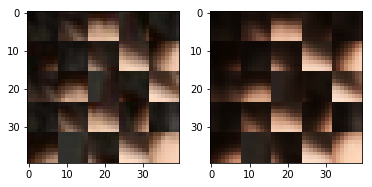

EPO: 47, recon_loss: 0.0045, total_loss: 0.0120
EPO: 47, recon_loss: 0.0061, total_loss: 0.0141
EPO: 47, recon_loss: 0.0045, total_loss: 0.0123
EPO: 47, recon_loss: 0.0035, total_loss: 0.0084
EPO: 47, recon_loss: 0.0046, total_loss: 0.0094
EPO: 47, recon_loss: 0.0029, total_loss: 0.0072
EPO: 47, recon_loss: 0.0023, total_loss: 0.0052
EPO: 47, recon_loss: 0.0038, total_loss: 0.0080
EPO: 47, recon_loss: 0.0024, total_loss: 0.0053
EPO: 47, recon_loss: 0.0032, total_loss: 0.0071
######### what? the reconstruction psnr is: 31.6201


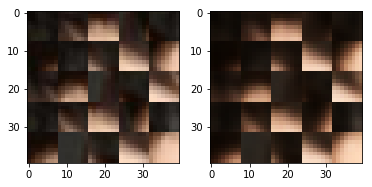

EPO: 47, recon_loss: 0.0023, total_loss: 0.0094
EPO: 47, recon_loss: 0.0013, total_loss: 0.0042
EPO: 47, recon_loss: 0.0042, total_loss: 0.0090
EPO: 47, recon_loss: 0.0030, total_loss: 0.0069
EPO: 47, recon_loss: 0.0038, total_loss: 0.0096
EPO: 47, recon_loss: 0.0011, total_loss: 0.0030
EPO: 47, recon_loss: 0.0010, total_loss: 0.0030
EPO: 47, recon_loss: 0.0018, total_loss: 0.0048
EPO: 47, recon_loss: 0.0007, total_loss: 0.0026
EPO: 47, recon_loss: 0.0011, total_loss: 0.0027
######### what? the reconstruction psnr is: 31.7695


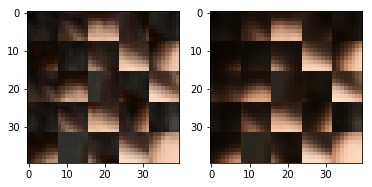

EPO: 47, recon_loss: 0.0023, total_loss: 0.0059
EPO: 47, recon_loss: 0.0015, total_loss: 0.0045
EPO: 47, recon_loss: 0.0060, total_loss: 0.0116
EPO: 47, recon_loss: 0.0030, total_loss: 0.0075
EPO: 47, recon_loss: 0.0020, total_loss: 0.0050
EPO: 47, recon_loss: 0.0019, total_loss: 0.0076
EPO: 47, recon_loss: 0.0021, total_loss: 0.0072
EPO: 47, recon_loss: 0.0087, total_loss: 0.0162
EPO: 47, recon_loss: 0.0027, total_loss: 0.0069
EPO: 47, recon_loss: 0.0061, total_loss: 0.0123
######### what? the reconstruction psnr is: 31.6386


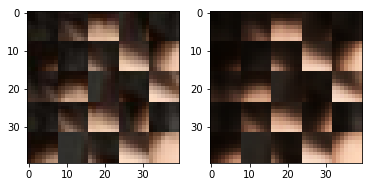

EPO: 47, recon_loss: 0.0009, total_loss: 0.0047
EPO: 47, recon_loss: 0.0004, total_loss: 0.0025
EPO: 47, recon_loss: 0.0052, total_loss: 0.0105
EPO: 47, recon_loss: 0.0032, total_loss: 0.0063
EPO: 47, recon_loss: 0.0033, total_loss: 0.0070
EPO: 47, recon_loss: 0.0039, total_loss: 0.0083
EPO: 47, recon_loss: 0.0046, total_loss: 0.0104
EPO: 47, recon_loss: 0.0044, total_loss: 0.0097
EPO: 47, recon_loss: 0.0022, total_loss: 0.0060
EPO: 47, recon_loss: 0.0015, total_loss: 0.0042
######### what? the reconstruction psnr is: 31.9934


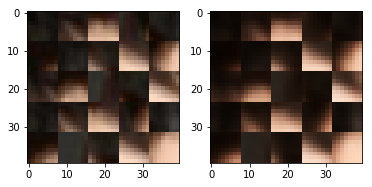

EPO: 47, recon_loss: 0.0021, total_loss: 0.0063
EPO: 47, recon_loss: 0.0008, total_loss: 0.0035
EPO: 47, recon_loss: 0.0055, total_loss: 0.0115
EPO: 47, recon_loss: 0.0015, total_loss: 0.0046
EPO: 47, recon_loss: 0.0020, total_loss: 0.0053
EPO: 47, recon_loss: 0.0039, total_loss: 0.0085
EPO: 47, recon_loss: 0.0026, total_loss: 0.0070
EPO: 47, recon_loss: 0.0028, total_loss: 0.0074
EPO: 47, recon_loss: 0.0044, total_loss: 0.0088
EPO: 47, recon_loss: 0.0037, total_loss: 0.0093
######### what? the reconstruction psnr is: 32.1757


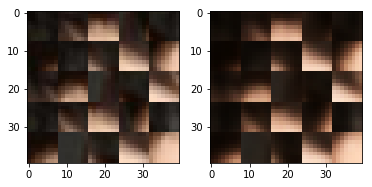

EPO: 47, recon_loss: 0.0043, total_loss: 0.0146
EPO: 47, recon_loss: 0.0023, total_loss: 0.0055
EPO: 47, recon_loss: 0.0017, total_loss: 0.0048
EPO: 47, recon_loss: 0.0020, total_loss: 0.0047
EPO: 47, recon_loss: 0.0035, total_loss: 0.0080
EPO: 47, recon_loss: 0.0033, total_loss: 0.0080
EPO: 47, recon_loss: 0.0018, total_loss: 0.0056
EPO: 47, recon_loss: 0.0041, total_loss: 0.0094
EPO: 47, recon_loss: 0.0062, total_loss: 0.0126
EPO: 47, recon_loss: 0.0030, total_loss: 0.0091
######### what? the reconstruction psnr is: 32.0744


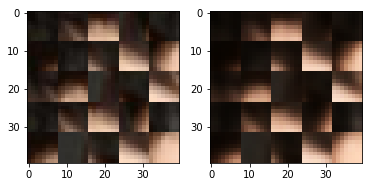

EPO: 47, recon_loss: 0.0067, total_loss: 0.0138
EPO: 47, recon_loss: 0.0015, total_loss: 0.0054
EPO: 47, recon_loss: 0.0018, total_loss: 0.0061
EPO: 47, recon_loss: 0.0041, total_loss: 0.0099
EPO: 47, recon_loss: 0.0025, total_loss: 0.0070
EPO: 47, recon_loss: 0.0051, total_loss: 0.0107
EPO: 47, recon_loss: 0.0015, total_loss: 0.0028
EPO: 47, recon_loss: 0.0013, total_loss: 0.0028
EPO: 47, recon_loss: 0.0036, total_loss: 0.0078
EPO: 47, recon_loss: 0.0013, total_loss: 0.0046
######### what? the reconstruction psnr is: 32.1685


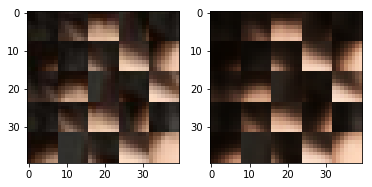

EPO: 47, recon_loss: 0.0024, total_loss: 0.0063
EPO: 47, recon_loss: 0.0090, total_loss: 0.0189
EPO: 47, recon_loss: 0.0048, total_loss: 0.0139
EPO: 47, recon_loss: 0.0118, total_loss: 0.0235
EPO: 47, recon_loss: 0.0053, total_loss: 0.0152
EPO: 47, recon_loss: 0.0078, total_loss: 0.0209
EPO: 47, recon_loss: 0.0017, total_loss: 0.0079
EPO: 47, recon_loss: 0.0030, total_loss: 0.0068
EPO: 47, recon_loss: 0.0038, total_loss: 0.0123
EPO: 47, recon_loss: 0.0026, total_loss: 0.0079
######### what? the reconstruction psnr is: 32.3199


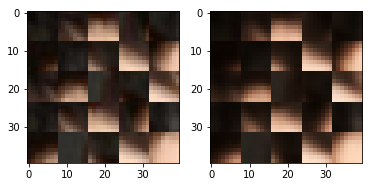

EPO: 47, recon_loss: 0.0028, total_loss: 0.0080
EPO: 47, recon_loss: 0.0031, total_loss: 0.0118
EPO: 47, recon_loss: 0.0031, total_loss: 0.0091
EPO: 47, recon_loss: 0.0082, total_loss: 0.0162
EPO: 47, recon_loss: 0.0018, total_loss: 0.0065
EPO: 47, recon_loss: 0.0019, total_loss: 0.0068
EPO: 47, recon_loss: 0.0028, total_loss: 0.0084
EPO: 47, recon_loss: 0.0011, total_loss: 0.0059
EPO: 47, recon_loss: 0.0076, total_loss: 0.0144
EPO: 47, recon_loss: 0.0016, total_loss: 0.0058
######### what? the reconstruction psnr is: 32.3777


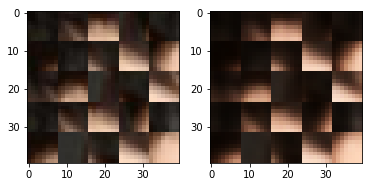

EPO: 47, recon_loss: 0.0027, total_loss: 0.0079
EPO: 47, recon_loss: 0.0023, total_loss: 0.0057
EPO: 47, recon_loss: 0.0021, total_loss: 0.0073
EPO: 47, recon_loss: 0.0085, total_loss: 0.0148
EPO: 47, recon_loss: 0.0027, total_loss: 0.0081
EPO: 47, recon_loss: 0.0028, total_loss: 0.0068
EPO: 47, recon_loss: 0.0027, total_loss: 0.0105
EPO: 47, recon_loss: 0.0011, total_loss: 0.0048
EPO: 47, recon_loss: 0.0063, total_loss: 0.0141
EPO: 47, recon_loss: 0.0016, total_loss: 0.0037
######### what? the reconstruction psnr is: 32.1944


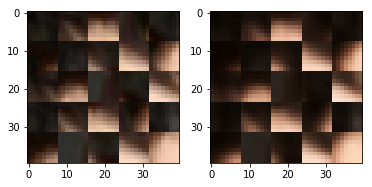

EPO: 47, recon_loss: 0.0034, total_loss: 0.0082
EPO: 47, recon_loss: 0.0021, total_loss: 0.0079
EPO: 47, recon_loss: 0.0013, total_loss: 0.0052
EPO: 47, recon_loss: 0.0027, total_loss: 0.0079
EPO: 47, recon_loss: 0.0010, total_loss: 0.0039
EPO: 47, recon_loss: 0.0023, total_loss: 0.0059
EPO: 47, recon_loss: 0.0080, total_loss: 0.0181
EPO: 47, recon_loss: 0.0063, total_loss: 0.0152
EPO: 47, recon_loss: 0.0031, total_loss: 0.0080
EPO: 47, recon_loss: 0.0033, total_loss: 0.0096
######### what? the reconstruction psnr is: 31.8705


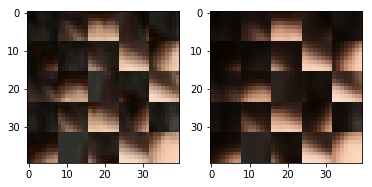

EPO: 47, recon_loss: 0.0032, total_loss: 0.0075
EPO: 47, recon_loss: 0.0056, total_loss: 0.0152
EPO: 47, recon_loss: 0.0029, total_loss: 0.0096
EPO: 47, recon_loss: 0.0045, total_loss: 0.0095
EPO: 47, recon_loss: 0.0032, total_loss: 0.0084
EPO: 47, recon_loss: 0.0038, total_loss: 0.0099
EPO: 47, recon_loss: 0.0019, total_loss: 0.0059
EPO: 47, recon_loss: 0.0006, total_loss: 0.0017
EPO: 47, recon_loss: 0.0016, total_loss: 0.0043
EPO: 47, recon_loss: 0.0017, total_loss: 0.0033
######### what? the reconstruction psnr is: 31.8774


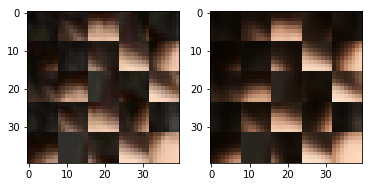

EPO: 47, recon_loss: 0.0012, total_loss: 0.0027
EPO: 47, recon_loss: 0.0030, total_loss: 0.0058
EPO: 47, recon_loss: 0.0025, total_loss: 0.0068
EPO: 47, recon_loss: 0.0030, total_loss: 0.0077
EPO: 47, recon_loss: 0.0025, total_loss: 0.0065
EPO: 47, recon_loss: 0.0021, total_loss: 0.0048
EPO: 47, recon_loss: 0.0032, total_loss: 0.0069
EPO: 47, recon_loss: 0.0030, total_loss: 0.0078
EPO: 47, recon_loss: 0.0040, total_loss: 0.0099
EPO: 47, recon_loss: 0.0052, total_loss: 0.0090
######### what? the reconstruction psnr is: 31.6162


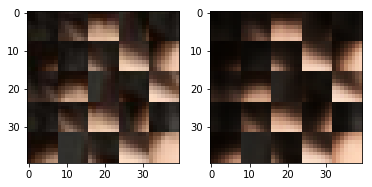

EPO: 47, recon_loss: 0.0038, total_loss: 0.0080
EPO: 47, recon_loss: 0.0070, total_loss: 0.0114
EPO: 47, recon_loss: 0.0085, total_loss: 0.0175
EPO: 47, recon_loss: 0.0058, total_loss: 0.0105
EPO: 47, recon_loss: 0.0056, total_loss: 0.0099
EPO: 47, recon_loss: 0.0040, total_loss: 0.0072
EPO: 47, recon_loss: 0.0093, total_loss: 0.0132
EPO: 47, recon_loss: 0.0009, total_loss: 0.0041
EPO: 47, recon_loss: 0.0015, total_loss: 0.0052
EPO: 47, recon_loss: 0.0043, total_loss: 0.0079
######### what? the reconstruction psnr is: 31.4901


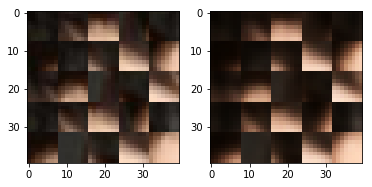

EPO: 47, recon_loss: 0.0030, total_loss: 0.0084
EPO: 47, recon_loss: 0.0064, total_loss: 0.0124
EPO: 47, recon_loss: 0.0021, total_loss: 0.0088
EPO: 47, recon_loss: 0.0016, total_loss: 0.0049
EPO: 47, recon_loss: 0.0035, total_loss: 0.0074
EPO: 47, recon_loss: 0.0007, total_loss: 0.0021
EPO: 47, recon_loss: 0.0018, total_loss: 0.0037
EPO: 47, recon_loss: 0.0041, total_loss: 0.0090
EPO: 47, recon_loss: 0.0048, total_loss: 0.0099
EPO: 47, recon_loss: 0.0111, total_loss: 0.0165
######### what? the reconstruction psnr is: 29.0893


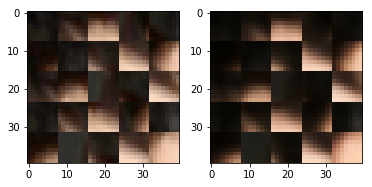

EPO: 47, recon_loss: 0.0097, total_loss: 0.0147
EPO: 47, recon_loss: 0.0082, total_loss: 0.0115
EPO: 48, recon_loss: 0.0021, total_loss: 0.0041
EPO: 48, recon_loss: 0.0014, total_loss: 0.0030
EPO: 48, recon_loss: 0.0062, total_loss: 0.0093
EPO: 48, recon_loss: 0.0012, total_loss: 0.0034
EPO: 48, recon_loss: 0.0030, total_loss: 0.0058
EPO: 48, recon_loss: 0.0021, total_loss: 0.0079
EPO: 48, recon_loss: 0.0015, total_loss: 0.0059
EPO: 48, recon_loss: 0.0036, total_loss: 0.0073
######### what? the reconstruction psnr is: 32.2120


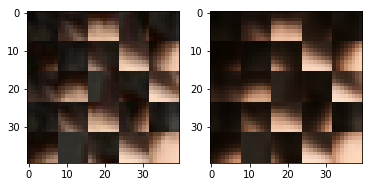

EPO: 48, recon_loss: 0.0019, total_loss: 0.0043
EPO: 48, recon_loss: 0.0040, total_loss: 0.0086
EPO: 48, recon_loss: 0.0017, total_loss: 0.0071
EPO: 48, recon_loss: 0.0008, total_loss: 0.0031
EPO: 48, recon_loss: 0.0023, total_loss: 0.0065
EPO: 48, recon_loss: 0.0013, total_loss: 0.0029
EPO: 48, recon_loss: 0.0027, total_loss: 0.0063
EPO: 48, recon_loss: 0.0024, total_loss: 0.0070
EPO: 48, recon_loss: 0.0022, total_loss: 0.0059
EPO: 48, recon_loss: 0.0028, total_loss: 0.0067
######### what? the reconstruction psnr is: 32.3486


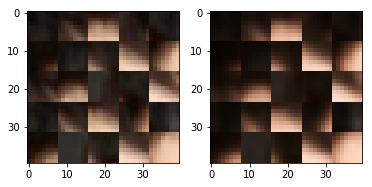

EPO: 48, recon_loss: 0.0021, total_loss: 0.0059
EPO: 48, recon_loss: 0.0018, total_loss: 0.0047
EPO: 48, recon_loss: 0.0028, total_loss: 0.0051
EPO: 48, recon_loss: 0.0015, total_loss: 0.0040
EPO: 48, recon_loss: 0.0038, total_loss: 0.0076
EPO: 48, recon_loss: 0.0022, total_loss: 0.0049
EPO: 48, recon_loss: 0.0025, total_loss: 0.0048
EPO: 48, recon_loss: 0.0060, total_loss: 0.0153
EPO: 48, recon_loss: 0.0023, total_loss: 0.0070
EPO: 48, recon_loss: 0.0032, total_loss: 0.0091
######### what? the reconstruction psnr is: 31.9795


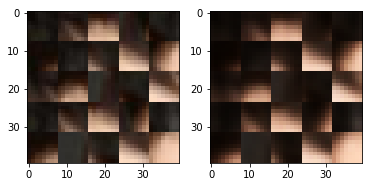

EPO: 48, recon_loss: 0.0055, total_loss: 0.0125
EPO: 48, recon_loss: 0.0032, total_loss: 0.0076
EPO: 48, recon_loss: 0.0024, total_loss: 0.0079
EPO: 48, recon_loss: 0.0016, total_loss: 0.0056
EPO: 48, recon_loss: 0.0025, total_loss: 0.0074
EPO: 48, recon_loss: 0.0022, total_loss: 0.0045
EPO: 48, recon_loss: 0.0026, total_loss: 0.0053
EPO: 48, recon_loss: 0.0010, total_loss: 0.0029
EPO: 48, recon_loss: 0.0013, total_loss: 0.0032
EPO: 48, recon_loss: 0.0015, total_loss: 0.0041
######### what? the reconstruction psnr is: 31.9008


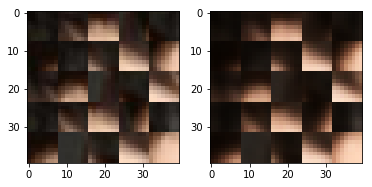

EPO: 48, recon_loss: 0.0039, total_loss: 0.0068
EPO: 48, recon_loss: 0.0028, total_loss: 0.0070
EPO: 48, recon_loss: 0.0042, total_loss: 0.0107
EPO: 48, recon_loss: 0.0012, total_loss: 0.0059
EPO: 48, recon_loss: 0.0014, total_loss: 0.0058
EPO: 48, recon_loss: 0.0029, total_loss: 0.0064
EPO: 48, recon_loss: 0.0011, total_loss: 0.0039
EPO: 48, recon_loss: 0.0043, total_loss: 0.0101
EPO: 48, recon_loss: 0.0054, total_loss: 0.0146
EPO: 48, recon_loss: 0.0025, total_loss: 0.0072
######### what? the reconstruction psnr is: 32.1810


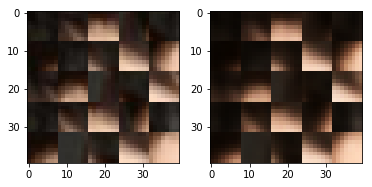

EPO: 48, recon_loss: 0.0047, total_loss: 0.0089
EPO: 48, recon_loss: 0.0017, total_loss: 0.0041
EPO: 48, recon_loss: 0.0036, total_loss: 0.0069
EPO: 48, recon_loss: 0.0029, total_loss: 0.0069
EPO: 48, recon_loss: 0.0023, total_loss: 0.0062
EPO: 48, recon_loss: 0.0045, total_loss: 0.0094
EPO: 48, recon_loss: 0.0034, total_loss: 0.0070
EPO: 48, recon_loss: 0.0058, total_loss: 0.0107
EPO: 48, recon_loss: 0.0066, total_loss: 0.0130
EPO: 48, recon_loss: 0.0077, total_loss: 0.0150
######### what? the reconstruction psnr is: 31.4079


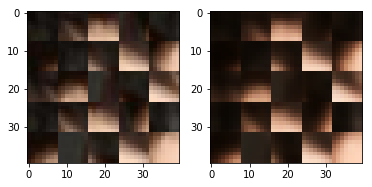

EPO: 48, recon_loss: 0.0155, total_loss: 0.0244
EPO: 48, recon_loss: 0.0076, total_loss: 0.0145
EPO: 48, recon_loss: 0.0070, total_loss: 0.0136
EPO: 48, recon_loss: 0.0030, total_loss: 0.0069
EPO: 48, recon_loss: 0.0027, total_loss: 0.0072
EPO: 48, recon_loss: 0.0039, total_loss: 0.0081
EPO: 48, recon_loss: 0.0041, total_loss: 0.0089
EPO: 48, recon_loss: 0.0054, total_loss: 0.0114
EPO: 48, recon_loss: 0.0019, total_loss: 0.0068
EPO: 48, recon_loss: 0.0017, total_loss: 0.0061
######### what? the reconstruction psnr is: 32.1527


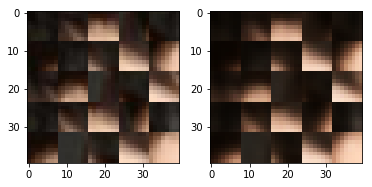

EPO: 48, recon_loss: 0.0062, total_loss: 0.0117
EPO: 48, recon_loss: 0.0019, total_loss: 0.0066
EPO: 48, recon_loss: 0.0026, total_loss: 0.0067
EPO: 48, recon_loss: 0.0057, total_loss: 0.0156
EPO: 48, recon_loss: 0.0041, total_loss: 0.0129
EPO: 48, recon_loss: 0.0123, total_loss: 0.0243
EPO: 48, recon_loss: 0.0040, total_loss: 0.0125
EPO: 48, recon_loss: 0.0047, total_loss: 0.0143
EPO: 48, recon_loss: 0.0076, total_loss: 0.0161
EPO: 48, recon_loss: 0.0042, total_loss: 0.0141
######### what? the reconstruction psnr is: 32.1527


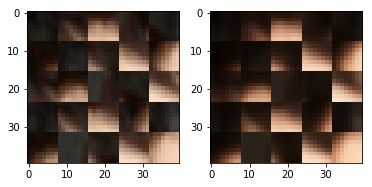

EPO: 48, recon_loss: 0.0115, total_loss: 0.0229
EPO: 48, recon_loss: 0.0060, total_loss: 0.0162
EPO: 48, recon_loss: 0.0063, total_loss: 0.0163
EPO: 48, recon_loss: 0.0021, total_loss: 0.0105
EPO: 48, recon_loss: 0.0022, total_loss: 0.0096
EPO: 48, recon_loss: 0.0143, total_loss: 0.0235
EPO: 48, recon_loss: 0.0142, total_loss: 0.0203
EPO: 48, recon_loss: 0.0019, total_loss: 0.0054
EPO: 48, recon_loss: 0.0020, total_loss: 0.0054
EPO: 48, recon_loss: 0.0018, total_loss: 0.0063
######### what? the reconstruction psnr is: 32.0453


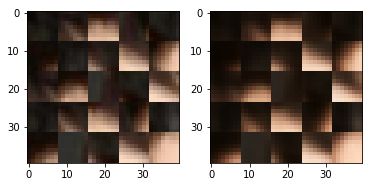

EPO: 48, recon_loss: 0.0048, total_loss: 0.0103
EPO: 48, recon_loss: 0.0029, total_loss: 0.0085
EPO: 48, recon_loss: 0.0035, total_loss: 0.0094
EPO: 48, recon_loss: 0.0015, total_loss: 0.0048
EPO: 48, recon_loss: 0.0004, total_loss: 0.0018
EPO: 48, recon_loss: 0.0006, total_loss: 0.0023
EPO: 48, recon_loss: 0.0007, total_loss: 0.0016
EPO: 48, recon_loss: 0.0007, total_loss: 0.0020
EPO: 48, recon_loss: 0.0039, total_loss: 0.0131
EPO: 48, recon_loss: 0.0019, total_loss: 0.0056
######### what? the reconstruction psnr is: 32.2970


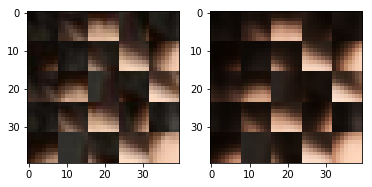

EPO: 48, recon_loss: 0.0031, total_loss: 0.0076
EPO: 48, recon_loss: 0.0031, total_loss: 0.0064
EPO: 48, recon_loss: 0.0025, total_loss: 0.0049
EPO: 48, recon_loss: 0.0057, total_loss: 0.0135
EPO: 48, recon_loss: 0.0043, total_loss: 0.0110
EPO: 48, recon_loss: 0.0058, total_loss: 0.0133
EPO: 48, recon_loss: 0.0044, total_loss: 0.0123
EPO: 48, recon_loss: 0.0027, total_loss: 0.0070
EPO: 48, recon_loss: 0.0034, total_loss: 0.0081
EPO: 48, recon_loss: 0.0025, total_loss: 0.0058
######### what? the reconstruction psnr is: 31.8202


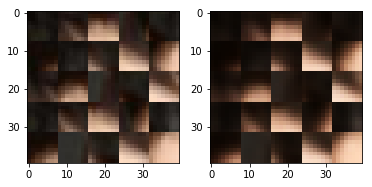

EPO: 48, recon_loss: 0.0026, total_loss: 0.0056
EPO: 48, recon_loss: 0.0028, total_loss: 0.0063
EPO: 48, recon_loss: 0.0022, total_loss: 0.0051
EPO: 48, recon_loss: 0.0031, total_loss: 0.0075
EPO: 48, recon_loss: 0.0020, total_loss: 0.0073
EPO: 48, recon_loss: 0.0019, total_loss: 0.0059
EPO: 48, recon_loss: 0.0047, total_loss: 0.0096
EPO: 48, recon_loss: 0.0044, total_loss: 0.0091
EPO: 48, recon_loss: 0.0030, total_loss: 0.0076
EPO: 48, recon_loss: 0.0009, total_loss: 0.0028
######### what? the reconstruction psnr is: 31.8471


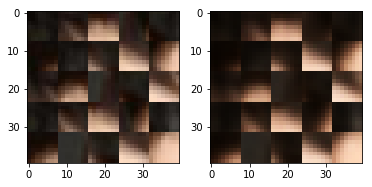

EPO: 48, recon_loss: 0.0013, total_loss: 0.0034
EPO: 48, recon_loss: 0.0018, total_loss: 0.0051
EPO: 48, recon_loss: 0.0010, total_loss: 0.0026
EPO: 48, recon_loss: 0.0016, total_loss: 0.0037
EPO: 48, recon_loss: 0.0019, total_loss: 0.0051
EPO: 48, recon_loss: 0.0023, total_loss: 0.0059
EPO: 48, recon_loss: 0.0050, total_loss: 0.0099
EPO: 48, recon_loss: 0.0028, total_loss: 0.0071
EPO: 48, recon_loss: 0.0020, total_loss: 0.0047
EPO: 48, recon_loss: 0.0016, total_loss: 0.0064
######### what? the reconstruction psnr is: 31.9027


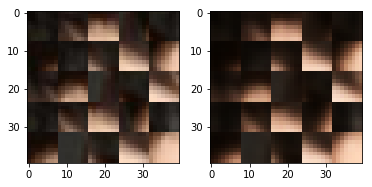

EPO: 48, recon_loss: 0.0020, total_loss: 0.0071
EPO: 48, recon_loss: 0.0086, total_loss: 0.0156
EPO: 48, recon_loss: 0.0023, total_loss: 0.0064
EPO: 48, recon_loss: 0.0085, total_loss: 0.0171
EPO: 48, recon_loss: 0.0007, total_loss: 0.0036
EPO: 48, recon_loss: 0.0005, total_loss: 0.0028
EPO: 48, recon_loss: 0.0072, total_loss: 0.0127
EPO: 48, recon_loss: 0.0025, total_loss: 0.0052
EPO: 48, recon_loss: 0.0030, total_loss: 0.0064
EPO: 48, recon_loss: 0.0036, total_loss: 0.0080
######### what? the reconstruction psnr is: 32.0944


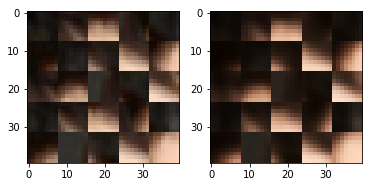

EPO: 48, recon_loss: 0.0041, total_loss: 0.0093
EPO: 48, recon_loss: 0.0056, total_loss: 0.0115
EPO: 48, recon_loss: 0.0016, total_loss: 0.0048
EPO: 48, recon_loss: 0.0026, total_loss: 0.0056
EPO: 48, recon_loss: 0.0014, total_loss: 0.0048
EPO: 48, recon_loss: 0.0010, total_loss: 0.0035
EPO: 48, recon_loss: 0.0048, total_loss: 0.0106
EPO: 48, recon_loss: 0.0010, total_loss: 0.0039
EPO: 48, recon_loss: 0.0018, total_loss: 0.0052
EPO: 48, recon_loss: 0.0039, total_loss: 0.0095
######### what? the reconstruction psnr is: 32.2857


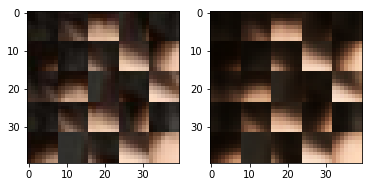

EPO: 48, recon_loss: 0.0023, total_loss: 0.0070
EPO: 48, recon_loss: 0.0040, total_loss: 0.0086
EPO: 48, recon_loss: 0.0029, total_loss: 0.0075
EPO: 48, recon_loss: 0.0038, total_loss: 0.0088
EPO: 48, recon_loss: 0.0053, total_loss: 0.0147
EPO: 48, recon_loss: 0.0013, total_loss: 0.0038
EPO: 48, recon_loss: 0.0027, total_loss: 0.0060
EPO: 48, recon_loss: 0.0021, total_loss: 0.0054
EPO: 48, recon_loss: 0.0027, total_loss: 0.0062
EPO: 48, recon_loss: 0.0026, total_loss: 0.0076
######### what? the reconstruction psnr is: 32.2255


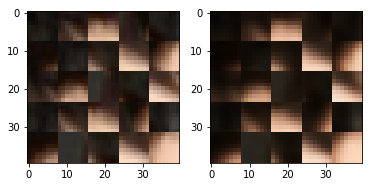

EPO: 48, recon_loss: 0.0017, total_loss: 0.0052
EPO: 48, recon_loss: 0.0046, total_loss: 0.0097
EPO: 48, recon_loss: 0.0050, total_loss: 0.0104
EPO: 48, recon_loss: 0.0037, total_loss: 0.0100
EPO: 48, recon_loss: 0.0042, total_loss: 0.0117
EPO: 48, recon_loss: 0.0017, total_loss: 0.0059
EPO: 48, recon_loss: 0.0019, total_loss: 0.0066
EPO: 48, recon_loss: 0.0035, total_loss: 0.0084
EPO: 48, recon_loss: 0.0029, total_loss: 0.0078
EPO: 48, recon_loss: 0.0022, total_loss: 0.0046
######### what? the reconstruction psnr is: 32.2287


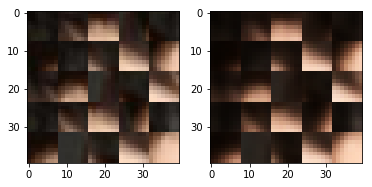

EPO: 48, recon_loss: 0.0014, total_loss: 0.0029
EPO: 48, recon_loss: 0.0011, total_loss: 0.0026
EPO: 48, recon_loss: 0.0023, total_loss: 0.0058
EPO: 48, recon_loss: 0.0016, total_loss: 0.0051
EPO: 48, recon_loss: 0.0030, total_loss: 0.0071
EPO: 48, recon_loss: 0.0072, total_loss: 0.0172
EPO: 48, recon_loss: 0.0044, total_loss: 0.0123
EPO: 48, recon_loss: 0.0092, total_loss: 0.0202
EPO: 48, recon_loss: 0.0061, total_loss: 0.0177
EPO: 48, recon_loss: 0.0073, total_loss: 0.0200
######### what? the reconstruction psnr is: 31.8424


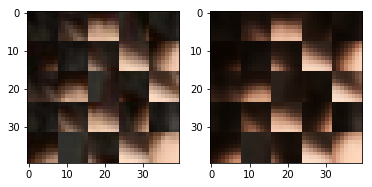

EPO: 48, recon_loss: 0.0016, total_loss: 0.0066
EPO: 48, recon_loss: 0.0057, total_loss: 0.0115
EPO: 48, recon_loss: 0.0032, total_loss: 0.0109
EPO: 48, recon_loss: 0.0026, total_loss: 0.0080
EPO: 48, recon_loss: 0.0031, total_loss: 0.0092
EPO: 48, recon_loss: 0.0032, total_loss: 0.0108
EPO: 48, recon_loss: 0.0039, total_loss: 0.0103
EPO: 48, recon_loss: 0.0063, total_loss: 0.0138
EPO: 48, recon_loss: 0.0025, total_loss: 0.0077
EPO: 48, recon_loss: 0.0029, total_loss: 0.0080
######### what? the reconstruction psnr is: 32.3397


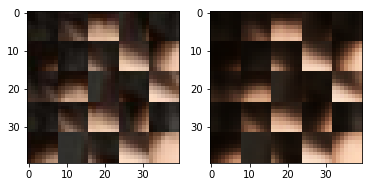

EPO: 48, recon_loss: 0.0022, total_loss: 0.0066
EPO: 48, recon_loss: 0.0015, total_loss: 0.0064
EPO: 48, recon_loss: 0.0064, total_loss: 0.0123
EPO: 48, recon_loss: 0.0017, total_loss: 0.0060
EPO: 48, recon_loss: 0.0026, total_loss: 0.0080
EPO: 48, recon_loss: 0.0019, total_loss: 0.0055
EPO: 48, recon_loss: 0.0025, total_loss: 0.0082
EPO: 48, recon_loss: 0.0079, total_loss: 0.0134
EPO: 48, recon_loss: 0.0029, total_loss: 0.0085
EPO: 48, recon_loss: 0.0042, total_loss: 0.0087
######### what? the reconstruction psnr is: 32.3549


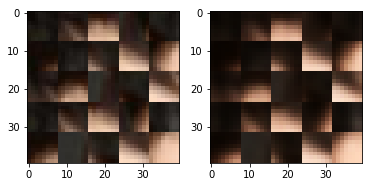

EPO: 48, recon_loss: 0.0016, total_loss: 0.0068
EPO: 48, recon_loss: 0.0014, total_loss: 0.0054
EPO: 48, recon_loss: 0.0059, total_loss: 0.0121
EPO: 48, recon_loss: 0.0018, total_loss: 0.0041
EPO: 48, recon_loss: 0.0040, total_loss: 0.0088
EPO: 48, recon_loss: 0.0017, total_loss: 0.0069
EPO: 48, recon_loss: 0.0011, total_loss: 0.0047
EPO: 48, recon_loss: 0.0024, total_loss: 0.0066
EPO: 48, recon_loss: 0.0012, total_loss: 0.0043
EPO: 48, recon_loss: 0.0021, total_loss: 0.0054
######### what? the reconstruction psnr is: 32.3592


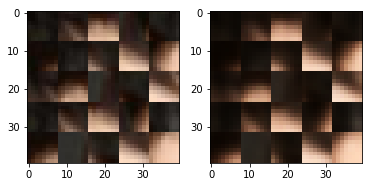

EPO: 48, recon_loss: 0.0068, total_loss: 0.0166
EPO: 48, recon_loss: 0.0059, total_loss: 0.0142
EPO: 48, recon_loss: 0.0033, total_loss: 0.0077
EPO: 48, recon_loss: 0.0032, total_loss: 0.0092
EPO: 48, recon_loss: 0.0026, total_loss: 0.0063
EPO: 48, recon_loss: 0.0051, total_loss: 0.0147
EPO: 48, recon_loss: 0.0037, total_loss: 0.0096
EPO: 48, recon_loss: 0.0048, total_loss: 0.0103
EPO: 48, recon_loss: 0.0024, total_loss: 0.0080
EPO: 48, recon_loss: 0.0033, total_loss: 0.0084
######### what? the reconstruction psnr is: 32.0028


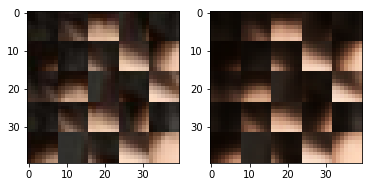

EPO: 48, recon_loss: 0.0018, total_loss: 0.0053
EPO: 48, recon_loss: 0.0005, total_loss: 0.0015
EPO: 48, recon_loss: 0.0023, total_loss: 0.0054
EPO: 48, recon_loss: 0.0011, total_loss: 0.0025
EPO: 48, recon_loss: 0.0012, total_loss: 0.0028
EPO: 48, recon_loss: 0.0025, total_loss: 0.0054
EPO: 48, recon_loss: 0.0022, total_loss: 0.0061
EPO: 48, recon_loss: 0.0035, total_loss: 0.0087
EPO: 48, recon_loss: 0.0022, total_loss: 0.0056
EPO: 48, recon_loss: 0.0024, total_loss: 0.0050
######### what? the reconstruction psnr is: 31.8062


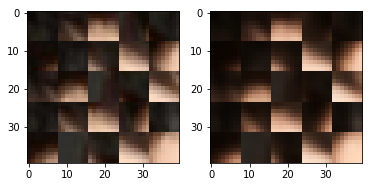

EPO: 48, recon_loss: 0.0046, total_loss: 0.0130
EPO: 48, recon_loss: 0.0038, total_loss: 0.0098
EPO: 48, recon_loss: 0.0039, total_loss: 0.0082
EPO: 48, recon_loss: 0.0045, total_loss: 0.0082
EPO: 48, recon_loss: 0.0037, total_loss: 0.0077
EPO: 48, recon_loss: 0.0093, total_loss: 0.0166
EPO: 48, recon_loss: 0.0108, total_loss: 0.0217
EPO: 48, recon_loss: 0.0039, total_loss: 0.0083
EPO: 48, recon_loss: 0.0042, total_loss: 0.0081
EPO: 48, recon_loss: 0.0045, total_loss: 0.0078
######### what? the reconstruction psnr is: 29.7926


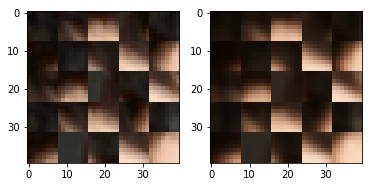

EPO: 48, recon_loss: 0.0105, total_loss: 0.0161
EPO: 48, recon_loss: 0.0008, total_loss: 0.0040
EPO: 48, recon_loss: 0.0018, total_loss: 0.0059
EPO: 48, recon_loss: 0.0043, total_loss: 0.0083
EPO: 48, recon_loss: 0.0033, total_loss: 0.0086
EPO: 48, recon_loss: 0.0076, total_loss: 0.0141
EPO: 48, recon_loss: 0.0013, total_loss: 0.0058
EPO: 48, recon_loss: 0.0018, total_loss: 0.0052
EPO: 48, recon_loss: 0.0041, total_loss: 0.0081
EPO: 48, recon_loss: 0.0010, total_loss: 0.0028
######### what? the reconstruction psnr is: 31.8568


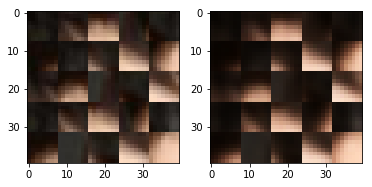

EPO: 48, recon_loss: 0.0022, total_loss: 0.0040
EPO: 48, recon_loss: 0.0037, total_loss: 0.0087
EPO: 48, recon_loss: 0.0062, total_loss: 0.0109
EPO: 48, recon_loss: 0.0092, total_loss: 0.0146
EPO: 48, recon_loss: 0.0113, total_loss: 0.0160
EPO: 48, recon_loss: 0.0092, total_loss: 0.0134
EPO: 49, recon_loss: 0.0019, total_loss: 0.0038
EPO: 49, recon_loss: 0.0013, total_loss: 0.0030
EPO: 49, recon_loss: 0.0065, total_loss: 0.0106
EPO: 49, recon_loss: 0.0017, total_loss: 0.0039
######### what? the reconstruction psnr is: 32.0490


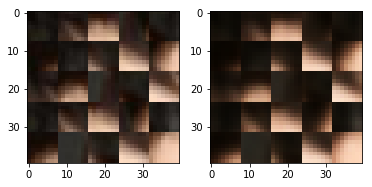

EPO: 49, recon_loss: 0.0033, total_loss: 0.0063
EPO: 49, recon_loss: 0.0020, total_loss: 0.0075
EPO: 49, recon_loss: 0.0020, total_loss: 0.0059
EPO: 49, recon_loss: 0.0036, total_loss: 0.0069
EPO: 49, recon_loss: 0.0025, total_loss: 0.0051
EPO: 49, recon_loss: 0.0042, total_loss: 0.0099
EPO: 49, recon_loss: 0.0015, total_loss: 0.0065
EPO: 49, recon_loss: 0.0008, total_loss: 0.0028
EPO: 49, recon_loss: 0.0025, total_loss: 0.0064
EPO: 49, recon_loss: 0.0016, total_loss: 0.0031
######### what? the reconstruction psnr is: 32.3179


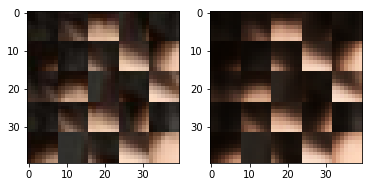

EPO: 49, recon_loss: 0.0034, total_loss: 0.0079
EPO: 49, recon_loss: 0.0022, total_loss: 0.0061
EPO: 49, recon_loss: 0.0022, total_loss: 0.0058
EPO: 49, recon_loss: 0.0029, total_loss: 0.0063
EPO: 49, recon_loss: 0.0021, total_loss: 0.0062
EPO: 49, recon_loss: 0.0022, total_loss: 0.0055
EPO: 49, recon_loss: 0.0023, total_loss: 0.0044
EPO: 49, recon_loss: 0.0015, total_loss: 0.0042
EPO: 49, recon_loss: 0.0047, total_loss: 0.0081
EPO: 49, recon_loss: 0.0018, total_loss: 0.0039
######### what? the reconstruction psnr is: 32.2324


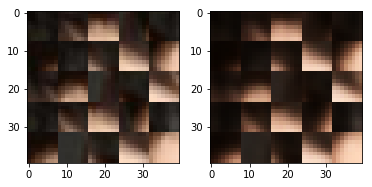

EPO: 49, recon_loss: 0.0024, total_loss: 0.0046
EPO: 49, recon_loss: 0.0048, total_loss: 0.0117
EPO: 49, recon_loss: 0.0018, total_loss: 0.0063
EPO: 49, recon_loss: 0.0044, total_loss: 0.0112
EPO: 49, recon_loss: 0.0049, total_loss: 0.0105
EPO: 49, recon_loss: 0.0040, total_loss: 0.0086
EPO: 49, recon_loss: 0.0031, total_loss: 0.0104
EPO: 49, recon_loss: 0.0013, total_loss: 0.0053
EPO: 49, recon_loss: 0.0036, total_loss: 0.0079
EPO: 49, recon_loss: 0.0018, total_loss: 0.0035
######### what? the reconstruction psnr is: 31.8032


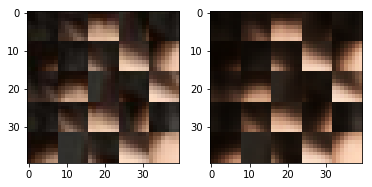

EPO: 49, recon_loss: 0.0015, total_loss: 0.0037
EPO: 49, recon_loss: 0.0011, total_loss: 0.0028
EPO: 49, recon_loss: 0.0011, total_loss: 0.0029
EPO: 49, recon_loss: 0.0020, total_loss: 0.0053
EPO: 49, recon_loss: 0.0023, total_loss: 0.0047
EPO: 49, recon_loss: 0.0034, total_loss: 0.0085
EPO: 49, recon_loss: 0.0011, total_loss: 0.0067
EPO: 49, recon_loss: 0.0011, total_loss: 0.0055
EPO: 49, recon_loss: 0.0016, total_loss: 0.0057
EPO: 49, recon_loss: 0.0022, total_loss: 0.0049
######### what? the reconstruction psnr is: 31.9473


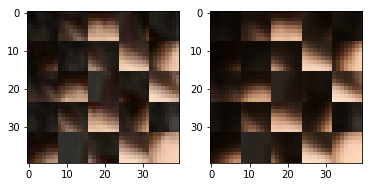

EPO: 49, recon_loss: 0.0019, total_loss: 0.0056
EPO: 49, recon_loss: 0.0040, total_loss: 0.0114
EPO: 49, recon_loss: 0.0024, total_loss: 0.0073
EPO: 49, recon_loss: 0.0036, total_loss: 0.0092
EPO: 49, recon_loss: 0.0033, total_loss: 0.0066
EPO: 49, recon_loss: 0.0022, total_loss: 0.0049
EPO: 49, recon_loss: 0.0055, total_loss: 0.0102
EPO: 49, recon_loss: 0.0025, total_loss: 0.0056
EPO: 49, recon_loss: 0.0029, total_loss: 0.0077
EPO: 49, recon_loss: 0.0040, total_loss: 0.0082
######### what? the reconstruction psnr is: 32.1620


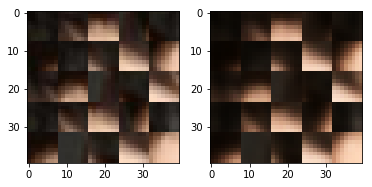

EPO: 49, recon_loss: 0.0030, total_loss: 0.0070
EPO: 49, recon_loss: 0.0094, total_loss: 0.0142
EPO: 49, recon_loss: 0.0068, total_loss: 0.0133
EPO: 49, recon_loss: 0.0083, total_loss: 0.0160
EPO: 49, recon_loss: 0.0136, total_loss: 0.0219
EPO: 49, recon_loss: 0.0076, total_loss: 0.0144
EPO: 49, recon_loss: 0.0077, total_loss: 0.0142
EPO: 49, recon_loss: 0.0028, total_loss: 0.0066
EPO: 49, recon_loss: 0.0033, total_loss: 0.0074
EPO: 49, recon_loss: 0.0048, total_loss: 0.0092
######### what? the reconstruction psnr is: 32.1458


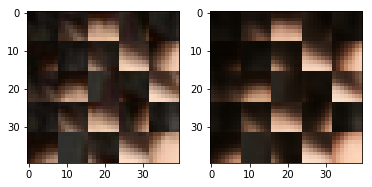

EPO: 49, recon_loss: 0.0052, total_loss: 0.0115
EPO: 49, recon_loss: 0.0051, total_loss: 0.0108
EPO: 49, recon_loss: 0.0019, total_loss: 0.0069
EPO: 49, recon_loss: 0.0028, total_loss: 0.0082
EPO: 49, recon_loss: 0.0055, total_loss: 0.0111
EPO: 49, recon_loss: 0.0020, total_loss: 0.0068
EPO: 49, recon_loss: 0.0029, total_loss: 0.0073
EPO: 49, recon_loss: 0.0046, total_loss: 0.0131
EPO: 49, recon_loss: 0.0047, total_loss: 0.0131
EPO: 49, recon_loss: 0.0123, total_loss: 0.0239
######### what? the reconstruction psnr is: 32.2607


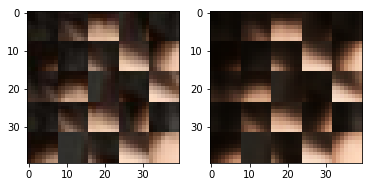

EPO: 49, recon_loss: 0.0042, total_loss: 0.0139
EPO: 49, recon_loss: 0.0056, total_loss: 0.0141
EPO: 49, recon_loss: 0.0060, total_loss: 0.0143
EPO: 49, recon_loss: 0.0040, total_loss: 0.0134
EPO: 49, recon_loss: 0.0138, total_loss: 0.0255
EPO: 49, recon_loss: 0.0062, total_loss: 0.0165
EPO: 49, recon_loss: 0.0066, total_loss: 0.0165
EPO: 49, recon_loss: 0.0012, total_loss: 0.0086
EPO: 49, recon_loss: 0.0043, total_loss: 0.0140
EPO: 49, recon_loss: 0.0156, total_loss: 0.0251
######### what? the reconstruction psnr is: 31.9221


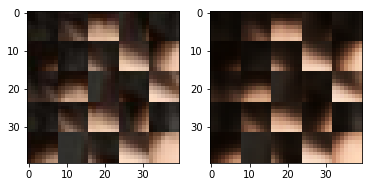

EPO: 49, recon_loss: 0.0109, total_loss: 0.0168
EPO: 49, recon_loss: 0.0022, total_loss: 0.0050
EPO: 49, recon_loss: 0.0015, total_loss: 0.0049
EPO: 49, recon_loss: 0.0021, total_loss: 0.0067
EPO: 49, recon_loss: 0.0049, total_loss: 0.0106
EPO: 49, recon_loss: 0.0027, total_loss: 0.0082
EPO: 49, recon_loss: 0.0042, total_loss: 0.0101
EPO: 49, recon_loss: 0.0008, total_loss: 0.0030
EPO: 49, recon_loss: 0.0004, total_loss: 0.0018
EPO: 49, recon_loss: 0.0008, total_loss: 0.0025
######### what? the reconstruction psnr is: 32.1445


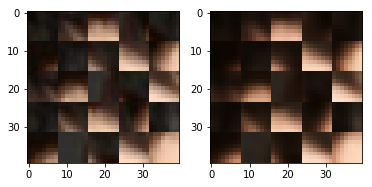

EPO: 49, recon_loss: 0.0006, total_loss: 0.0014
EPO: 49, recon_loss: 0.0007, total_loss: 0.0021
EPO: 49, recon_loss: 0.0037, total_loss: 0.0118
EPO: 49, recon_loss: 0.0015, total_loss: 0.0050
EPO: 49, recon_loss: 0.0030, total_loss: 0.0073
EPO: 49, recon_loss: 0.0018, total_loss: 0.0042
EPO: 49, recon_loss: 0.0023, total_loss: 0.0043
EPO: 49, recon_loss: 0.0051, total_loss: 0.0139
EPO: 49, recon_loss: 0.0041, total_loss: 0.0104
EPO: 49, recon_loss: 0.0050, total_loss: 0.0116
######### what? the reconstruction psnr is: 32.0242


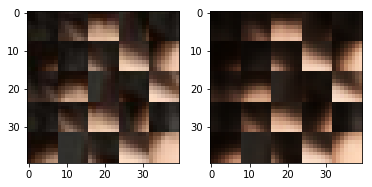

EPO: 49, recon_loss: 0.0047, total_loss: 0.0121
EPO: 49, recon_loss: 0.0031, total_loss: 0.0074
EPO: 49, recon_loss: 0.0035, total_loss: 0.0081
EPO: 49, recon_loss: 0.0025, total_loss: 0.0055
EPO: 49, recon_loss: 0.0024, total_loss: 0.0055
EPO: 49, recon_loss: 0.0021, total_loss: 0.0050
EPO: 49, recon_loss: 0.0026, total_loss: 0.0061
EPO: 49, recon_loss: 0.0019, total_loss: 0.0088
EPO: 49, recon_loss: 0.0012, total_loss: 0.0050
EPO: 49, recon_loss: 0.0027, total_loss: 0.0077
######### what? the reconstruction psnr is: 31.8919


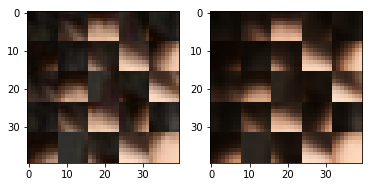

EPO: 49, recon_loss: 0.0038, total_loss: 0.0084
EPO: 49, recon_loss: 0.0027, total_loss: 0.0062
EPO: 49, recon_loss: 0.0022, total_loss: 0.0056
EPO: 49, recon_loss: 0.0008, total_loss: 0.0027
EPO: 49, recon_loss: 0.0014, total_loss: 0.0035
EPO: 49, recon_loss: 0.0018, total_loss: 0.0048
EPO: 49, recon_loss: 0.0012, total_loss: 0.0029
EPO: 49, recon_loss: 0.0020, total_loss: 0.0044
EPO: 49, recon_loss: 0.0016, total_loss: 0.0043
EPO: 49, recon_loss: 0.0024, total_loss: 0.0061
######### what? the reconstruction psnr is: 32.1936


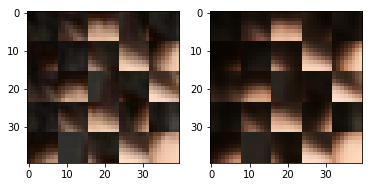

EPO: 49, recon_loss: 0.0040, total_loss: 0.0085
EPO: 49, recon_loss: 0.0031, total_loss: 0.0070
EPO: 49, recon_loss: 0.0018, total_loss: 0.0046
EPO: 49, recon_loss: 0.0020, total_loss: 0.0080
EPO: 49, recon_loss: 0.0042, total_loss: 0.0103
EPO: 49, recon_loss: 0.0089, total_loss: 0.0158
EPO: 49, recon_loss: 0.0025, total_loss: 0.0068
EPO: 49, recon_loss: 0.0093, total_loss: 0.0170
EPO: 49, recon_loss: 0.0006, total_loss: 0.0029
EPO: 49, recon_loss: 0.0010, total_loss: 0.0038
######### what? the reconstruction psnr is: 31.4710


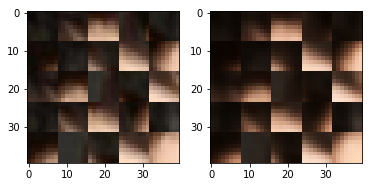

EPO: 49, recon_loss: 0.0072, total_loss: 0.0124
EPO: 49, recon_loss: 0.0019, total_loss: 0.0049
EPO: 49, recon_loss: 0.0029, total_loss: 0.0063
EPO: 49, recon_loss: 0.0032, total_loss: 0.0072
EPO: 49, recon_loss: 0.0036, total_loss: 0.0088
EPO: 49, recon_loss: 0.0064, total_loss: 0.0116
EPO: 49, recon_loss: 0.0016, total_loss: 0.0050
EPO: 49, recon_loss: 0.0037, total_loss: 0.0075
EPO: 49, recon_loss: 0.0013, total_loss: 0.0044
EPO: 49, recon_loss: 0.0027, total_loss: 0.0061
######### what? the reconstruction psnr is: 32.0497


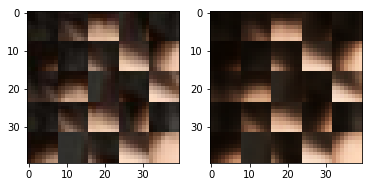

EPO: 49, recon_loss: 0.0056, total_loss: 0.0117
EPO: 49, recon_loss: 0.0013, total_loss: 0.0044
EPO: 49, recon_loss: 0.0022, total_loss: 0.0059
EPO: 49, recon_loss: 0.0032, total_loss: 0.0083
EPO: 49, recon_loss: 0.0021, total_loss: 0.0067
EPO: 49, recon_loss: 0.0057, total_loss: 0.0104
EPO: 49, recon_loss: 0.0029, total_loss: 0.0078
EPO: 49, recon_loss: 0.0044, total_loss: 0.0092
EPO: 49, recon_loss: 0.0054, total_loss: 0.0137
EPO: 49, recon_loss: 0.0008, total_loss: 0.0031
######### what? the reconstruction psnr is: 32.3017


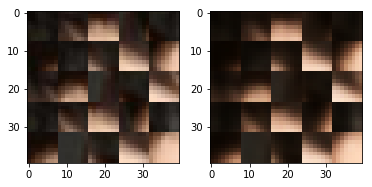

EPO: 49, recon_loss: 0.0037, total_loss: 0.0072
EPO: 49, recon_loss: 0.0017, total_loss: 0.0048
EPO: 49, recon_loss: 0.0028, total_loss: 0.0061
EPO: 49, recon_loss: 0.0027, total_loss: 0.0078
EPO: 49, recon_loss: 0.0018, total_loss: 0.0053
EPO: 49, recon_loss: 0.0060, total_loss: 0.0118
EPO: 49, recon_loss: 0.0024, total_loss: 0.0068
EPO: 49, recon_loss: 0.0045, total_loss: 0.0101
EPO: 49, recon_loss: 0.0033, total_loss: 0.0099
EPO: 49, recon_loss: 0.0013, total_loss: 0.0054
######### what? the reconstruction psnr is: 32.3841


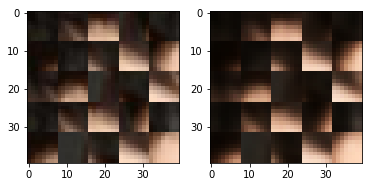

EPO: 49, recon_loss: 0.0031, total_loss: 0.0087
EPO: 49, recon_loss: 0.0016, total_loss: 0.0053
EPO: 49, recon_loss: 0.0029, total_loss: 0.0072
EPO: 49, recon_loss: 0.0018, total_loss: 0.0032
EPO: 49, recon_loss: 0.0011, total_loss: 0.0024
EPO: 49, recon_loss: 0.0014, total_loss: 0.0033
EPO: 49, recon_loss: 0.0016, total_loss: 0.0044
EPO: 49, recon_loss: 0.0020, total_loss: 0.0055
EPO: 49, recon_loss: 0.0078, total_loss: 0.0178
EPO: 49, recon_loss: 0.0066, total_loss: 0.0154
######### what? the reconstruction psnr is: 32.1590


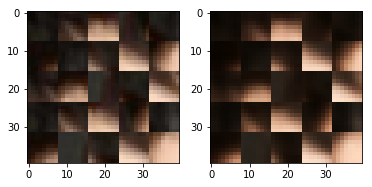

EPO: 49, recon_loss: 0.0056, total_loss: 0.0147
EPO: 49, recon_loss: 0.0065, total_loss: 0.0172
EPO: 49, recon_loss: 0.0057, total_loss: 0.0171
EPO: 49, recon_loss: 0.0015, total_loss: 0.0066
EPO: 49, recon_loss: 0.0020, total_loss: 0.0063
EPO: 49, recon_loss: 0.0068, total_loss: 0.0154
EPO: 49, recon_loss: 0.0028, total_loss: 0.0097
EPO: 49, recon_loss: 0.0029, total_loss: 0.0084
EPO: 49, recon_loss: 0.0028, total_loss: 0.0082
EPO: 49, recon_loss: 0.0029, total_loss: 0.0100
######### what? the reconstruction psnr is: 32.5192


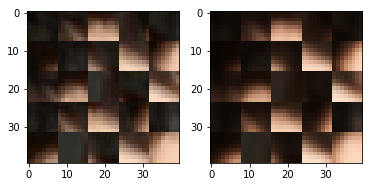

EPO: 49, recon_loss: 0.0038, total_loss: 0.0107
EPO: 49, recon_loss: 0.0050, total_loss: 0.0119
EPO: 49, recon_loss: 0.0029, total_loss: 0.0074
EPO: 49, recon_loss: 0.0027, total_loss: 0.0075
EPO: 49, recon_loss: 0.0017, total_loss: 0.0060
EPO: 49, recon_loss: 0.0032, total_loss: 0.0092
EPO: 49, recon_loss: 0.0058, total_loss: 0.0111
EPO: 49, recon_loss: 0.0016, total_loss: 0.0057
EPO: 49, recon_loss: 0.0028, total_loss: 0.0081
EPO: 49, recon_loss: 0.0016, total_loss: 0.0054
######### what? the reconstruction psnr is: 32.2080


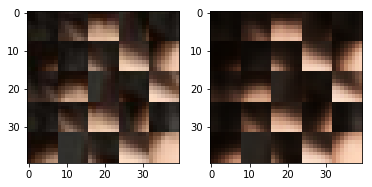

EPO: 49, recon_loss: 0.0029, total_loss: 0.0084
EPO: 49, recon_loss: 0.0071, total_loss: 0.0126
EPO: 49, recon_loss: 0.0031, total_loss: 0.0089
EPO: 49, recon_loss: 0.0055, total_loss: 0.0107
EPO: 49, recon_loss: 0.0011, total_loss: 0.0055
EPO: 49, recon_loss: 0.0020, total_loss: 0.0058
EPO: 49, recon_loss: 0.0046, total_loss: 0.0092
EPO: 49, recon_loss: 0.0021, total_loss: 0.0049
EPO: 49, recon_loss: 0.0035, total_loss: 0.0091
EPO: 49, recon_loss: 0.0014, total_loss: 0.0052
######### what? the reconstruction psnr is: 32.4502


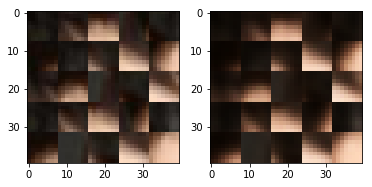

EPO: 49, recon_loss: 0.0012, total_loss: 0.0050
EPO: 49, recon_loss: 0.0022, total_loss: 0.0061
EPO: 49, recon_loss: 0.0014, total_loss: 0.0043
EPO: 49, recon_loss: 0.0018, total_loss: 0.0053
EPO: 49, recon_loss: 0.0062, total_loss: 0.0145
EPO: 49, recon_loss: 0.0047, total_loss: 0.0126
EPO: 49, recon_loss: 0.0033, total_loss: 0.0076
EPO: 49, recon_loss: 0.0037, total_loss: 0.0099
EPO: 49, recon_loss: 0.0024, total_loss: 0.0061
EPO: 49, recon_loss: 0.0049, total_loss: 0.0142
######### what? the reconstruction psnr is: 32.1202


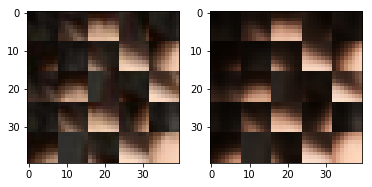

EPO: 49, recon_loss: 0.0060, total_loss: 0.0112
EPO: 49, recon_loss: 0.0047, total_loss: 0.0106
EPO: 49, recon_loss: 0.0017, total_loss: 0.0061
EPO: 49, recon_loss: 0.0040, total_loss: 0.0089
EPO: 49, recon_loss: 0.0011, total_loss: 0.0030
EPO: 49, recon_loss: 0.0005, total_loss: 0.0015
EPO: 49, recon_loss: 0.0028, total_loss: 0.0058
EPO: 49, recon_loss: 0.0011, total_loss: 0.0026
EPO: 49, recon_loss: 0.0014, total_loss: 0.0032
EPO: 49, recon_loss: 0.0029, total_loss: 0.0065
######### what? the reconstruction psnr is: 31.7886


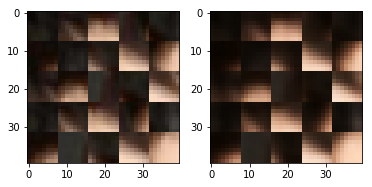

EPO: 49, recon_loss: 0.0019, total_loss: 0.0055
EPO: 49, recon_loss: 0.0036, total_loss: 0.0083
EPO: 49, recon_loss: 0.0015, total_loss: 0.0043
EPO: 49, recon_loss: 0.0015, total_loss: 0.0036
EPO: 49, recon_loss: 0.0044, total_loss: 0.0127
EPO: 49, recon_loss: 0.0029, total_loss: 0.0076
EPO: 49, recon_loss: 0.0048, total_loss: 0.0092
EPO: 49, recon_loss: 0.0031, total_loss: 0.0064
EPO: 49, recon_loss: 0.0043, total_loss: 0.0085
EPO: 49, recon_loss: 0.0076, total_loss: 0.0150
######### what? the reconstruction psnr is: 31.7532


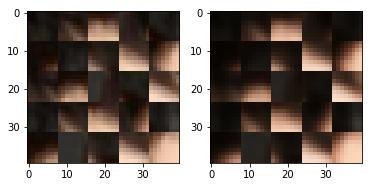

EPO: 49, recon_loss: 0.0117, total_loss: 0.0237
EPO: 49, recon_loss: 0.0032, total_loss: 0.0070
EPO: 49, recon_loss: 0.0033, total_loss: 0.0062
EPO: 49, recon_loss: 0.0053, total_loss: 0.0093
EPO: 49, recon_loss: 0.0023, total_loss: 0.0058
EPO: 49, recon_loss: 0.0008, total_loss: 0.0044
EPO: 49, recon_loss: 0.0020, total_loss: 0.0056
EPO: 49, recon_loss: 0.0025, total_loss: 0.0066
EPO: 49, recon_loss: 0.0026, total_loss: 0.0062
EPO: 49, recon_loss: 0.0021, total_loss: 0.0115
######### what? the reconstruction psnr is: 32.0964


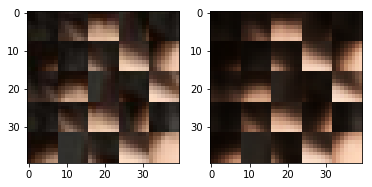

EPO: 49, recon_loss: 0.0010, total_loss: 0.0047
EPO: 49, recon_loss: 0.0022, total_loss: 0.0058
EPO: 49, recon_loss: 0.0025, total_loss: 0.0059
EPO: 49, recon_loss: 0.0008, total_loss: 0.0020
EPO: 49, recon_loss: 0.0028, total_loss: 0.0062
EPO: 49, recon_loss: 0.0035, total_loss: 0.0086
EPO: 49, recon_loss: 0.0080, total_loss: 0.0122
EPO: 49, recon_loss: 0.0073, total_loss: 0.0130
EPO: 49, recon_loss: 0.0099, total_loss: 0.0150
EPO: 49, recon_loss: 0.0071, total_loss: 0.0107
######### what? the reconstruction psnr is: 30.7937


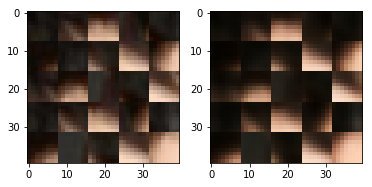

EPO: 50, recon_loss: 0.0015, total_loss: 0.0031
EPO: 50, recon_loss: 0.0018, total_loss: 0.0037
EPO: 50, recon_loss: 0.0042, total_loss: 0.0078
EPO: 50, recon_loss: 0.0019, total_loss: 0.0041
EPO: 50, recon_loss: 0.0036, total_loss: 0.0068
EPO: 50, recon_loss: 0.0014, total_loss: 0.0054
EPO: 50, recon_loss: 0.0020, total_loss: 0.0057
EPO: 50, recon_loss: 0.0044, total_loss: 0.0078
EPO: 50, recon_loss: 0.0041, total_loss: 0.0079
EPO: 50, recon_loss: 0.0045, total_loss: 0.0096
######### what? the reconstruction psnr is: 32.1799


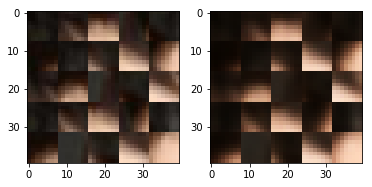

EPO: 50, recon_loss: 0.0016, total_loss: 0.0056
EPO: 50, recon_loss: 0.0012, total_loss: 0.0039
EPO: 50, recon_loss: 0.0022, total_loss: 0.0055
EPO: 50, recon_loss: 0.0017, total_loss: 0.0037
EPO: 50, recon_loss: 0.0047, total_loss: 0.0090
EPO: 50, recon_loss: 0.0022, total_loss: 0.0060
EPO: 50, recon_loss: 0.0021, total_loss: 0.0055
EPO: 50, recon_loss: 0.0027, total_loss: 0.0069
EPO: 50, recon_loss: 0.0022, total_loss: 0.0060
EPO: 50, recon_loss: 0.0024, total_loss: 0.0062
######### what? the reconstruction psnr is: 32.4024


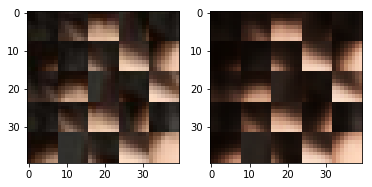

EPO: 50, recon_loss: 0.0020, total_loss: 0.0042
EPO: 50, recon_loss: 0.0017, total_loss: 0.0041
EPO: 50, recon_loss: 0.0059, total_loss: 0.0098
EPO: 50, recon_loss: 0.0015, total_loss: 0.0036
EPO: 50, recon_loss: 0.0029, total_loss: 0.0052
EPO: 50, recon_loss: 0.0039, total_loss: 0.0102
EPO: 50, recon_loss: 0.0028, total_loss: 0.0090
EPO: 50, recon_loss: 0.0049, total_loss: 0.0112
EPO: 50, recon_loss: 0.0052, total_loss: 0.0114
EPO: 50, recon_loss: 0.0044, total_loss: 0.0084
######### what? the reconstruction psnr is: 32.1525


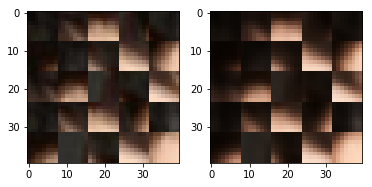

EPO: 50, recon_loss: 0.0028, total_loss: 0.0100
EPO: 50, recon_loss: 0.0011, total_loss: 0.0043
EPO: 50, recon_loss: 0.0036, total_loss: 0.0077
EPO: 50, recon_loss: 0.0020, total_loss: 0.0038
EPO: 50, recon_loss: 0.0017, total_loss: 0.0050
EPO: 50, recon_loss: 0.0009, total_loss: 0.0022
EPO: 50, recon_loss: 0.0012, total_loss: 0.0029
EPO: 50, recon_loss: 0.0034, total_loss: 0.0069
EPO: 50, recon_loss: 0.0023, total_loss: 0.0056
EPO: 50, recon_loss: 0.0028, total_loss: 0.0076
######### what? the reconstruction psnr is: 32.1925


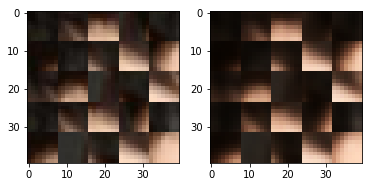

EPO: 50, recon_loss: 0.0010, total_loss: 0.0061
EPO: 50, recon_loss: 0.0011, total_loss: 0.0053
EPO: 50, recon_loss: 0.0025, total_loss: 0.0072
EPO: 50, recon_loss: 0.0009, total_loss: 0.0036
EPO: 50, recon_loss: 0.0023, total_loss: 0.0060
EPO: 50, recon_loss: 0.0044, total_loss: 0.0121
EPO: 50, recon_loss: 0.0013, total_loss: 0.0048
EPO: 50, recon_loss: 0.0042, total_loss: 0.0099
EPO: 50, recon_loss: 0.0024, total_loss: 0.0054
EPO: 50, recon_loss: 0.0022, total_loss: 0.0046
######### what? the reconstruction psnr is: 32.2553


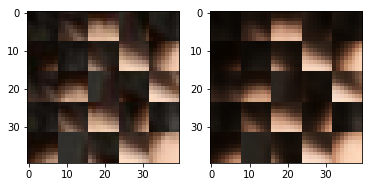

EPO: 50, recon_loss: 0.0056, total_loss: 0.0106
EPO: 50, recon_loss: 0.0023, total_loss: 0.0051
EPO: 50, recon_loss: 0.0032, total_loss: 0.0079
EPO: 50, recon_loss: 0.0029, total_loss: 0.0062
EPO: 50, recon_loss: 0.0032, total_loss: 0.0073
EPO: 50, recon_loss: 0.0097, total_loss: 0.0180
EPO: 50, recon_loss: 0.0087, total_loss: 0.0161
EPO: 50, recon_loss: 0.0072, total_loss: 0.0149
EPO: 50, recon_loss: 0.0081, total_loss: 0.0153
EPO: 50, recon_loss: 0.0056, total_loss: 0.0115
######### what? the reconstruction psnr is: 31.3377


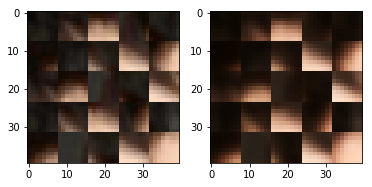

EPO: 50, recon_loss: 0.0045, total_loss: 0.0104
EPO: 50, recon_loss: 0.0024, total_loss: 0.0063
EPO: 50, recon_loss: 0.0035, total_loss: 0.0089
EPO: 50, recon_loss: 0.0053, total_loss: 0.0098
EPO: 50, recon_loss: 0.0052, total_loss: 0.0117
EPO: 50, recon_loss: 0.0061, total_loss: 0.0129
EPO: 50, recon_loss: 0.0013, total_loss: 0.0053
EPO: 50, recon_loss: 0.0032, total_loss: 0.0087
EPO: 50, recon_loss: 0.0055, total_loss: 0.0112
EPO: 50, recon_loss: 0.0022, total_loss: 0.0068
######### what? the reconstruction psnr is: 31.7150


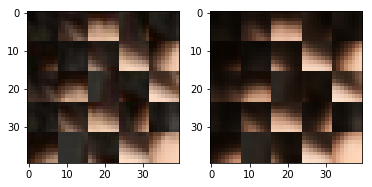

EPO: 50, recon_loss: 0.0040, total_loss: 0.0101
EPO: 50, recon_loss: 0.0046, total_loss: 0.0132
EPO: 50, recon_loss: 0.0061, total_loss: 0.0142
EPO: 50, recon_loss: 0.0109, total_loss: 0.0227
EPO: 50, recon_loss: 0.0038, total_loss: 0.0123
EPO: 50, recon_loss: 0.0076, total_loss: 0.0158
EPO: 50, recon_loss: 0.0048, total_loss: 0.0129
EPO: 50, recon_loss: 0.0056, total_loss: 0.0155
EPO: 50, recon_loss: 0.0112, total_loss: 0.0216
EPO: 50, recon_loss: 0.0077, total_loss: 0.0190
######### what? the reconstruction psnr is: 32.3479


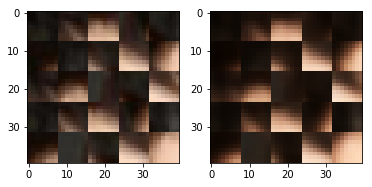

EPO: 50, recon_loss: 0.0077, total_loss: 0.0173
EPO: 50, recon_loss: 0.0012, total_loss: 0.0085
EPO: 50, recon_loss: 0.0056, total_loss: 0.0151
EPO: 50, recon_loss: 0.0146, total_loss: 0.0227
EPO: 50, recon_loss: 0.0075, total_loss: 0.0123
EPO: 50, recon_loss: 0.0026, total_loss: 0.0055
EPO: 50, recon_loss: 0.0016, total_loss: 0.0050
EPO: 50, recon_loss: 0.0022, total_loss: 0.0067
EPO: 50, recon_loss: 0.0054, total_loss: 0.0108
EPO: 50, recon_loss: 0.0026, total_loss: 0.0082
######### what? the reconstruction psnr is: 32.1385


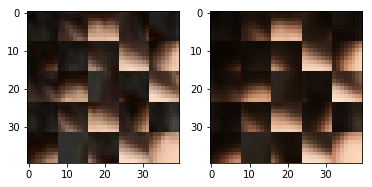

EPO: 50, recon_loss: 0.0050, total_loss: 0.0107
EPO: 50, recon_loss: 0.0006, total_loss: 0.0023
EPO: 50, recon_loss: 0.0004, total_loss: 0.0016
EPO: 50, recon_loss: 0.0010, total_loss: 0.0029
EPO: 50, recon_loss: 0.0005, total_loss: 0.0015
EPO: 50, recon_loss: 0.0011, total_loss: 0.0029
EPO: 50, recon_loss: 0.0025, total_loss: 0.0083
EPO: 50, recon_loss: 0.0015, total_loss: 0.0044
EPO: 50, recon_loss: 0.0036, total_loss: 0.0079
EPO: 50, recon_loss: 0.0017, total_loss: 0.0039
######### what? the reconstruction psnr is: 32.1633


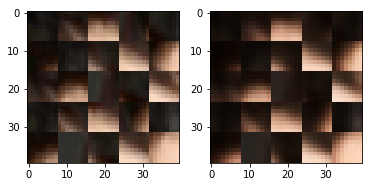

EPO: 50, recon_loss: 0.0023, total_loss: 0.0045
EPO: 50, recon_loss: 0.0041, total_loss: 0.0110
EPO: 50, recon_loss: 0.0045, total_loss: 0.0112
EPO: 50, recon_loss: 0.0044, total_loss: 0.0112
EPO: 50, recon_loss: 0.0051, total_loss: 0.0126
EPO: 50, recon_loss: 0.0027, total_loss: 0.0060
EPO: 50, recon_loss: 0.0031, total_loss: 0.0077
EPO: 50, recon_loss: 0.0020, total_loss: 0.0047
EPO: 50, recon_loss: 0.0031, total_loss: 0.0071
EPO: 50, recon_loss: 0.0021, total_loss: 0.0048
######### what? the reconstruction psnr is: 31.8740


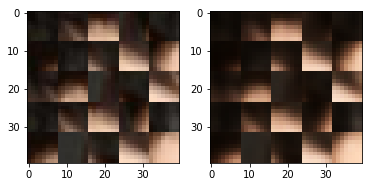

EPO: 50, recon_loss: 0.0021, total_loss: 0.0048
EPO: 50, recon_loss: 0.0021, total_loss: 0.0100
EPO: 50, recon_loss: 0.0009, total_loss: 0.0040
EPO: 50, recon_loss: 0.0030, total_loss: 0.0085
EPO: 50, recon_loss: 0.0022, total_loss: 0.0056
EPO: 50, recon_loss: 0.0031, total_loss: 0.0066
EPO: 50, recon_loss: 0.0011, total_loss: 0.0029
EPO: 50, recon_loss: 0.0007, total_loss: 0.0026
EPO: 50, recon_loss: 0.0014, total_loss: 0.0038
EPO: 50, recon_loss: 0.0014, total_loss: 0.0039
######### what? the reconstruction psnr is: 31.9100


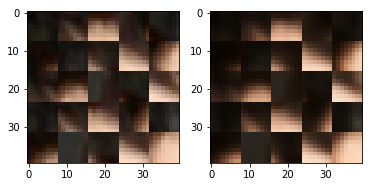

EPO: 50, recon_loss: 0.0013, total_loss: 0.0032
EPO: 50, recon_loss: 0.0024, total_loss: 0.0065
EPO: 50, recon_loss: 0.0015, total_loss: 0.0043
EPO: 50, recon_loss: 0.0034, total_loss: 0.0077
EPO: 50, recon_loss: 0.0027, total_loss: 0.0066
EPO: 50, recon_loss: 0.0025, total_loss: 0.0061
EPO: 50, recon_loss: 0.0023, total_loss: 0.0097
EPO: 50, recon_loss: 0.0022, total_loss: 0.0081
EPO: 50, recon_loss: 0.0057, total_loss: 0.0126
EPO: 50, recon_loss: 0.0060, total_loss: 0.0116
######### what? the reconstruction psnr is: 31.5657


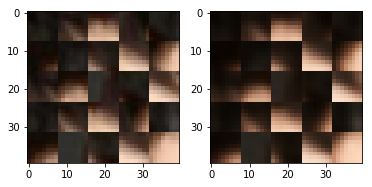

EPO: 50, recon_loss: 0.0025, total_loss: 0.0068
EPO: 50, recon_loss: 0.0089, total_loss: 0.0167
EPO: 50, recon_loss: 0.0006, total_loss: 0.0028
EPO: 50, recon_loss: 0.0013, total_loss: 0.0053
EPO: 50, recon_loss: 0.0055, total_loss: 0.0103
EPO: 50, recon_loss: 0.0029, total_loss: 0.0064
EPO: 50, recon_loss: 0.0026, total_loss: 0.0063
EPO: 50, recon_loss: 0.0036, total_loss: 0.0083
EPO: 50, recon_loss: 0.0042, total_loss: 0.0097
EPO: 50, recon_loss: 0.0054, total_loss: 0.0108
######### what? the reconstruction psnr is: 32.2204


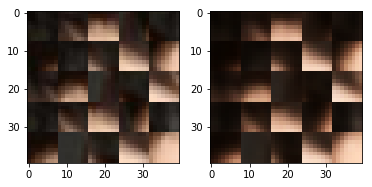

EPO: 50, recon_loss: 0.0012, total_loss: 0.0040
EPO: 50, recon_loss: 0.0053, total_loss: 0.0096
EPO: 50, recon_loss: 0.0009, total_loss: 0.0035
EPO: 50, recon_loss: 0.0040, total_loss: 0.0082
EPO: 50, recon_loss: 0.0044, total_loss: 0.0097
EPO: 50, recon_loss: 0.0019, total_loss: 0.0053
EPO: 50, recon_loss: 0.0026, total_loss: 0.0060
EPO: 50, recon_loss: 0.0034, total_loss: 0.0084
EPO: 50, recon_loss: 0.0023, total_loss: 0.0065
EPO: 50, recon_loss: 0.0066, total_loss: 0.0114
######### what? the reconstruction psnr is: 32.3689


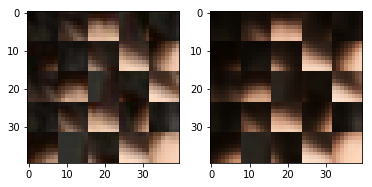

EPO: 50, recon_loss: 0.0030, total_loss: 0.0080
EPO: 50, recon_loss: 0.0044, total_loss: 0.0090
EPO: 50, recon_loss: 0.0039, total_loss: 0.0096
EPO: 50, recon_loss: 0.0007, total_loss: 0.0029
EPO: 50, recon_loss: 0.0041, total_loss: 0.0075
EPO: 50, recon_loss: 0.0022, total_loss: 0.0056
EPO: 50, recon_loss: 0.0031, total_loss: 0.0069
EPO: 50, recon_loss: 0.0025, total_loss: 0.0077
EPO: 50, recon_loss: 0.0025, total_loss: 0.0067
EPO: 50, recon_loss: 0.0061, total_loss: 0.0121
######### what? the reconstruction psnr is: 32.1585


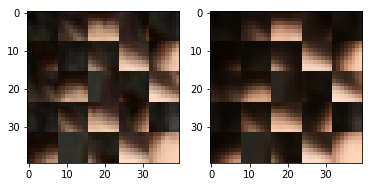

EPO: 50, recon_loss: 0.0022, total_loss: 0.0066
EPO: 50, recon_loss: 0.0051, total_loss: 0.0110
EPO: 50, recon_loss: 0.0032, total_loss: 0.0089
EPO: 50, recon_loss: 0.0010, total_loss: 0.0042
EPO: 50, recon_loss: 0.0041, total_loss: 0.0101
EPO: 50, recon_loss: 0.0016, total_loss: 0.0052
EPO: 50, recon_loss: 0.0035, total_loss: 0.0081
EPO: 50, recon_loss: 0.0015, total_loss: 0.0027
EPO: 50, recon_loss: 0.0012, total_loss: 0.0026
EPO: 50, recon_loss: 0.0028, total_loss: 0.0057
######### what? the reconstruction psnr is: 32.3237


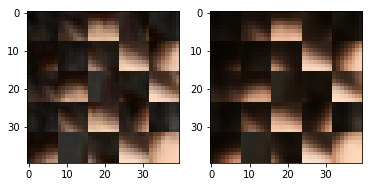

EPO: 50, recon_loss: 0.0017, total_loss: 0.0047
EPO: 50, recon_loss: 0.0017, total_loss: 0.0047
EPO: 50, recon_loss: 0.0085, total_loss: 0.0183
EPO: 50, recon_loss: 0.0059, total_loss: 0.0143
EPO: 50, recon_loss: 0.0068, total_loss: 0.0183
EPO: 50, recon_loss: 0.0047, total_loss: 0.0140
EPO: 50, recon_loss: 0.0060, total_loss: 0.0175
EPO: 50, recon_loss: 0.0013, total_loss: 0.0060
EPO: 50, recon_loss: 0.0017, total_loss: 0.0055
EPO: 50, recon_loss: 0.0053, total_loss: 0.0146
######### what? the reconstruction psnr is: 32.2841


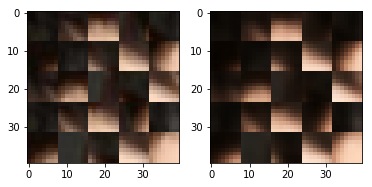

EPO: 50, recon_loss: 0.0023, total_loss: 0.0085
EPO: 50, recon_loss: 0.0026, total_loss: 0.0072
EPO: 50, recon_loss: 0.0028, total_loss: 0.0111
EPO: 50, recon_loss: 0.0028, total_loss: 0.0094
EPO: 50, recon_loss: 0.0049, total_loss: 0.0123
EPO: 50, recon_loss: 0.0027, total_loss: 0.0075
EPO: 50, recon_loss: 0.0026, total_loss: 0.0068
EPO: 50, recon_loss: 0.0035, total_loss: 0.0082
EPO: 50, recon_loss: 0.0016, total_loss: 0.0058
EPO: 50, recon_loss: 0.0048, total_loss: 0.0113
######### what? the reconstruction psnr is: 32.4768


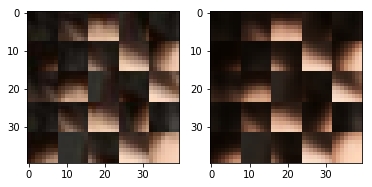

EPO: 50, recon_loss: 0.0027, total_loss: 0.0070
EPO: 50, recon_loss: 0.0017, total_loss: 0.0059
EPO: 50, recon_loss: 0.0031, total_loss: 0.0064
EPO: 50, recon_loss: 0.0016, total_loss: 0.0052
EPO: 50, recon_loss: 0.0039, total_loss: 0.0107
EPO: 50, recon_loss: 0.0042, total_loss: 0.0101
EPO: 50, recon_loss: 0.0033, total_loss: 0.0091
EPO: 50, recon_loss: 0.0063, total_loss: 0.0123
EPO: 50, recon_loss: 0.0010, total_loss: 0.0045
EPO: 50, recon_loss: 0.0031, total_loss: 0.0092
######### what? the reconstruction psnr is: 32.5480


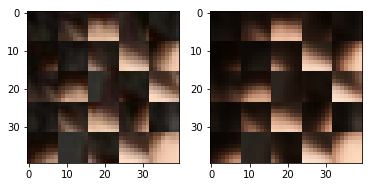

In [ ]:
batch_size = 64
learning_rate = 0.2
beta1 = 0.5
beta2 = 0.9
M = 5
z_dim = 320
tf.reset_default_graph()
"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 100
sample_set = helper.Dataset('patch_celeba', glob(os.path.join(data_dir, 'validation/*.png'))[50:550:20])
sample_images = next(sample_set.get_batches(25))
sample_images *= 2
print(np.max(sample_images))


tiny_training_set = helper.Dataset('patch_celeba', glob(os.path.join(data_dir, 'sub_training/*.png'))[50:550:20])
training_sample_images = next(tiny_training_set.get_batches(25))
training_sample_images *= 2

celeba_dataset = helper.Dataset('patch_celeba', glob(os.path.join(data_dir, 'training/*.png')))


with tf.Graph().as_default():
    train_result, test_result = train(epochs, batch_size, z_dim, learning_rate, beta1, beta2, M, celeba_dataset.get_batches, 
         sample_images, training_sample_images, celeba_dataset.shape, celeba_dataset.image_mode)


In [22]:
noad_train_result = train_result
noad_test_result = test_result
xcordinates = np.linspace(1,2000, num=len(train_result))
pyplot.plot(xcordinates, noad_train_result, label='training_psnr')
pyplot.plot(xcordinates, noad_test_result, label='test_psnr')
#pyplot.ylim(0.00, 0.04)
pyplot.legend(bbox_to_anchor=(0.5, 0.3), loc=2, borderaxespad=0.)
pyplot.show()

NameError: name 'train_result' is not defined

In [23]:
batch_size = 19
z_dim = 320

tf.reset_default_graph()
test_dataset = helper.Dataset('patch_celeba', glob(os.path.join(data_dir, 'testing/*.png')))
with tf.Graph().as_default():
    check_var(z_dim, test_dataset.get_batches, test_dataset.shape, test_dataset.image_mode)
    print(tf.get_collection('activations'))
    

 [*] Reading checkpoints...
INFO:tensorflow:Restoring parameters from ./checkpoint/spAE.model-12001

            We found a existing model and continue to train on it! 
            If you need a new model, delete checkpoint directory
['variables', 'trainable_variables', 'update_ops', 'activations', 'summaries']
[<tf.Tensor 'decoder/de_ac1:0' shape=(?, 320) dtype=float32>]


In [24]:
batch_size = 19
z_dim = 320

tf.reset_default_graph()
test_dataset = helper.Dataset('patch_celeba', glob(os.path.join(data_dir, 'testing/*.png')))

with tf.Graph().as_default():
    recon_patches, test_psnr = test(z_dim, test_dataset.get_batches, test_dataset.shape, test_dataset.image_mode)

 [*] Reading checkpoints...
INFO:tensorflow:Restoring parameters from ./checkpoint/spAE.model-12001

            We found a existing model and continue to train on it! 
            If you need a new model, delete checkpoint directory


In [32]:
from sklearn.feature_extraction.image import extract_patches_2d, reconstruct_from_patches_2d
original_set = helper.Dataset('uiuc_celeba', glob(os.path.join(data_dir, 'resized_raw/26.png')))
sample_images = next(original_set.get_batches(1))[0]
sample_images *= 2

ORIGINAL_SHAPE = (64,64,3)
recon_img = reconstruct_from_patches_2d(recon_patches, ORIGINAL_SHAPE).astype(np.float32)
print(compare_psnr(sample_images, recon_img))

22.7260751395


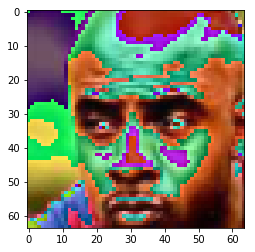

In [33]:
pyplot.imshow(sample_images)

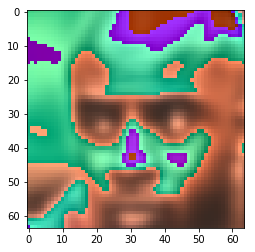

In [28]:
pyplot.imshow(recon_img)

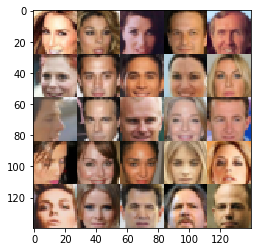

In [52]:
cmap = None
sample_images_grid = helper.images_square_grid(sample_images, celeba_dataset.image_mode)
pyplot.imshow(sample_images_grid, cmap=cmap)
pyplot.show()